In [3]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets

In [4]:
from utils import Logger

In [5]:
#Dataset
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize([0.5], [0.5])])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
# Load data
data = mnist_data()
# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

100.1%

Extracting ./dataset/MNIST/raw/train-images-idx3-ubyte.gz to ./dataset/MNIST/raw


113.5%

Extracting ./dataset/MNIST/raw/train-labels-idx1-ubyte.gz to ./dataset/MNIST/raw


100.4%

Extracting ./dataset/MNIST/raw/t10k-images-idx3-ubyte.gz to ./dataset/MNIST/raw


180.4%

Extracting ./dataset/MNIST/raw/t10k-labels-idx1-ubyte.gz to ./dataset/MNIST/raw
Processing...
Done!


In [6]:
#A three hidden-layer discriminative neural network
# each followed by a Leaky-ReLU nonlinearity and a Dropout layer 
#to prevent overfitting. A Sigmoid/Logistic function is applied 
#to the real-valued output to obtain a value in the open-range (0, 1)
class DiscriminatorNet(torch.nn.Module):
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
discriminator = DiscriminatorNet()

In [7]:
#Additional Func to convert flattened image into 2D and vice-versa
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [8]:
"""This network will have three hidden layers, each followed by a Leaky-ReLU 
nonlinearity. The output layer will have a TanH activation function, which 
maps the resulting values into the (-1, 1) range, which is the same range 
in which our preprocessed MNIST images is bounded."""
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x
generator = GeneratorNet()

In [9]:
#An Additional function that allows to create random noise samples from normal distribution.
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [10]:
#For Optimasation we will use Adam and learning rate as 0.0002
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [11]:
#The loss function will be Binary Cross Entropy Loss(BCE Loss)
#Specifically we’ll be taking the average of the loss calculated for each minibatch.

loss = nn.BCELoss()

In [12]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [13]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N) )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [14]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [15]:
#For visualization
num_test_samples = 16
test_noise = noise(num_test_samples)

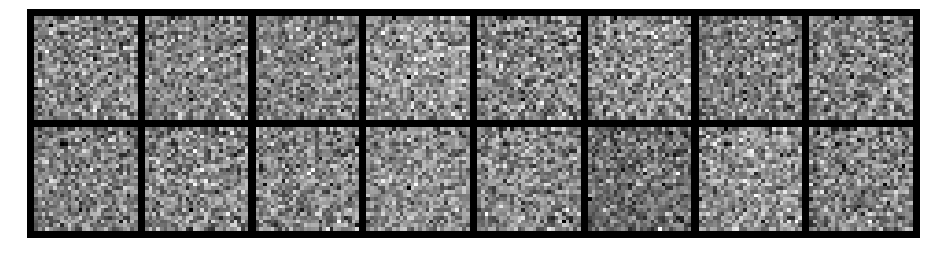

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.4124, Generator Loss: 0.6881
D(x): 0.4892, D(G(z)): 0.5020


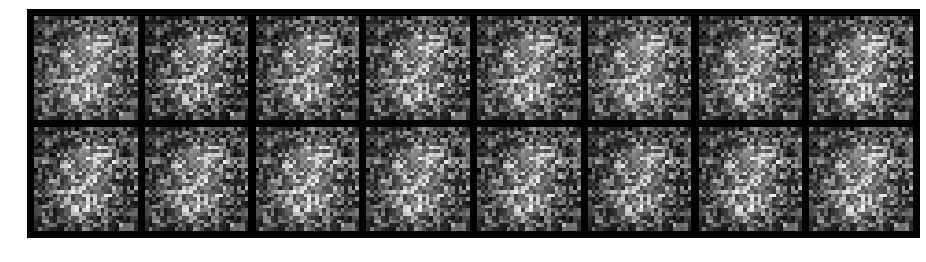

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.7773, Generator Loss: 2.0120
D(x): 0.7876, D(G(z)): 0.3225


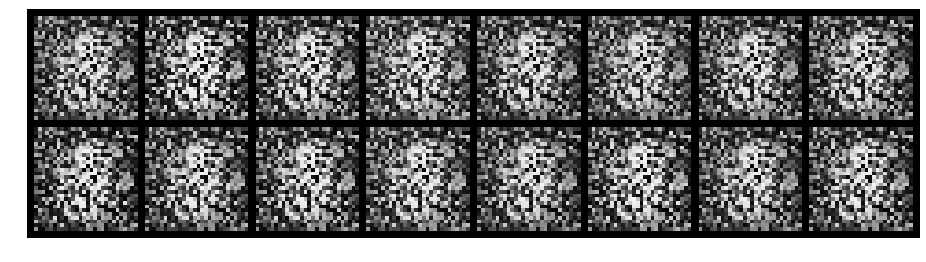

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.3594, Generator Loss: 3.3095
D(x): 0.9171, D(G(z)): 0.2086


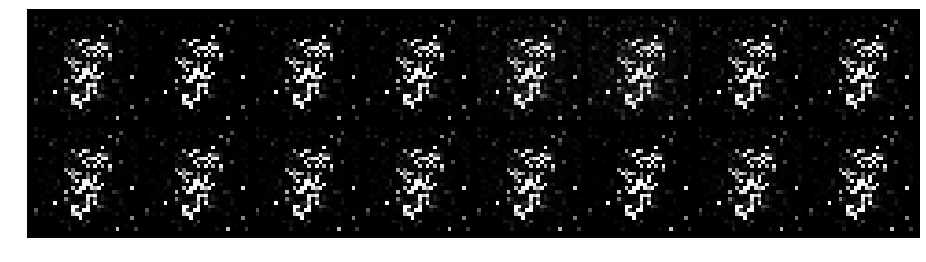

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1622, Generator Loss: 6.4778
D(x): 0.9440, D(G(z)): 0.0242


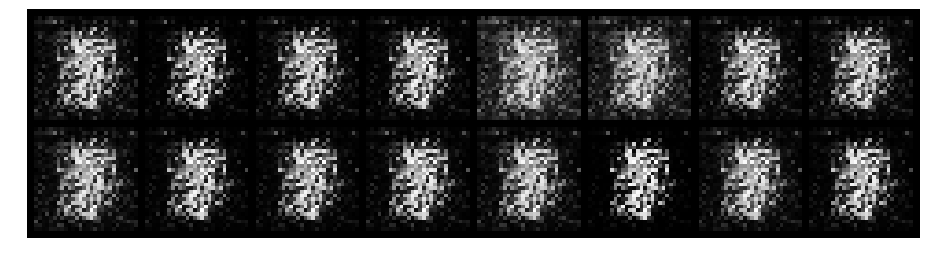

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 1.2853, Generator Loss: 6.6663
D(x): 0.7626, D(G(z)): 0.5000


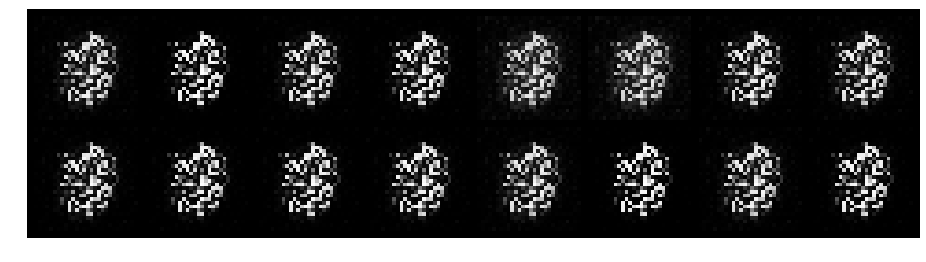

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.1504, Generator Loss: 4.8874
D(x): 0.9694, D(G(z)): 0.0901


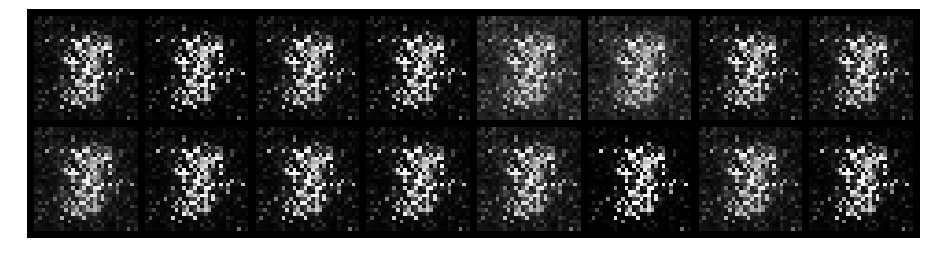

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.2199, Generator Loss: 2.6764
D(x): 0.9269, D(G(z)): 0.1152


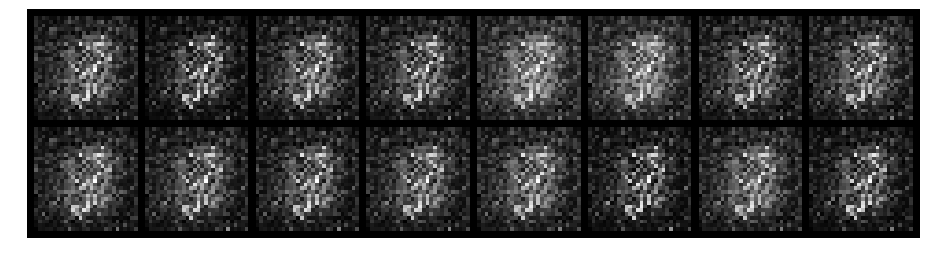

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.7613, Generator Loss: 0.9498
D(x): 0.6975, D(G(z)): 0.6226


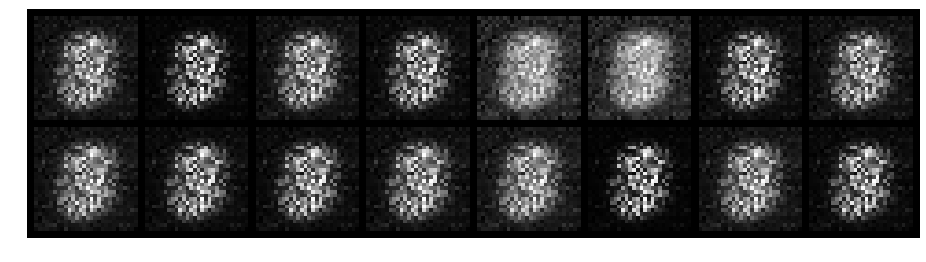

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.4141, Generator Loss: 1.5405
D(x): 0.7119, D(G(z)): 0.5184


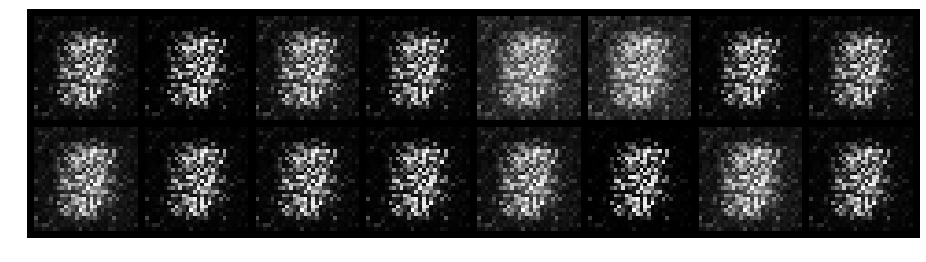

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.3691, Generator Loss: 3.2047
D(x): 0.8753, D(G(z)): 0.1681


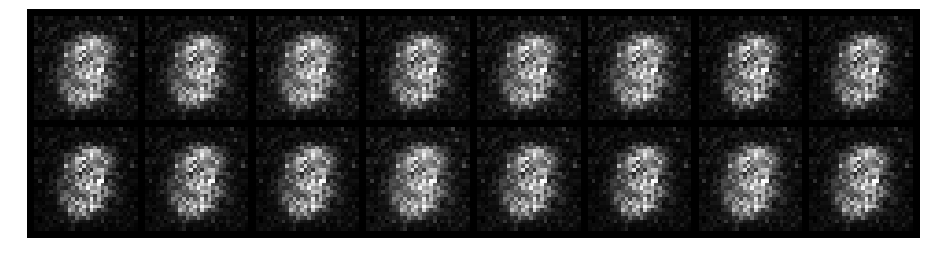

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 2.0827, Generator Loss: 1.0879
D(x): 0.5864, D(G(z)): 0.6585


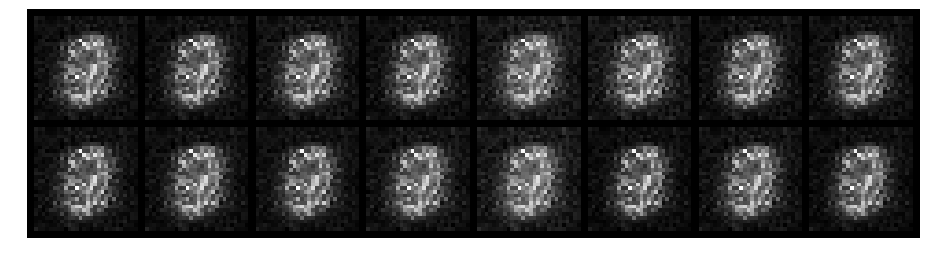

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.5442, Generator Loss: 2.3231
D(x): 0.7745, D(G(z)): 0.1961


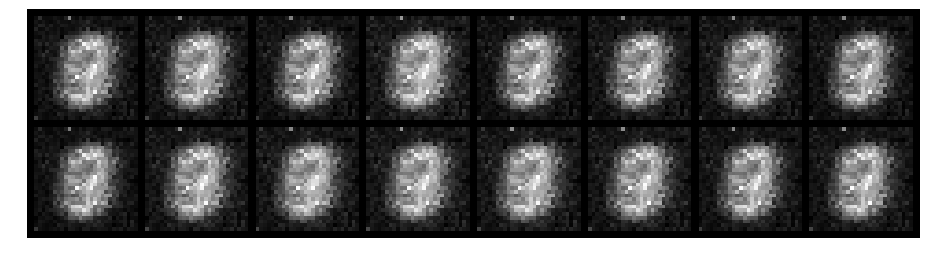

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.4845, Generator Loss: 0.8356
D(x): 0.6032, D(G(z)): 0.4953


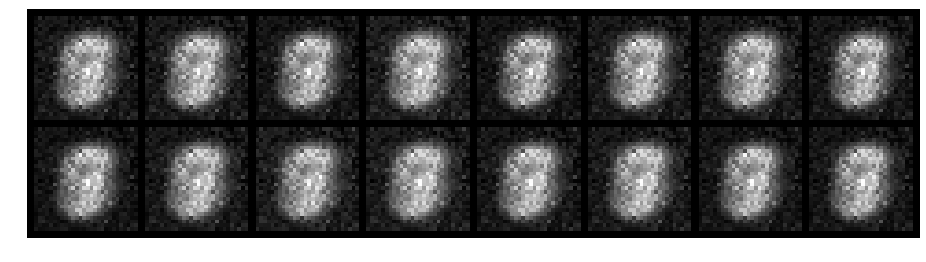

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 2.0386, Generator Loss: 0.8714
D(x): 0.4779, D(G(z)): 0.5264


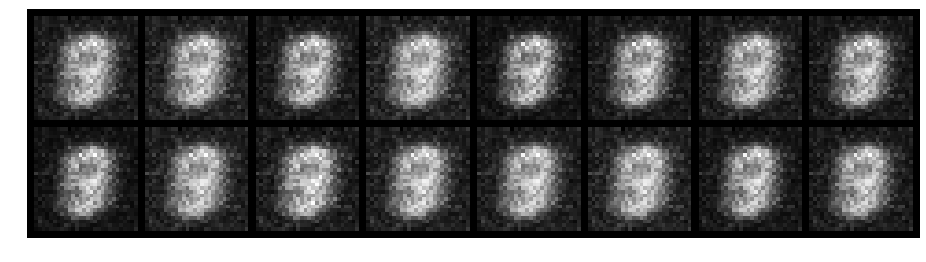

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.8126, Generator Loss: 1.4787
D(x): 0.7548, D(G(z)): 0.3176


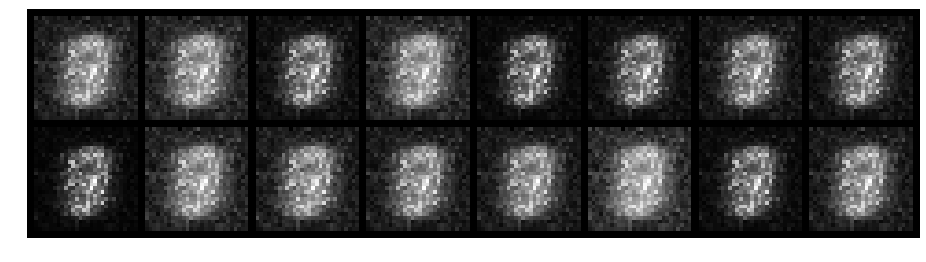

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.4764, Generator Loss: 2.9480
D(x): 0.8280, D(G(z)): 0.1156


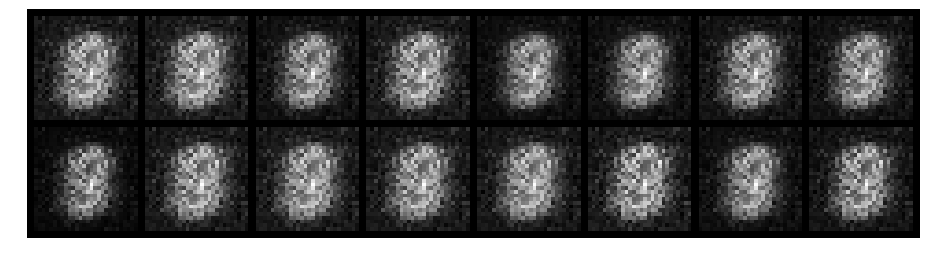

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.2469, Generator Loss: 3.1554
D(x): 0.8848, D(G(z)): 0.0880


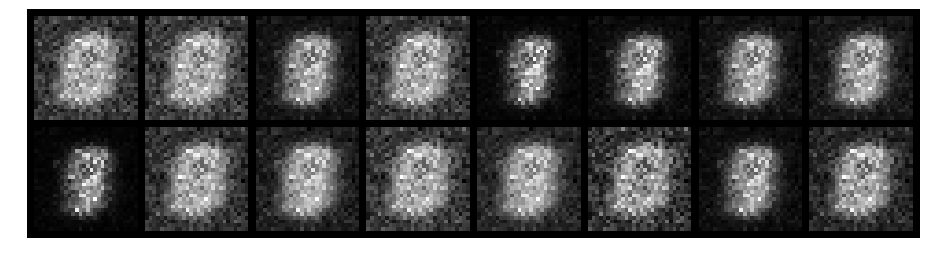

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.5104, Generator Loss: 2.9620
D(x): 0.8586, D(G(z)): 0.1500


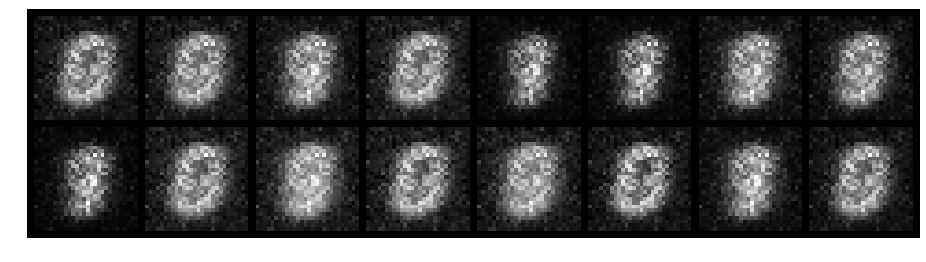

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.4938, Generator Loss: 2.4853
D(x): 0.8064, D(G(z)): 0.0905


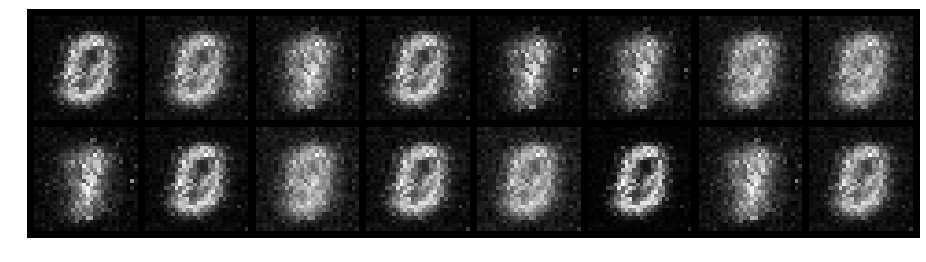

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.3639, Generator Loss: 3.3544
D(x): 0.8770, D(G(z)): 0.0748


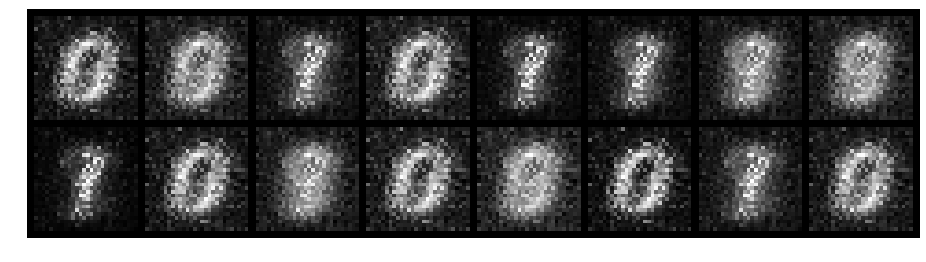

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.2724, Generator Loss: 3.8970
D(x): 0.9323, D(G(z)): 0.1016


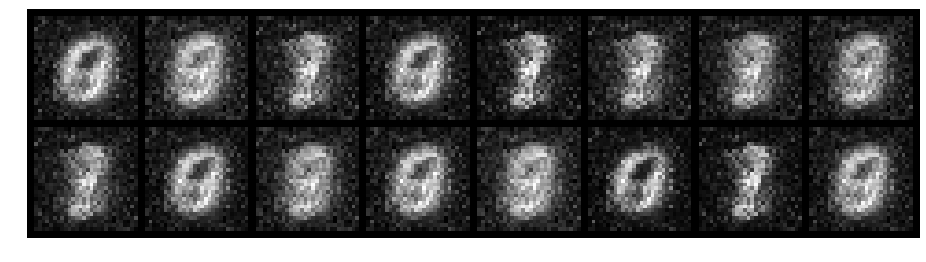

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.5868, Generator Loss: 2.6263
D(x): 0.8085, D(G(z)): 0.1697


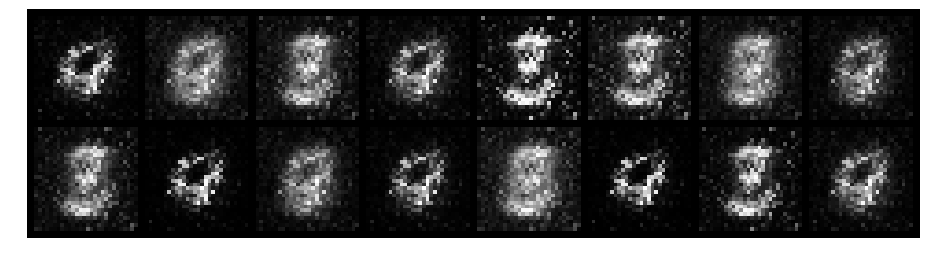

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 1.0942, Generator Loss: 2.4341
D(x): 0.6812, D(G(z)): 0.1792


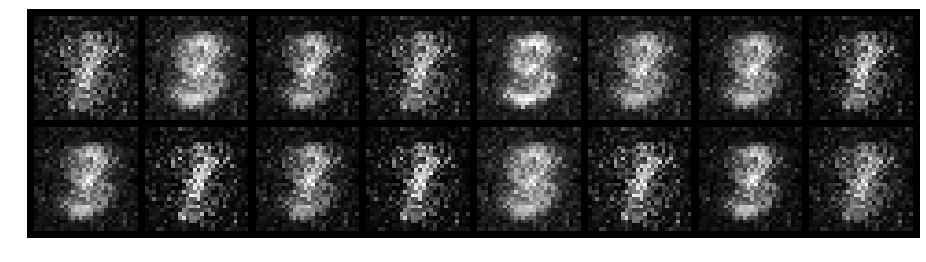

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.3748, Generator Loss: 2.7590
D(x): 0.8795, D(G(z)): 0.1212


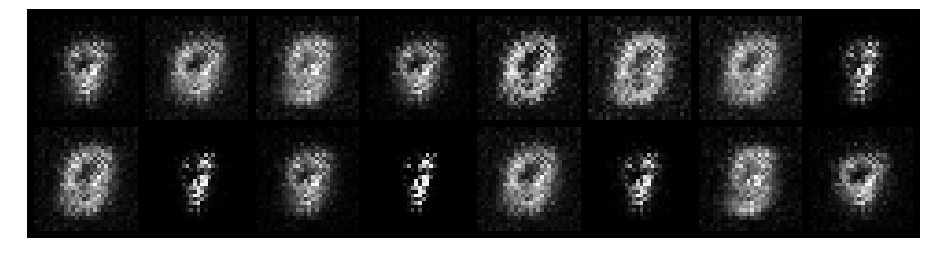

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.3523, Generator Loss: 3.4763
D(x): 0.8955, D(G(z)): 0.1143


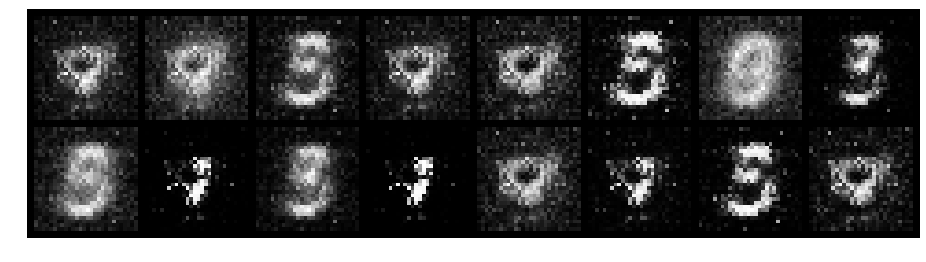

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.2743, Generator Loss: 3.9415
D(x): 0.9107, D(G(z)): 0.0746


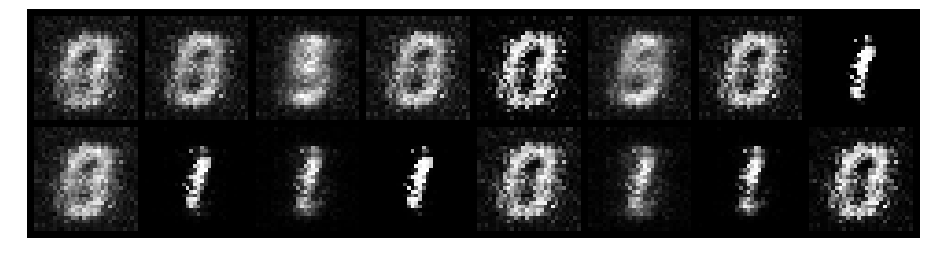

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.4905, Generator Loss: 3.0257
D(x): 0.9012, D(G(z)): 0.1458


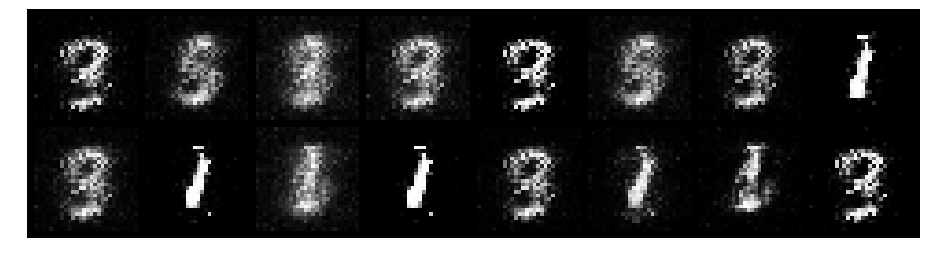

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.2703, Generator Loss: 4.7386
D(x): 0.8905, D(G(z)): 0.0408


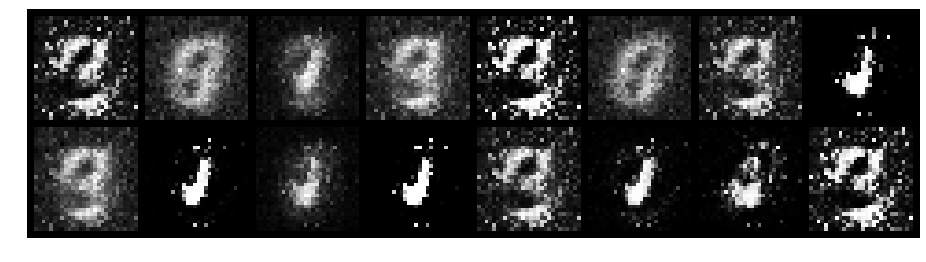

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.4012, Generator Loss: 3.1955
D(x): 0.8770, D(G(z)): 0.1370


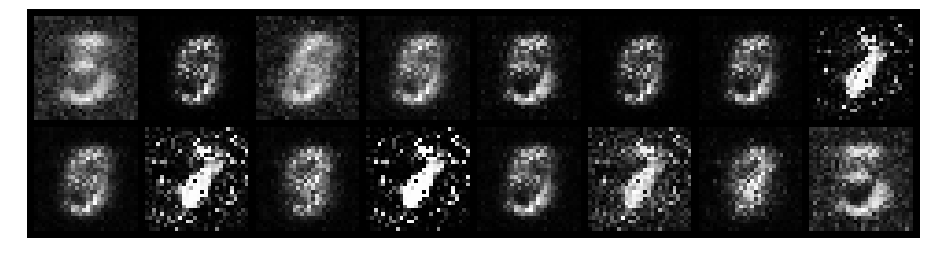

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.5859, Generator Loss: 3.1192
D(x): 0.8510, D(G(z)): 0.1614


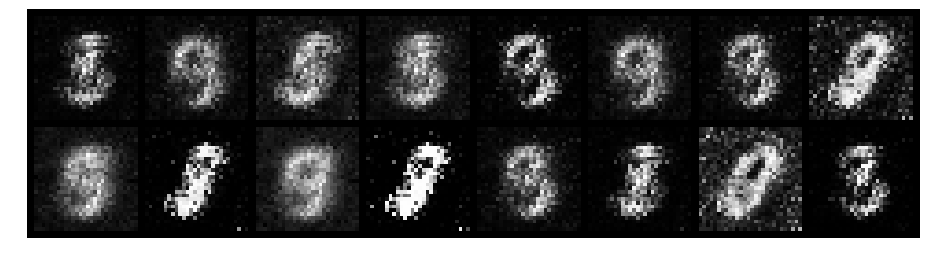

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.6193, Generator Loss: 2.8191
D(x): 0.7629, D(G(z)): 0.1517


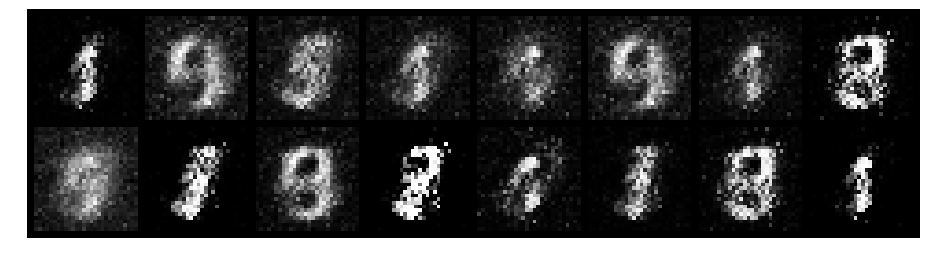

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.6359, Generator Loss: 2.8223
D(x): 0.8564, D(G(z)): 0.1984


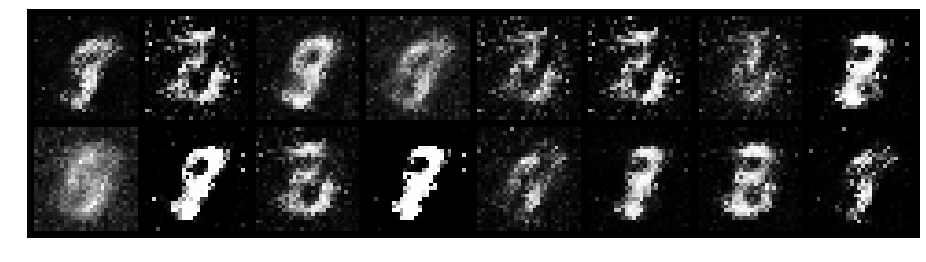

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3943, Generator Loss: 3.4086
D(x): 0.8764, D(G(z)): 0.1376


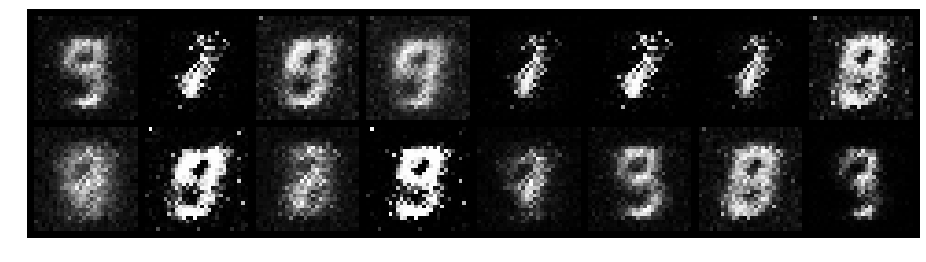

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4966, Generator Loss: 2.0359
D(x): 0.8548, D(G(z)): 0.2119


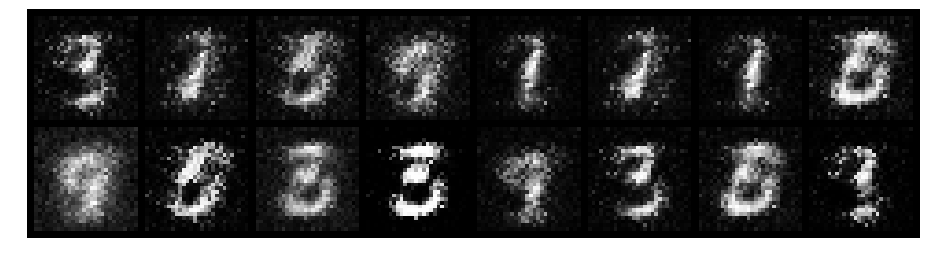

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.4338, Generator Loss: 3.0732
D(x): 0.8741, D(G(z)): 0.1304


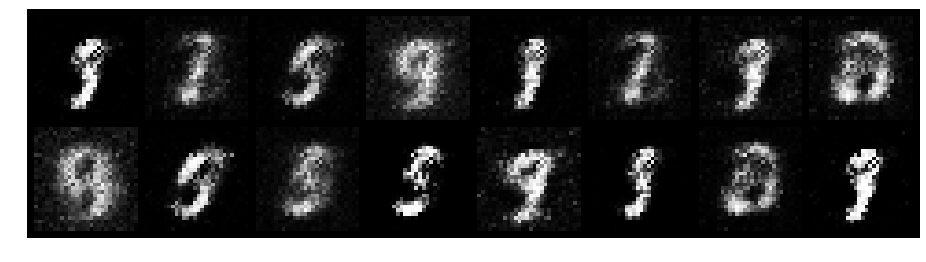

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.7373, Generator Loss: 2.5040
D(x): 0.7329, D(G(z)): 0.2046


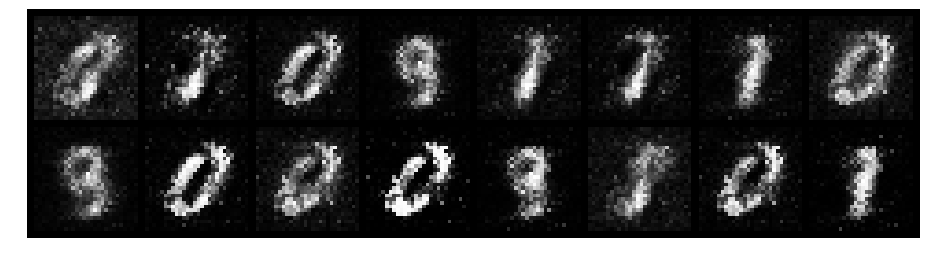

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.5807, Generator Loss: 2.4192
D(x): 0.8353, D(G(z)): 0.1958


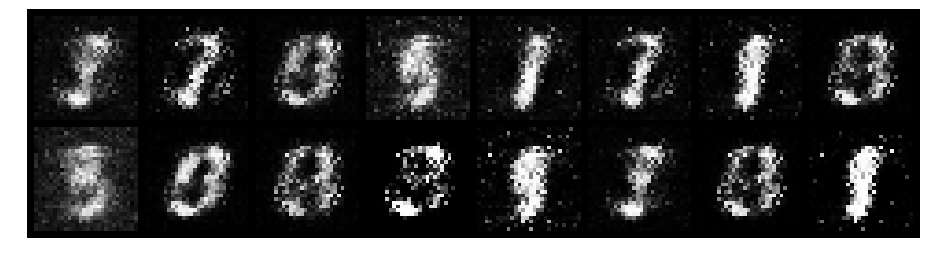

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.5189, Generator Loss: 2.4903
D(x): 0.8136, D(G(z)): 0.1513


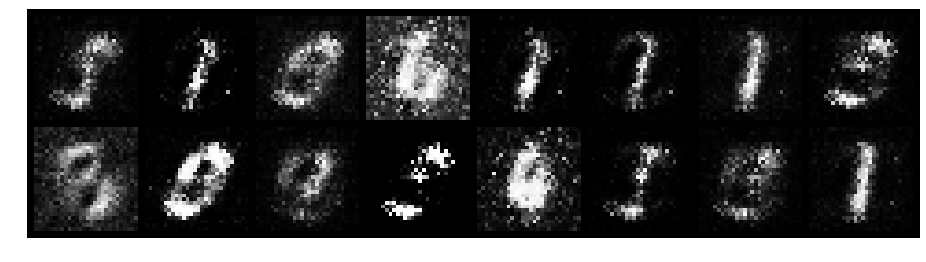

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.9637, Generator Loss: 1.7264
D(x): 0.7126, D(G(z)): 0.3138


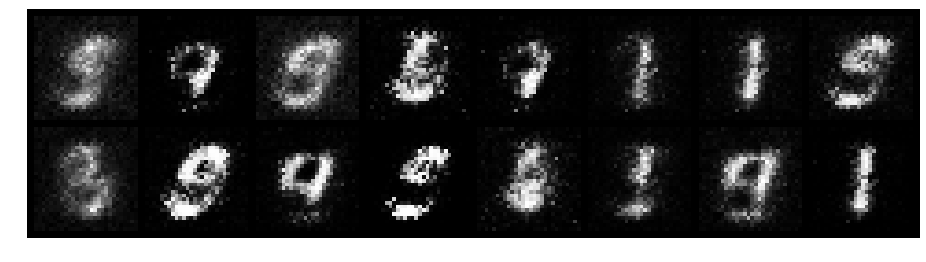

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.4382, Generator Loss: 2.1368
D(x): 0.9078, D(G(z)): 0.2219


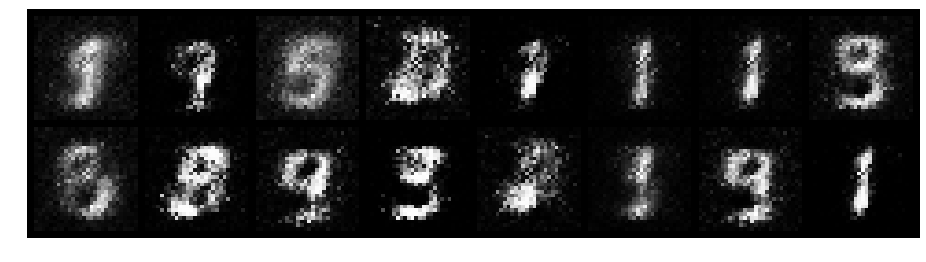

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.3673, Generator Loss: 2.6726
D(x): 0.8715, D(G(z)): 0.1544


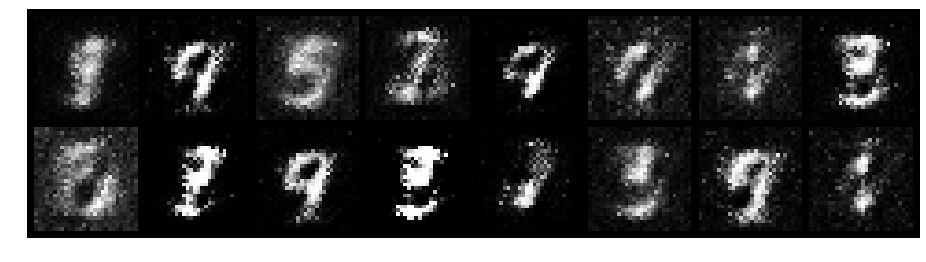

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.4880, Generator Loss: 2.5482
D(x): 0.8698, D(G(z)): 0.1740


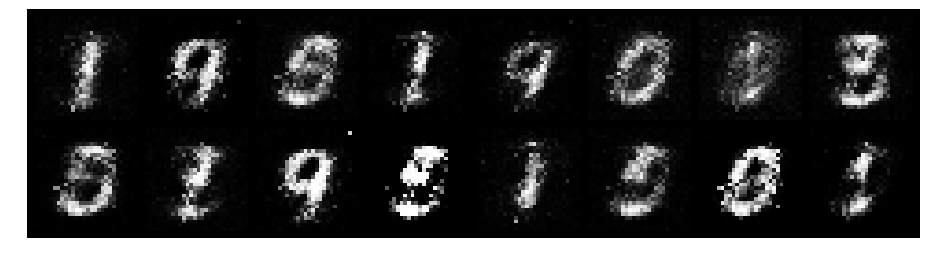

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.4735, Generator Loss: 3.3819
D(x): 0.7908, D(G(z)): 0.0525


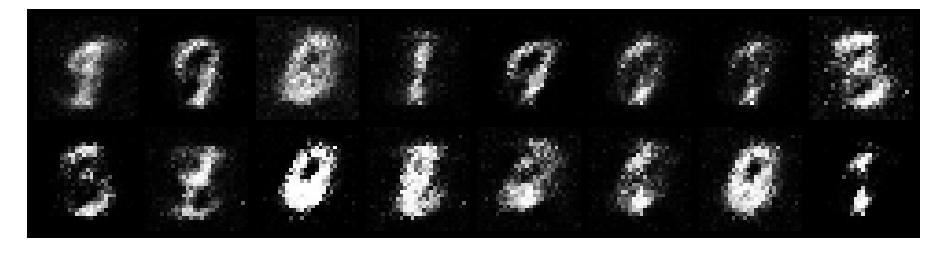

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5363, Generator Loss: 2.3937
D(x): 0.7971, D(G(z)): 0.1439


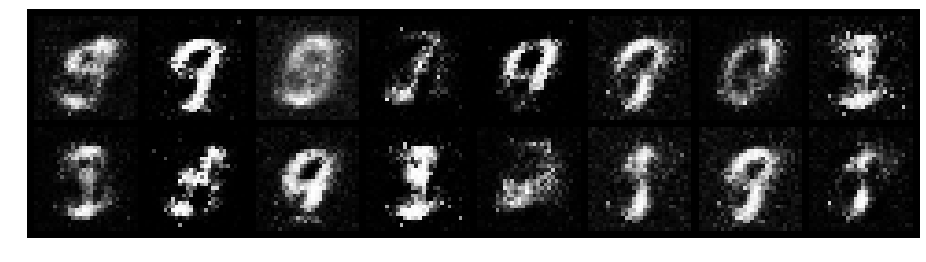

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 1.1167, Generator Loss: 1.9692
D(x): 0.7550, D(G(z)): 0.3117


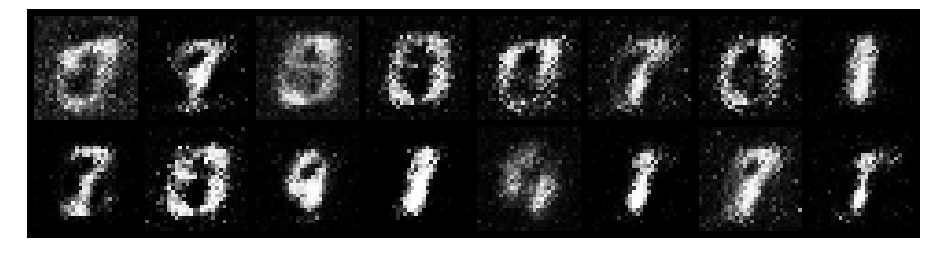

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.7023, Generator Loss: 1.7701
D(x): 0.8072, D(G(z)): 0.2883


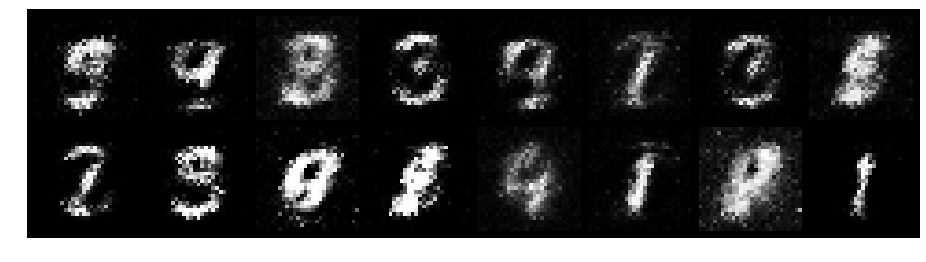

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.9539, Generator Loss: 1.5528
D(x): 0.6980, D(G(z)): 0.2243


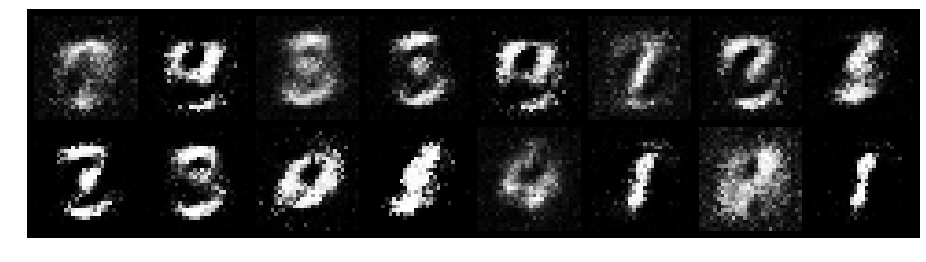

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.5821, Generator Loss: 2.8733
D(x): 0.7693, D(G(z)): 0.1203


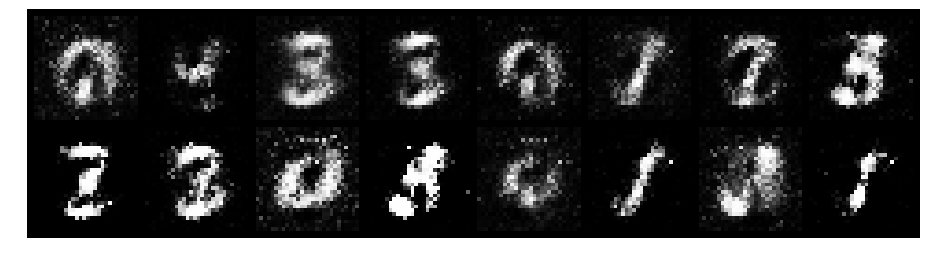

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4204, Generator Loss: 2.3203
D(x): 0.8792, D(G(z)): 0.1859


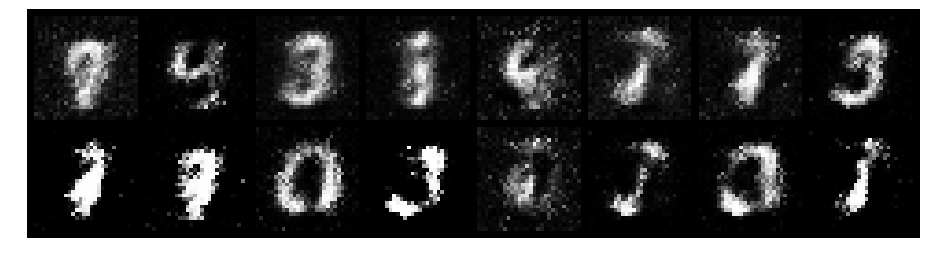

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.7970, Generator Loss: 2.2504
D(x): 0.7314, D(G(z)): 0.2228


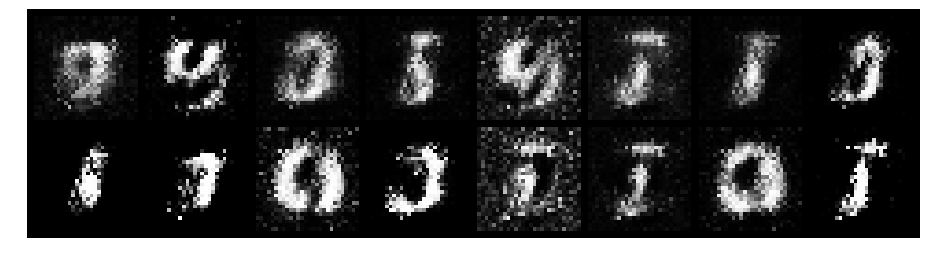

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4655, Generator Loss: 1.9679
D(x): 0.8790, D(G(z)): 0.1904


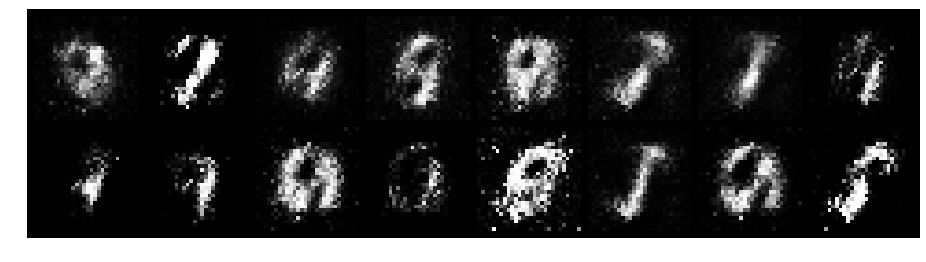

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 1.0175, Generator Loss: 2.4341
D(x): 0.6664, D(G(z)): 0.2419


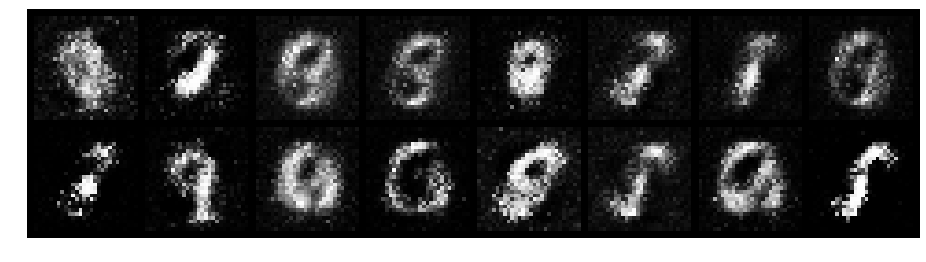

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6415, Generator Loss: 2.0878
D(x): 0.8816, D(G(z)): 0.2760


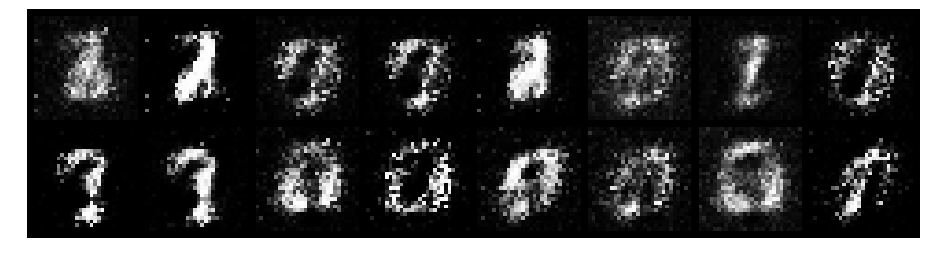

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.6648, Generator Loss: 2.3674
D(x): 0.7571, D(G(z)): 0.1691


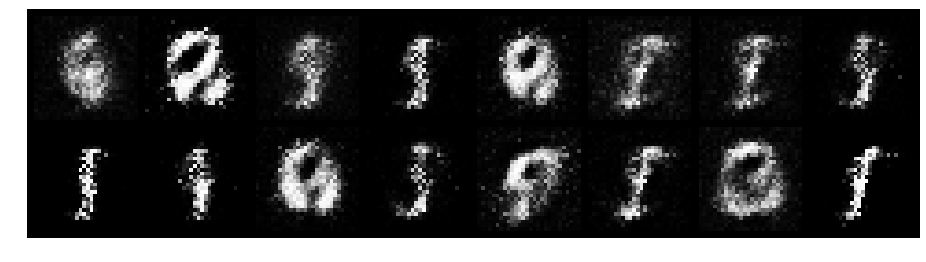

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7050, Generator Loss: 1.7039
D(x): 0.8581, D(G(z)): 0.3170


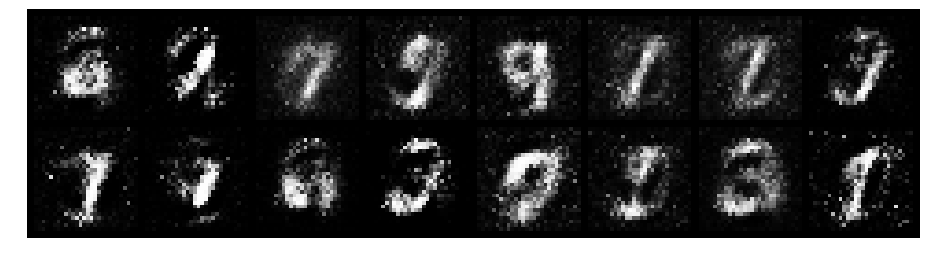

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.4019, Generator Loss: 2.5388
D(x): 0.8676, D(G(z)): 0.1634


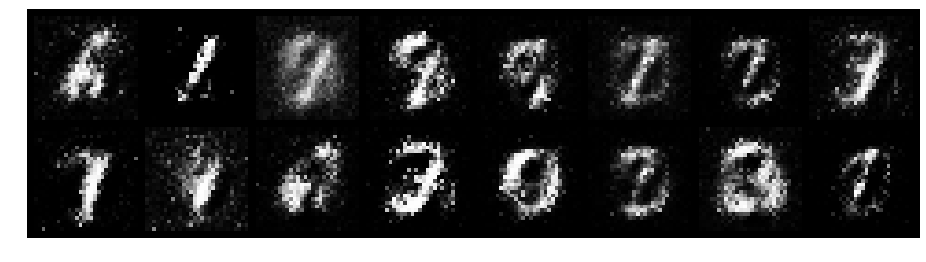

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.6352, Generator Loss: 2.0266
D(x): 0.8019, D(G(z)): 0.2398


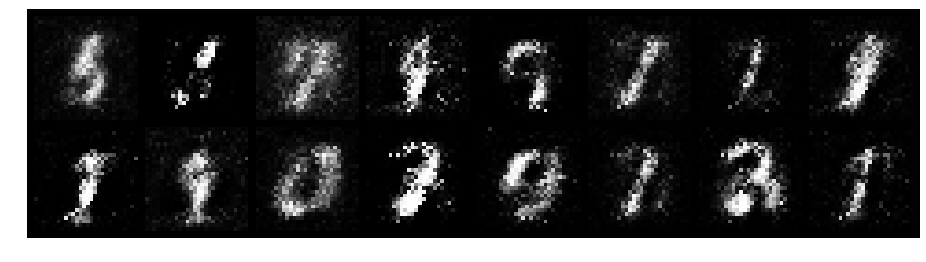

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.5587, Generator Loss: 2.3392
D(x): 0.8336, D(G(z)): 0.2116


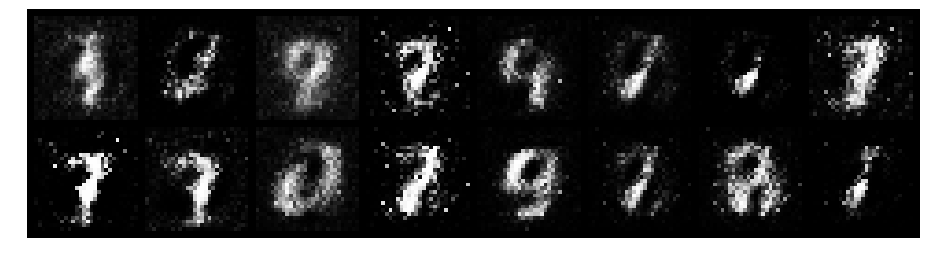

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 1.1333, Generator Loss: 1.9701
D(x): 0.6308, D(G(z)): 0.2876


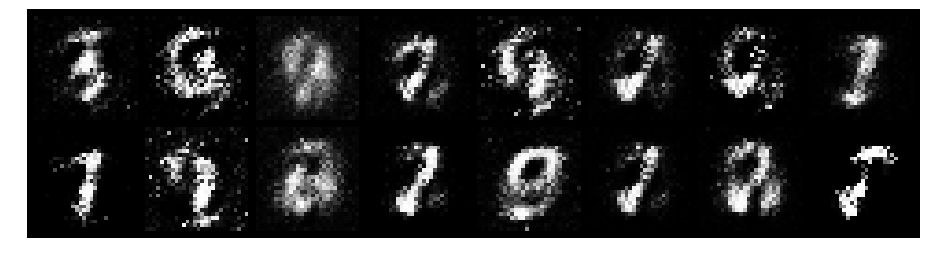

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.4444, Generator Loss: 2.1606
D(x): 0.8860, D(G(z)): 0.2145


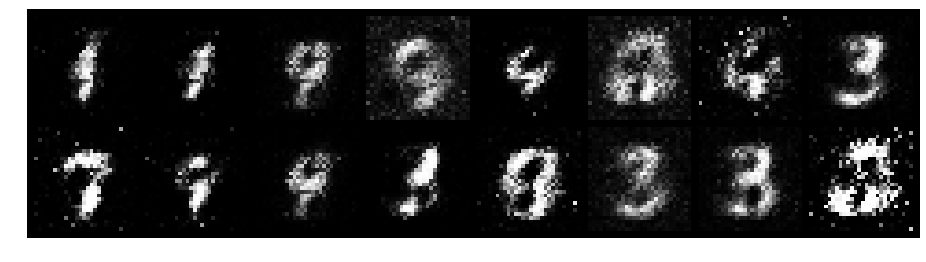

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.6774, Generator Loss: 2.3378
D(x): 0.8006, D(G(z)): 0.1975


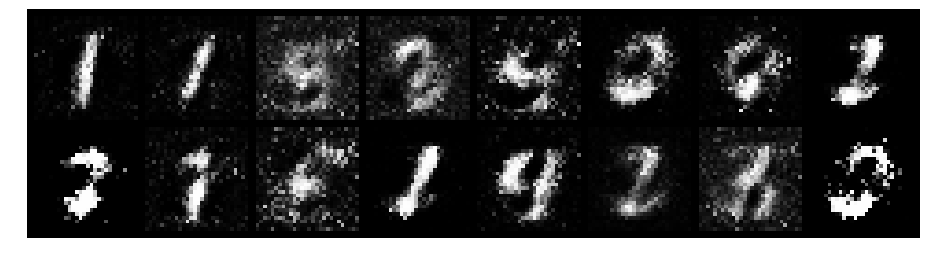

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5594, Generator Loss: 2.3446
D(x): 0.8134, D(G(z)): 0.1827


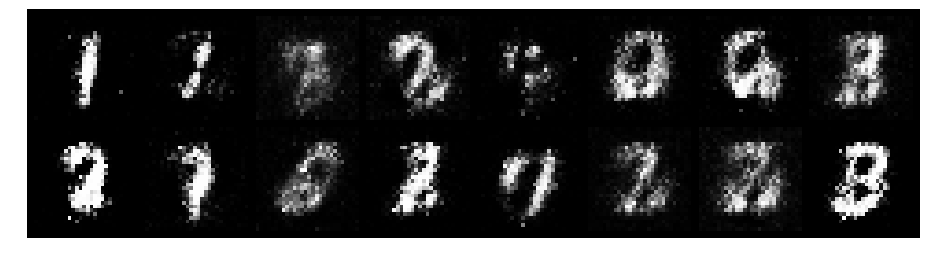

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.7286, Generator Loss: 2.2385
D(x): 0.8707, D(G(z)): 0.2854


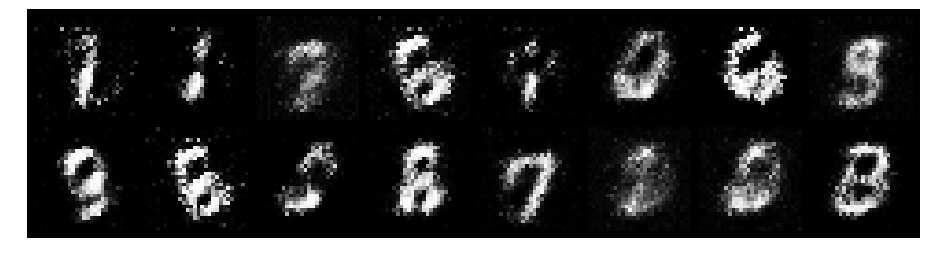

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6714, Generator Loss: 1.8373
D(x): 0.8075, D(G(z)): 0.2532


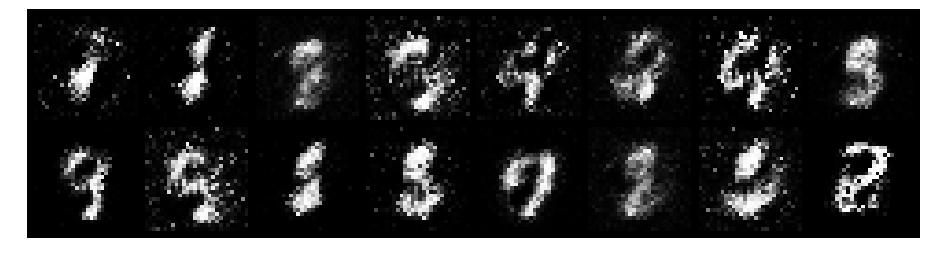

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.6258, Generator Loss: 2.1738
D(x): 0.7601, D(G(z)): 0.1524


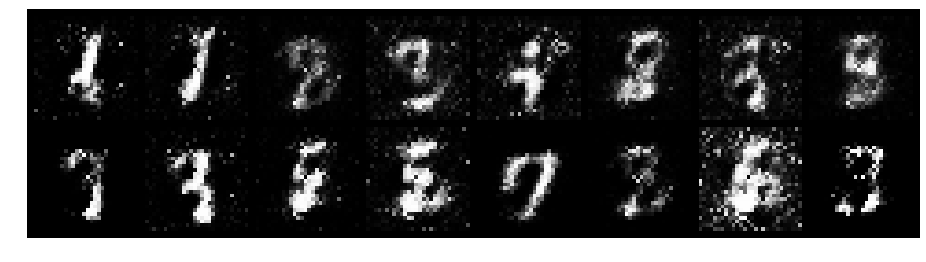

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.8452, Generator Loss: 2.9026
D(x): 0.7455, D(G(z)): 0.2261


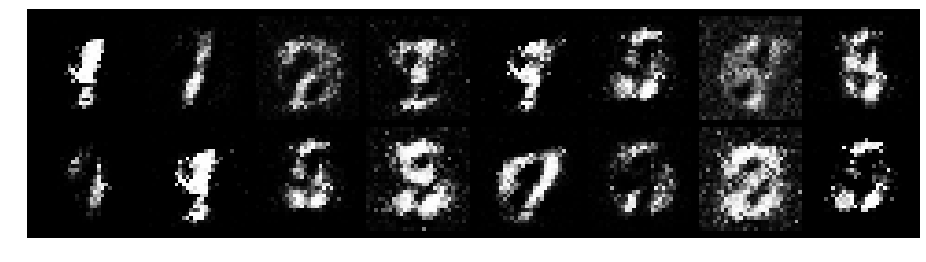

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.5892, Generator Loss: 1.8976
D(x): 0.7868, D(G(z)): 0.2080


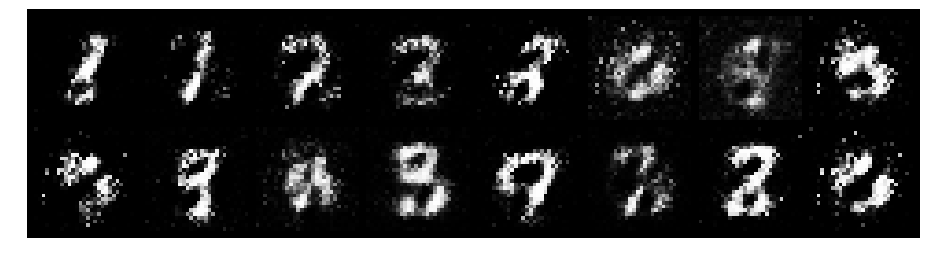

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.7699, Generator Loss: 1.9814
D(x): 0.8077, D(G(z)): 0.3128


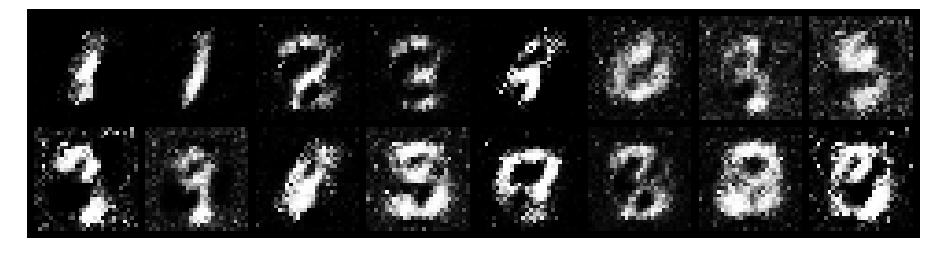

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8110, Generator Loss: 1.8555
D(x): 0.8772, D(G(z)): 0.3568


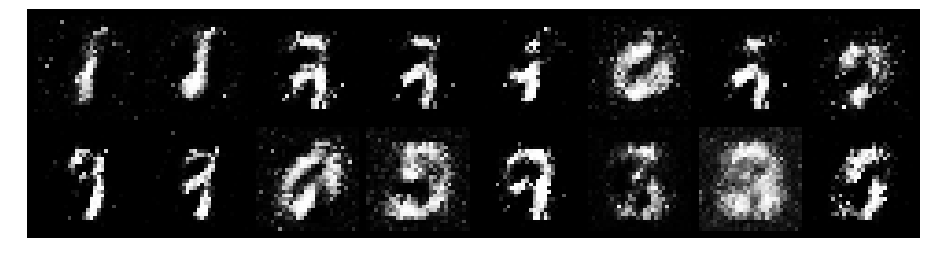

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.6608, Generator Loss: 2.5313
D(x): 0.7832, D(G(z)): 0.2085


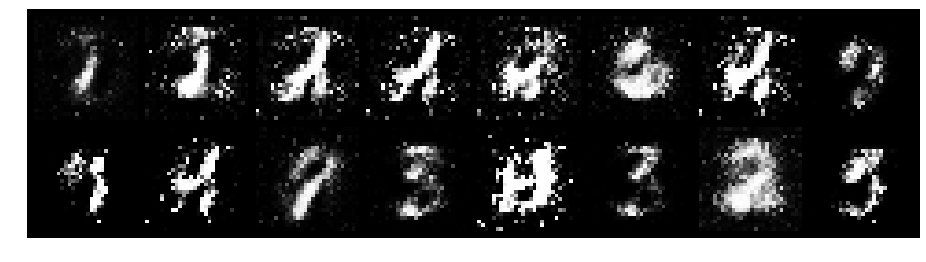

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.7171, Generator Loss: 1.7936
D(x): 0.7563, D(G(z)): 0.2206


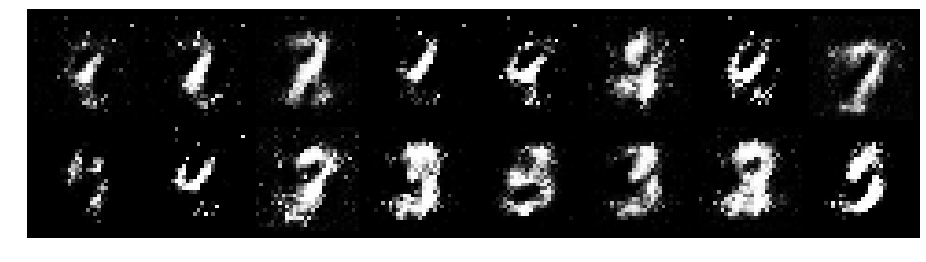

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 1.0287, Generator Loss: 1.3539
D(x): 0.6278, D(G(z)): 0.2740


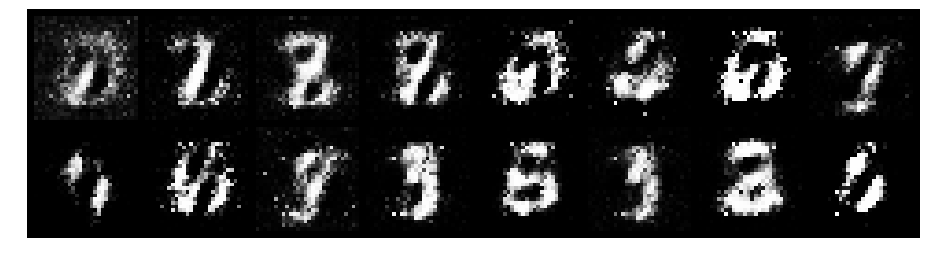

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8570, Generator Loss: 1.3316
D(x): 0.7497, D(G(z)): 0.3388


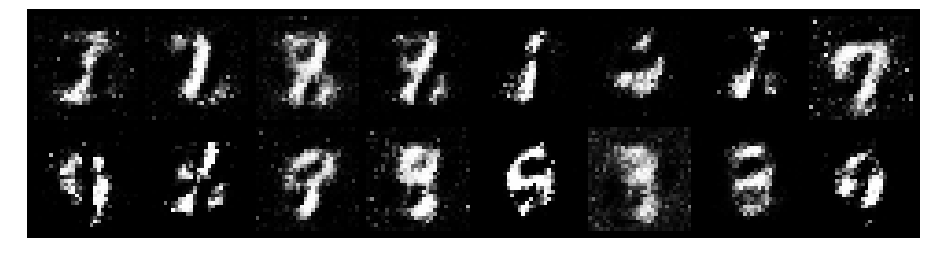

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.9753, Generator Loss: 1.7458
D(x): 0.6382, D(G(z)): 0.2274


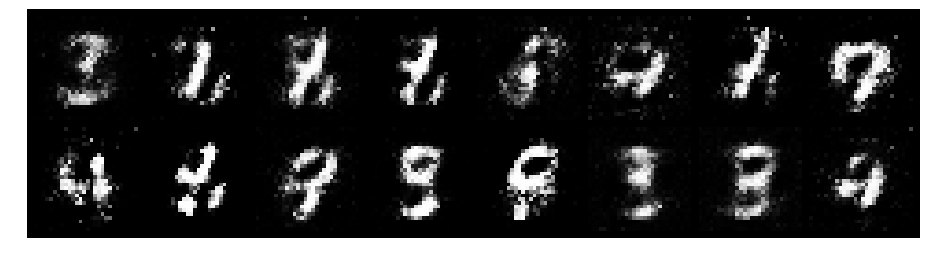

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7185, Generator Loss: 2.1326
D(x): 0.7008, D(G(z)): 0.1825


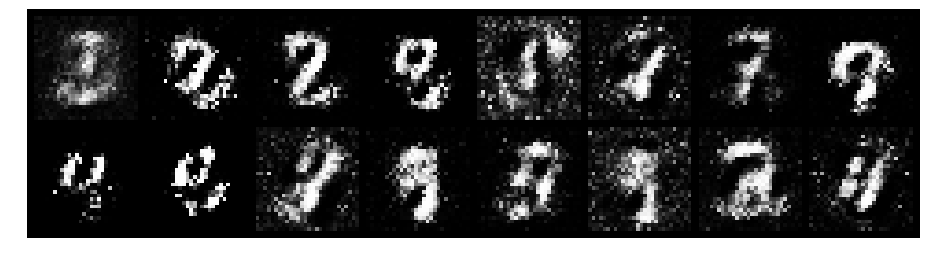

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.9096, Generator Loss: 2.0617
D(x): 0.7033, D(G(z)): 0.2229


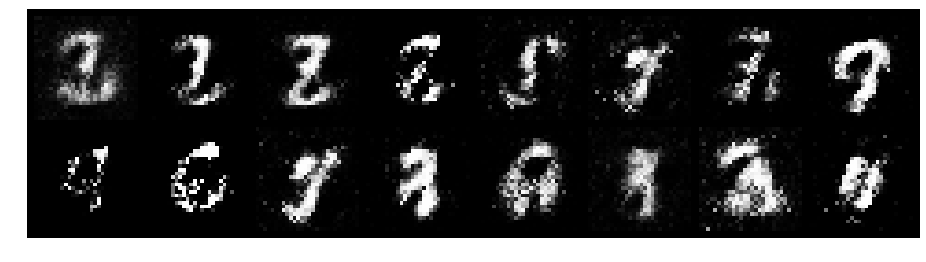

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.6995, Generator Loss: 1.9441
D(x): 0.8042, D(G(z)): 0.2638


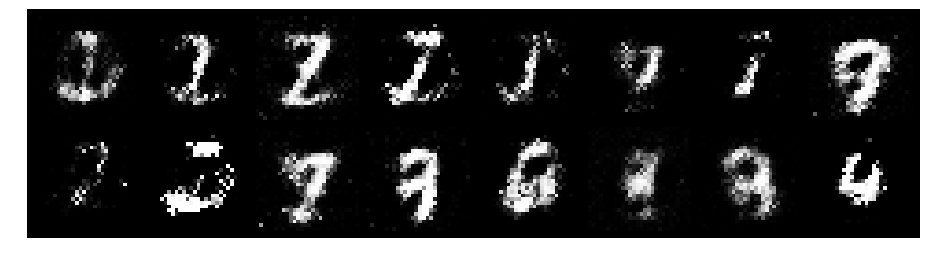

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.4890, Generator Loss: 2.4809
D(x): 0.8441, D(G(z)): 0.1883


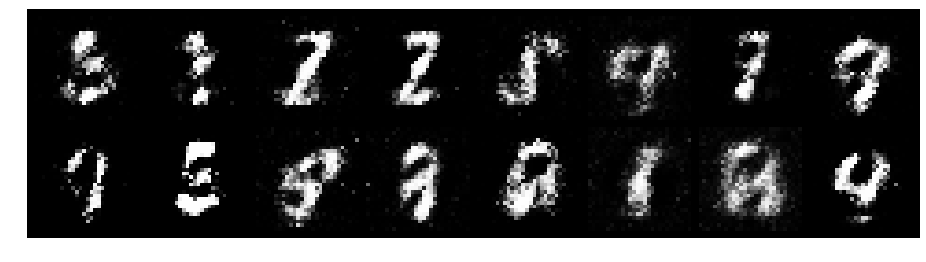

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.5697, Generator Loss: 2.1249
D(x): 0.8308, D(G(z)): 0.2382


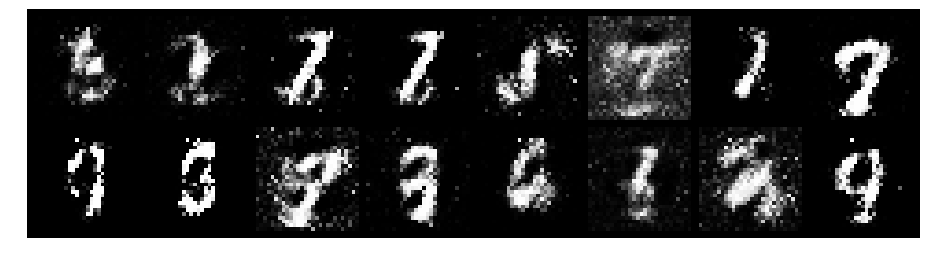

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.6736, Generator Loss: 1.8378
D(x): 0.7786, D(G(z)): 0.2302


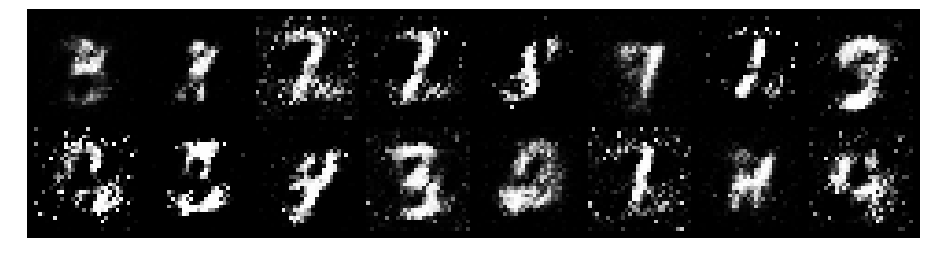

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.8987, Generator Loss: 1.4845
D(x): 0.8640, D(G(z)): 0.3897


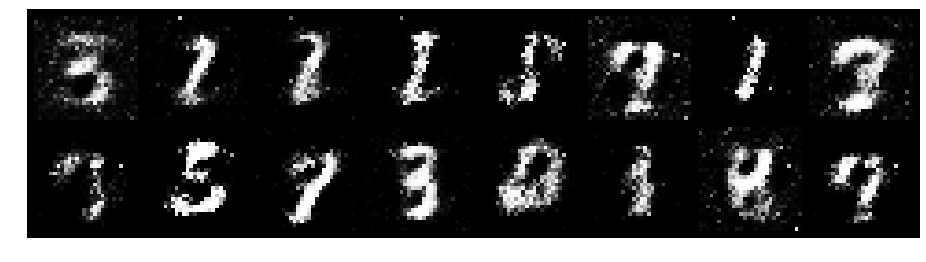

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.6602, Generator Loss: 2.2225
D(x): 0.7850, D(G(z)): 0.2246


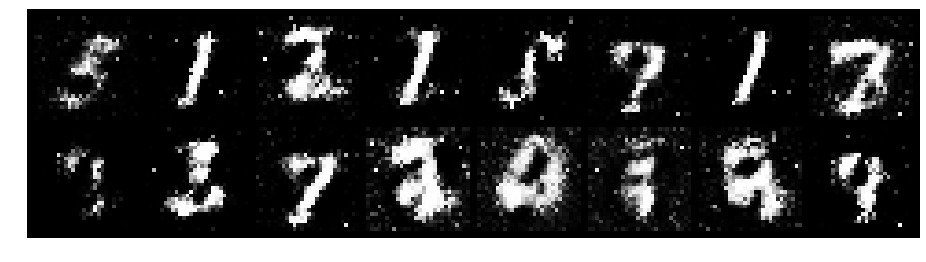

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.9269, Generator Loss: 2.0257
D(x): 0.7456, D(G(z)): 0.3030


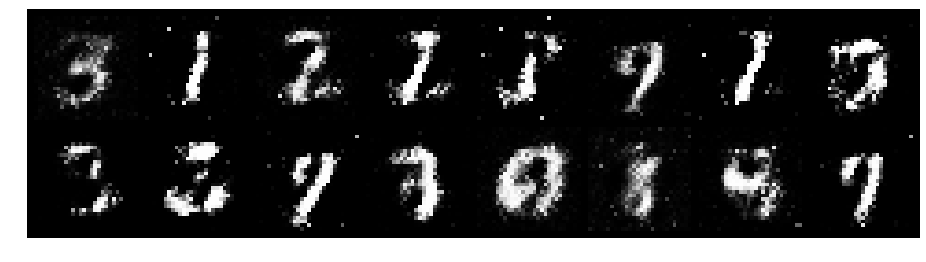

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7326, Generator Loss: 2.2620
D(x): 0.7734, D(G(z)): 0.2140


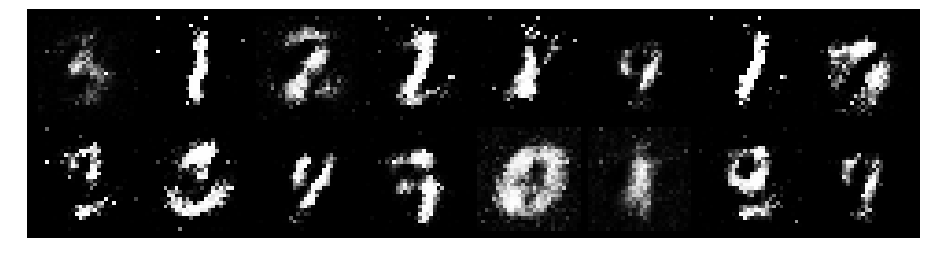

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7313, Generator Loss: 2.4360
D(x): 0.7707, D(G(z)): 0.2023


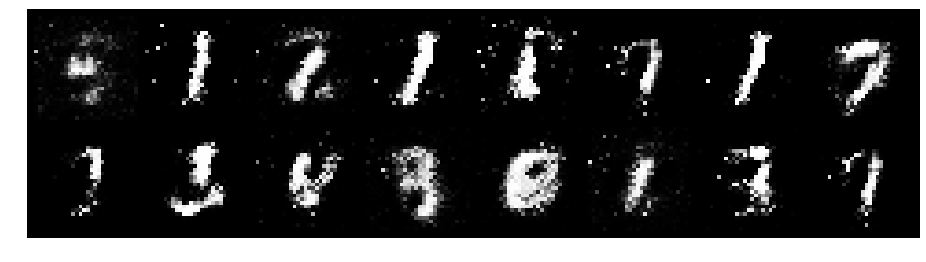

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.8054, Generator Loss: 1.8759
D(x): 0.7191, D(G(z)): 0.2343


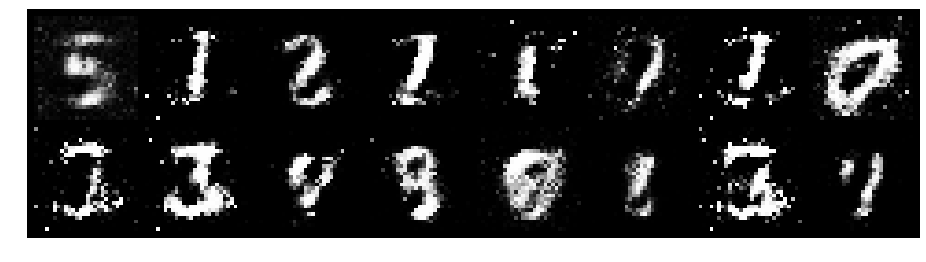

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.6959, Generator Loss: 2.5084
D(x): 0.7577, D(G(z)): 0.2150


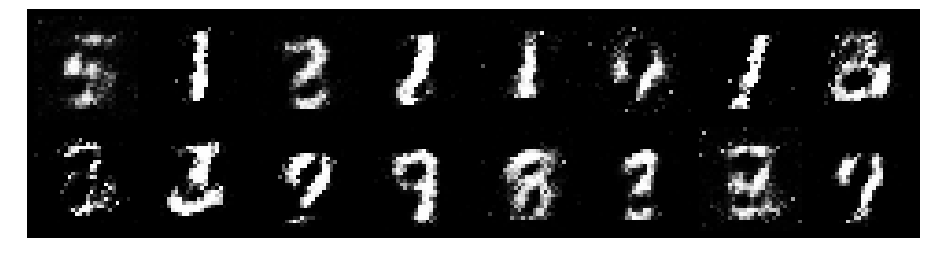

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.7660, Generator Loss: 2.3577
D(x): 0.7374, D(G(z)): 0.2019


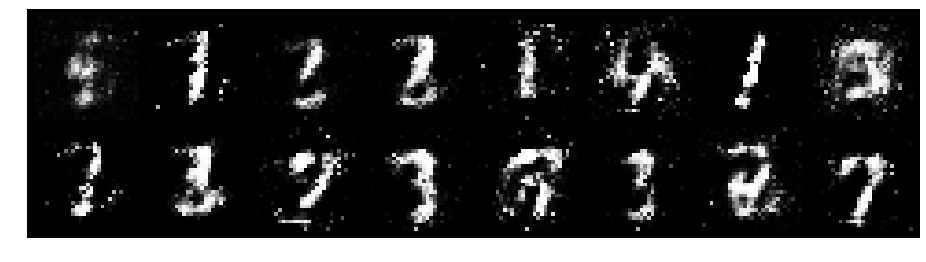

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8668, Generator Loss: 1.9845
D(x): 0.7109, D(G(z)): 0.2131


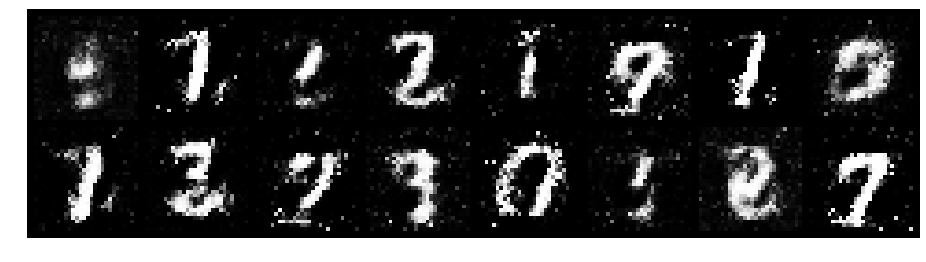

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7830, Generator Loss: 1.6442
D(x): 0.7485, D(G(z)): 0.2701


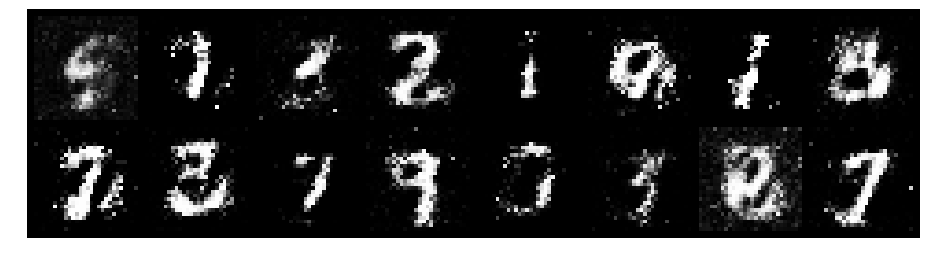

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.6843, Generator Loss: 2.3026
D(x): 0.7914, D(G(z)): 0.2455


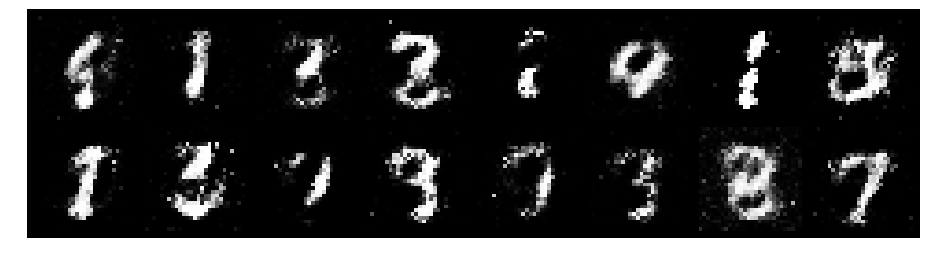

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8371, Generator Loss: 1.3823
D(x): 0.8057, D(G(z)): 0.3519


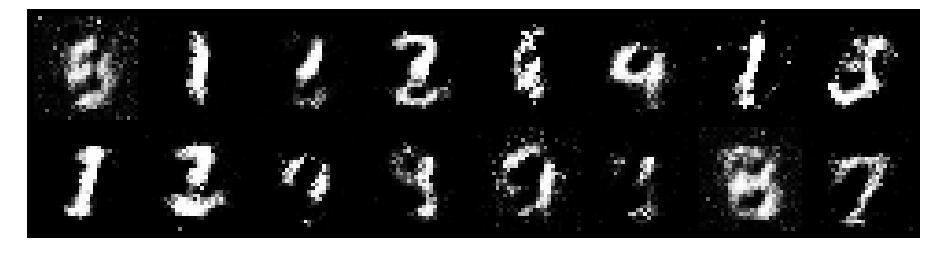

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7315, Generator Loss: 2.4043
D(x): 0.7784, D(G(z)): 0.2408


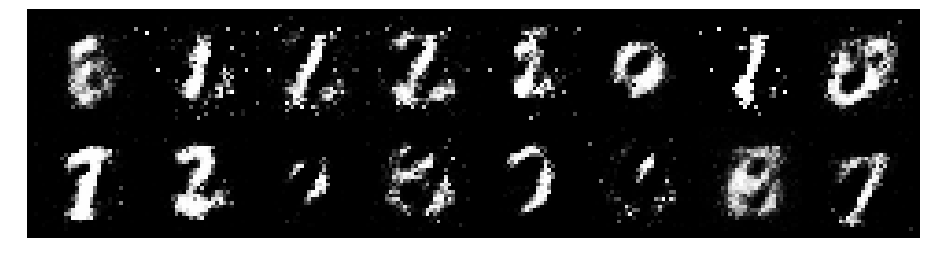

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8068, Generator Loss: 2.3562
D(x): 0.7599, D(G(z)): 0.2530


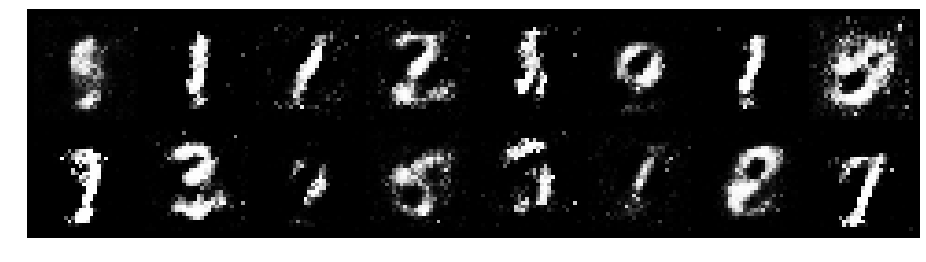

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 1.0218, Generator Loss: 1.8900
D(x): 0.7125, D(G(z)): 0.3160


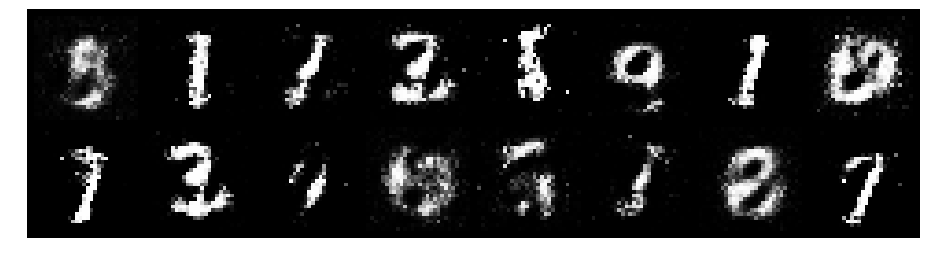

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8199, Generator Loss: 1.7153
D(x): 0.7963, D(G(z)): 0.3041


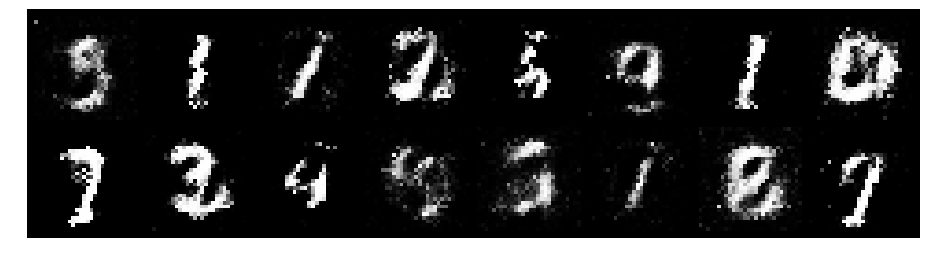

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.7598, Generator Loss: 2.1830
D(x): 0.7460, D(G(z)): 0.2247


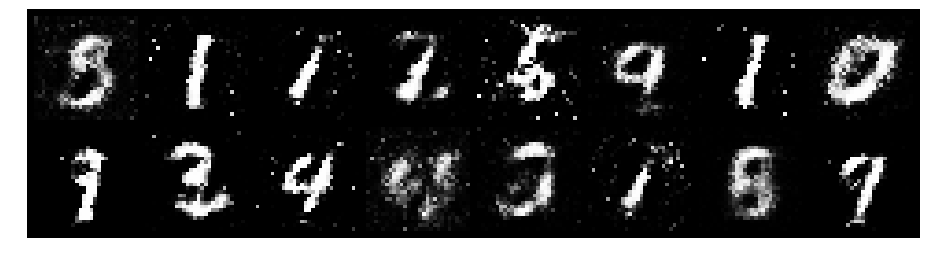

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7621, Generator Loss: 2.0781
D(x): 0.7452, D(G(z)): 0.2321


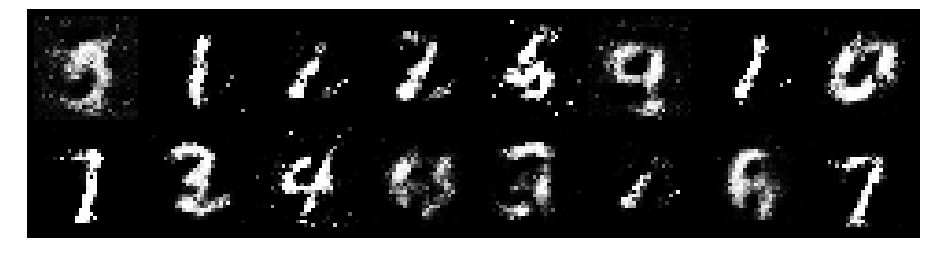

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7573, Generator Loss: 2.0337
D(x): 0.7924, D(G(z)): 0.2776


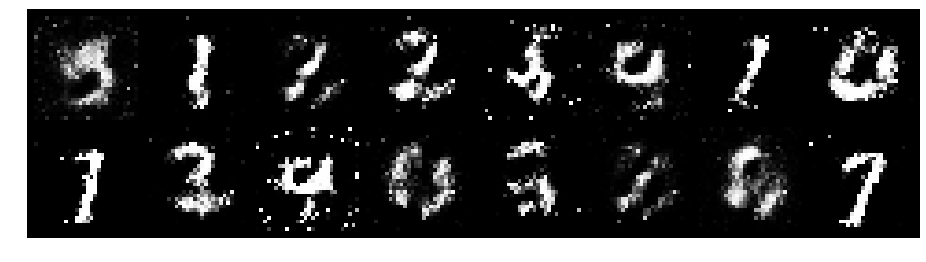

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.5648, Generator Loss: 2.0695
D(x): 0.8090, D(G(z)): 0.2302


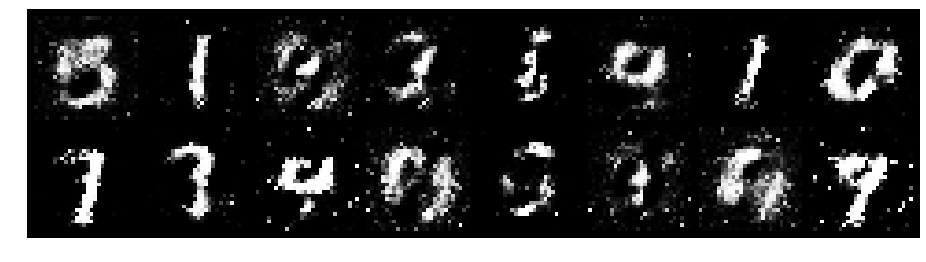

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.7530, Generator Loss: 2.3420
D(x): 0.7783, D(G(z)): 0.2867


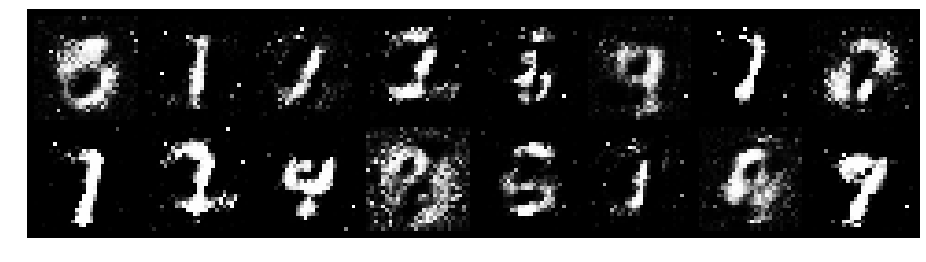

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8104, Generator Loss: 1.7979
D(x): 0.6789, D(G(z)): 0.2548


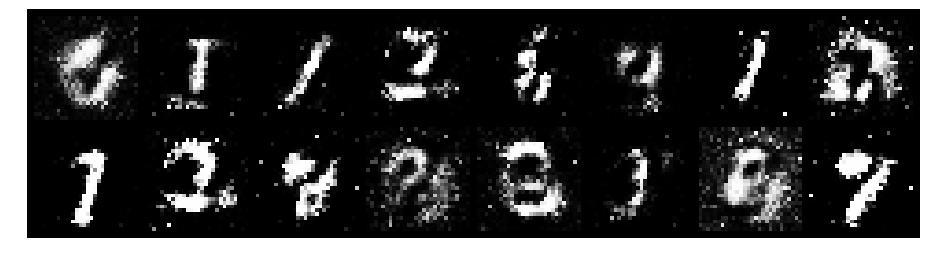

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8701, Generator Loss: 1.5162
D(x): 0.6744, D(G(z)): 0.2924


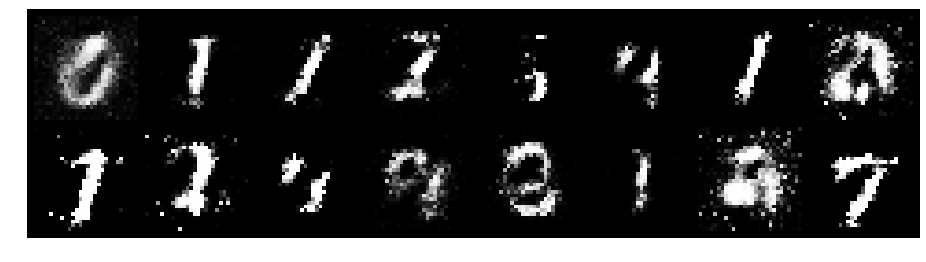

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.8917, Generator Loss: 2.0579
D(x): 0.6201, D(G(z)): 0.1997


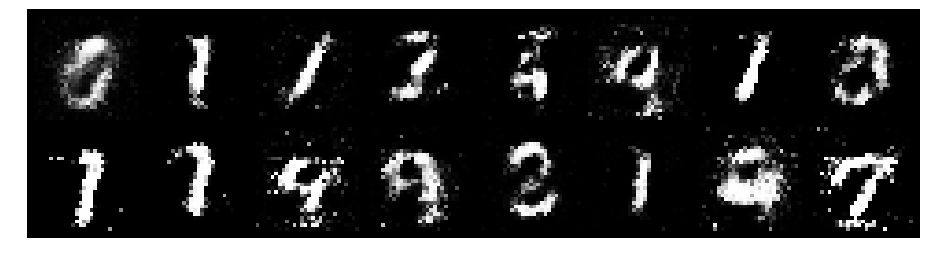

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.6752, Generator Loss: 1.9202
D(x): 0.7598, D(G(z)): 0.2259


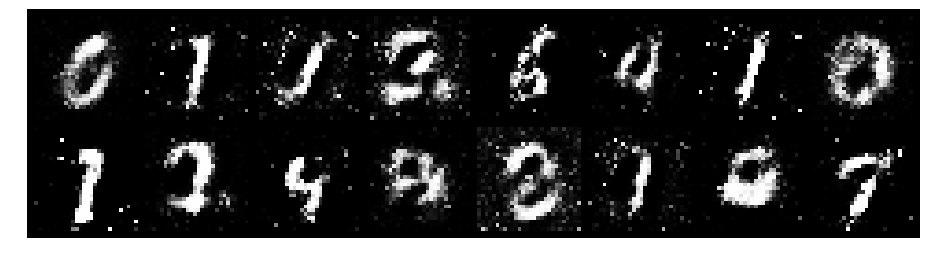

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.6835, Generator Loss: 1.6553
D(x): 0.7822, D(G(z)): 0.2857


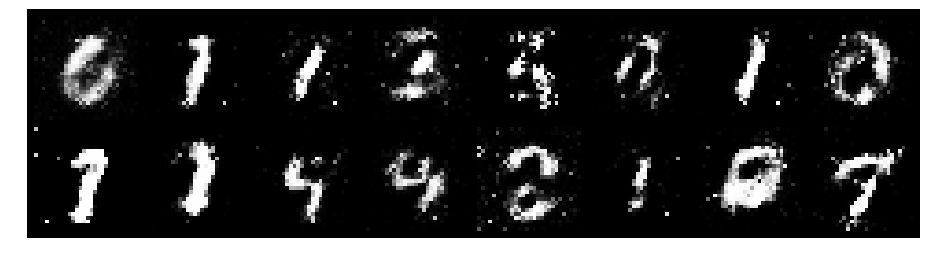

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.9780, Generator Loss: 1.4772
D(x): 0.7193, D(G(z)): 0.3091


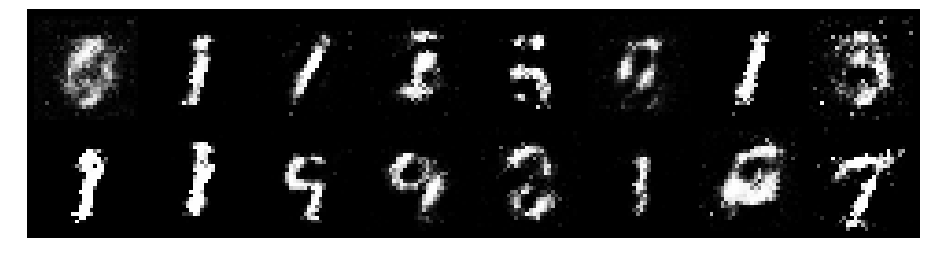

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 1.3792, Generator Loss: 1.6829
D(x): 0.5401, D(G(z)): 0.2363


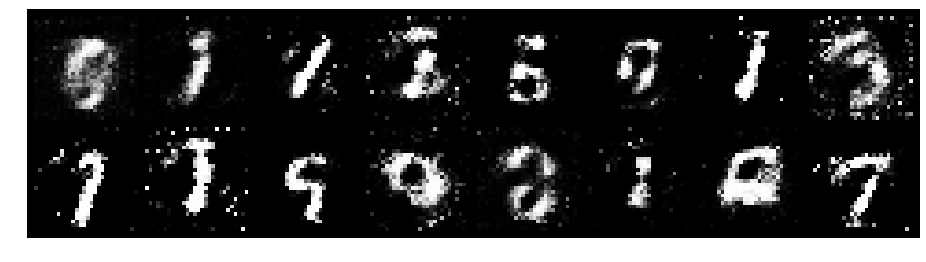

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.7631, Generator Loss: 1.9143
D(x): 0.7739, D(G(z)): 0.2716


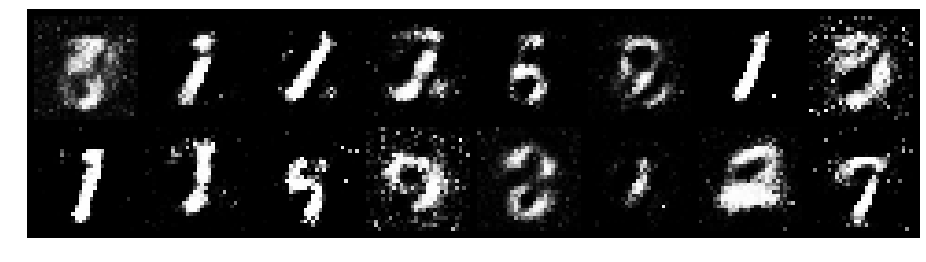

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9351, Generator Loss: 1.7521
D(x): 0.6979, D(G(z)): 0.2714


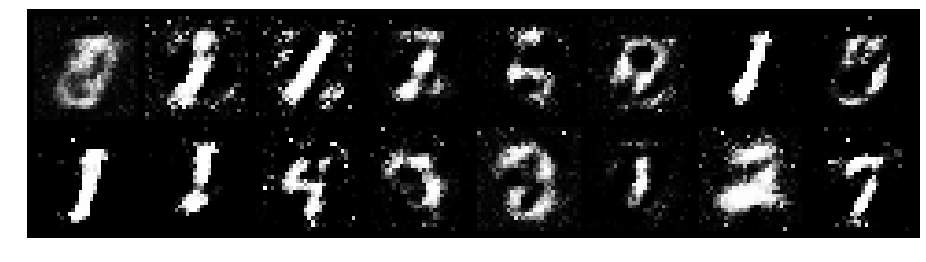

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.9057, Generator Loss: 1.9089
D(x): 0.7543, D(G(z)): 0.3137


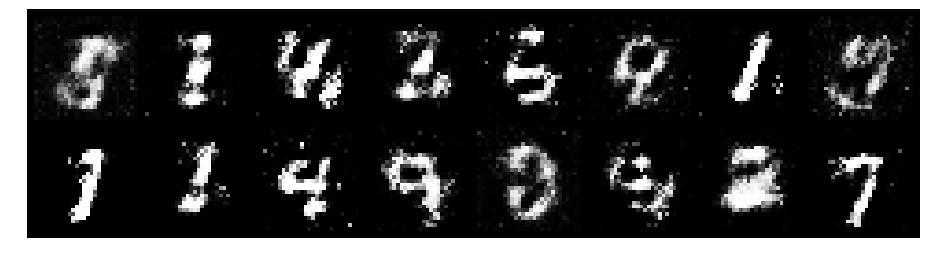

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.6038, Generator Loss: 1.8413
D(x): 0.8154, D(G(z)): 0.2279


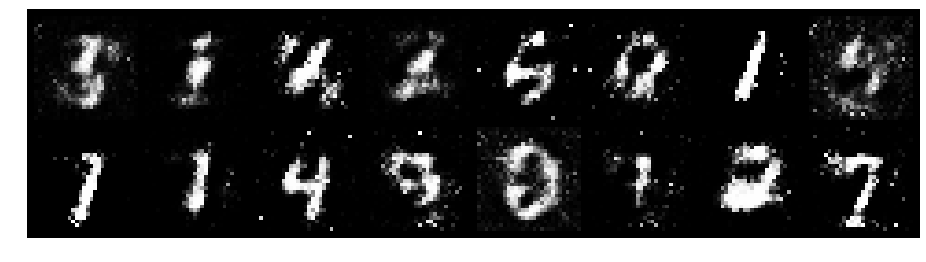

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8728, Generator Loss: 1.1545
D(x): 0.7599, D(G(z)): 0.3572


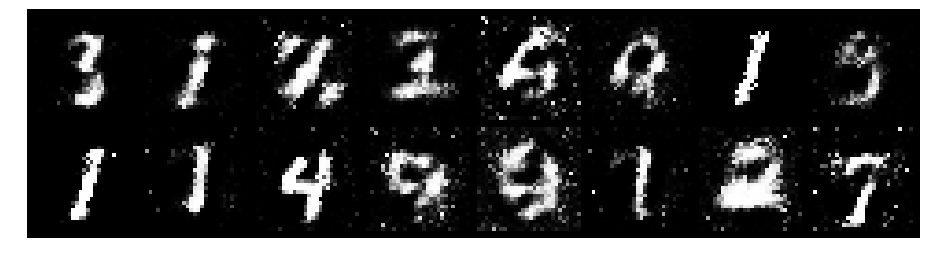

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.8191, Generator Loss: 1.5070
D(x): 0.7332, D(G(z)): 0.3029


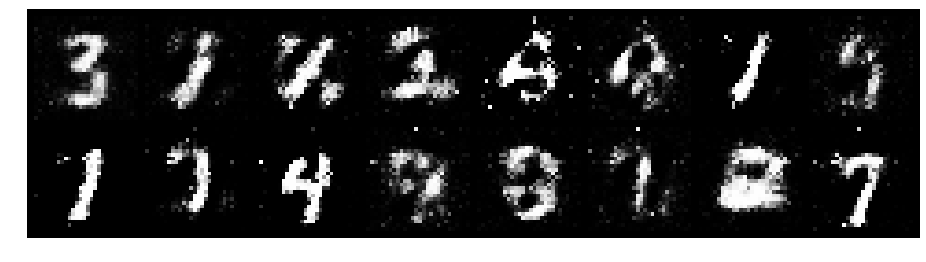

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.9861, Generator Loss: 2.2843
D(x): 0.6513, D(G(z)): 0.1935


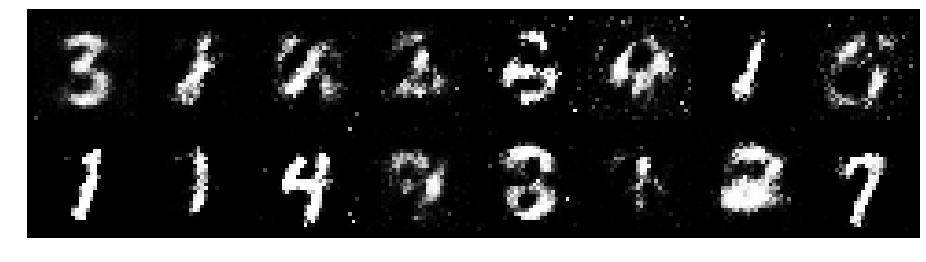

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9816, Generator Loss: 1.4787
D(x): 0.7917, D(G(z)): 0.3965


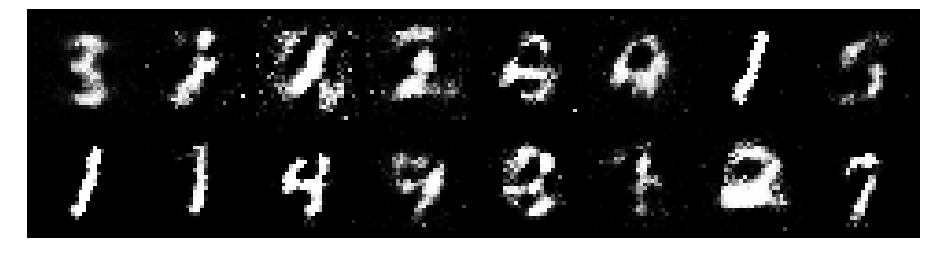

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8031, Generator Loss: 1.5755
D(x): 0.7295, D(G(z)): 0.2567


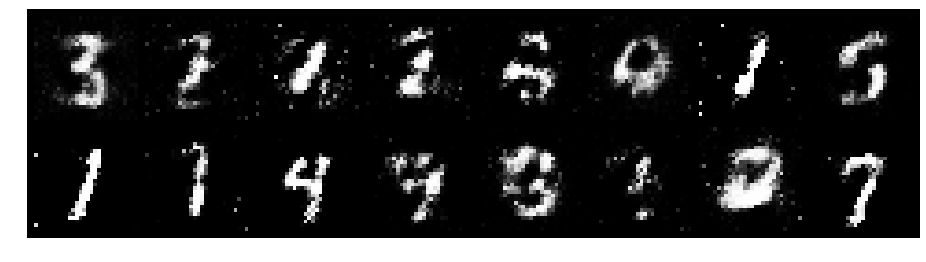

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.9652, Generator Loss: 1.7456
D(x): 0.7149, D(G(z)): 0.3377


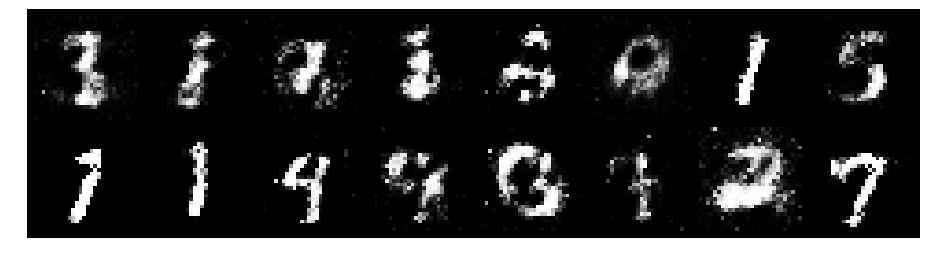

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8648, Generator Loss: 1.7430
D(x): 0.6674, D(G(z)): 0.2480


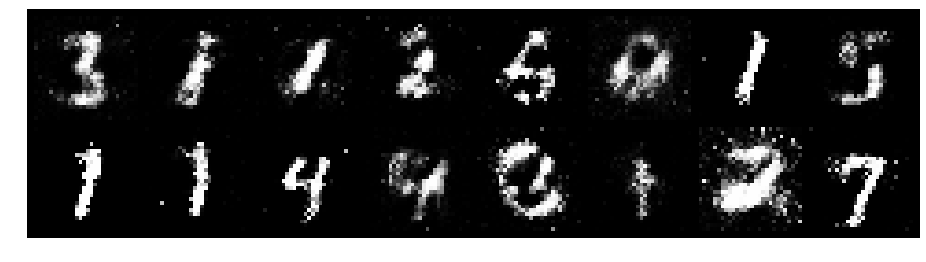

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.6734, Generator Loss: 1.8132
D(x): 0.8025, D(G(z)): 0.2759


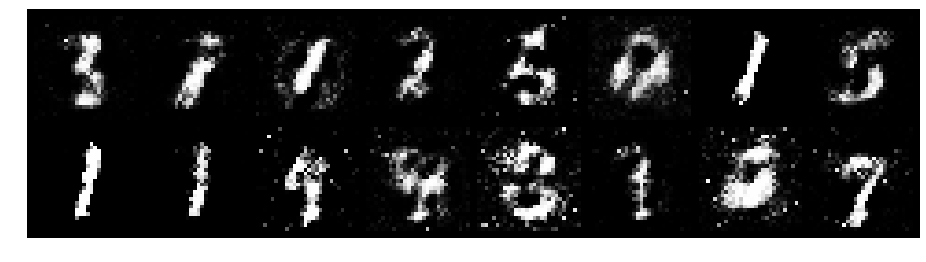

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.6564, Generator Loss: 1.6629
D(x): 0.7699, D(G(z)): 0.2452


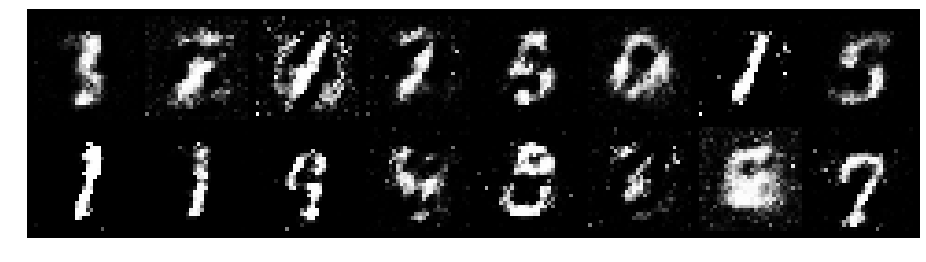

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 1.2290, Generator Loss: 1.3044
D(x): 0.5462, D(G(z)): 0.3575


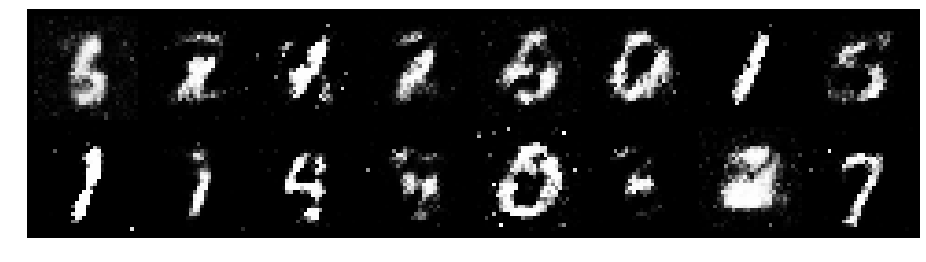

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8898, Generator Loss: 1.9337
D(x): 0.6891, D(G(z)): 0.2579


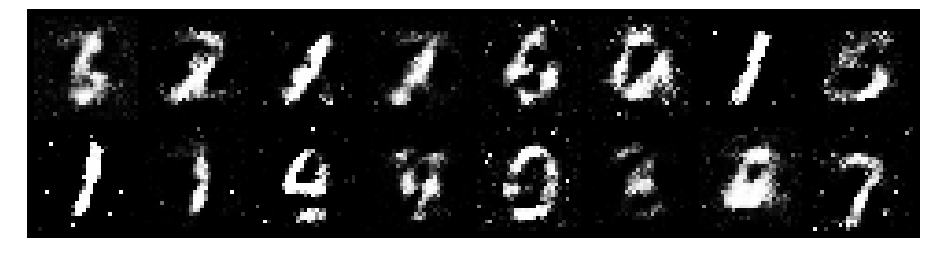

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8947, Generator Loss: 1.7640
D(x): 0.6805, D(G(z)): 0.3057


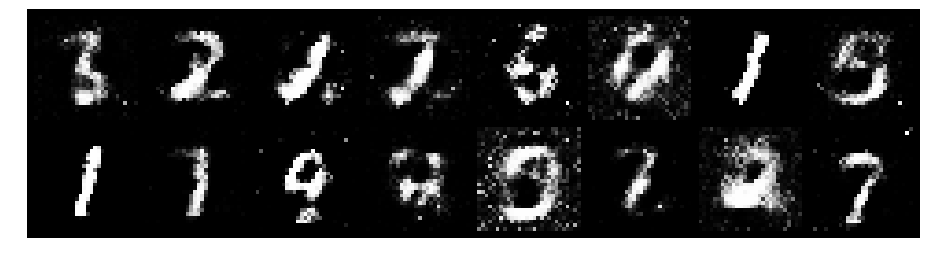

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 1.0145, Generator Loss: 1.5743
D(x): 0.7073, D(G(z)): 0.3743


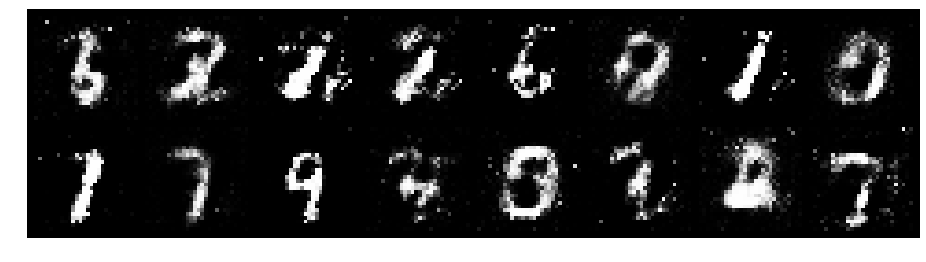

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9732, Generator Loss: 1.2101
D(x): 0.6827, D(G(z)): 0.3600


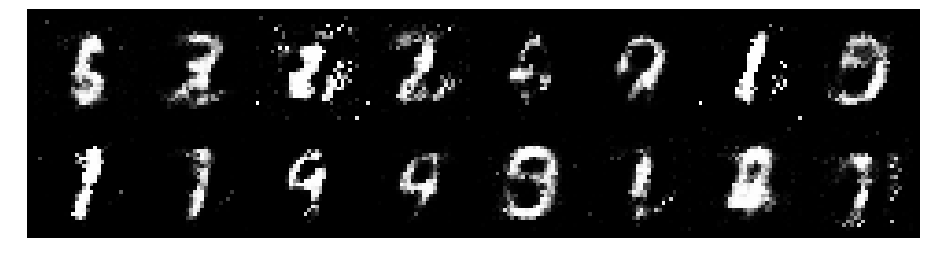

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.8704, Generator Loss: 1.4337
D(x): 0.7440, D(G(z)): 0.3493


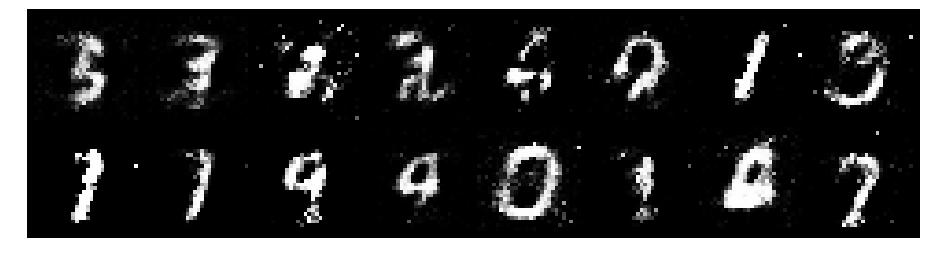

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.0215, Generator Loss: 1.4002
D(x): 0.6770, D(G(z)): 0.3772


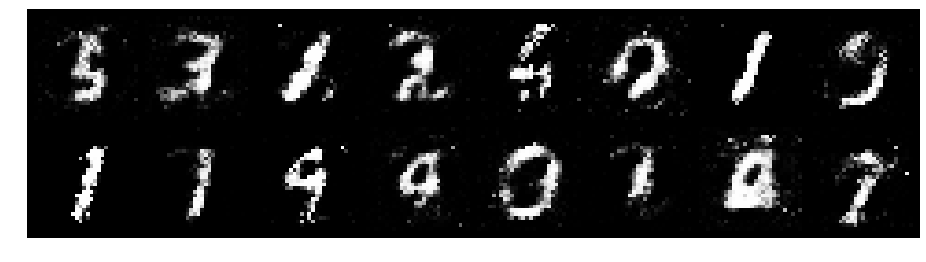

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.8031, Generator Loss: 1.6293
D(x): 0.6687, D(G(z)): 0.2139


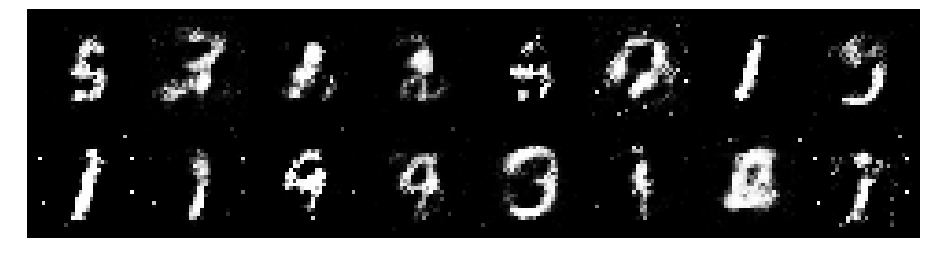

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.9890, Generator Loss: 1.4157
D(x): 0.7356, D(G(z)): 0.4138


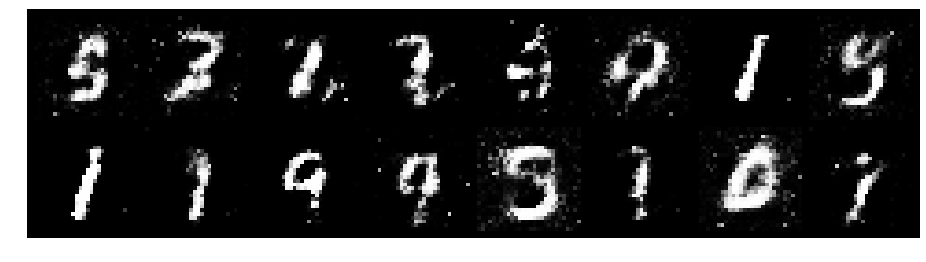

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 1.1244, Generator Loss: 1.3685
D(x): 0.5921, D(G(z)): 0.3479


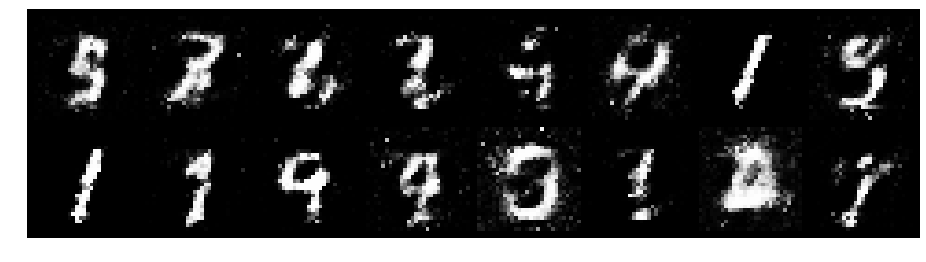

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9792, Generator Loss: 1.3206
D(x): 0.6738, D(G(z)): 0.3556


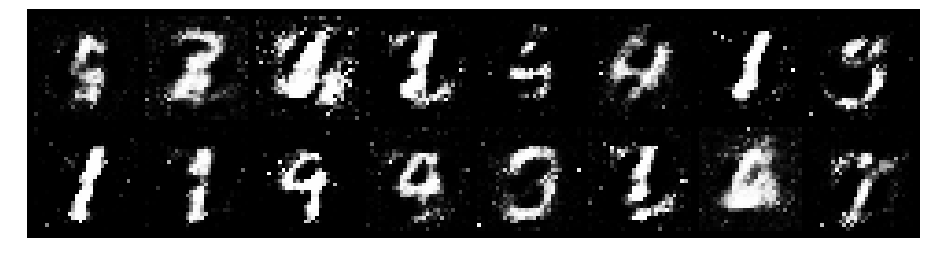

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0237, Generator Loss: 1.1263
D(x): 0.6398, D(G(z)): 0.3331


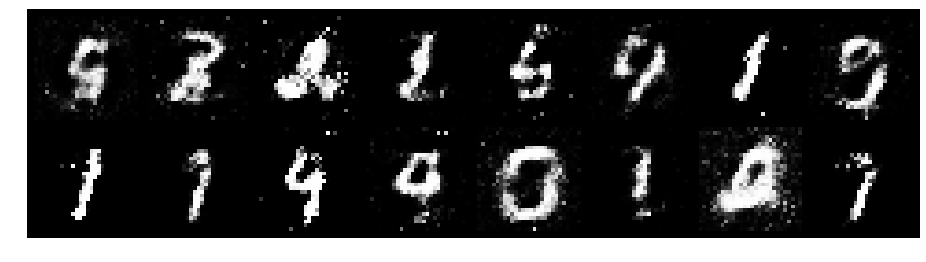

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 1.1318, Generator Loss: 1.2754
D(x): 0.5957, D(G(z)): 0.3027


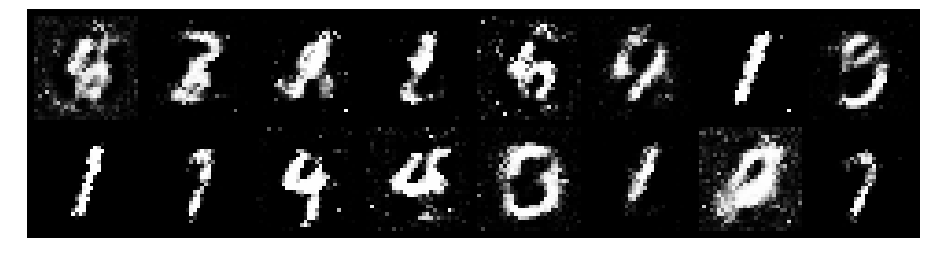

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.1026, Generator Loss: 1.5399
D(x): 0.6378, D(G(z)): 0.3249


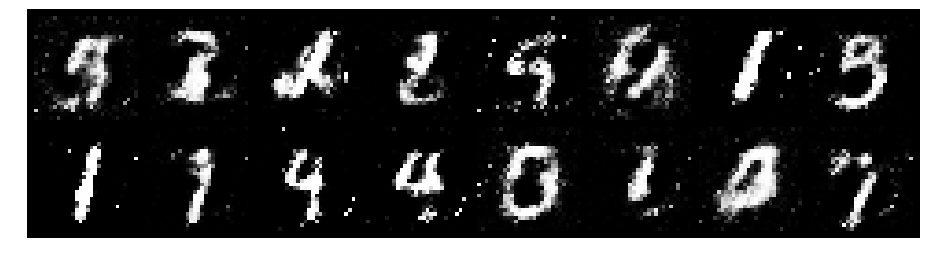

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 1.0624, Generator Loss: 1.6865
D(x): 0.6518, D(G(z)): 0.3044


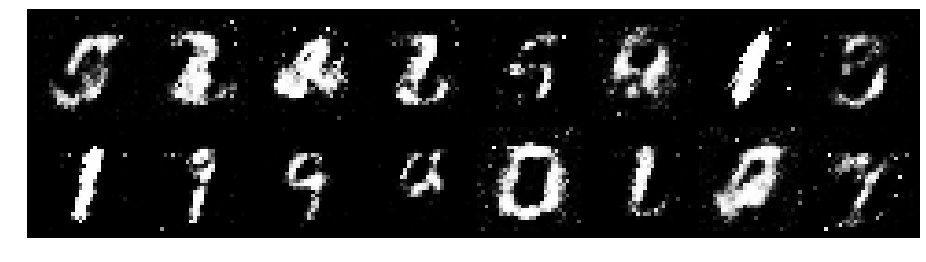

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9046, Generator Loss: 2.1011
D(x): 0.7619, D(G(z)): 0.3231


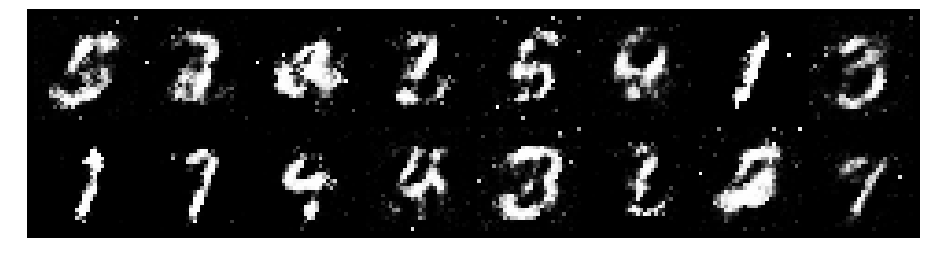

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9061, Generator Loss: 1.4663
D(x): 0.7957, D(G(z)): 0.3470


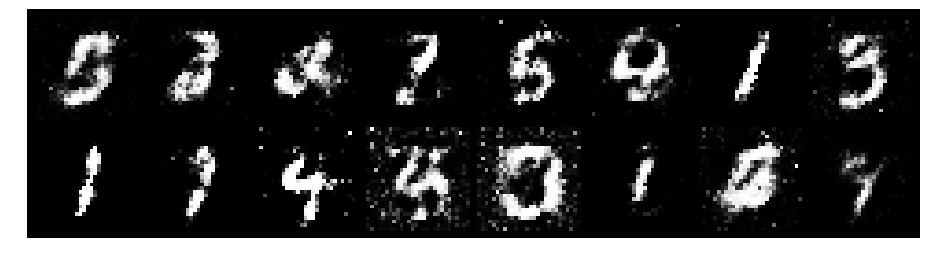

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8035, Generator Loss: 2.1786
D(x): 0.7068, D(G(z)): 0.2253


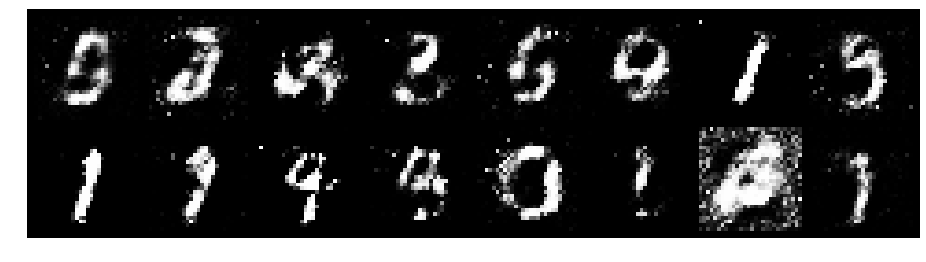

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 1.0238, Generator Loss: 1.6488
D(x): 0.7222, D(G(z)): 0.3484


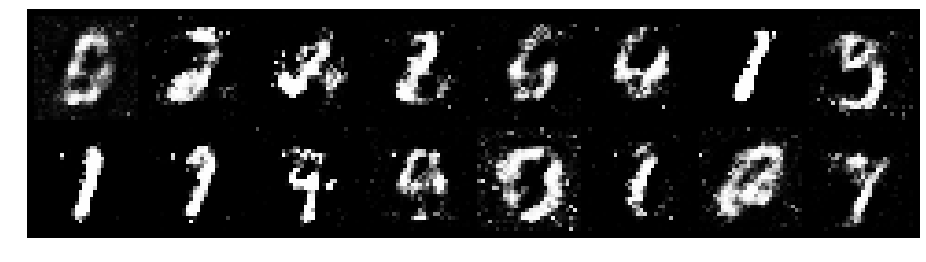

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.7944, Generator Loss: 1.6034
D(x): 0.6640, D(G(z)): 0.1964


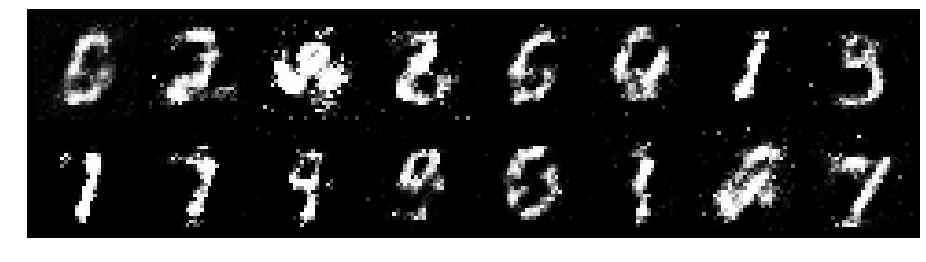

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.0744, Generator Loss: 1.3487
D(x): 0.7007, D(G(z)): 0.3829


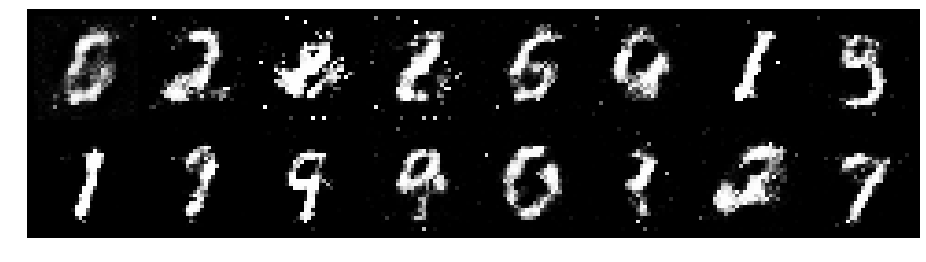

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.8610, Generator Loss: 1.5303
D(x): 0.7311, D(G(z)): 0.3097


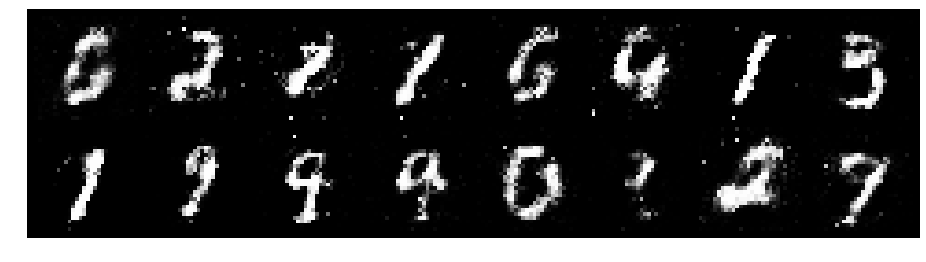

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9426, Generator Loss: 1.7391
D(x): 0.6767, D(G(z)): 0.3043


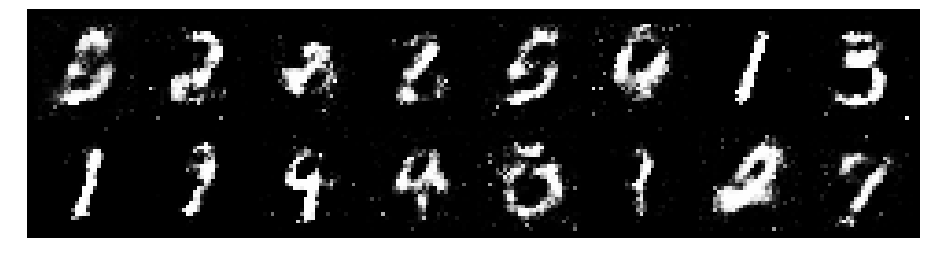

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8643, Generator Loss: 1.6876
D(x): 0.7423, D(G(z)): 0.3045


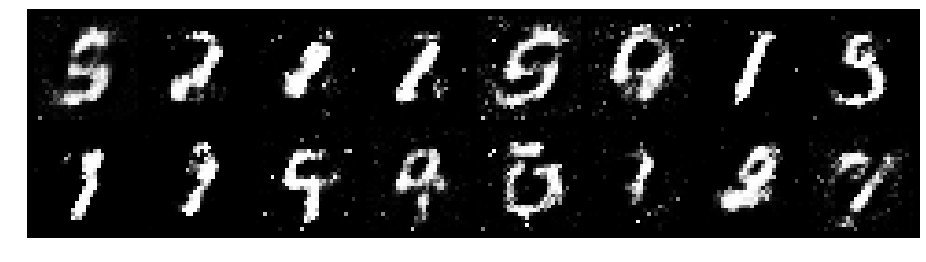

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8617, Generator Loss: 1.9343
D(x): 0.6721, D(G(z)): 0.2437


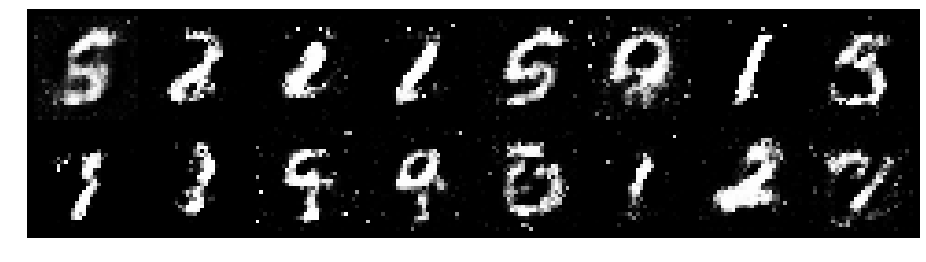

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.1329, Generator Loss: 2.1033
D(x): 0.6308, D(G(z)): 0.3278


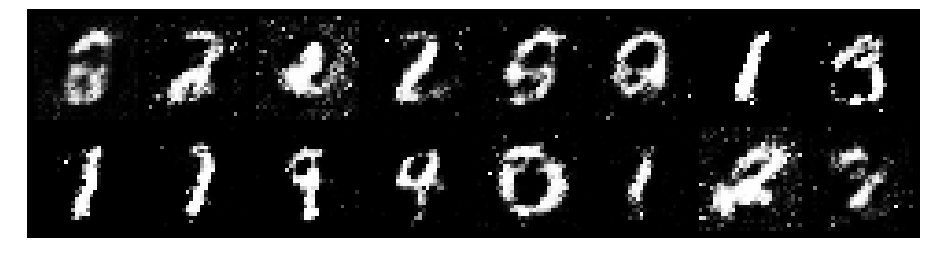

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 1.0670, Generator Loss: 1.4966
D(x): 0.6522, D(G(z)): 0.3314


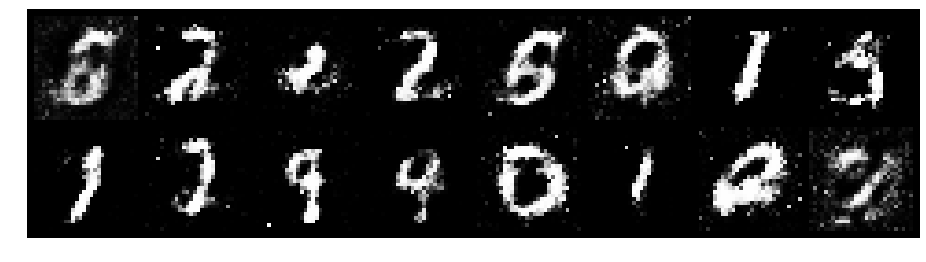

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.2316, Generator Loss: 1.0947
D(x): 0.6111, D(G(z)): 0.3746


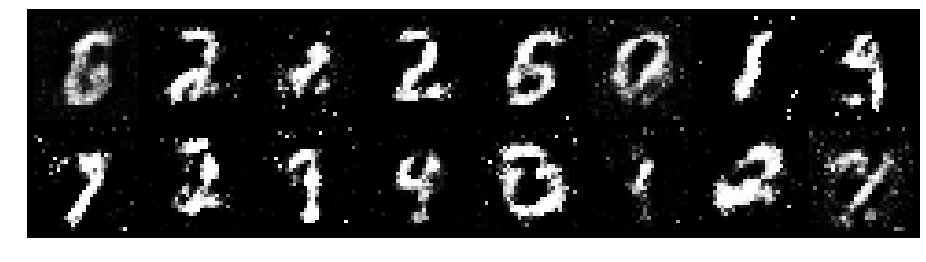

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9966, Generator Loss: 1.3685
D(x): 0.6500, D(G(z)): 0.3054


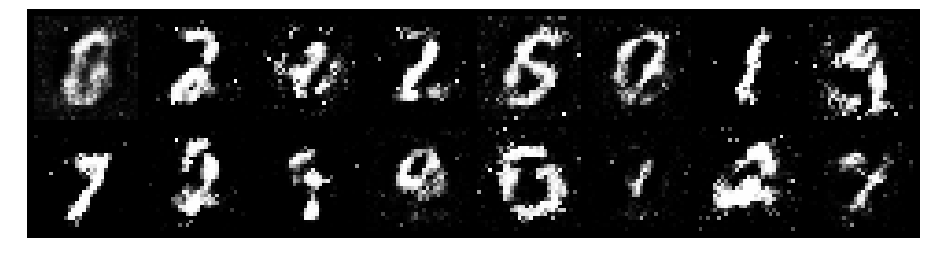

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.8454, Generator Loss: 1.5242
D(x): 0.7568, D(G(z)): 0.3393


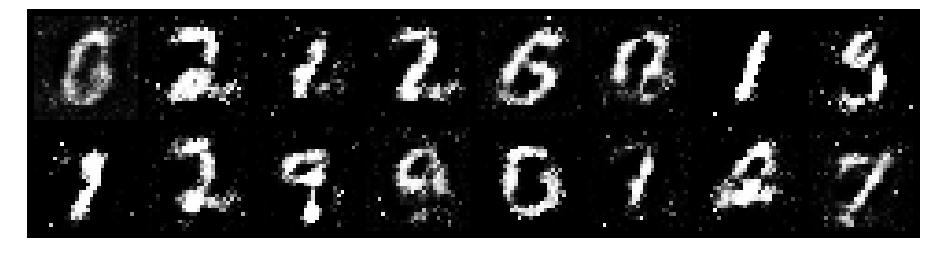

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 1.1423, Generator Loss: 1.3696
D(x): 0.6228, D(G(z)): 0.3690


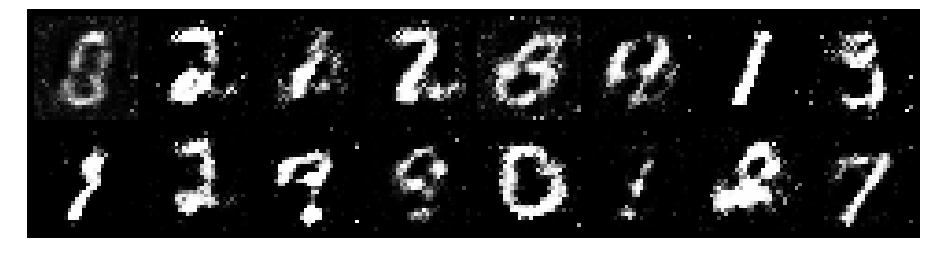

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9532, Generator Loss: 1.5909
D(x): 0.6520, D(G(z)): 0.2491


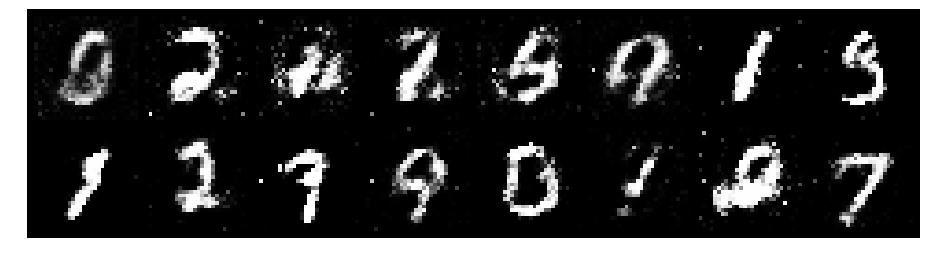

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0398, Generator Loss: 1.5480
D(x): 0.6480, D(G(z)): 0.3290


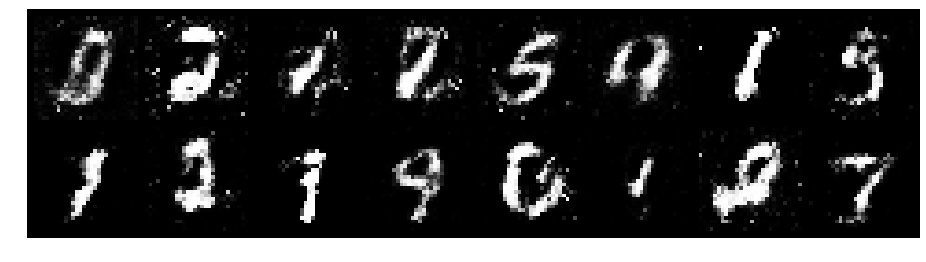

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.1363, Generator Loss: 1.0766
D(x): 0.6908, D(G(z)): 0.4147


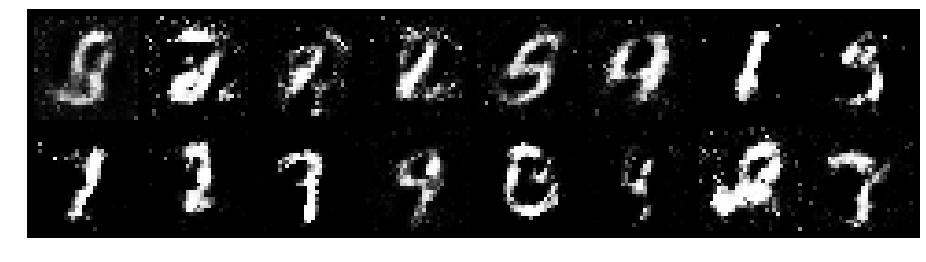

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0936, Generator Loss: 1.4633
D(x): 0.5704, D(G(z)): 0.2771


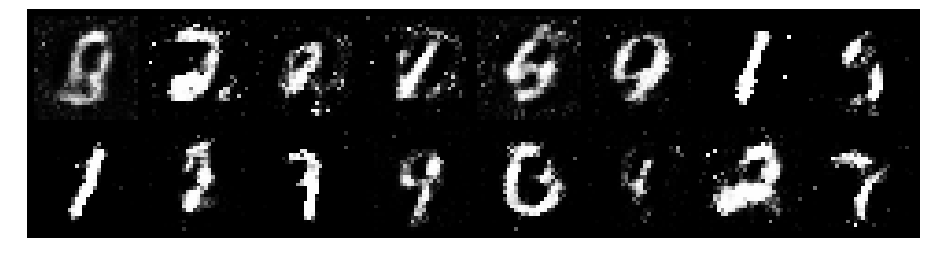

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0626, Generator Loss: 1.4946
D(x): 0.6829, D(G(z)): 0.3687


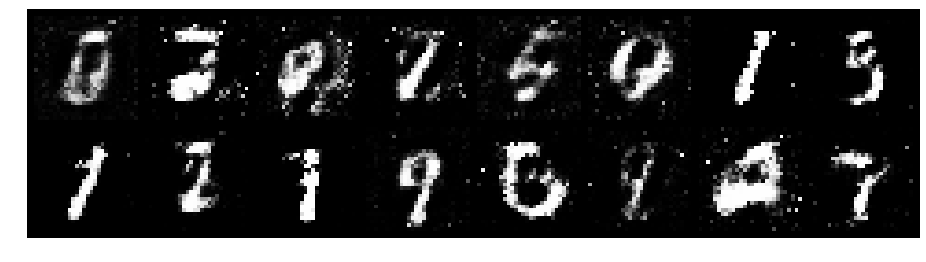

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.9526, Generator Loss: 1.7294
D(x): 0.6246, D(G(z)): 0.2546


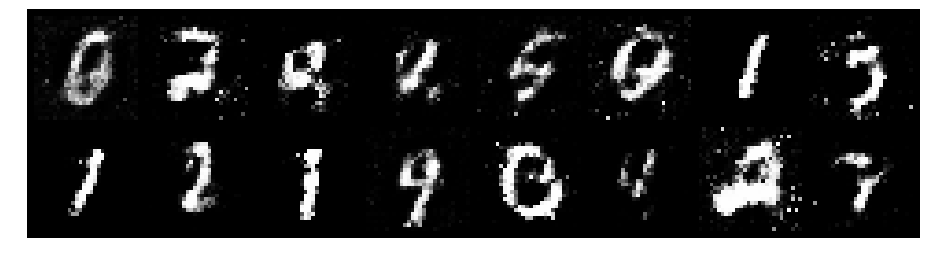

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9166, Generator Loss: 1.5619
D(x): 0.6942, D(G(z)): 0.2961


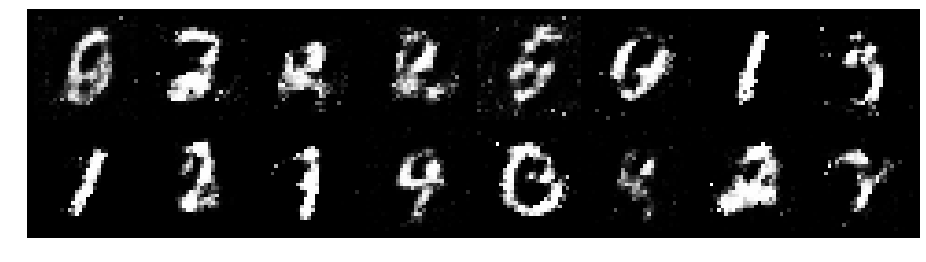

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9715, Generator Loss: 1.6101
D(x): 0.7456, D(G(z)): 0.3682


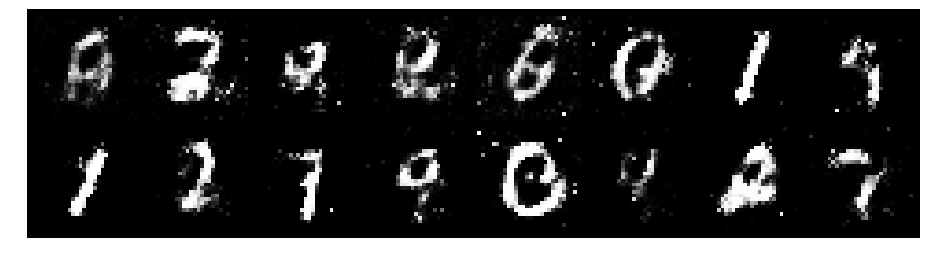

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0209, Generator Loss: 1.5167
D(x): 0.6778, D(G(z)): 0.3787


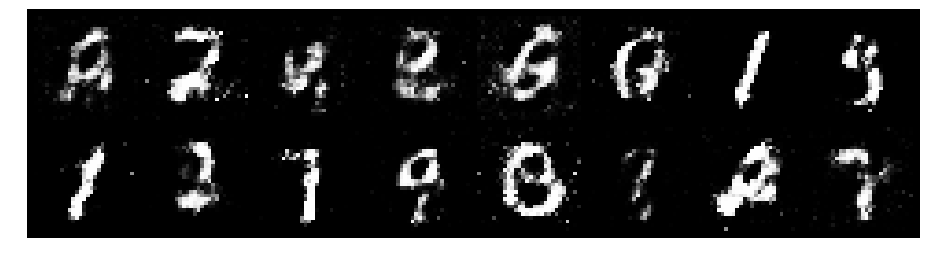

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9185, Generator Loss: 1.4594
D(x): 0.6578, D(G(z)): 0.2689


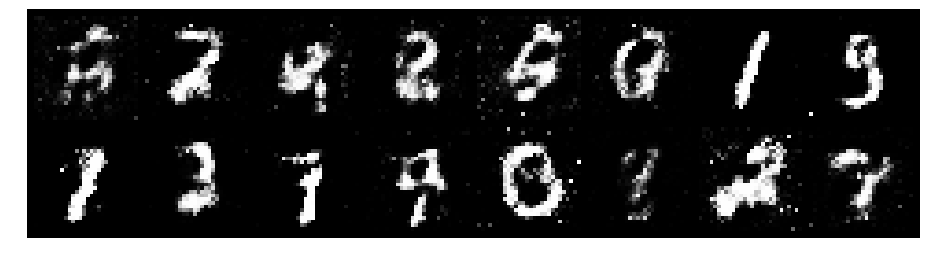

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9484, Generator Loss: 1.4953
D(x): 0.6744, D(G(z)): 0.3283


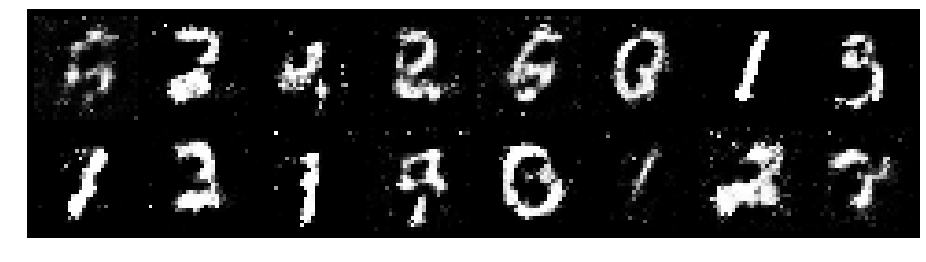

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9192, Generator Loss: 1.3820
D(x): 0.7039, D(G(z)): 0.3310


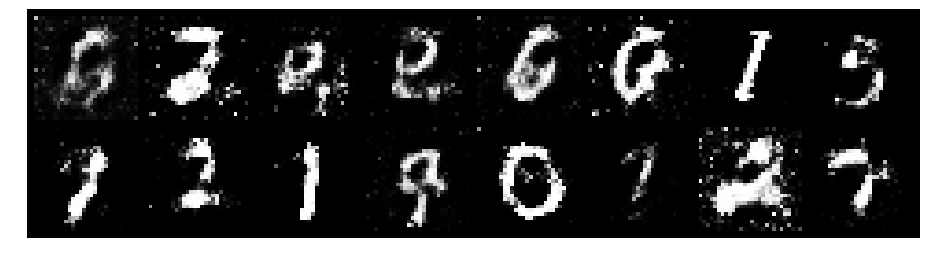

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 1.0508, Generator Loss: 1.2786
D(x): 0.6764, D(G(z)): 0.3595


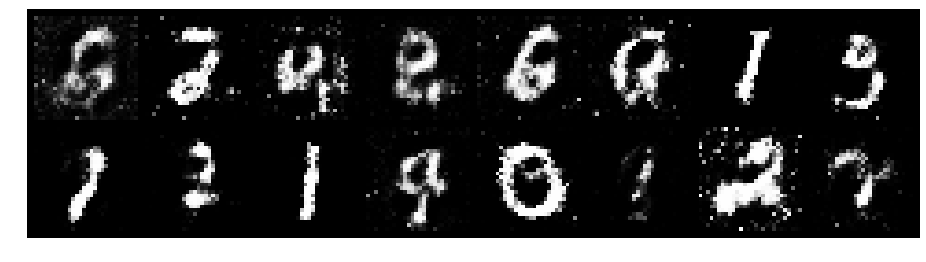

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.9407, Generator Loss: 1.5454
D(x): 0.6752, D(G(z)): 0.2735


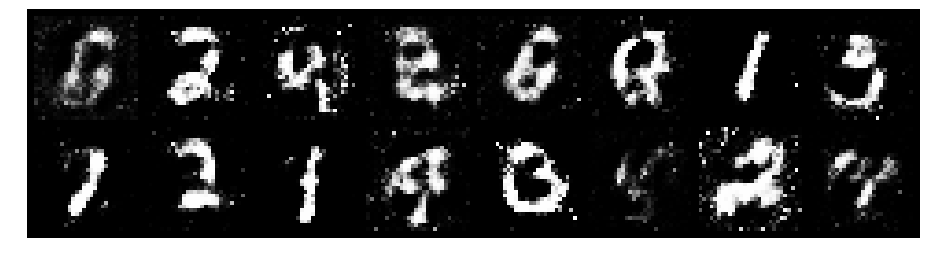

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.9476, Generator Loss: 1.5425
D(x): 0.7053, D(G(z)): 0.3517


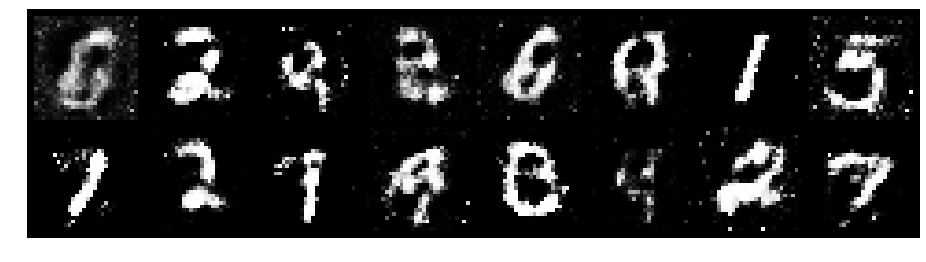

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0359, Generator Loss: 1.4439
D(x): 0.7166, D(G(z)): 0.3827


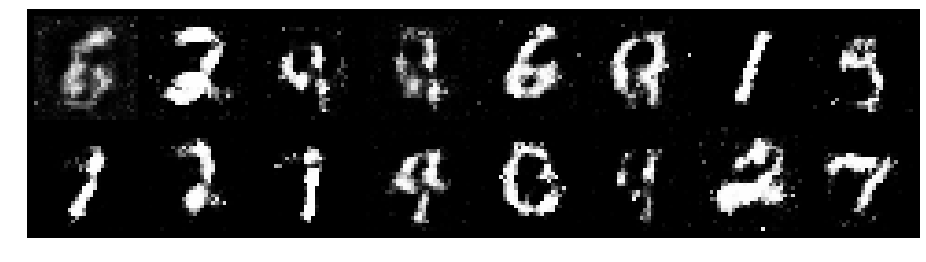

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.0276, Generator Loss: 1.5873
D(x): 0.6578, D(G(z)): 0.3401


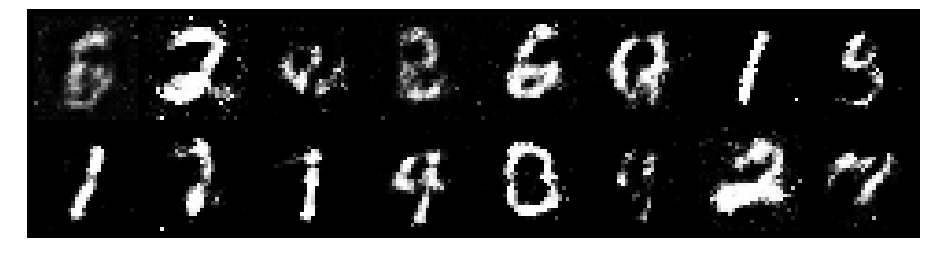

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0937, Generator Loss: 1.2567
D(x): 0.6436, D(G(z)): 0.3669


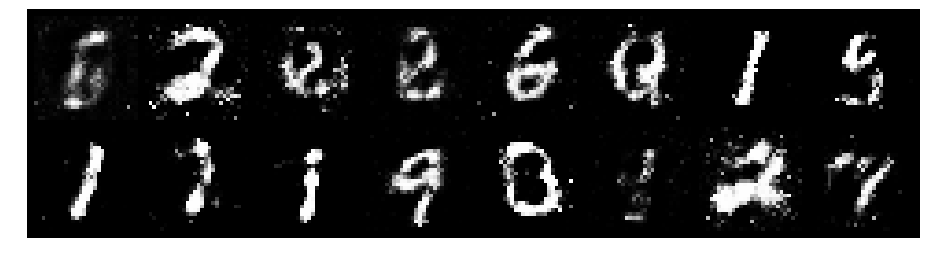

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0158, Generator Loss: 1.3499
D(x): 0.6412, D(G(z)): 0.3432


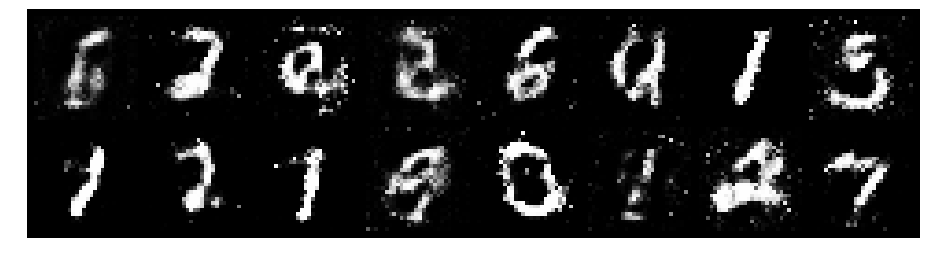

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.0375, Generator Loss: 1.7177
D(x): 0.6409, D(G(z)): 0.3132


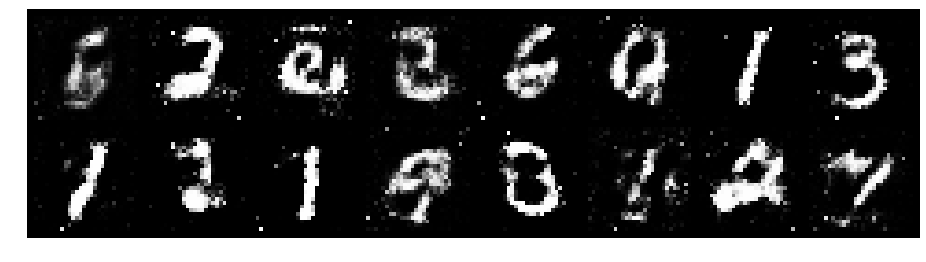

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.1551, Generator Loss: 1.1919
D(x): 0.6058, D(G(z)): 0.3531


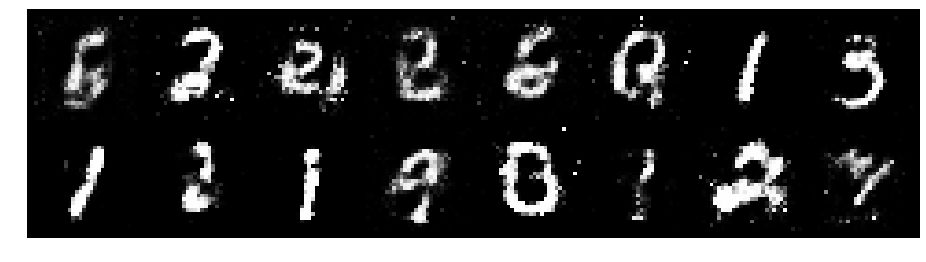

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9049, Generator Loss: 1.9318
D(x): 0.7633, D(G(z)): 0.3314


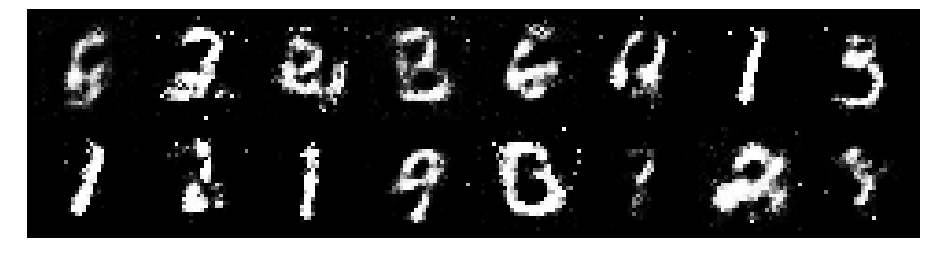

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.8741, Generator Loss: 1.2694
D(x): 0.6894, D(G(z)): 0.2800


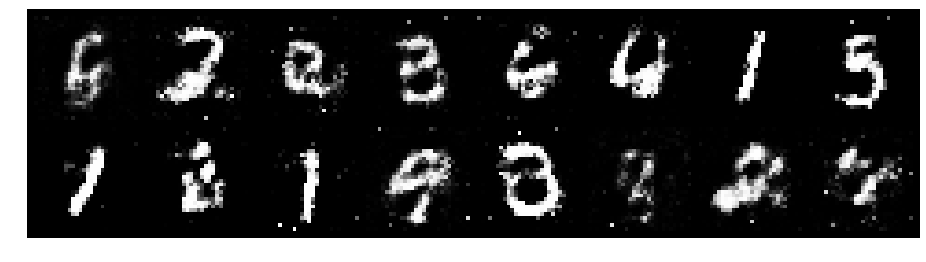

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.1273, Generator Loss: 1.4197
D(x): 0.5614, D(G(z)): 0.3040


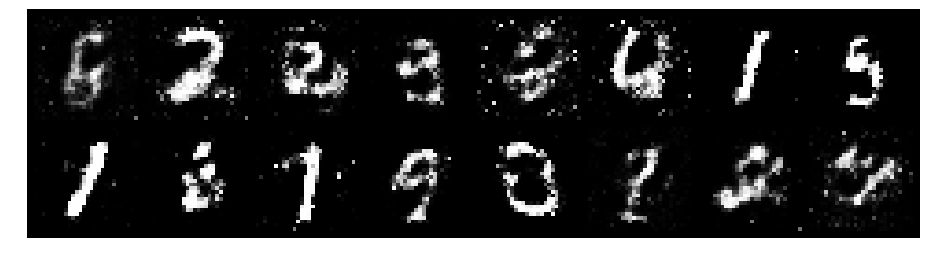

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0925, Generator Loss: 0.9460
D(x): 0.6399, D(G(z)): 0.3987


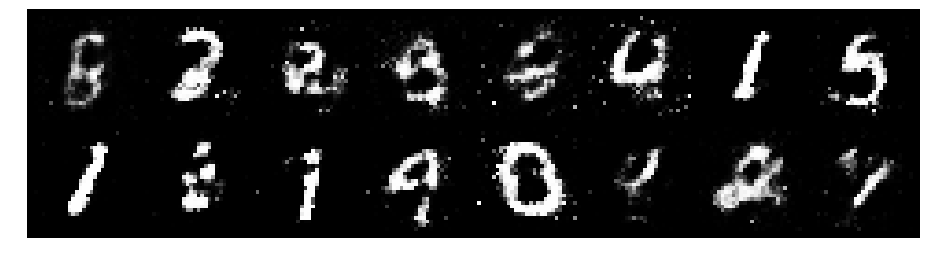

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.1299, Generator Loss: 1.5613
D(x): 0.6126, D(G(z)): 0.3193


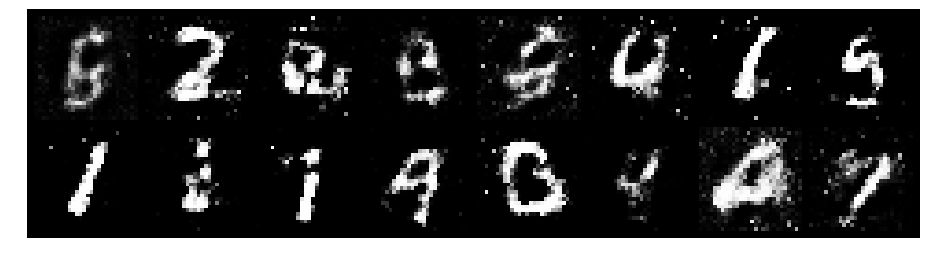

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.1645, Generator Loss: 1.5215
D(x): 0.6261, D(G(z)): 0.3782


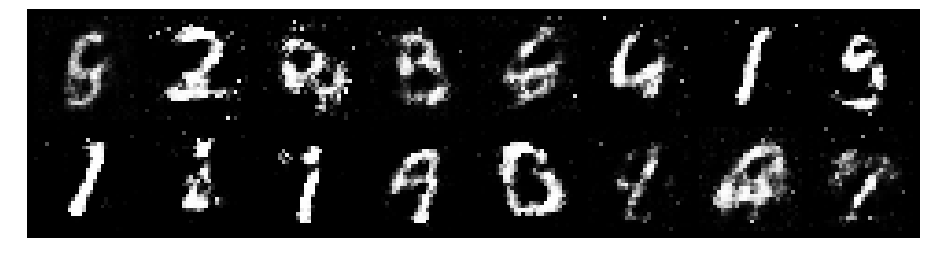

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.2433, Generator Loss: 1.0149
D(x): 0.5868, D(G(z)): 0.4181


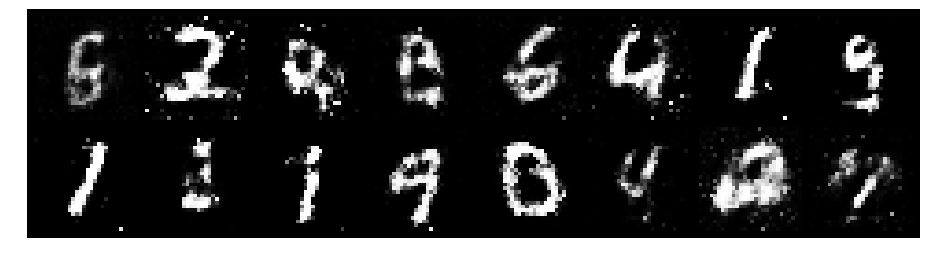

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.1342, Generator Loss: 1.0304
D(x): 0.6195, D(G(z)): 0.3601


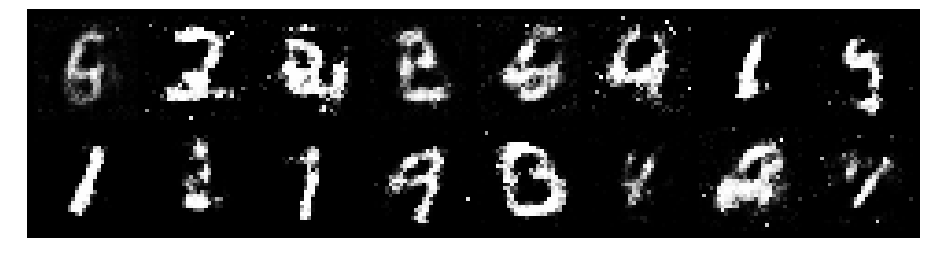

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9934, Generator Loss: 1.1480
D(x): 0.6606, D(G(z)): 0.3538


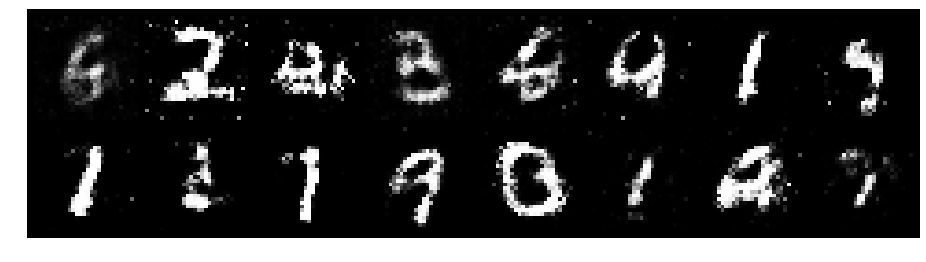

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9197, Generator Loss: 1.4181
D(x): 0.6764, D(G(z)): 0.3281


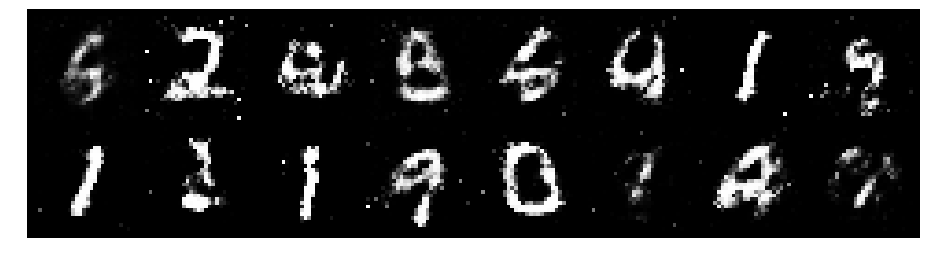

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0288, Generator Loss: 1.2549
D(x): 0.6553, D(G(z)): 0.3771


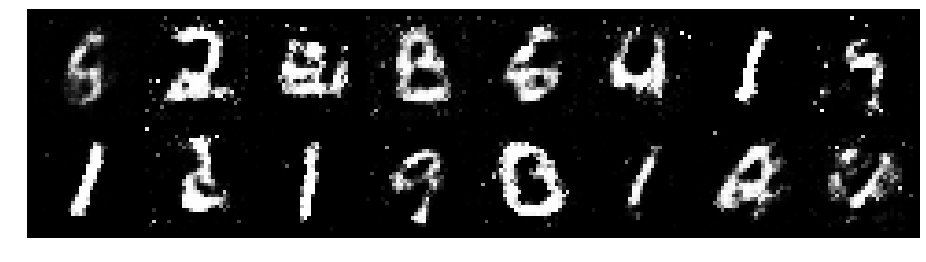

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 1.0430, Generator Loss: 1.2559
D(x): 0.6887, D(G(z)): 0.3824


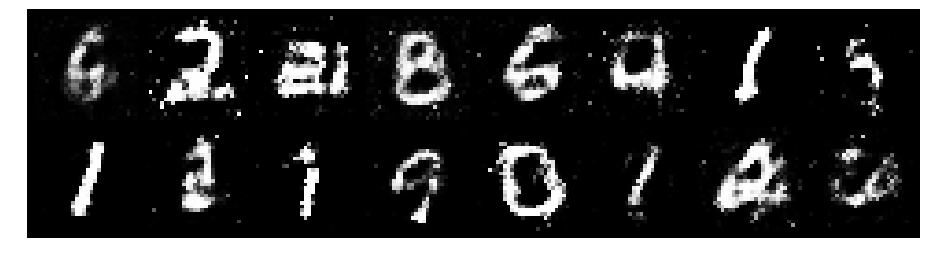

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.1409, Generator Loss: 1.1852
D(x): 0.7045, D(G(z)): 0.4506


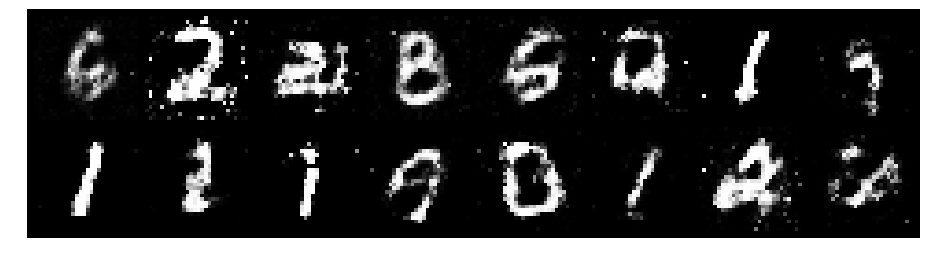

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.1402, Generator Loss: 1.2994
D(x): 0.6612, D(G(z)): 0.3778


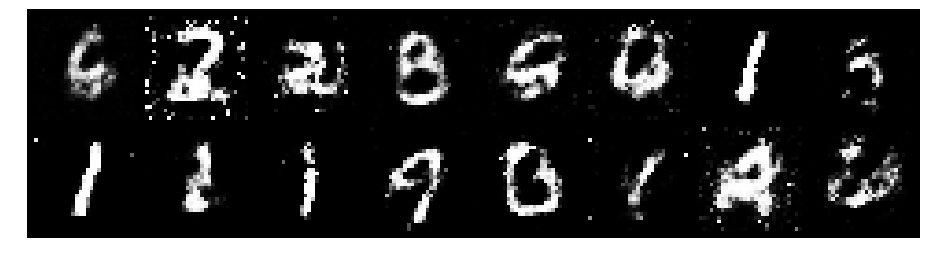

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.1295, Generator Loss: 1.2914
D(x): 0.6308, D(G(z)): 0.3766


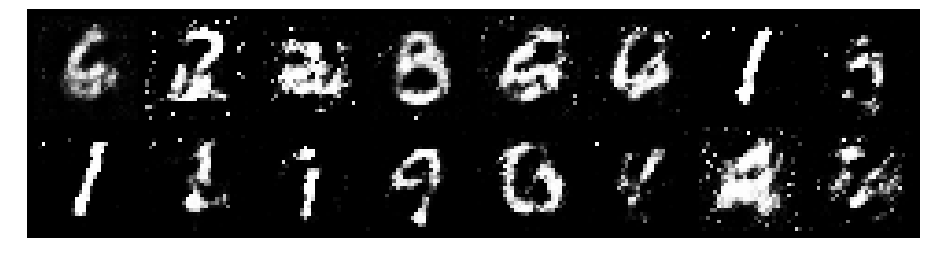

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1180, Generator Loss: 1.1724
D(x): 0.6165, D(G(z)): 0.4028


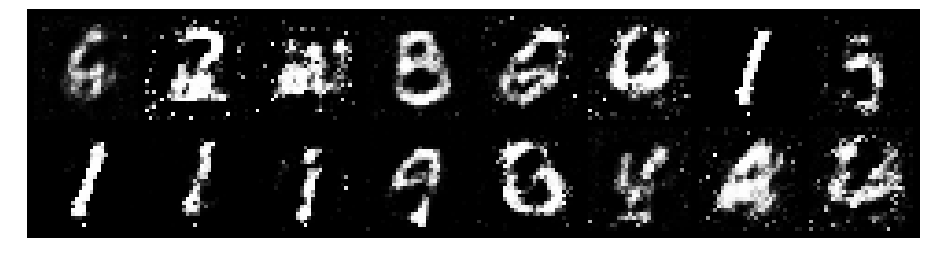

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1720, Generator Loss: 1.2430
D(x): 0.5641, D(G(z)): 0.3255


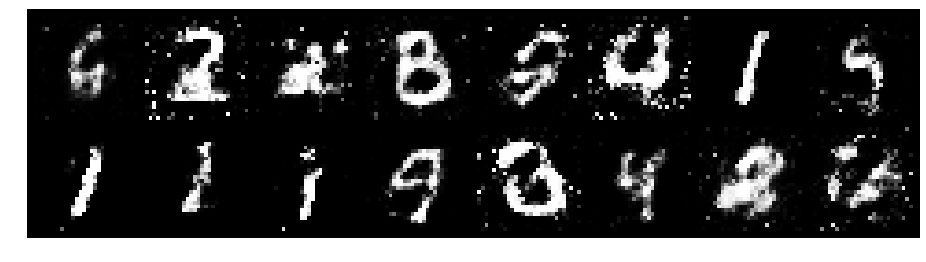

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.0675, Generator Loss: 1.5709
D(x): 0.5948, D(G(z)): 0.3108


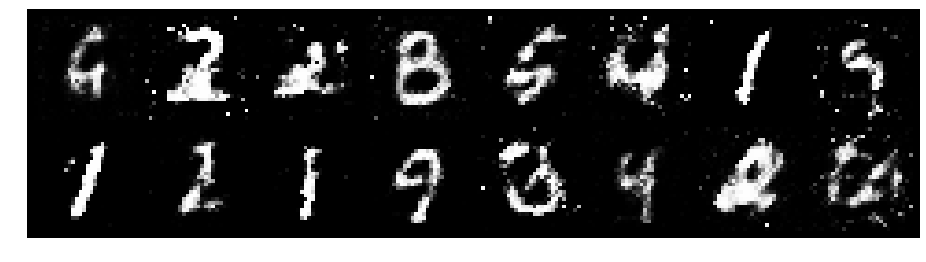

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0593, Generator Loss: 1.1916
D(x): 0.6398, D(G(z)): 0.3553


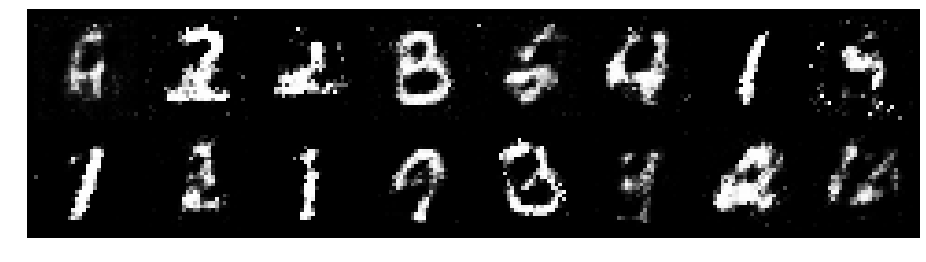

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0085, Generator Loss: 1.4350
D(x): 0.6096, D(G(z)): 0.2957


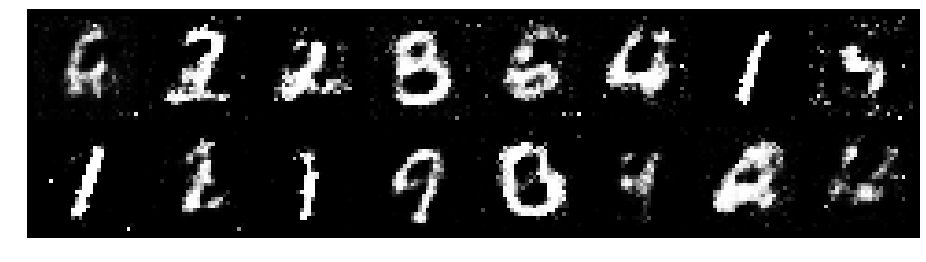

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 0.8279, Generator Loss: 1.3314
D(x): 0.6892, D(G(z)): 0.2821


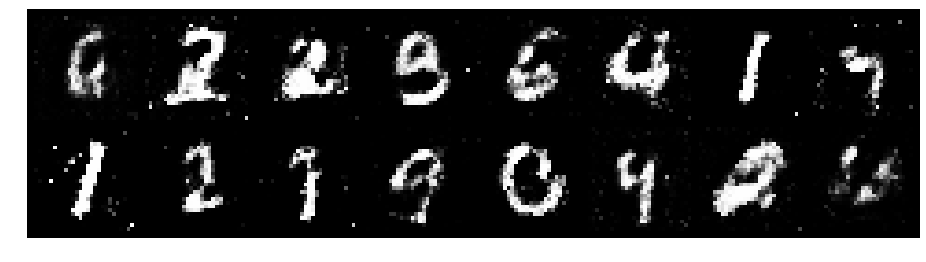

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.9834, Generator Loss: 1.3651
D(x): 0.6861, D(G(z)): 0.3600


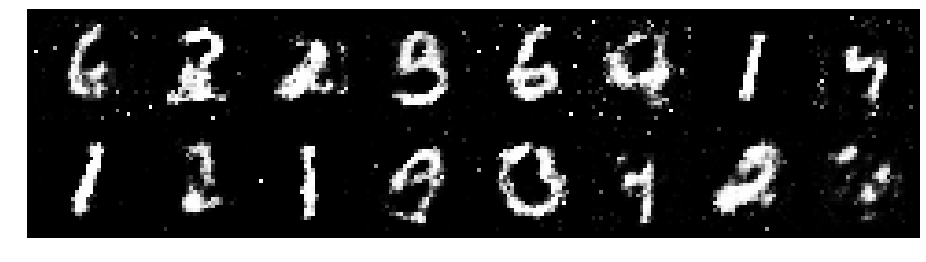

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.0805, Generator Loss: 1.6557
D(x): 0.6770, D(G(z)): 0.3455


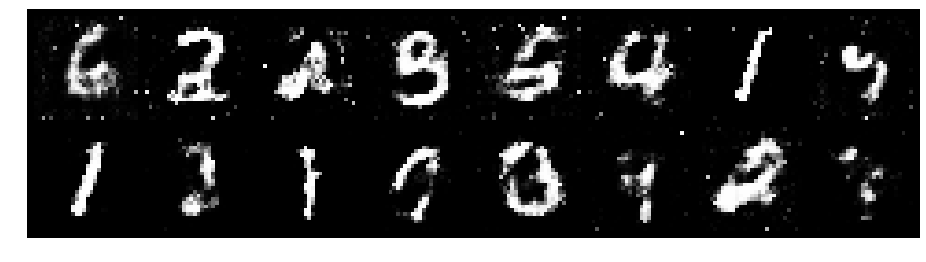

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9709, Generator Loss: 1.0984
D(x): 0.7032, D(G(z)): 0.3379


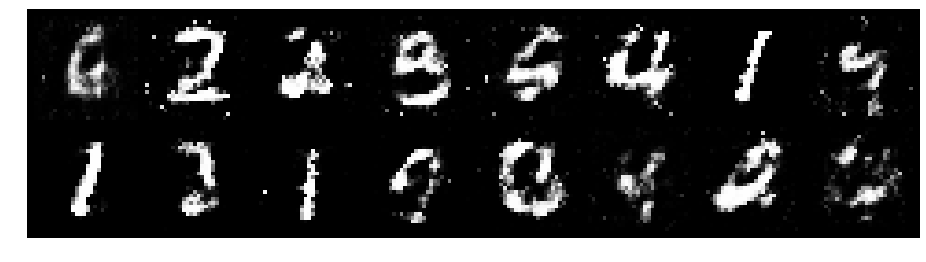

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.1092, Generator Loss: 1.3091
D(x): 0.5950, D(G(z)): 0.3313


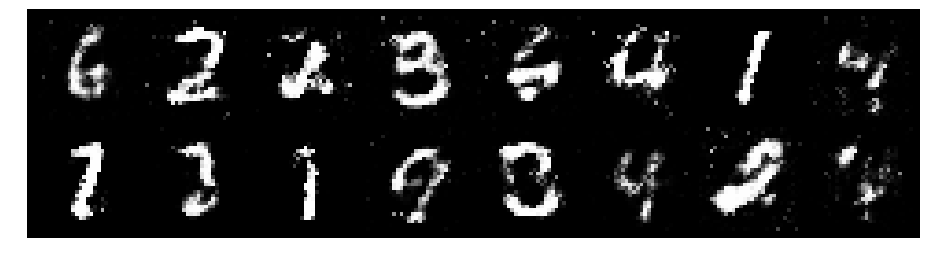

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0834, Generator Loss: 1.2697
D(x): 0.6406, D(G(z)): 0.3784


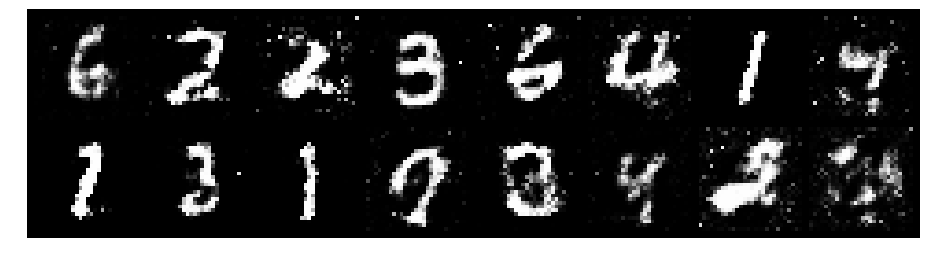

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.1179, Generator Loss: 1.1154
D(x): 0.6673, D(G(z)): 0.4316


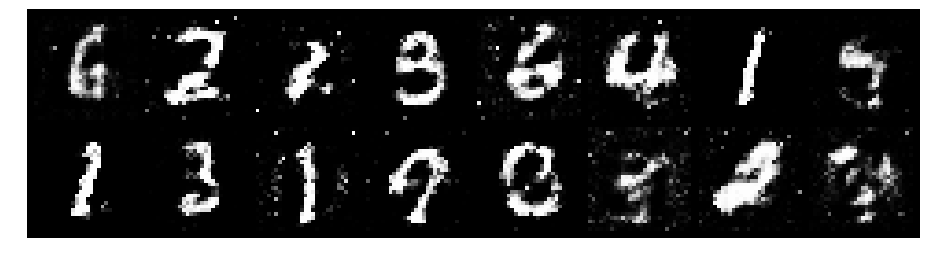

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.1137, Generator Loss: 1.1386
D(x): 0.5733, D(G(z)): 0.3499


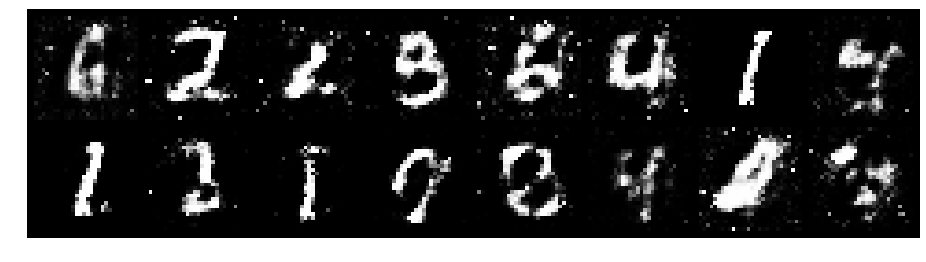

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0165, Generator Loss: 1.2016
D(x): 0.7177, D(G(z)): 0.4097


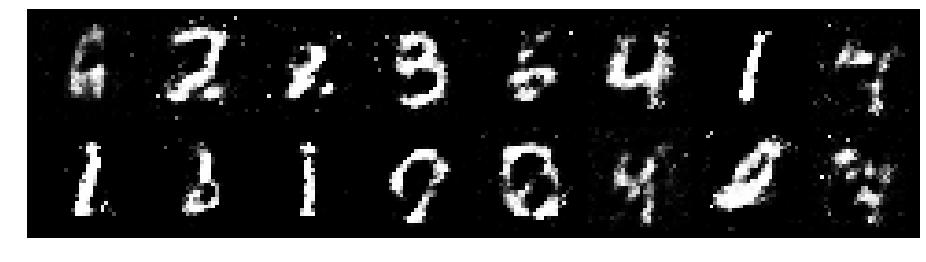

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0856, Generator Loss: 1.2616
D(x): 0.6702, D(G(z)): 0.3891


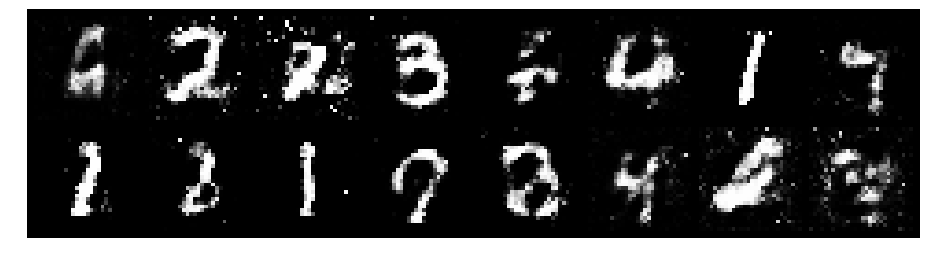

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.2074, Generator Loss: 1.0227
D(x): 0.6403, D(G(z)): 0.4474


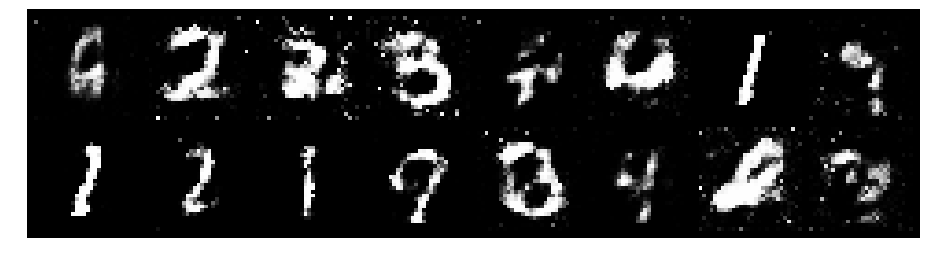

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1522, Generator Loss: 1.2306
D(x): 0.5672, D(G(z)): 0.3449


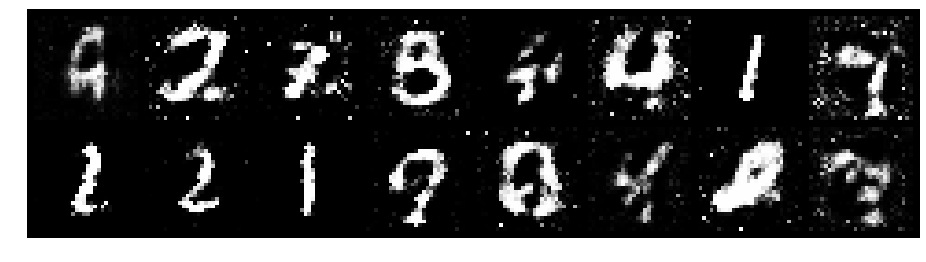

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.2711, Generator Loss: 1.1284
D(x): 0.6451, D(G(z)): 0.4191


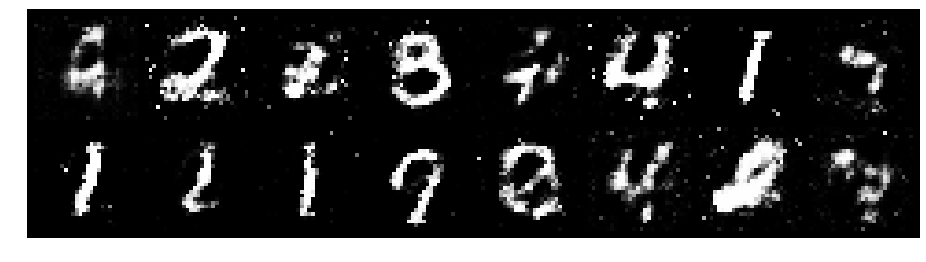

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.2318, Generator Loss: 1.1056
D(x): 0.6055, D(G(z)): 0.4285


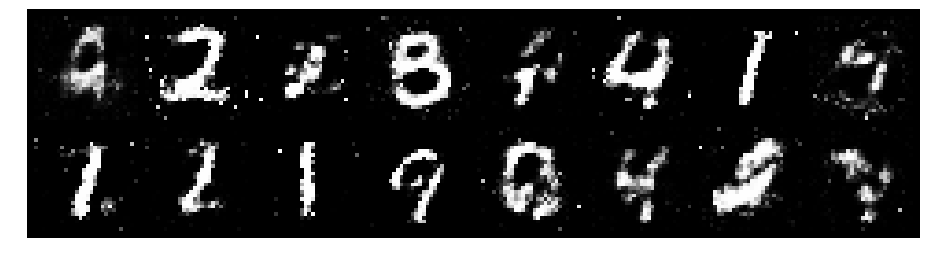

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0354, Generator Loss: 0.9971
D(x): 0.7564, D(G(z)): 0.4528


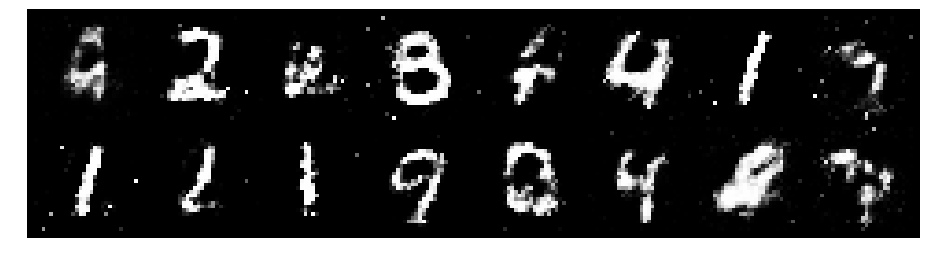

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0238, Generator Loss: 1.2928
D(x): 0.7052, D(G(z)): 0.3695


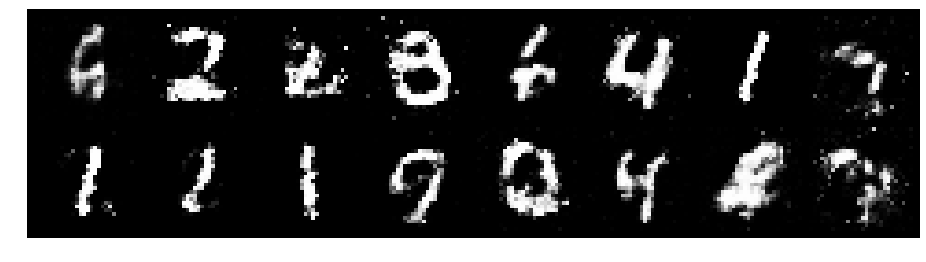

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.0448, Generator Loss: 1.6058
D(x): 0.6713, D(G(z)): 0.3428


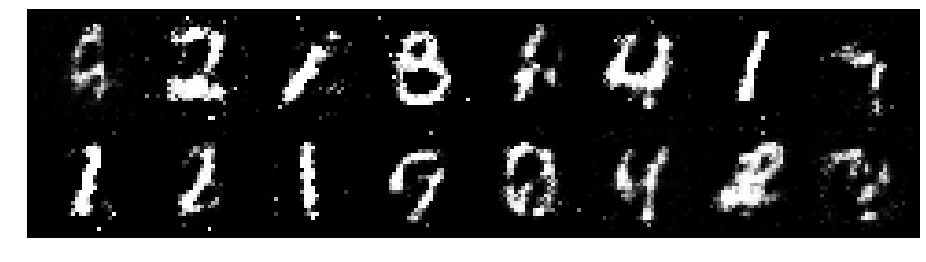

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.0339, Generator Loss: 1.1860
D(x): 0.6564, D(G(z)): 0.3857


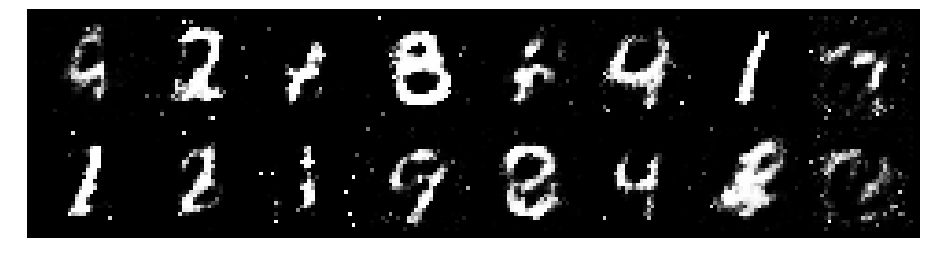

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.1408, Generator Loss: 1.1932
D(x): 0.6394, D(G(z)): 0.4370


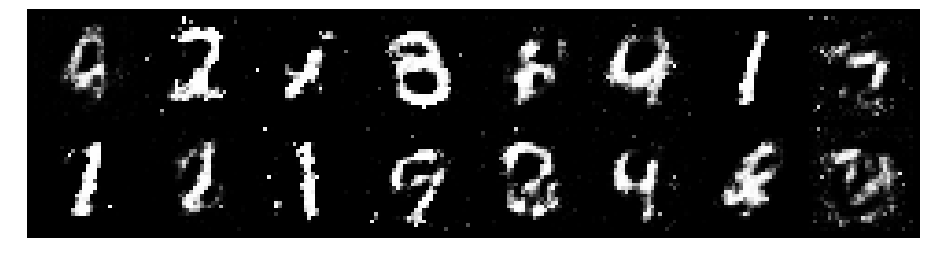

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1078, Generator Loss: 1.3293
D(x): 0.6845, D(G(z)): 0.4226


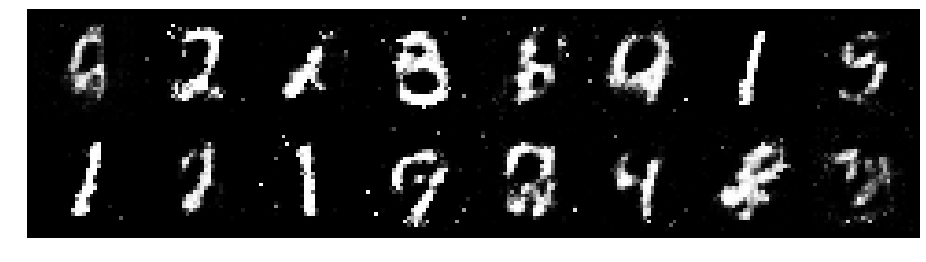

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1030, Generator Loss: 1.1645
D(x): 0.5869, D(G(z)): 0.3345


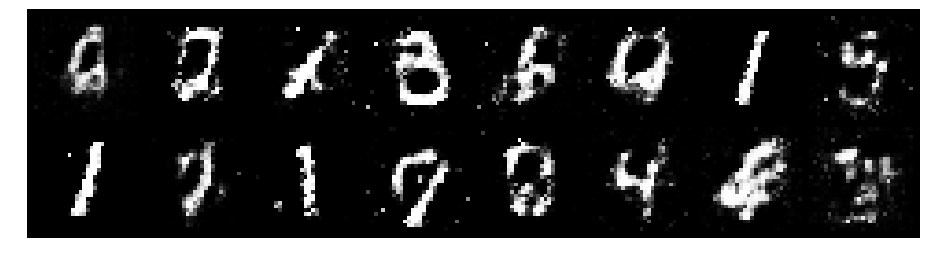

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0461, Generator Loss: 1.3809
D(x): 0.5814, D(G(z)): 0.2827


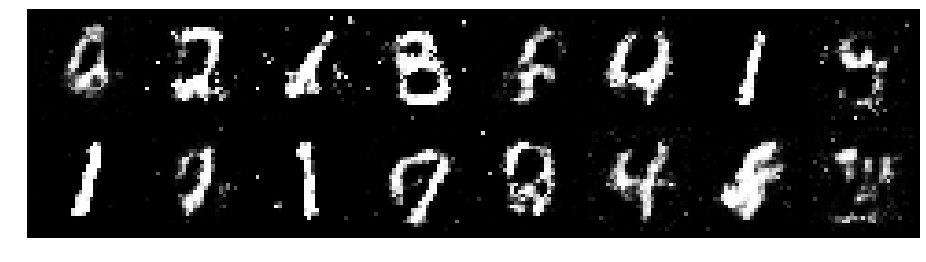

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1091, Generator Loss: 1.0243
D(x): 0.5794, D(G(z)): 0.3702


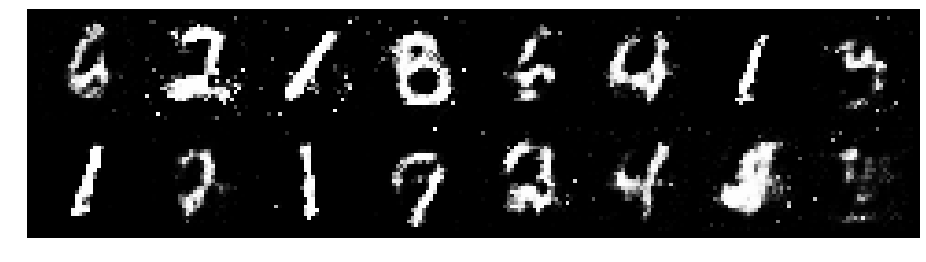

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1766, Generator Loss: 1.2994
D(x): 0.5893, D(G(z)): 0.3366


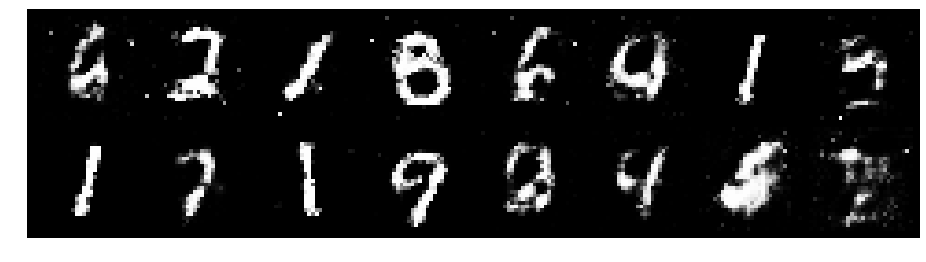

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1949, Generator Loss: 0.7745
D(x): 0.6869, D(G(z)): 0.4677


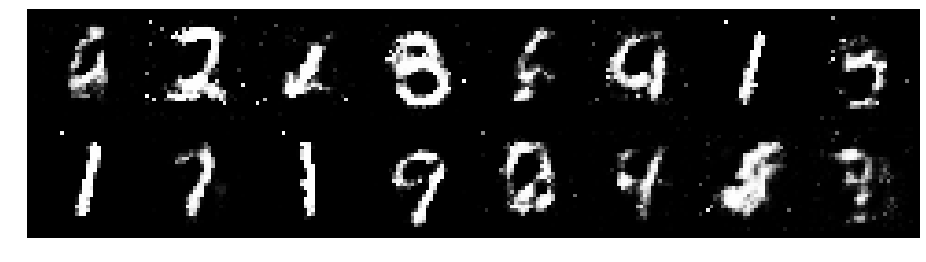

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 0.9488, Generator Loss: 1.3737
D(x): 0.6729, D(G(z)): 0.3368


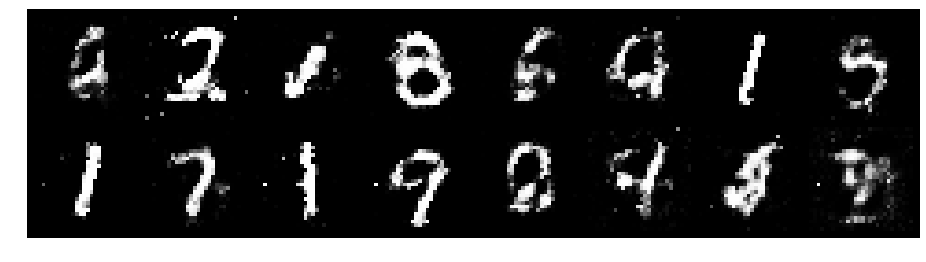

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0121, Generator Loss: 1.1381
D(x): 0.6655, D(G(z)): 0.3673


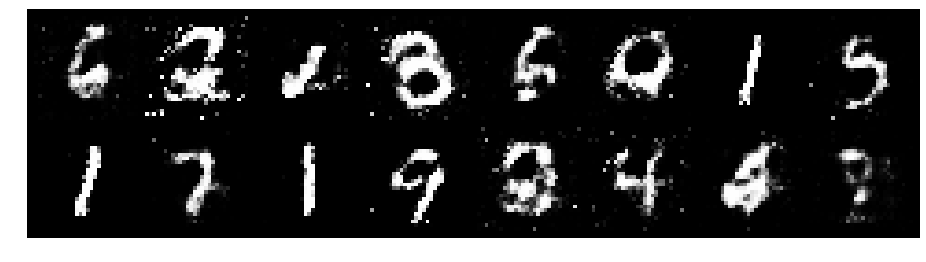

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9651, Generator Loss: 1.3893
D(x): 0.6916, D(G(z)): 0.3554


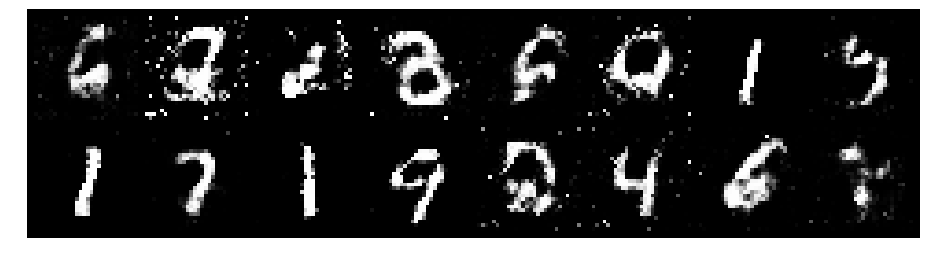

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.1027, Generator Loss: 1.0824
D(x): 0.6635, D(G(z)): 0.4183


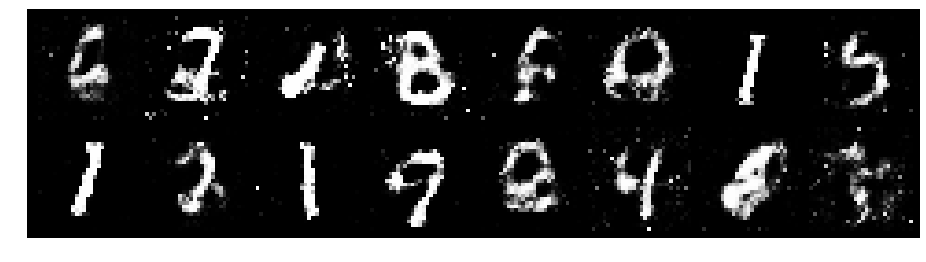

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0005, Generator Loss: 1.1833
D(x): 0.6331, D(G(z)): 0.3383


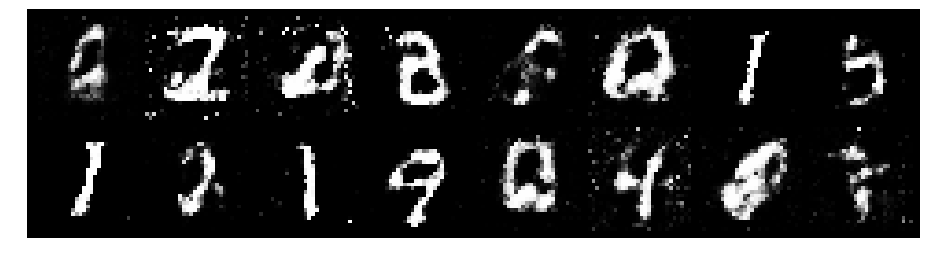

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.1351, Generator Loss: 0.9064
D(x): 0.6711, D(G(z)): 0.4325


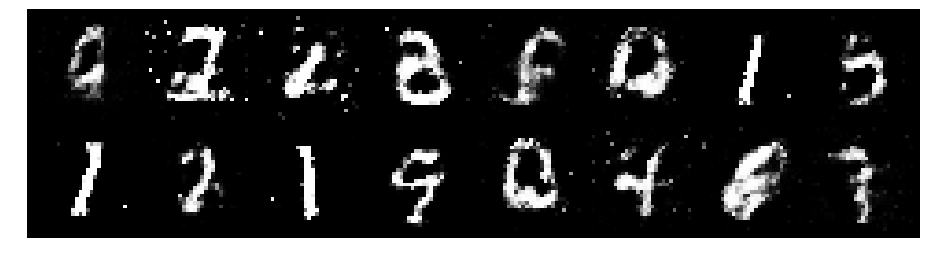

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0192, Generator Loss: 1.1237
D(x): 0.6177, D(G(z)): 0.3408


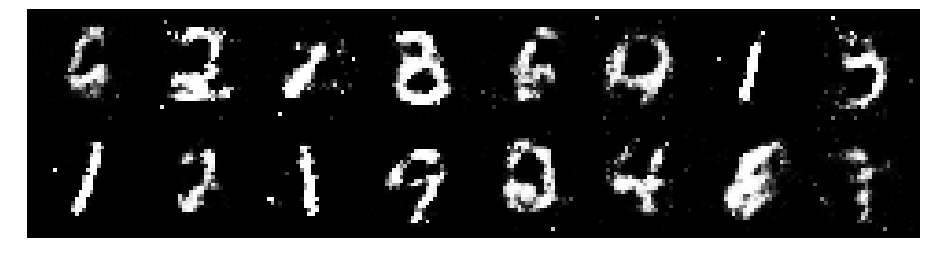

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0298, Generator Loss: 1.1218
D(x): 0.6670, D(G(z)): 0.3917


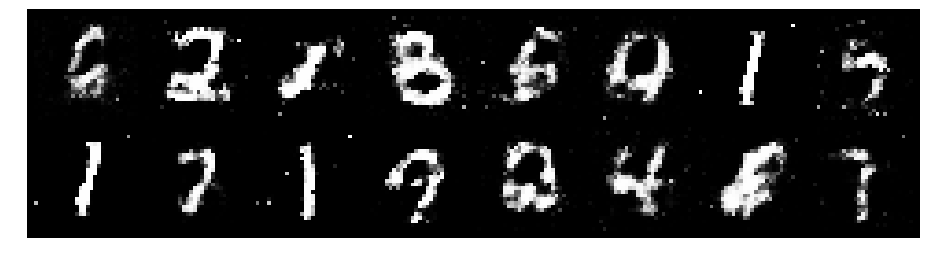

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0190, Generator Loss: 1.0637
D(x): 0.6506, D(G(z)): 0.3535


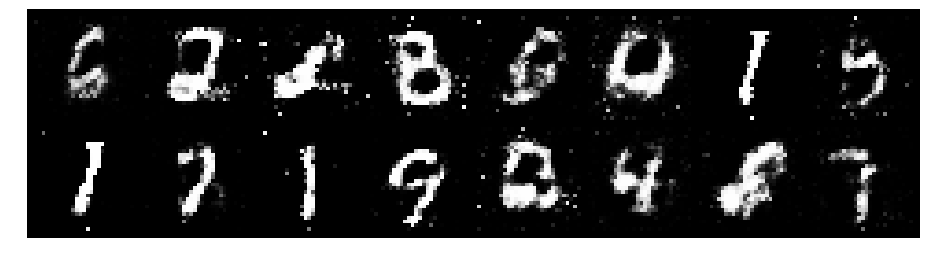

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.2132, Generator Loss: 1.0119
D(x): 0.5798, D(G(z)): 0.4279


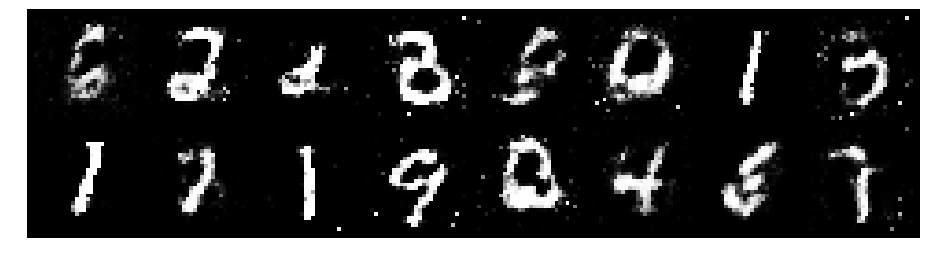

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.1394, Generator Loss: 1.3618
D(x): 0.6000, D(G(z)): 0.3489


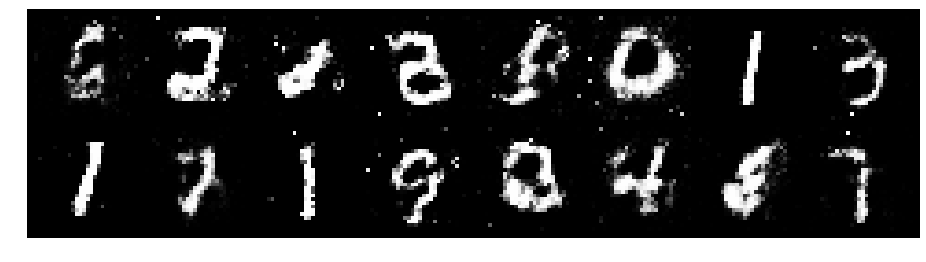

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1721, Generator Loss: 0.9901
D(x): 0.6076, D(G(z)): 0.4133


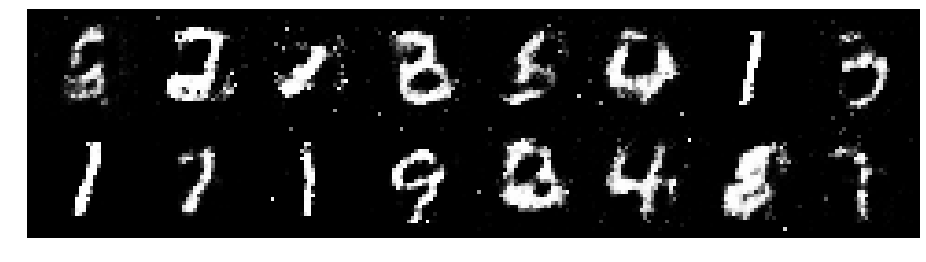

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.0706, Generator Loss: 0.9828
D(x): 0.5969, D(G(z)): 0.3691


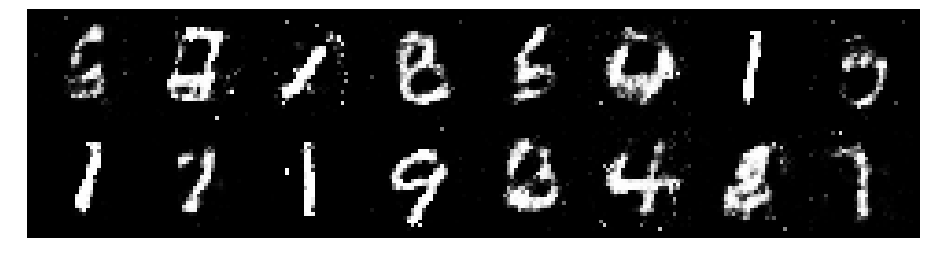

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1775, Generator Loss: 1.0842
D(x): 0.6150, D(G(z)): 0.4321


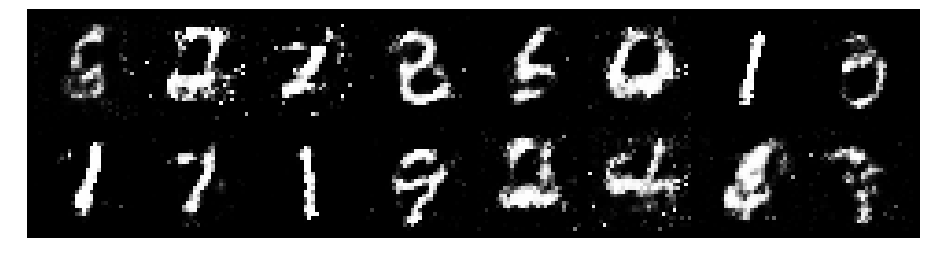

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1053, Generator Loss: 1.1159
D(x): 0.6597, D(G(z)): 0.4054


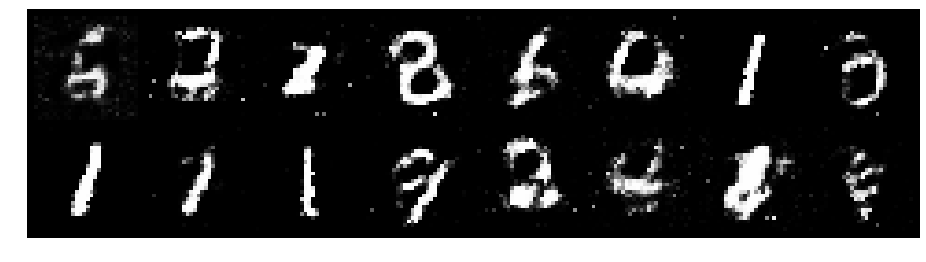

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0485, Generator Loss: 1.2716
D(x): 0.6551, D(G(z)): 0.3604


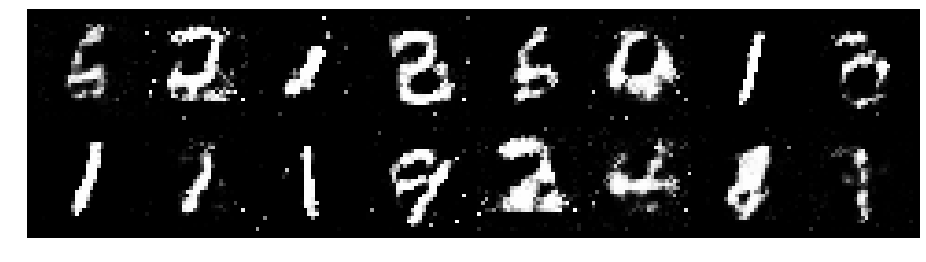

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.0628, Generator Loss: 1.0163
D(x): 0.6108, D(G(z)): 0.3416


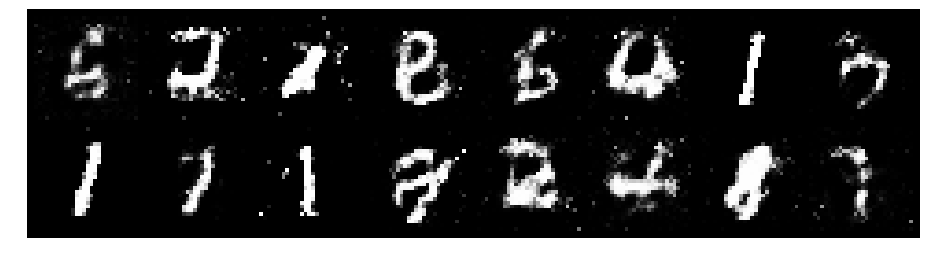

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.0533, Generator Loss: 1.1704
D(x): 0.6060, D(G(z)): 0.3510


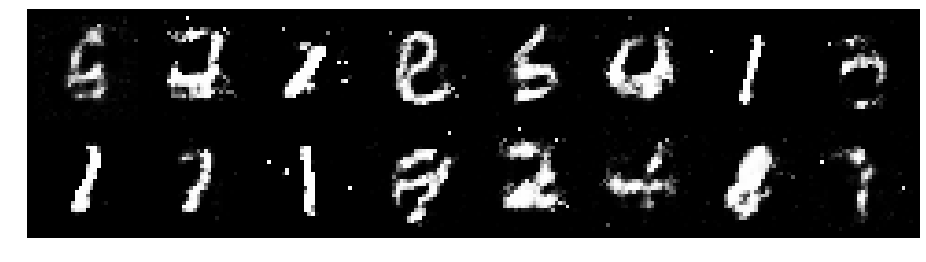

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0230, Generator Loss: 1.5521
D(x): 0.7186, D(G(z)): 0.3834


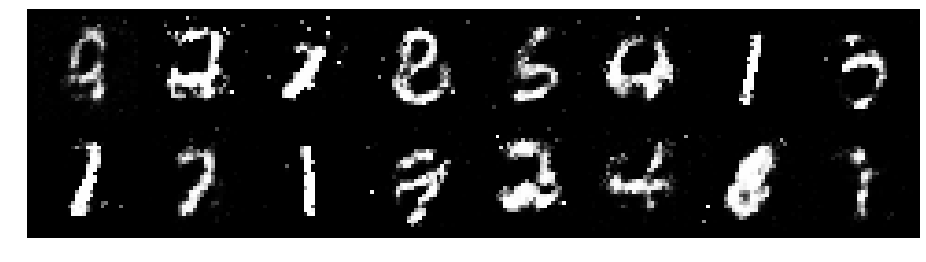

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1126, Generator Loss: 1.4760
D(x): 0.7057, D(G(z)): 0.4317


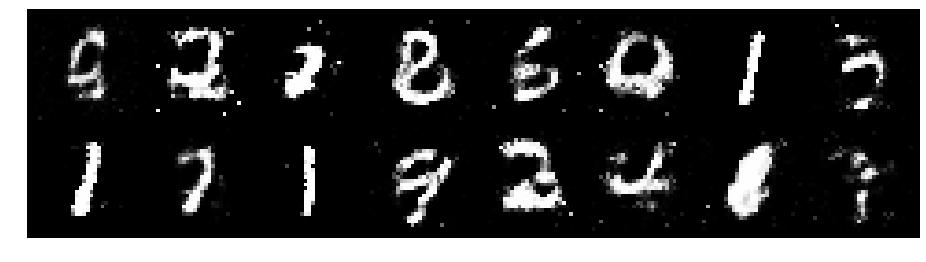

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.9781, Generator Loss: 1.3362
D(x): 0.6435, D(G(z)): 0.3224


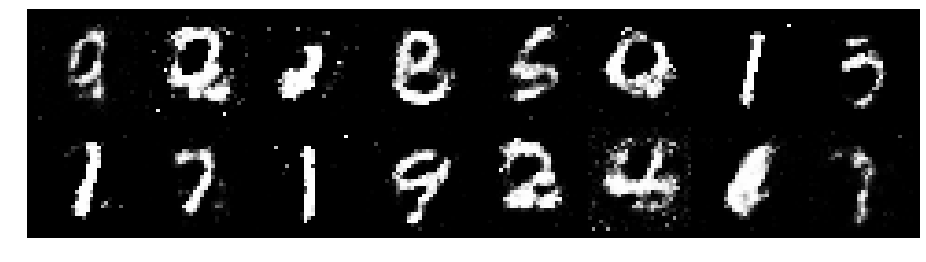

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.0656, Generator Loss: 1.1033
D(x): 0.6473, D(G(z)): 0.3856


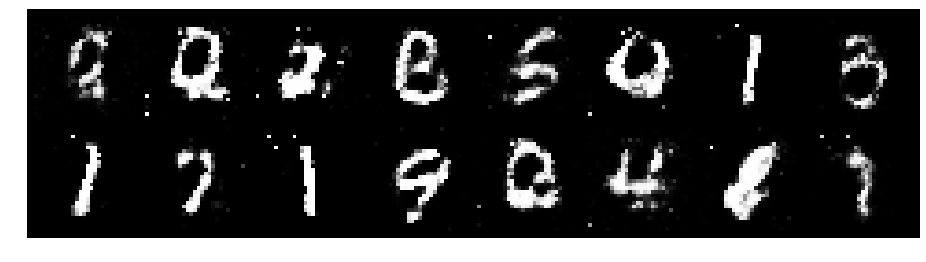

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.2469, Generator Loss: 1.0165
D(x): 0.5373, D(G(z)): 0.3767


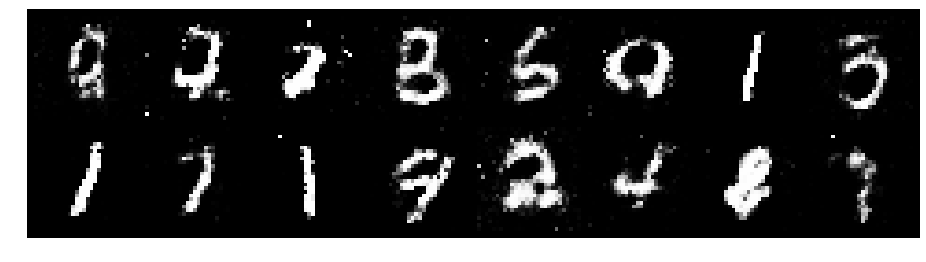

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0735, Generator Loss: 0.9831
D(x): 0.5922, D(G(z)): 0.3680


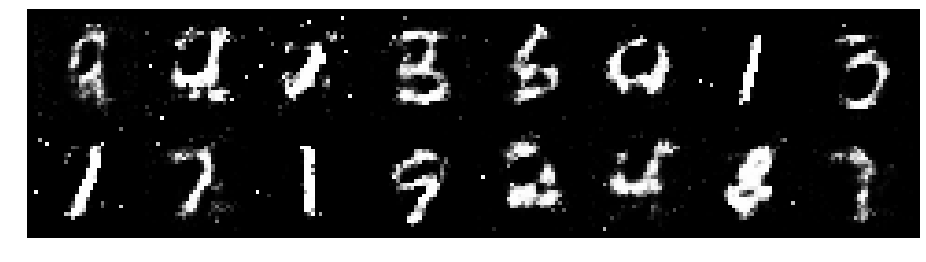

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1946, Generator Loss: 0.9763
D(x): 0.5845, D(G(z)): 0.4112


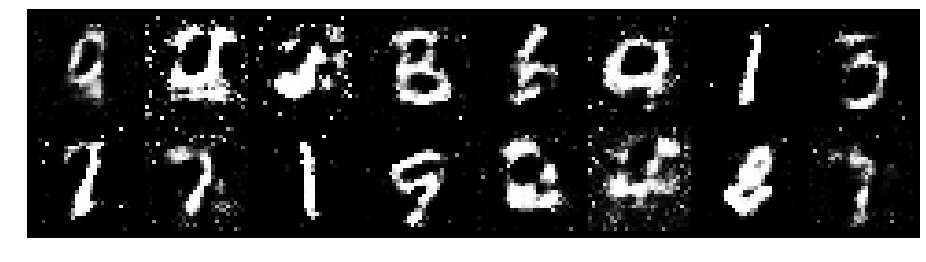

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.2254, Generator Loss: 1.0271
D(x): 0.5730, D(G(z)): 0.4136


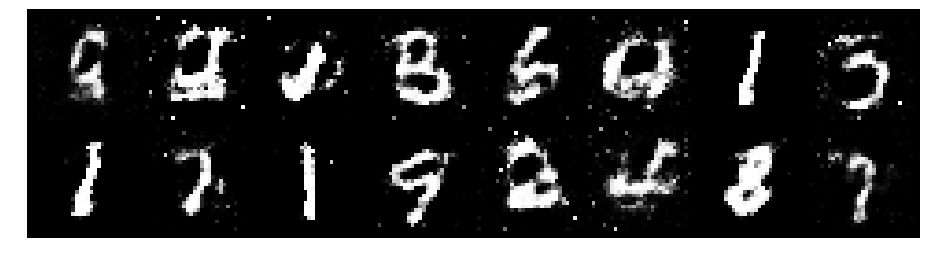

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.0814, Generator Loss: 0.9184
D(x): 0.7268, D(G(z)): 0.4611


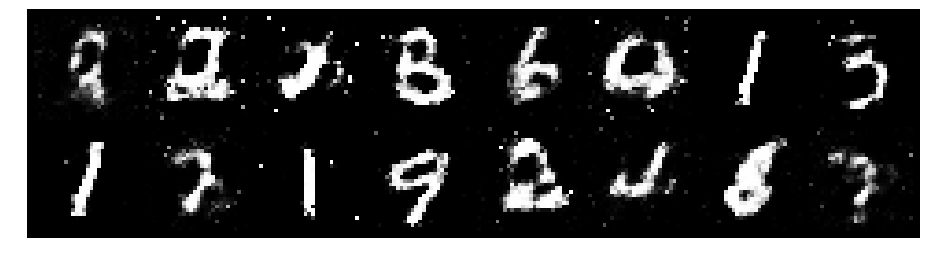

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.0552, Generator Loss: 1.0710
D(x): 0.6843, D(G(z)): 0.3888


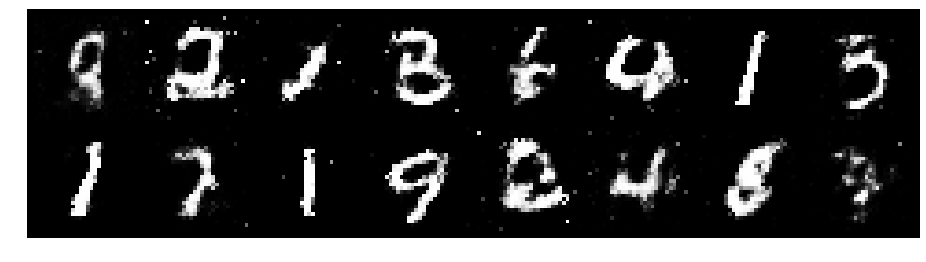

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1004, Generator Loss: 1.4644
D(x): 0.6267, D(G(z)): 0.3630


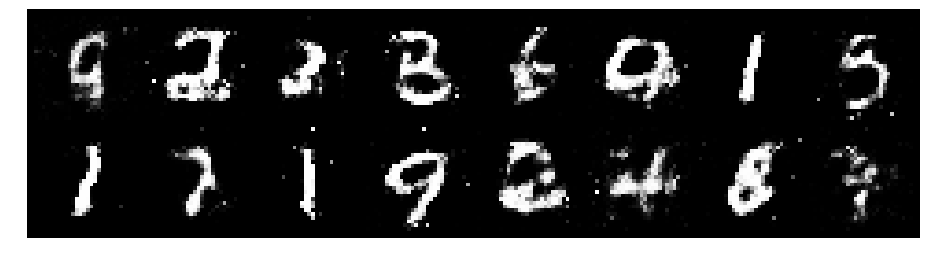

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 0.9767, Generator Loss: 1.1336
D(x): 0.6604, D(G(z)): 0.3488


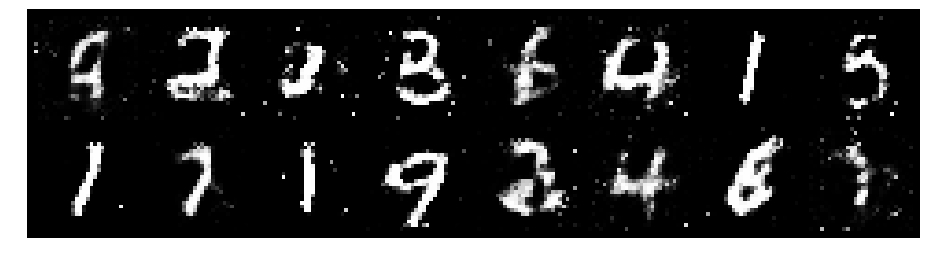

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1027, Generator Loss: 1.4708
D(x): 0.6256, D(G(z)): 0.3458


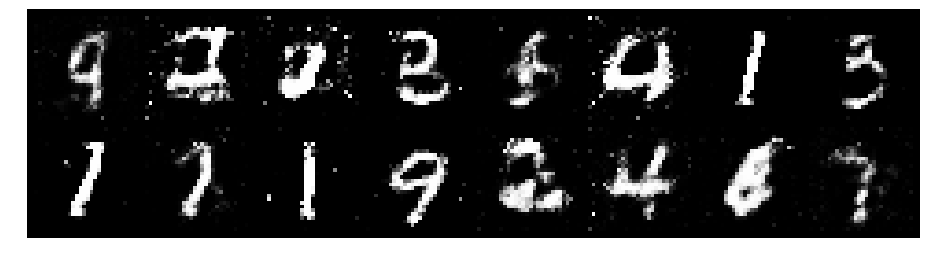

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 0.9951, Generator Loss: 1.6024
D(x): 0.6752, D(G(z)): 0.3619


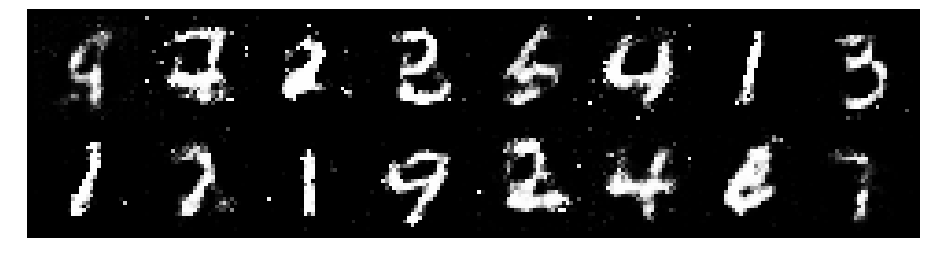

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0297, Generator Loss: 1.3522
D(x): 0.6491, D(G(z)): 0.3460


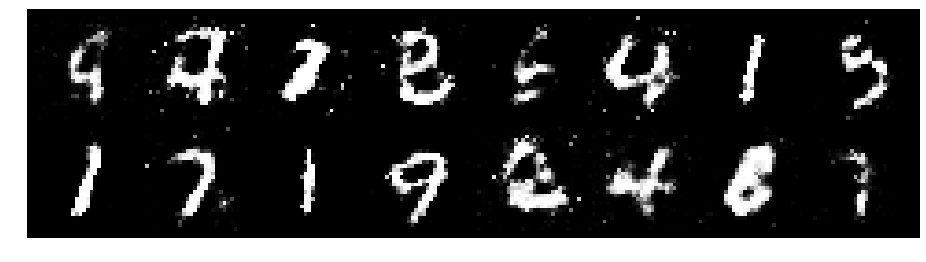

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0574, Generator Loss: 1.1025
D(x): 0.6242, D(G(z)): 0.3561


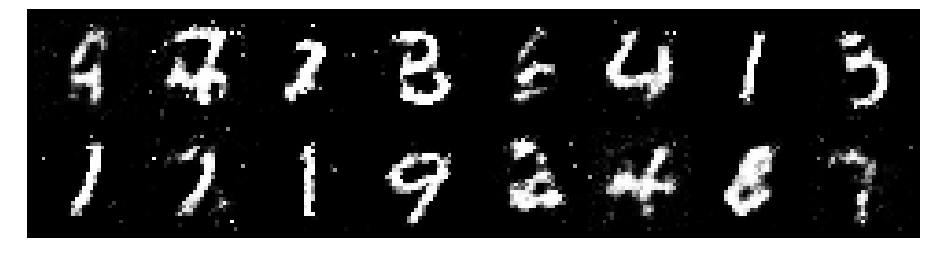

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.0925, Generator Loss: 1.1455
D(x): 0.6055, D(G(z)): 0.3518


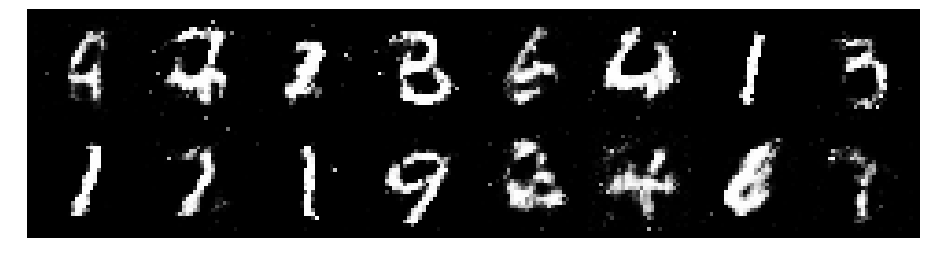

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.0030, Generator Loss: 1.2893
D(x): 0.6153, D(G(z)): 0.3245


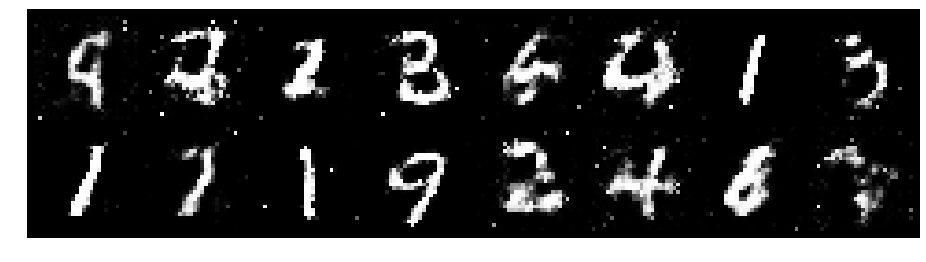

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1406, Generator Loss: 1.3808
D(x): 0.6370, D(G(z)): 0.3409


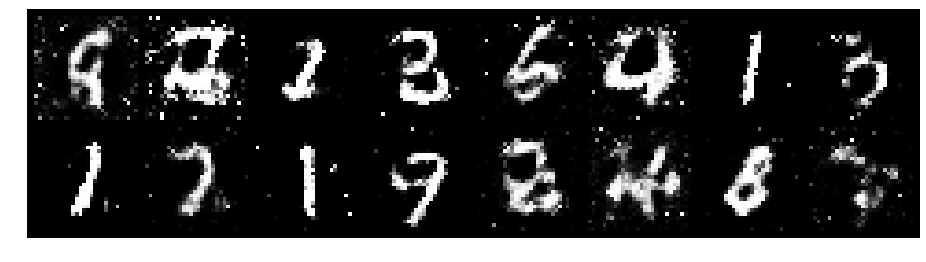

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.0023, Generator Loss: 1.3915
D(x): 0.6366, D(G(z)): 0.3554


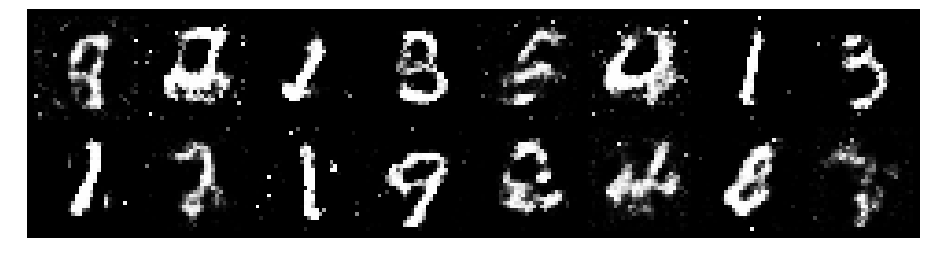

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.2115, Generator Loss: 1.1519
D(x): 0.5547, D(G(z)): 0.3744


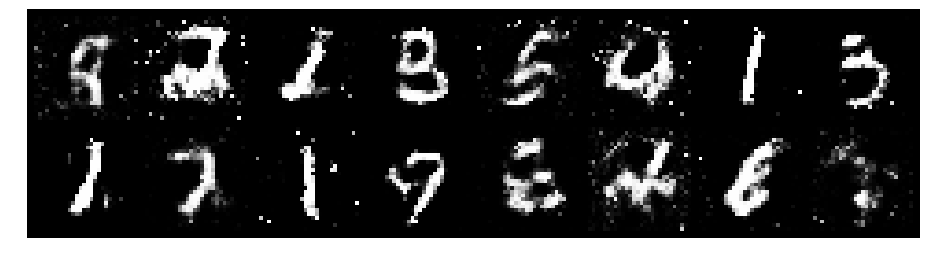

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9708
D(x): 0.5863, D(G(z)): 0.4373


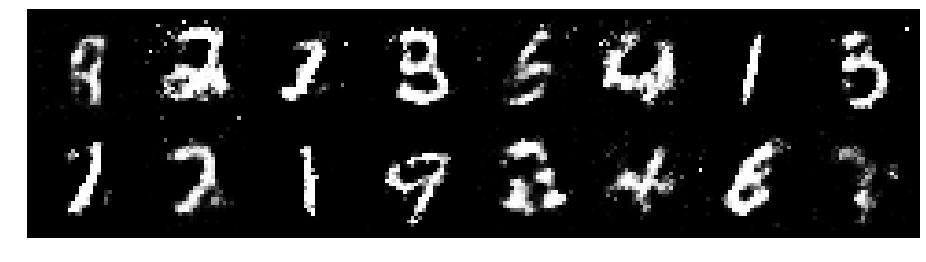

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0535, Generator Loss: 1.3416
D(x): 0.5971, D(G(z)): 0.3481


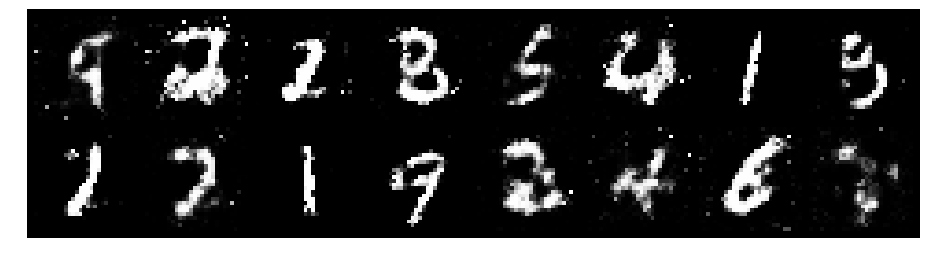

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.3896, Generator Loss: 1.2971
D(x): 0.5699, D(G(z)): 0.4230


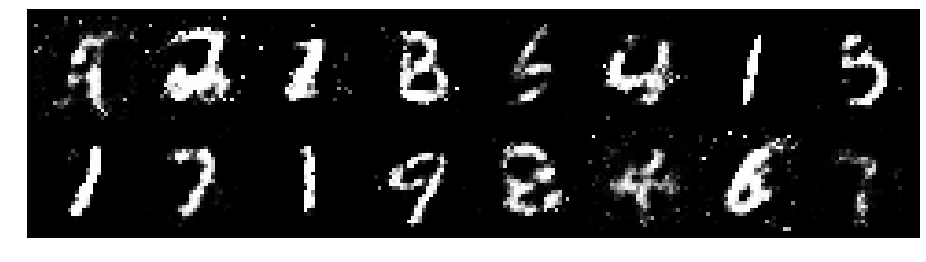

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1378, Generator Loss: 0.9403
D(x): 0.5956, D(G(z)): 0.4143


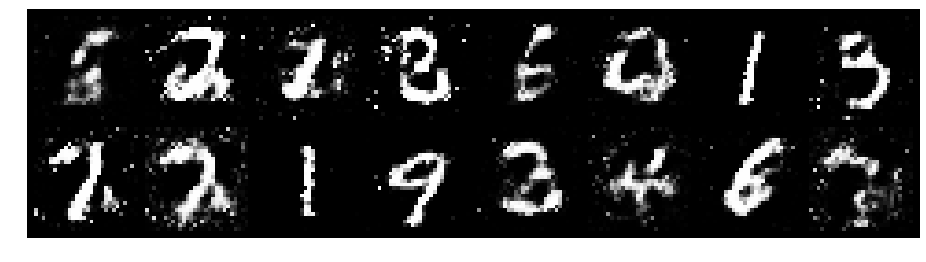

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.0974, Generator Loss: 1.2567
D(x): 0.6023, D(G(z)): 0.3494


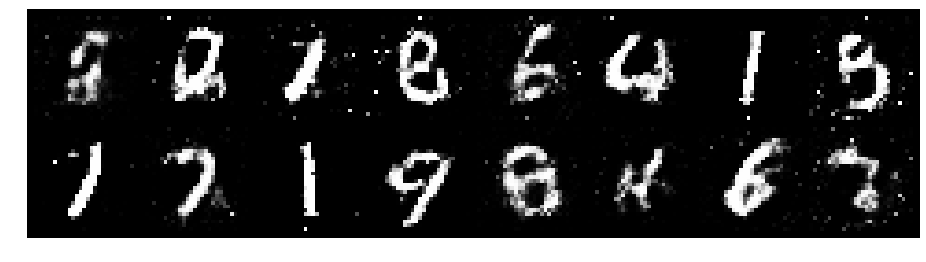

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.2644, Generator Loss: 1.2912
D(x): 0.6782, D(G(z)): 0.4502


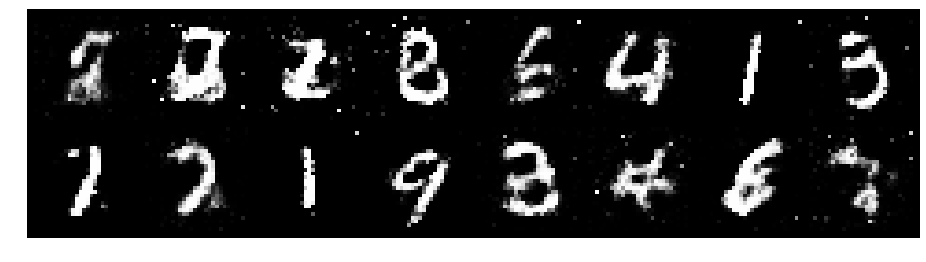

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1437, Generator Loss: 1.1177
D(x): 0.6751, D(G(z)): 0.4256


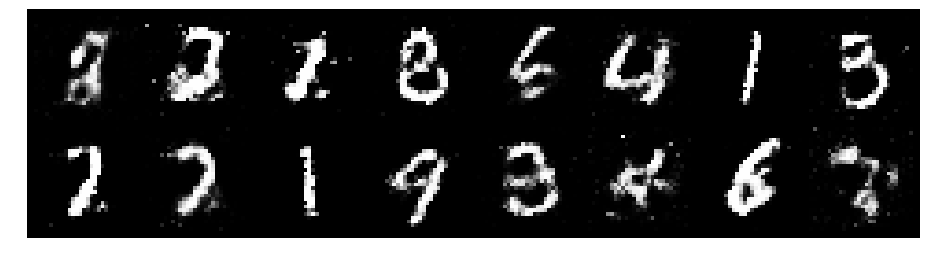

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.1314, Generator Loss: 1.1261
D(x): 0.6315, D(G(z)): 0.4159


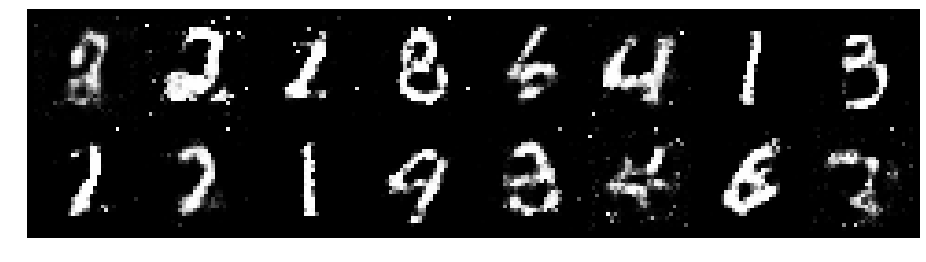

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1623, Generator Loss: 1.5811
D(x): 0.5790, D(G(z)): 0.3550


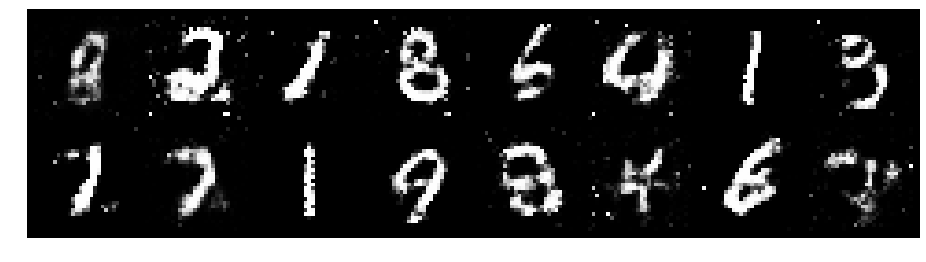

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.1573, Generator Loss: 1.0699
D(x): 0.6065, D(G(z)): 0.3903


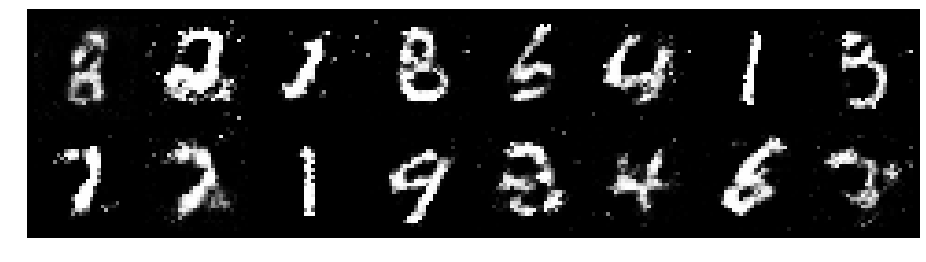

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0477, Generator Loss: 1.3227
D(x): 0.6766, D(G(z)): 0.3918


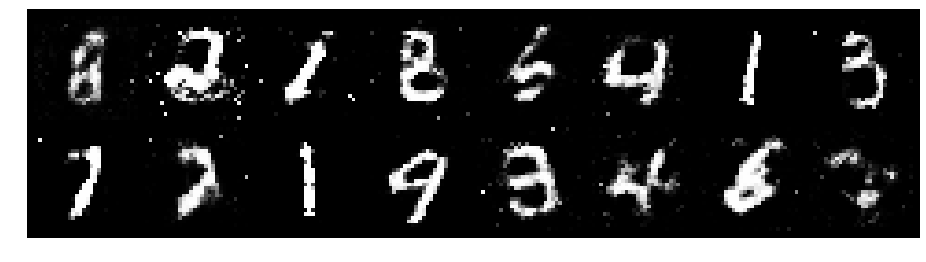

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1077, Generator Loss: 1.3577
D(x): 0.5937, D(G(z)): 0.3570


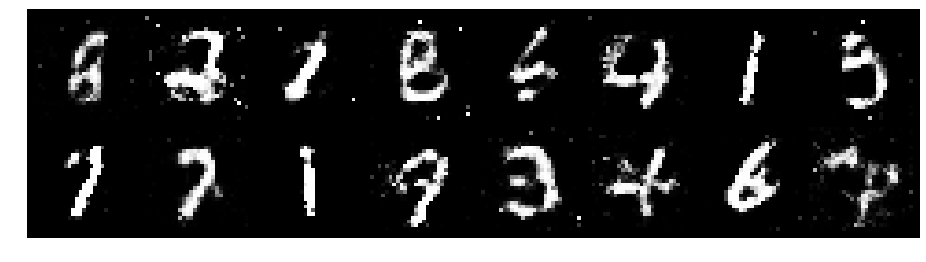

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1053, Generator Loss: 0.9949
D(x): 0.6294, D(G(z)): 0.4036


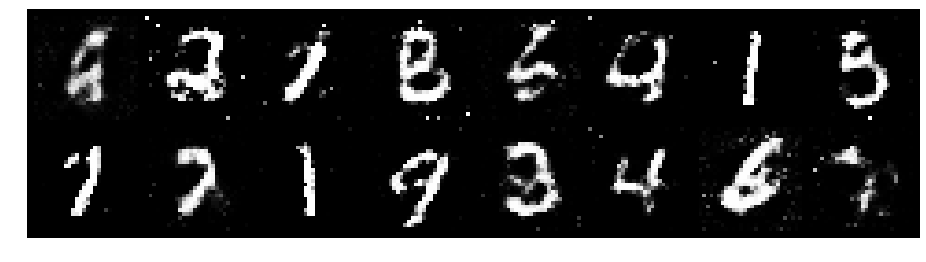

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2010, Generator Loss: 1.0812
D(x): 0.5988, D(G(z)): 0.4098


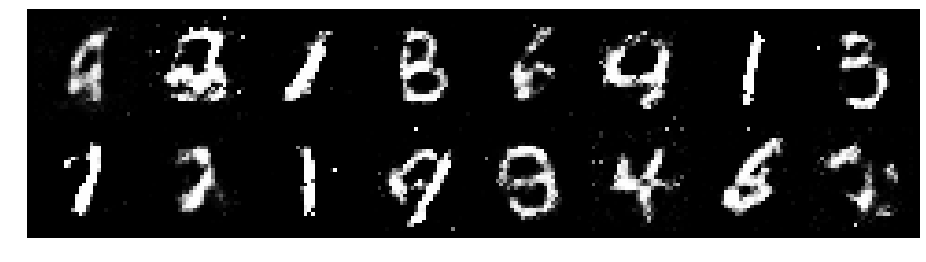

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 0.9955, Generator Loss: 1.0893
D(x): 0.6684, D(G(z)): 0.3523


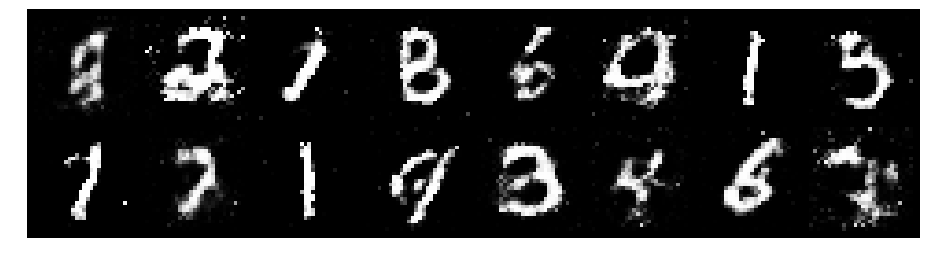

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.0343, Generator Loss: 1.3470
D(x): 0.6255, D(G(z)): 0.3484


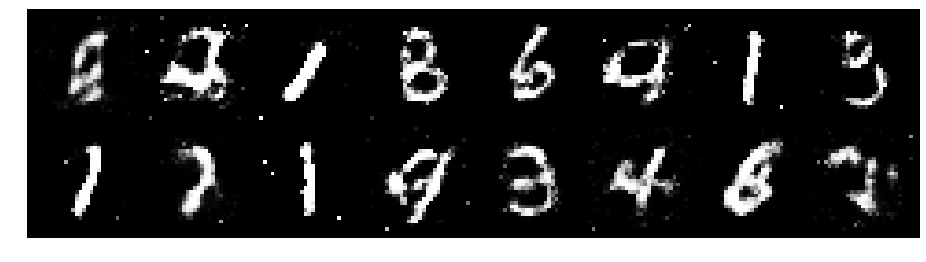

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1872, Generator Loss: 1.2358
D(x): 0.6101, D(G(z)): 0.3863


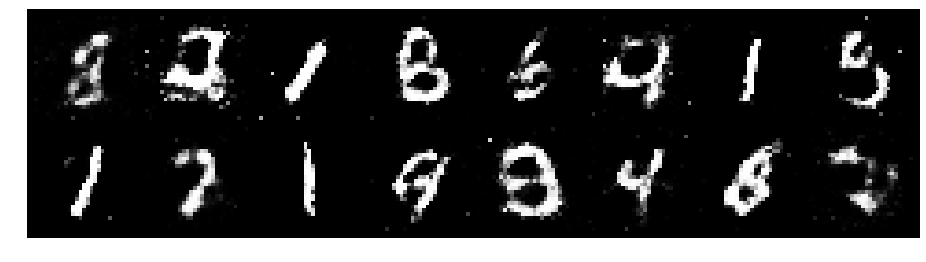

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1367, Generator Loss: 1.2983
D(x): 0.6262, D(G(z)): 0.3996


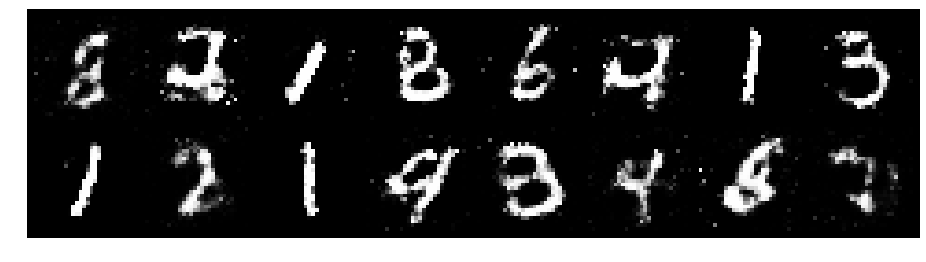

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1094, Generator Loss: 1.0927
D(x): 0.6316, D(G(z)): 0.4045


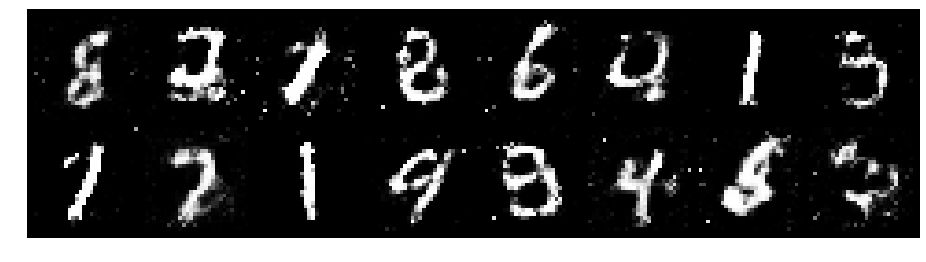

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1147, Generator Loss: 1.2581
D(x): 0.5610, D(G(z)): 0.3278


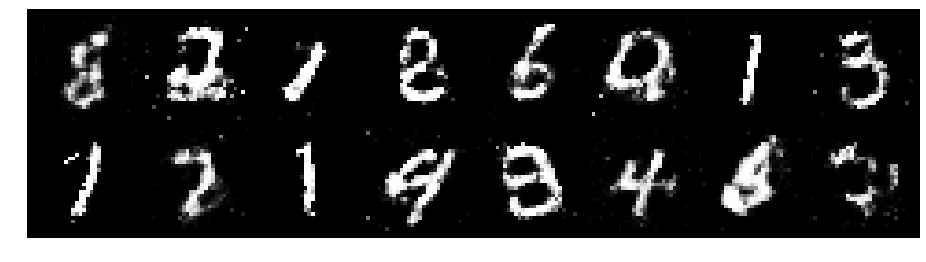

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1624, Generator Loss: 1.0647
D(x): 0.5772, D(G(z)): 0.3996


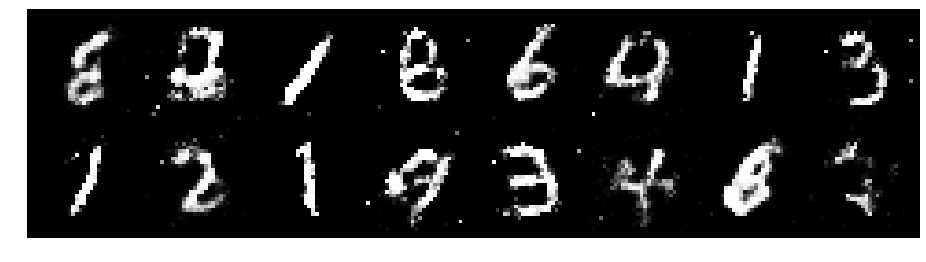

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.2970, Generator Loss: 1.0609
D(x): 0.5414, D(G(z)): 0.4161


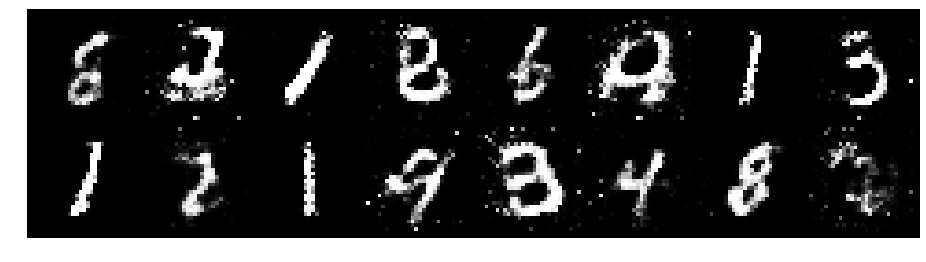

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.0586, Generator Loss: 1.0737
D(x): 0.6393, D(G(z)): 0.3991


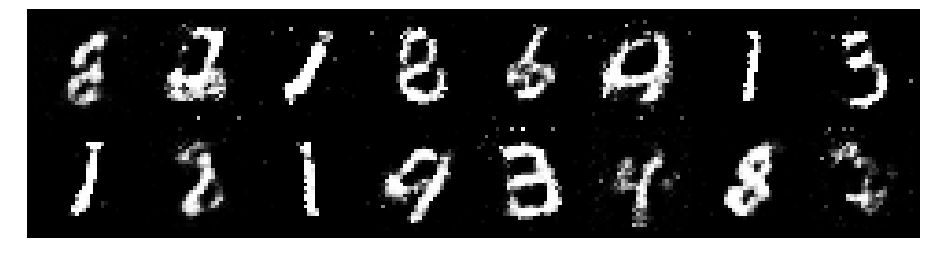

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1380, Generator Loss: 1.0404
D(x): 0.6823, D(G(z)): 0.4321


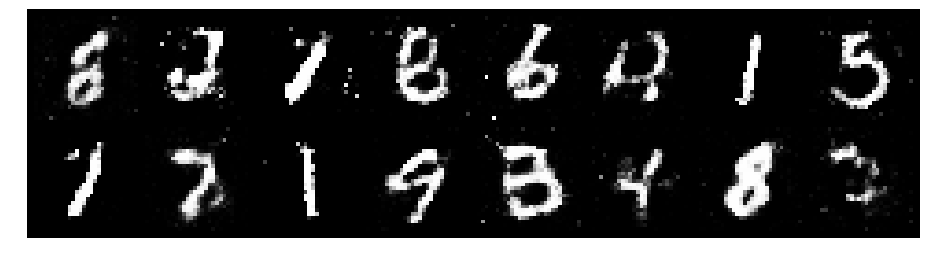

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1749, Generator Loss: 0.9523
D(x): 0.6281, D(G(z)): 0.4258


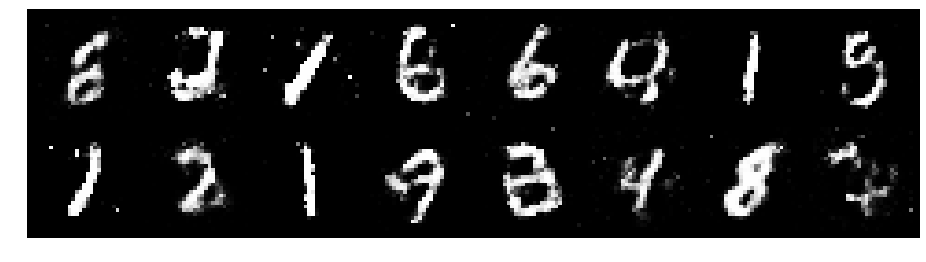

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1401, Generator Loss: 1.3238
D(x): 0.5970, D(G(z)): 0.3652


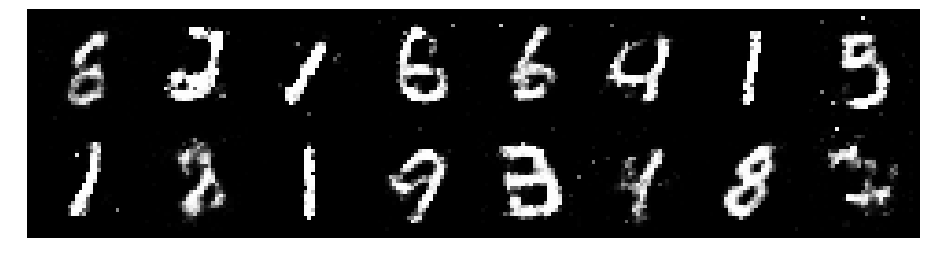

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.1088, Generator Loss: 1.2505
D(x): 0.6294, D(G(z)): 0.3735


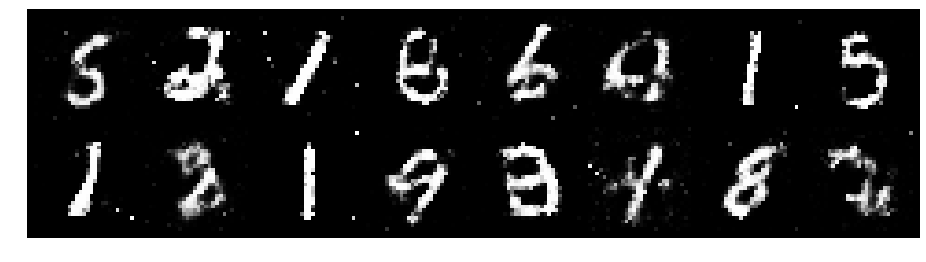

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1270, Generator Loss: 1.2424
D(x): 0.6689, D(G(z)): 0.4134


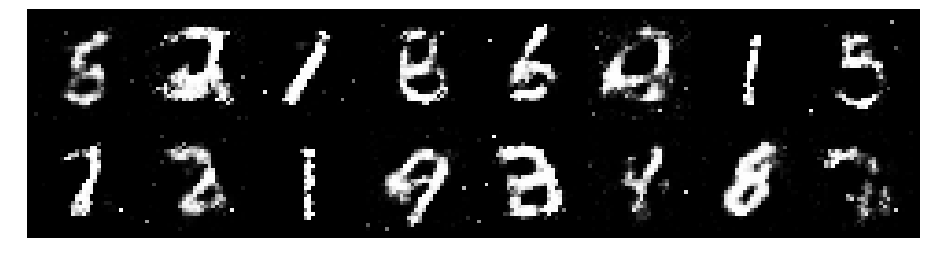

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.2208, Generator Loss: 1.3320
D(x): 0.6762, D(G(z)): 0.4418


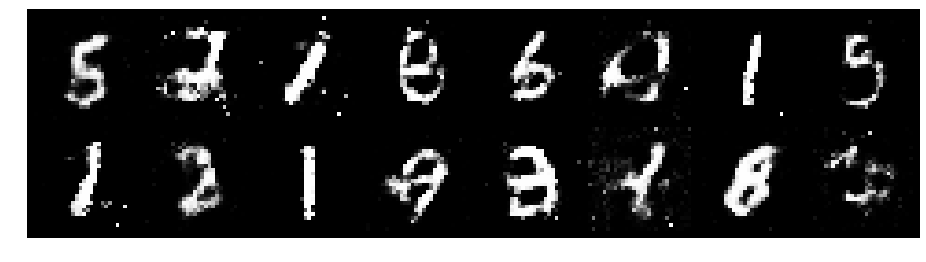

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1800, Generator Loss: 1.1004
D(x): 0.5676, D(G(z)): 0.3476


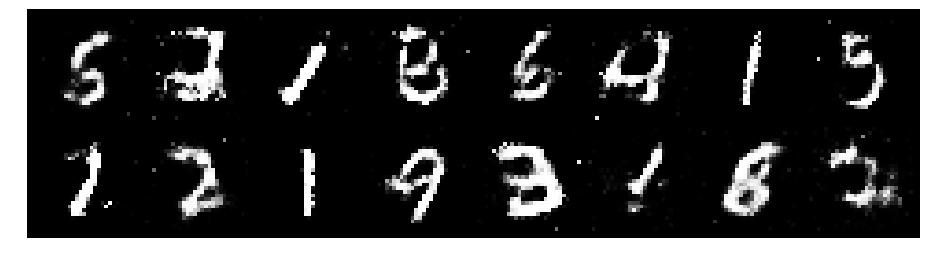

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.0305, Generator Loss: 1.3038
D(x): 0.6634, D(G(z)): 0.3908


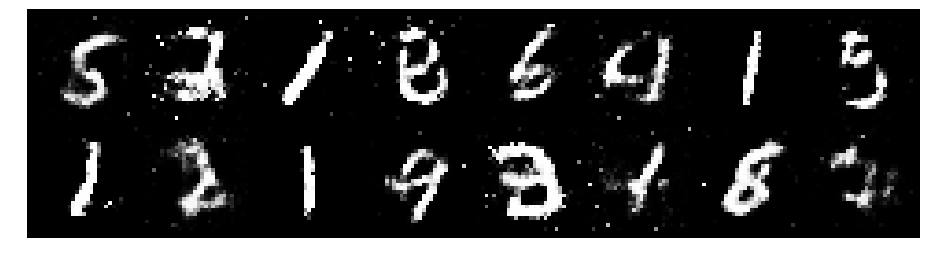

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0769, Generator Loss: 1.2614
D(x): 0.6310, D(G(z)): 0.3693


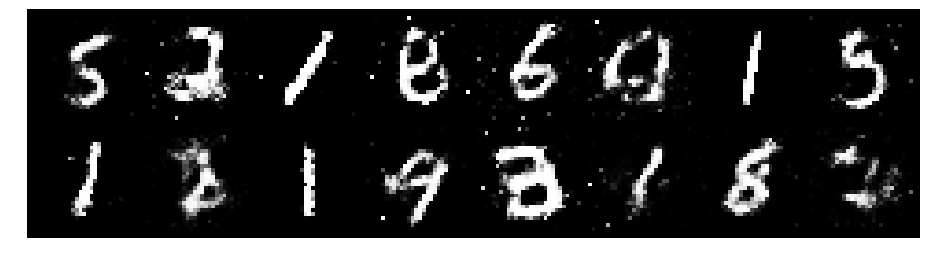

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0065, Generator Loss: 1.1880
D(x): 0.7080, D(G(z)): 0.3983


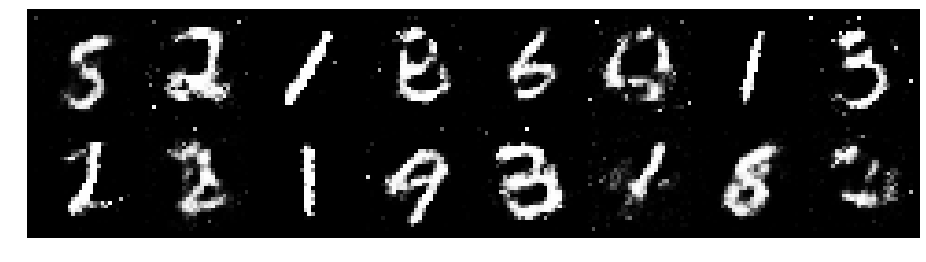

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1239, Generator Loss: 1.2048
D(x): 0.6342, D(G(z)): 0.3922


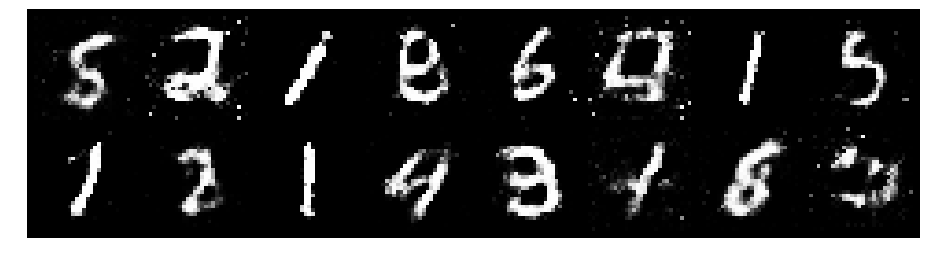

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1277, Generator Loss: 1.0967
D(x): 0.6280, D(G(z)): 0.3698


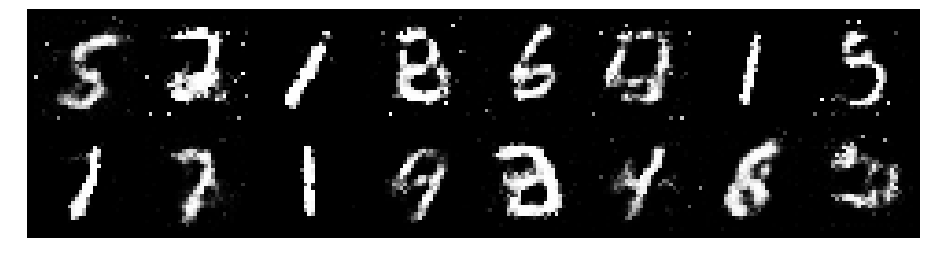

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.1009, Generator Loss: 1.2270
D(x): 0.5852, D(G(z)): 0.3549


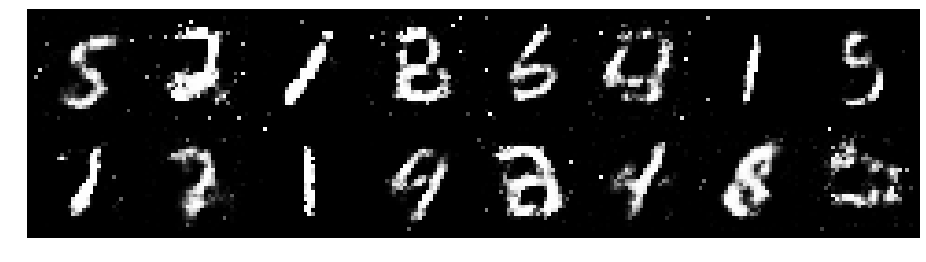

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1980, Generator Loss: 1.2831
D(x): 0.5273, D(G(z)): 0.3378


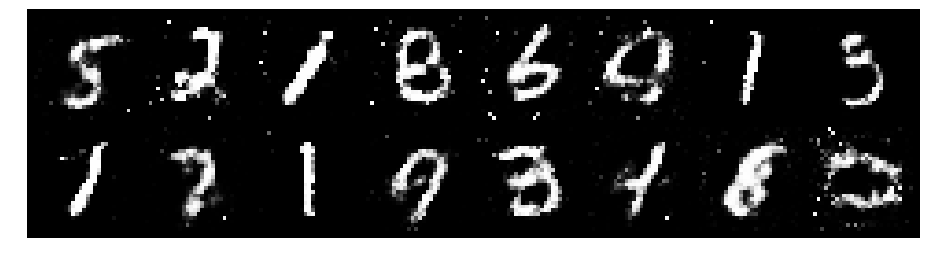

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1299, Generator Loss: 1.0476
D(x): 0.6413, D(G(z)): 0.4269


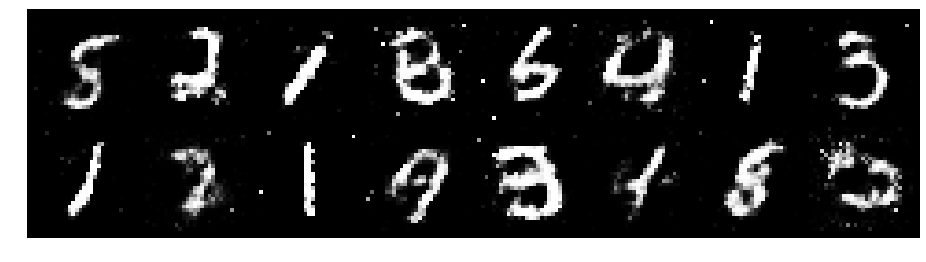

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.0762, Generator Loss: 1.0420
D(x): 0.6314, D(G(z)): 0.3885


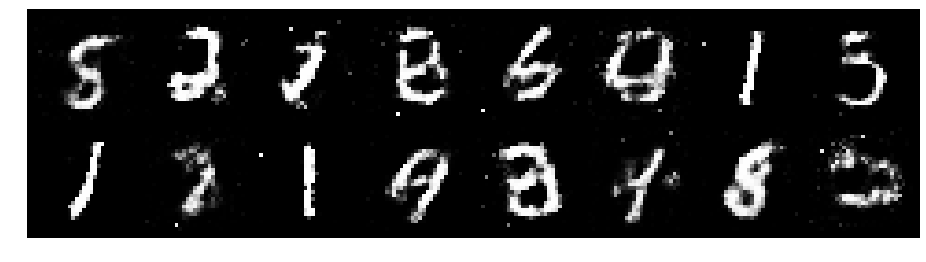

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1028, Generator Loss: 1.1063
D(x): 0.5948, D(G(z)): 0.3691


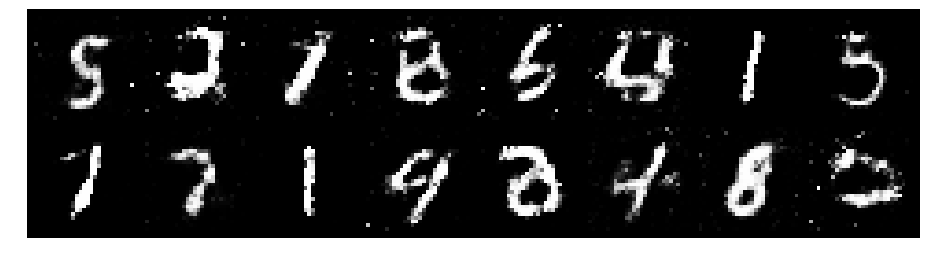

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.0068, Generator Loss: 1.3944
D(x): 0.6367, D(G(z)): 0.3289


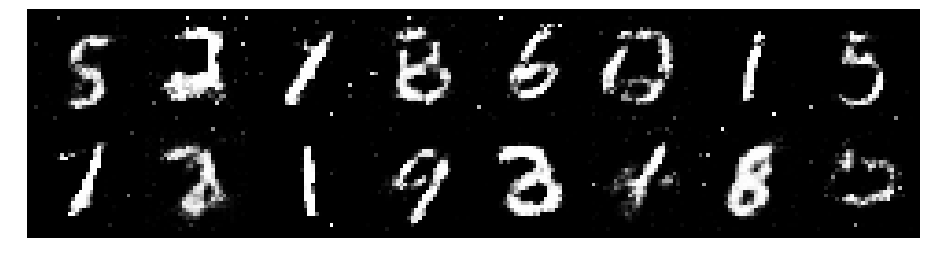

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1329, Generator Loss: 1.0958
D(x): 0.6489, D(G(z)): 0.4195


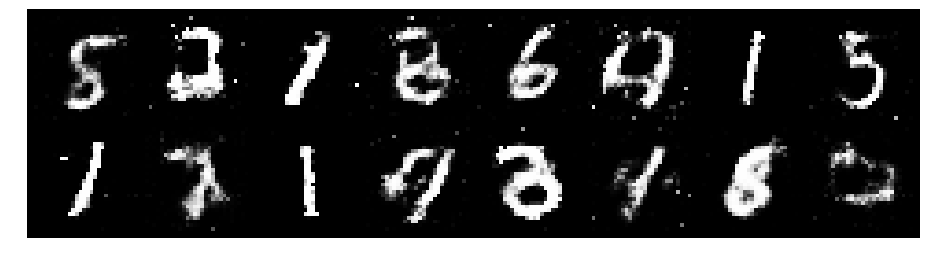

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.0694, Generator Loss: 1.4379
D(x): 0.5867, D(G(z)): 0.2982


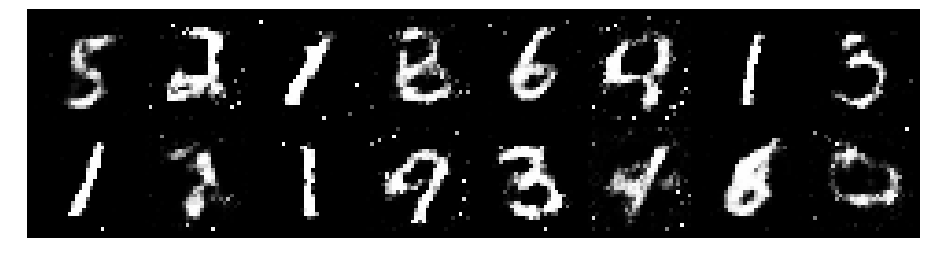

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.0483, Generator Loss: 1.0324
D(x): 0.6050, D(G(z)): 0.3748


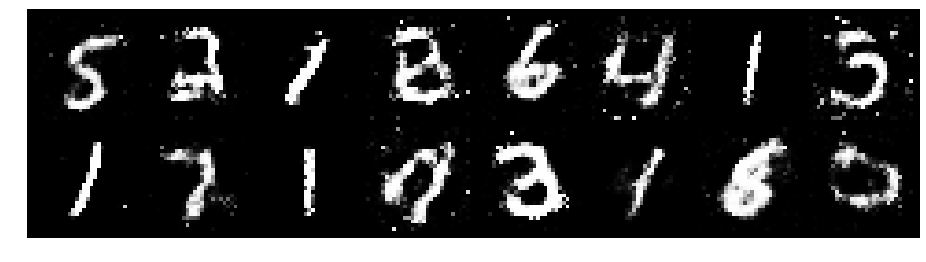

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2296, Generator Loss: 1.1497
D(x): 0.5783, D(G(z)): 0.3990


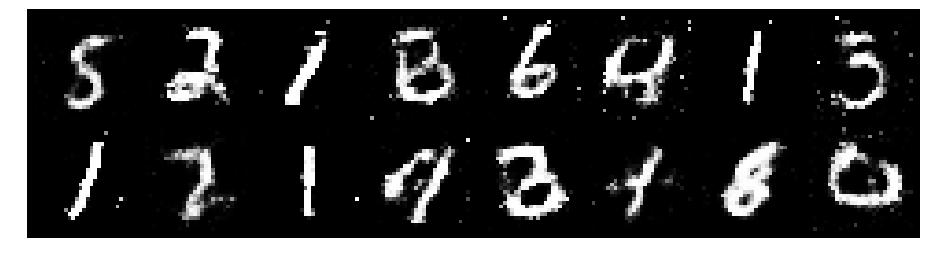

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.1213, Generator Loss: 1.0650
D(x): 0.6088, D(G(z)): 0.3914


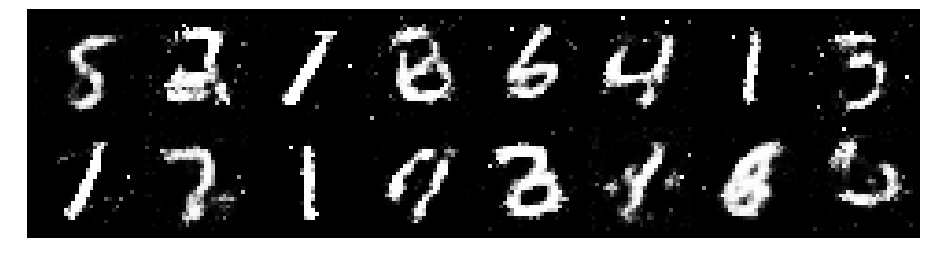

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.4651, Generator Loss: 0.8469
D(x): 0.6171, D(G(z)): 0.5376


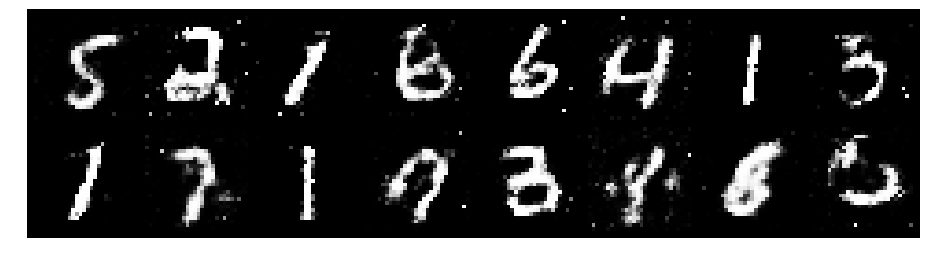

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.3543, Generator Loss: 0.9862
D(x): 0.5635, D(G(z)): 0.4328


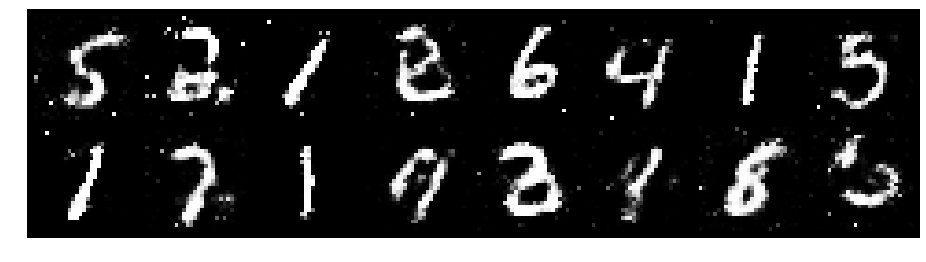

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2718, Generator Loss: 1.2121
D(x): 0.5679, D(G(z)): 0.3952


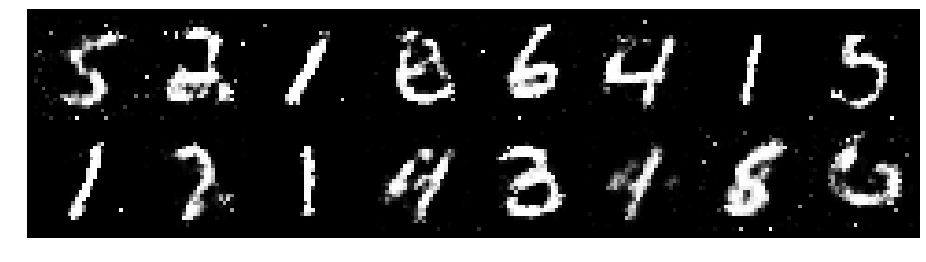

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1729, Generator Loss: 1.2456
D(x): 0.6113, D(G(z)): 0.3648


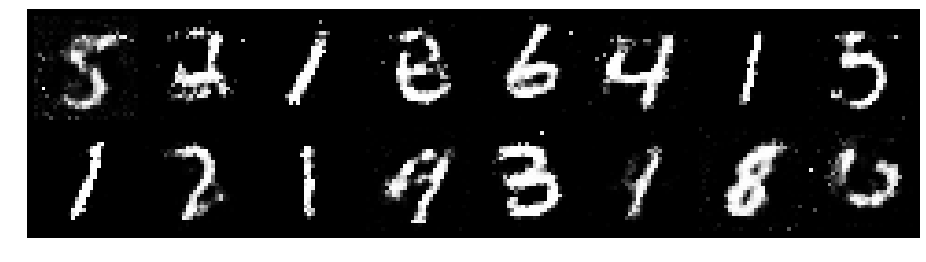

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1981, Generator Loss: 1.0732
D(x): 0.5583, D(G(z)): 0.3323


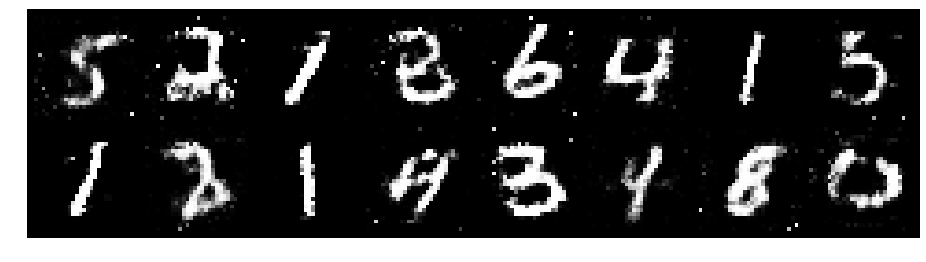

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1251, Generator Loss: 1.0789
D(x): 0.5731, D(G(z)): 0.3606


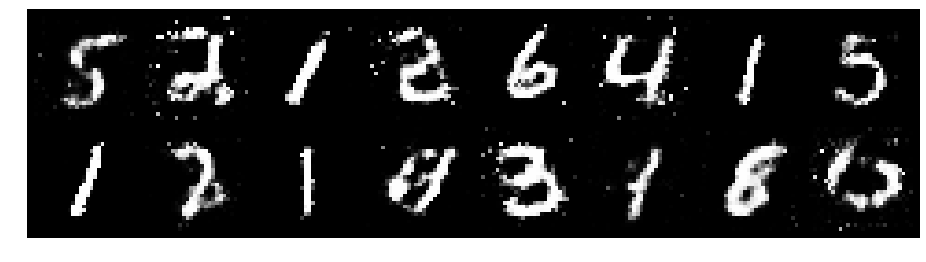

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1782, Generator Loss: 1.1850
D(x): 0.6194, D(G(z)): 0.4034


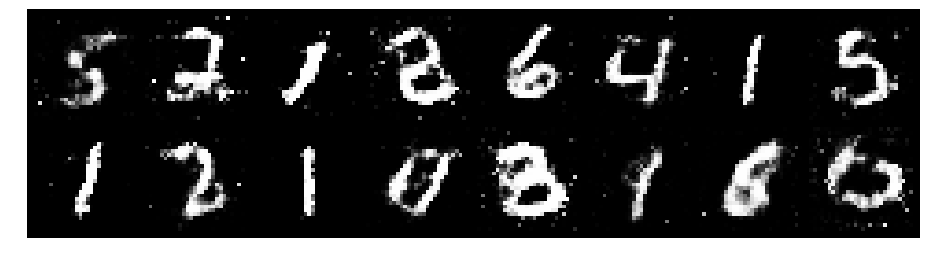

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1085, Generator Loss: 1.1443
D(x): 0.6495, D(G(z)): 0.4094


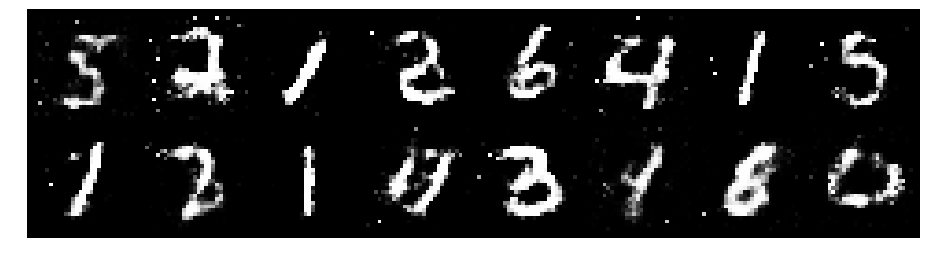

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 0.9340, Generator Loss: 1.1380
D(x): 0.7068, D(G(z)): 0.3601


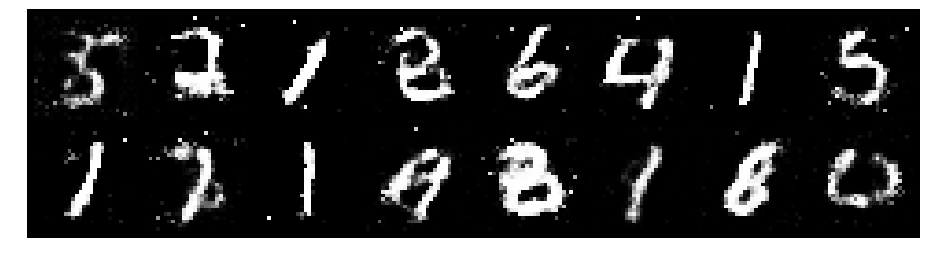

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1342, Generator Loss: 1.0806
D(x): 0.5396, D(G(z)): 0.3226


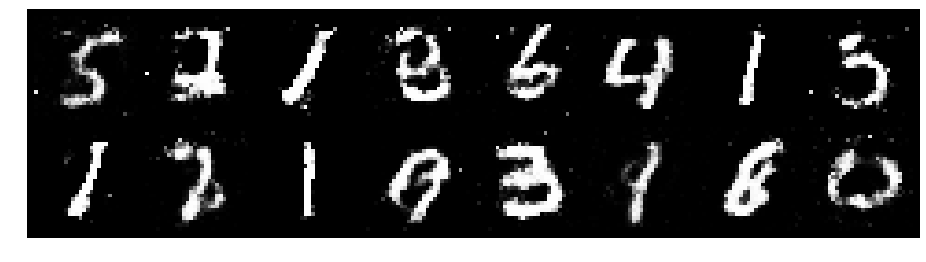

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.0237, Generator Loss: 1.1299
D(x): 0.6240, D(G(z)): 0.3613


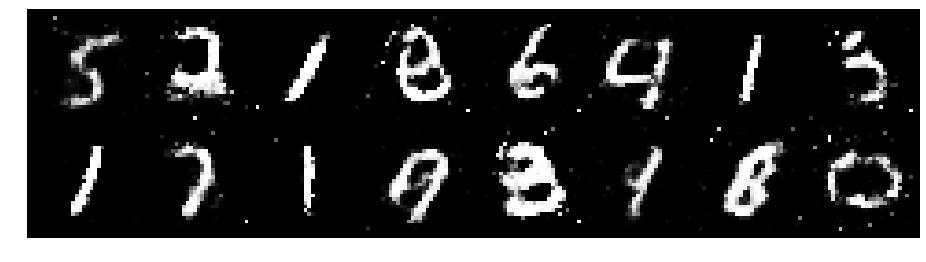

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1626, Generator Loss: 1.3596
D(x): 0.6392, D(G(z)): 0.4116


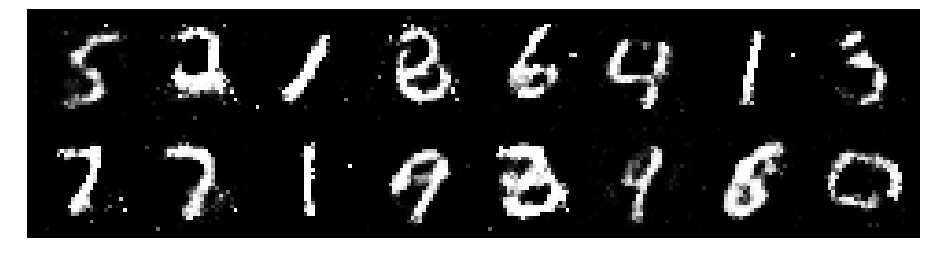

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2439, Generator Loss: 1.2591
D(x): 0.5907, D(G(z)): 0.4245


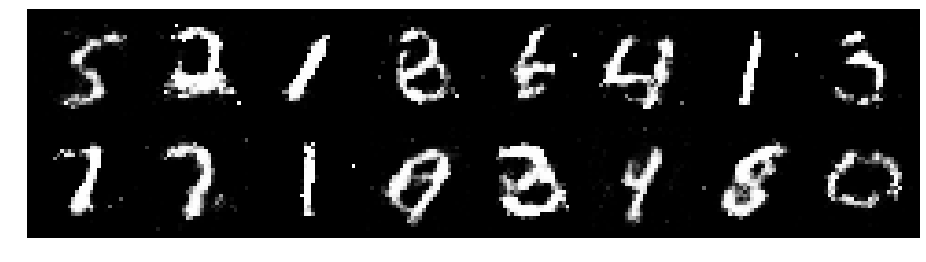

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.1674, Generator Loss: 1.0306
D(x): 0.5651, D(G(z)): 0.3853


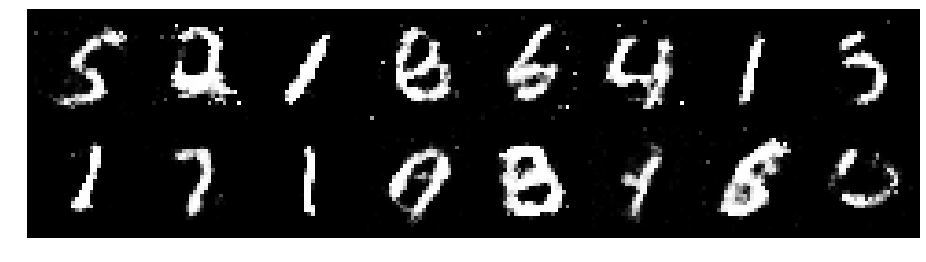

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.0184, Generator Loss: 1.2541
D(x): 0.6351, D(G(z)): 0.3354


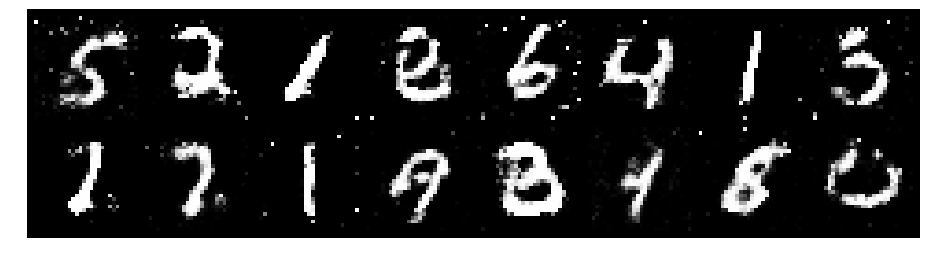

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1160, Generator Loss: 1.5056
D(x): 0.5760, D(G(z)): 0.3382


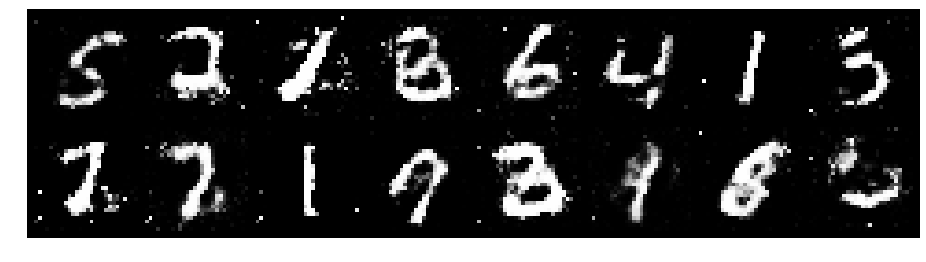

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2481, Generator Loss: 1.0382
D(x): 0.5574, D(G(z)): 0.3805


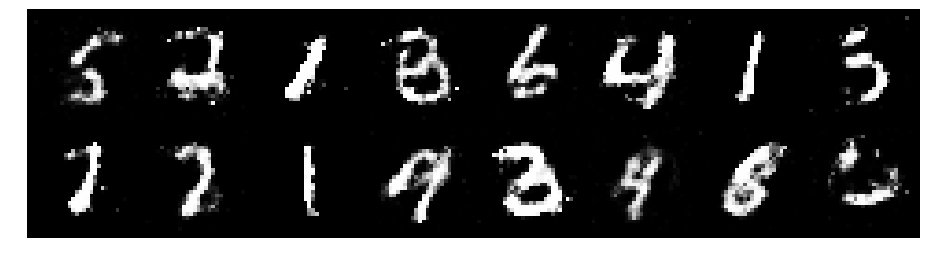

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.3481, Generator Loss: 0.9191
D(x): 0.5546, D(G(z)): 0.4366


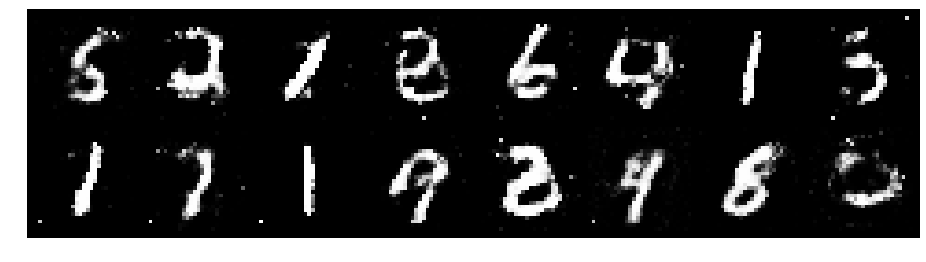

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0949, Generator Loss: 1.4357
D(x): 0.6392, D(G(z)): 0.3687


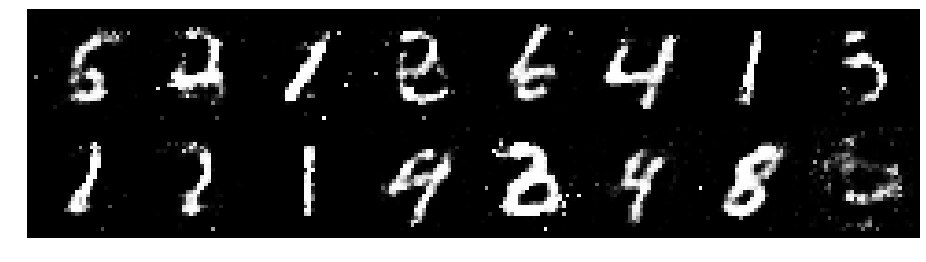

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2440, Generator Loss: 0.7919
D(x): 0.6116, D(G(z)): 0.4638


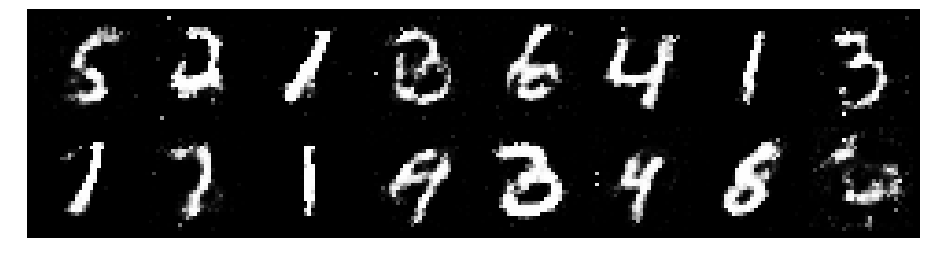

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1569, Generator Loss: 1.1461
D(x): 0.5780, D(G(z)): 0.3684


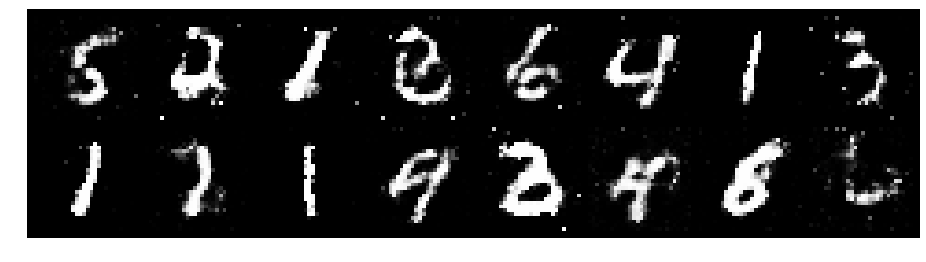

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.0838, Generator Loss: 1.0584
D(x): 0.5708, D(G(z)): 0.3309


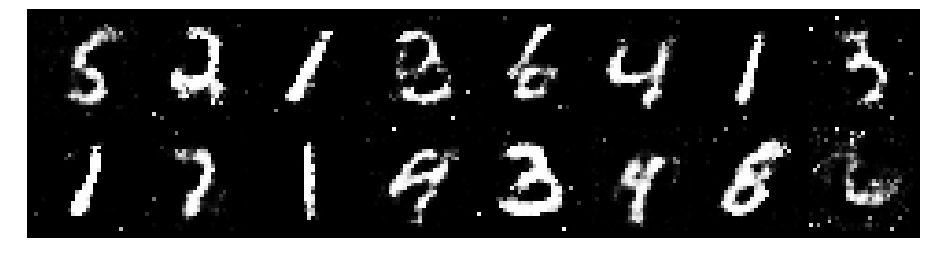

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0905, Generator Loss: 0.9915
D(x): 0.6241, D(G(z)): 0.3678


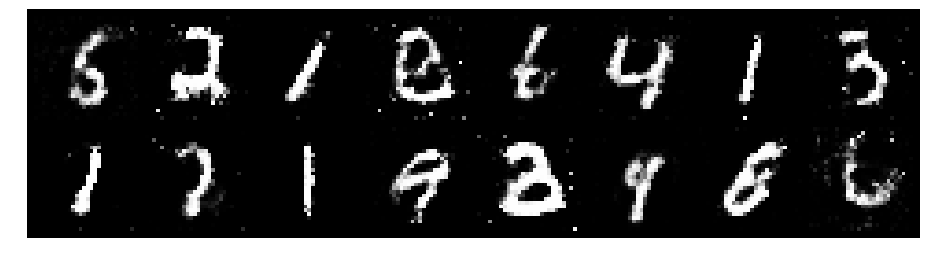

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0172, Generator Loss: 0.9743
D(x): 0.6435, D(G(z)): 0.3667


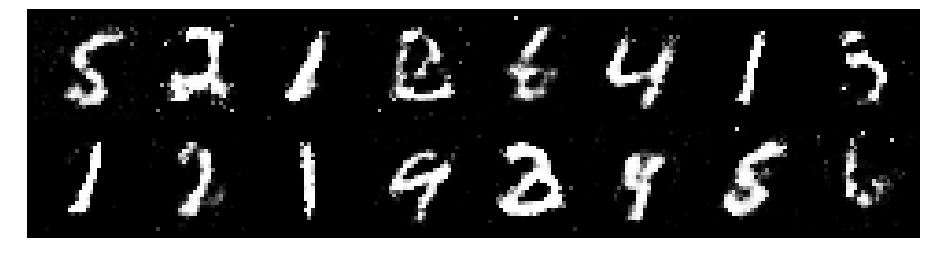

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.1548, Generator Loss: 0.9236
D(x): 0.6210, D(G(z)): 0.4304


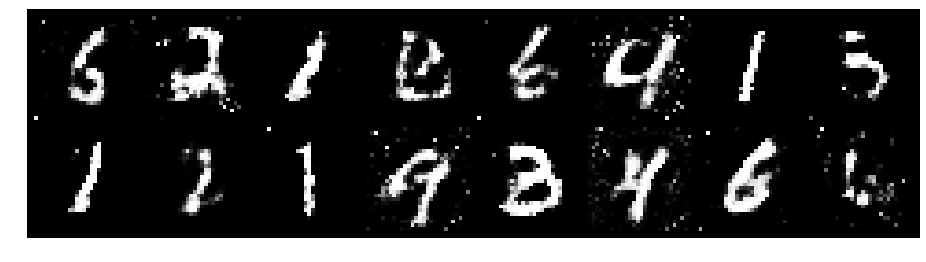

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1613, Generator Loss: 1.0039
D(x): 0.5760, D(G(z)): 0.3960


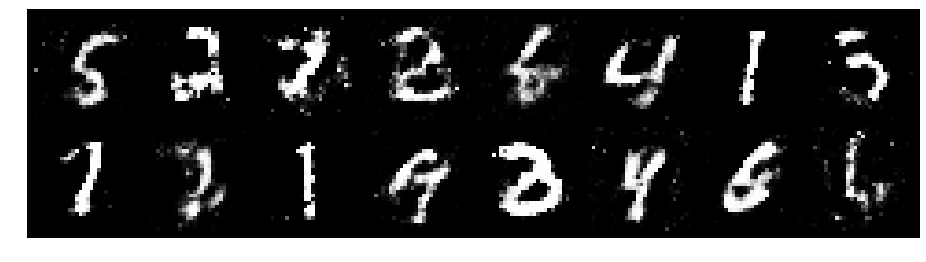

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.0156, Generator Loss: 0.9430
D(x): 0.6705, D(G(z)): 0.4005


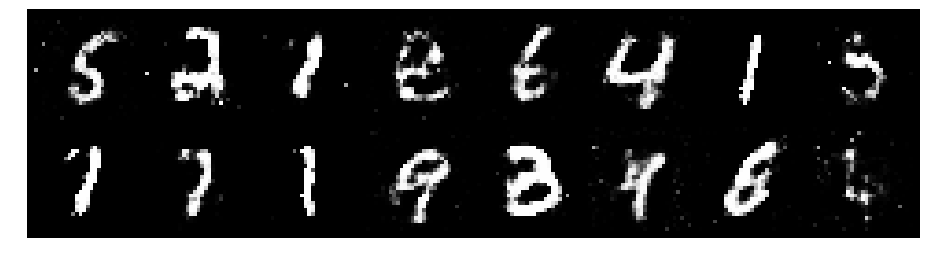

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.1097, Generator Loss: 1.1128
D(x): 0.6332, D(G(z)): 0.4290


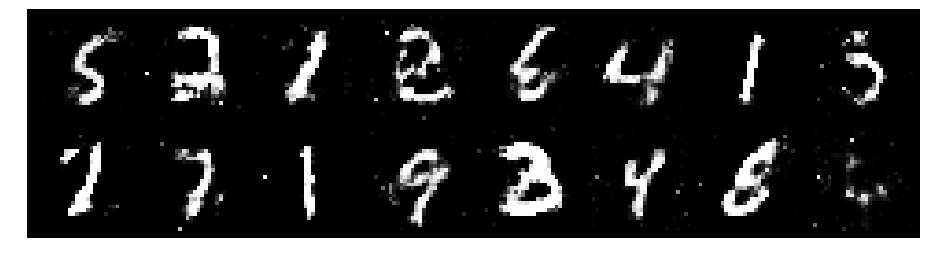

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1498, Generator Loss: 1.0639
D(x): 0.6188, D(G(z)): 0.4138


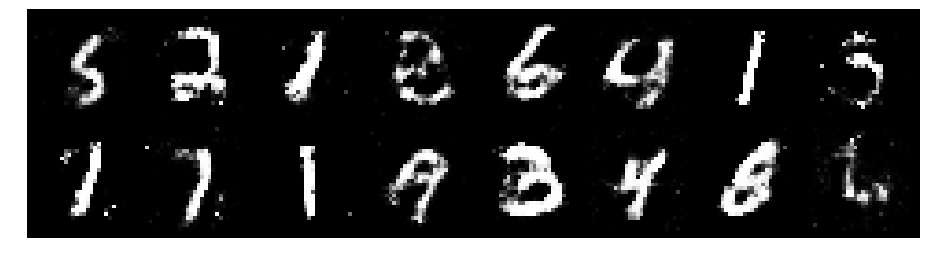

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.1021, Generator Loss: 1.0624
D(x): 0.6031, D(G(z)): 0.3878


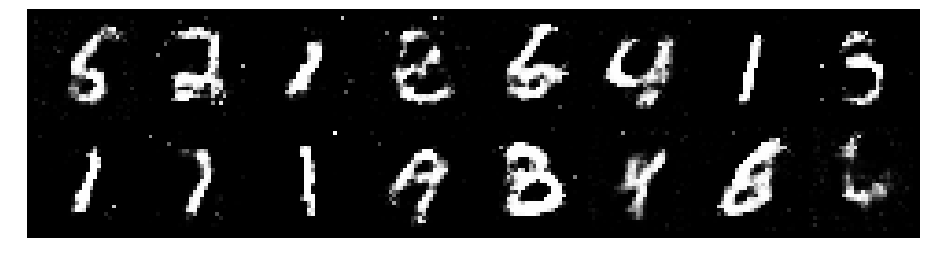

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1725, Generator Loss: 0.9701
D(x): 0.6077, D(G(z)): 0.4306


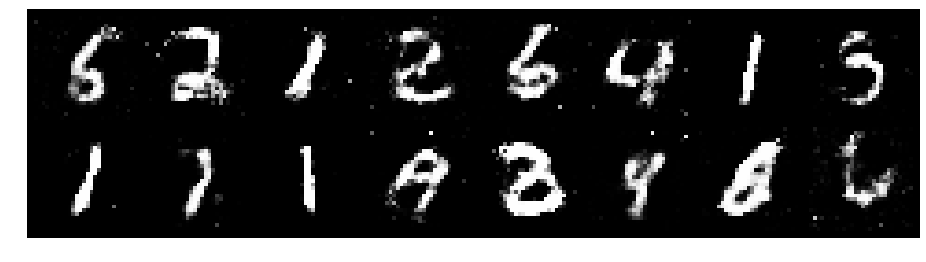

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2264, Generator Loss: 1.2229
D(x): 0.6118, D(G(z)): 0.4277


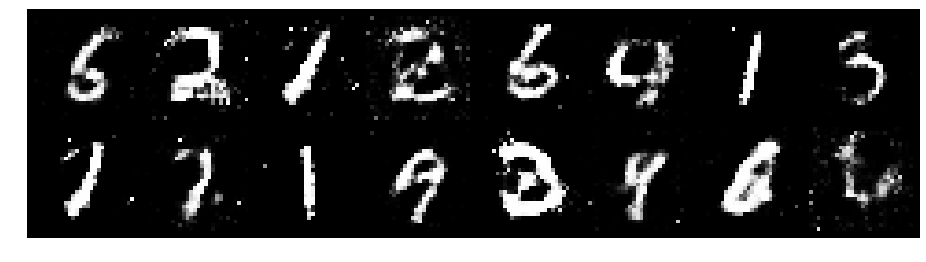

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.3013, Generator Loss: 1.1297
D(x): 0.5716, D(G(z)): 0.4317


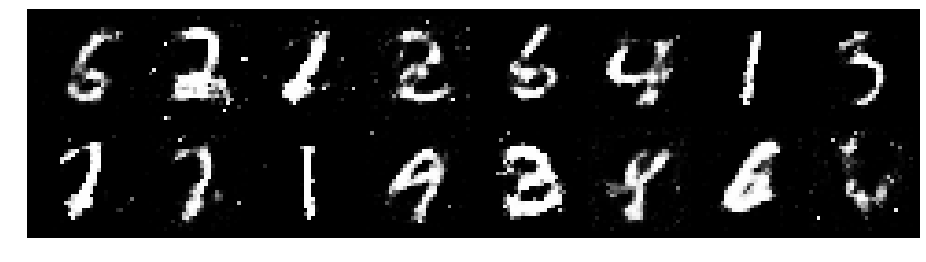

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.0669, Generator Loss: 1.2747
D(x): 0.6943, D(G(z)): 0.3920


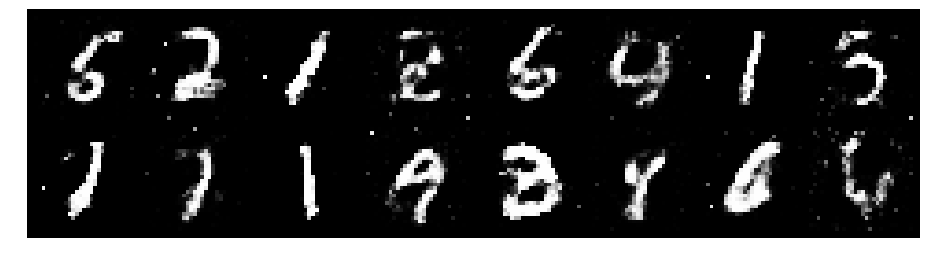

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2505, Generator Loss: 0.9924
D(x): 0.5935, D(G(z)): 0.4473


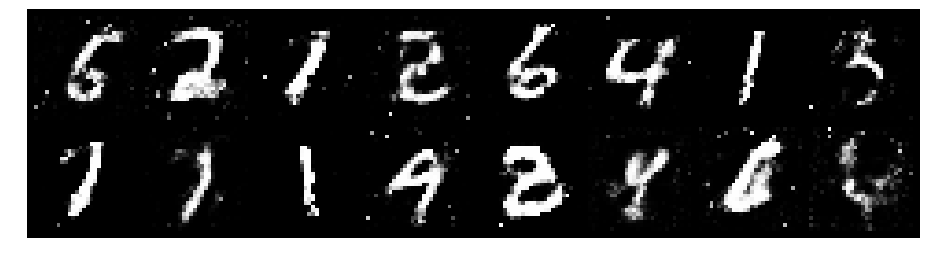

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.1304, Generator Loss: 1.0359
D(x): 0.6174, D(G(z)): 0.3964


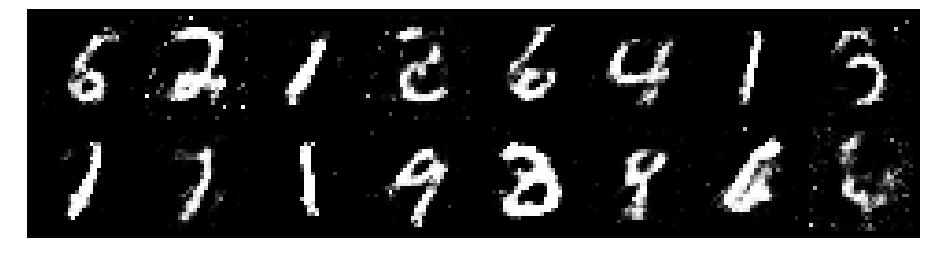

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1456, Generator Loss: 1.1900
D(x): 0.6298, D(G(z)): 0.4189


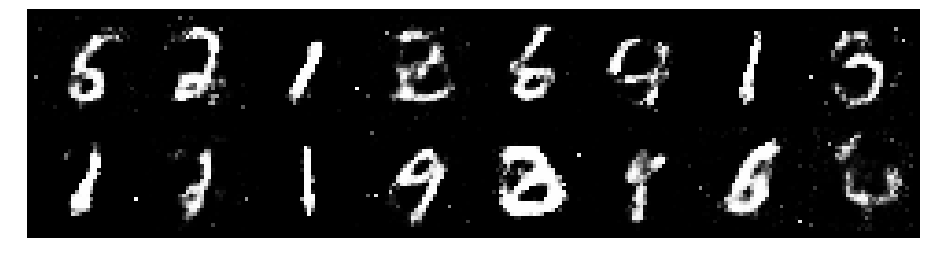

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.1047, Generator Loss: 1.0769
D(x): 0.6130, D(G(z)): 0.3614


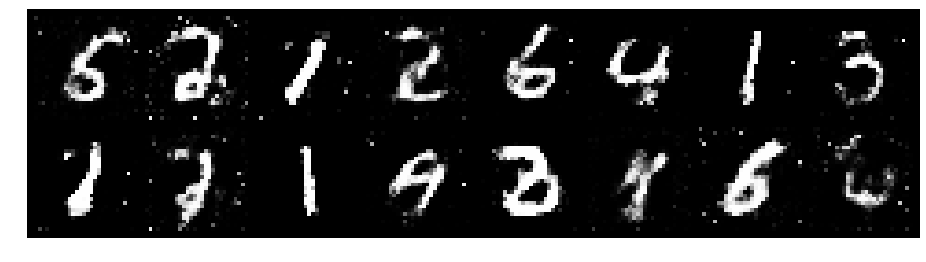

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1104, Generator Loss: 1.1741
D(x): 0.5624, D(G(z)): 0.3377


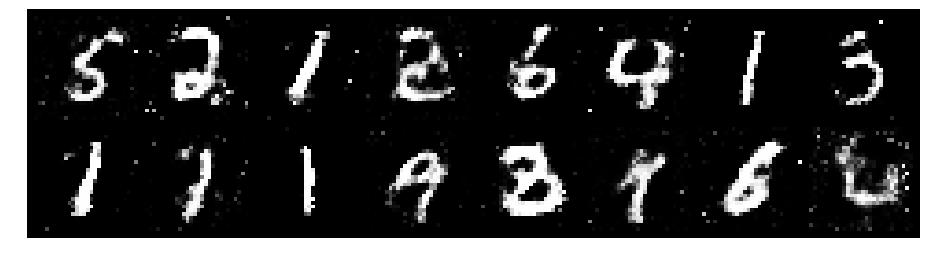

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 1.0462
D(x): 0.5761, D(G(z)): 0.4271


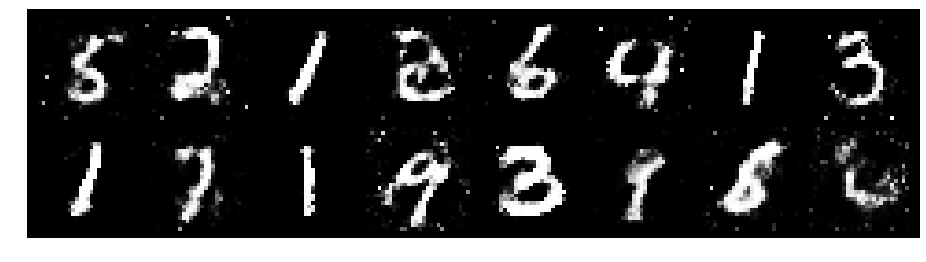

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0007, Generator Loss: 1.0953
D(x): 0.6438, D(G(z)): 0.3537


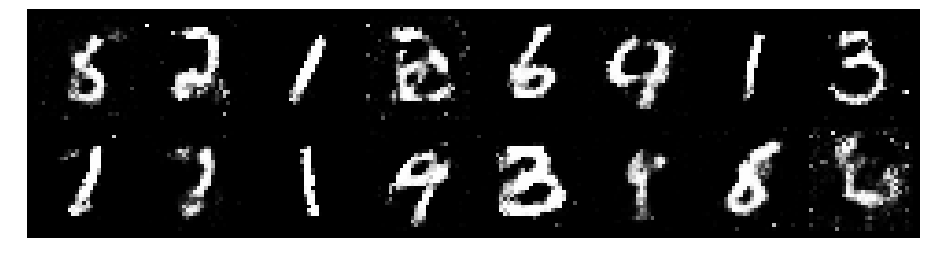

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2947, Generator Loss: 1.0182
D(x): 0.5865, D(G(z)): 0.4372


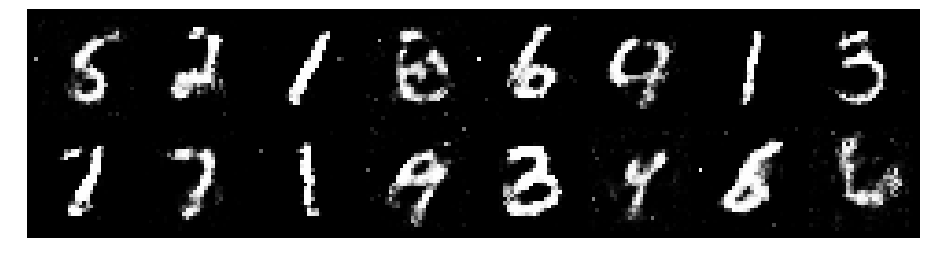

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.2569, Generator Loss: 0.9168
D(x): 0.5683, D(G(z)): 0.4119


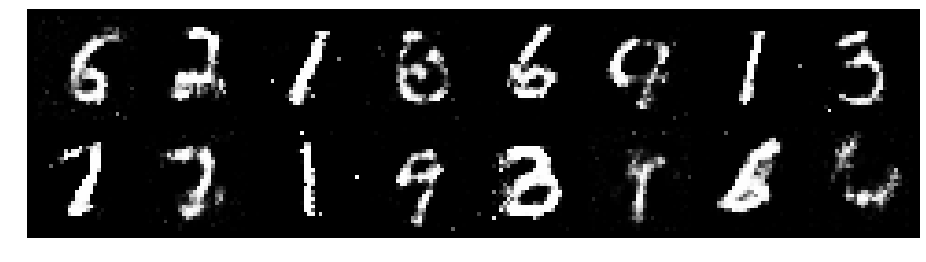

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.2521, Generator Loss: 0.8327
D(x): 0.5931, D(G(z)): 0.4644


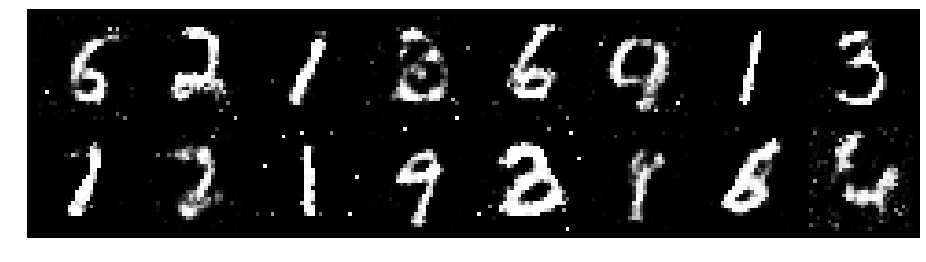

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.1252, Generator Loss: 1.3329
D(x): 0.5789, D(G(z)): 0.3198


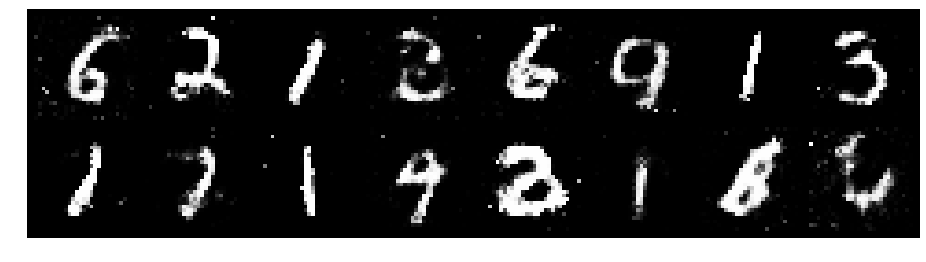

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.3169, Generator Loss: 1.0256
D(x): 0.5125, D(G(z)): 0.3819


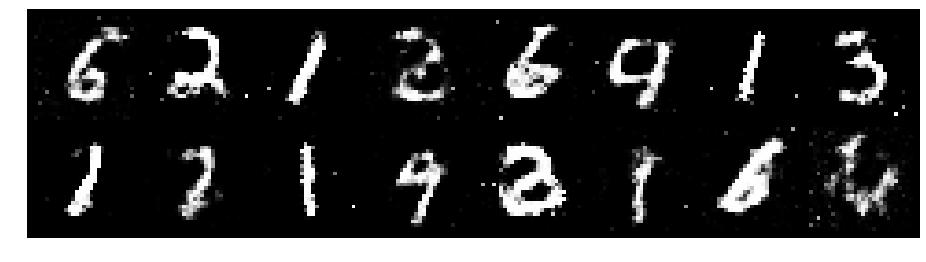

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1252, Generator Loss: 1.2290
D(x): 0.6475, D(G(z)): 0.3949


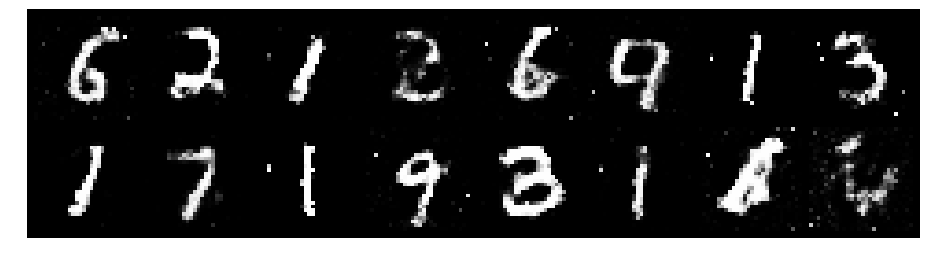

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1813, Generator Loss: 1.1357
D(x): 0.6065, D(G(z)): 0.4029


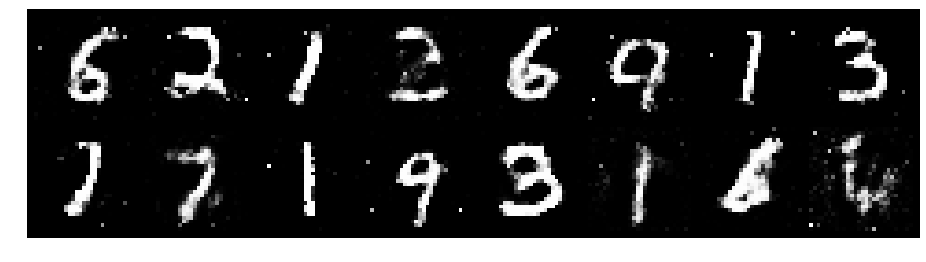

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1850, Generator Loss: 0.9758
D(x): 0.5800, D(G(z)): 0.4007


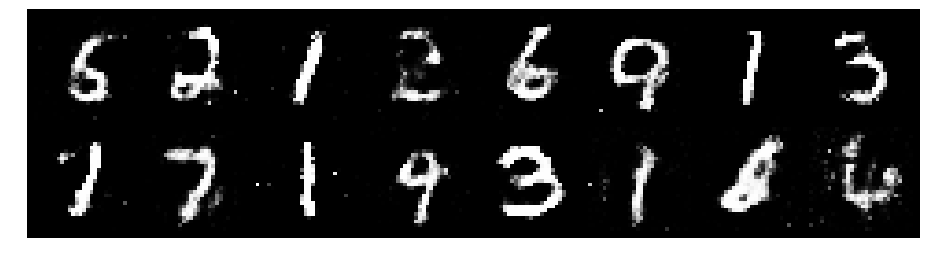

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1236, Generator Loss: 1.0336
D(x): 0.6022, D(G(z)): 0.3981


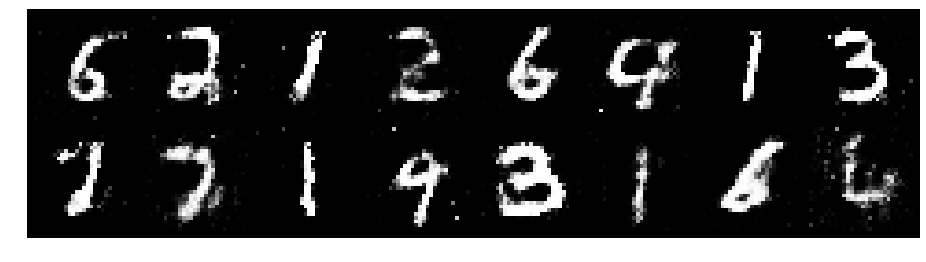

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1505, Generator Loss: 1.1346
D(x): 0.6287, D(G(z)): 0.4138


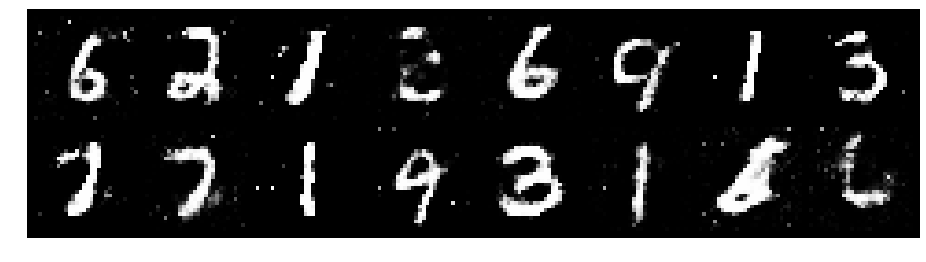

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1821, Generator Loss: 1.0217
D(x): 0.5599, D(G(z)): 0.4022


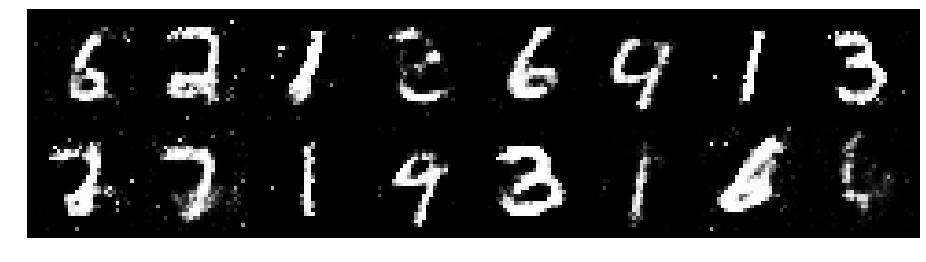

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2067, Generator Loss: 0.8565
D(x): 0.5633, D(G(z)): 0.4182


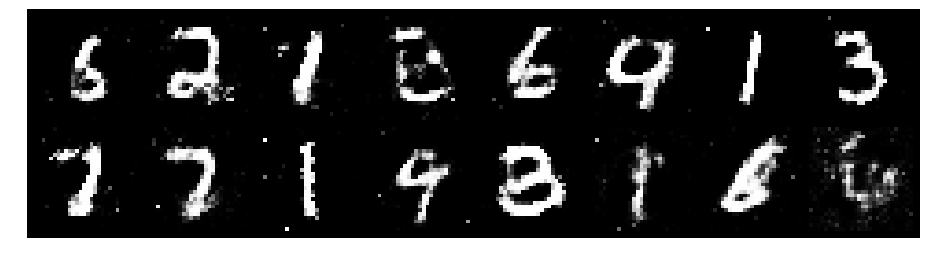

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1913, Generator Loss: 0.7963
D(x): 0.6790, D(G(z)): 0.5037


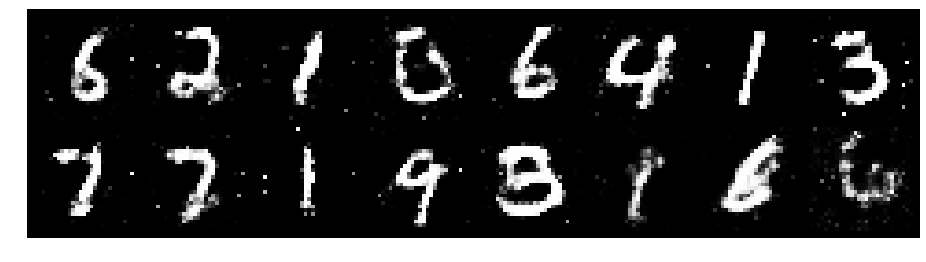

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2872, Generator Loss: 0.8846
D(x): 0.6031, D(G(z)): 0.4905


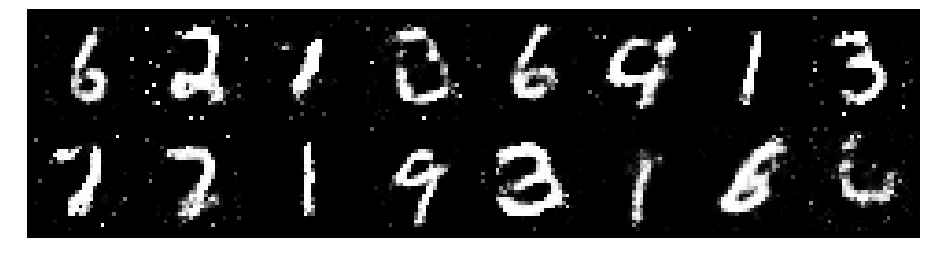

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2705, Generator Loss: 0.9648
D(x): 0.6040, D(G(z)): 0.4514


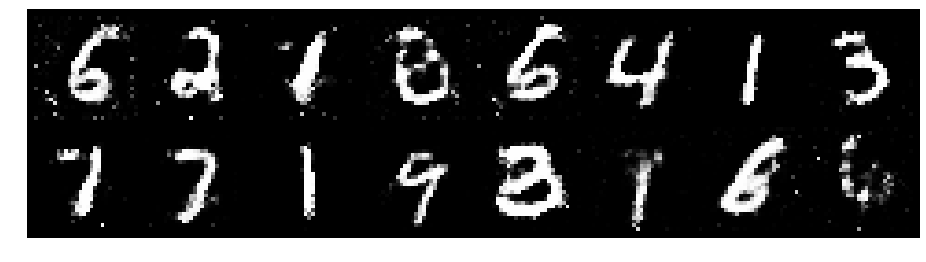

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2671, Generator Loss: 0.8423
D(x): 0.6306, D(G(z)): 0.4963


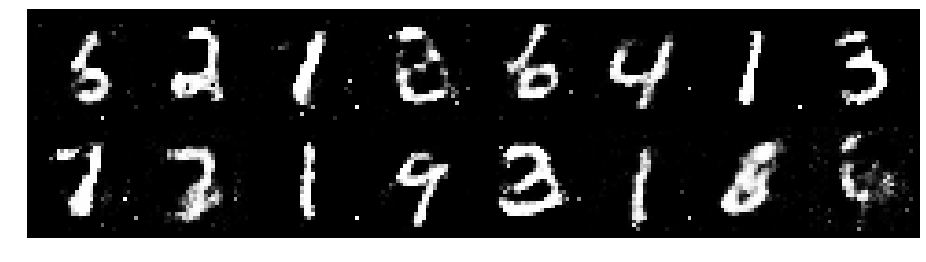

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1231, Generator Loss: 0.9185
D(x): 0.5794, D(G(z)): 0.3673


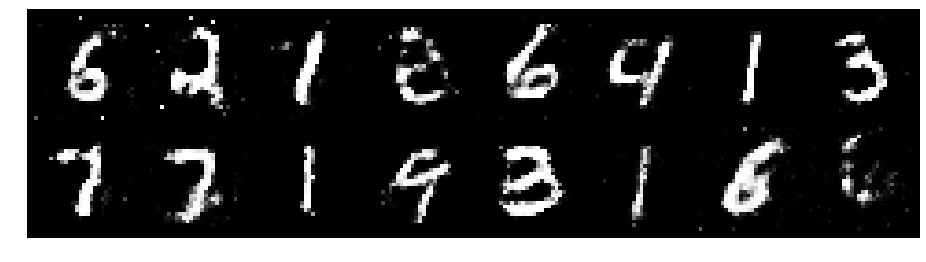

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2788, Generator Loss: 1.1790
D(x): 0.5707, D(G(z)): 0.3957


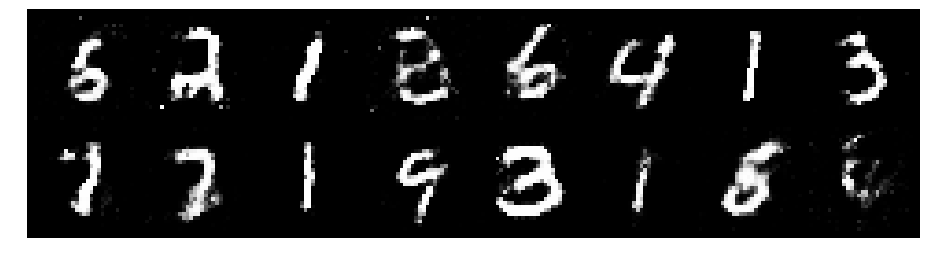

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2098, Generator Loss: 0.9530
D(x): 0.6196, D(G(z)): 0.4395


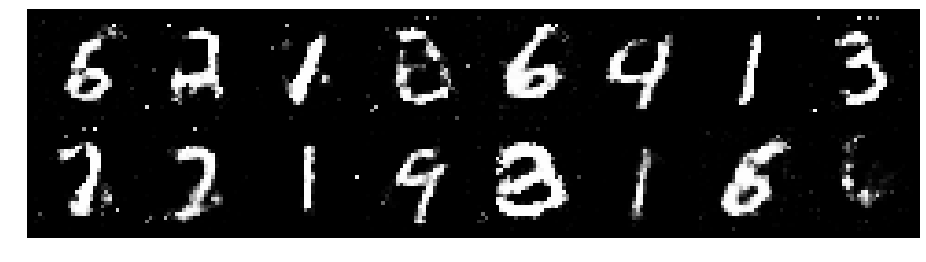

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.0658, Generator Loss: 1.1082
D(x): 0.6006, D(G(z)): 0.3700


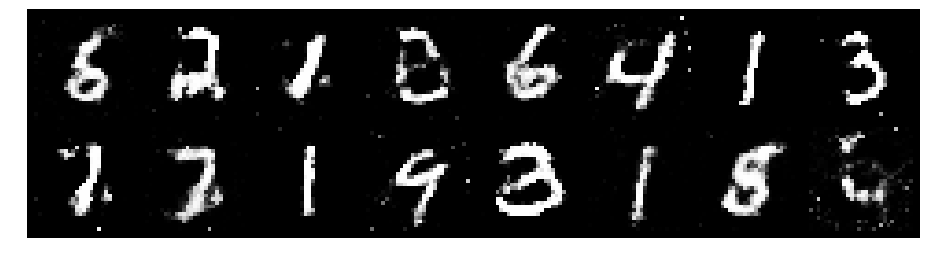

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9868
D(x): 0.5904, D(G(z)): 0.4405


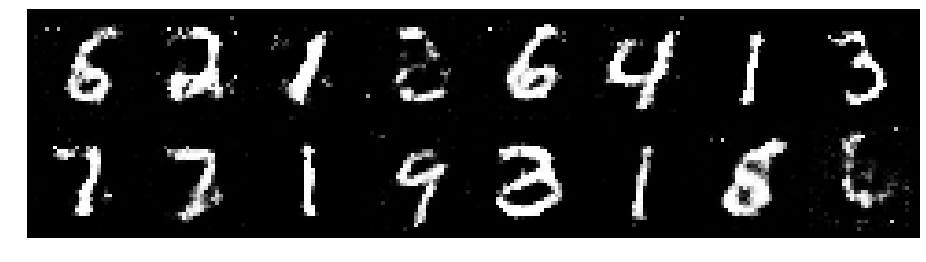

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.0981, Generator Loss: 1.0440
D(x): 0.6164, D(G(z)): 0.3945


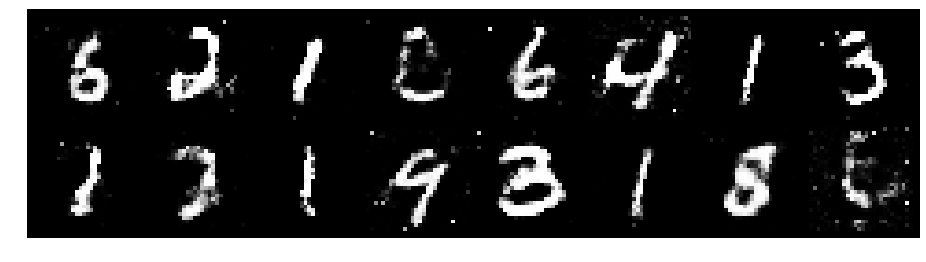

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.0643, Generator Loss: 1.1920
D(x): 0.6285, D(G(z)): 0.3694


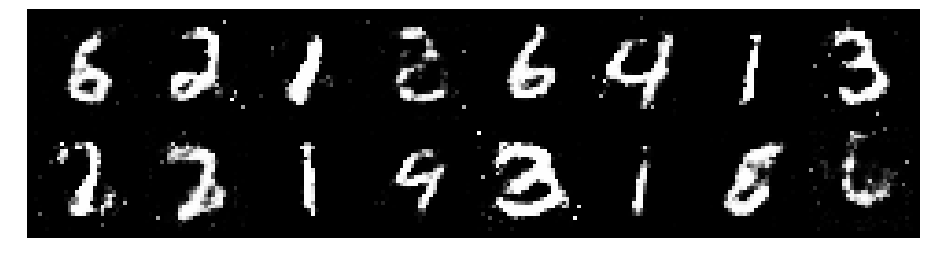

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2514, Generator Loss: 1.0717
D(x): 0.5620, D(G(z)): 0.3899


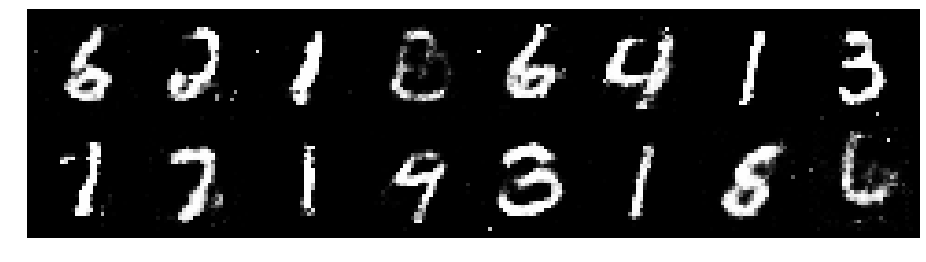

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1424, Generator Loss: 1.0831
D(x): 0.5925, D(G(z)): 0.3769


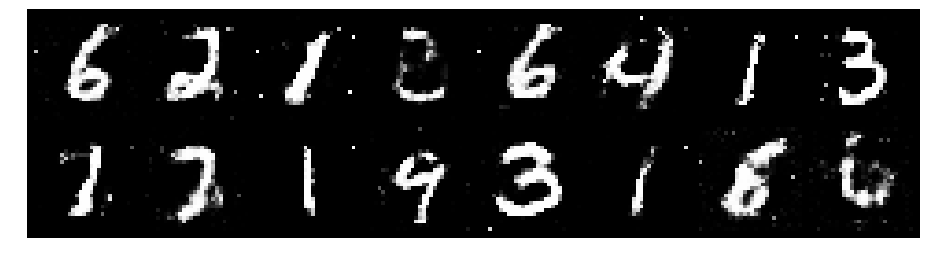

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1330, Generator Loss: 1.0862
D(x): 0.5791, D(G(z)): 0.3613


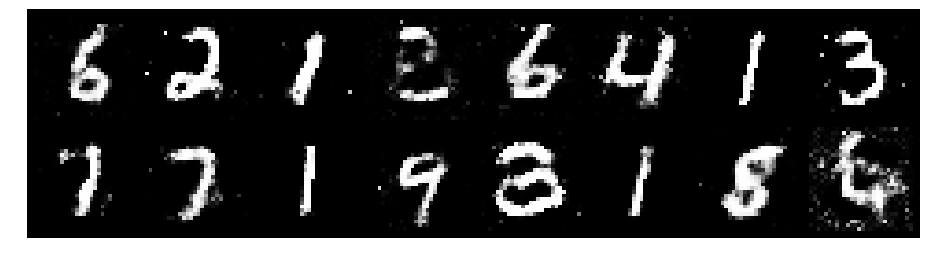

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2074, Generator Loss: 1.0757
D(x): 0.5847, D(G(z)): 0.3911


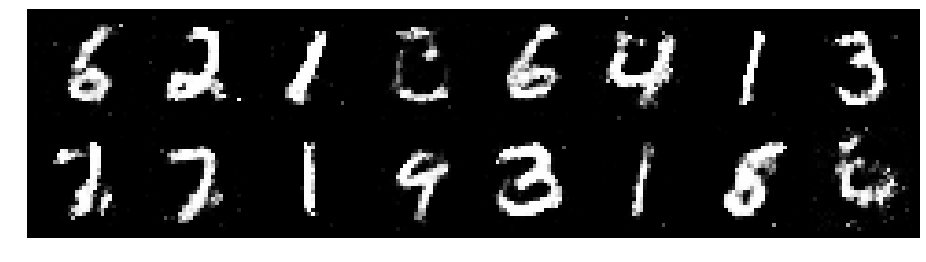

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1366, Generator Loss: 0.9263
D(x): 0.5790, D(G(z)): 0.4021


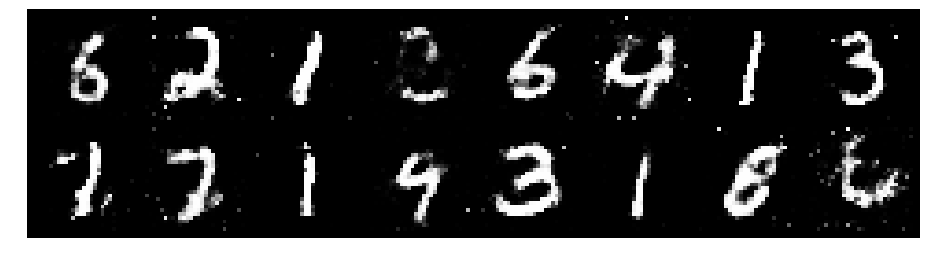

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.2241, Generator Loss: 1.0059
D(x): 0.5308, D(G(z)): 0.3823


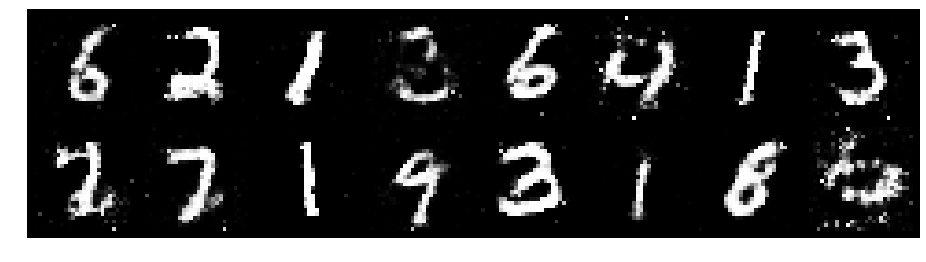

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2704, Generator Loss: 0.8754
D(x): 0.6063, D(G(z)): 0.4863


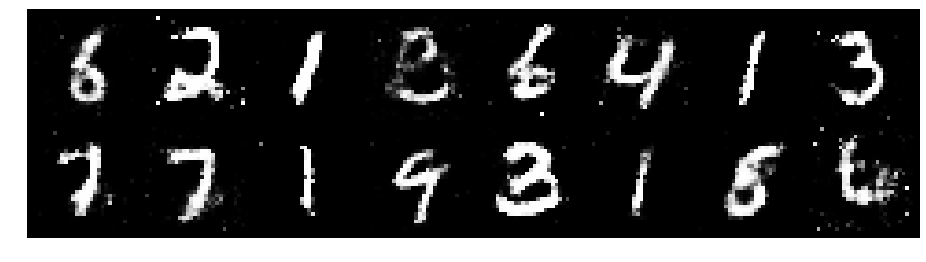

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.0908, Generator Loss: 1.0860
D(x): 0.6720, D(G(z)): 0.4158


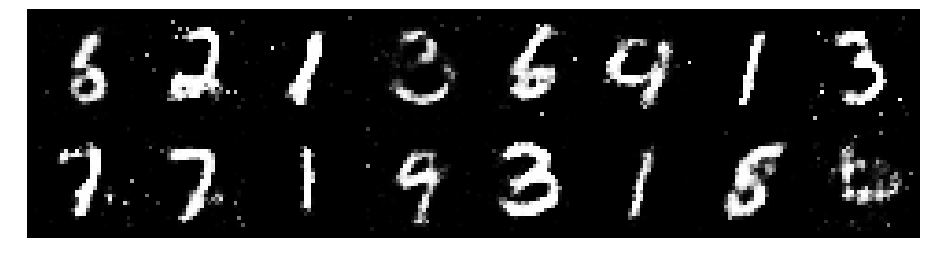

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.0921, Generator Loss: 1.3048
D(x): 0.6031, D(G(z)): 0.3465


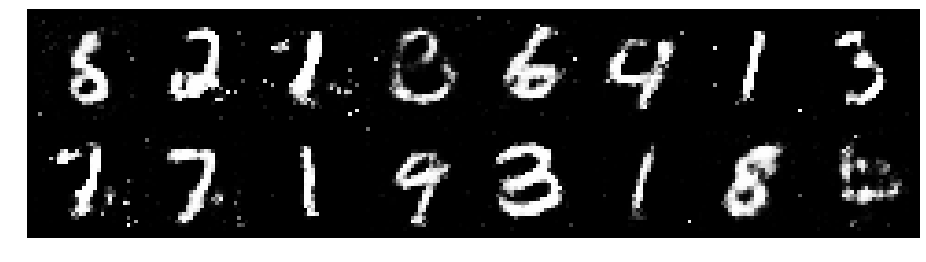

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2232, Generator Loss: 1.1377
D(x): 0.5619, D(G(z)): 0.3905


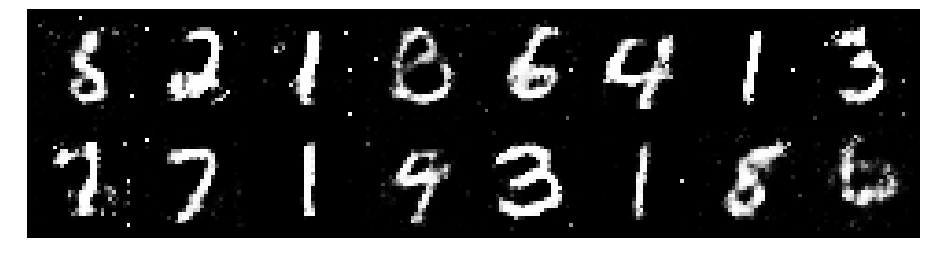

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.0720, Generator Loss: 1.0399
D(x): 0.6248, D(G(z)): 0.3939


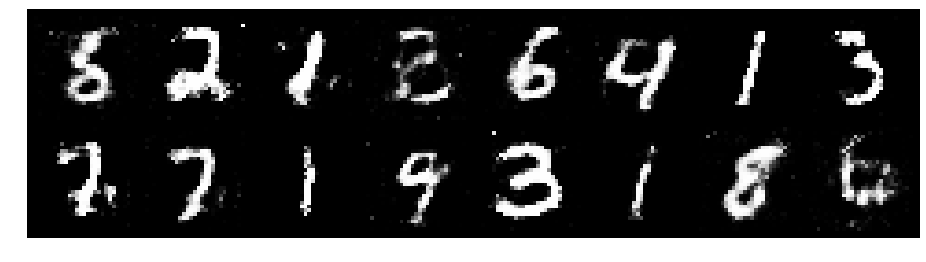

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2424, Generator Loss: 1.2830
D(x): 0.5339, D(G(z)): 0.3677


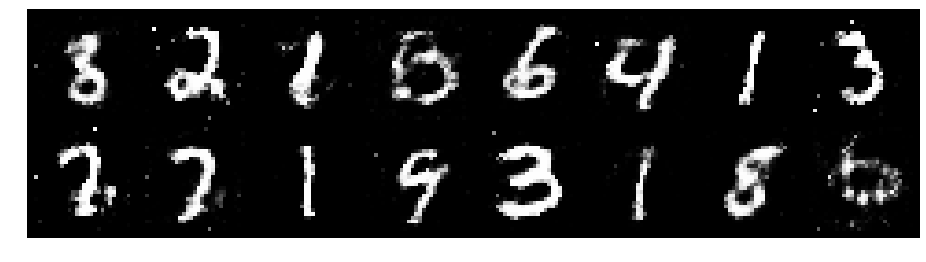

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2370, Generator Loss: 1.1234
D(x): 0.5741, D(G(z)): 0.4328


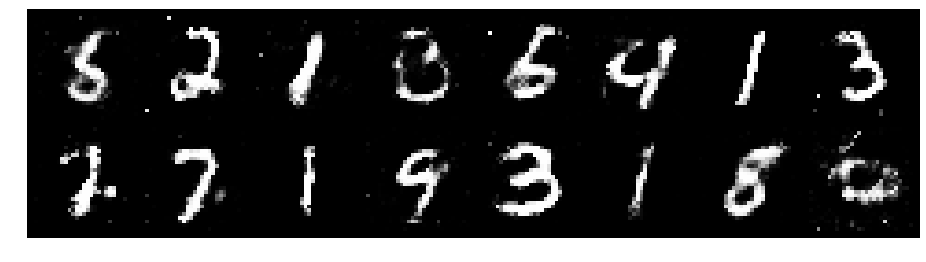

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.0593, Generator Loss: 1.2785
D(x): 0.6143, D(G(z)): 0.3391


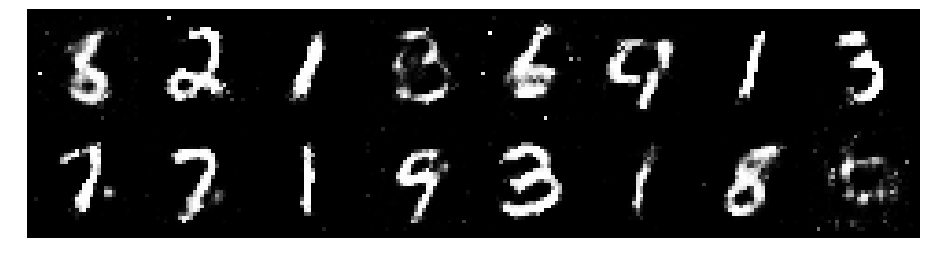

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1160, Generator Loss: 0.9482
D(x): 0.6200, D(G(z)): 0.4114


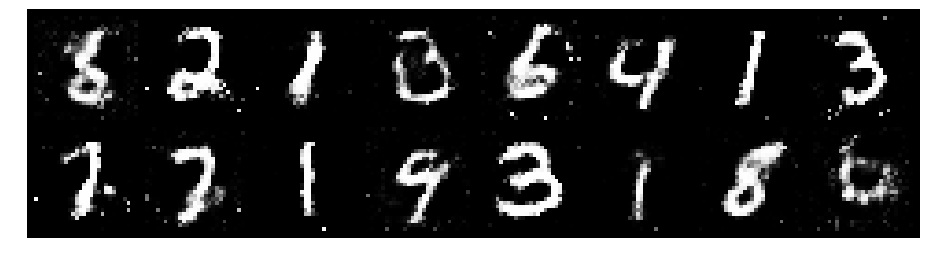

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1455, Generator Loss: 0.9168
D(x): 0.5927, D(G(z)): 0.4090


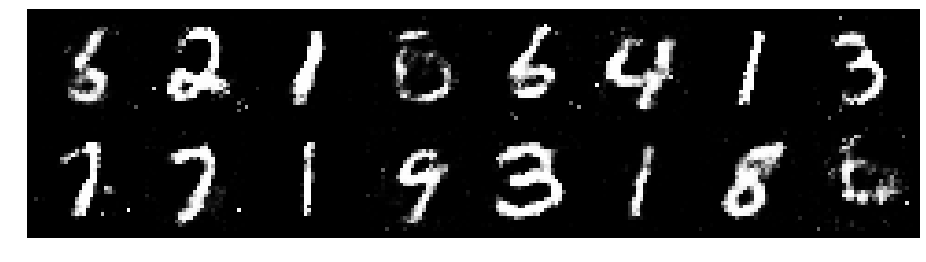

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1435, Generator Loss: 0.9027
D(x): 0.5844, D(G(z)): 0.4129


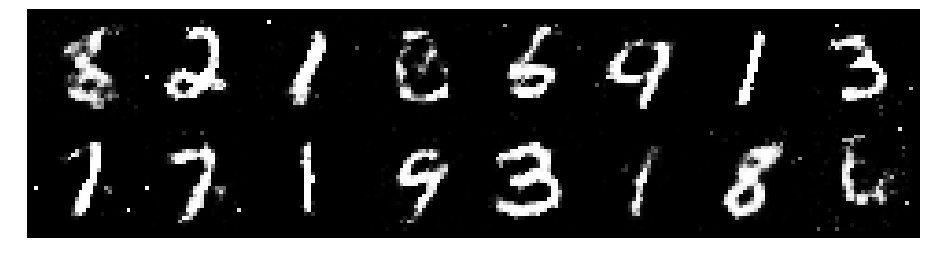

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8953
D(x): 0.5156, D(G(z)): 0.4225


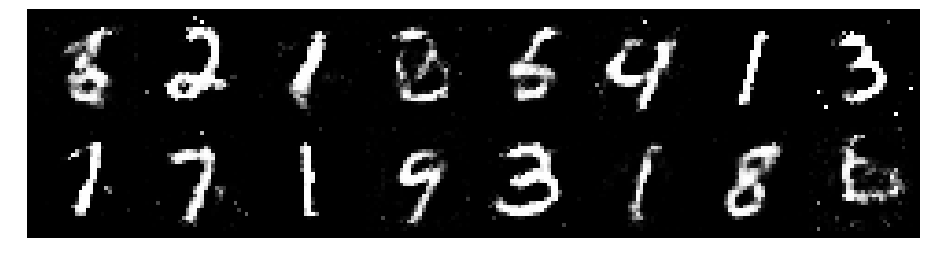

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.3037, Generator Loss: 0.8992
D(x): 0.5327, D(G(z)): 0.4343


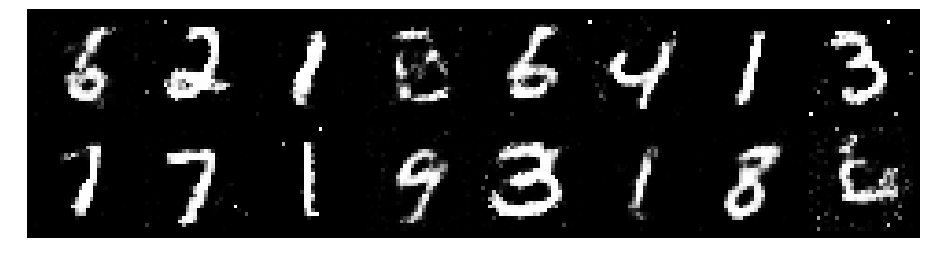

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1437, Generator Loss: 0.9670
D(x): 0.6316, D(G(z)): 0.4373


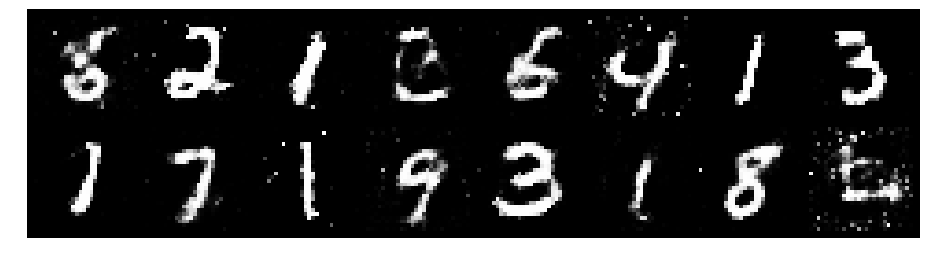

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2148, Generator Loss: 0.9980
D(x): 0.5405, D(G(z)): 0.3745


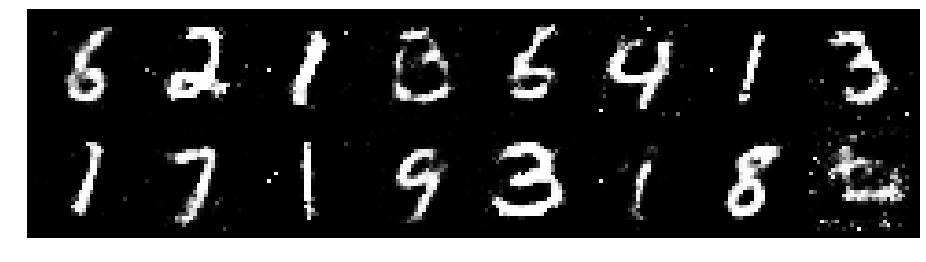

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1980, Generator Loss: 1.0004
D(x): 0.6129, D(G(z)): 0.4305


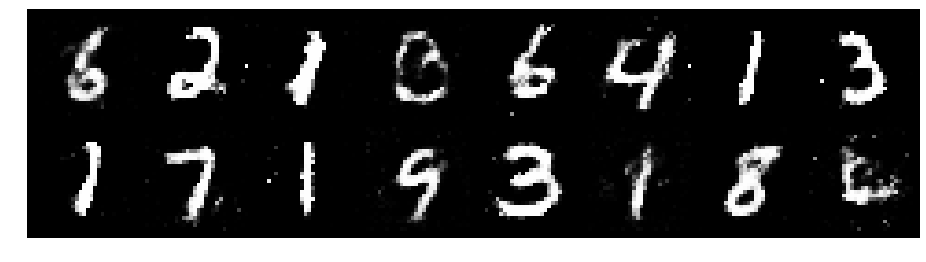

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.2268, Generator Loss: 1.1254
D(x): 0.5195, D(G(z)): 0.3505


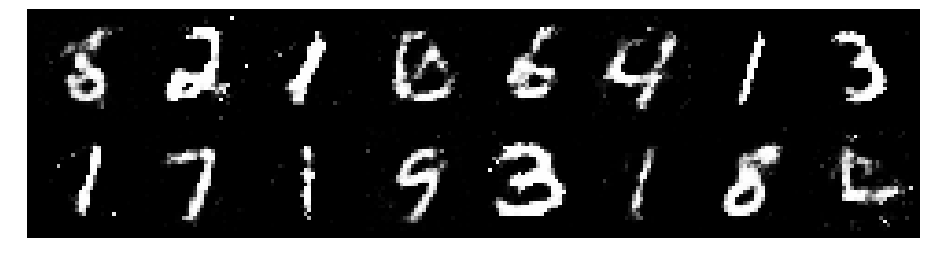

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.1514, Generator Loss: 0.9329
D(x): 0.6063, D(G(z)): 0.4128


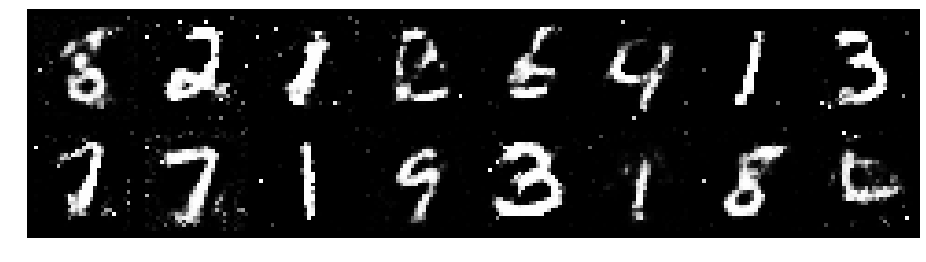

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.3210, Generator Loss: 0.9011
D(x): 0.5577, D(G(z)): 0.4328


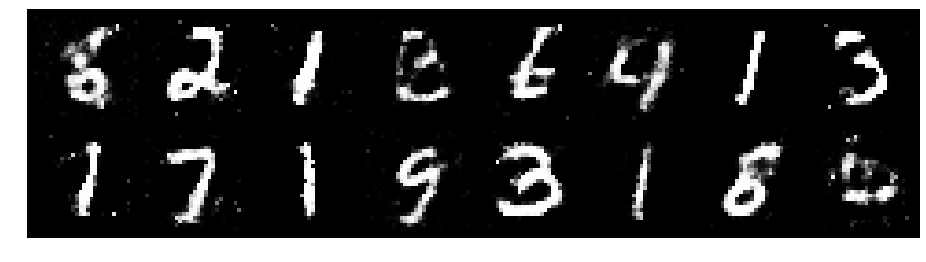

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2447, Generator Loss: 0.9486
D(x): 0.5806, D(G(z)): 0.4482


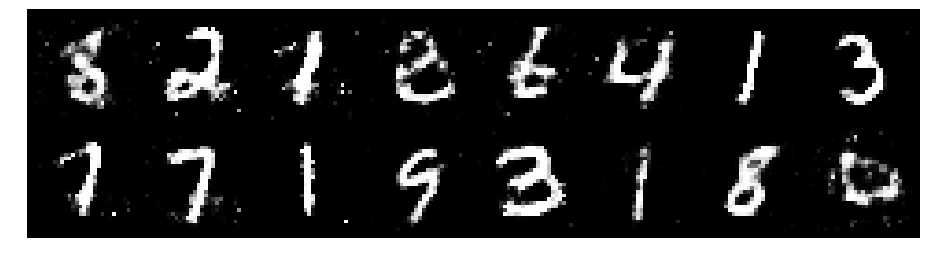

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.3199, Generator Loss: 1.1758
D(x): 0.5133, D(G(z)): 0.3765


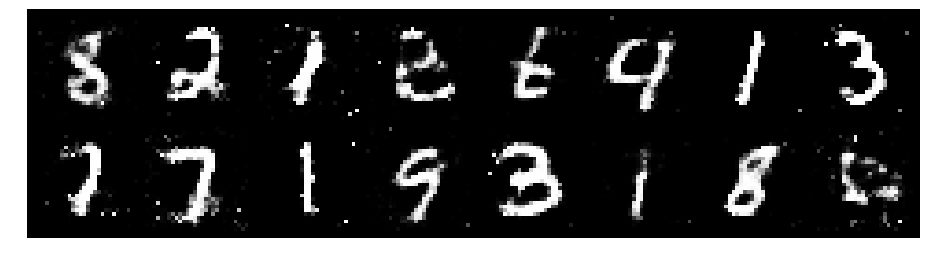

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2153, Generator Loss: 0.8310
D(x): 0.5851, D(G(z)): 0.4455


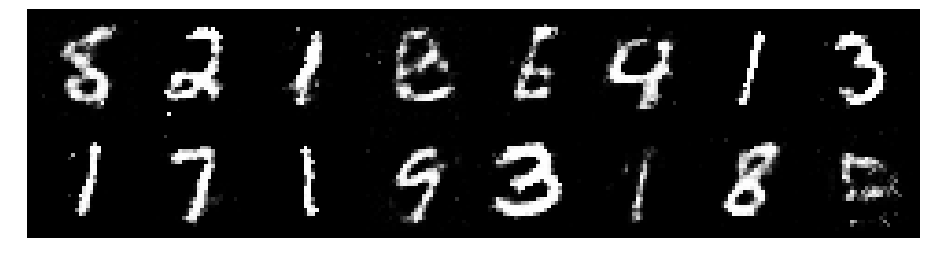

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.4707, Generator Loss: 0.9915
D(x): 0.4899, D(G(z)): 0.4032


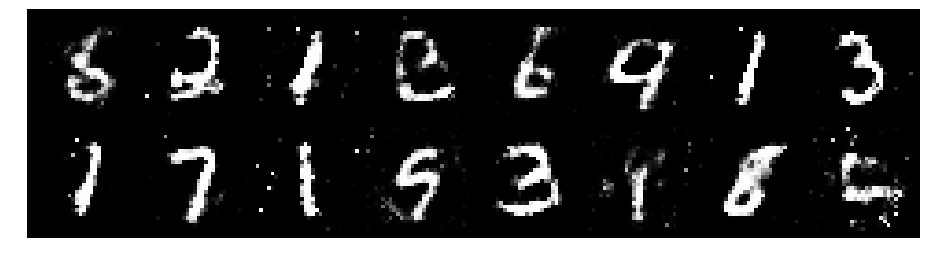

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.1854, Generator Loss: 1.2587
D(x): 0.5688, D(G(z)): 0.3648


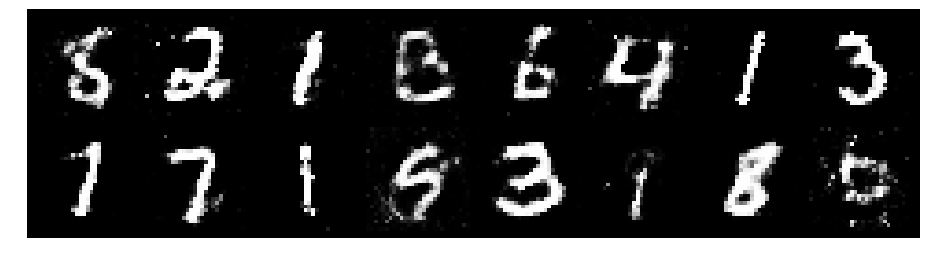

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0758
D(x): 0.5911, D(G(z)): 0.3938


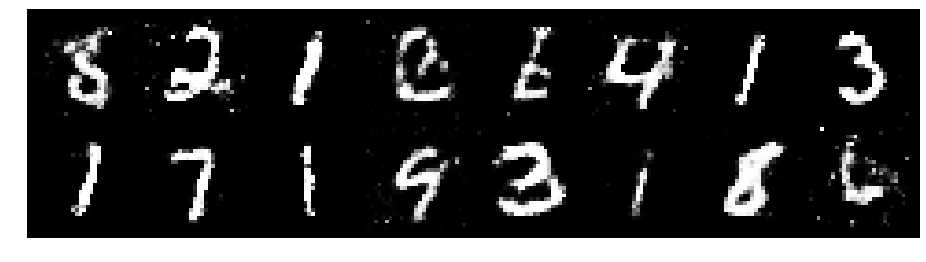

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1710, Generator Loss: 0.9265
D(x): 0.5992, D(G(z)): 0.4326


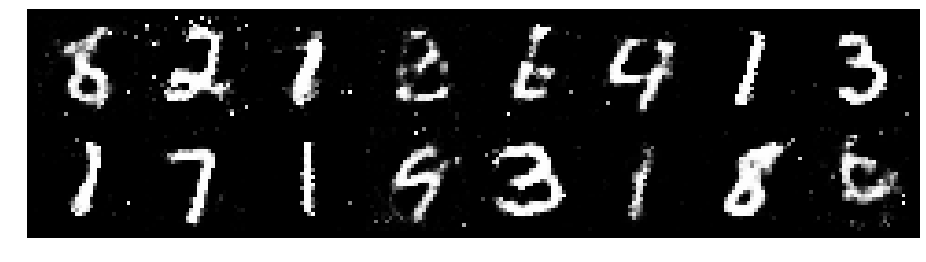

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.3129, Generator Loss: 0.8808
D(x): 0.5739, D(G(z)): 0.4650


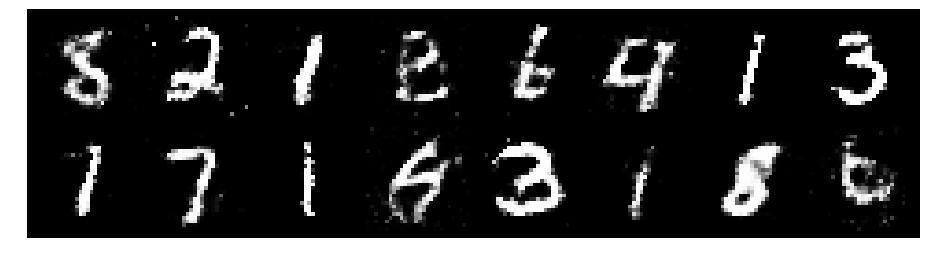

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.1668, Generator Loss: 0.9923
D(x): 0.5879, D(G(z)): 0.4132


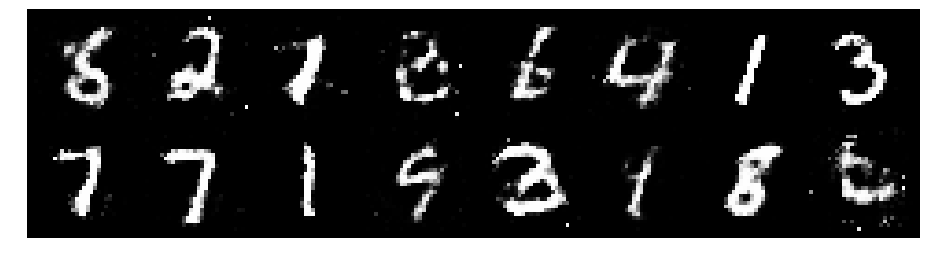

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9578
D(x): 0.5813, D(G(z)): 0.4447


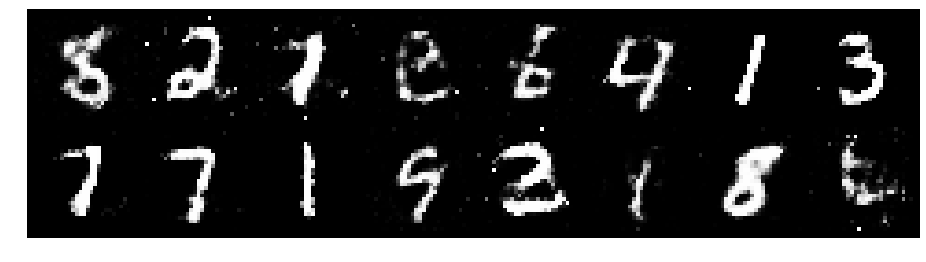

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1721, Generator Loss: 0.8645
D(x): 0.5908, D(G(z)): 0.4235


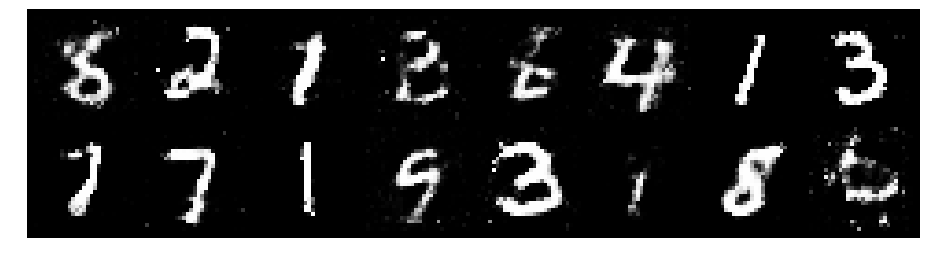

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.2357, Generator Loss: 0.7979
D(x): 0.5764, D(G(z)): 0.4623


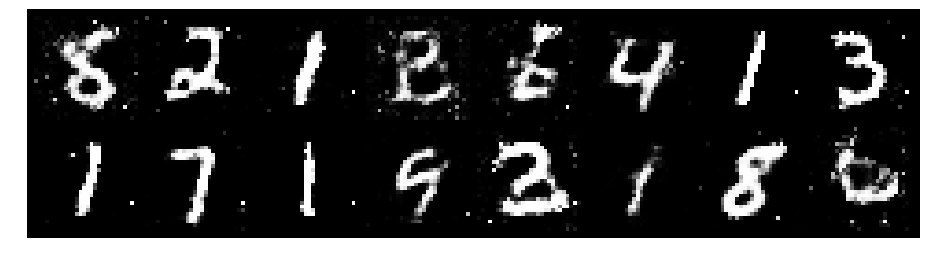

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.2291, Generator Loss: 0.8628
D(x): 0.6425, D(G(z)): 0.4887


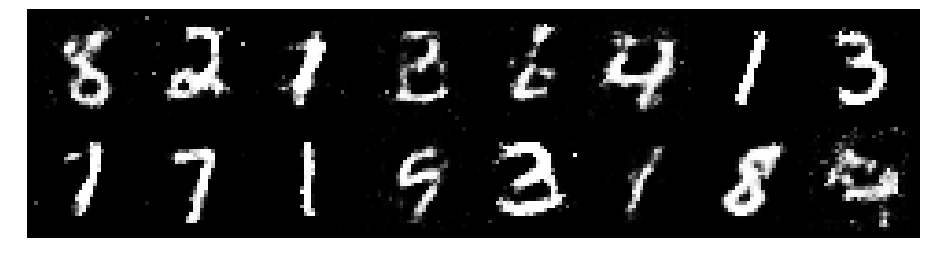

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.3257, Generator Loss: 0.9041
D(x): 0.5449, D(G(z)): 0.4315


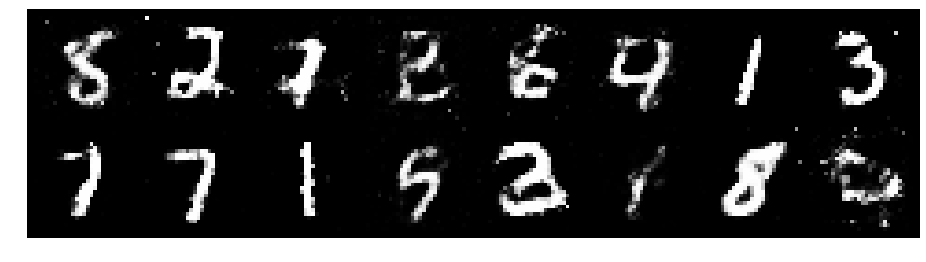

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1862, Generator Loss: 0.9696
D(x): 0.5710, D(G(z)): 0.4109


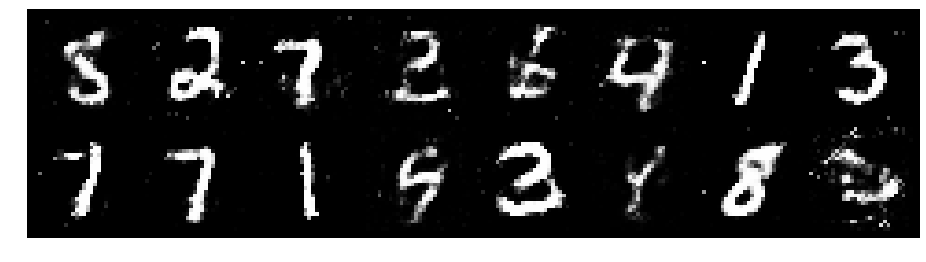

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1531, Generator Loss: 1.1776
D(x): 0.5863, D(G(z)): 0.3818


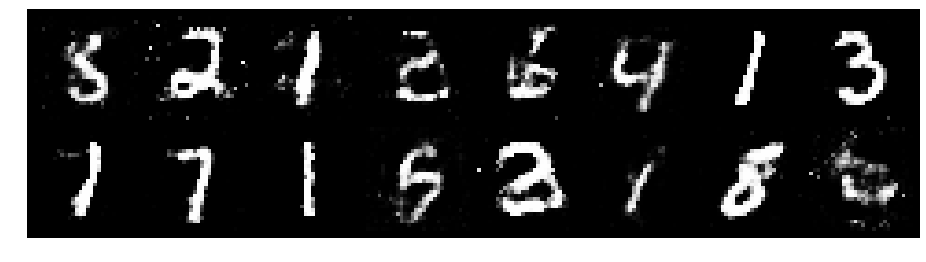

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.3529, Generator Loss: 0.9118
D(x): 0.6009, D(G(z)): 0.4903


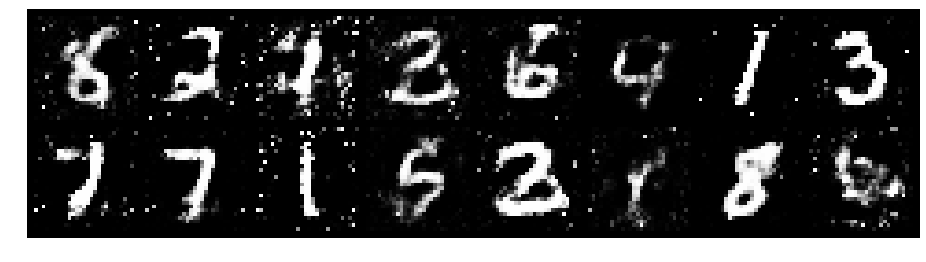

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2425, Generator Loss: 1.0243
D(x): 0.5342, D(G(z)): 0.3926


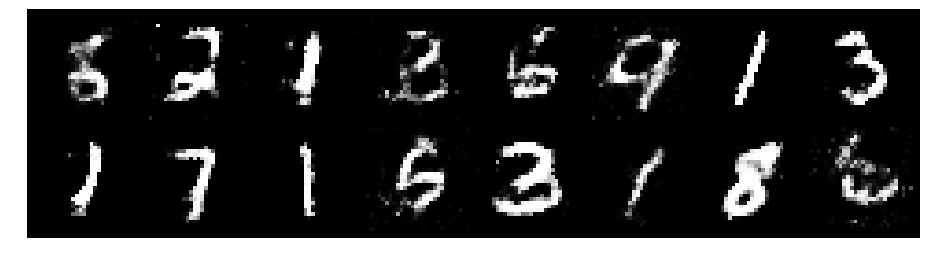

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.1186, Generator Loss: 1.1277
D(x): 0.5991, D(G(z)): 0.3628


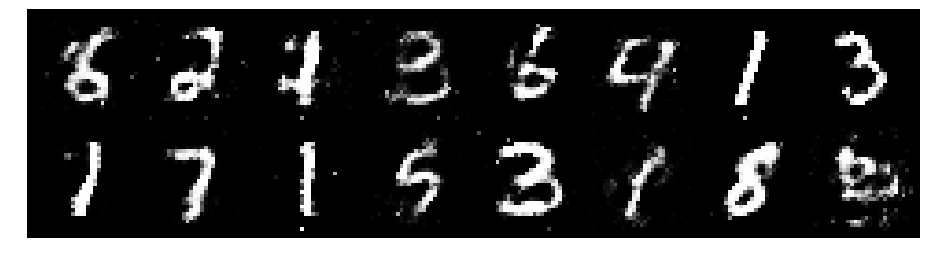

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1880, Generator Loss: 1.1699
D(x): 0.5669, D(G(z)): 0.3978


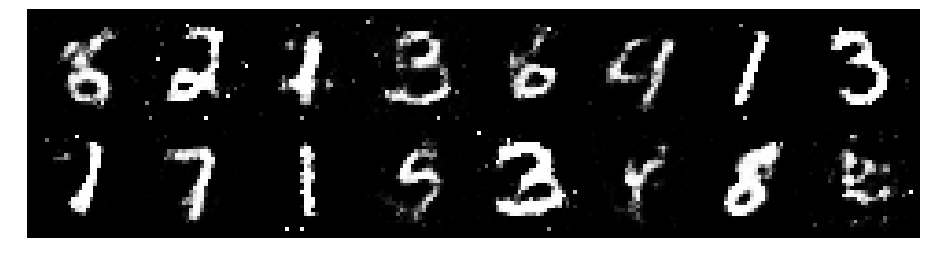

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2683, Generator Loss: 1.0287
D(x): 0.5453, D(G(z)): 0.3986


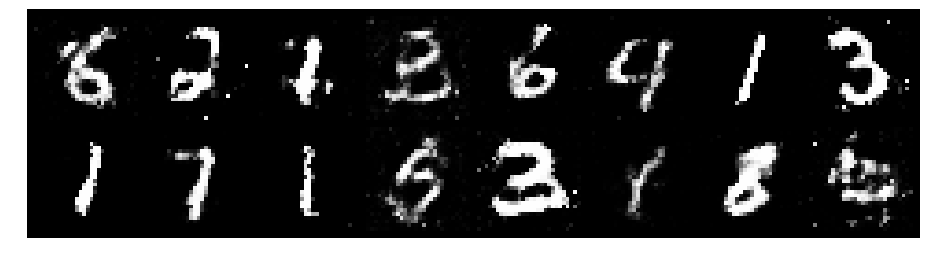

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2589, Generator Loss: 0.9909
D(x): 0.5002, D(G(z)): 0.3666


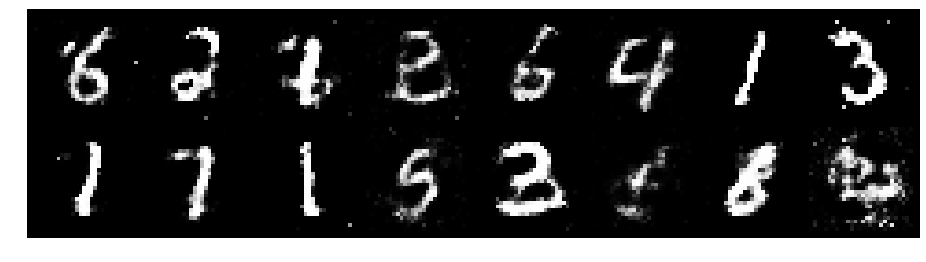

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3648, Generator Loss: 0.8458
D(x): 0.5422, D(G(z)): 0.4817


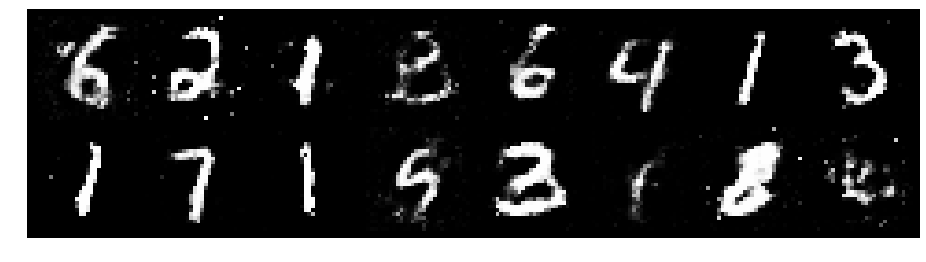

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.3357, Generator Loss: 0.9611
D(x): 0.5771, D(G(z)): 0.4372


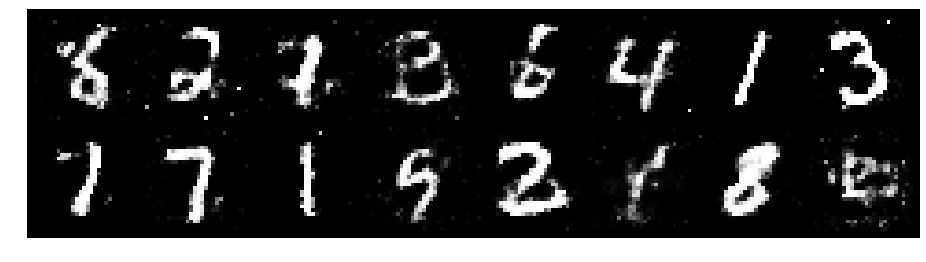

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.3069, Generator Loss: 1.0378
D(x): 0.5779, D(G(z)): 0.4409


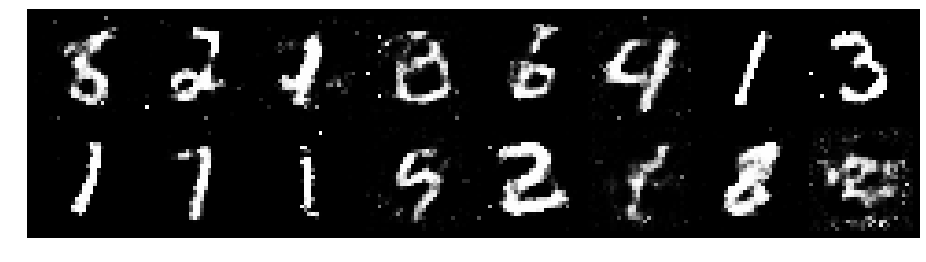

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1669, Generator Loss: 1.0147
D(x): 0.5674, D(G(z)): 0.3873


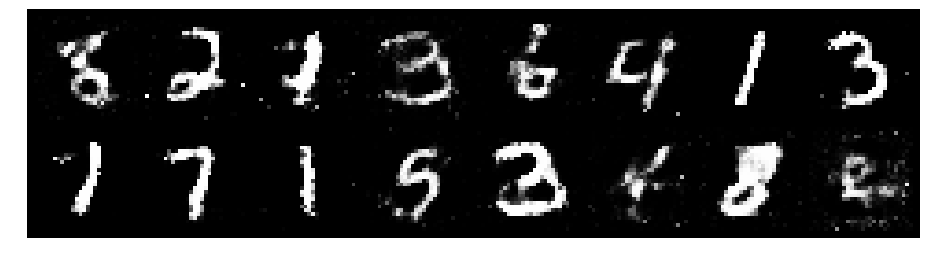

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1612, Generator Loss: 0.9535
D(x): 0.6182, D(G(z)): 0.4324


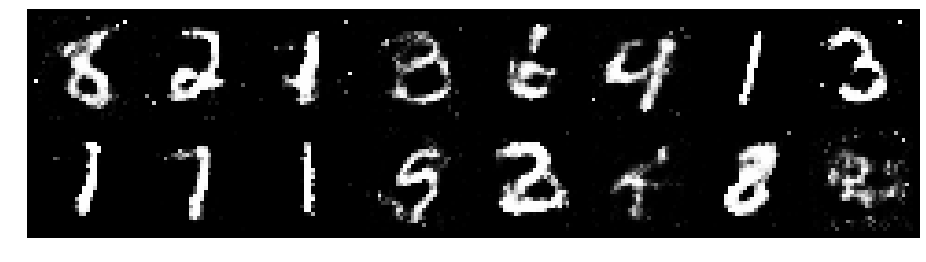

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1942, Generator Loss: 0.9930
D(x): 0.6128, D(G(z)): 0.4259


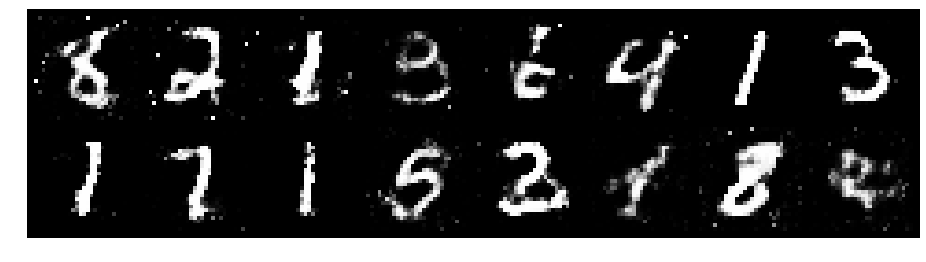

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1576, Generator Loss: 0.9213
D(x): 0.5805, D(G(z)): 0.4074


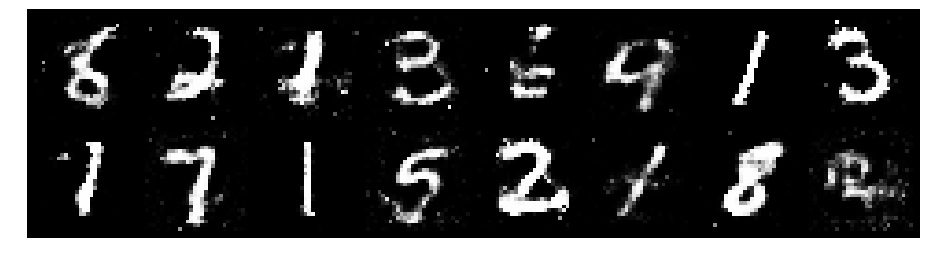

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2976, Generator Loss: 0.9633
D(x): 0.5397, D(G(z)): 0.4274


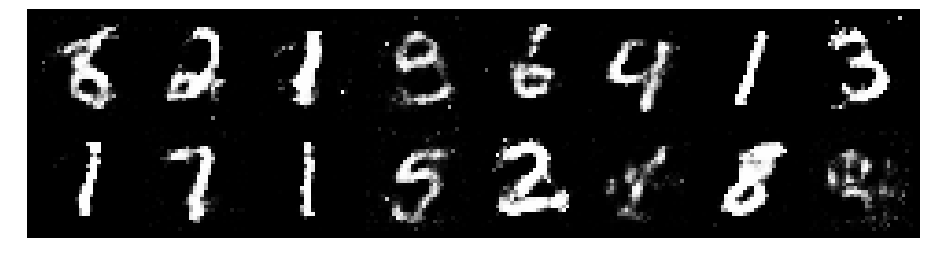

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1694, Generator Loss: 0.8386
D(x): 0.6533, D(G(z)): 0.4825


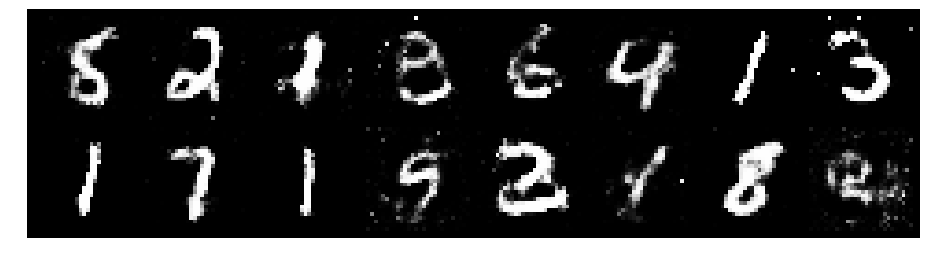

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2330, Generator Loss: 0.9115
D(x): 0.5939, D(G(z)): 0.4390


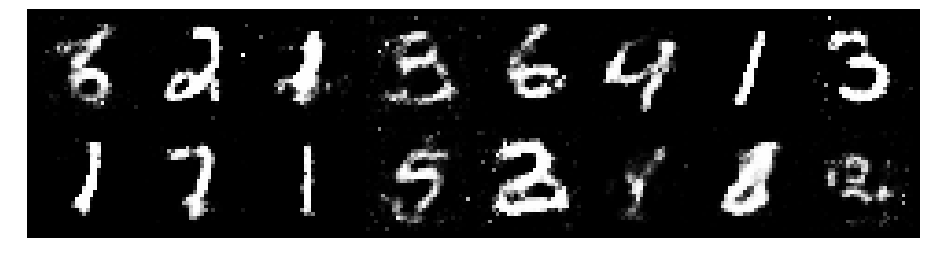

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2798, Generator Loss: 0.8547
D(x): 0.5393, D(G(z)): 0.4409


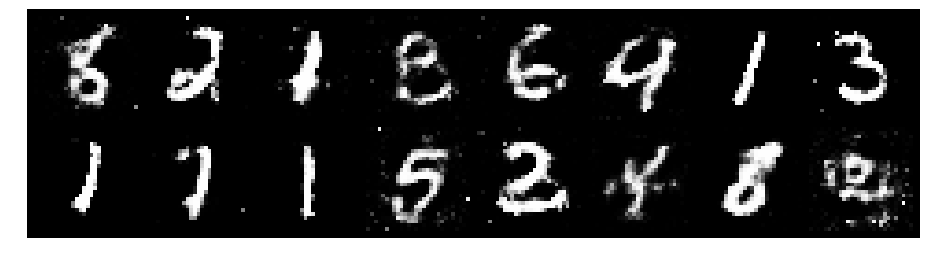

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.3070, Generator Loss: 0.8416
D(x): 0.5669, D(G(z)): 0.4658


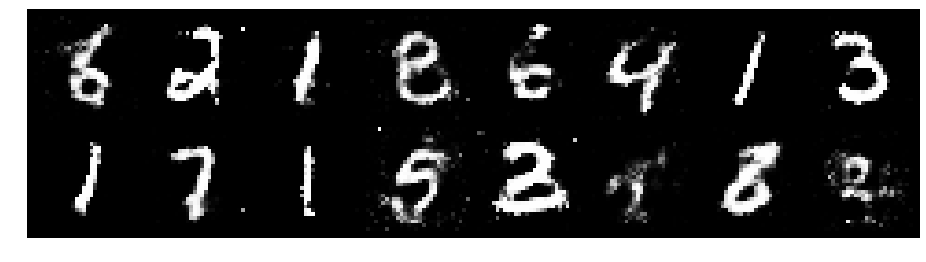

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2878, Generator Loss: 0.8943
D(x): 0.5934, D(G(z)): 0.4763


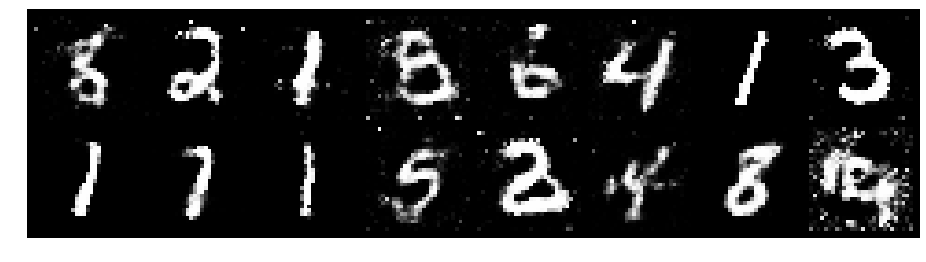

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2300, Generator Loss: 0.9111
D(x): 0.5767, D(G(z)): 0.4319


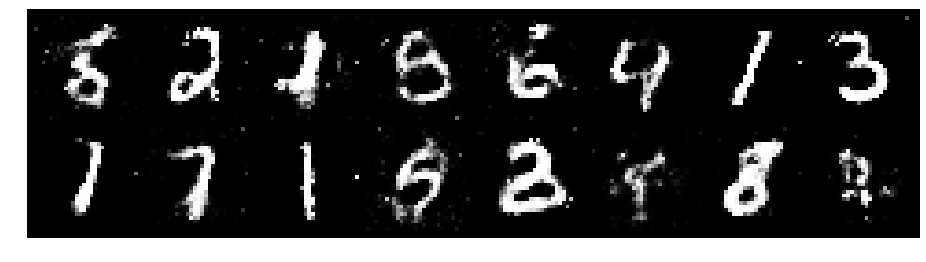

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2477, Generator Loss: 0.9975
D(x): 0.5496, D(G(z)): 0.4016


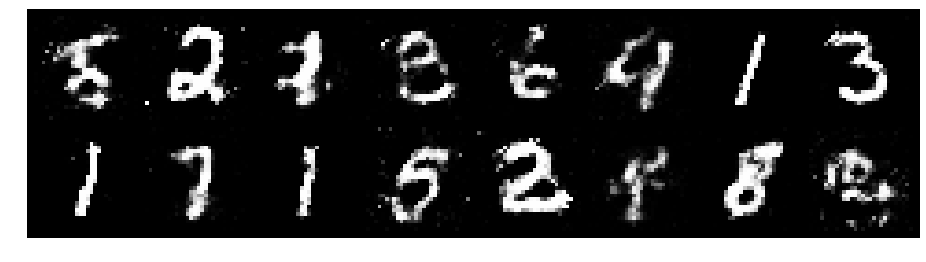

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1959, Generator Loss: 0.9546
D(x): 0.5585, D(G(z)): 0.3706


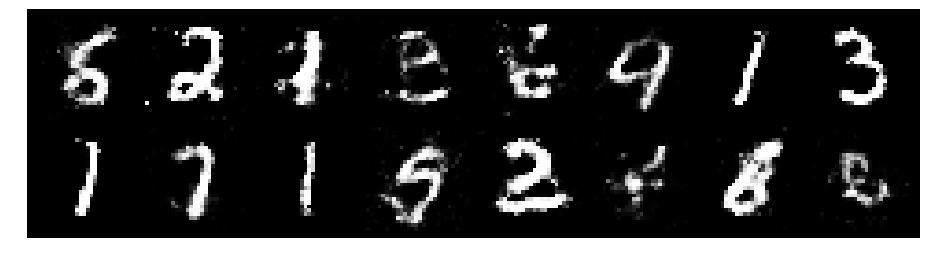

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1705, Generator Loss: 0.9944
D(x): 0.5890, D(G(z)): 0.4252


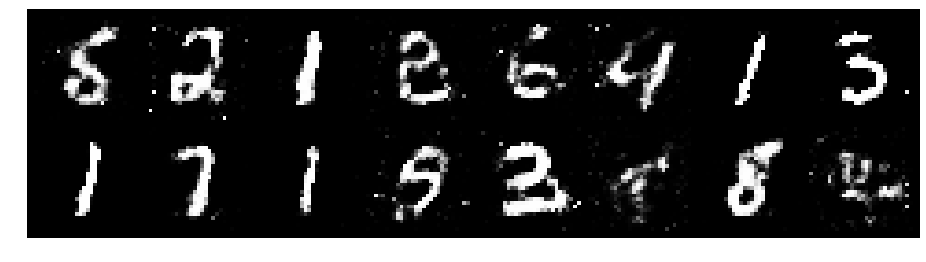

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2658, Generator Loss: 1.0076
D(x): 0.5613, D(G(z)): 0.4566


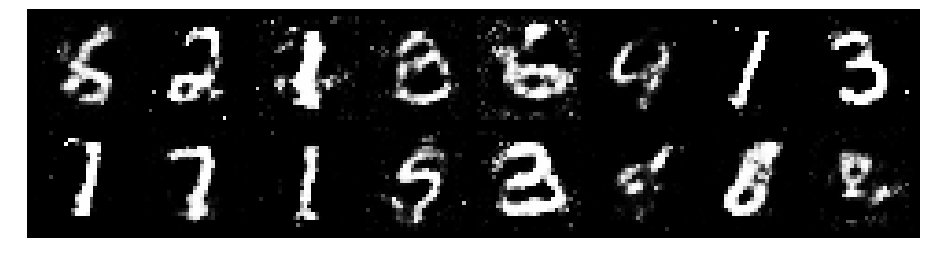

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1020, Generator Loss: 1.1148
D(x): 0.5983, D(G(z)): 0.3956


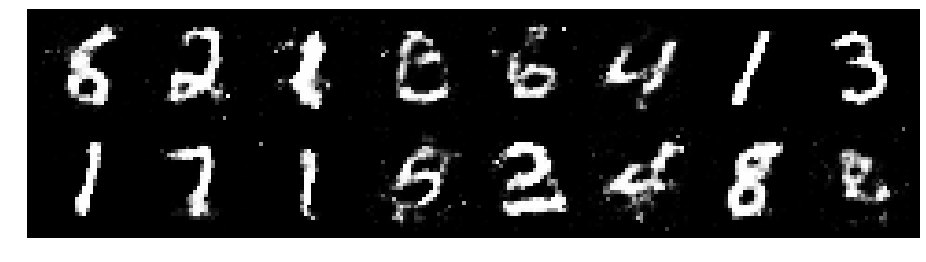

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1296, Generator Loss: 1.3358
D(x): 0.5949, D(G(z)): 0.3254


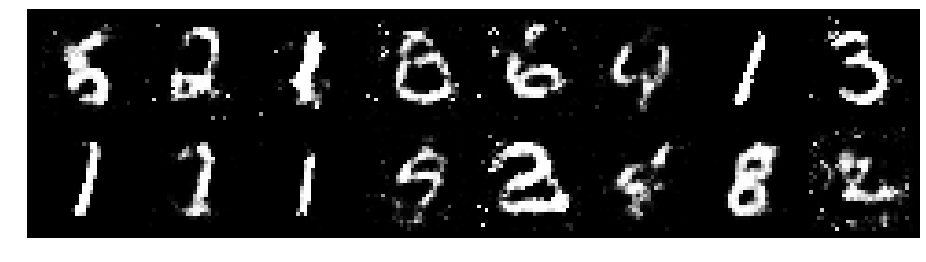

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1707, Generator Loss: 1.0683
D(x): 0.5487, D(G(z)): 0.3678


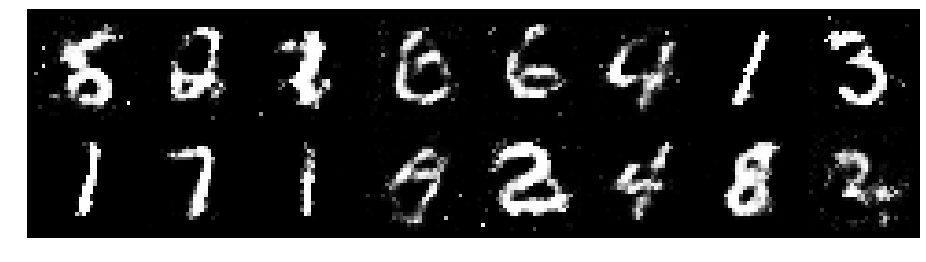

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.1827, Generator Loss: 1.0625
D(x): 0.5772, D(G(z)): 0.4078


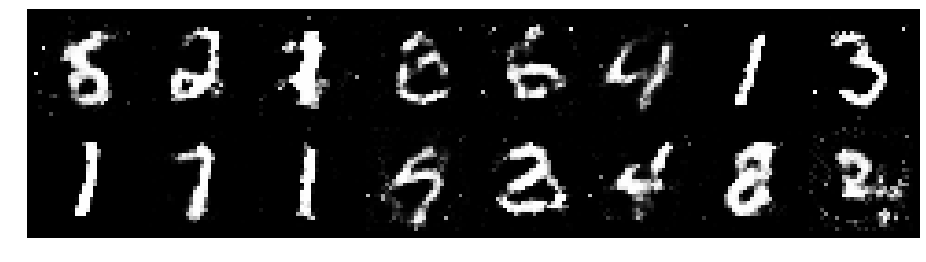

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.0123, Generator Loss: 1.1321
D(x): 0.6513, D(G(z)): 0.3736


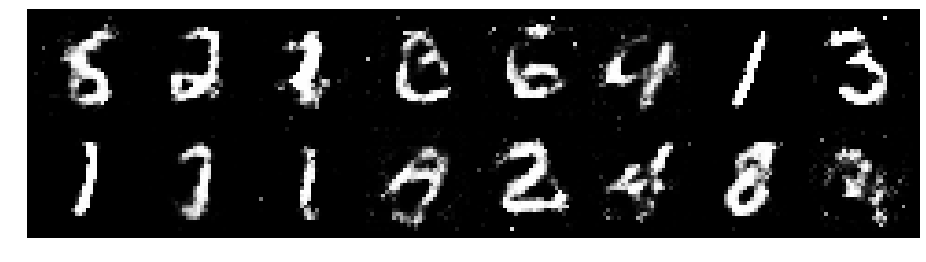

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9562
D(x): 0.5607, D(G(z)): 0.4037


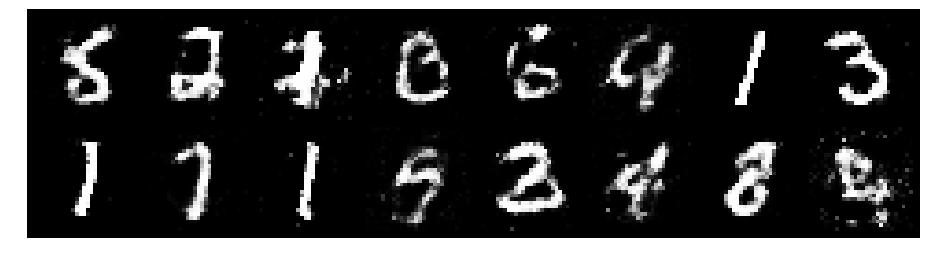

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1184, Generator Loss: 1.0352
D(x): 0.6585, D(G(z)): 0.4461


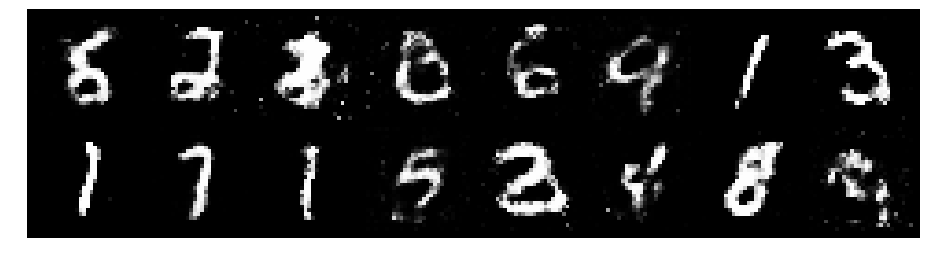

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.1466, Generator Loss: 1.0057
D(x): 0.6424, D(G(z)): 0.4439


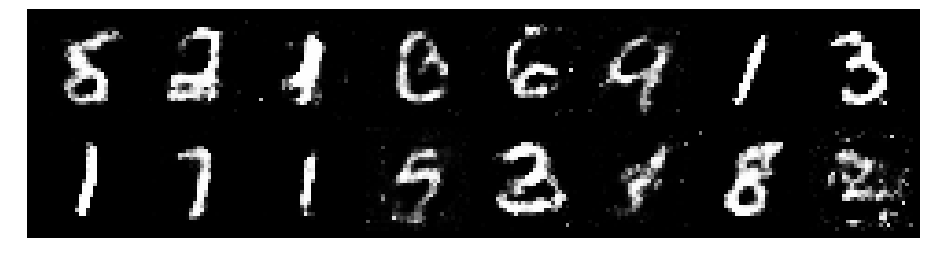

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2854, Generator Loss: 0.7990
D(x): 0.5336, D(G(z)): 0.4282


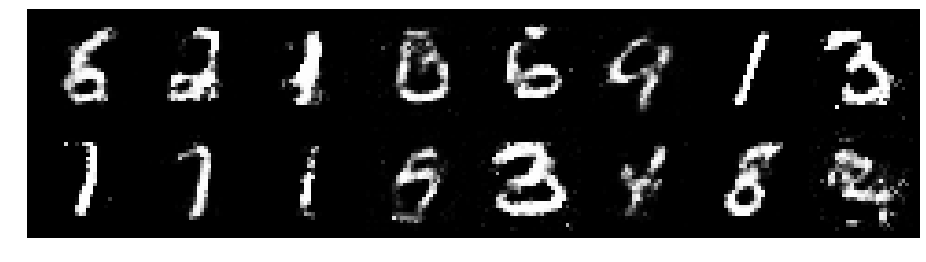

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2765, Generator Loss: 1.0497
D(x): 0.5751, D(G(z)): 0.4368


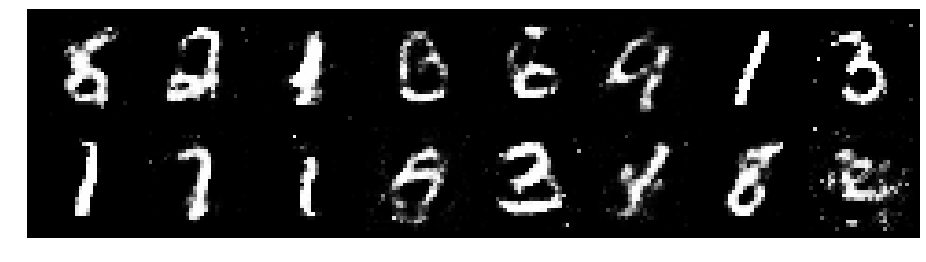

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8584
D(x): 0.6548, D(G(z)): 0.4938


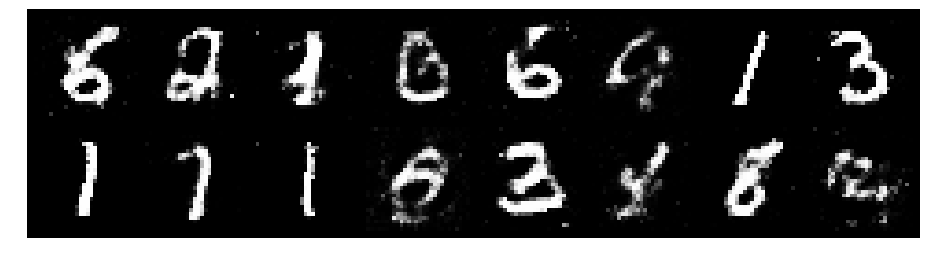

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.0993, Generator Loss: 1.0719
D(x): 0.5529, D(G(z)): 0.3360


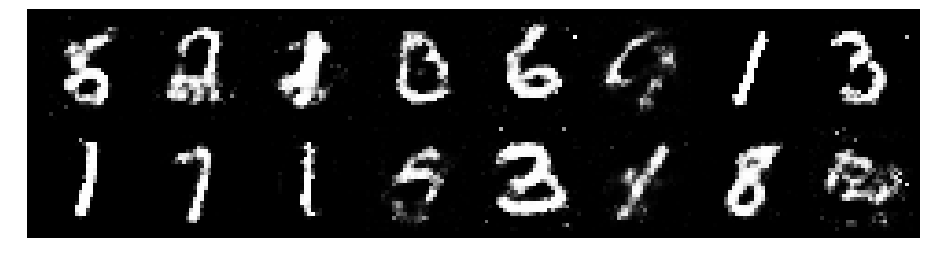

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2852, Generator Loss: 1.0428
D(x): 0.5600, D(G(z)): 0.4333


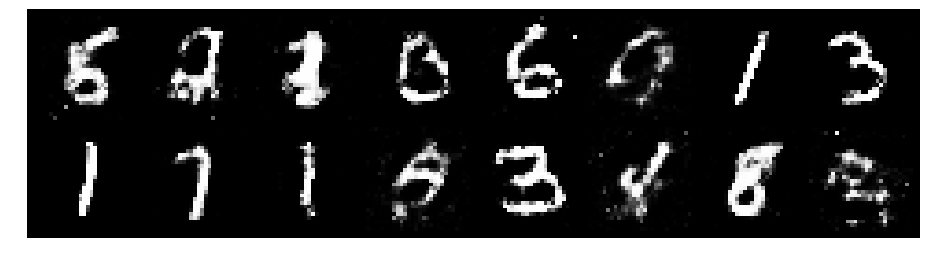

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9189
D(x): 0.5790, D(G(z)): 0.4347


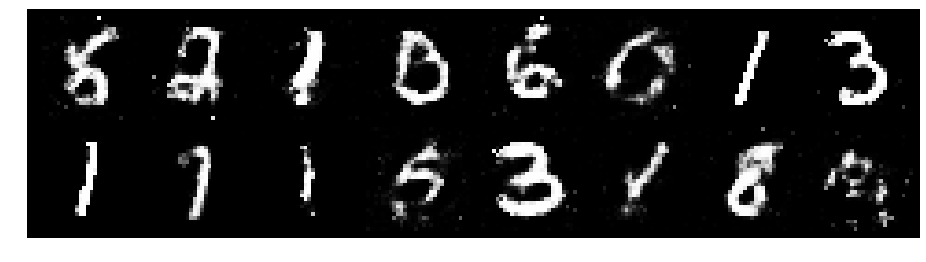

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.1705, Generator Loss: 1.0055
D(x): 0.5896, D(G(z)): 0.4128


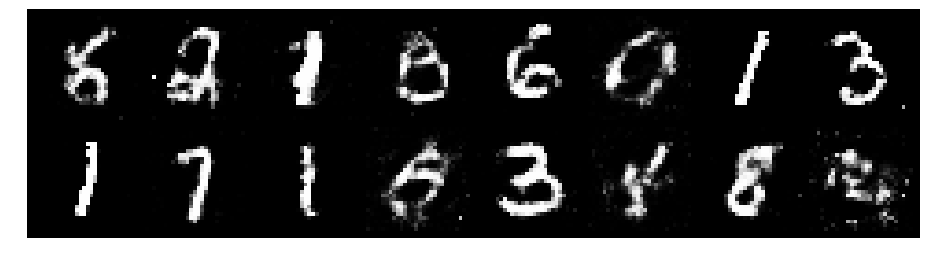

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1070, Generator Loss: 1.2071
D(x): 0.5749, D(G(z)): 0.3502


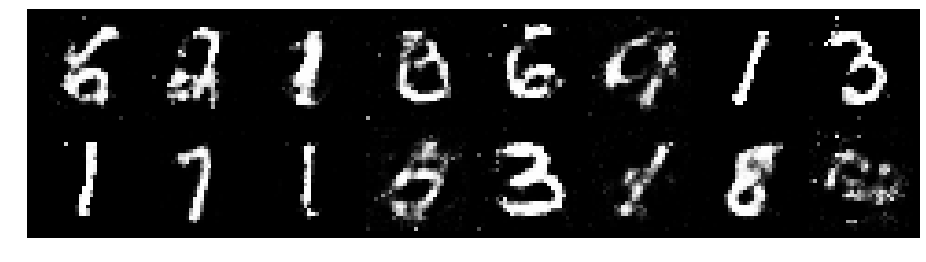

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1210, Generator Loss: 1.0788
D(x): 0.6042, D(G(z)): 0.4106


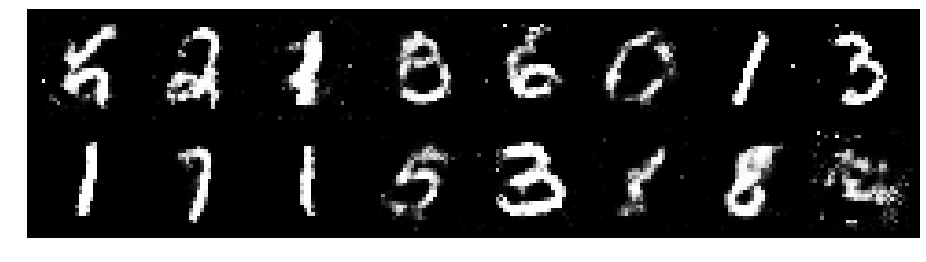

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2655, Generator Loss: 0.9652
D(x): 0.5312, D(G(z)): 0.4111


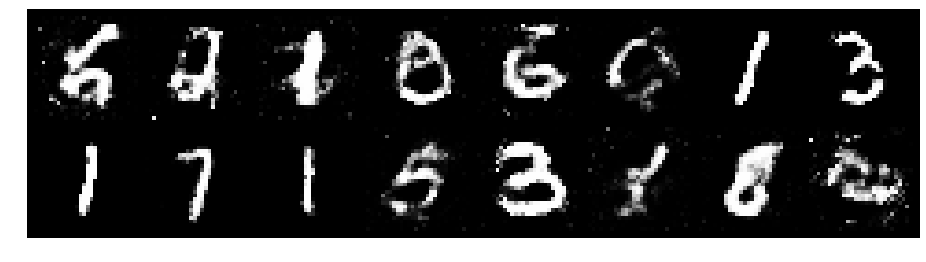

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2876, Generator Loss: 0.8609
D(x): 0.5598, D(G(z)): 0.4502


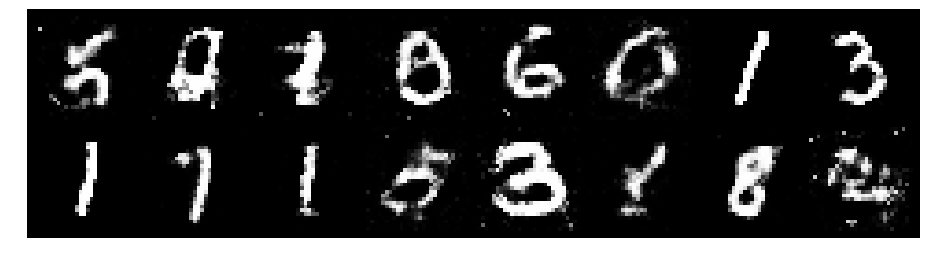

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1928, Generator Loss: 0.8992
D(x): 0.6456, D(G(z)): 0.4470


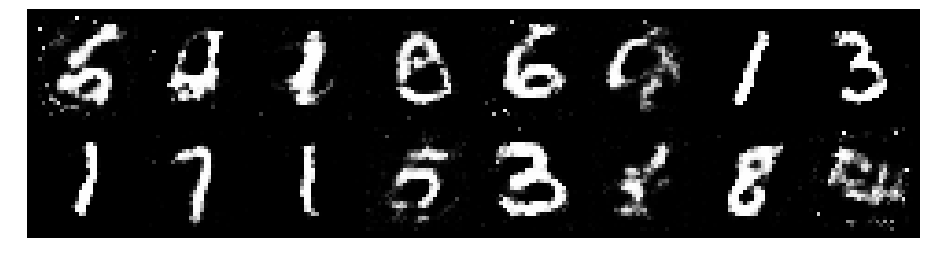

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2899, Generator Loss: 1.0804
D(x): 0.6058, D(G(z)): 0.4646


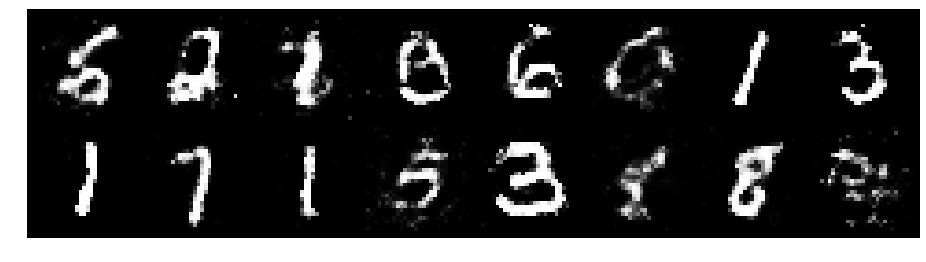

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.3034, Generator Loss: 0.9539
D(x): 0.5799, D(G(z)): 0.4682


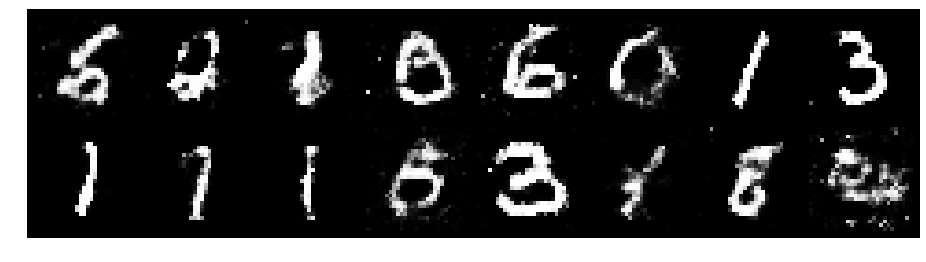

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2903, Generator Loss: 0.8807
D(x): 0.5665, D(G(z)): 0.4640


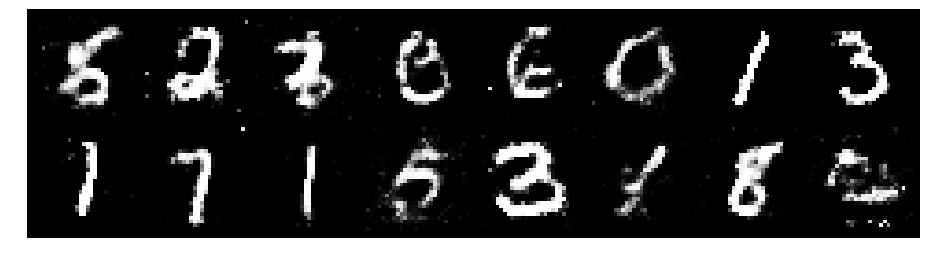

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.3320, Generator Loss: 0.7946
D(x): 0.5870, D(G(z)): 0.5081


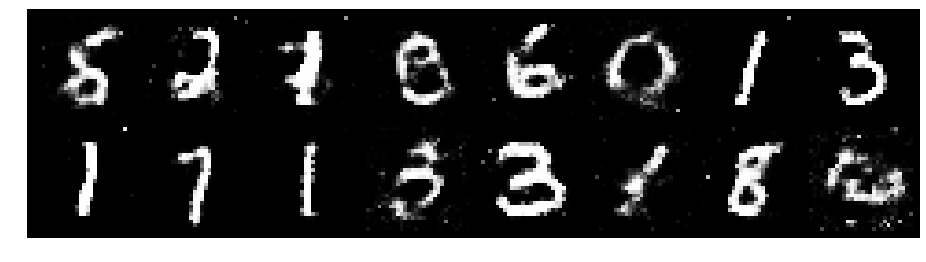

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.3474, Generator Loss: 0.9445
D(x): 0.5710, D(G(z)): 0.4657


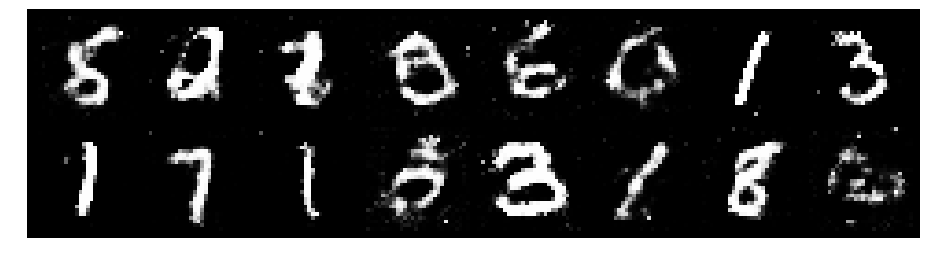

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2358, Generator Loss: 0.8206
D(x): 0.6033, D(G(z)): 0.4584


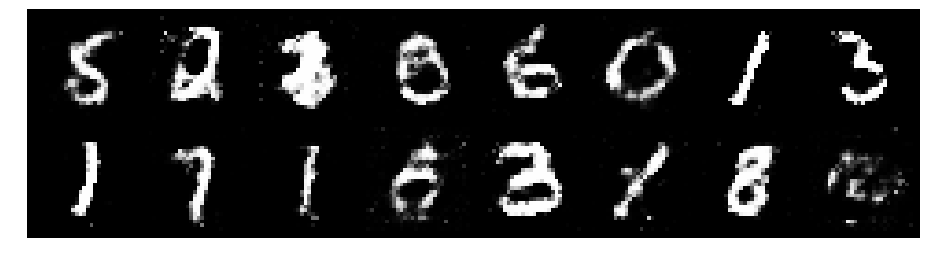

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2589, Generator Loss: 0.9077
D(x): 0.5617, D(G(z)): 0.4588


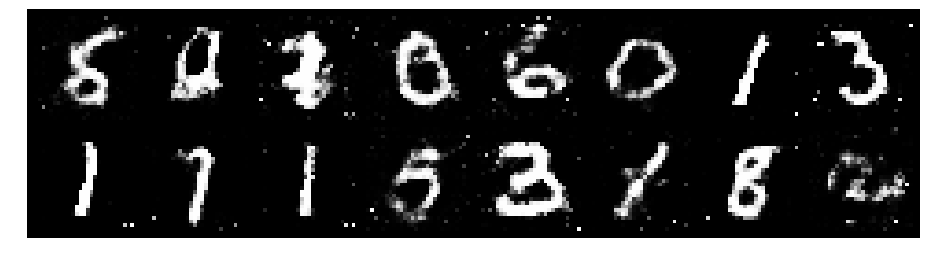

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3037, Generator Loss: 0.9554
D(x): 0.5220, D(G(z)): 0.4146


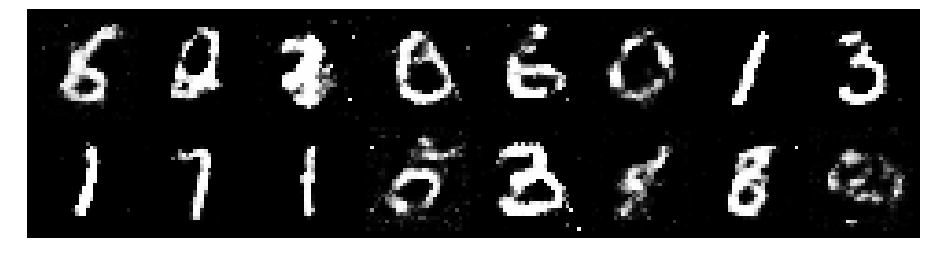

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9397
D(x): 0.5338, D(G(z)): 0.3749


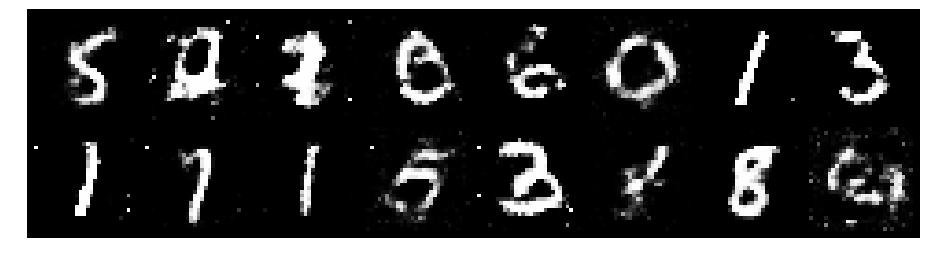

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2655, Generator Loss: 0.9756
D(x): 0.5480, D(G(z)): 0.4240


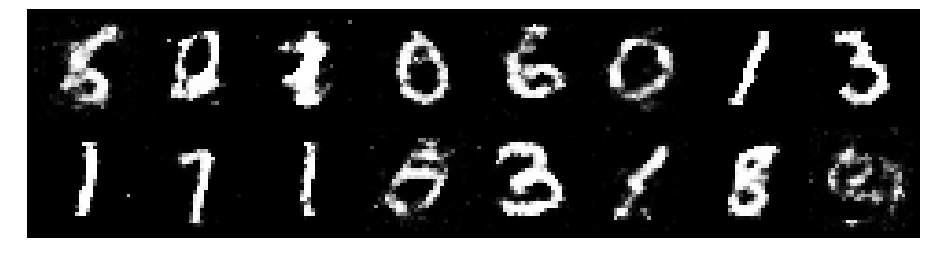

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1528, Generator Loss: 0.8827
D(x): 0.6066, D(G(z)): 0.4336


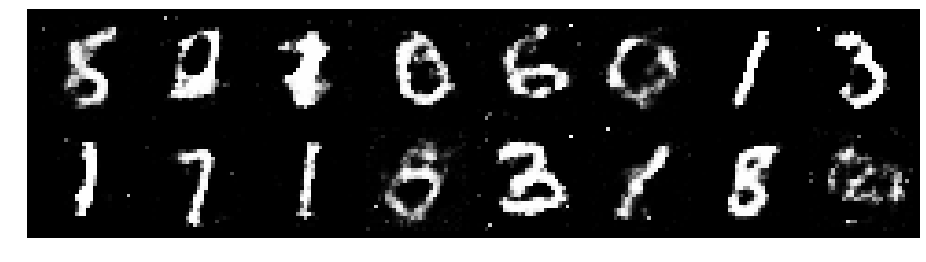

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.3946, Generator Loss: 0.7545
D(x): 0.5752, D(G(z)): 0.4928


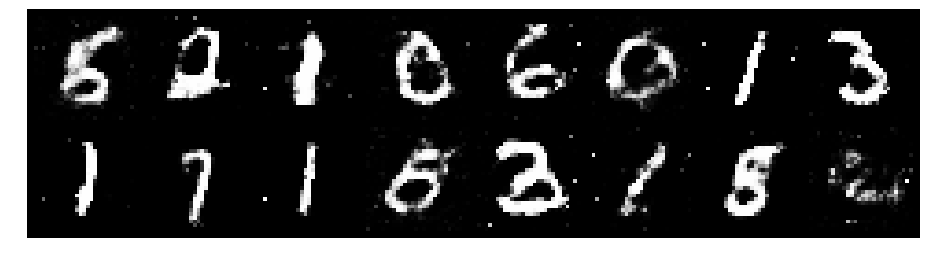

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.0407, Generator Loss: 1.2615
D(x): 0.6034, D(G(z)): 0.3216


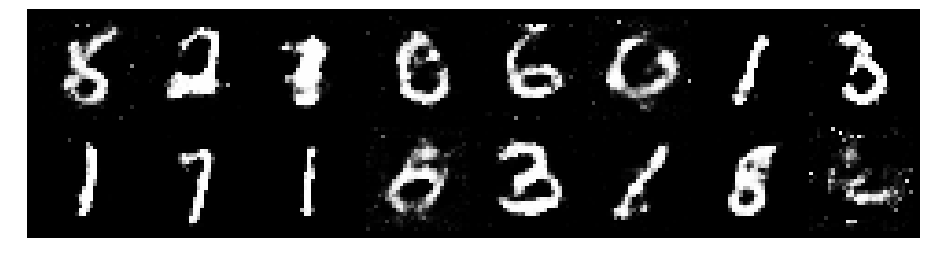

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.1197, Generator Loss: 0.9222
D(x): 0.6535, D(G(z)): 0.4526


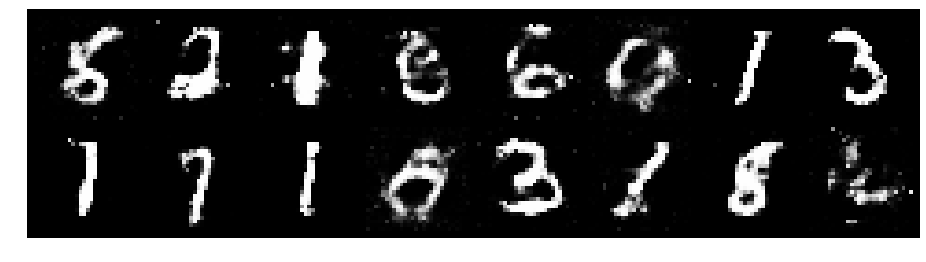

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2178, Generator Loss: 0.8977
D(x): 0.5701, D(G(z)): 0.4033


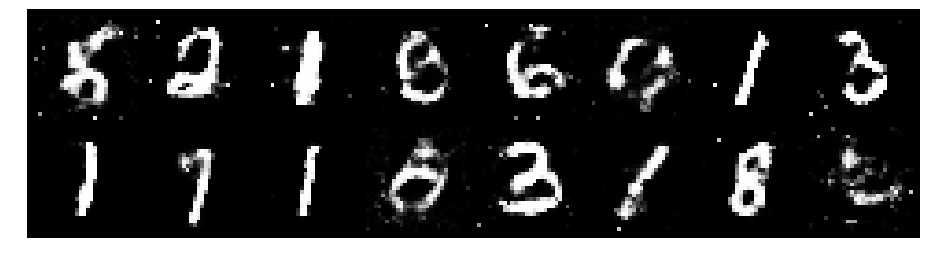

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.3112, Generator Loss: 1.0273
D(x): 0.5568, D(G(z)): 0.4457


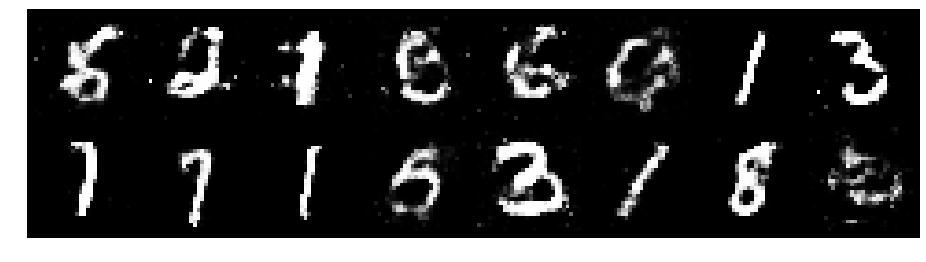

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8594
D(x): 0.5531, D(G(z)): 0.4499


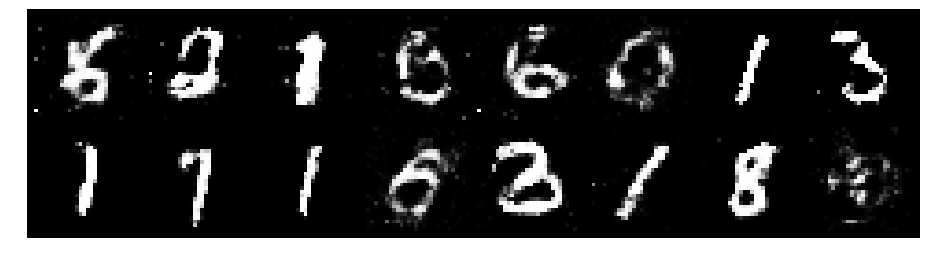

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2867, Generator Loss: 0.9643
D(x): 0.5436, D(G(z)): 0.4327


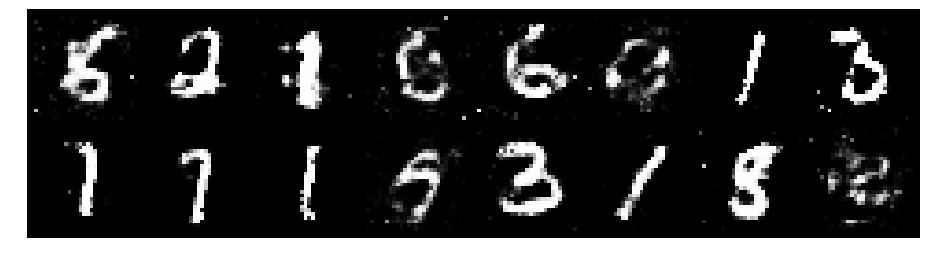

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2600, Generator Loss: 0.8627
D(x): 0.5713, D(G(z)): 0.4237


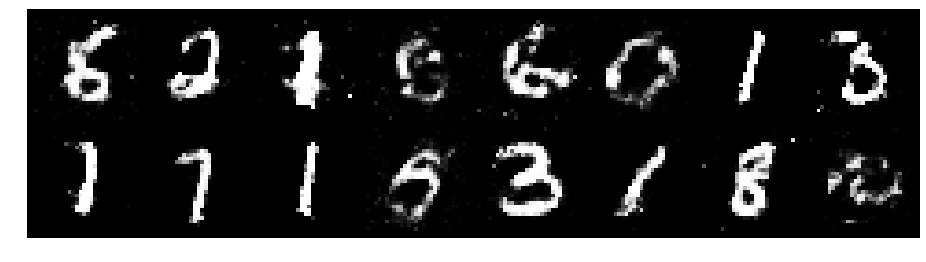

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2492, Generator Loss: 0.8625
D(x): 0.5502, D(G(z)): 0.4453


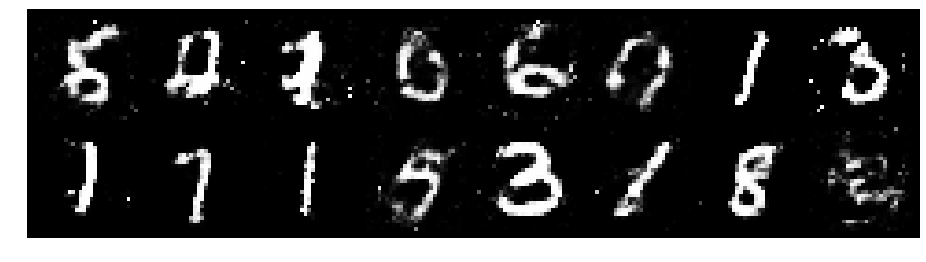

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.2563, Generator Loss: 1.0077
D(x): 0.5260, D(G(z)): 0.3930


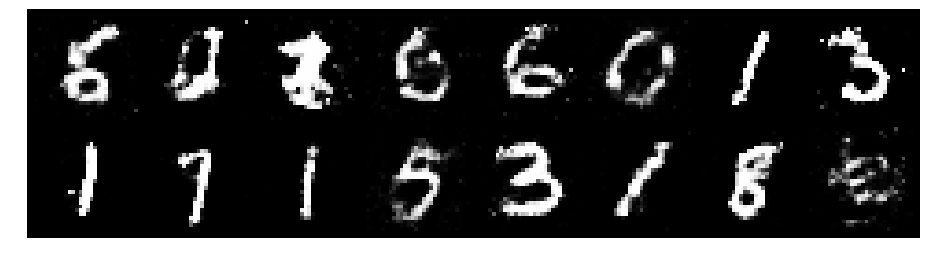

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.3979, Generator Loss: 0.8631
D(x): 0.5896, D(G(z)): 0.5024


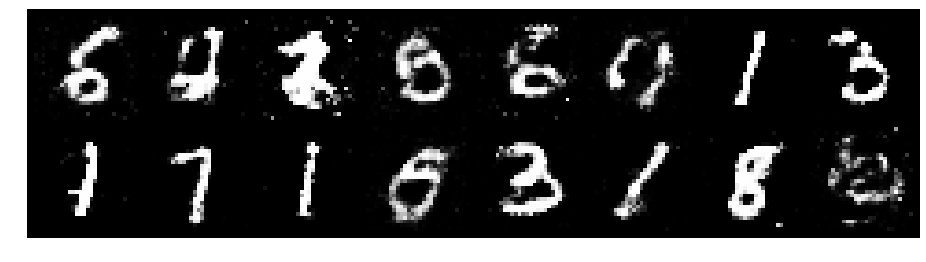

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.3803, Generator Loss: 1.0506
D(x): 0.5371, D(G(z)): 0.4555


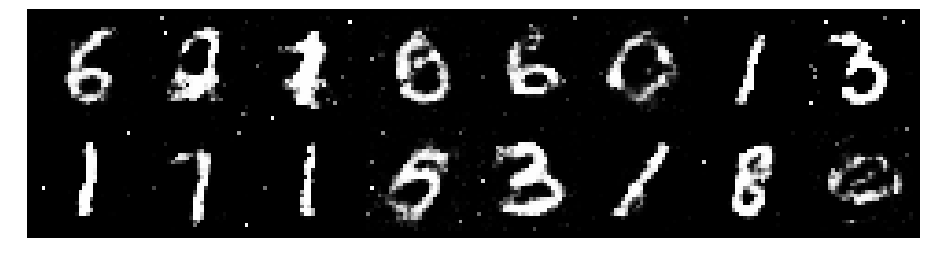

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3457, Generator Loss: 1.0439
D(x): 0.5422, D(G(z)): 0.4542


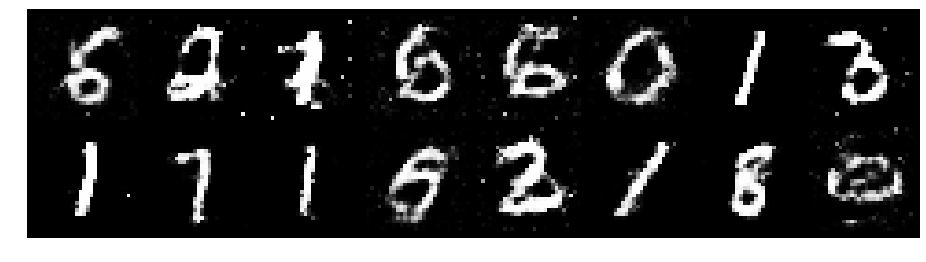

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8370
D(x): 0.6031, D(G(z)): 0.4624


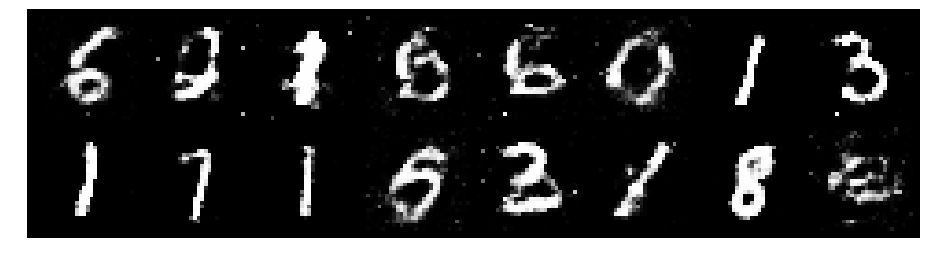

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.1970, Generator Loss: 0.9383
D(x): 0.5751, D(G(z)): 0.4007


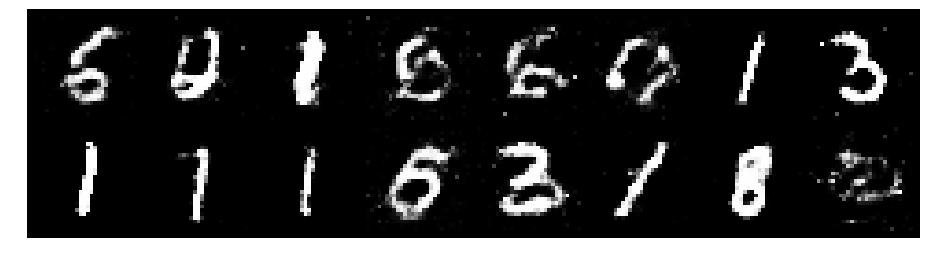

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1445, Generator Loss: 0.9179
D(x): 0.5998, D(G(z)): 0.4037


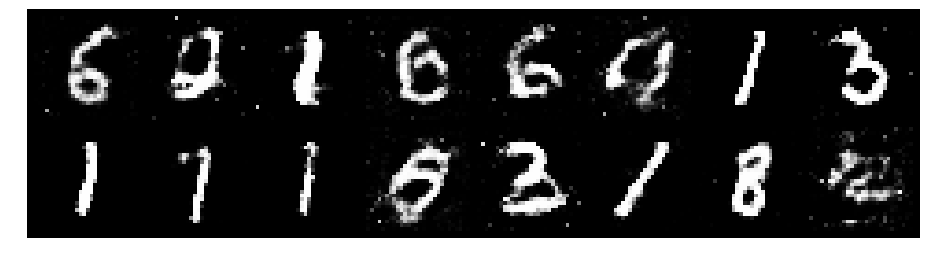

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1904, Generator Loss: 1.1305
D(x): 0.5817, D(G(z)): 0.3961


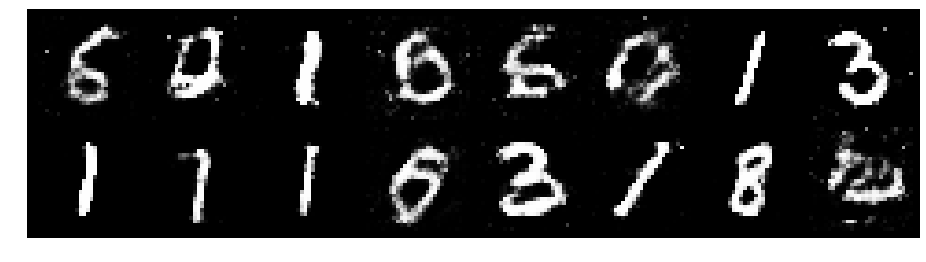

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2691, Generator Loss: 0.9990
D(x): 0.5968, D(G(z)): 0.4462


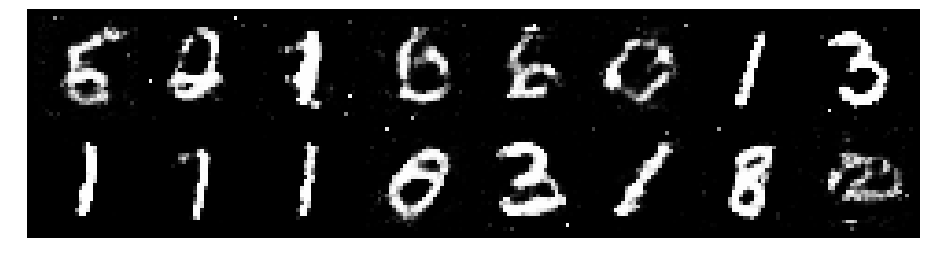

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.1267, Generator Loss: 1.0982
D(x): 0.5968, D(G(z)): 0.3947


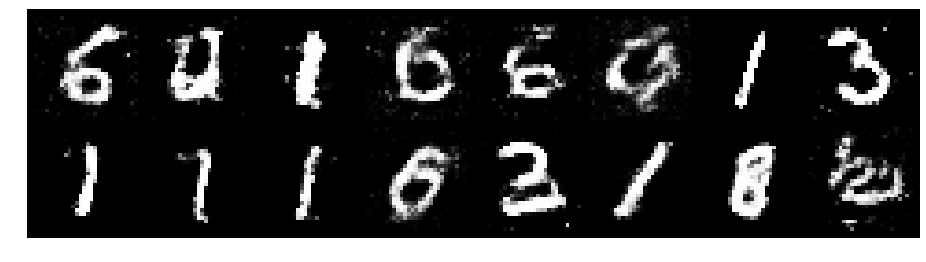

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2256, Generator Loss: 0.8803
D(x): 0.6091, D(G(z)): 0.4666


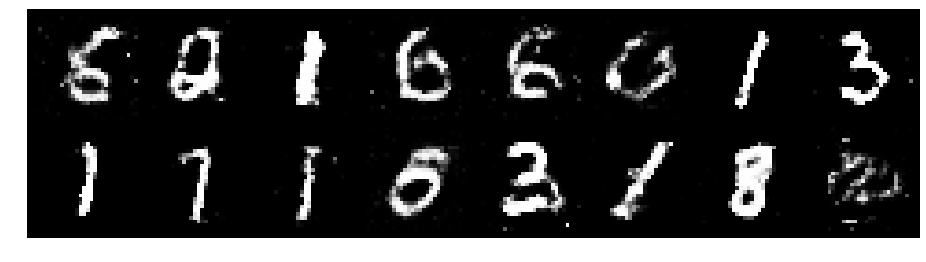

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2729, Generator Loss: 1.1039
D(x): 0.5454, D(G(z)): 0.3786


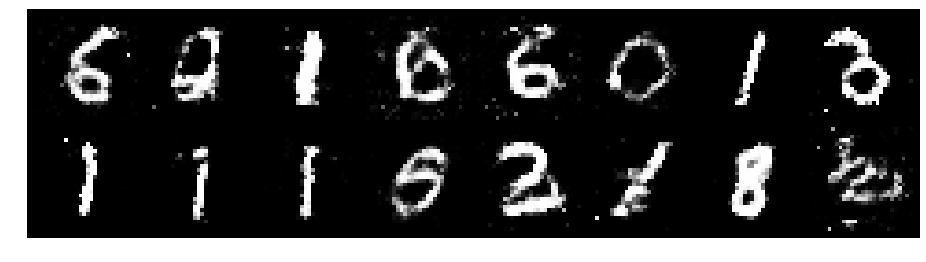

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.0787, Generator Loss: 1.0597
D(x): 0.6135, D(G(z)): 0.3640


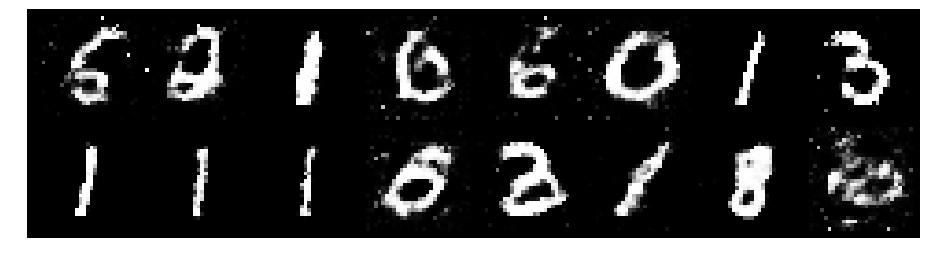

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.0784, Generator Loss: 1.1217
D(x): 0.5803, D(G(z)): 0.3755


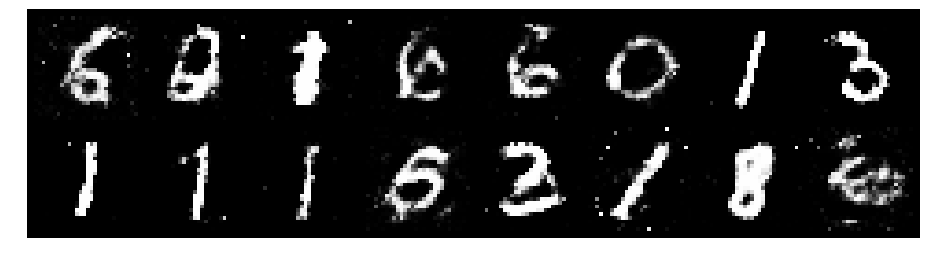

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2804, Generator Loss: 1.0021
D(x): 0.5467, D(G(z)): 0.4391


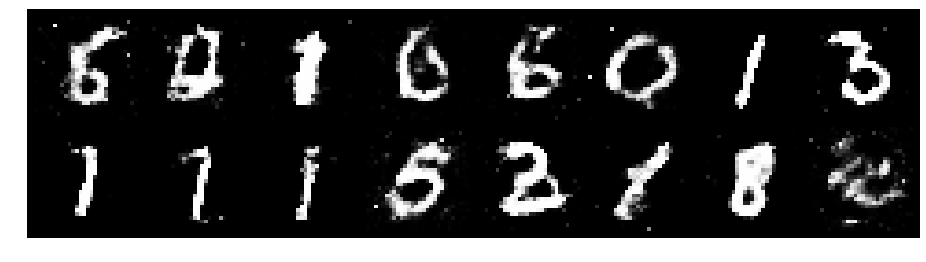

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1454, Generator Loss: 0.9614
D(x): 0.6182, D(G(z)): 0.4372


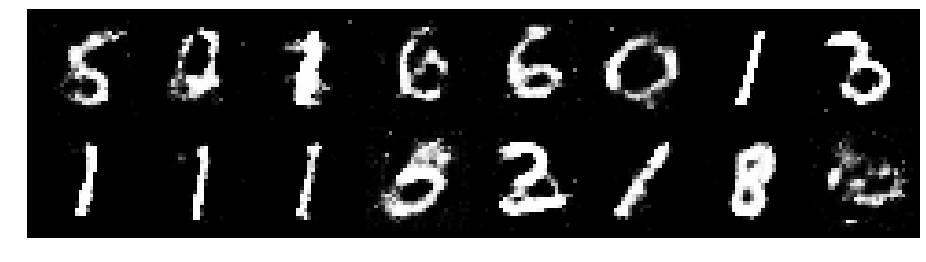

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.3288, Generator Loss: 0.9252
D(x): 0.5500, D(G(z)): 0.4364


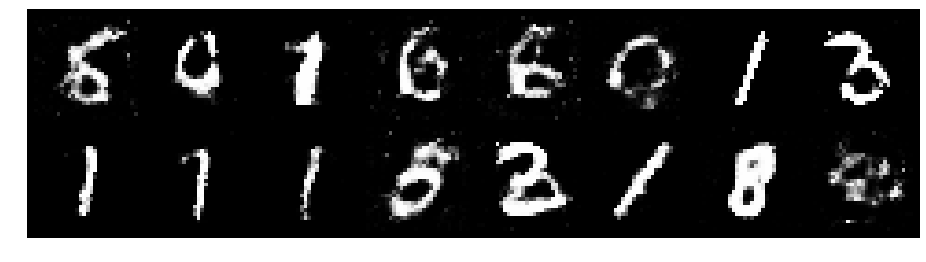

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.3735, Generator Loss: 1.0116
D(x): 0.5160, D(G(z)): 0.4364


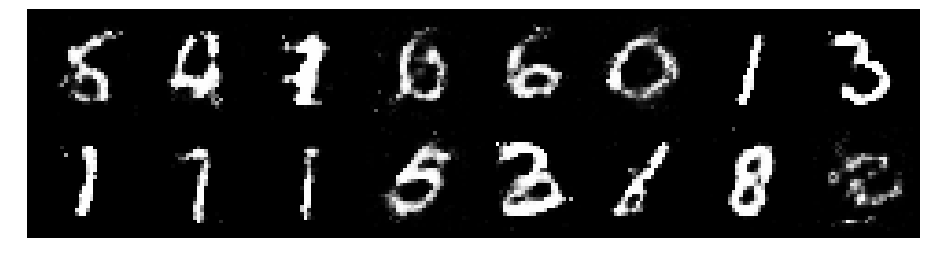

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2537, Generator Loss: 0.7828
D(x): 0.6393, D(G(z)): 0.5014


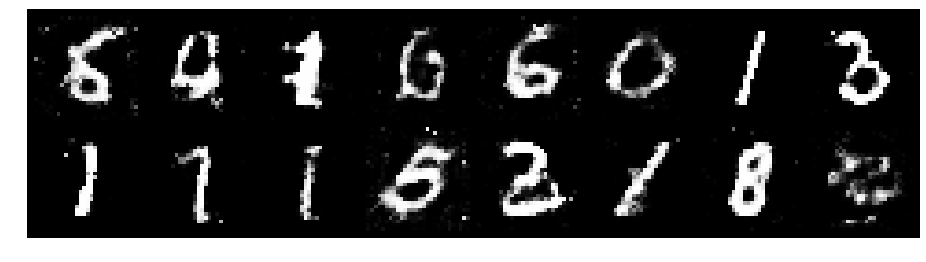

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2340, Generator Loss: 0.8320
D(x): 0.5834, D(G(z)): 0.4445


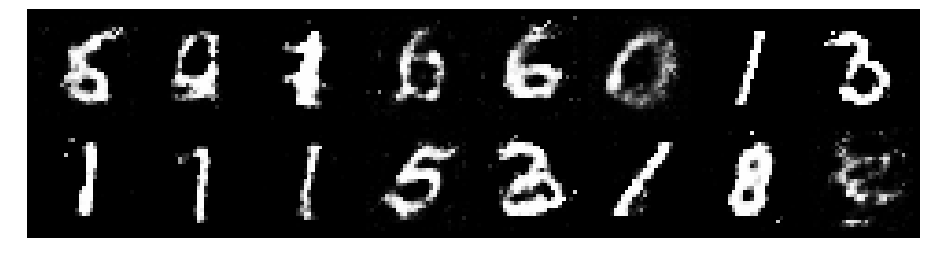

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.3497, Generator Loss: 0.9101
D(x): 0.5137, D(G(z)): 0.4303


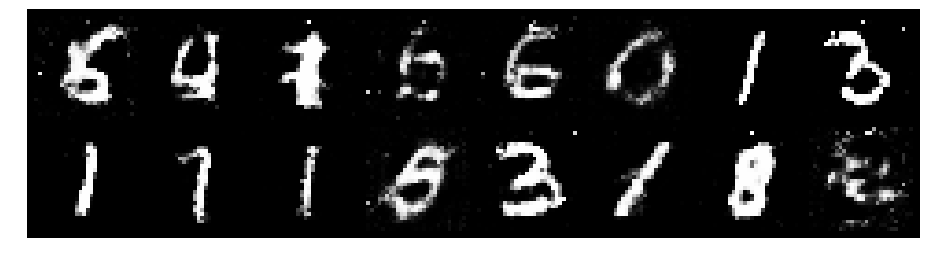

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2696, Generator Loss: 0.9175
D(x): 0.5760, D(G(z)): 0.4445


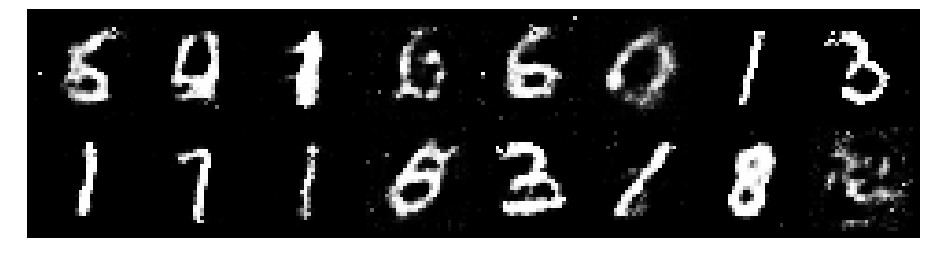

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2769, Generator Loss: 1.0383
D(x): 0.5732, D(G(z)): 0.4333


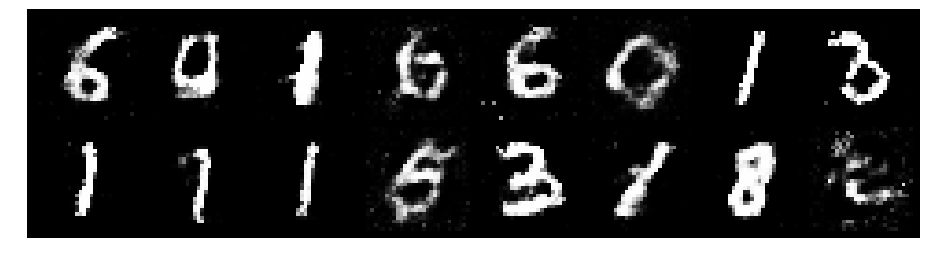

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2305, Generator Loss: 0.9581
D(x): 0.5491, D(G(z)): 0.3947


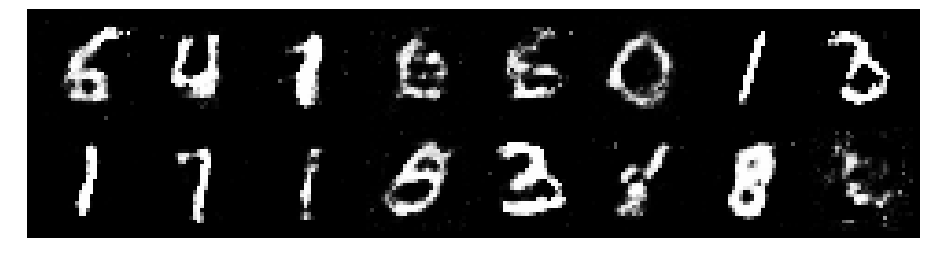

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2084, Generator Loss: 0.8148
D(x): 0.5372, D(G(z)): 0.3970


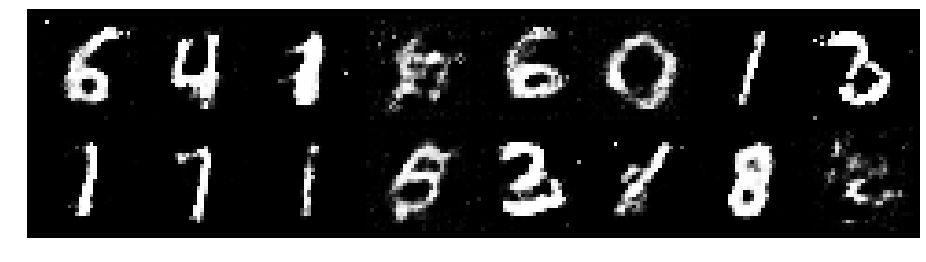

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3834, Generator Loss: 0.8268
D(x): 0.5775, D(G(z)): 0.4985


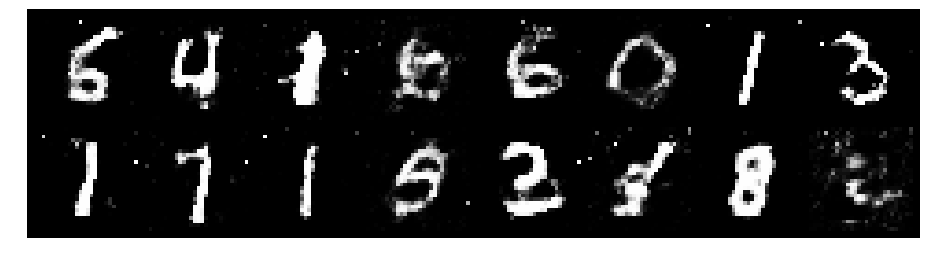

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2717, Generator Loss: 0.9086
D(x): 0.5372, D(G(z)): 0.4223


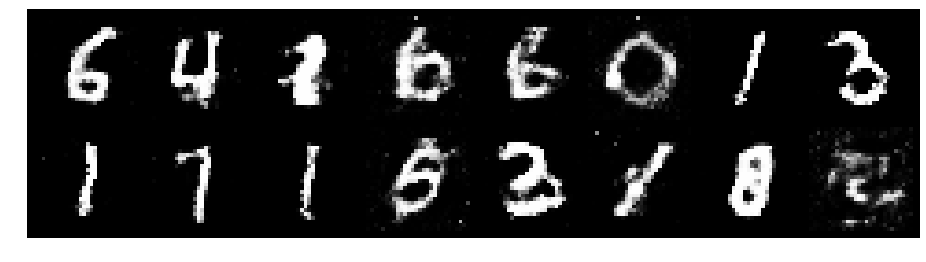

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2363, Generator Loss: 1.0917
D(x): 0.5616, D(G(z)): 0.4067


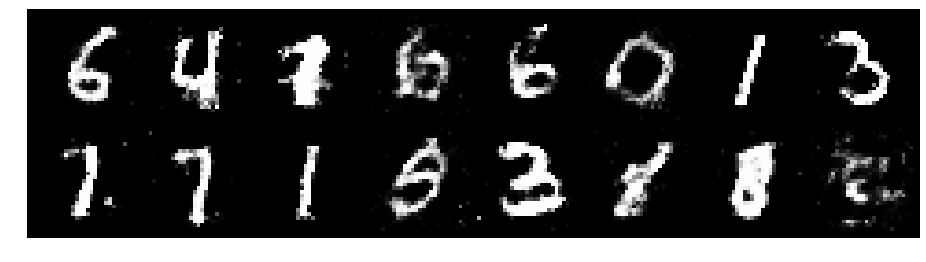

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9413
D(x): 0.5833, D(G(z)): 0.4683


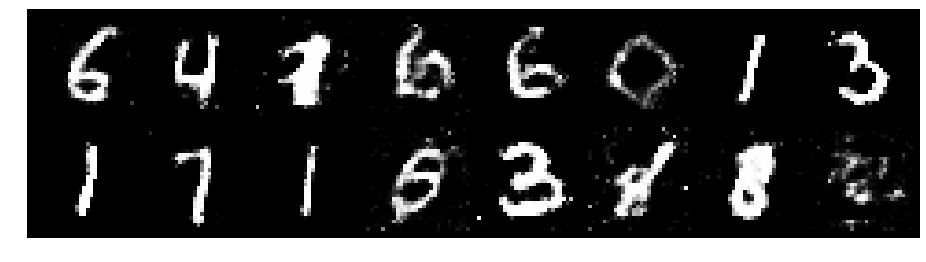

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2309, Generator Loss: 0.9127
D(x): 0.5947, D(G(z)): 0.4484


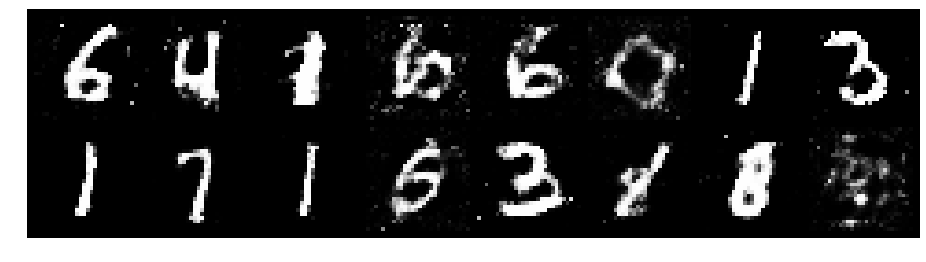

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8940
D(x): 0.5730, D(G(z)): 0.4648


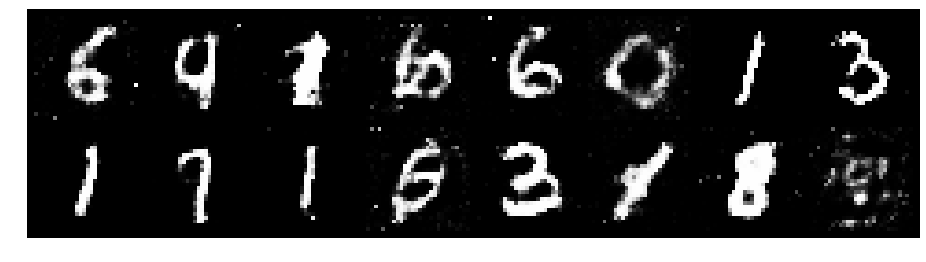

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8577
D(x): 0.5411, D(G(z)): 0.4251


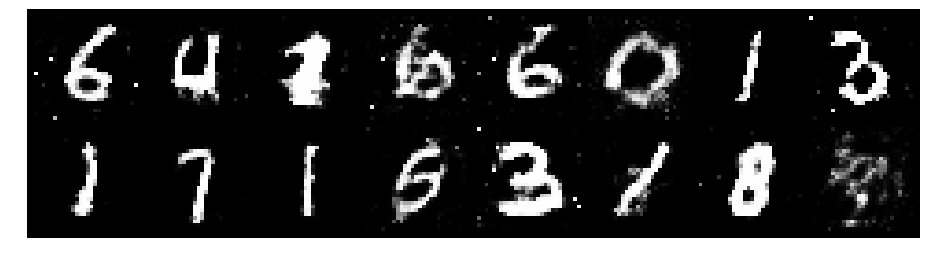

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.3314, Generator Loss: 0.9372
D(x): 0.5833, D(G(z)): 0.4497


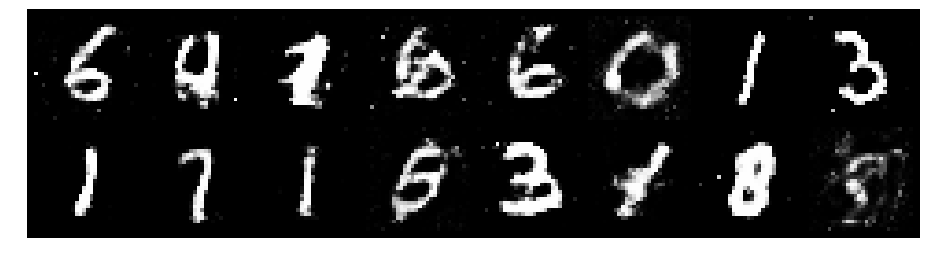

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3585, Generator Loss: 0.8638
D(x): 0.5633, D(G(z)): 0.4697


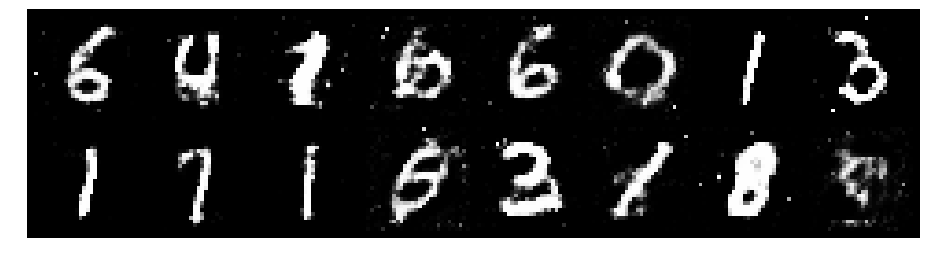

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2163, Generator Loss: 1.0372
D(x): 0.5919, D(G(z)): 0.4387


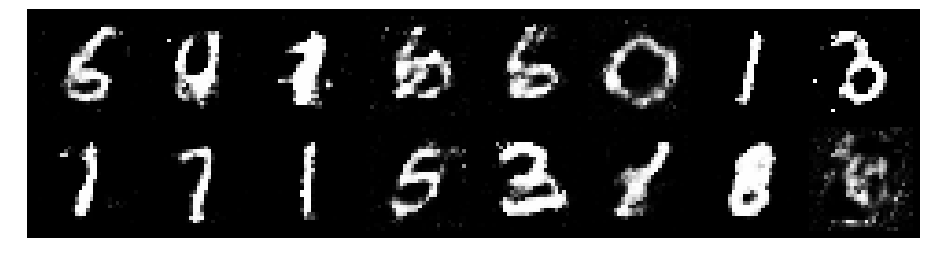

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2641, Generator Loss: 0.9737
D(x): 0.5905, D(G(z)): 0.4446


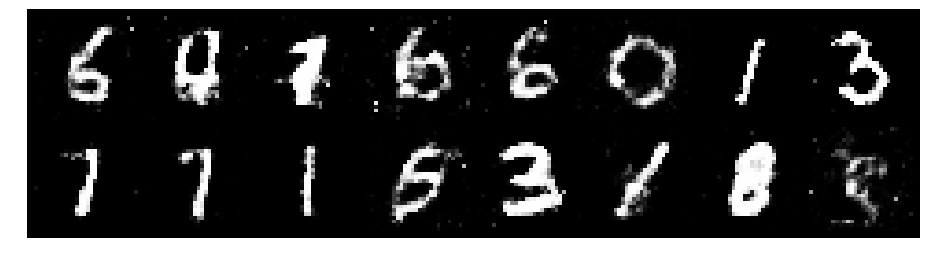

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2005, Generator Loss: 0.9561
D(x): 0.5905, D(G(z)): 0.4251


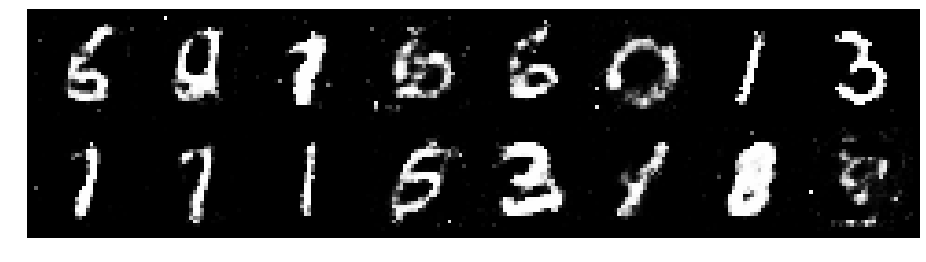

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2241, Generator Loss: 1.0183
D(x): 0.5562, D(G(z)): 0.4161


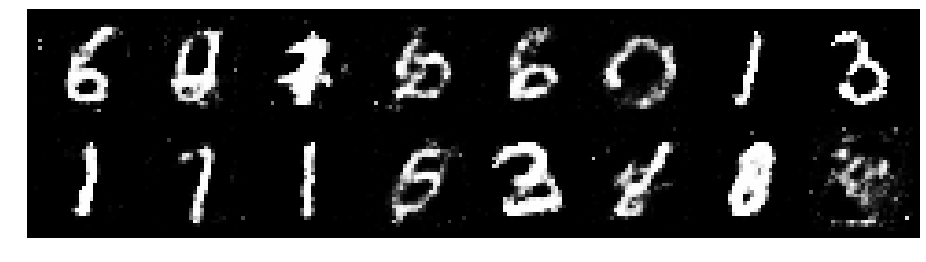

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2215, Generator Loss: 1.0178
D(x): 0.5609, D(G(z)): 0.3897


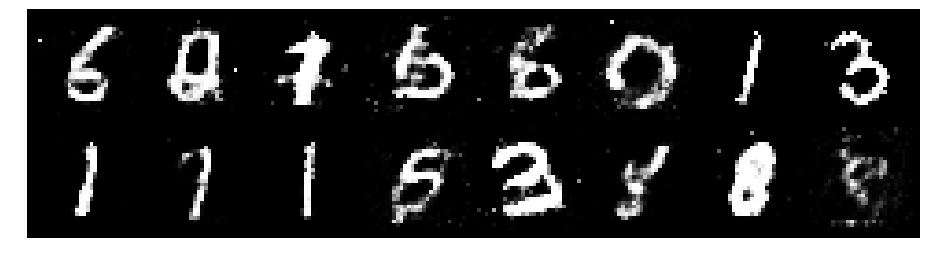

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2475, Generator Loss: 1.0461
D(x): 0.5774, D(G(z)): 0.4216


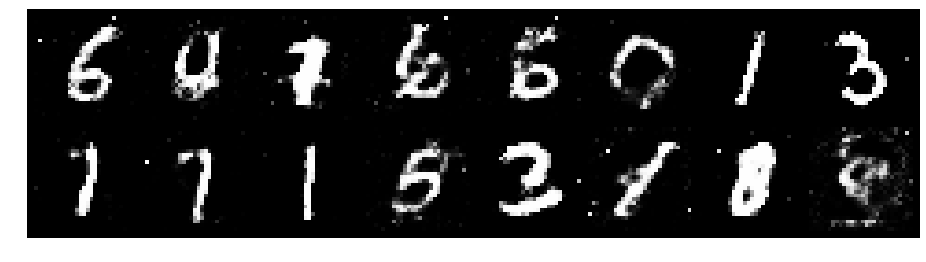

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9046
D(x): 0.5332, D(G(z)): 0.4450


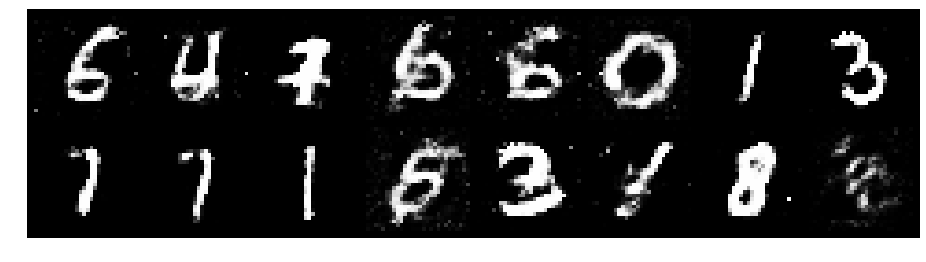

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.1899, Generator Loss: 0.8836
D(x): 0.6042, D(G(z)): 0.4406


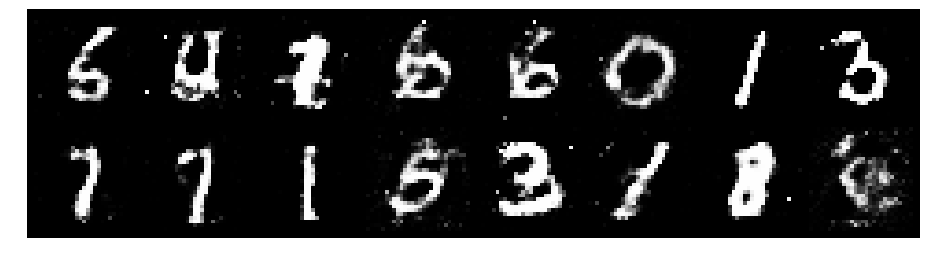

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2751, Generator Loss: 1.0330
D(x): 0.5443, D(G(z)): 0.4006


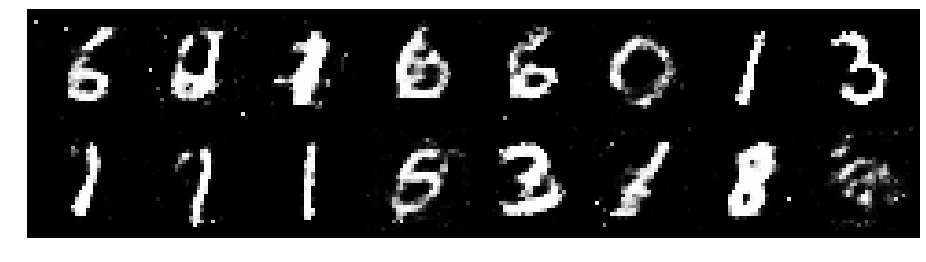

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2819, Generator Loss: 0.9461
D(x): 0.6087, D(G(z)): 0.4641


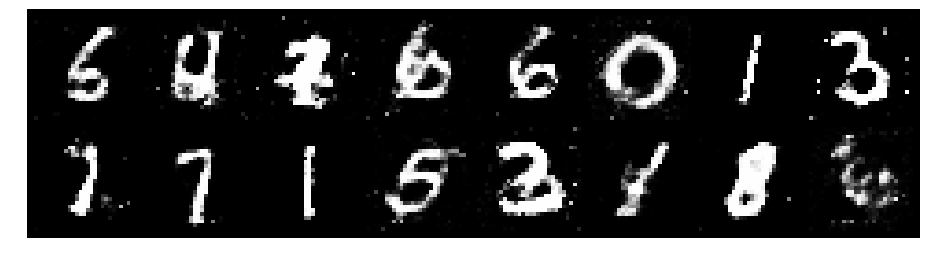

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2967, Generator Loss: 1.0013
D(x): 0.5983, D(G(z)): 0.4331


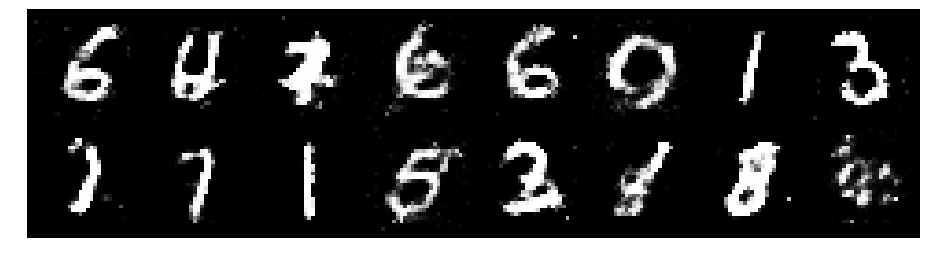

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2950, Generator Loss: 0.9311
D(x): 0.6003, D(G(z)): 0.4827


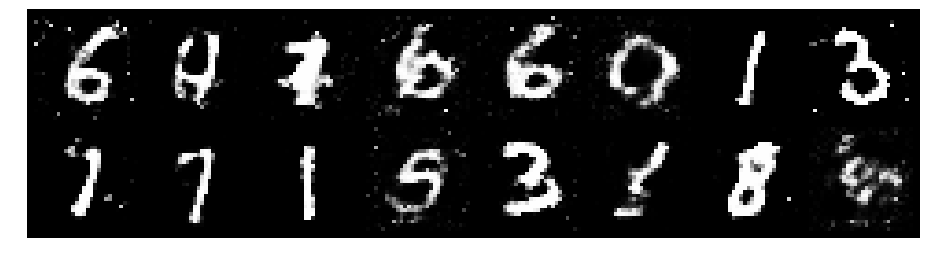

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2475, Generator Loss: 0.9389
D(x): 0.5929, D(G(z)): 0.4539


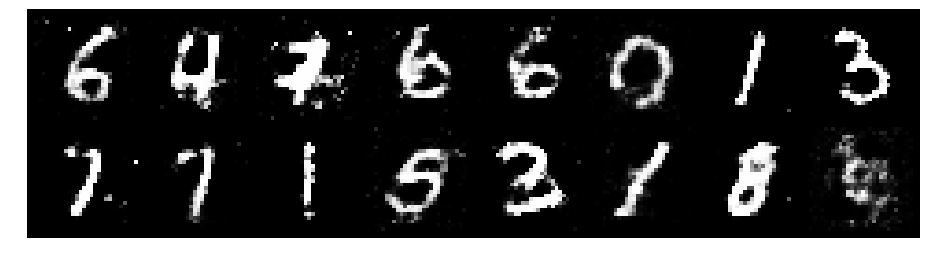

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.3104, Generator Loss: 0.9067
D(x): 0.5166, D(G(z)): 0.4391


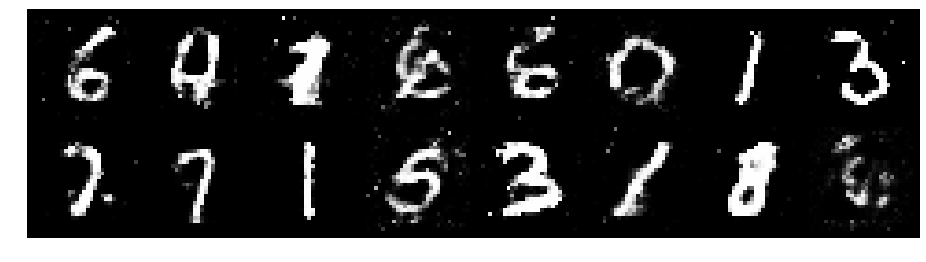

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2408, Generator Loss: 0.8494
D(x): 0.5446, D(G(z)): 0.4149


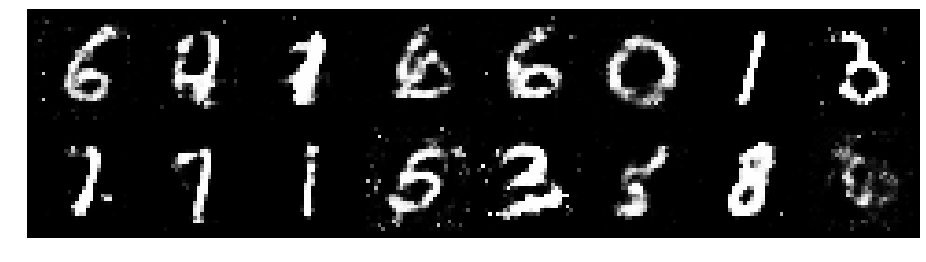

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.3293, Generator Loss: 0.9157
D(x): 0.5203, D(G(z)): 0.4412


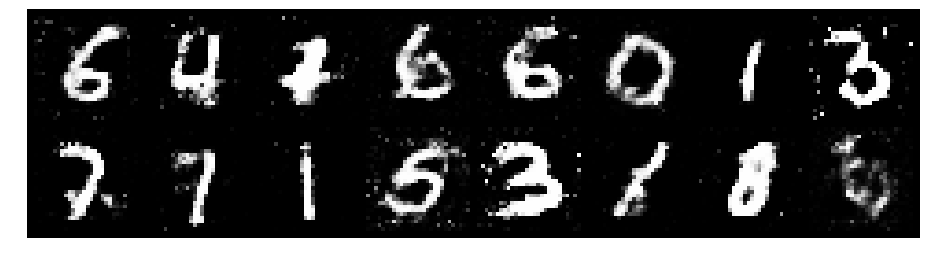

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2917, Generator Loss: 0.9555
D(x): 0.5563, D(G(z)): 0.4169


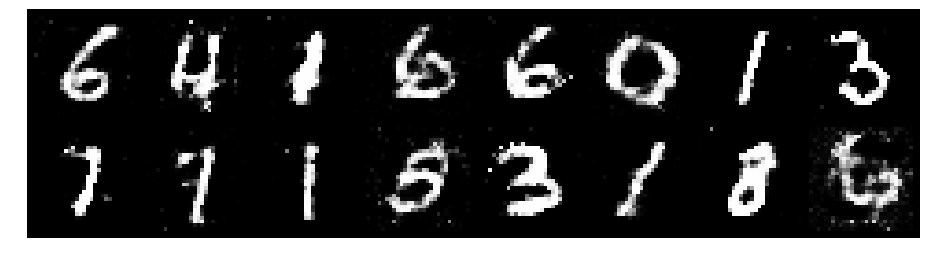

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1504, Generator Loss: 0.8572
D(x): 0.5898, D(G(z)): 0.4115


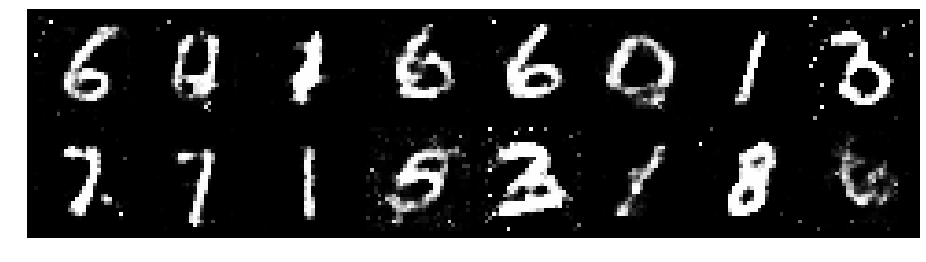

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2873, Generator Loss: 0.9027
D(x): 0.5567, D(G(z)): 0.4508


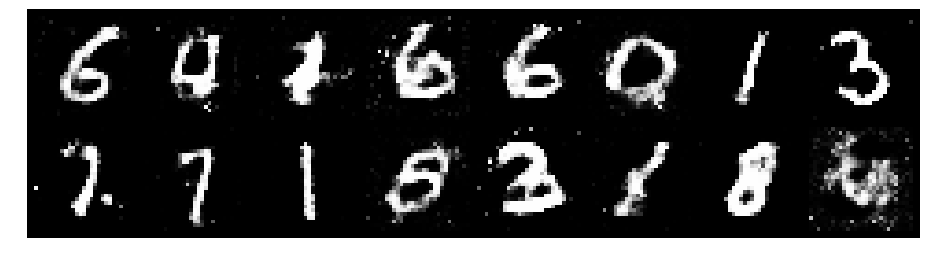

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1131, Generator Loss: 0.9800
D(x): 0.6186, D(G(z)): 0.4077


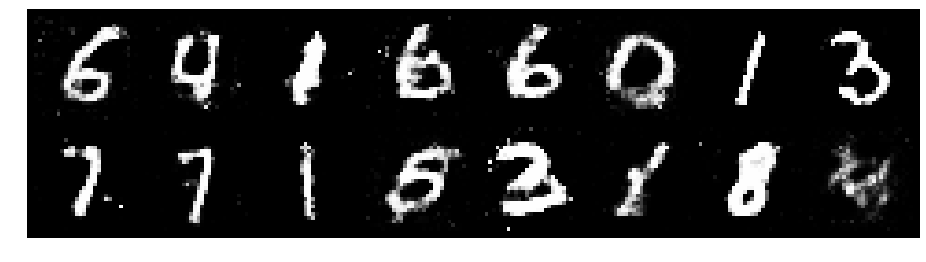

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1417, Generator Loss: 0.9628
D(x): 0.6022, D(G(z)): 0.4004


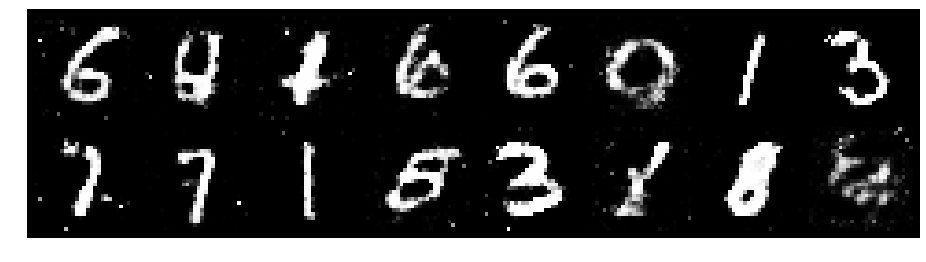

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2623, Generator Loss: 1.0016
D(x): 0.5502, D(G(z)): 0.4134


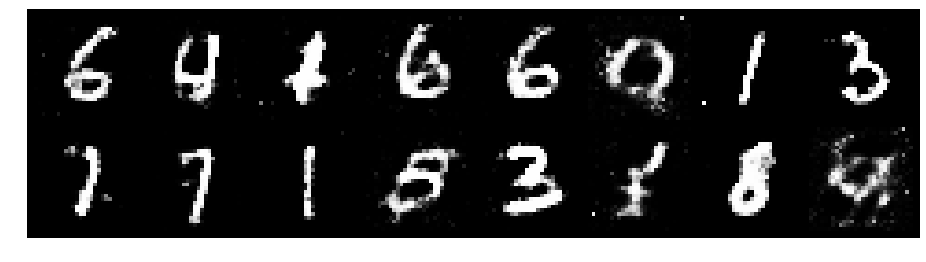

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2517, Generator Loss: 0.8935
D(x): 0.5197, D(G(z)): 0.4006


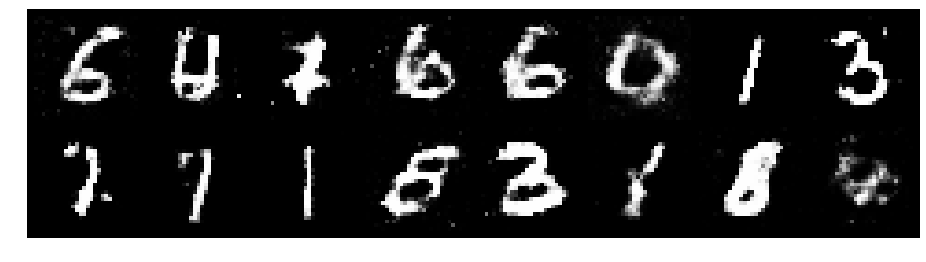

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2319, Generator Loss: 1.0669
D(x): 0.5465, D(G(z)): 0.4089


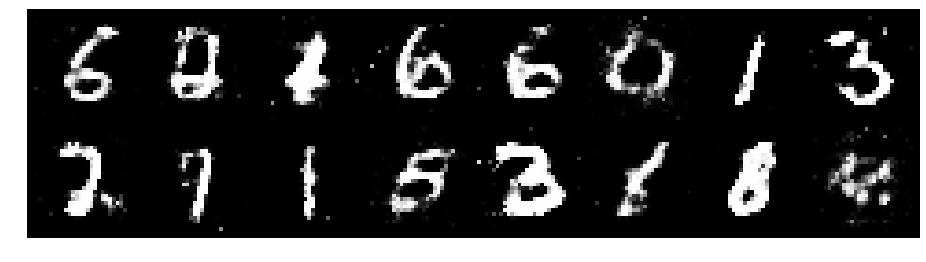

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9086
D(x): 0.5835, D(G(z)): 0.4627


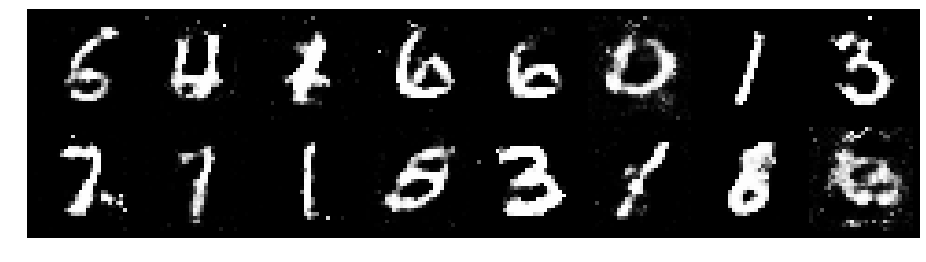

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.4039, Generator Loss: 0.8716
D(x): 0.5230, D(G(z)): 0.4710


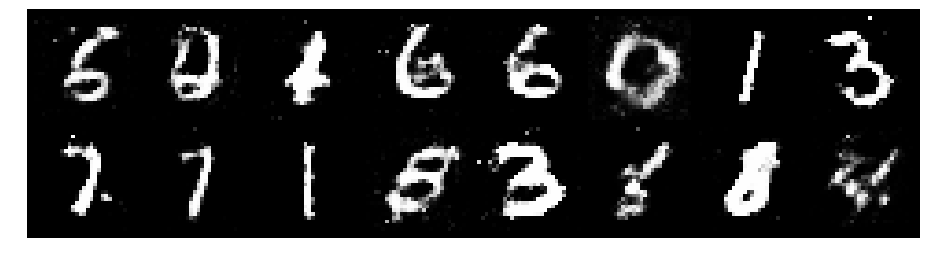

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3086, Generator Loss: 0.8549
D(x): 0.6035, D(G(z)): 0.4771


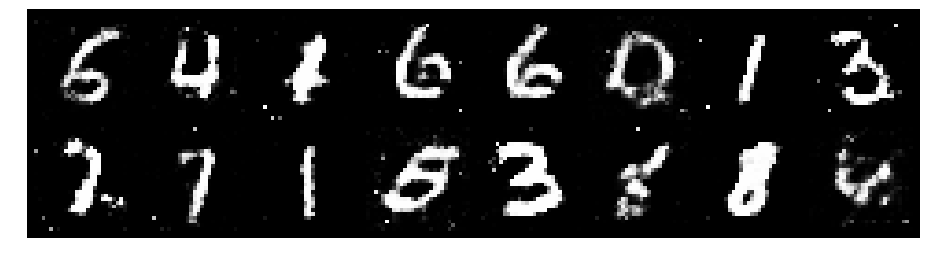

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9623
D(x): 0.5362, D(G(z)): 0.3955


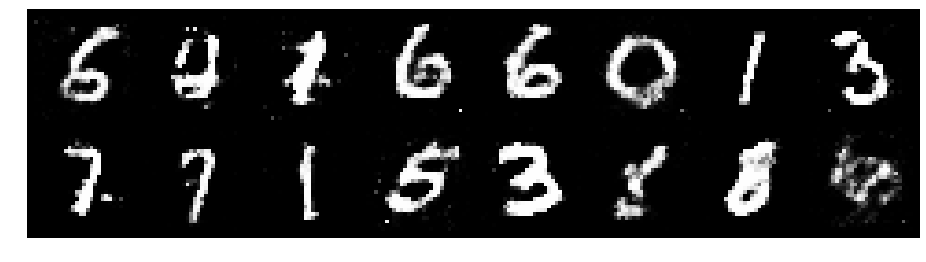

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.3397, Generator Loss: 0.9412
D(x): 0.5552, D(G(z)): 0.4565


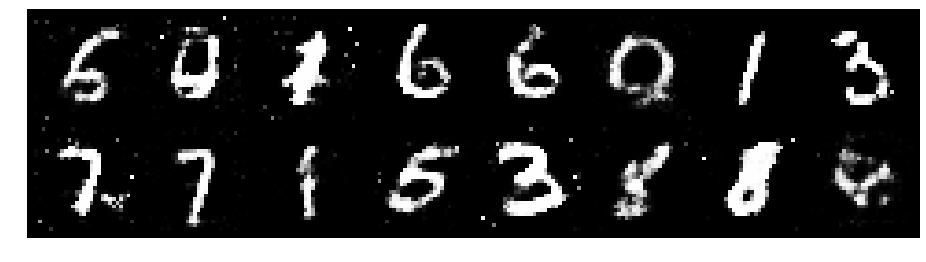

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2673, Generator Loss: 0.8881
D(x): 0.5874, D(G(z)): 0.4545


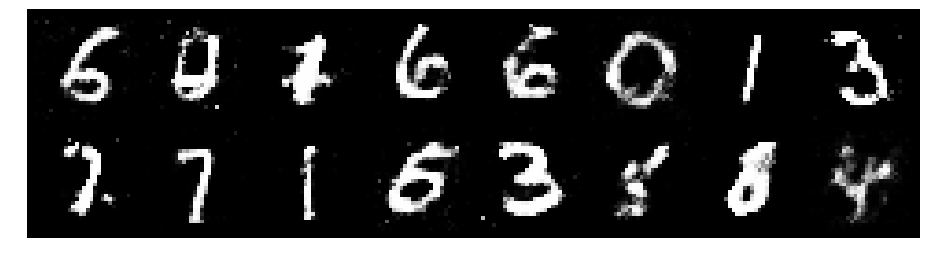

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.3776, Generator Loss: 0.9199
D(x): 0.4861, D(G(z)): 0.4089


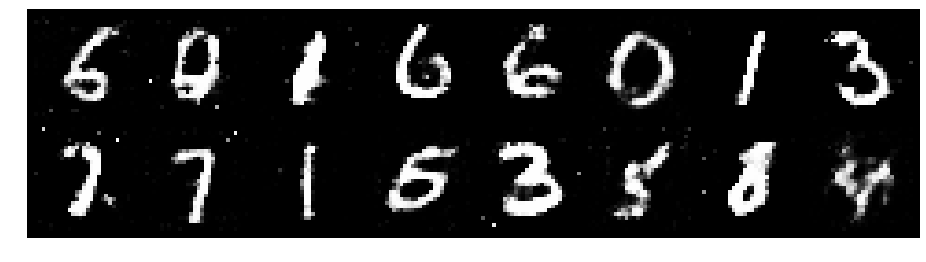

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.3357, Generator Loss: 1.0720
D(x): 0.5478, D(G(z)): 0.4260


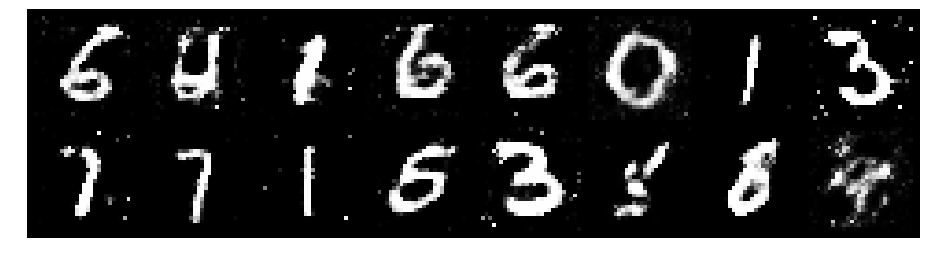

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1964, Generator Loss: 1.0921
D(x): 0.5704, D(G(z)): 0.3813


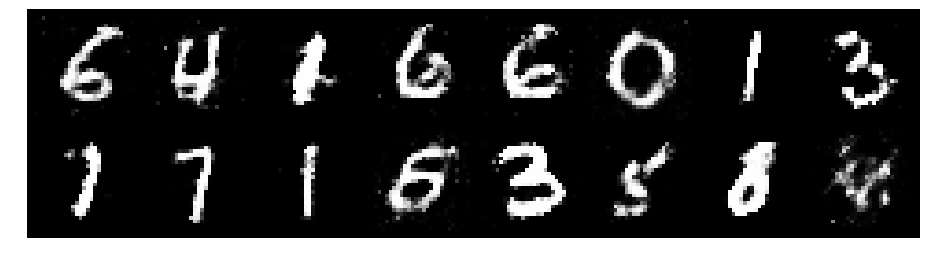

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1236, Generator Loss: 0.9882
D(x): 0.6041, D(G(z)): 0.4094


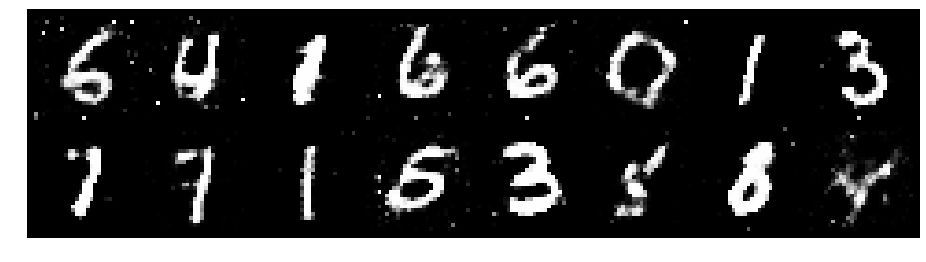

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.3033, Generator Loss: 0.8720
D(x): 0.5132, D(G(z)): 0.4336


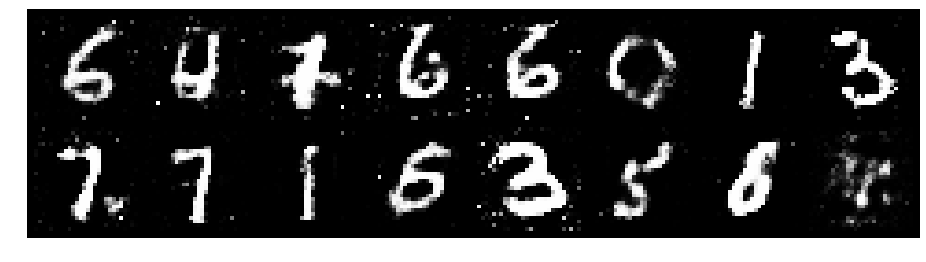

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.3782, Generator Loss: 0.8550
D(x): 0.5042, D(G(z)): 0.4565


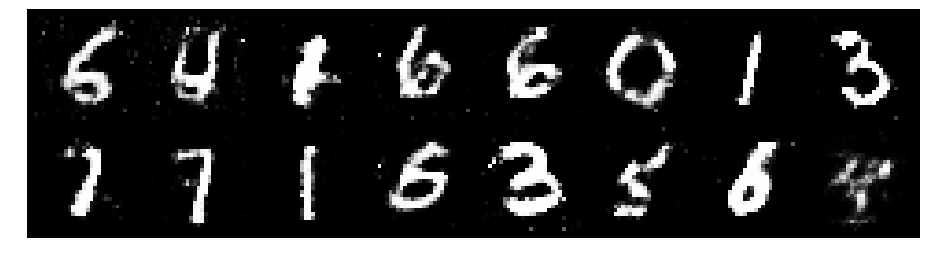

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.3611, Generator Loss: 0.9155
D(x): 0.5347, D(G(z)): 0.4546


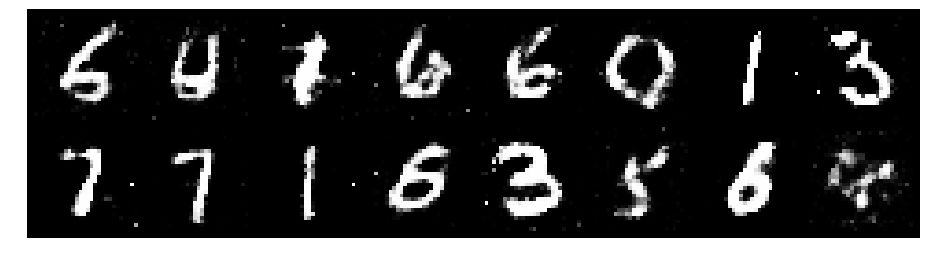

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2833, Generator Loss: 0.8714
D(x): 0.5594, D(G(z)): 0.4329


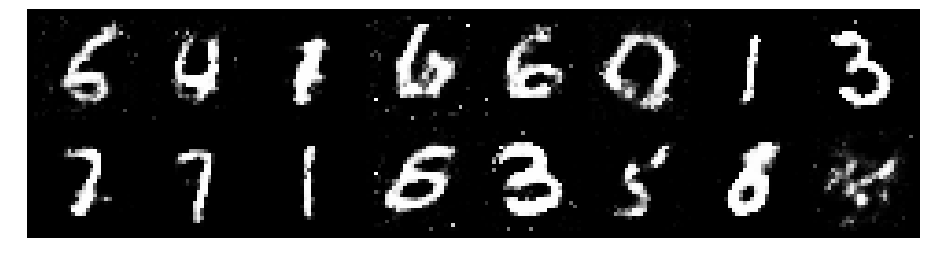

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.3542, Generator Loss: 0.9372
D(x): 0.5810, D(G(z)): 0.4888


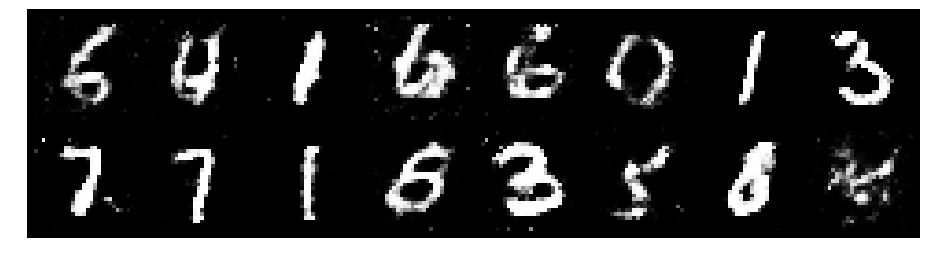

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.3482, Generator Loss: 0.9221
D(x): 0.5370, D(G(z)): 0.4608


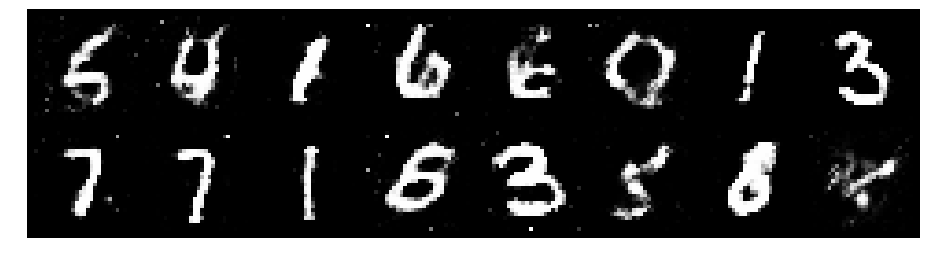

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2631, Generator Loss: 0.9218
D(x): 0.5799, D(G(z)): 0.4565


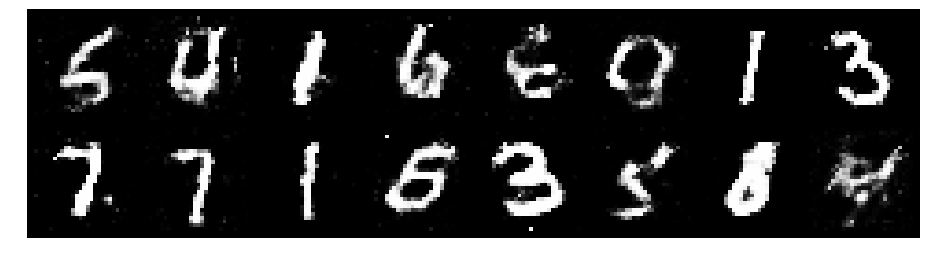

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.3350, Generator Loss: 0.7982
D(x): 0.5546, D(G(z)): 0.4810


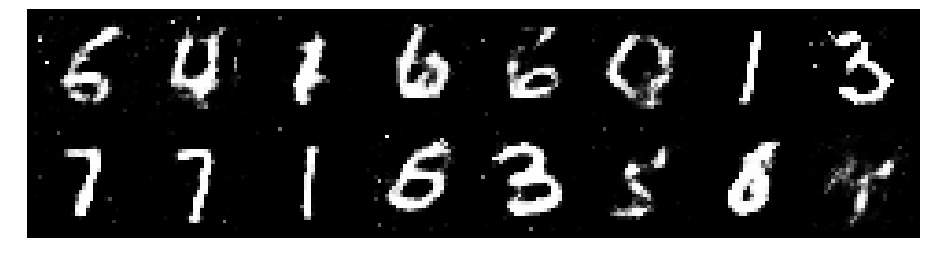

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2038, Generator Loss: 0.8538
D(x): 0.6020, D(G(z)): 0.4305


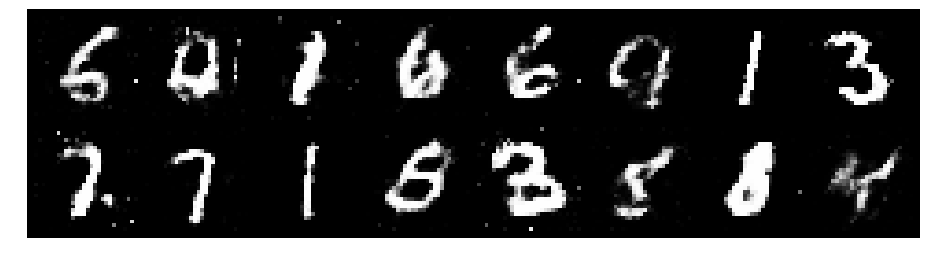

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9306
D(x): 0.5972, D(G(z)): 0.4570


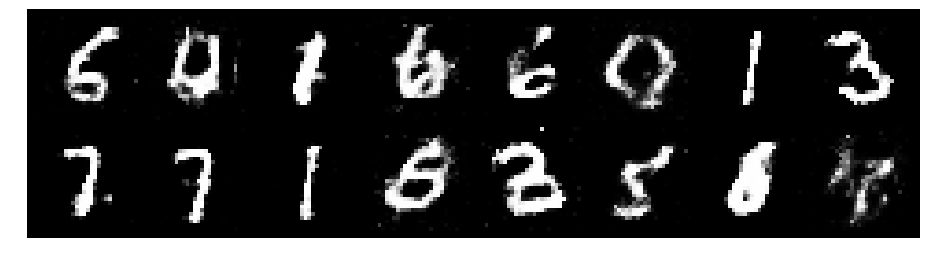

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2724, Generator Loss: 0.8197
D(x): 0.5507, D(G(z)): 0.4620


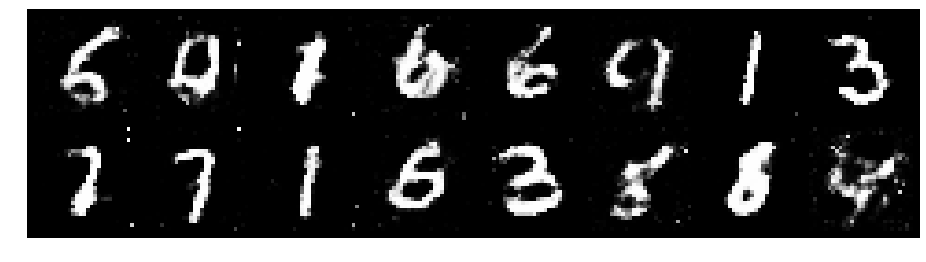

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2860, Generator Loss: 0.7872
D(x): 0.6084, D(G(z)): 0.5008


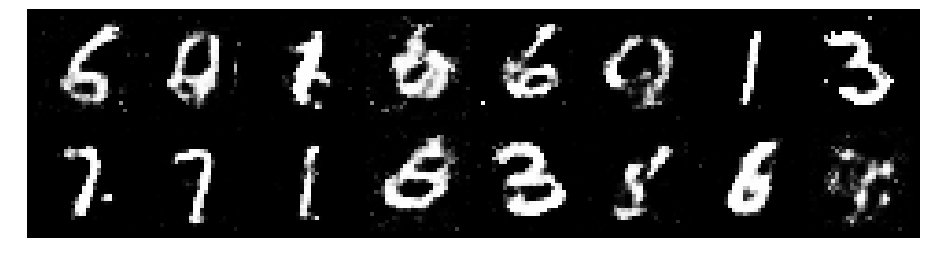

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2397, Generator Loss: 0.8115
D(x): 0.6188, D(G(z)): 0.4809


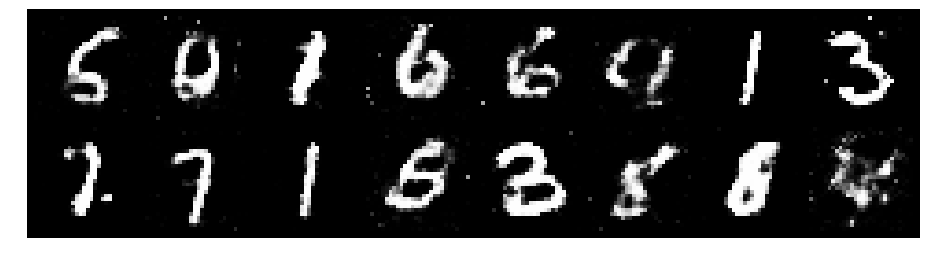

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.1613, Generator Loss: 0.9798
D(x): 0.5920, D(G(z)): 0.4084


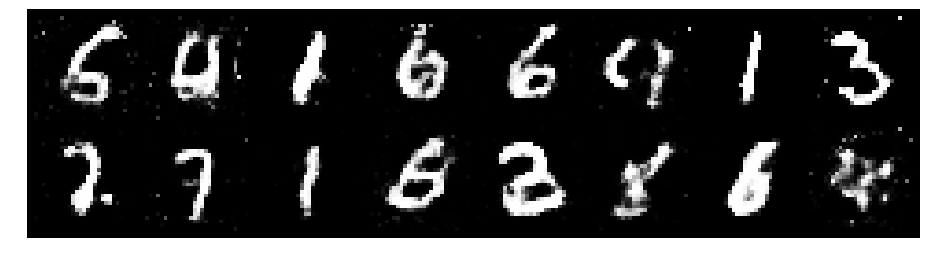

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2787, Generator Loss: 0.8601
D(x): 0.5356, D(G(z)): 0.4337


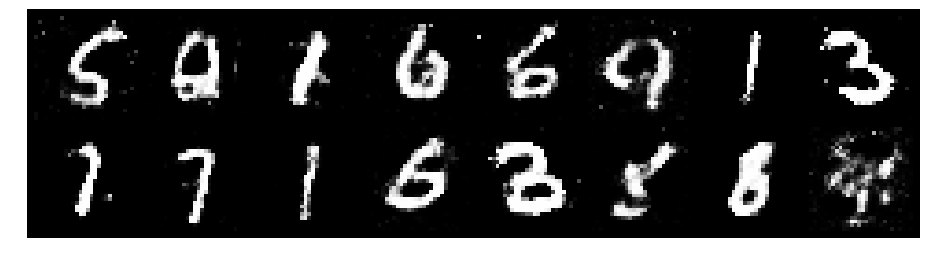

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0239
D(x): 0.5874, D(G(z)): 0.4094


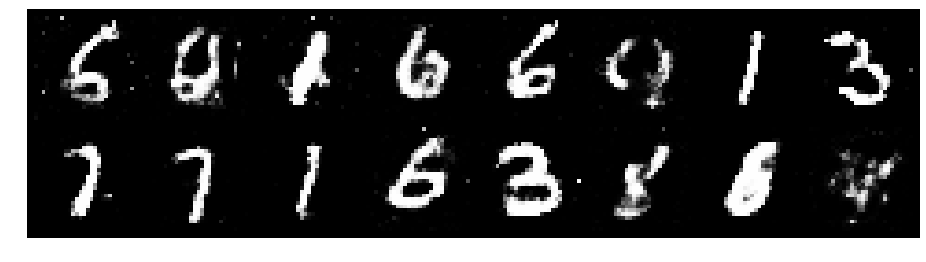

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.3168, Generator Loss: 0.8204
D(x): 0.5850, D(G(z)): 0.4939


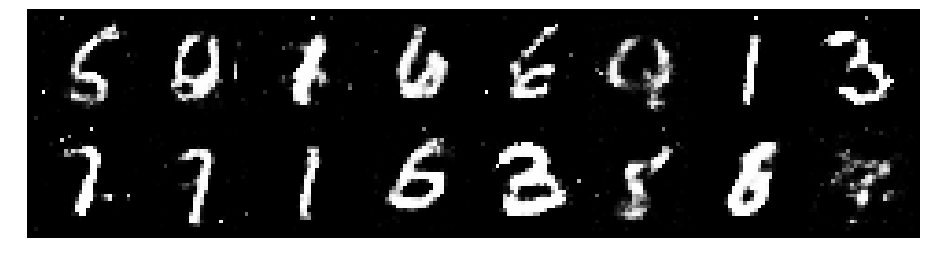

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2947, Generator Loss: 0.7978
D(x): 0.5839, D(G(z)): 0.4760


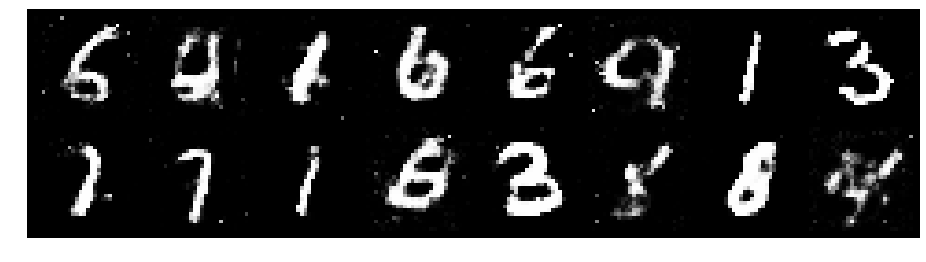

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3239, Generator Loss: 0.9360
D(x): 0.5721, D(G(z)): 0.4396


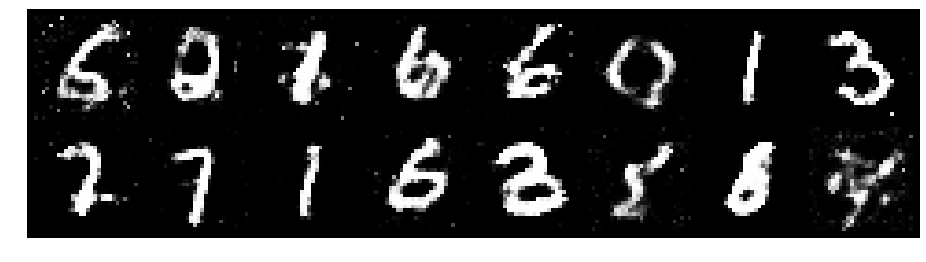

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.1894, Generator Loss: 1.0169
D(x): 0.5654, D(G(z)): 0.4143


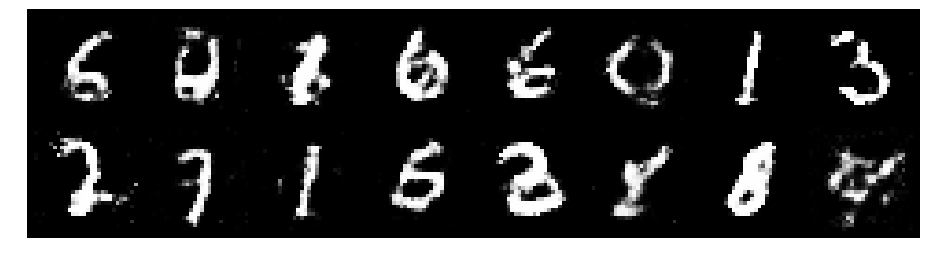

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2983, Generator Loss: 0.9772
D(x): 0.5340, D(G(z)): 0.4305


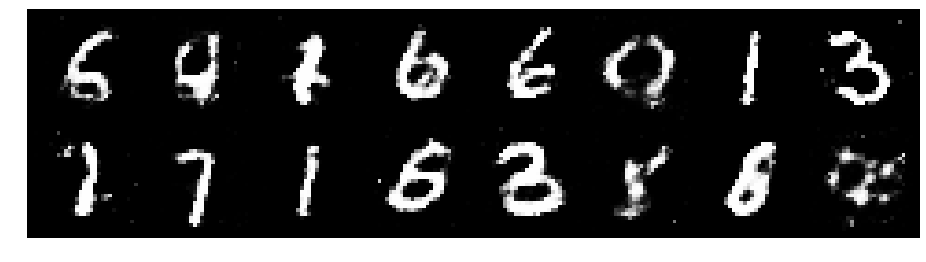

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2371, Generator Loss: 0.8864
D(x): 0.5851, D(G(z)): 0.4452


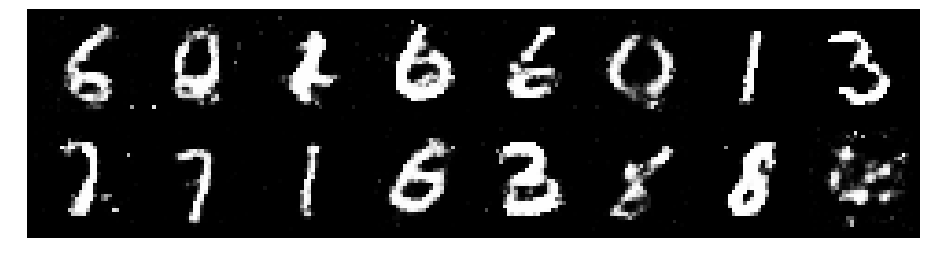

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3551, Generator Loss: 0.8640
D(x): 0.5254, D(G(z)): 0.4655


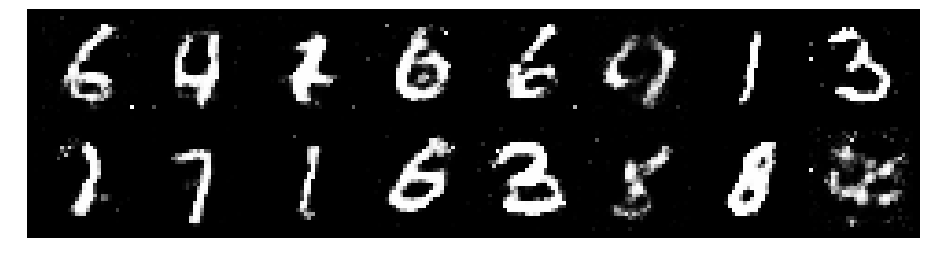

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.1914, Generator Loss: 0.9567
D(x): 0.5958, D(G(z)): 0.4318


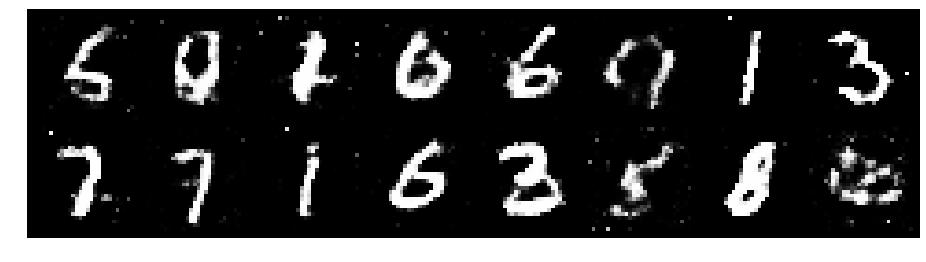

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2600, Generator Loss: 0.9703
D(x): 0.5535, D(G(z)): 0.4379


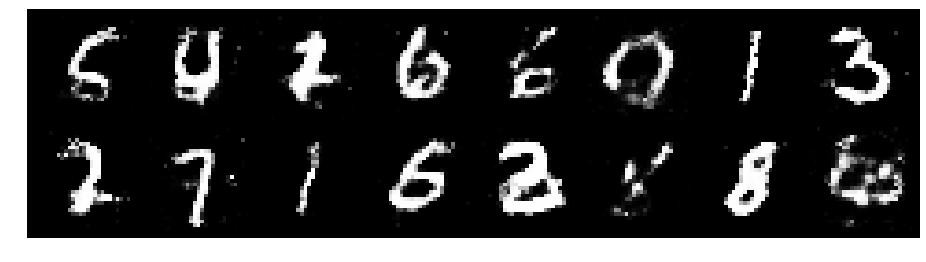

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8175
D(x): 0.5498, D(G(z)): 0.4715


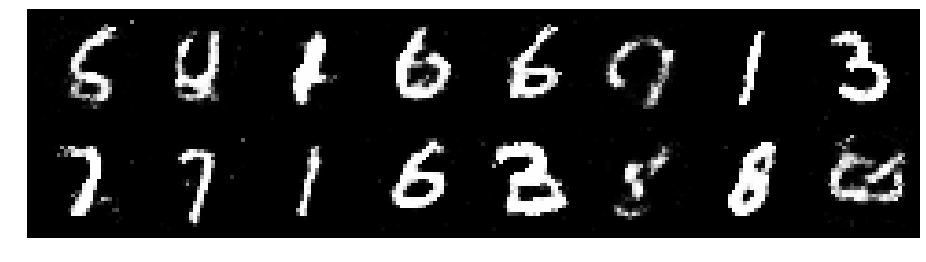

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2429, Generator Loss: 0.9247
D(x): 0.5361, D(G(z)): 0.4188


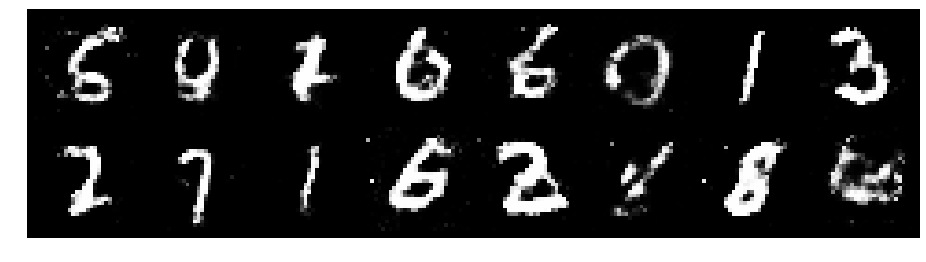

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3363, Generator Loss: 0.8642
D(x): 0.5385, D(G(z)): 0.4643


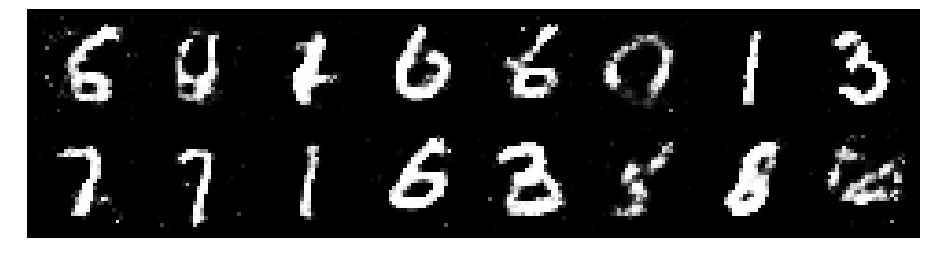

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3471, Generator Loss: 0.8092
D(x): 0.6114, D(G(z)): 0.5251


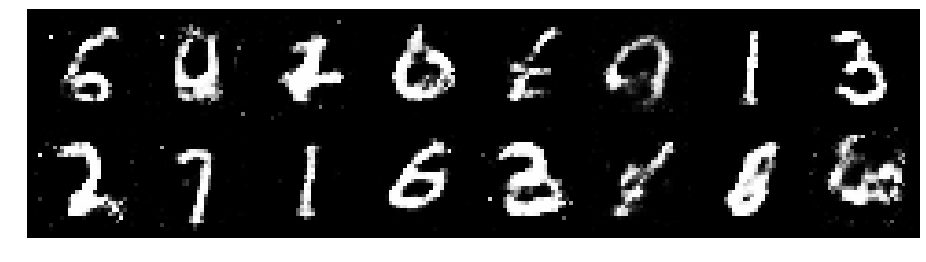

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3069, Generator Loss: 0.9138
D(x): 0.5236, D(G(z)): 0.4421


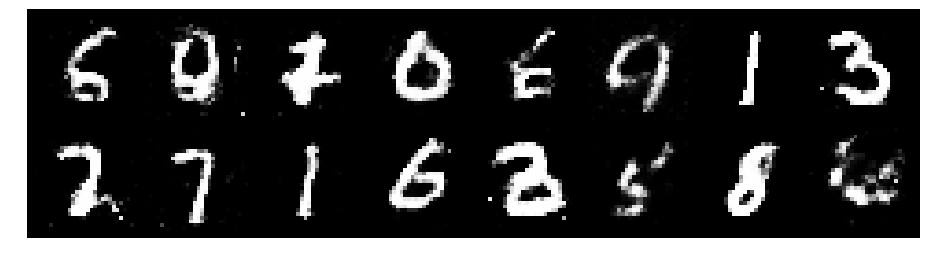

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3979, Generator Loss: 0.8676
D(x): 0.5193, D(G(z)): 0.4652


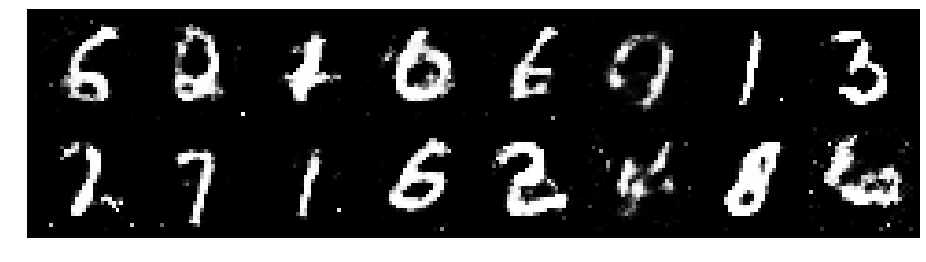

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1964, Generator Loss: 0.9109
D(x): 0.6087, D(G(z)): 0.4535


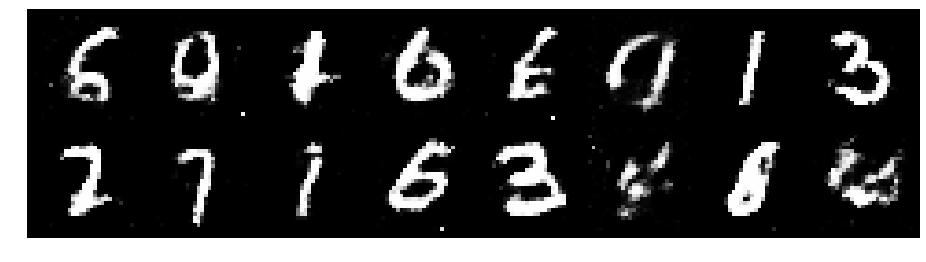

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.1971, Generator Loss: 1.0916
D(x): 0.6439, D(G(z)): 0.4338


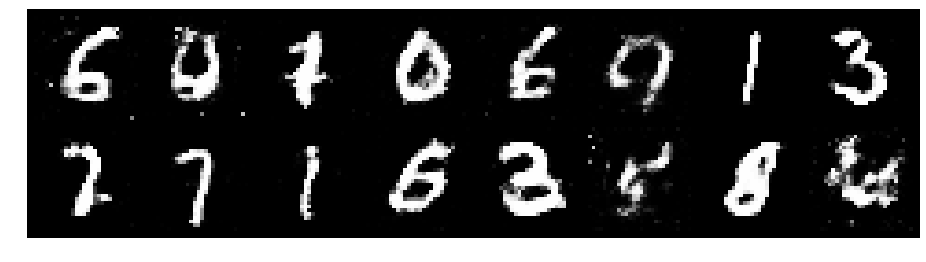

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2541, Generator Loss: 1.0189
D(x): 0.6154, D(G(z)): 0.4474


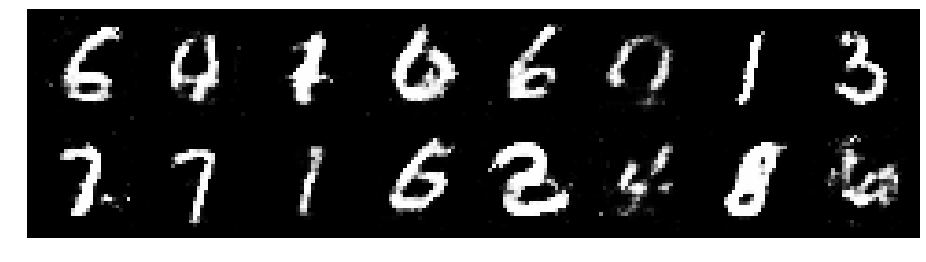

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.1781, Generator Loss: 0.9151
D(x): 0.5818, D(G(z)): 0.4204


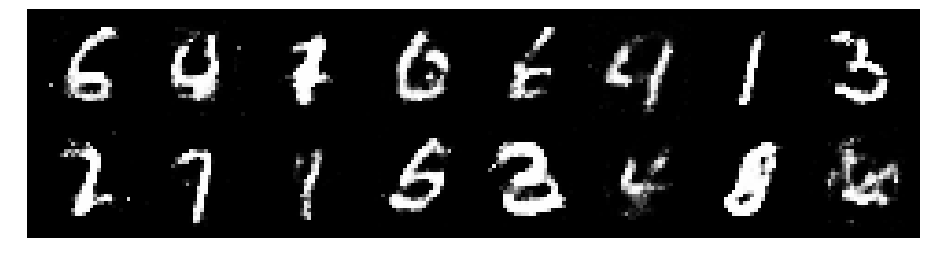

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1046, Generator Loss: 0.9290
D(x): 0.6478, D(G(z)): 0.4292


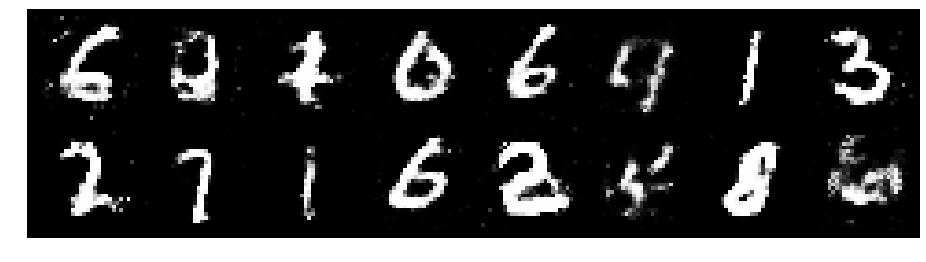

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2997, Generator Loss: 0.8921
D(x): 0.5420, D(G(z)): 0.4077


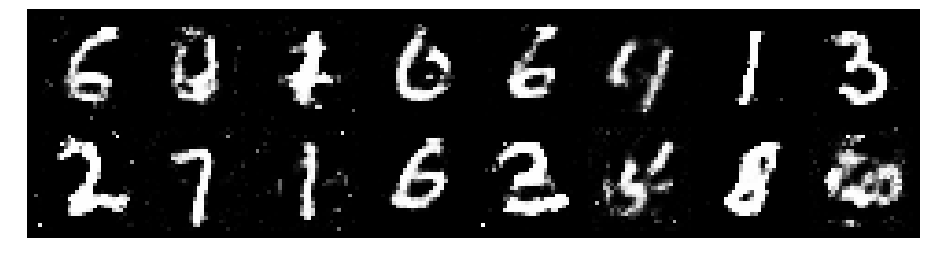

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.1998, Generator Loss: 0.9097
D(x): 0.5847, D(G(z)): 0.4390


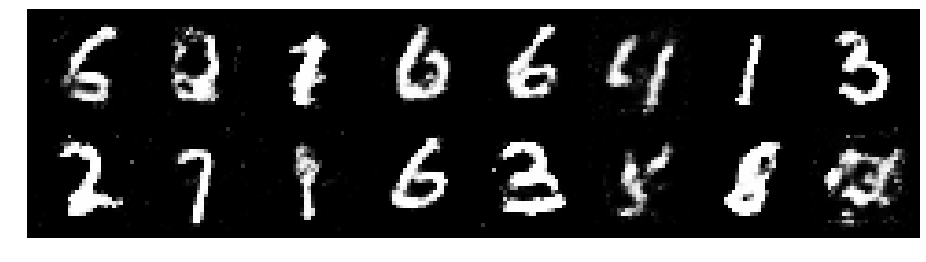

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.1579, Generator Loss: 0.8729
D(x): 0.6467, D(G(z)): 0.4507


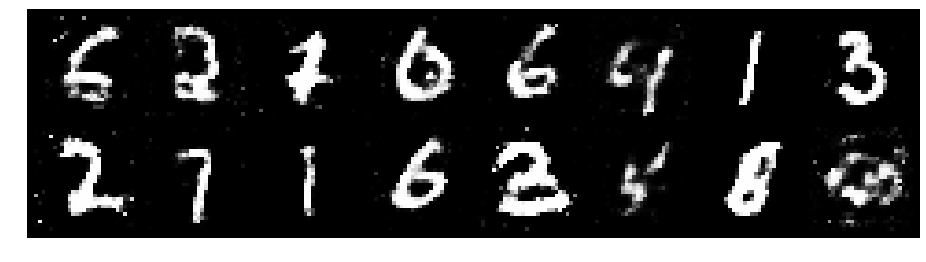

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2213, Generator Loss: 0.9788
D(x): 0.5590, D(G(z)): 0.4269


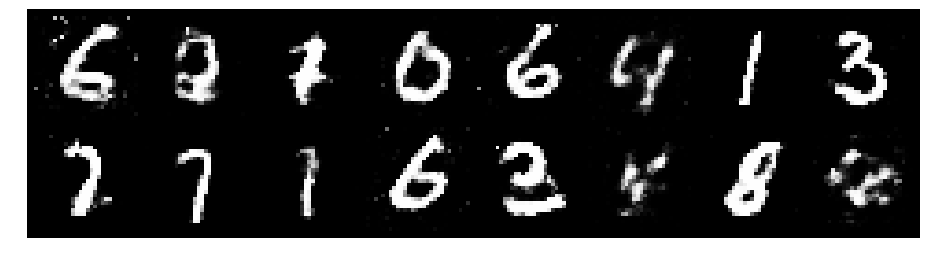

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2604, Generator Loss: 0.9396
D(x): 0.5493, D(G(z)): 0.4382


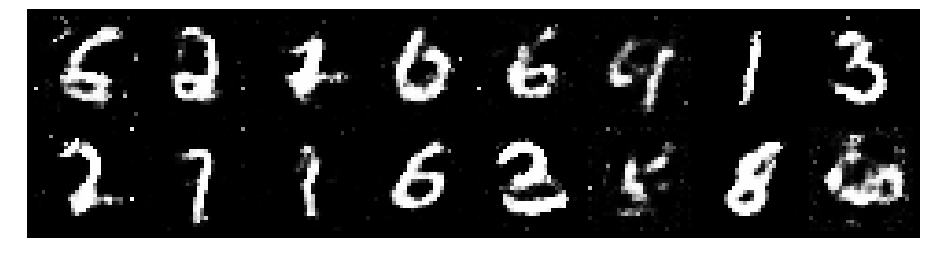

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.3378, Generator Loss: 0.8444
D(x): 0.5586, D(G(z)): 0.4654


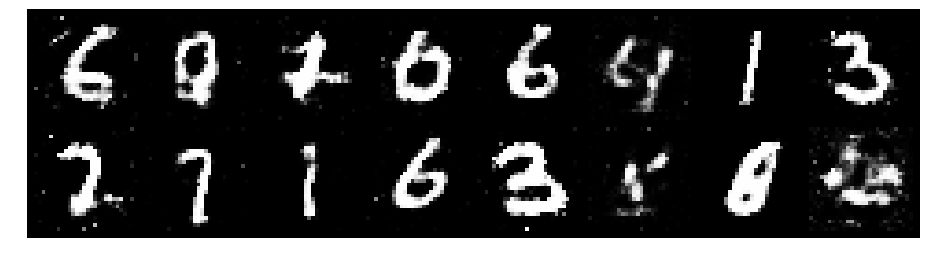

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.3685, Generator Loss: 0.8677
D(x): 0.5867, D(G(z)): 0.4637


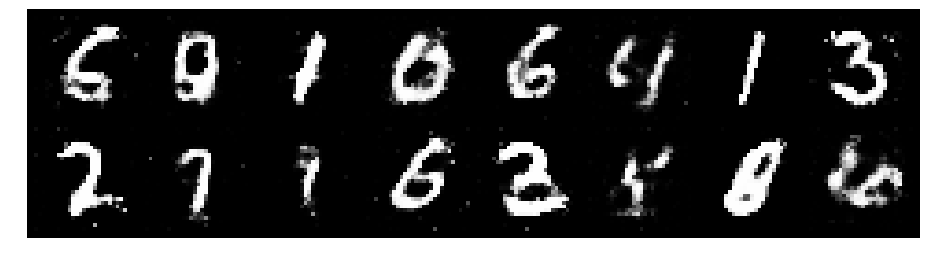

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1694, Generator Loss: 1.0679
D(x): 0.5701, D(G(z)): 0.3887


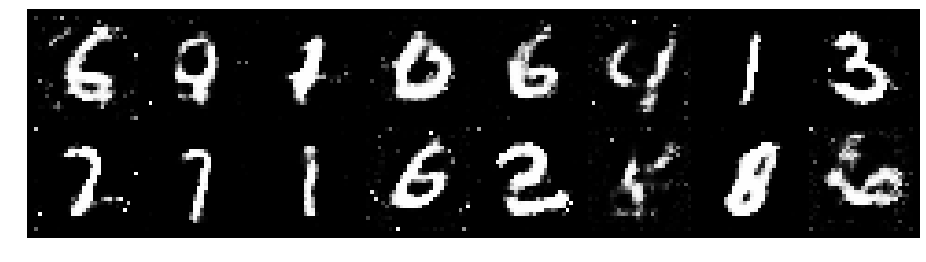

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2579, Generator Loss: 0.8623
D(x): 0.5813, D(G(z)): 0.4638


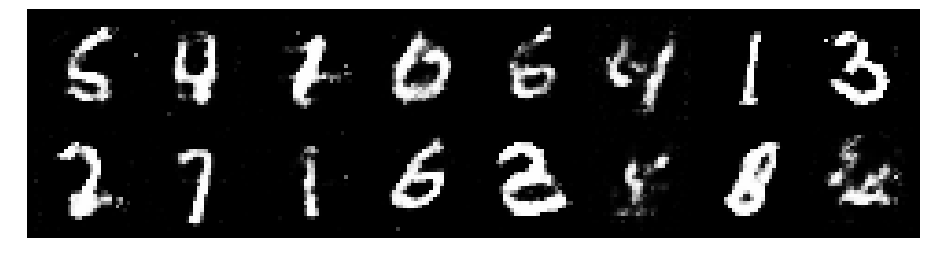

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.1752, Generator Loss: 1.0902
D(x): 0.5641, D(G(z)): 0.3865


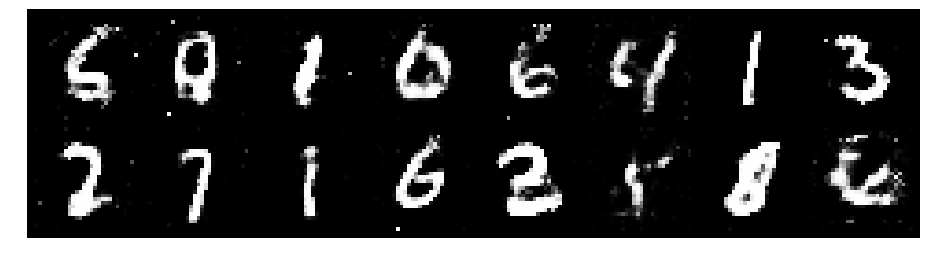

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2131, Generator Loss: 1.0365
D(x): 0.5639, D(G(z)): 0.3841


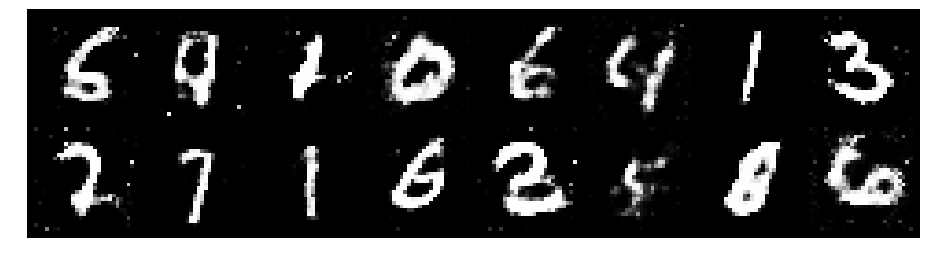

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.1518, Generator Loss: 0.9329
D(x): 0.5899, D(G(z)): 0.4164


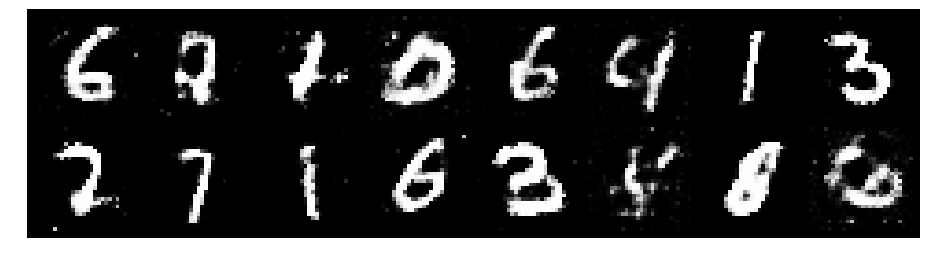

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2403, Generator Loss: 0.9380
D(x): 0.5593, D(G(z)): 0.4200


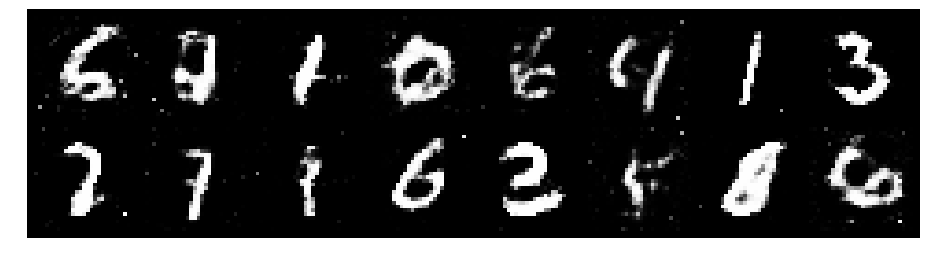

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2806, Generator Loss: 0.9459
D(x): 0.5300, D(G(z)): 0.4298


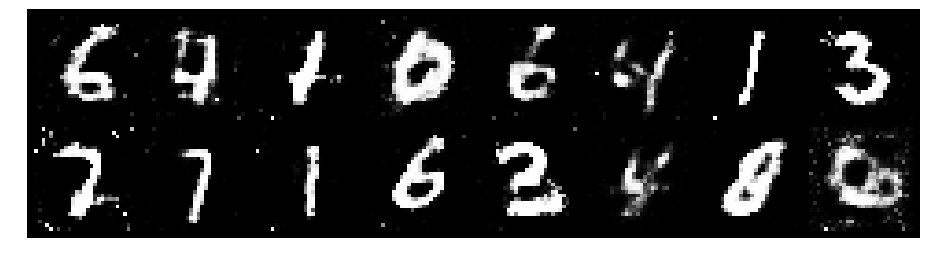

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2835, Generator Loss: 1.1037
D(x): 0.5823, D(G(z)): 0.4443


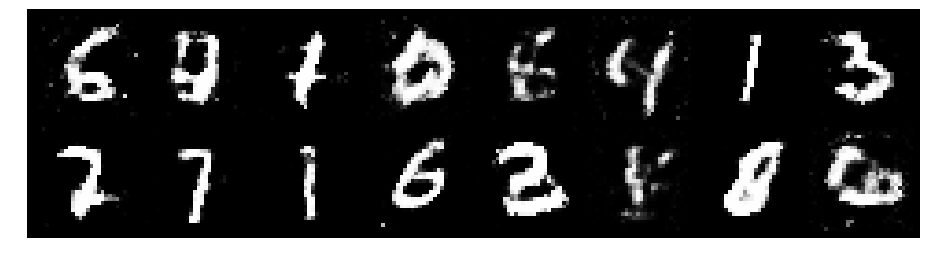

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.1676, Generator Loss: 1.0182
D(x): 0.6015, D(G(z)): 0.4040


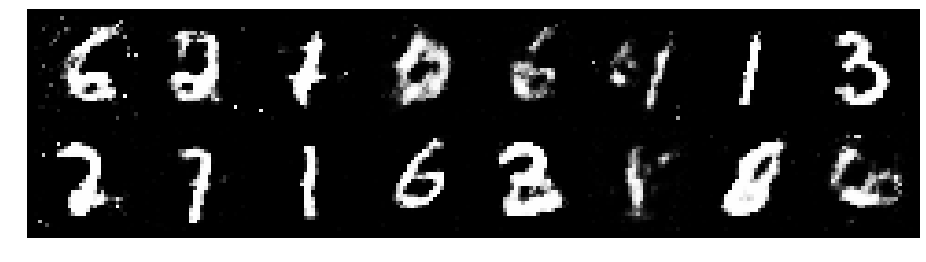

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2889, Generator Loss: 0.7750
D(x): 0.6043, D(G(z)): 0.4982


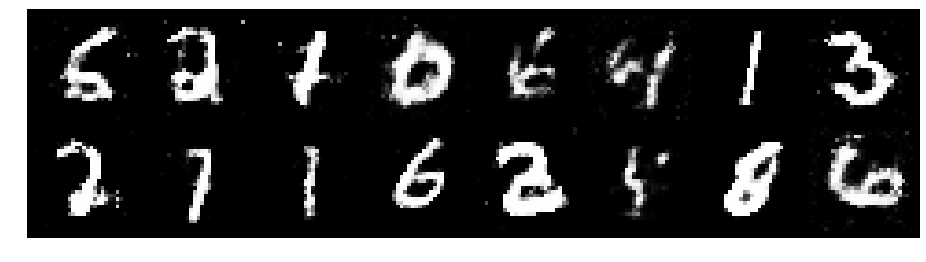

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.1253, Generator Loss: 0.9004
D(x): 0.5814, D(G(z)): 0.4038


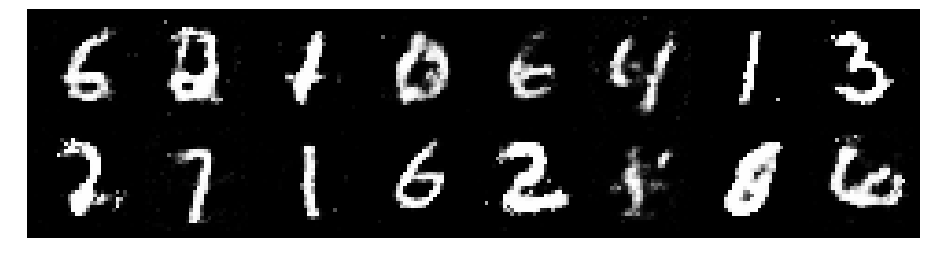

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.4046, Generator Loss: 0.8502
D(x): 0.5548, D(G(z)): 0.4981


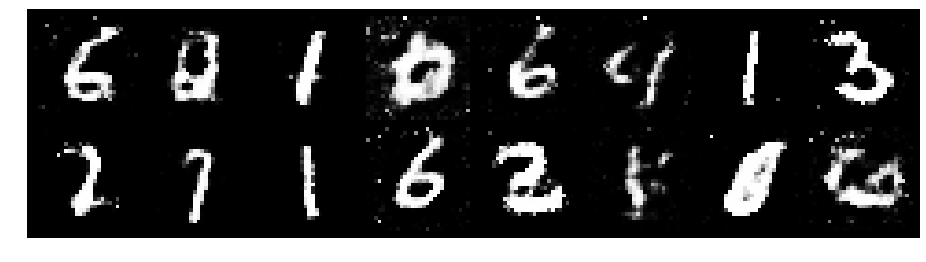

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8185
D(x): 0.5399, D(G(z)): 0.4761


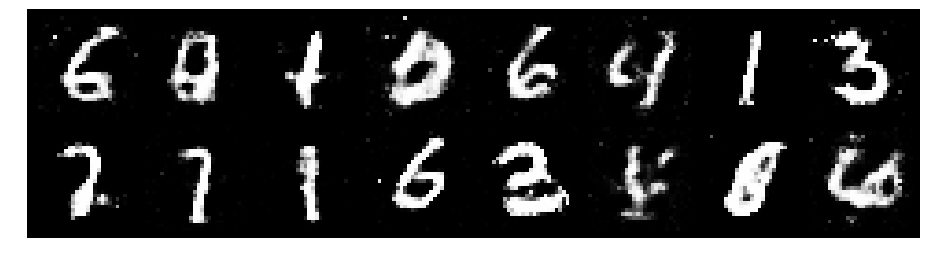

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.3070, Generator Loss: 0.8011
D(x): 0.5574, D(G(z)): 0.4485


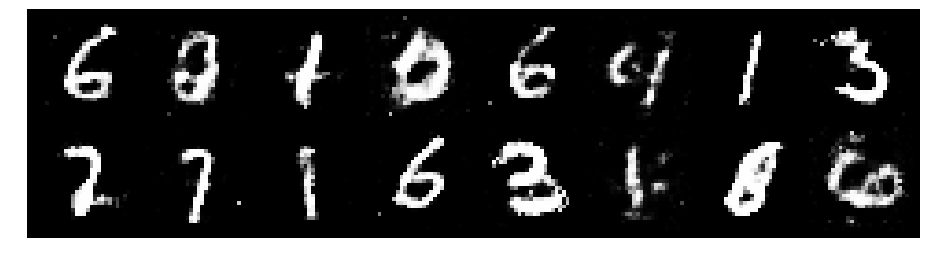

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.1194, Generator Loss: 1.2608
D(x): 0.6081, D(G(z)): 0.3706


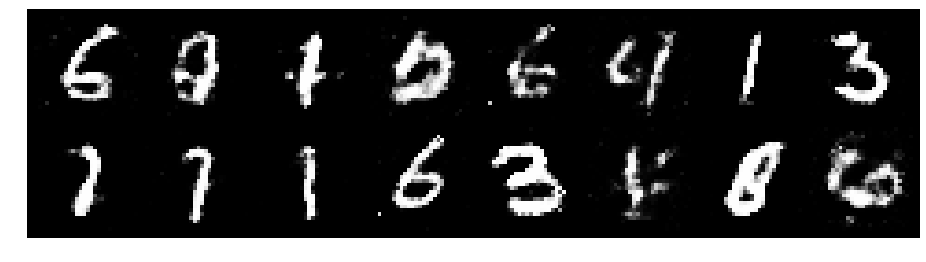

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.1763, Generator Loss: 1.0197
D(x): 0.6125, D(G(z)): 0.4496


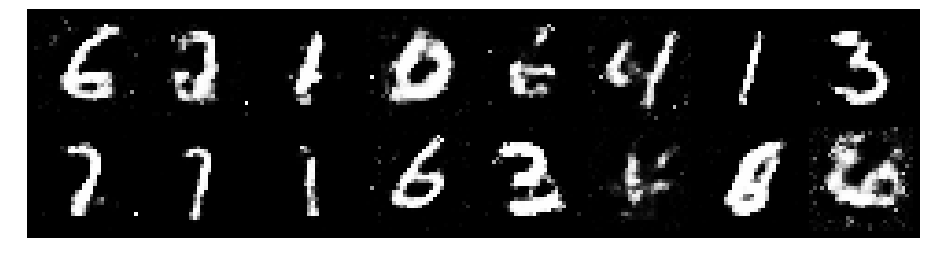

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.3193, Generator Loss: 0.8763
D(x): 0.5519, D(G(z)): 0.4503


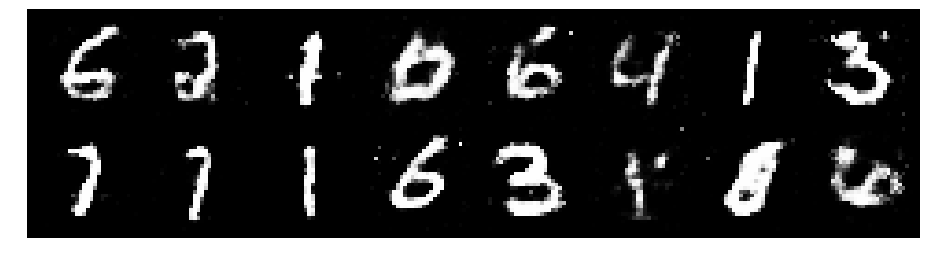

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.3774, Generator Loss: 0.8577
D(x): 0.5102, D(G(z)): 0.4379


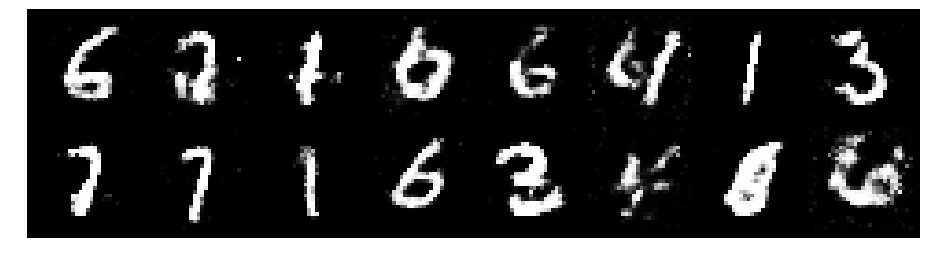

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2170, Generator Loss: 1.0064
D(x): 0.5619, D(G(z)): 0.4156


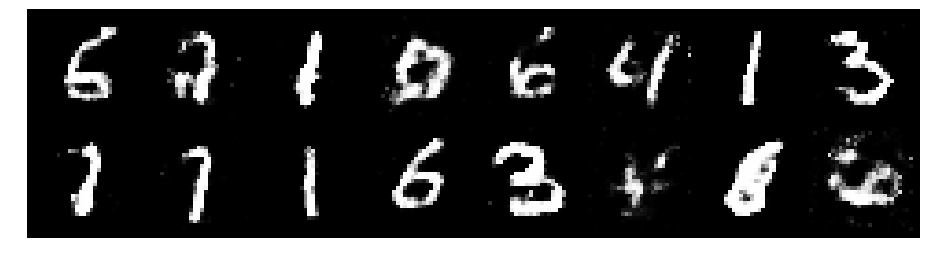

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.3063, Generator Loss: 0.8263
D(x): 0.5557, D(G(z)): 0.4503


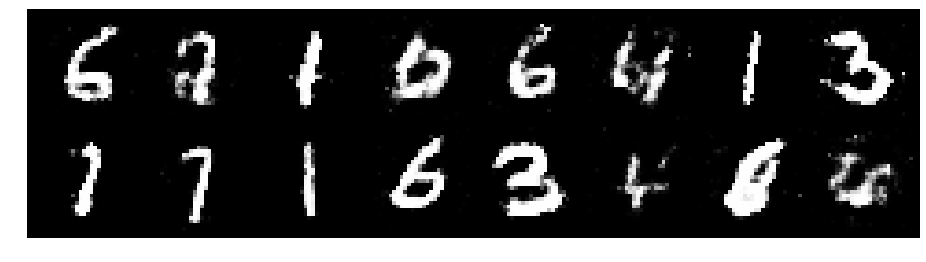

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.3361, Generator Loss: 1.0262
D(x): 0.5668, D(G(z)): 0.4456


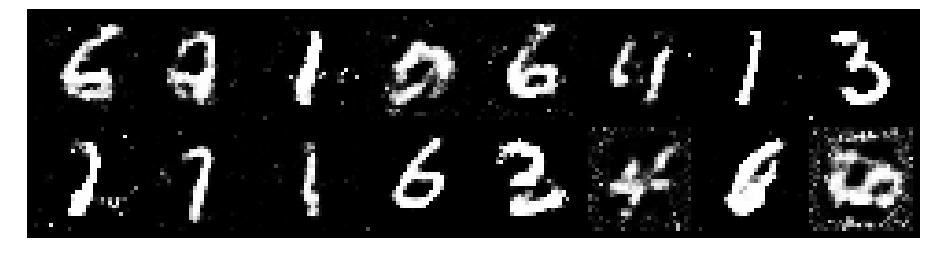

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.4674, Generator Loss: 0.8422
D(x): 0.5421, D(G(z)): 0.5096


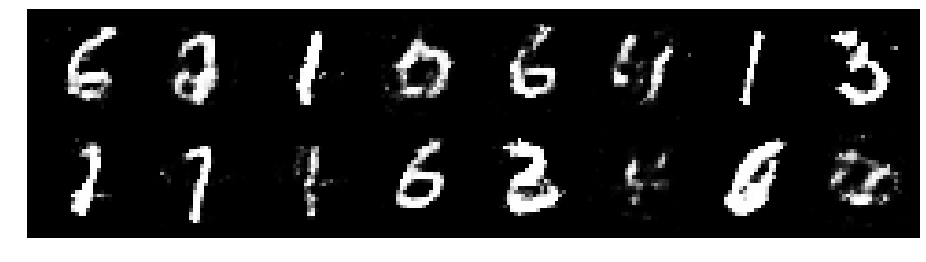

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2497, Generator Loss: 1.1275
D(x): 0.5765, D(G(z)): 0.4297


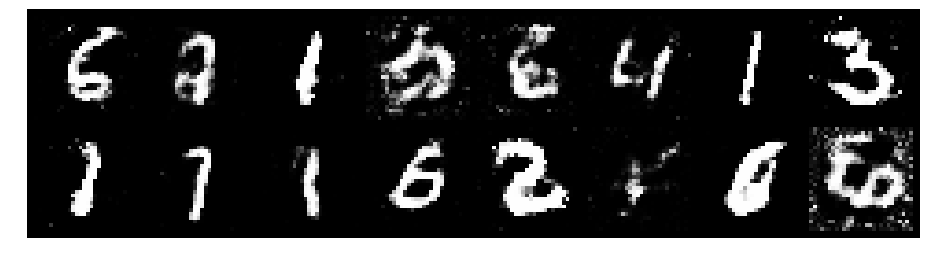

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.1659, Generator Loss: 1.0639
D(x): 0.5855, D(G(z)): 0.4079


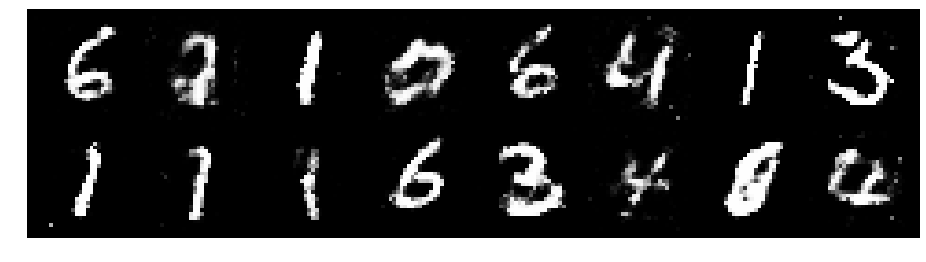

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.2193, Generator Loss: 0.9631
D(x): 0.5587, D(G(z)): 0.4258


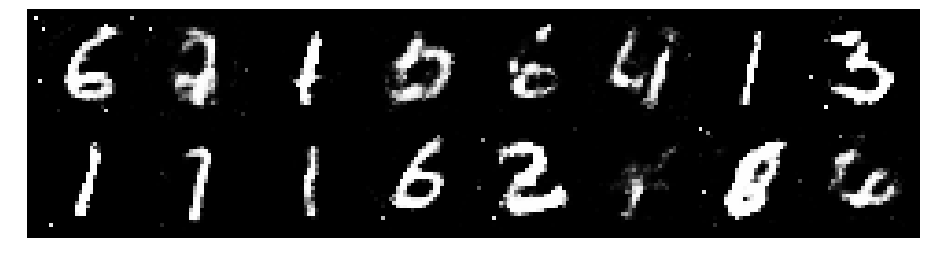

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2551, Generator Loss: 0.9033
D(x): 0.5615, D(G(z)): 0.4364


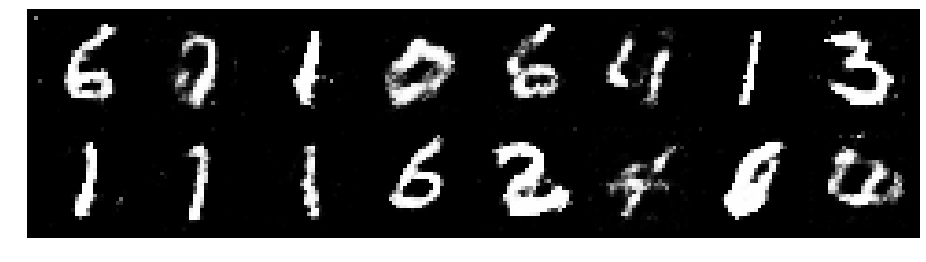

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3000, Generator Loss: 0.9004
D(x): 0.5511, D(G(z)): 0.4446


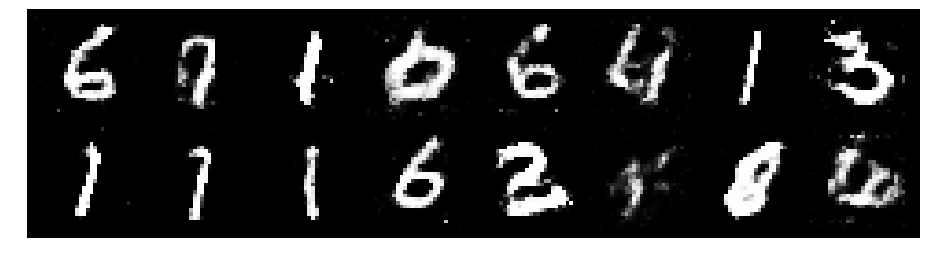

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3249, Generator Loss: 0.8222
D(x): 0.5649, D(G(z)): 0.4618


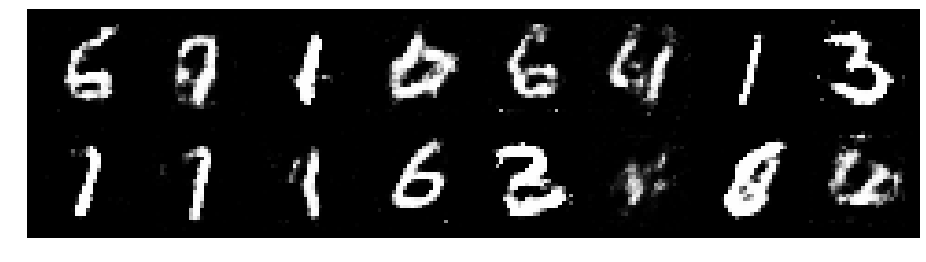

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.2442, Generator Loss: 0.9137
D(x): 0.6060, D(G(z)): 0.4676


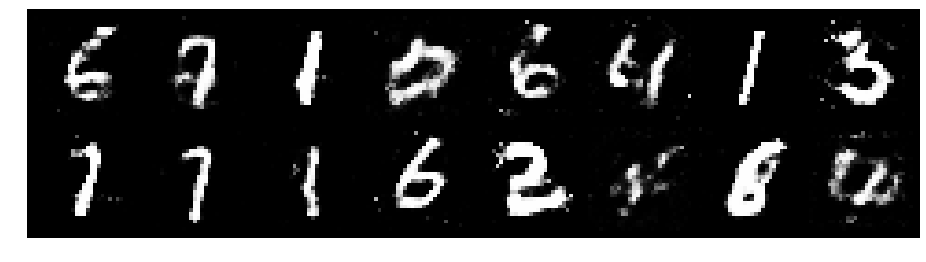

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3148, Generator Loss: 0.8949
D(x): 0.6066, D(G(z)): 0.4930


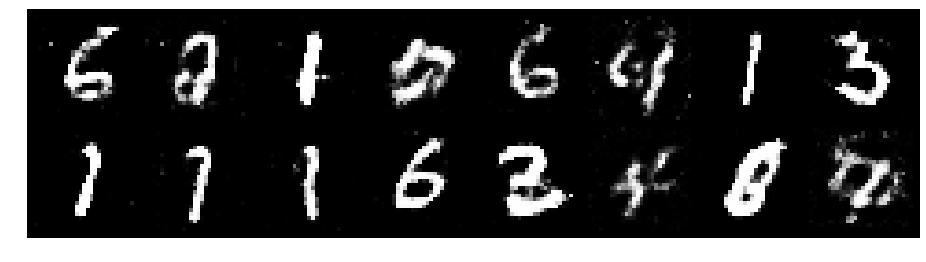

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2308, Generator Loss: 1.0189
D(x): 0.5836, D(G(z)): 0.4258


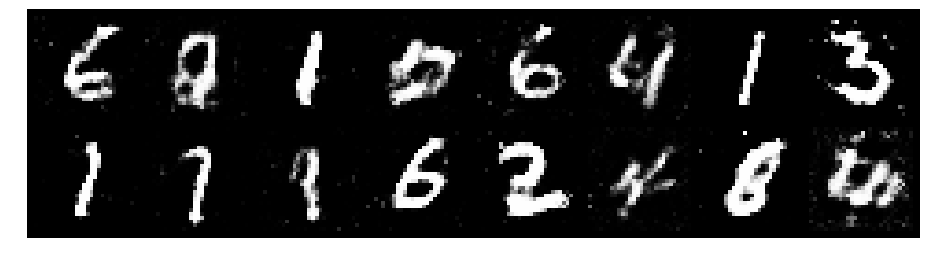

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2656, Generator Loss: 1.0750
D(x): 0.5441, D(G(z)): 0.3828


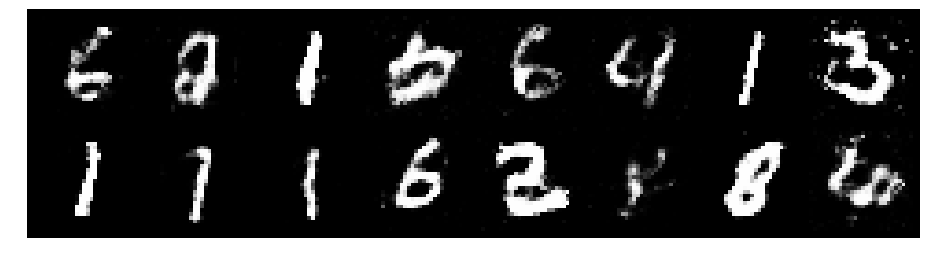

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.3431, Generator Loss: 0.8200
D(x): 0.5869, D(G(z)): 0.4987


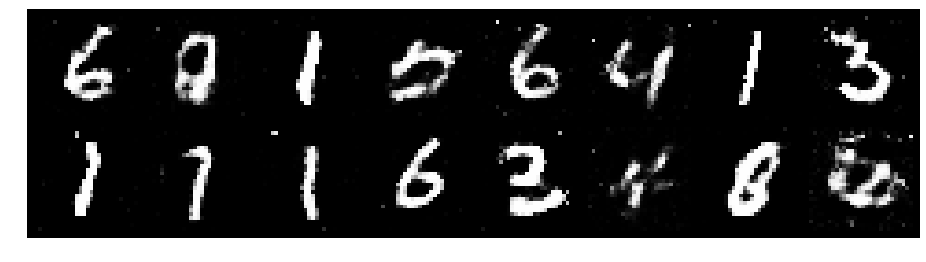

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.1905, Generator Loss: 0.8396
D(x): 0.5733, D(G(z)): 0.4283


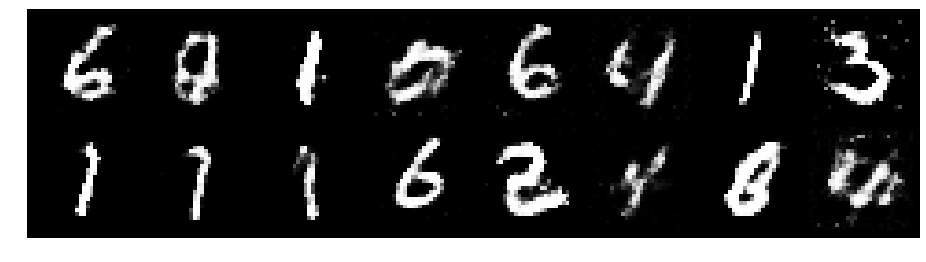

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2162, Generator Loss: 0.9434
D(x): 0.5663, D(G(z)): 0.4362


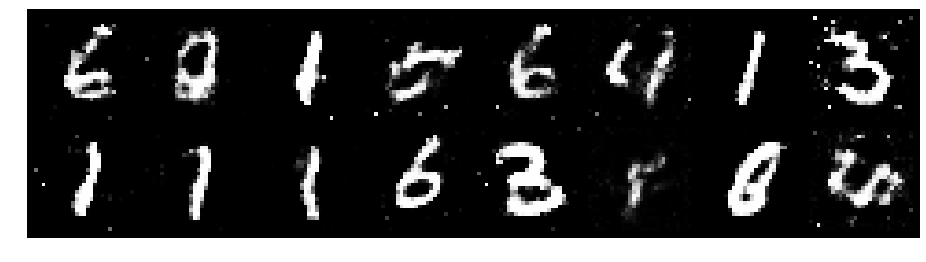

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9272
D(x): 0.5440, D(G(z)): 0.4225


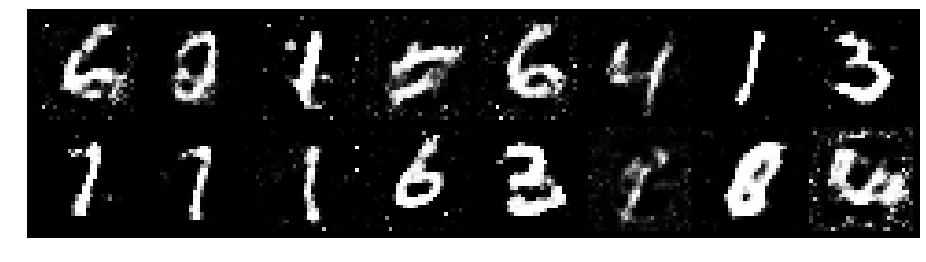

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3072, Generator Loss: 0.8137
D(x): 0.6027, D(G(z)): 0.4973


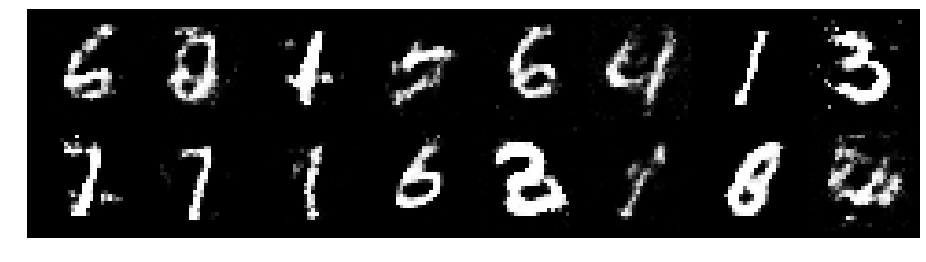

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8936
D(x): 0.5584, D(G(z)): 0.4490


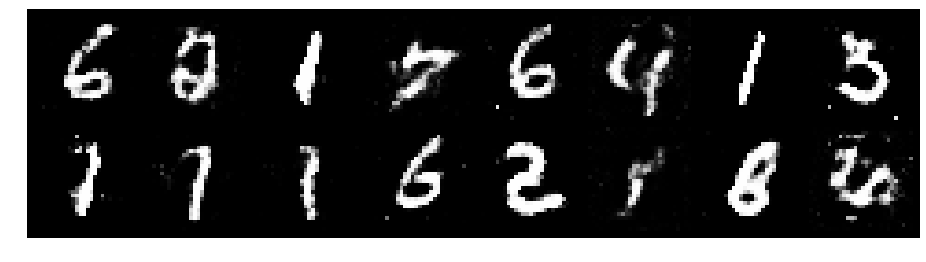

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2429, Generator Loss: 0.9166
D(x): 0.5726, D(G(z)): 0.4484


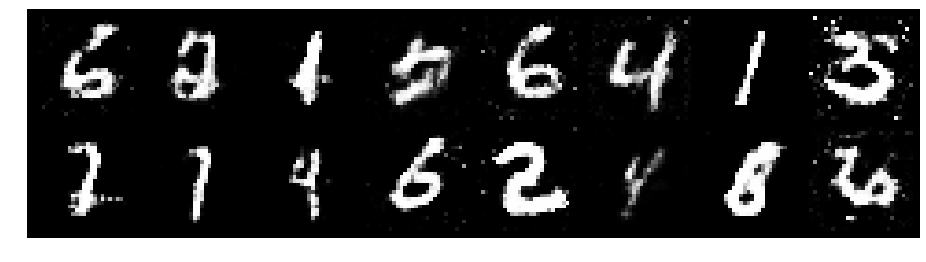

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2978, Generator Loss: 0.9107
D(x): 0.5560, D(G(z)): 0.4416


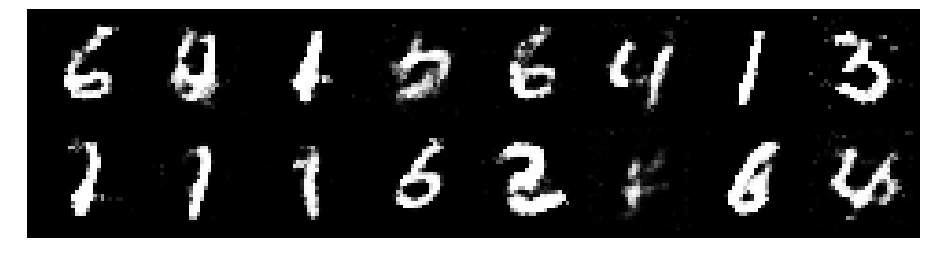

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.3867, Generator Loss: 0.9229
D(x): 0.5536, D(G(z)): 0.4735


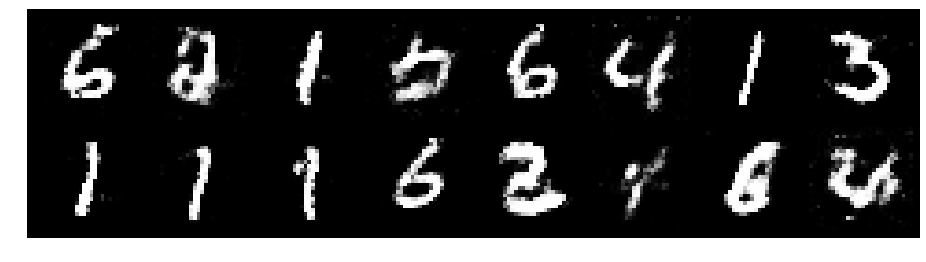

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2867, Generator Loss: 1.0022
D(x): 0.5739, D(G(z)): 0.4678


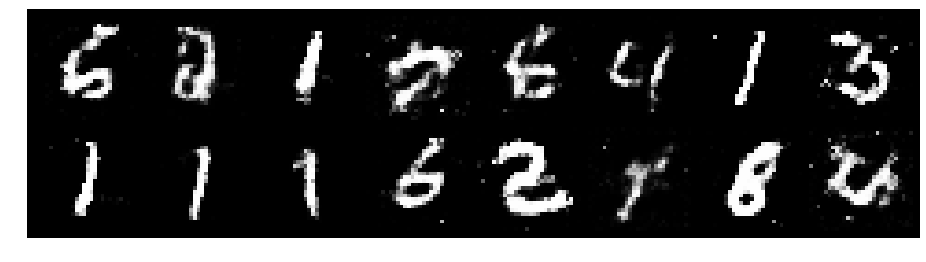

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3354, Generator Loss: 1.0330
D(x): 0.5476, D(G(z)): 0.4510


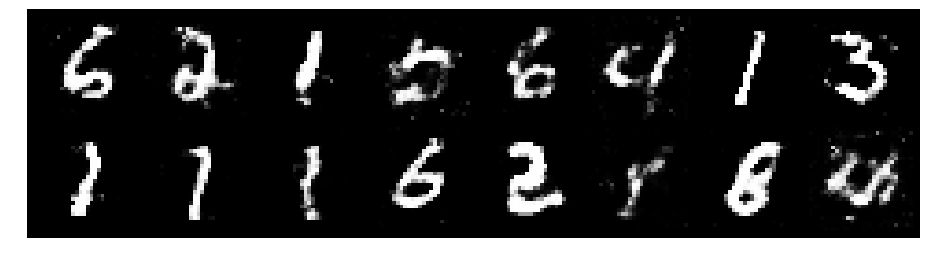

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3119, Generator Loss: 0.7942
D(x): 0.5542, D(G(z)): 0.4722


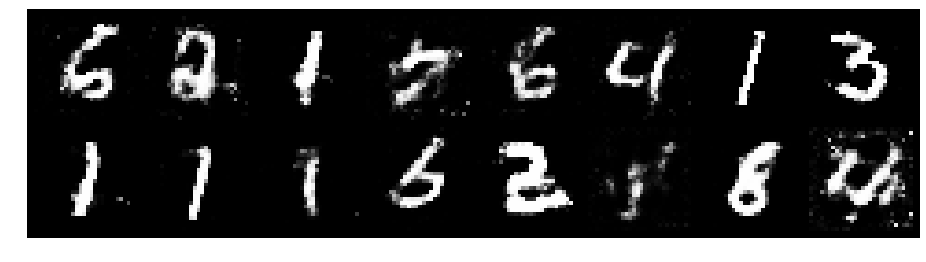

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2340, Generator Loss: 0.9777
D(x): 0.5970, D(G(z)): 0.4595


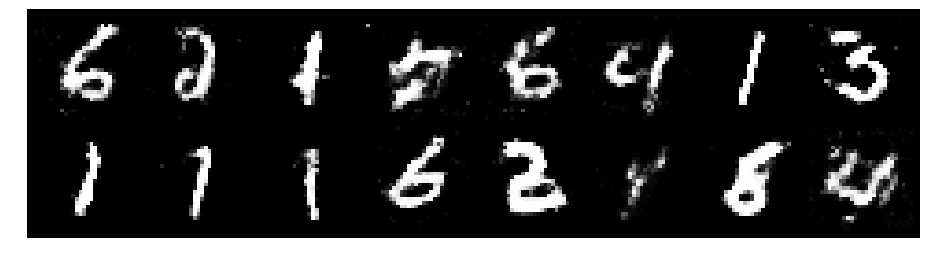

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.3425, Generator Loss: 0.8398
D(x): 0.5143, D(G(z)): 0.4428


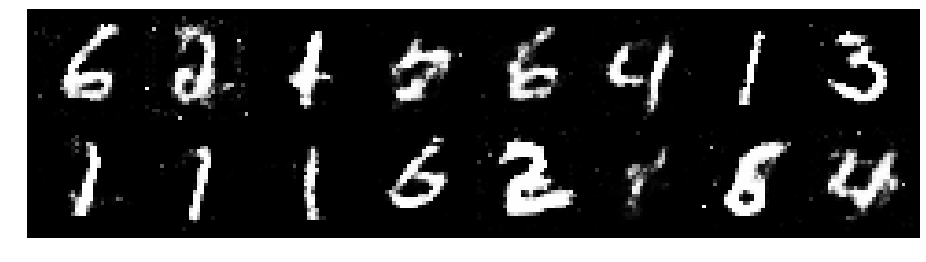

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.3929, Generator Loss: 0.9253
D(x): 0.5329, D(G(z)): 0.4728


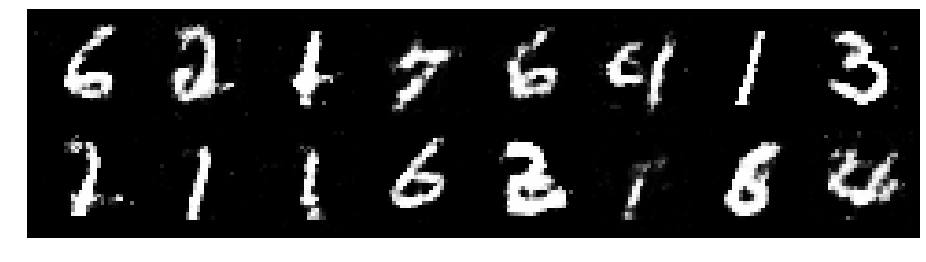

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2386, Generator Loss: 0.8940
D(x): 0.5791, D(G(z)): 0.4534


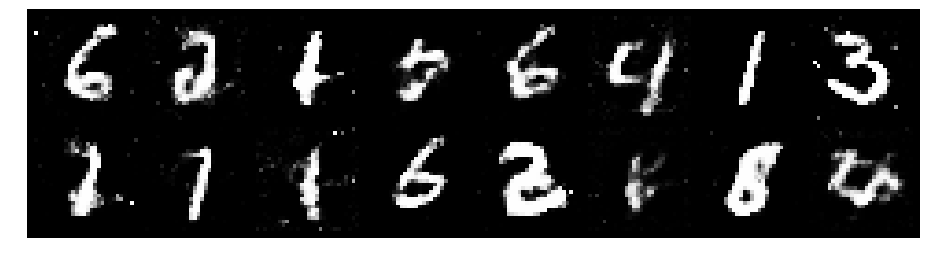

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3209, Generator Loss: 1.1324
D(x): 0.5418, D(G(z)): 0.4041


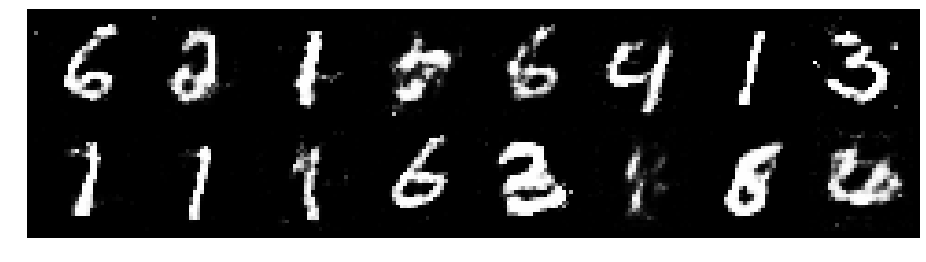

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2235, Generator Loss: 0.9258
D(x): 0.5726, D(G(z)): 0.4329


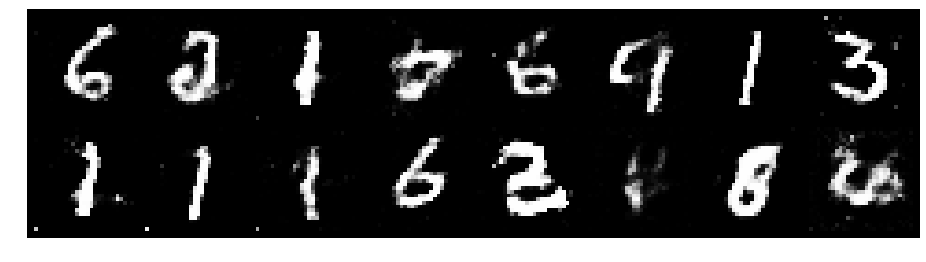

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.2671, Generator Loss: 0.8355
D(x): 0.5805, D(G(z)): 0.4507


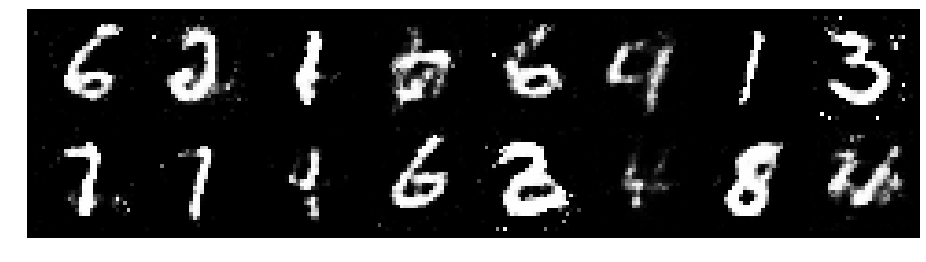

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2418, Generator Loss: 0.9437
D(x): 0.5383, D(G(z)): 0.4037


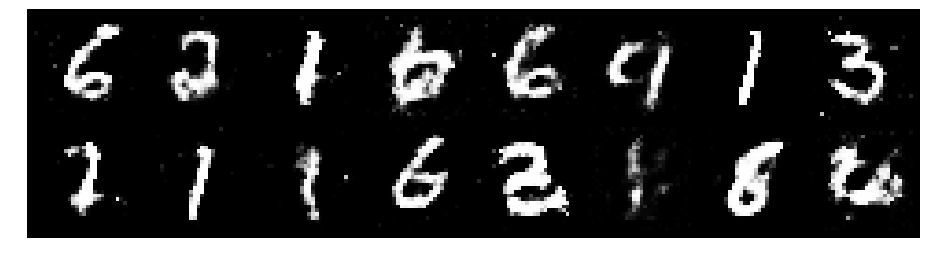

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2198, Generator Loss: 0.9536
D(x): 0.6080, D(G(z)): 0.4788


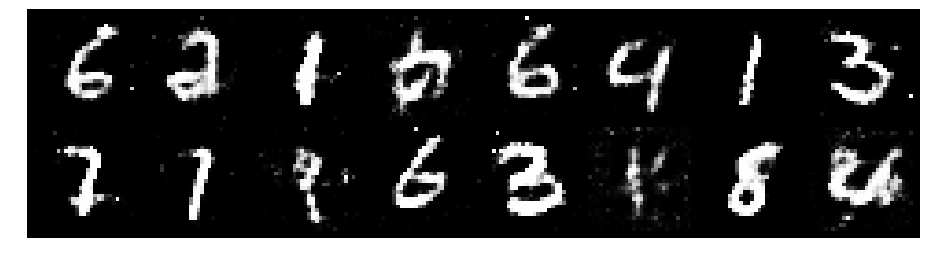

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2406, Generator Loss: 0.8138
D(x): 0.5487, D(G(z)): 0.4380


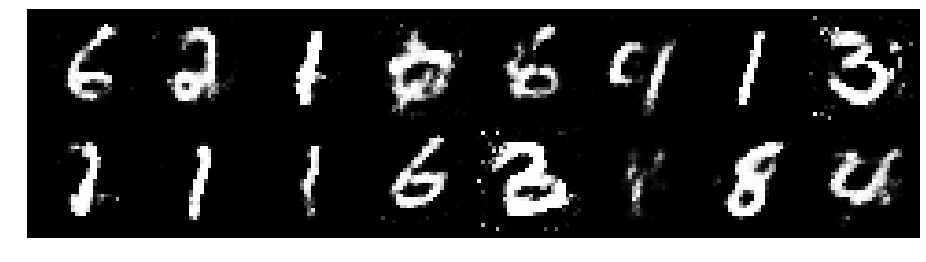

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.3348, Generator Loss: 0.8468
D(x): 0.5229, D(G(z)): 0.4655


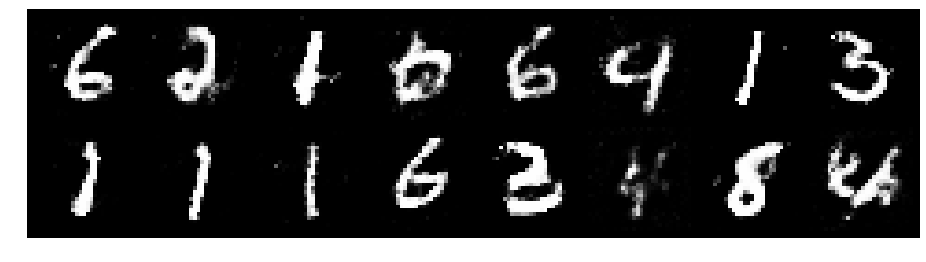

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2566, Generator Loss: 0.9747
D(x): 0.5407, D(G(z)): 0.4304


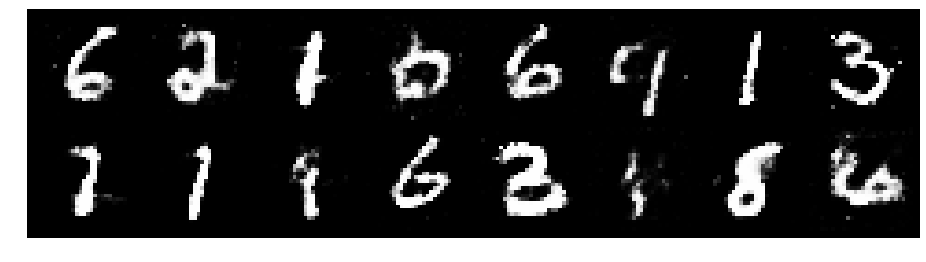

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2520, Generator Loss: 0.8120
D(x): 0.5698, D(G(z)): 0.4436


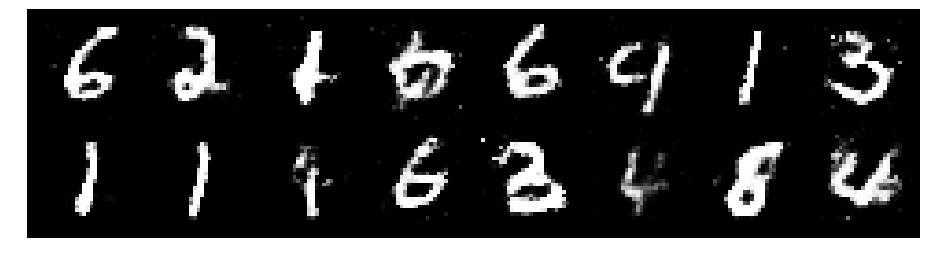

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2934, Generator Loss: 0.9952
D(x): 0.5247, D(G(z)): 0.4057


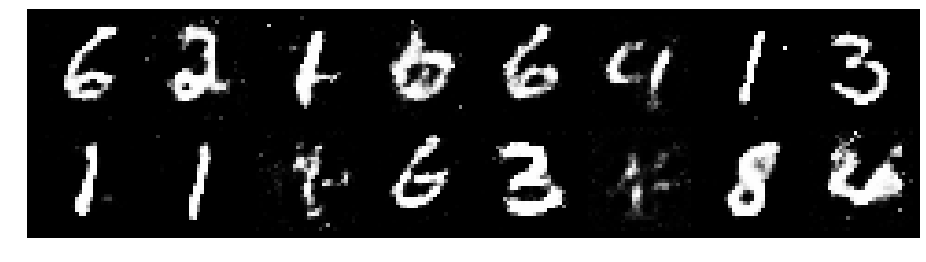

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1980, Generator Loss: 0.9361
D(x): 0.5730, D(G(z)): 0.4213


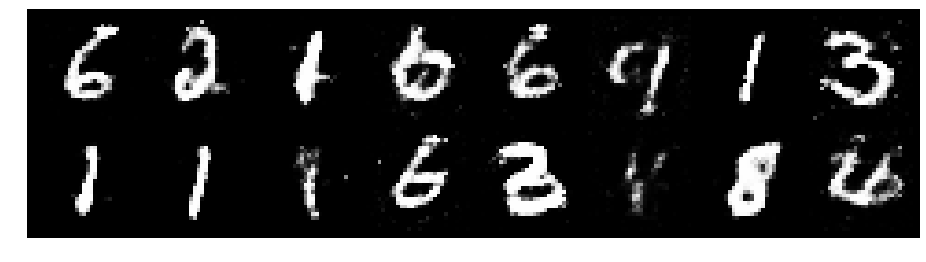

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2579, Generator Loss: 0.9527
D(x): 0.5944, D(G(z)): 0.4624


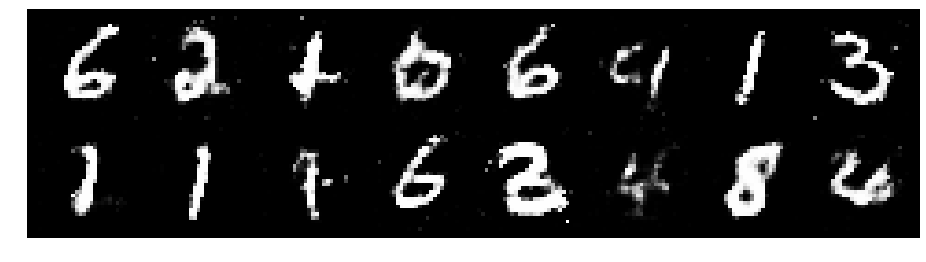

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2401, Generator Loss: 0.9874
D(x): 0.5216, D(G(z)): 0.4140


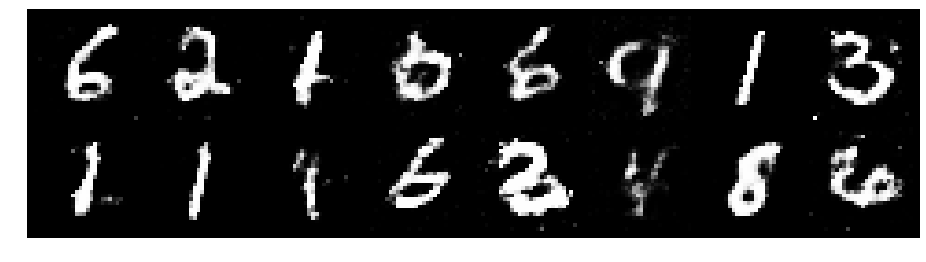

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2669, Generator Loss: 0.8706
D(x): 0.5460, D(G(z)): 0.4485


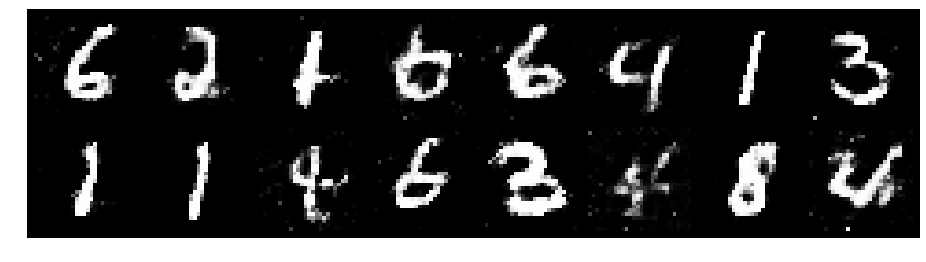

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.2229, Generator Loss: 0.9177
D(x): 0.5623, D(G(z)): 0.4257


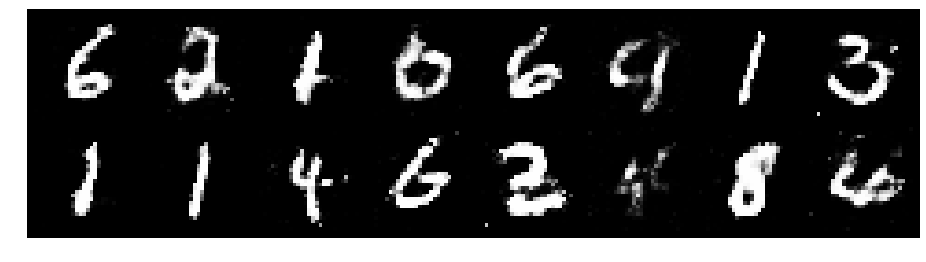

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2421, Generator Loss: 0.9495
D(x): 0.5228, D(G(z)): 0.4065


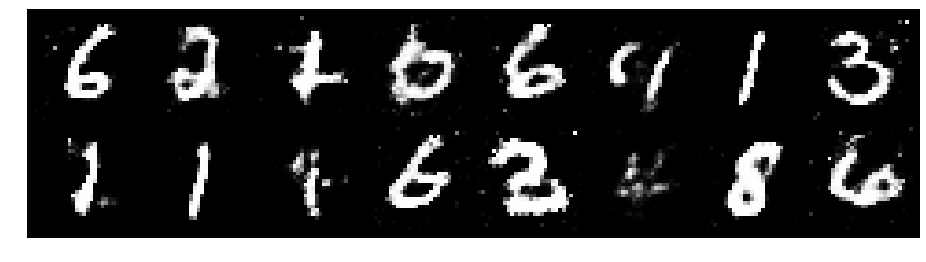

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2501, Generator Loss: 0.8350
D(x): 0.5627, D(G(z)): 0.4274


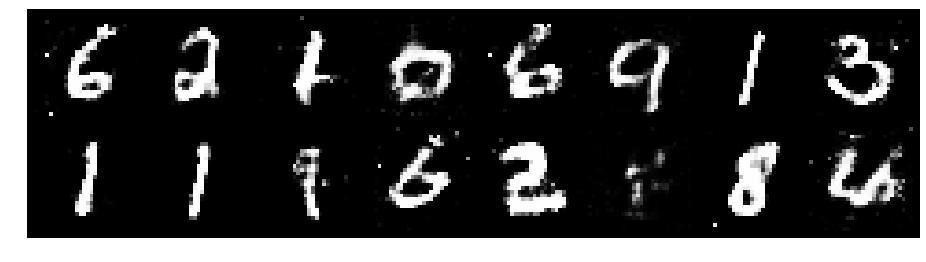

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2240, Generator Loss: 0.8036
D(x): 0.5938, D(G(z)): 0.4542


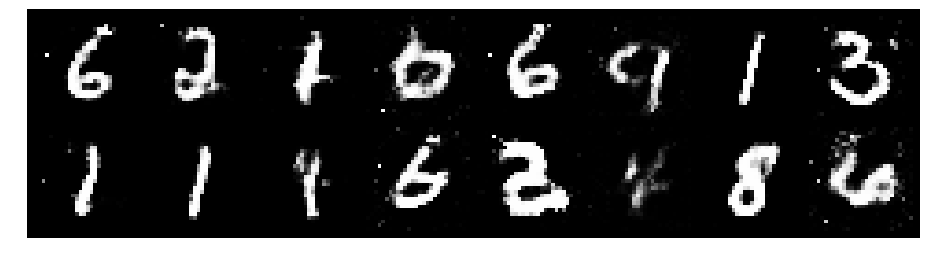

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.2710, Generator Loss: 0.8733
D(x): 0.5556, D(G(z)): 0.4405


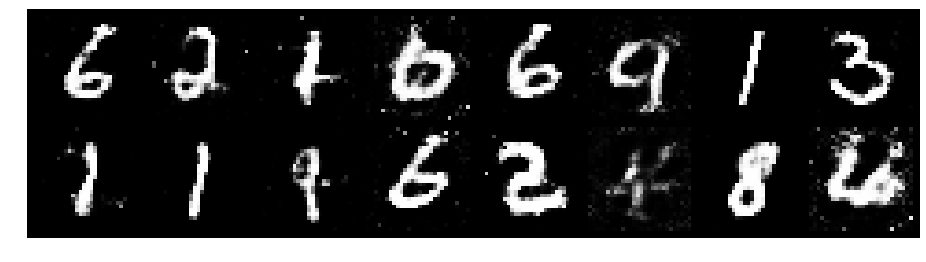

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9146
D(x): 0.6006, D(G(z)): 0.4607


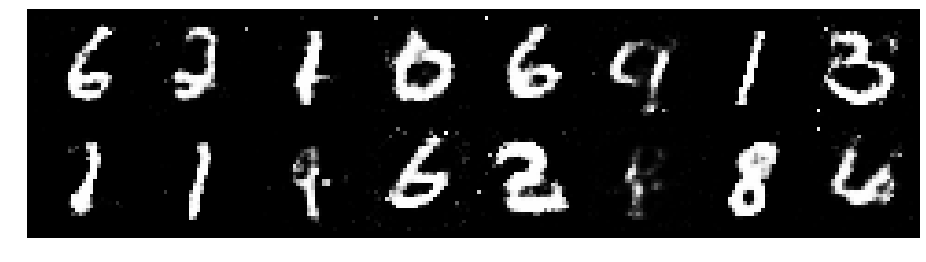

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2409, Generator Loss: 0.9119
D(x): 0.5694, D(G(z)): 0.4475


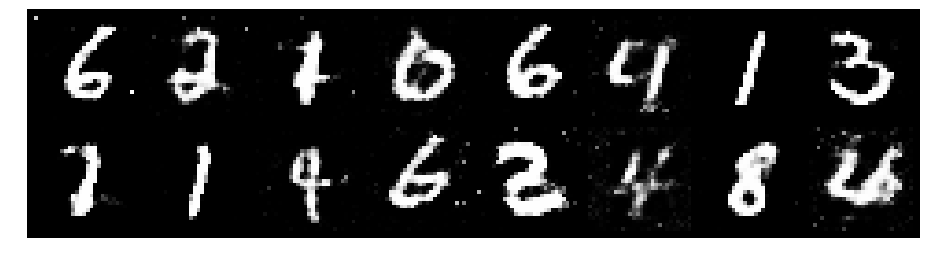

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.3450, Generator Loss: 0.8151
D(x): 0.5420, D(G(z)): 0.4761


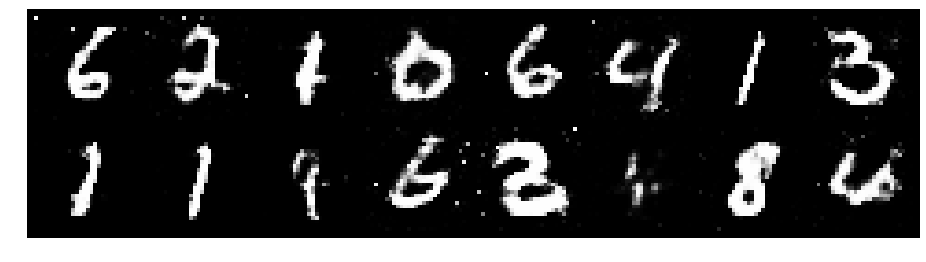

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.3058, Generator Loss: 0.8796
D(x): 0.5717, D(G(z)): 0.4801


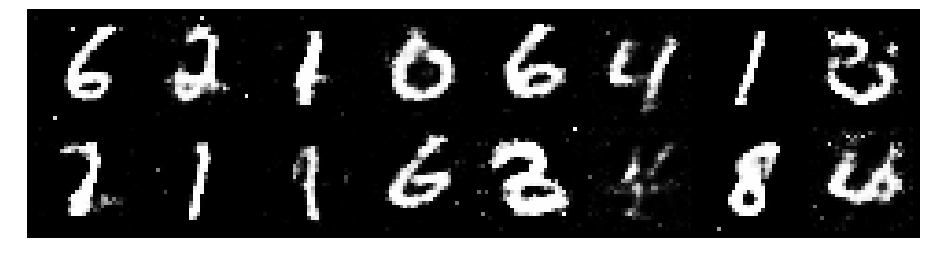

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.4392, Generator Loss: 0.7188
D(x): 0.5820, D(G(z)): 0.5385


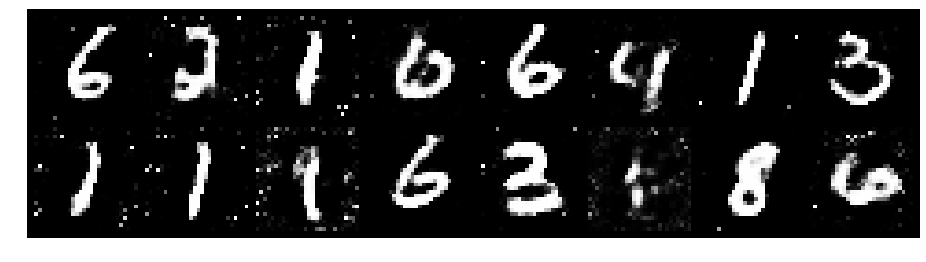

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8296
D(x): 0.5974, D(G(z)): 0.4770


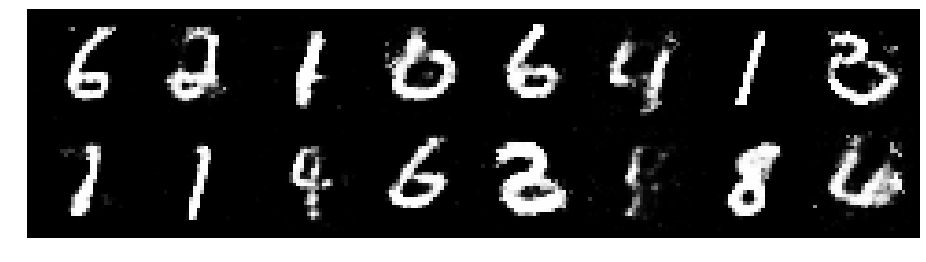

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2973, Generator Loss: 0.8059
D(x): 0.5300, D(G(z)): 0.4553


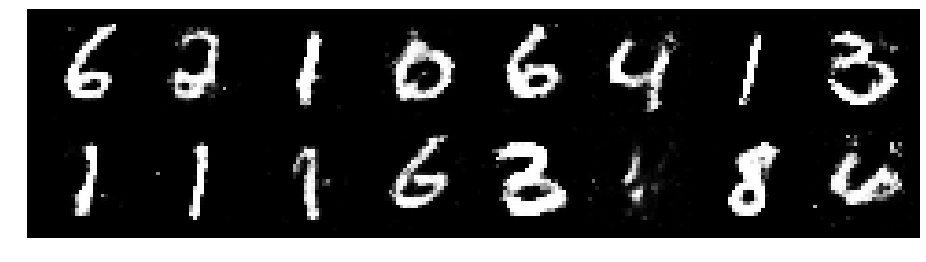

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2026, Generator Loss: 0.8809
D(x): 0.6030, D(G(z)): 0.4571


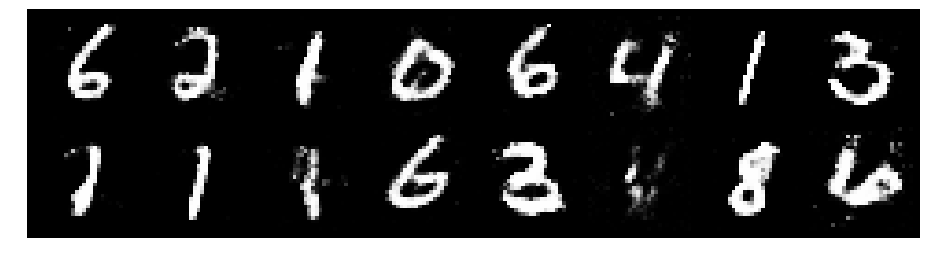

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2653, Generator Loss: 1.0033
D(x): 0.5315, D(G(z)): 0.4227


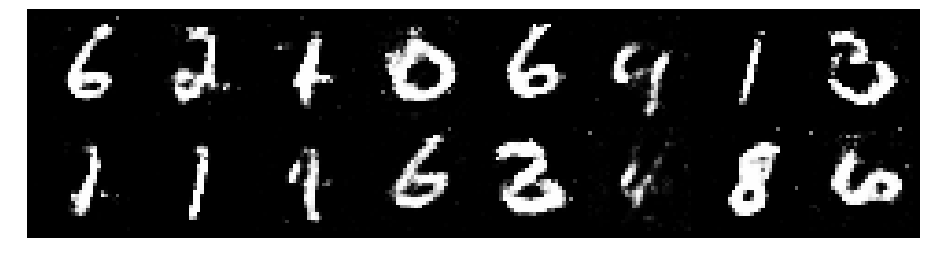

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8679
D(x): 0.5810, D(G(z)): 0.4441


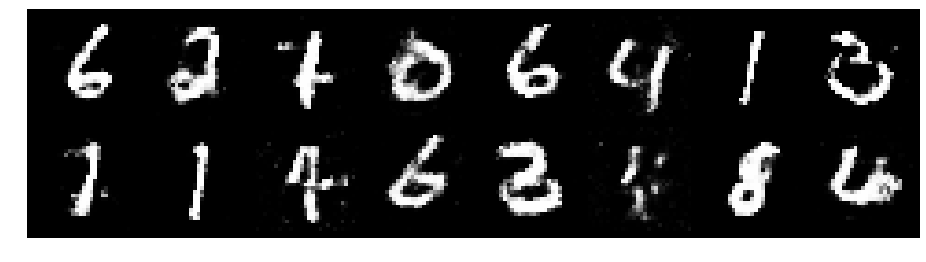

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3813, Generator Loss: 0.9084
D(x): 0.5449, D(G(z)): 0.4788


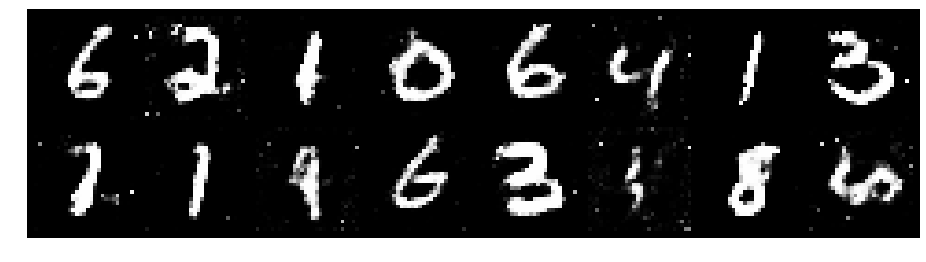

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2912, Generator Loss: 0.9994
D(x): 0.5452, D(G(z)): 0.4323


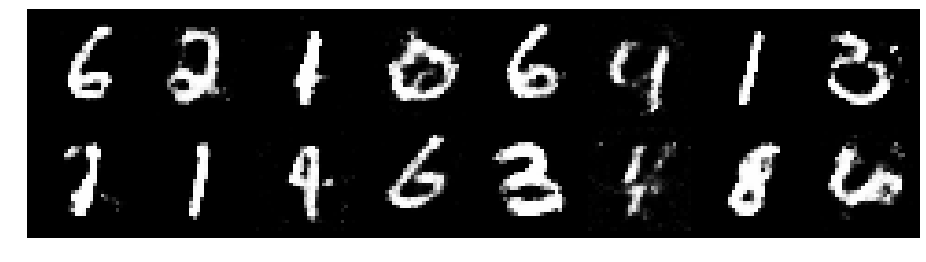

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2654, Generator Loss: 0.9362
D(x): 0.5547, D(G(z)): 0.4367


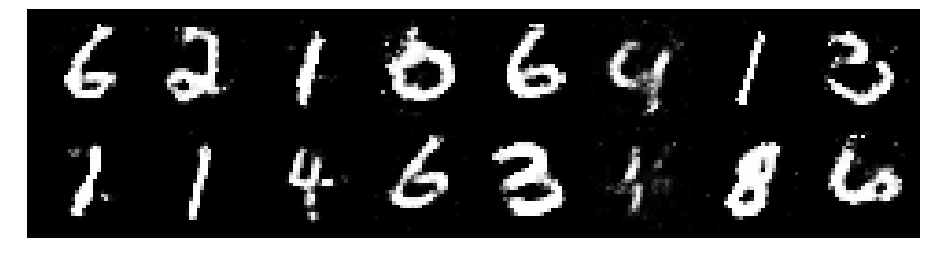

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.1469, Generator Loss: 1.0294
D(x): 0.6281, D(G(z)): 0.4372


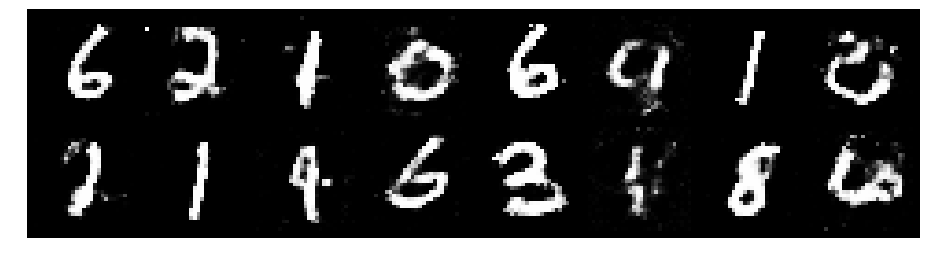

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2358, Generator Loss: 0.9102
D(x): 0.5480, D(G(z)): 0.4234


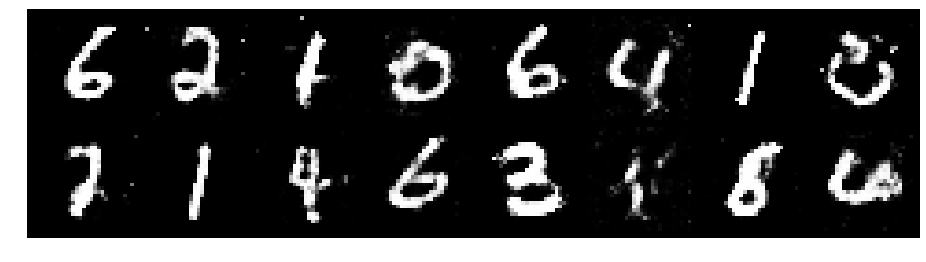

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.1860, Generator Loss: 0.9130
D(x): 0.5773, D(G(z)): 0.4149


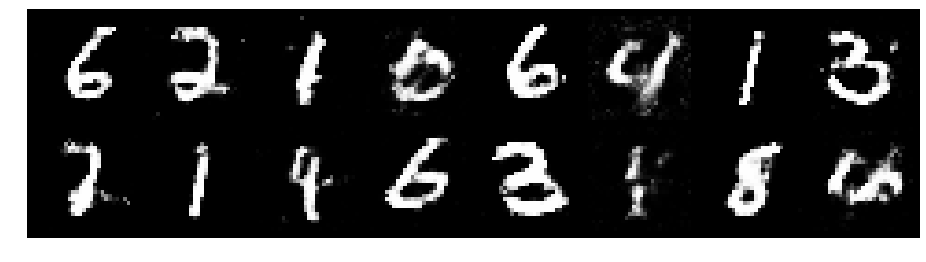

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.3655, Generator Loss: 0.9560
D(x): 0.5390, D(G(z)): 0.4563


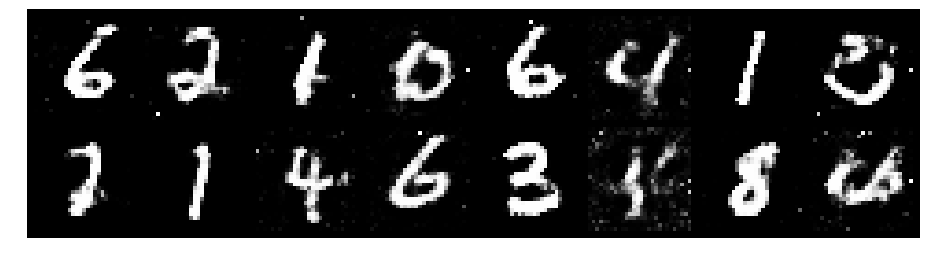

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8319
D(x): 0.5844, D(G(z)): 0.4576


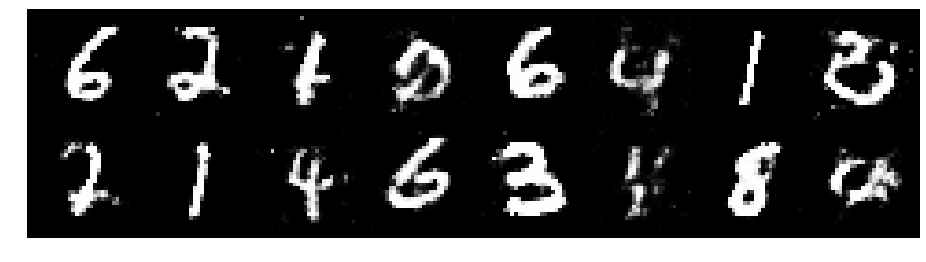

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.3782, Generator Loss: 0.8818
D(x): 0.5696, D(G(z)): 0.4949


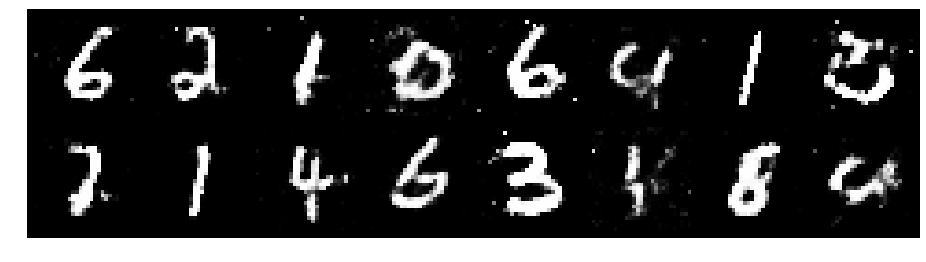

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.3094, Generator Loss: 0.9295
D(x): 0.5357, D(G(z)): 0.4148


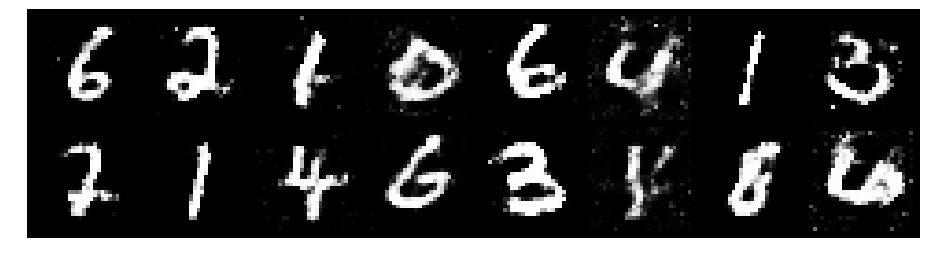

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2571, Generator Loss: 0.8205
D(x): 0.5763, D(G(z)): 0.4665


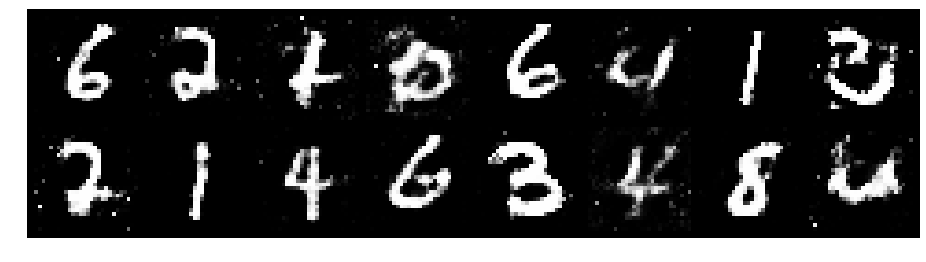

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8679
D(x): 0.5356, D(G(z)): 0.4520


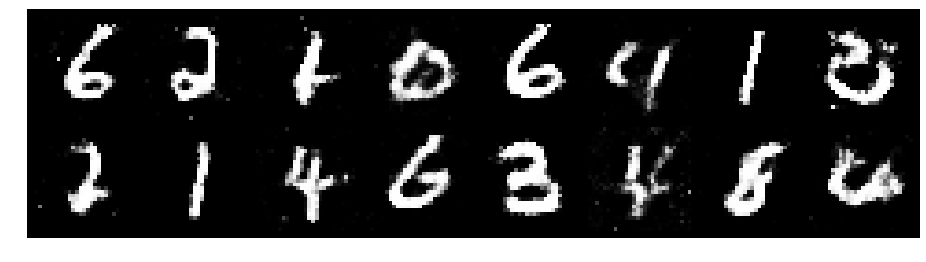

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2390, Generator Loss: 0.8630
D(x): 0.6016, D(G(z)): 0.4596


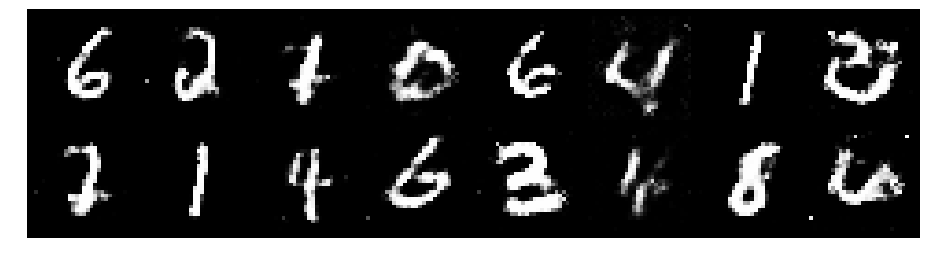

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2541, Generator Loss: 0.9481
D(x): 0.5803, D(G(z)): 0.4562


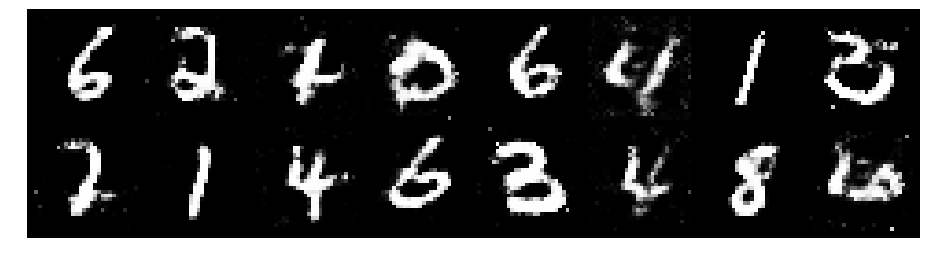

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2554, Generator Loss: 1.0351
D(x): 0.5453, D(G(z)): 0.4305


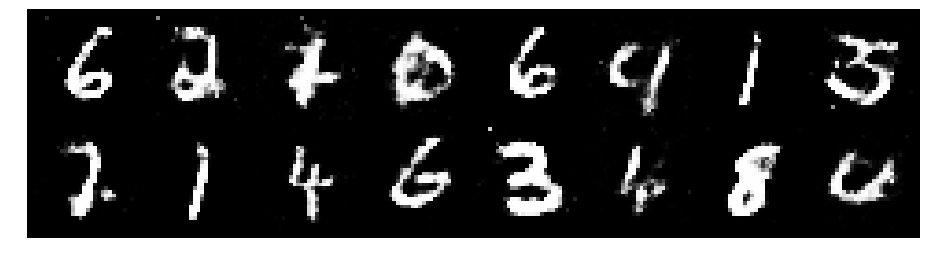

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.3060, Generator Loss: 0.9171
D(x): 0.5731, D(G(z)): 0.4563


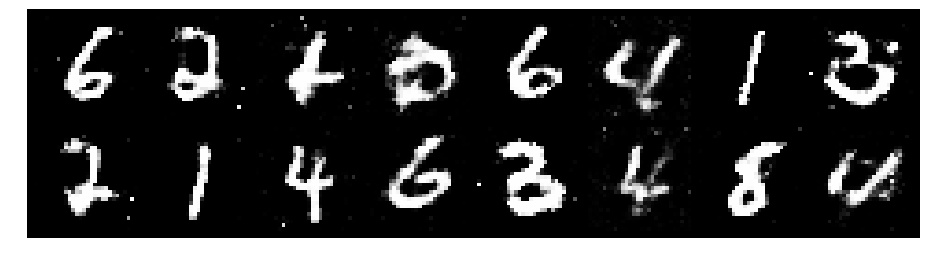

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9437
D(x): 0.6258, D(G(z)): 0.4771


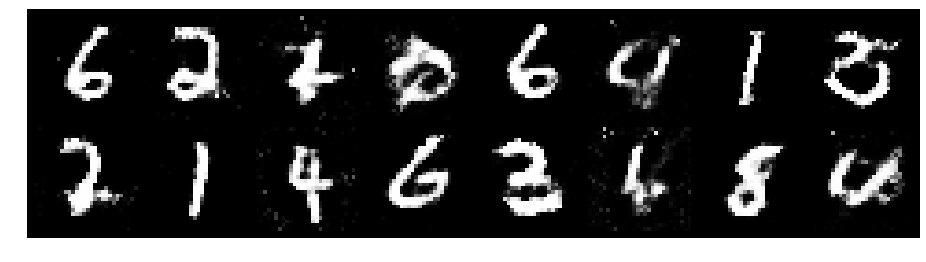

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3343, Generator Loss: 0.8285
D(x): 0.5324, D(G(z)): 0.4412


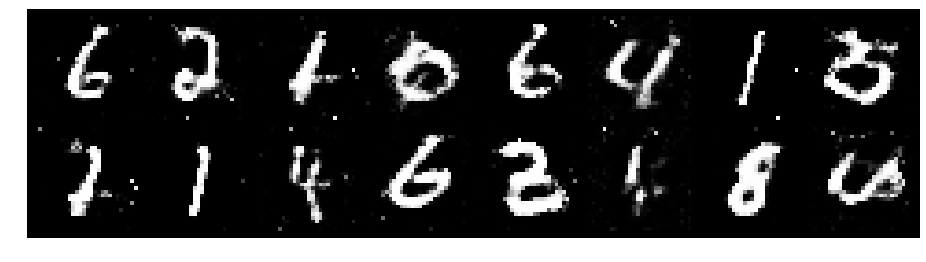

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2275, Generator Loss: 0.8879
D(x): 0.6011, D(G(z)): 0.4543


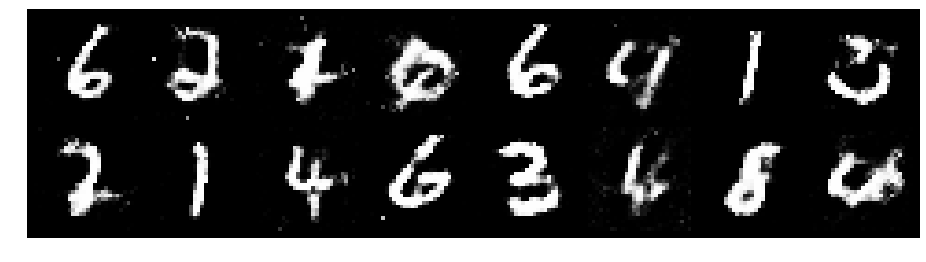

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3590, Generator Loss: 0.7506
D(x): 0.5618, D(G(z)): 0.4839


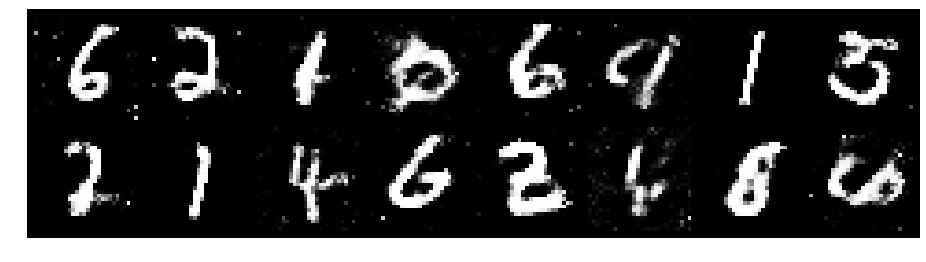

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2824, Generator Loss: 1.0507
D(x): 0.5471, D(G(z)): 0.3988


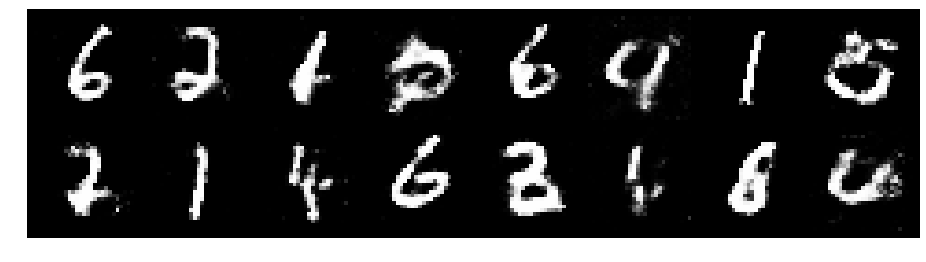

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2120, Generator Loss: 1.1135
D(x): 0.5662, D(G(z)): 0.3934


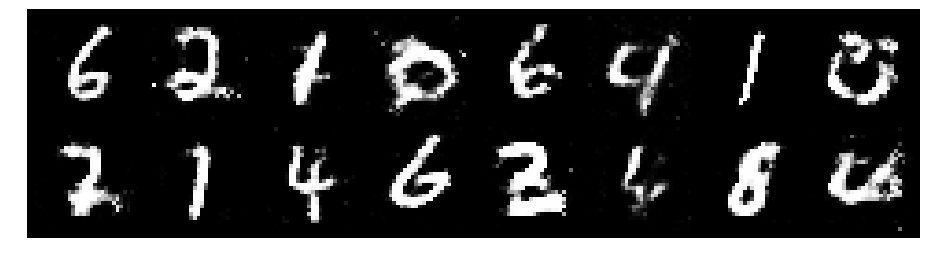

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2124, Generator Loss: 0.9550
D(x): 0.5987, D(G(z)): 0.4278


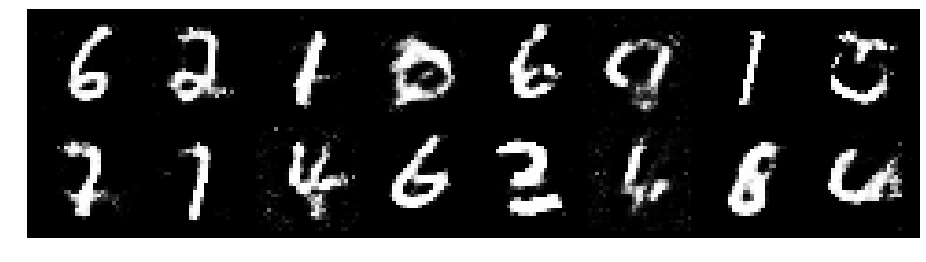

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.1768, Generator Loss: 0.9400
D(x): 0.5852, D(G(z)): 0.4161


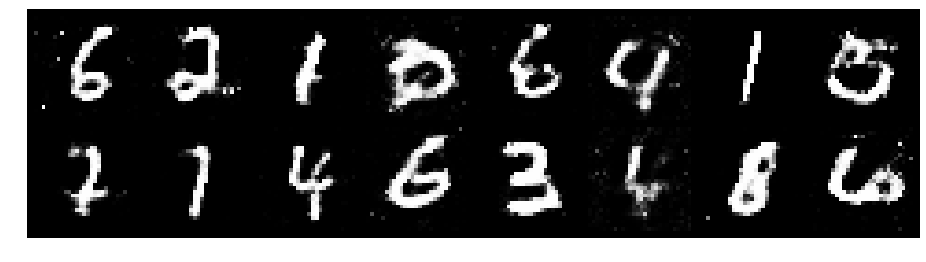

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.3590, Generator Loss: 1.0604
D(x): 0.5538, D(G(z)): 0.4487


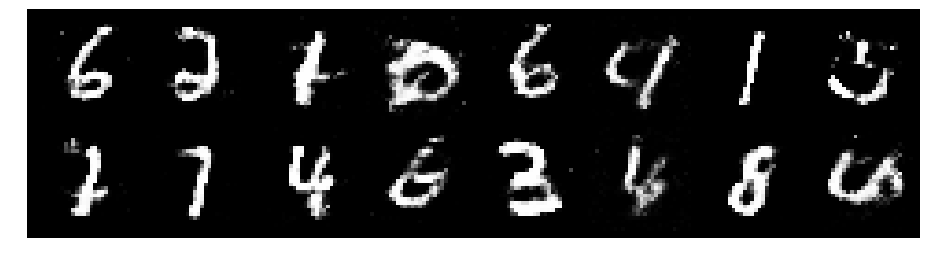

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2884, Generator Loss: 1.0703
D(x): 0.5558, D(G(z)): 0.4485


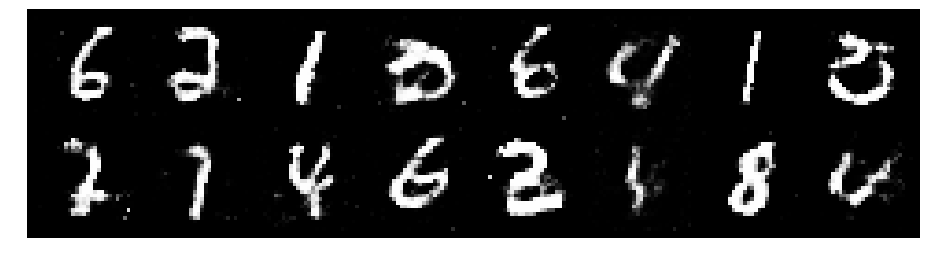

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3357, Generator Loss: 0.8466
D(x): 0.5432, D(G(z)): 0.4586


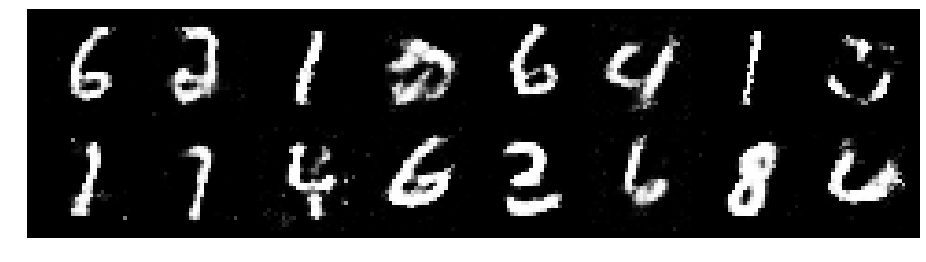

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9063
D(x): 0.5903, D(G(z)): 0.4435


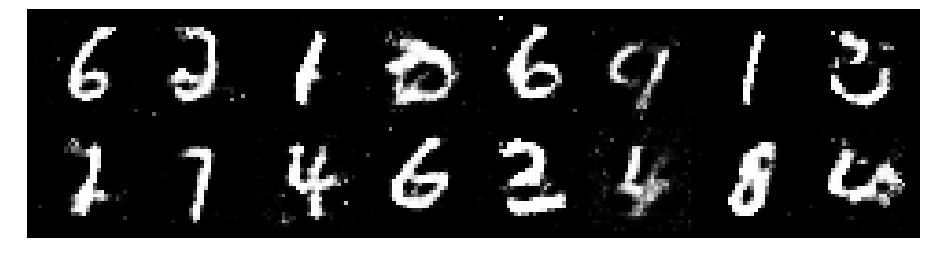

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3911, Generator Loss: 0.8185
D(x): 0.5508, D(G(z)): 0.4971


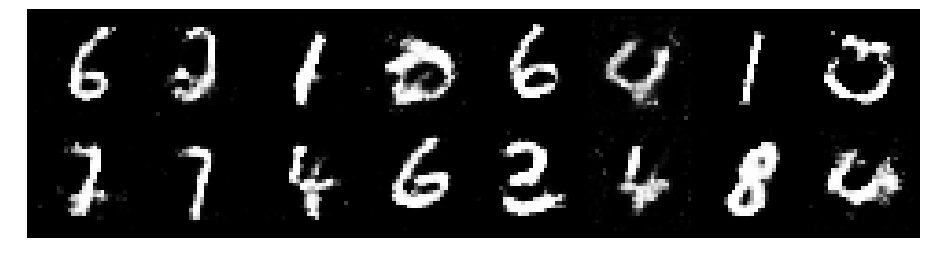

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2199, Generator Loss: 0.9750
D(x): 0.5751, D(G(z)): 0.4243


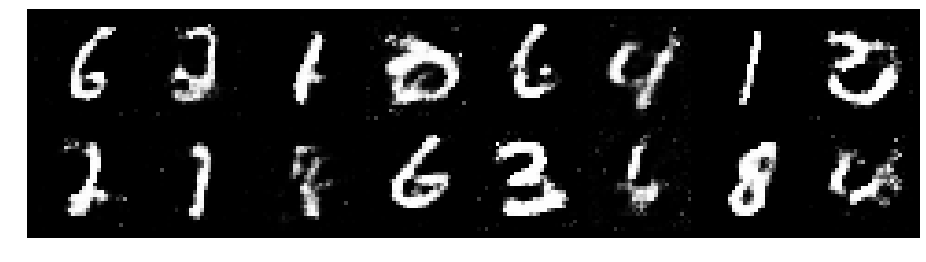

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2800, Generator Loss: 0.9318
D(x): 0.5915, D(G(z)): 0.4673


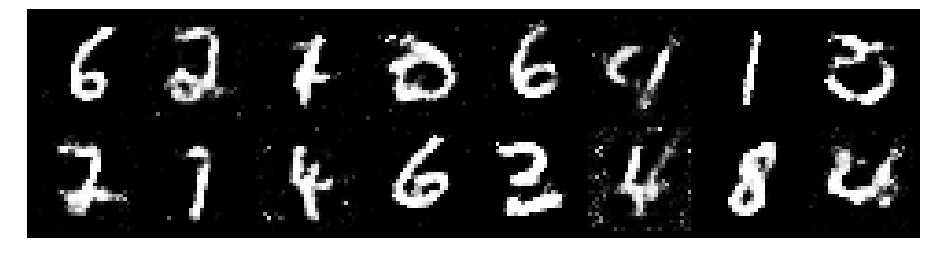

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2271, Generator Loss: 0.8877
D(x): 0.5628, D(G(z)): 0.4301


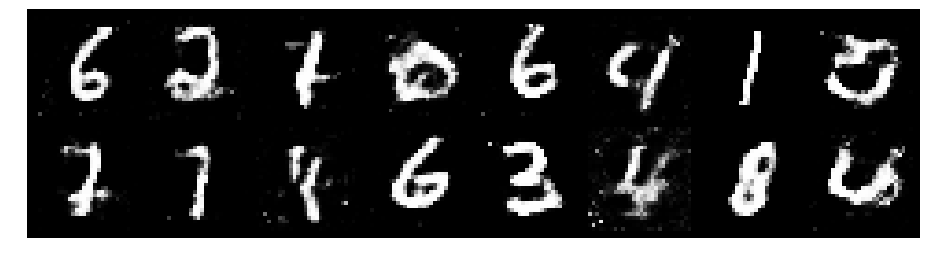

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2108, Generator Loss: 0.9548
D(x): 0.5853, D(G(z)): 0.4450


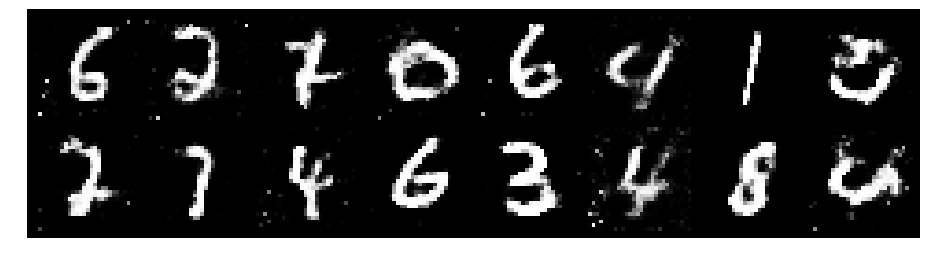

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2149, Generator Loss: 1.1536
D(x): 0.5398, D(G(z)): 0.3944


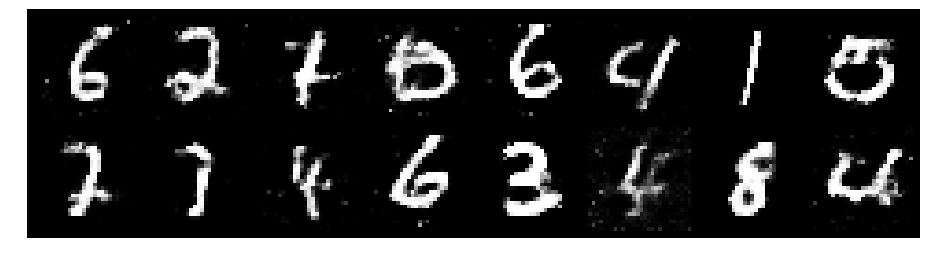

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.1811, Generator Loss: 1.0705
D(x): 0.5926, D(G(z)): 0.4259


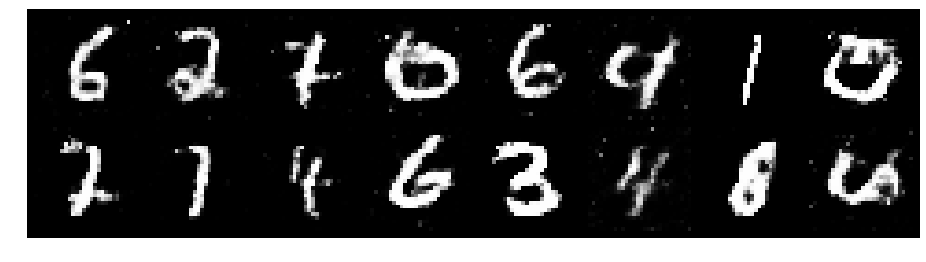

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.2706, Generator Loss: 0.9161
D(x): 0.5806, D(G(z)): 0.4619


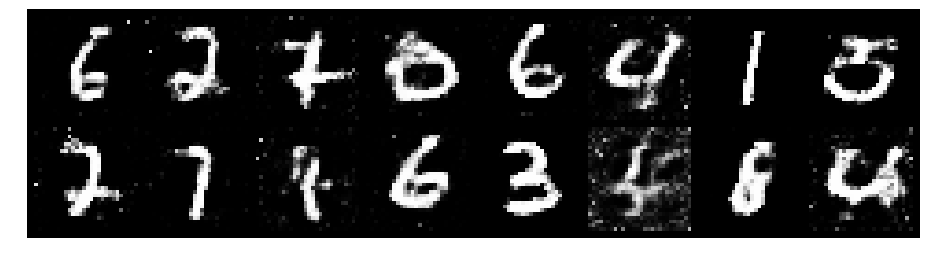

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2882, Generator Loss: 0.9352
D(x): 0.5798, D(G(z)): 0.4712


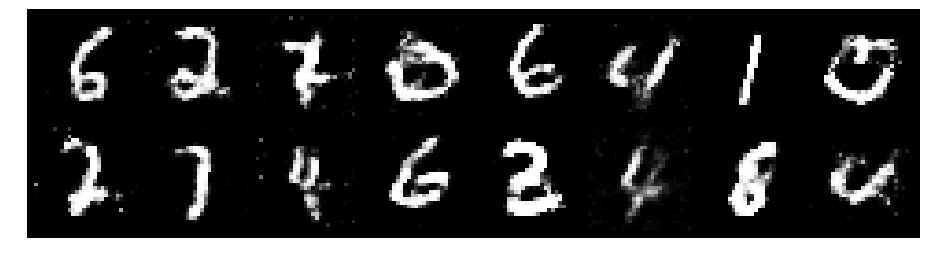

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3172, Generator Loss: 0.8277
D(x): 0.5193, D(G(z)): 0.4367


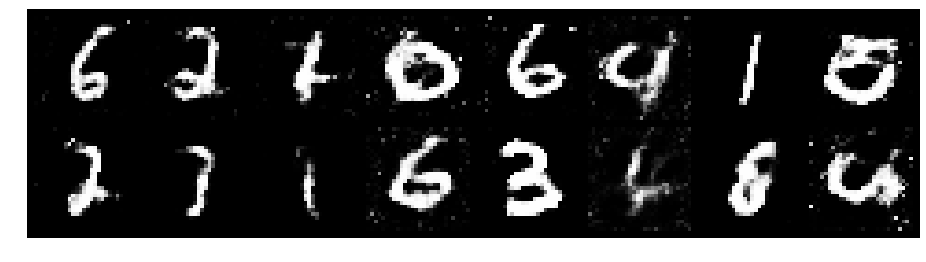

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2168, Generator Loss: 0.7912
D(x): 0.5854, D(G(z)): 0.4600


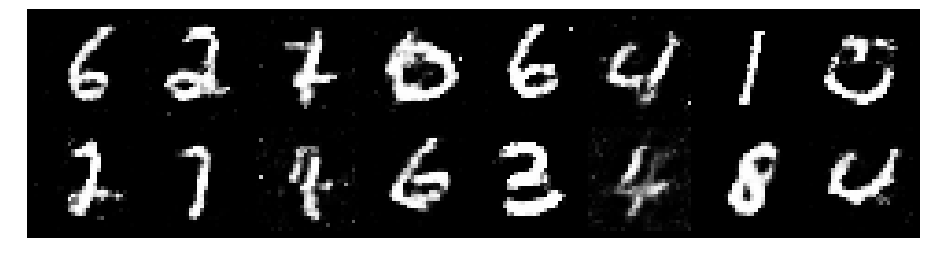

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.1752, Generator Loss: 0.9158
D(x): 0.5815, D(G(z)): 0.4270


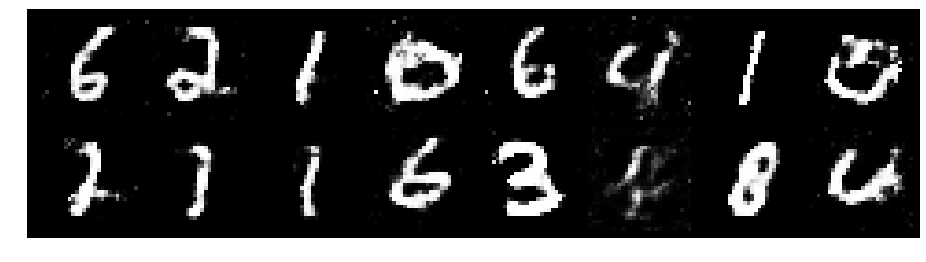

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.1504, Generator Loss: 1.0075
D(x): 0.5788, D(G(z)): 0.3908


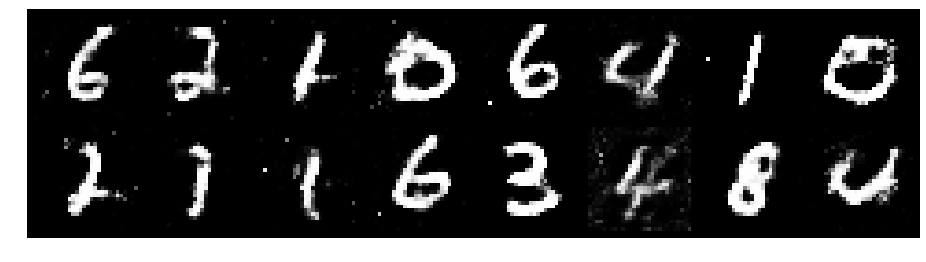

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2488, Generator Loss: 0.9722
D(x): 0.5544, D(G(z)): 0.4365


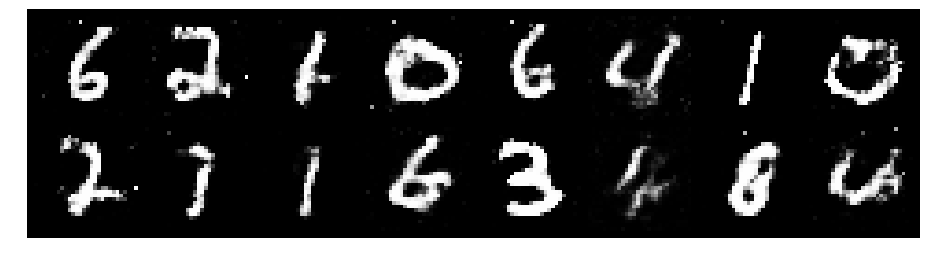

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2219, Generator Loss: 0.9226
D(x): 0.5654, D(G(z)): 0.4424


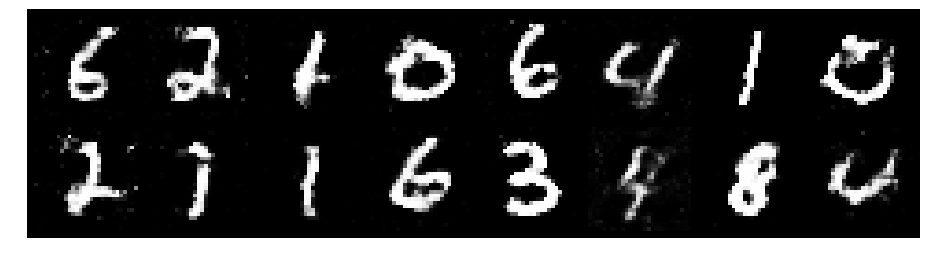

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2376, Generator Loss: 0.9928
D(x): 0.5663, D(G(z)): 0.4193


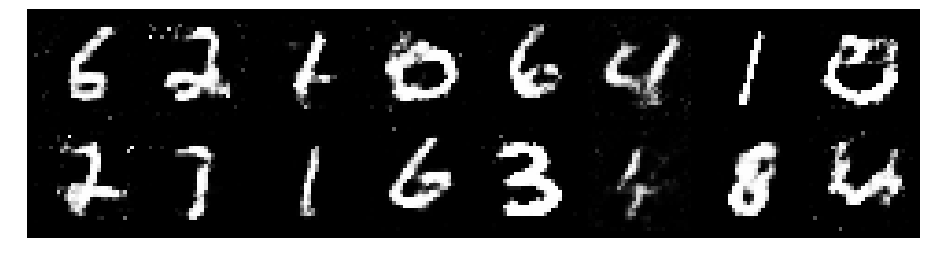

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2442, Generator Loss: 0.9867
D(x): 0.5593, D(G(z)): 0.4108


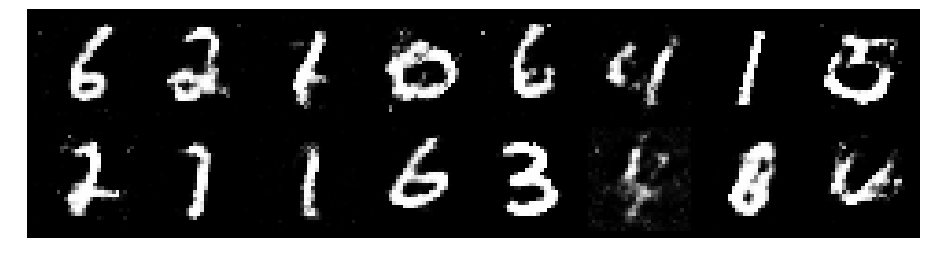

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1378, Generator Loss: 1.0130
D(x): 0.5925, D(G(z)): 0.3969


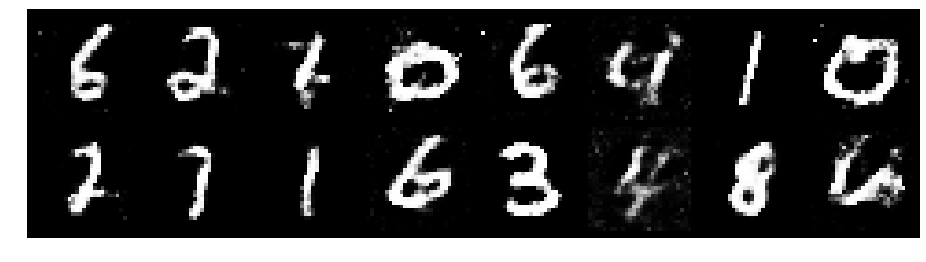

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2242, Generator Loss: 0.9561
D(x): 0.5432, D(G(z)): 0.3930


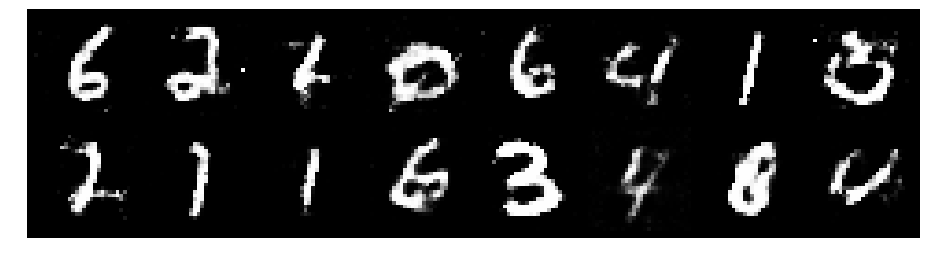

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2414, Generator Loss: 0.9721
D(x): 0.5719, D(G(z)): 0.4498


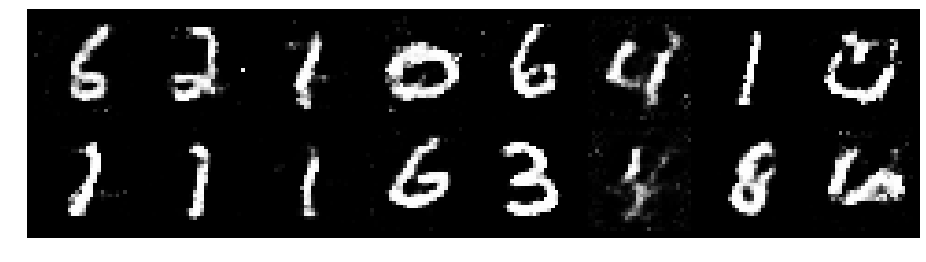

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8932
D(x): 0.5718, D(G(z)): 0.4663


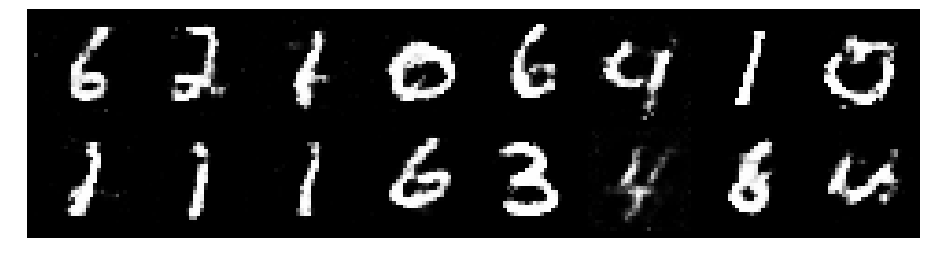

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2281, Generator Loss: 0.9249
D(x): 0.6011, D(G(z)): 0.4604


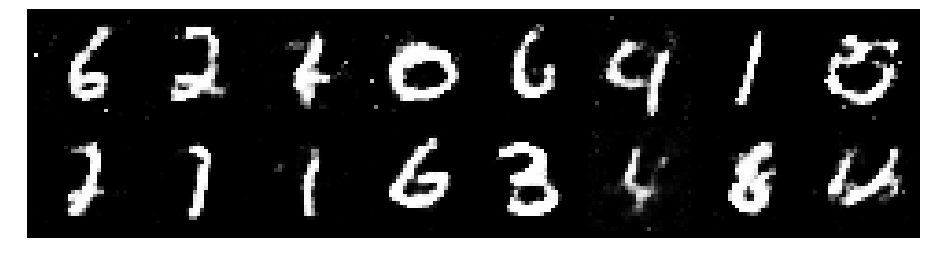

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2592, Generator Loss: 0.8493
D(x): 0.5441, D(G(z)): 0.4391


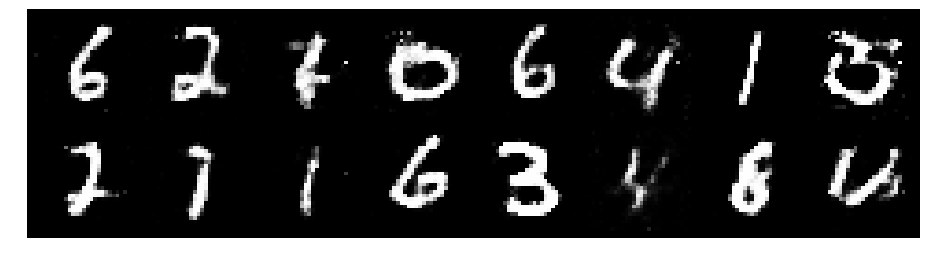

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3284, Generator Loss: 0.8561
D(x): 0.5926, D(G(z)): 0.4639


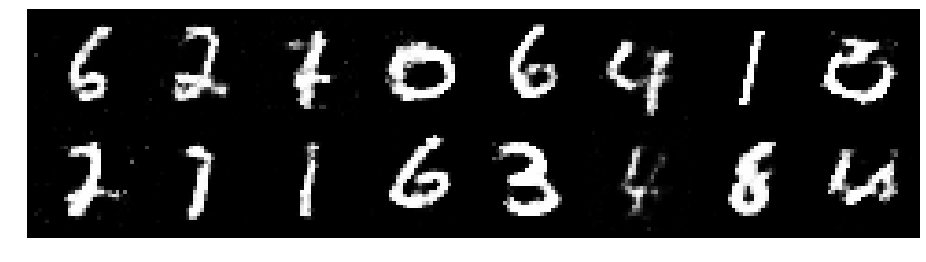

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.3519, Generator Loss: 0.8805
D(x): 0.5649, D(G(z)): 0.4671


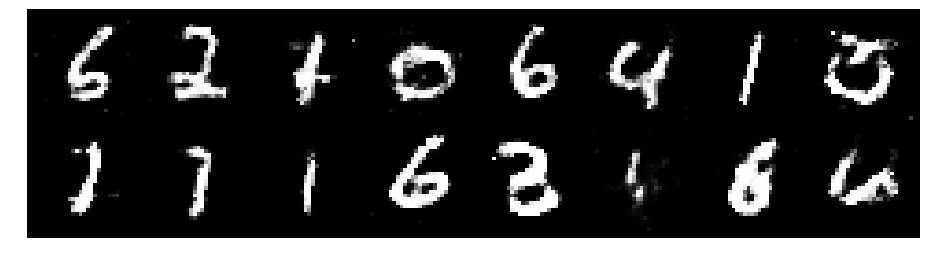

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3926, Generator Loss: 0.9545
D(x): 0.5299, D(G(z)): 0.4354


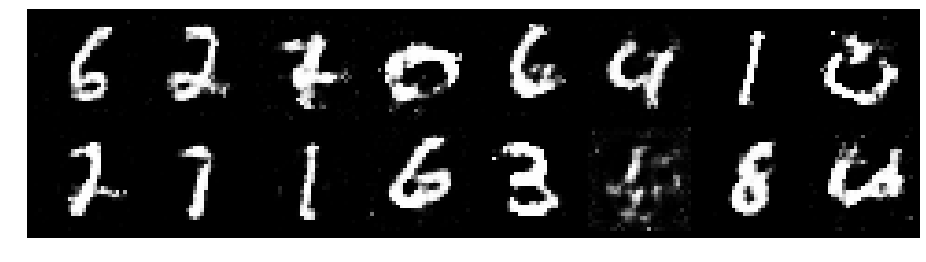

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1490, Generator Loss: 0.9174
D(x): 0.6144, D(G(z)): 0.4311


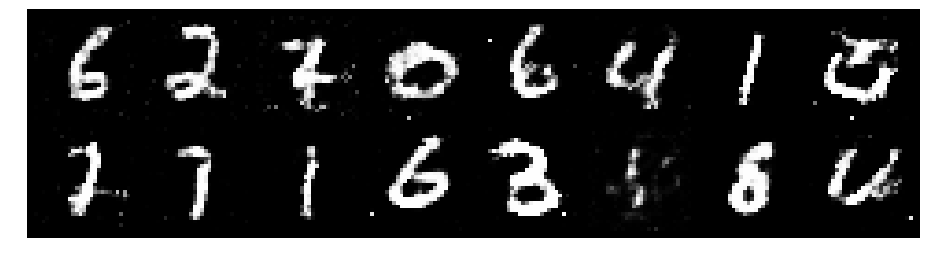

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.1230, Generator Loss: 1.0179
D(x): 0.5650, D(G(z)): 0.3756


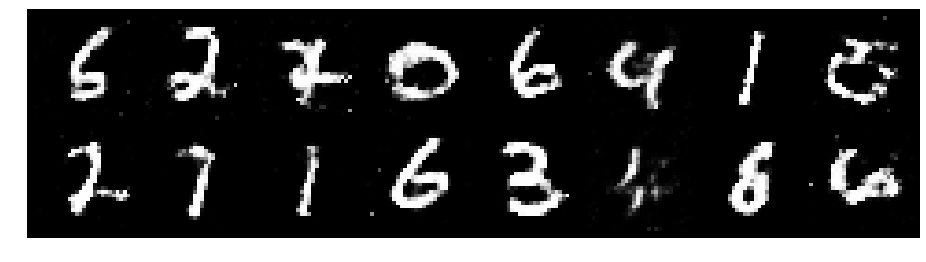

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.1722, Generator Loss: 0.9751
D(x): 0.5803, D(G(z)): 0.3814


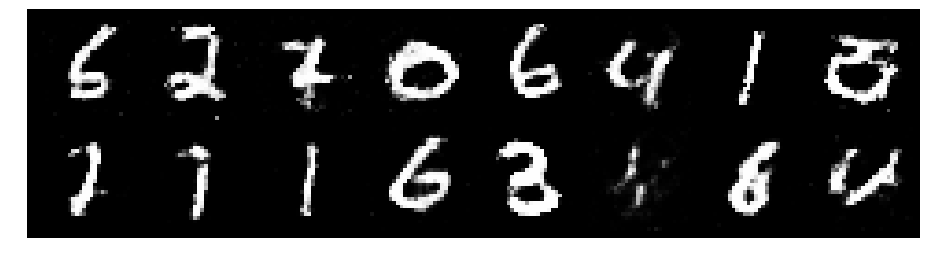

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1806, Generator Loss: 0.9767
D(x): 0.5579, D(G(z)): 0.4000


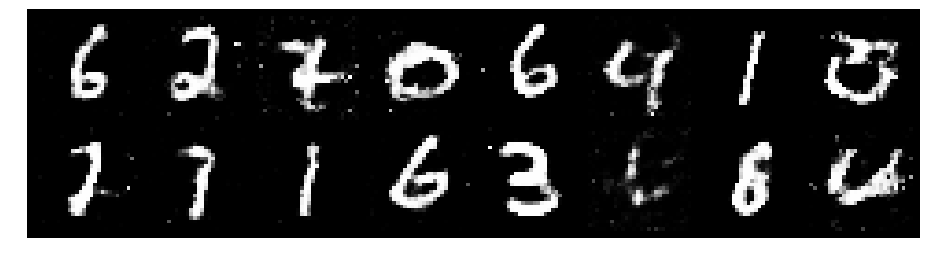

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.1895, Generator Loss: 0.8571
D(x): 0.5622, D(G(z)): 0.3999


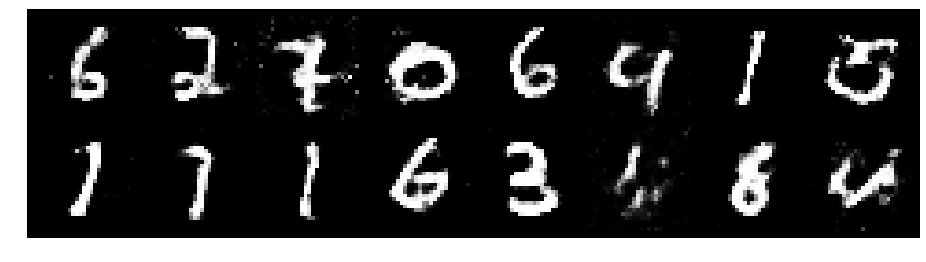

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3433, Generator Loss: 0.9561
D(x): 0.5122, D(G(z)): 0.4177


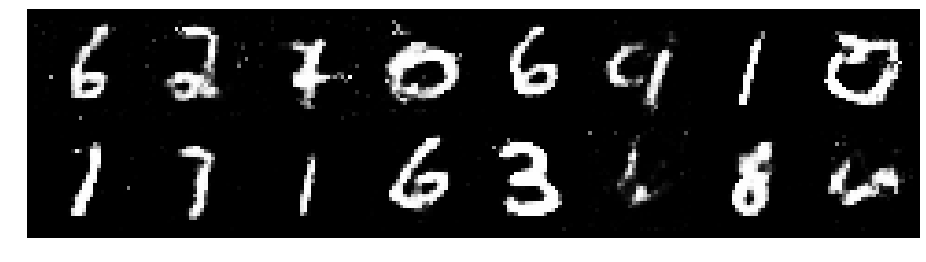

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.1229, Generator Loss: 1.0311
D(x): 0.5980, D(G(z)): 0.3933


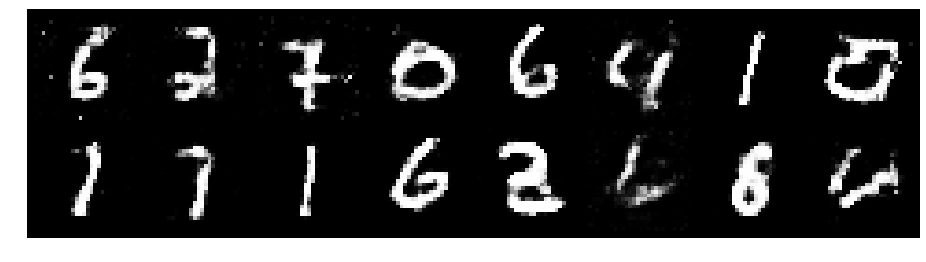

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2261, Generator Loss: 1.1047
D(x): 0.5741, D(G(z)): 0.4151


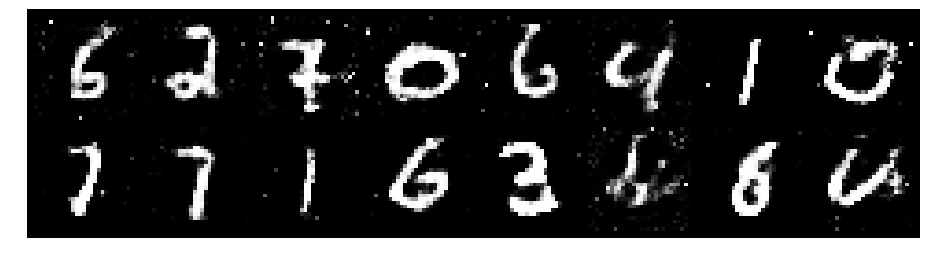

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2482, Generator Loss: 1.0604
D(x): 0.5499, D(G(z)): 0.4237


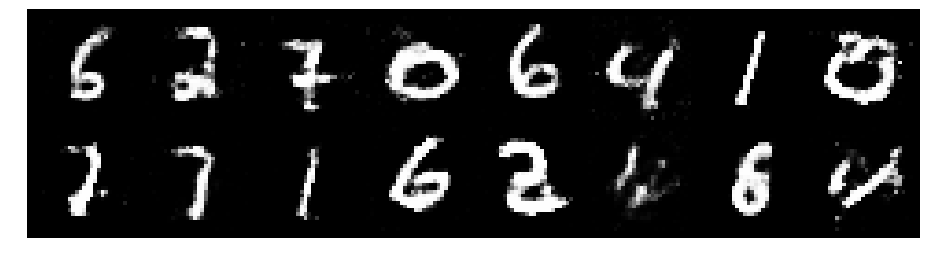

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2722, Generator Loss: 0.8260
D(x): 0.5583, D(G(z)): 0.4522


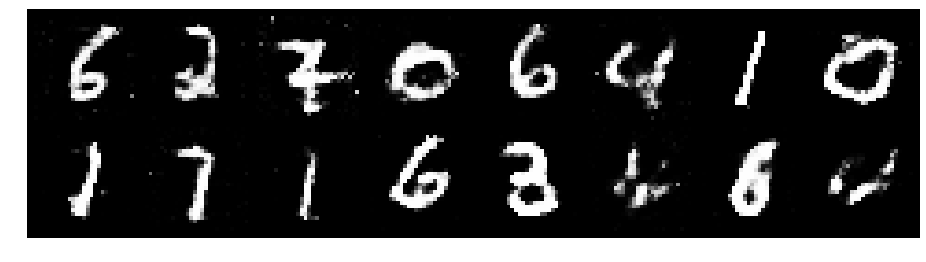

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.3829, Generator Loss: 0.7968
D(x): 0.5274, D(G(z)): 0.4811


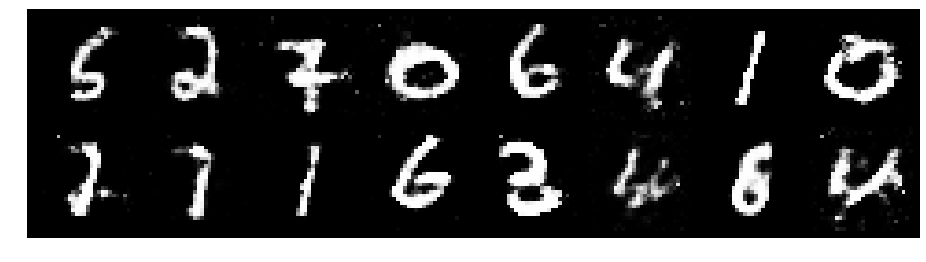

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3347, Generator Loss: 0.9303
D(x): 0.5535, D(G(z)): 0.4719


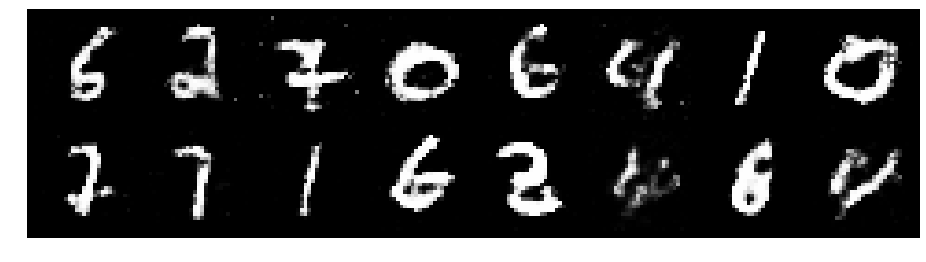

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.2552, Generator Loss: 0.9807
D(x): 0.5522, D(G(z)): 0.4213


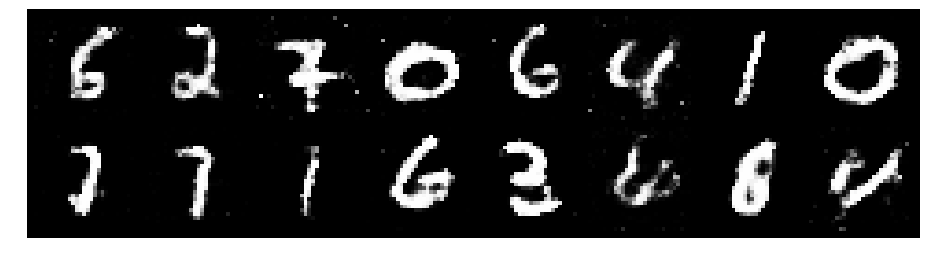

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2648, Generator Loss: 0.9248
D(x): 0.5345, D(G(z)): 0.4315


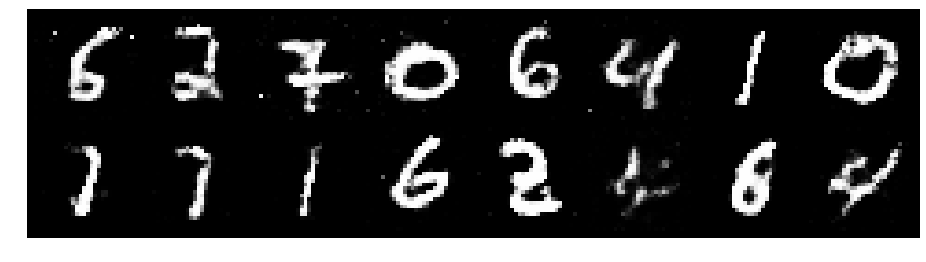

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2691, Generator Loss: 0.9348
D(x): 0.5728, D(G(z)): 0.4472


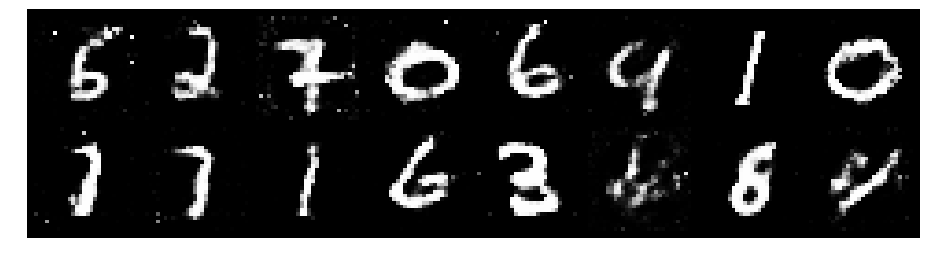

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2331, Generator Loss: 0.7871
D(x): 0.5674, D(G(z)): 0.4453


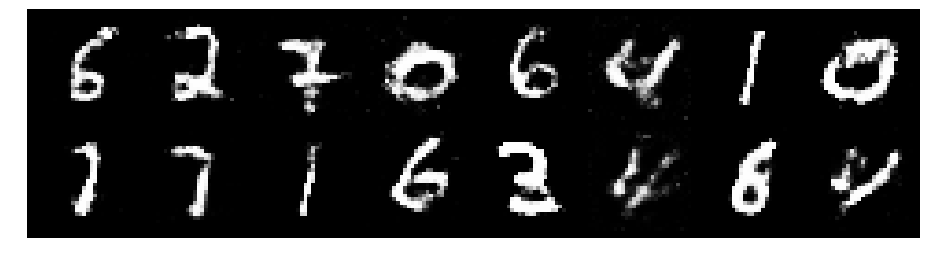

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9991
D(x): 0.5625, D(G(z)): 0.4130


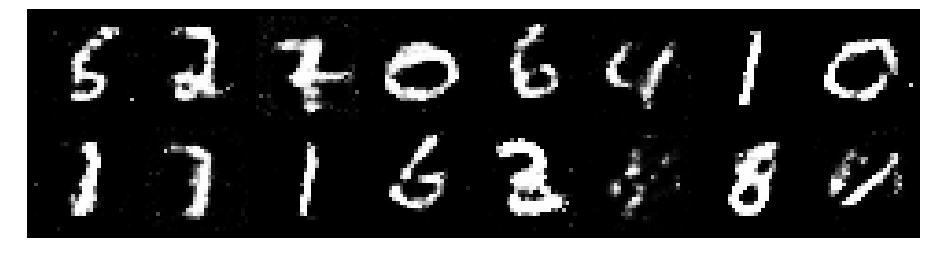

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2035, Generator Loss: 0.8345
D(x): 0.5671, D(G(z)): 0.4382


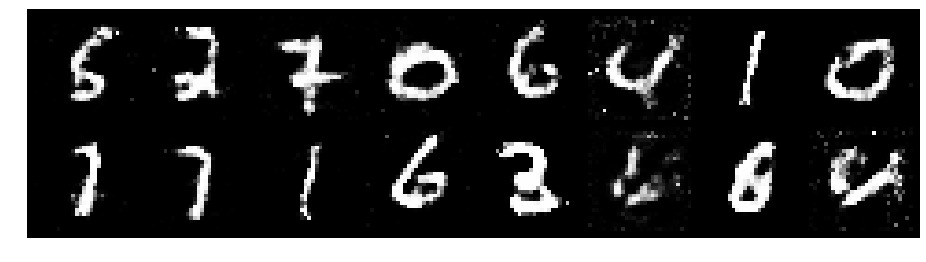

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.1242, Generator Loss: 0.9087
D(x): 0.5829, D(G(z)): 0.4101


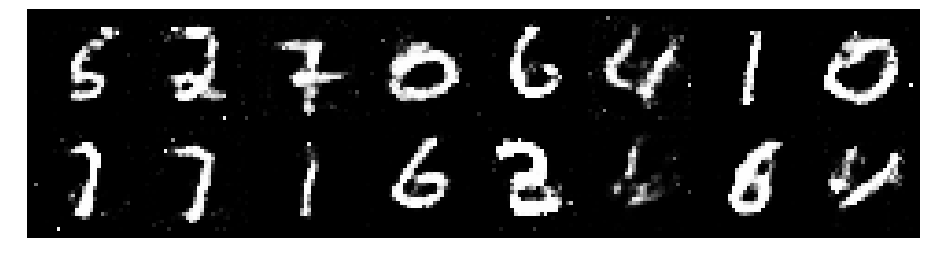

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8831
D(x): 0.5671, D(G(z)): 0.4589


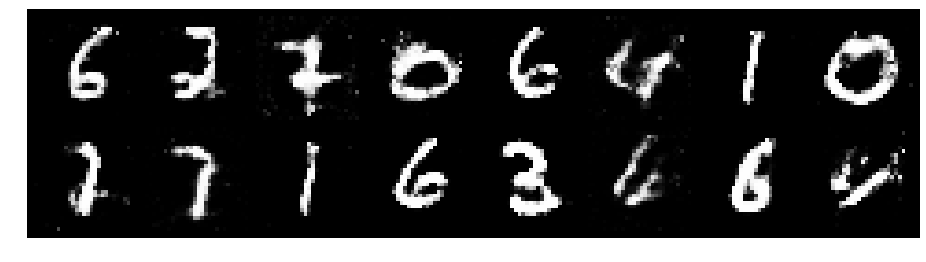

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.1363, Generator Loss: 0.9017
D(x): 0.5469, D(G(z)): 0.3753


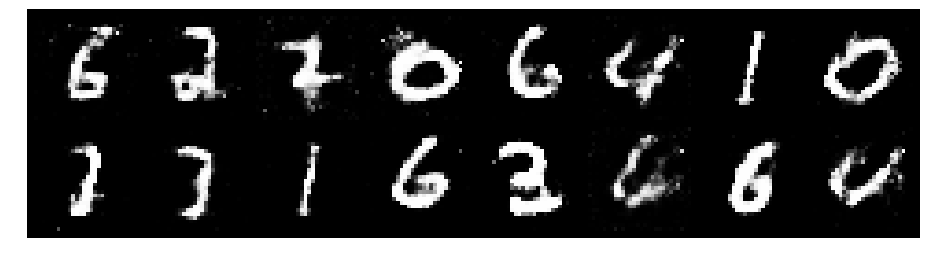

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2422, Generator Loss: 0.9120
D(x): 0.5514, D(G(z)): 0.4366


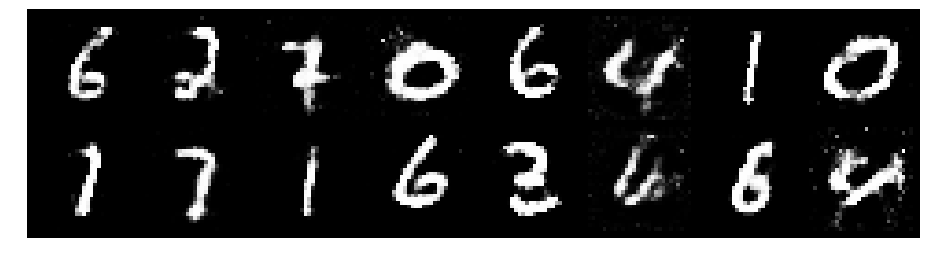

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2421, Generator Loss: 0.8334
D(x): 0.5670, D(G(z)): 0.4453


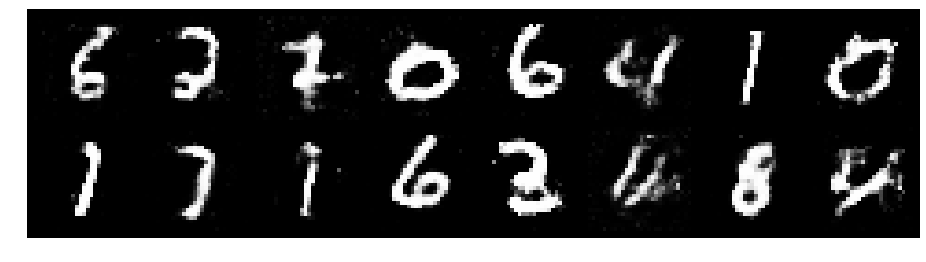

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2887, Generator Loss: 0.7802
D(x): 0.5812, D(G(z)): 0.4846


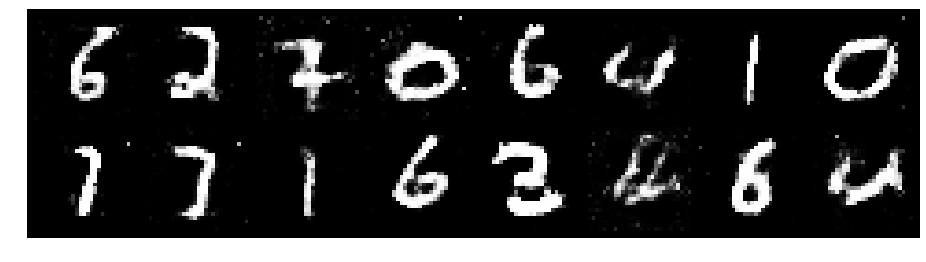

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3379, Generator Loss: 1.0018
D(x): 0.5272, D(G(z)): 0.4439


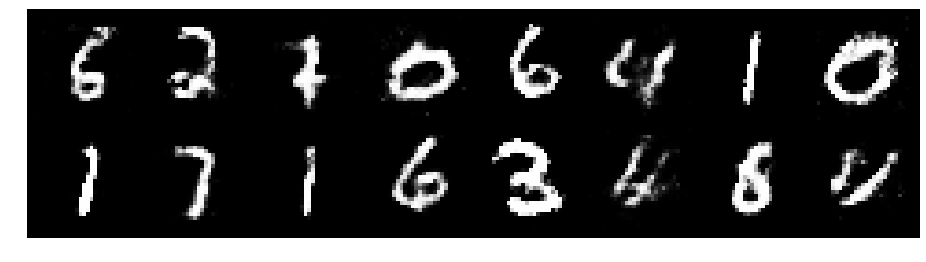

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2870, Generator Loss: 0.8132
D(x): 0.5493, D(G(z)): 0.4529


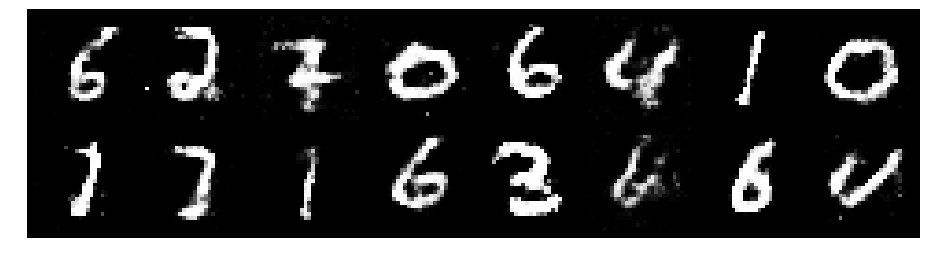

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2489, Generator Loss: 1.0560
D(x): 0.5586, D(G(z)): 0.4230


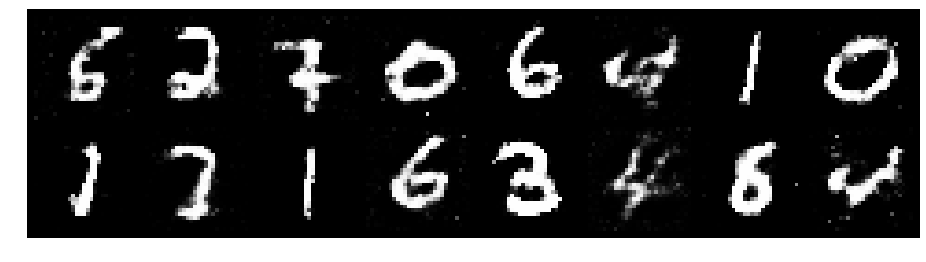

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2977, Generator Loss: 0.9304
D(x): 0.5492, D(G(z)): 0.4608


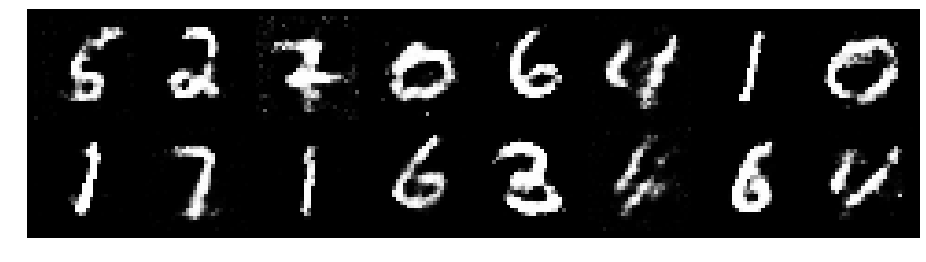

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8767
D(x): 0.5532, D(G(z)): 0.4632


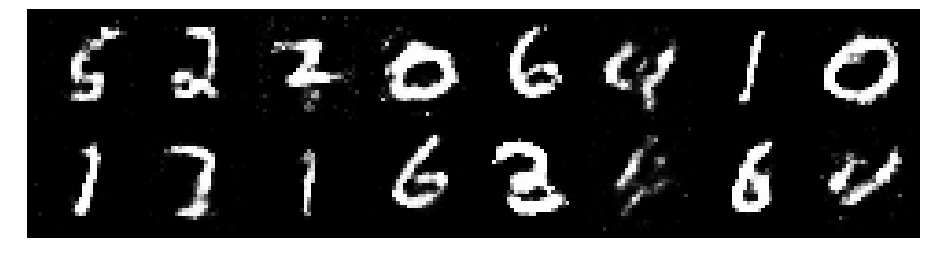

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.1923, Generator Loss: 1.0410
D(x): 0.5526, D(G(z)): 0.4003


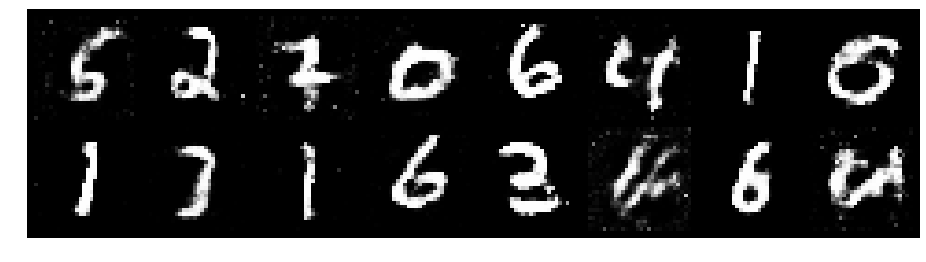

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2292, Generator Loss: 0.9629
D(x): 0.5427, D(G(z)): 0.4159


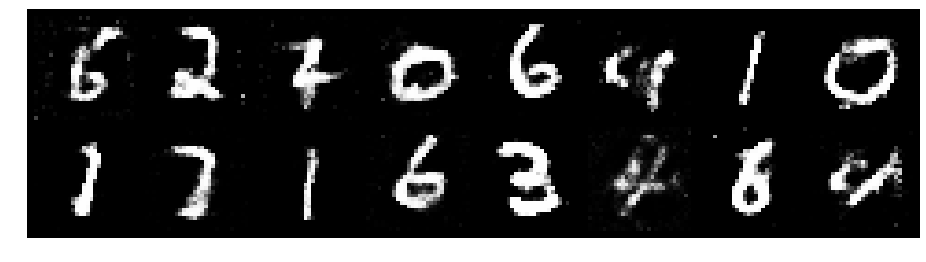

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9878
D(x): 0.5903, D(G(z)): 0.4404


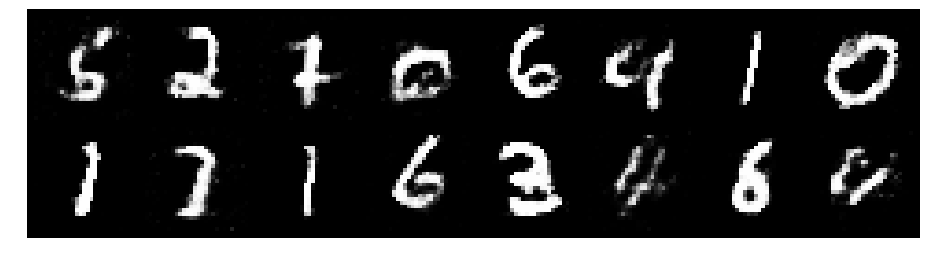

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8508
D(x): 0.5497, D(G(z)): 0.4378


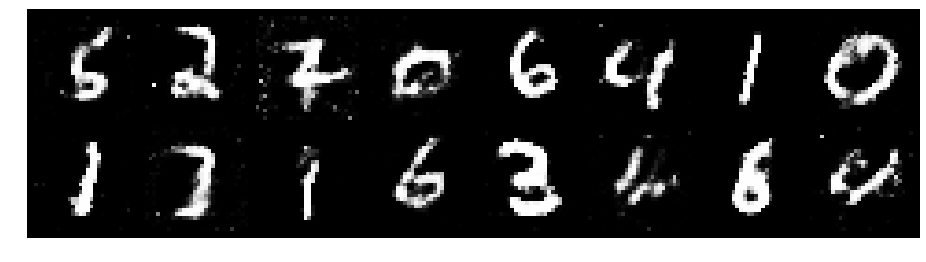

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3317, Generator Loss: 0.9524
D(x): 0.5770, D(G(z)): 0.4632


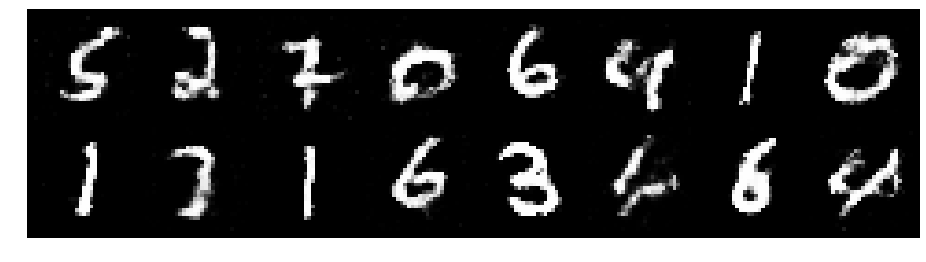

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2095, Generator Loss: 0.9060
D(x): 0.6076, D(G(z)): 0.4376


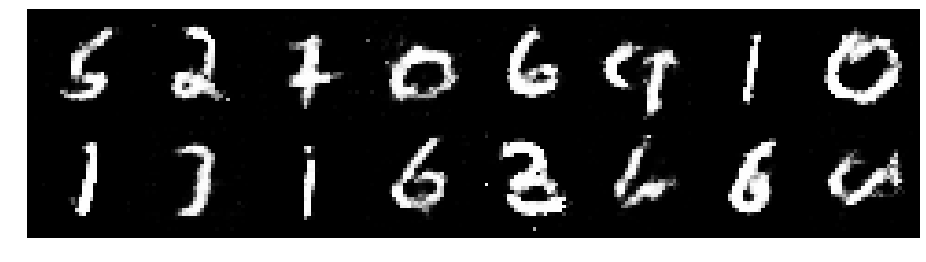

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.3456, Generator Loss: 0.8771
D(x): 0.5507, D(G(z)): 0.4720


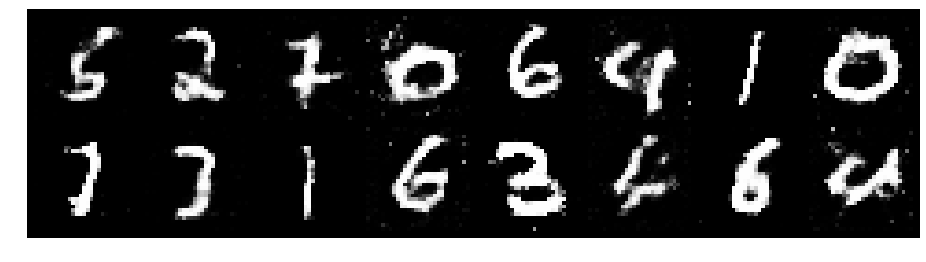

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.3168, Generator Loss: 0.8694
D(x): 0.5275, D(G(z)): 0.4461


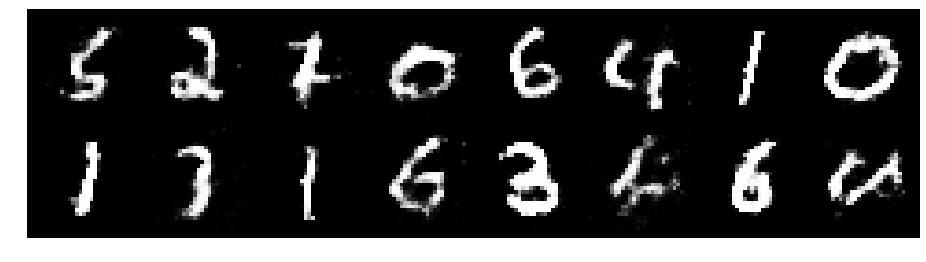

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3009, Generator Loss: 0.8178
D(x): 0.5459, D(G(z)): 0.4601


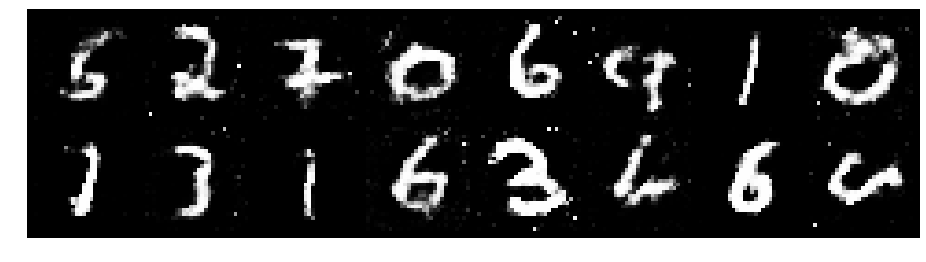

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2627, Generator Loss: 0.8515
D(x): 0.5654, D(G(z)): 0.4500


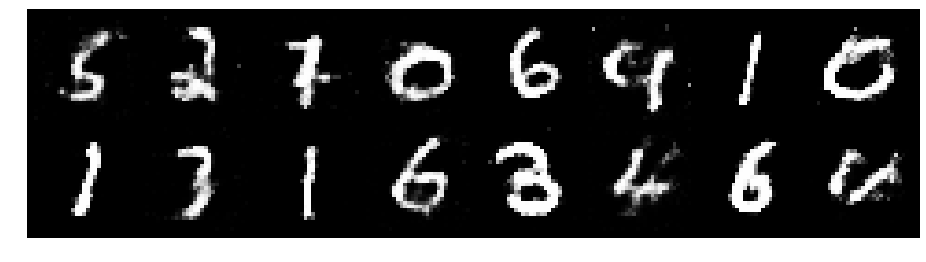

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2468, Generator Loss: 0.8600
D(x): 0.5724, D(G(z)): 0.4586


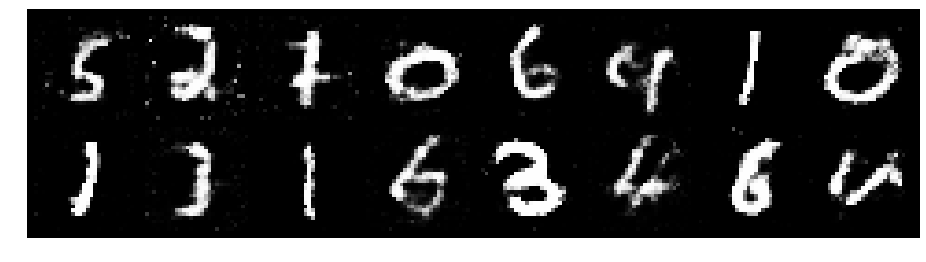

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3171, Generator Loss: 0.7597
D(x): 0.5392, D(G(z)): 0.4735


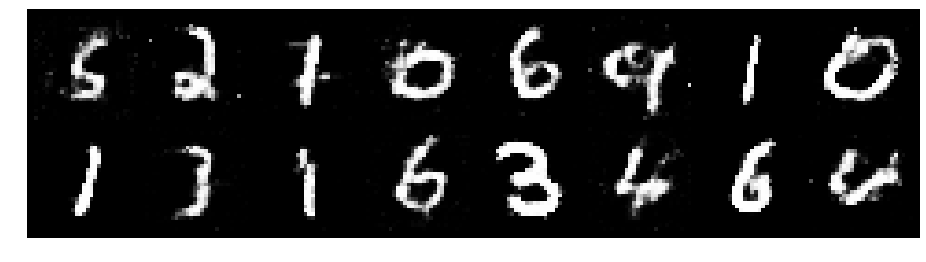

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2867, Generator Loss: 0.8122
D(x): 0.5691, D(G(z)): 0.4669


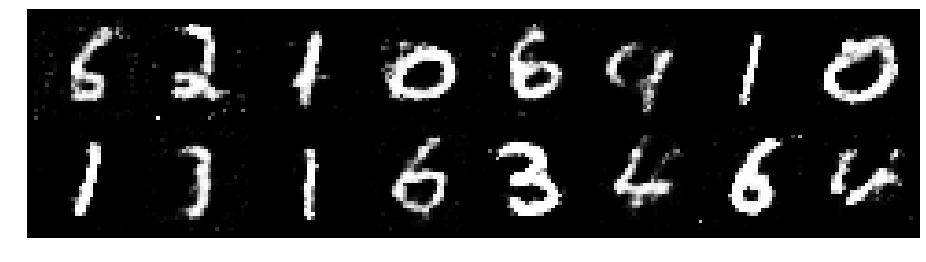

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3273, Generator Loss: 0.8019
D(x): 0.5353, D(G(z)): 0.4721


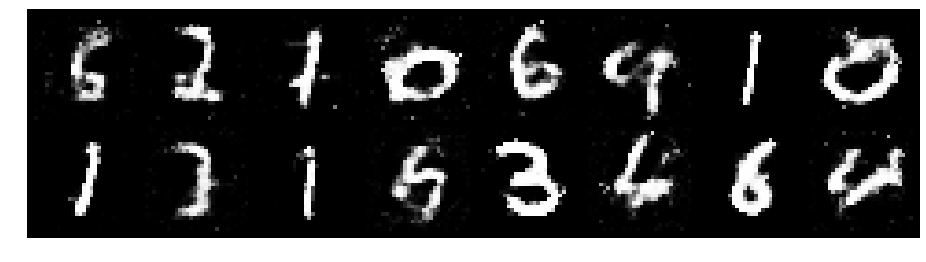

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.3328, Generator Loss: 0.9583
D(x): 0.5320, D(G(z)): 0.4586


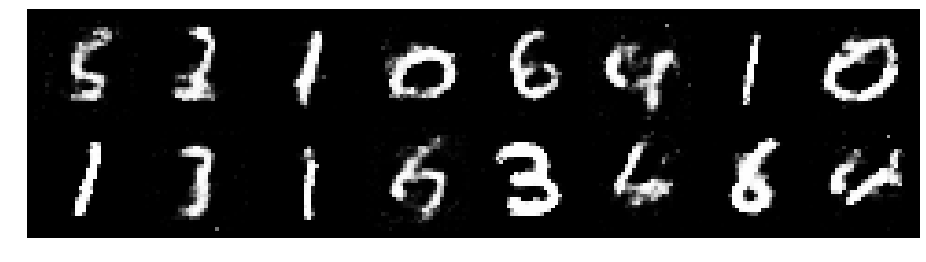

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.2986, Generator Loss: 0.8386
D(x): 0.5536, D(G(z)): 0.4729


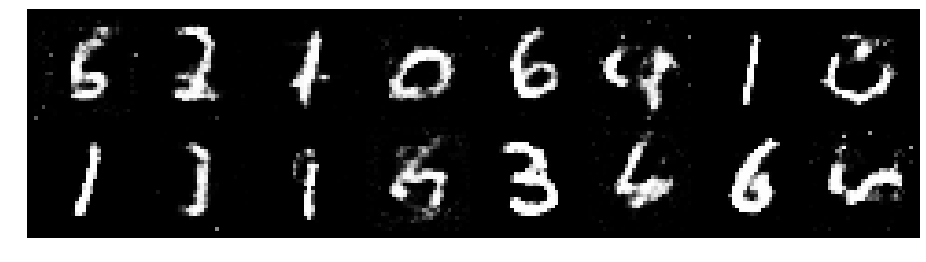

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.1727, Generator Loss: 0.9853
D(x): 0.5543, D(G(z)): 0.4040


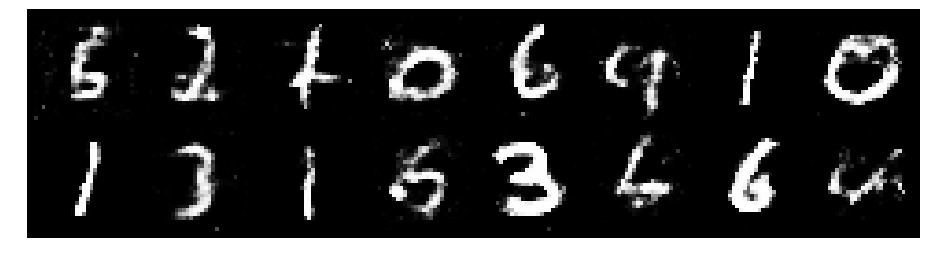

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.1945, Generator Loss: 0.9134
D(x): 0.5696, D(G(z)): 0.4273


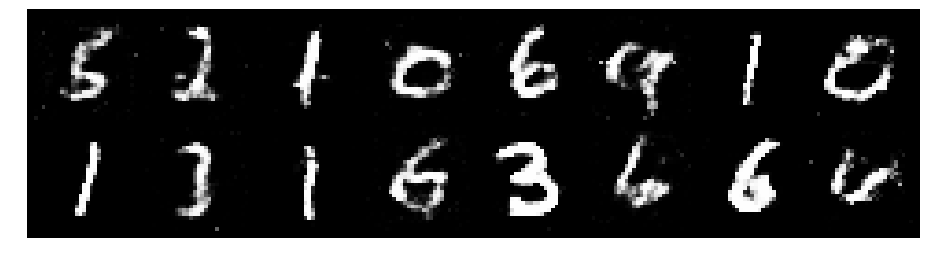

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2750, Generator Loss: 0.8533
D(x): 0.5256, D(G(z)): 0.4363


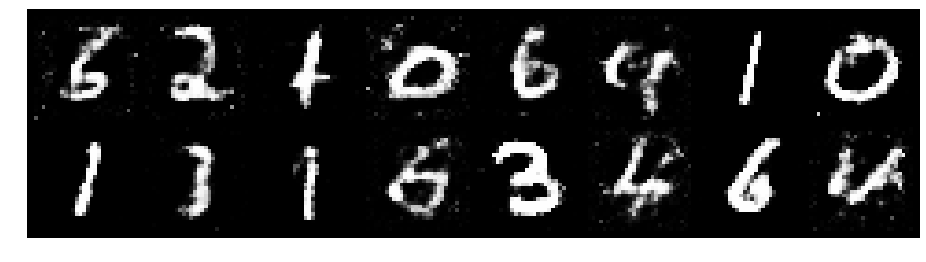

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1488, Generator Loss: 1.0415
D(x): 0.5613, D(G(z)): 0.3796


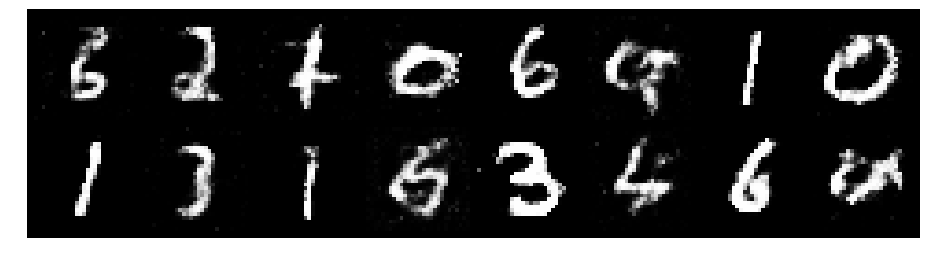

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.3163, Generator Loss: 0.8944
D(x): 0.5842, D(G(z)): 0.4861


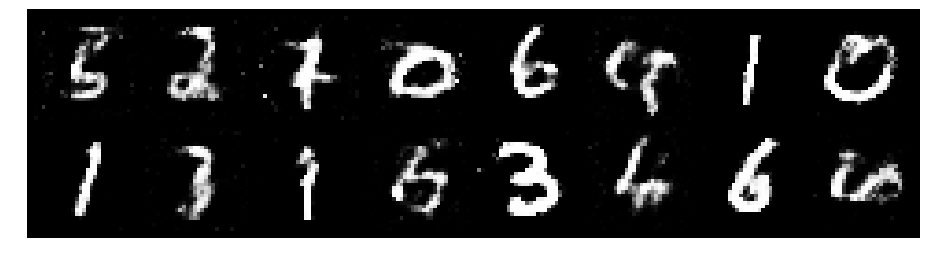

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2314, Generator Loss: 1.0425
D(x): 0.5724, D(G(z)): 0.4238


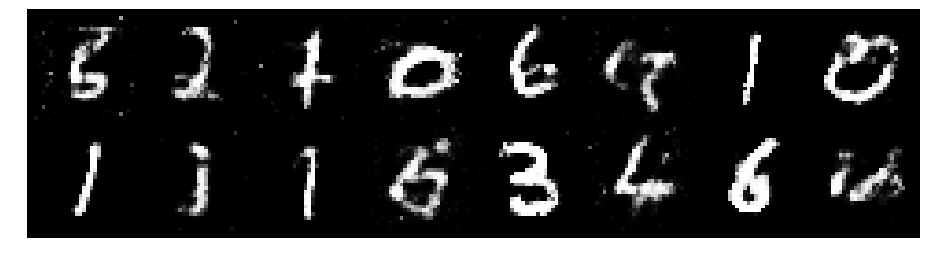

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.1598, Generator Loss: 0.9336
D(x): 0.5598, D(G(z)): 0.3906


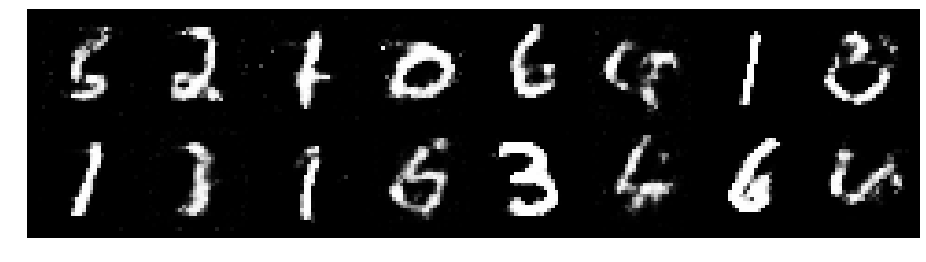

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2167, Generator Loss: 0.9781
D(x): 0.6112, D(G(z)): 0.4445


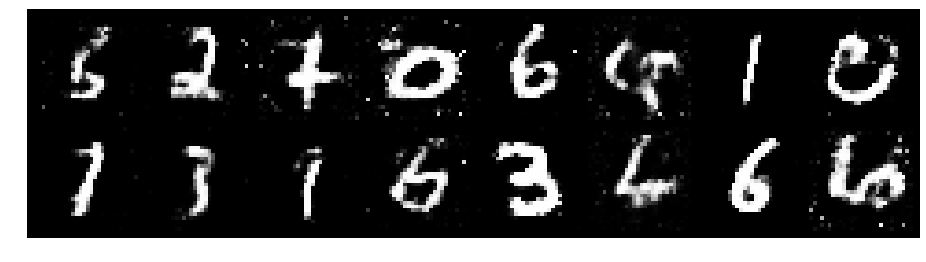

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2569, Generator Loss: 0.9215
D(x): 0.5948, D(G(z)): 0.4578


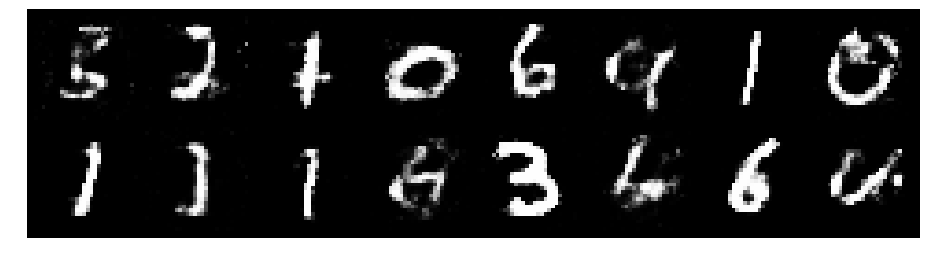

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.3615, Generator Loss: 1.1256
D(x): 0.5020, D(G(z)): 0.3954


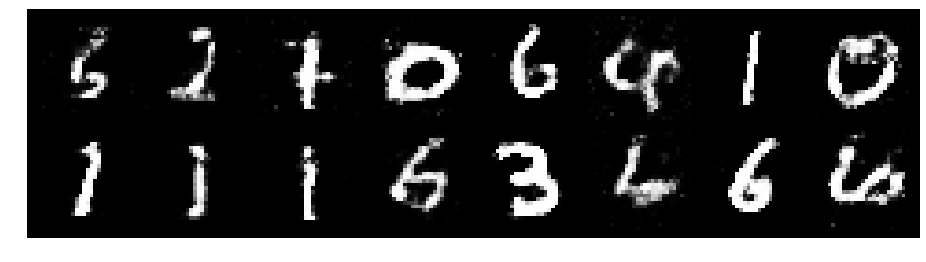

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3176, Generator Loss: 0.9521
D(x): 0.5734, D(G(z)): 0.4316


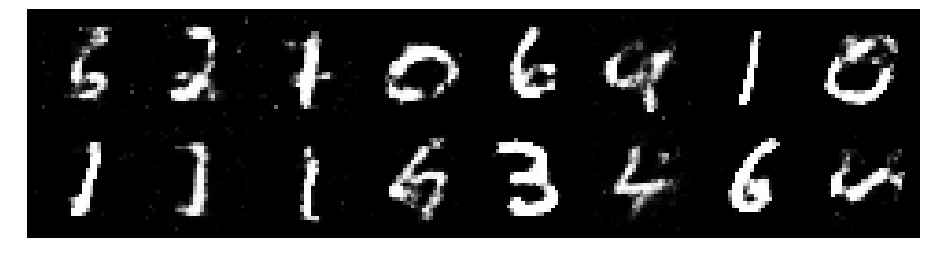

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2524, Generator Loss: 1.0075
D(x): 0.5410, D(G(z)): 0.4009


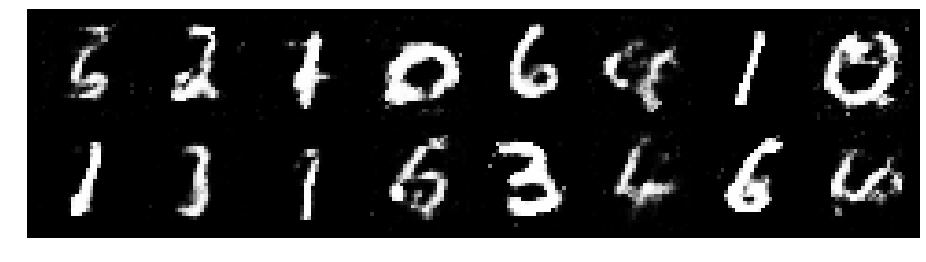

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.3981, Generator Loss: 0.8487
D(x): 0.5556, D(G(z)): 0.5053


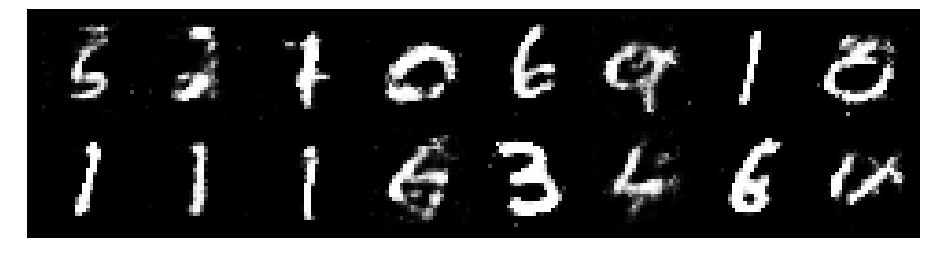

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.2593, Generator Loss: 0.9178
D(x): 0.5623, D(G(z)): 0.4355


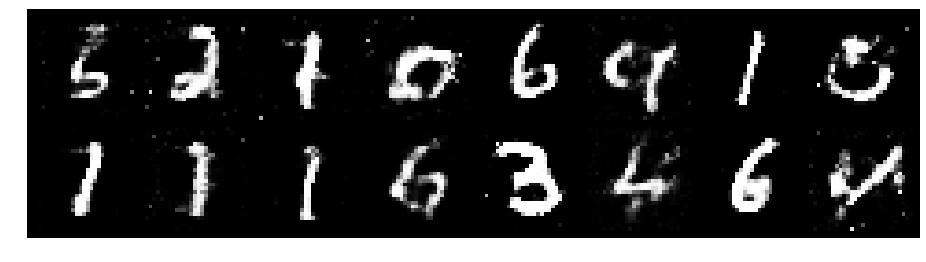

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.1326, Generator Loss: 0.8989
D(x): 0.5729, D(G(z)): 0.3943


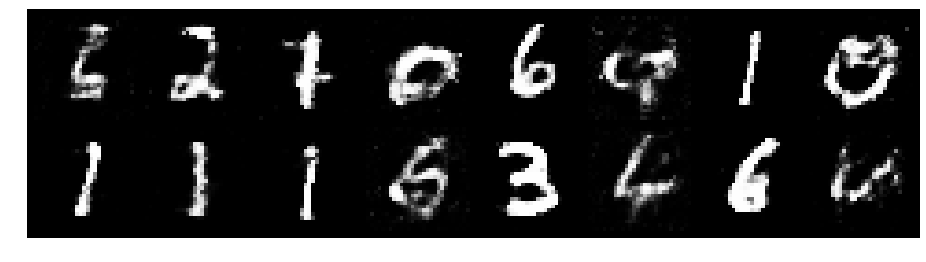

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2299, Generator Loss: 0.8251
D(x): 0.5371, D(G(z)): 0.4208


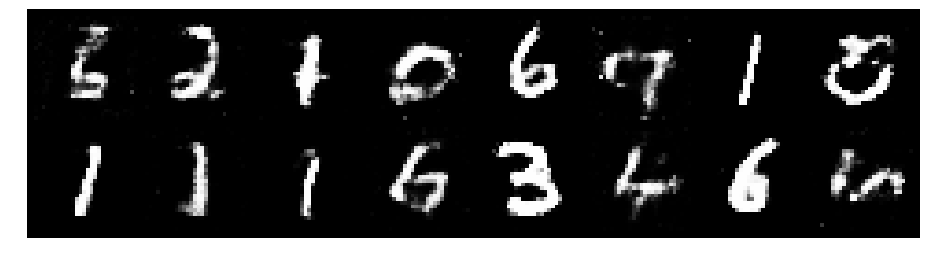

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2476, Generator Loss: 0.9479
D(x): 0.5607, D(G(z)): 0.4336


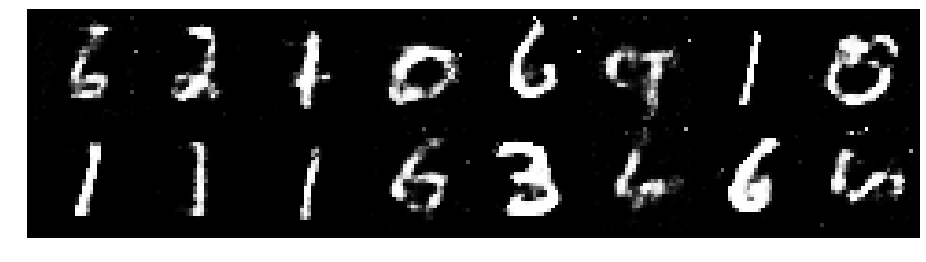

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3029, Generator Loss: 0.7724
D(x): 0.5477, D(G(z)): 0.4571


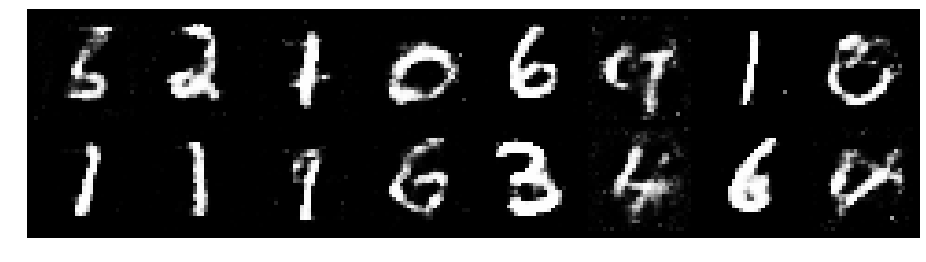

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8225
D(x): 0.5619, D(G(z)): 0.4450


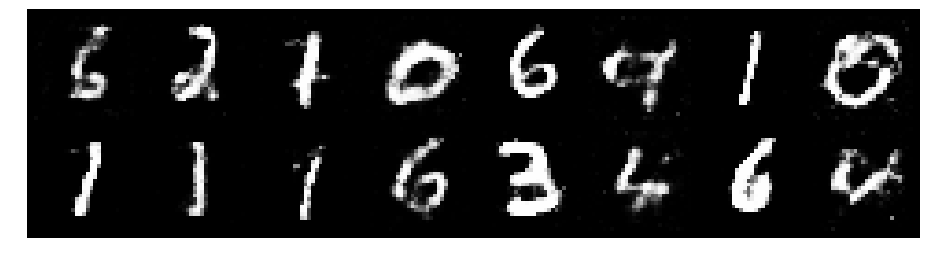

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.1814, Generator Loss: 0.8742
D(x): 0.5611, D(G(z)): 0.4110


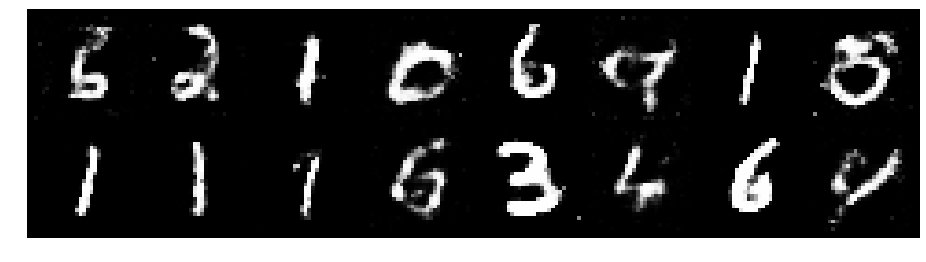

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.2698, Generator Loss: 0.8185
D(x): 0.5654, D(G(z)): 0.4770


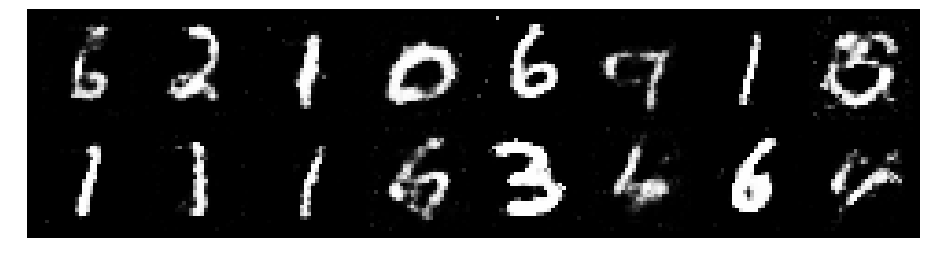

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8007
D(x): 0.5734, D(G(z)): 0.4791


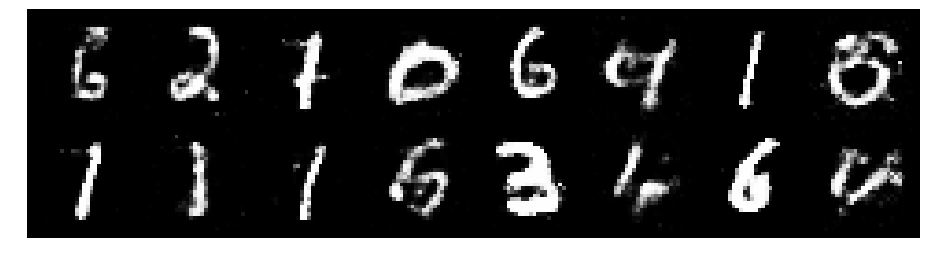

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.2503, Generator Loss: 0.8019
D(x): 0.5962, D(G(z)): 0.4840


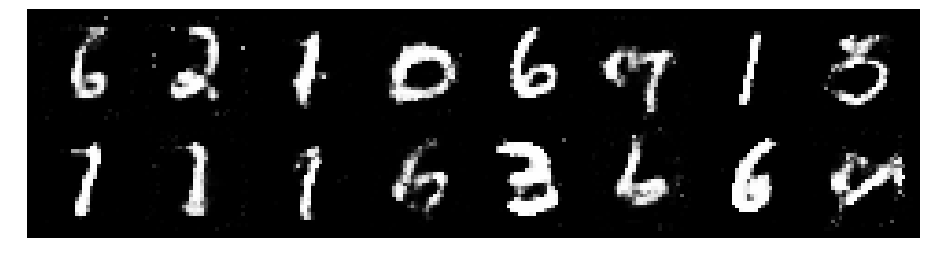

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.1918, Generator Loss: 1.0393
D(x): 0.5595, D(G(z)): 0.3957


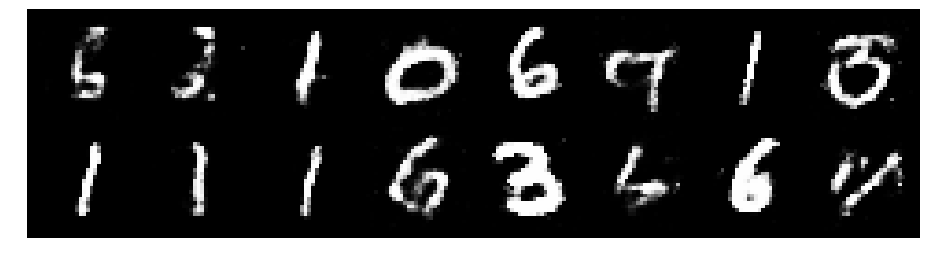

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.0818, Generator Loss: 1.1425
D(x): 0.6030, D(G(z)): 0.3564


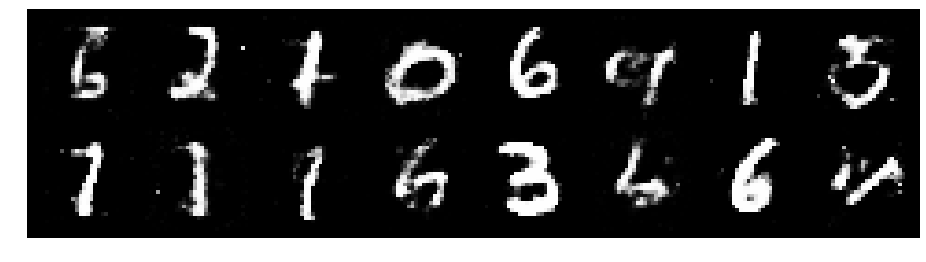

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.1381, Generator Loss: 0.9654
D(x): 0.5824, D(G(z)): 0.3870


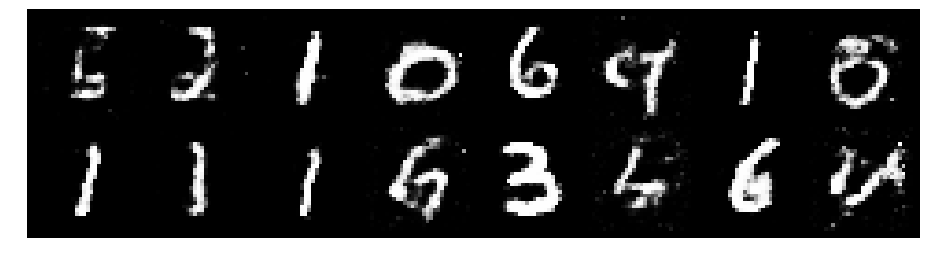

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2807, Generator Loss: 1.0147
D(x): 0.5325, D(G(z)): 0.4361


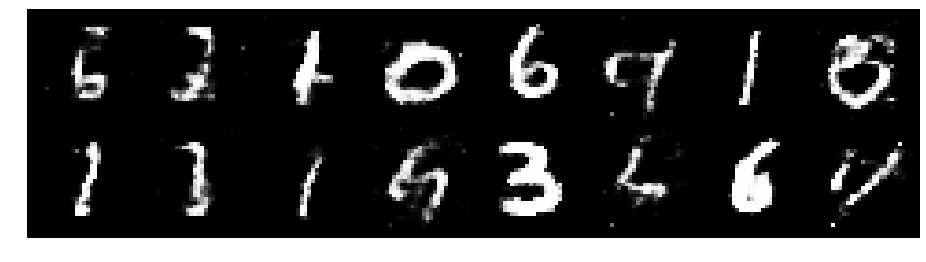

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.1910, Generator Loss: 0.9220
D(x): 0.5709, D(G(z)): 0.4077


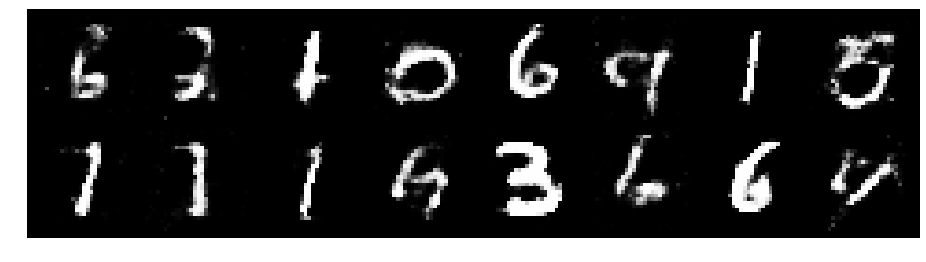

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.3886, Generator Loss: 0.7611
D(x): 0.5462, D(G(z)): 0.5120


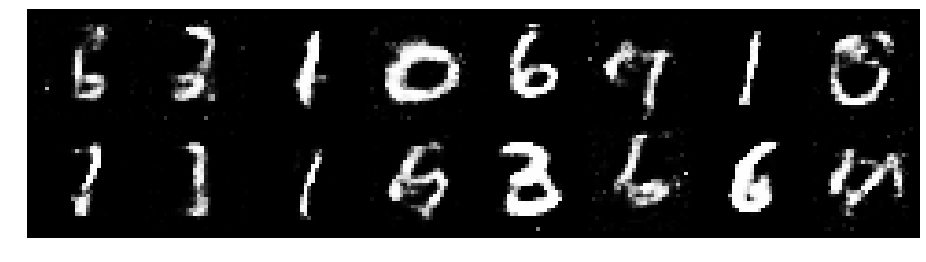

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3312, Generator Loss: 0.7745
D(x): 0.5370, D(G(z)): 0.4868


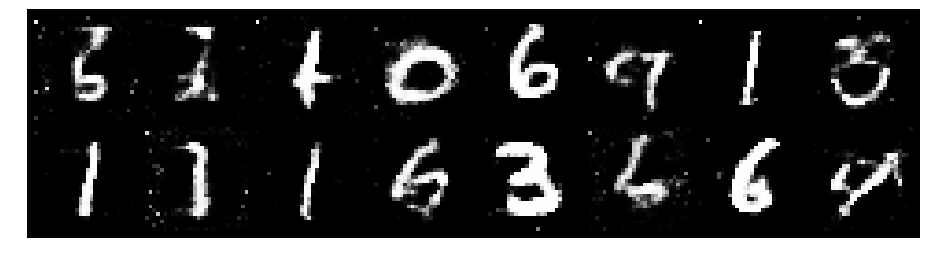

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.3377, Generator Loss: 0.9128
D(x): 0.5082, D(G(z)): 0.4480


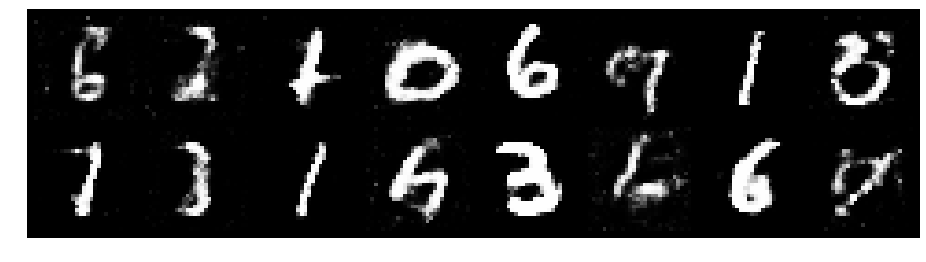

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2397, Generator Loss: 0.8734
D(x): 0.5666, D(G(z)): 0.4488


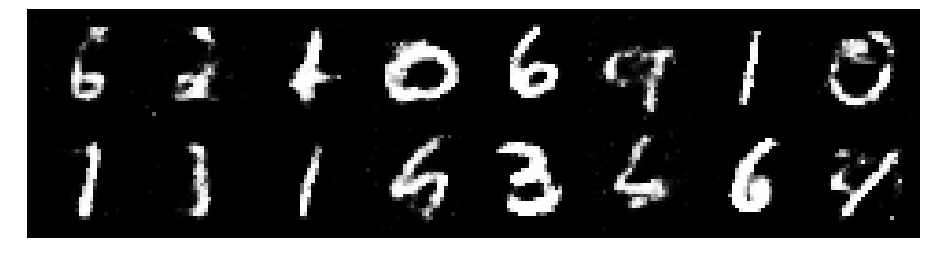

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.1893, Generator Loss: 0.7953
D(x): 0.5879, D(G(z)): 0.4563


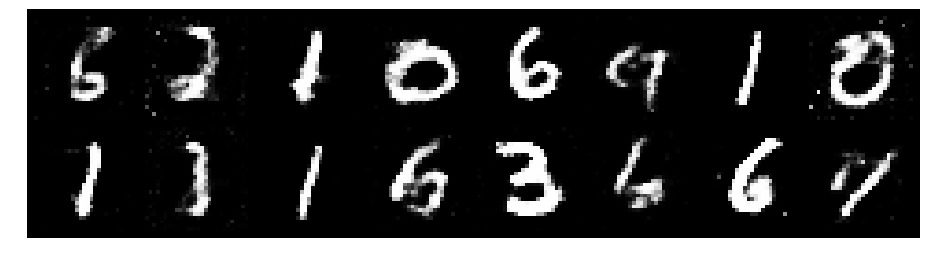

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8535
D(x): 0.5568, D(G(z)): 0.4648


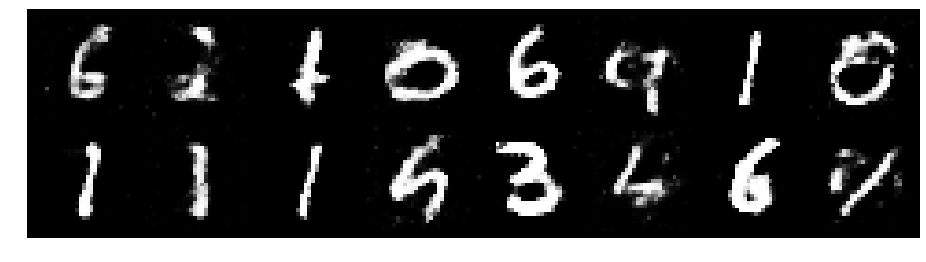

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3004, Generator Loss: 0.8239
D(x): 0.5435, D(G(z)): 0.4560


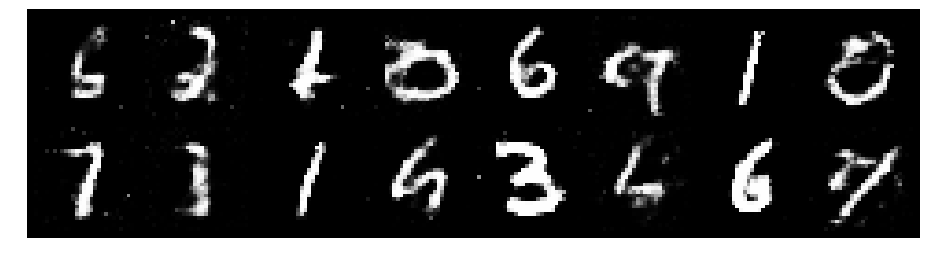

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2226, Generator Loss: 0.9395
D(x): 0.5795, D(G(z)): 0.4396


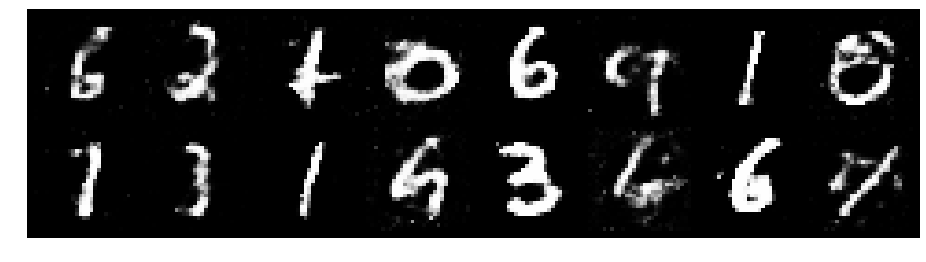

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 0.9122
D(x): 0.5336, D(G(z)): 0.4334


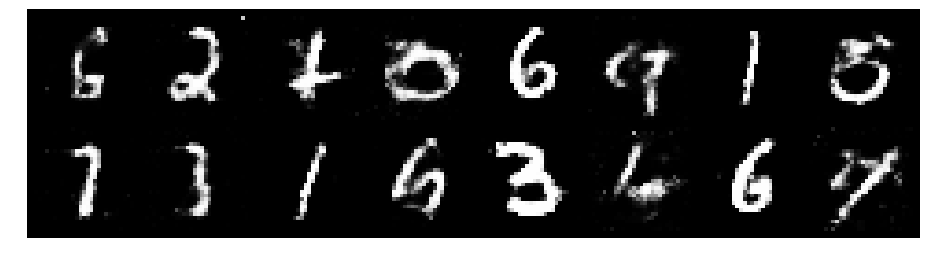

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.2123, Generator Loss: 0.8696
D(x): 0.5909, D(G(z)): 0.4556


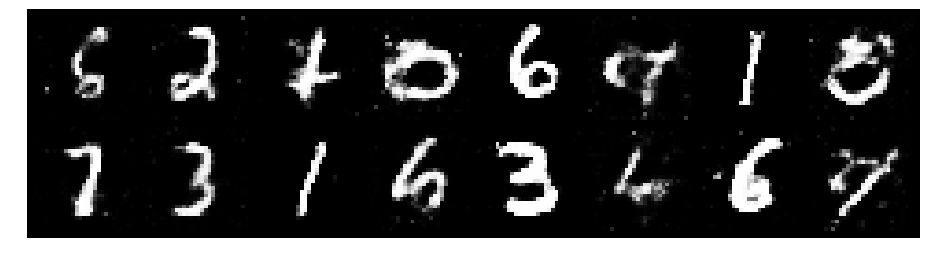

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8422
D(x): 0.5348, D(G(z)): 0.4616


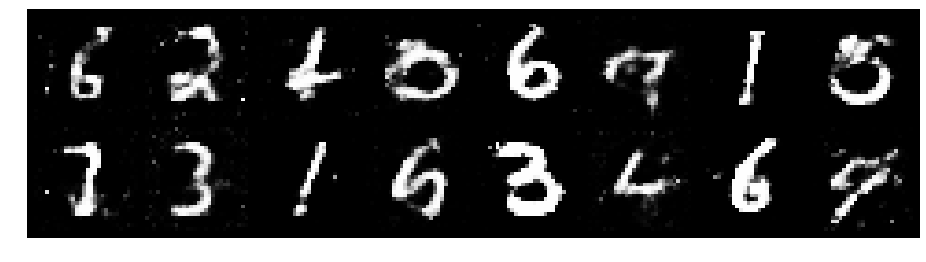

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2685, Generator Loss: 0.9286
D(x): 0.5137, D(G(z)): 0.4134


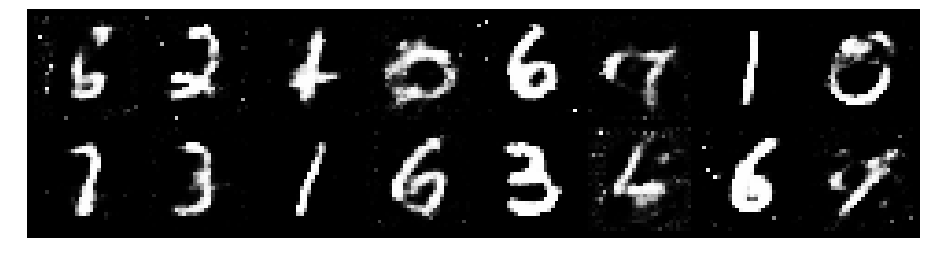

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2860, Generator Loss: 0.8378
D(x): 0.6091, D(G(z)): 0.4829


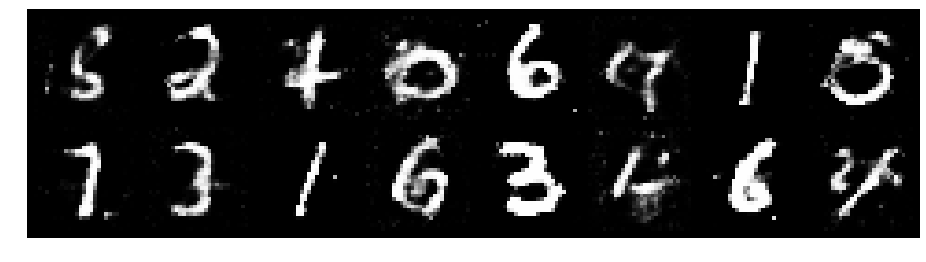

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3559, Generator Loss: 1.0817
D(x): 0.5504, D(G(z)): 0.4369


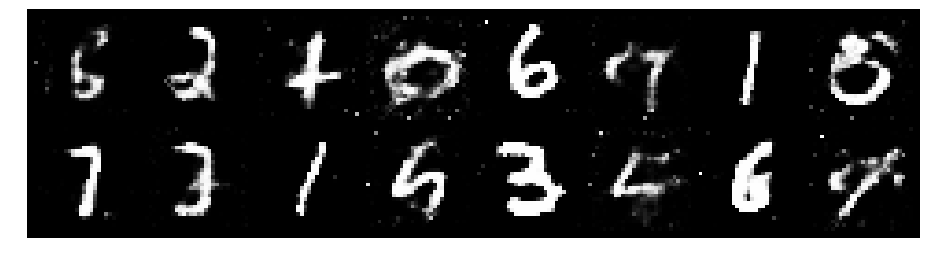

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2431, Generator Loss: 0.8066
D(x): 0.5723, D(G(z)): 0.4411


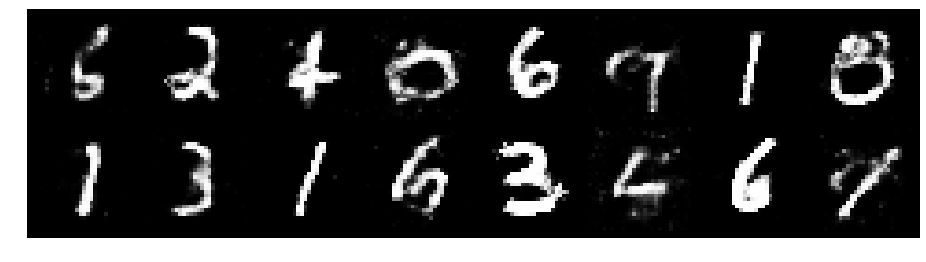

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2951, Generator Loss: 0.9308
D(x): 0.5394, D(G(z)): 0.4422


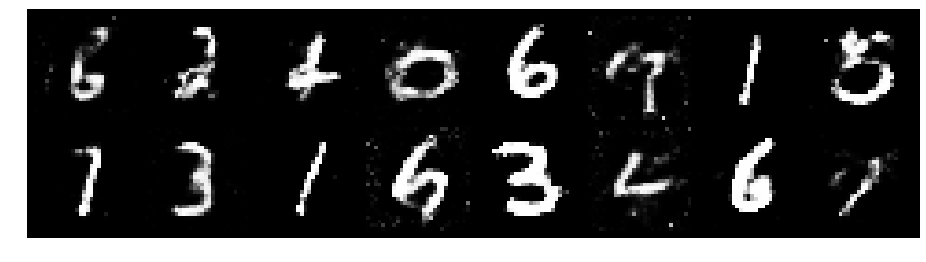

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8738
D(x): 0.5317, D(G(z)): 0.4501


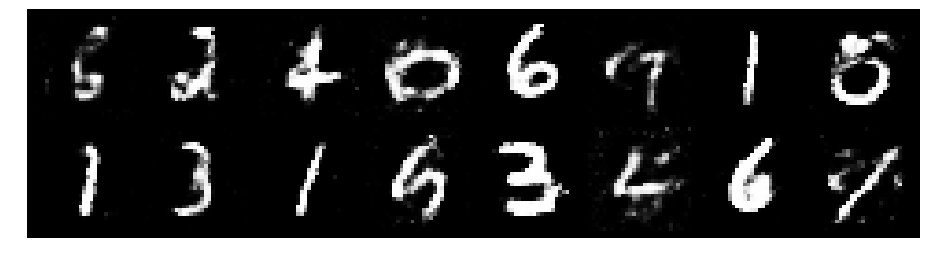

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2473, Generator Loss: 0.9010
D(x): 0.5495, D(G(z)): 0.4293


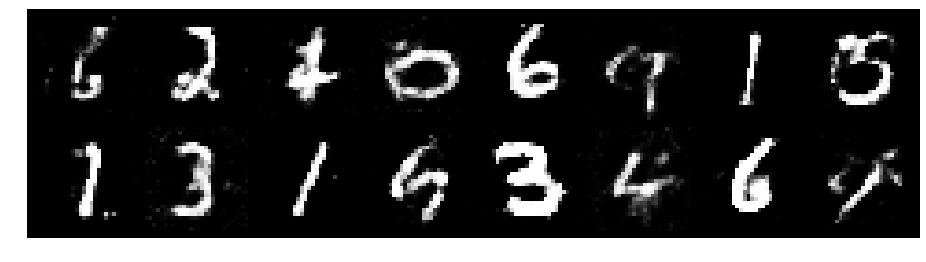

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2569, Generator Loss: 0.9907
D(x): 0.5422, D(G(z)): 0.4275


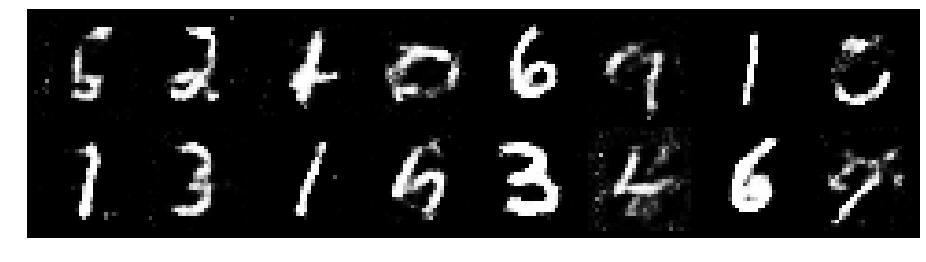

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2272, Generator Loss: 1.0151
D(x): 0.5782, D(G(z)): 0.4317


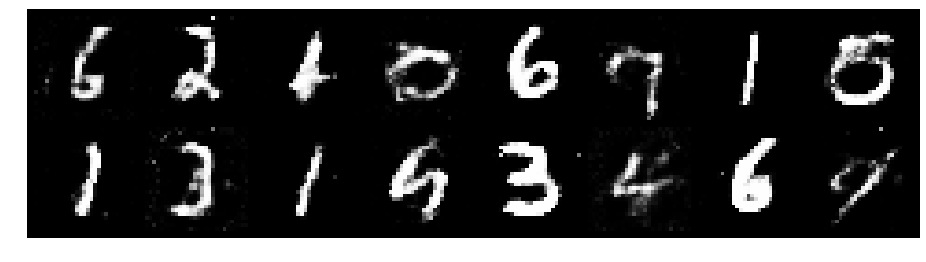

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.1506, Generator Loss: 0.9430
D(x): 0.6299, D(G(z)): 0.4399


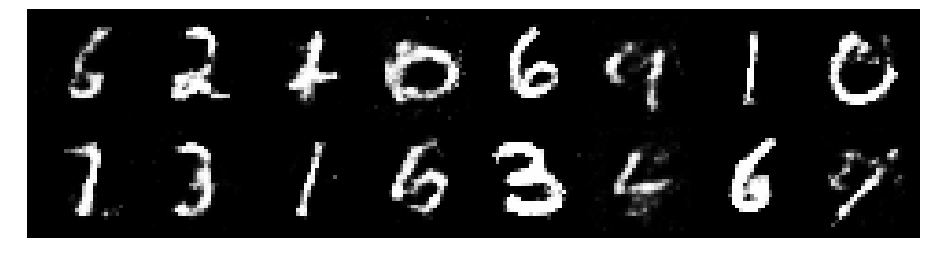

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2668, Generator Loss: 0.8936
D(x): 0.5218, D(G(z)): 0.4117


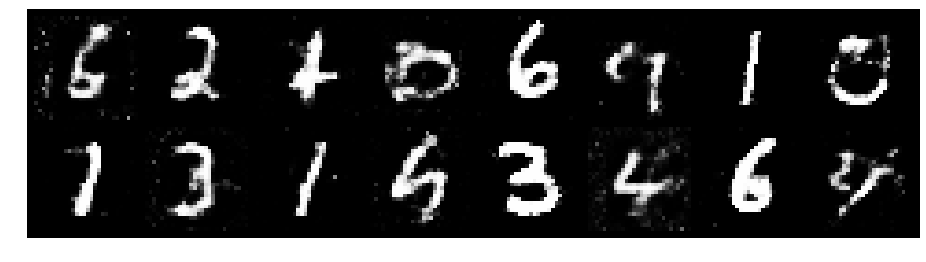

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2899, Generator Loss: 0.9439
D(x): 0.5318, D(G(z)): 0.4288


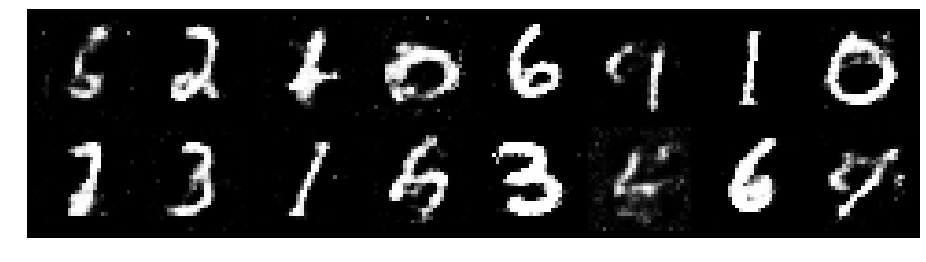

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2066, Generator Loss: 1.0456
D(x): 0.5913, D(G(z)): 0.4322


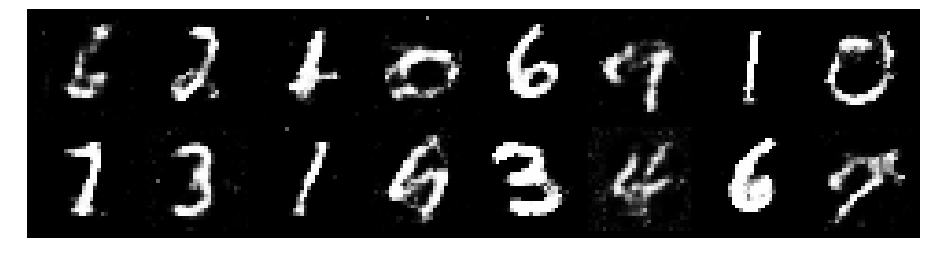

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.3473, Generator Loss: 0.8633
D(x): 0.5882, D(G(z)): 0.4925


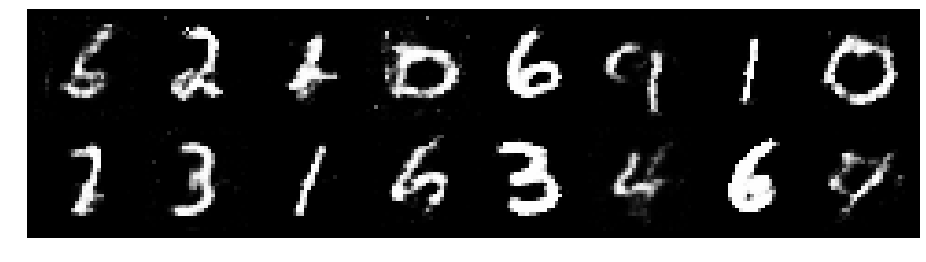

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2992, Generator Loss: 0.8208
D(x): 0.5410, D(G(z)): 0.4648


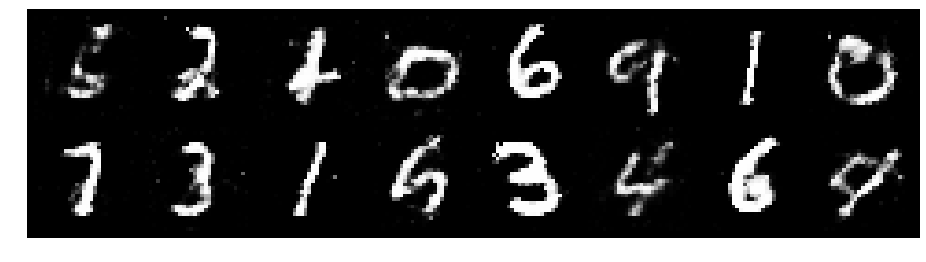

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2762, Generator Loss: 0.9193
D(x): 0.5480, D(G(z)): 0.4309


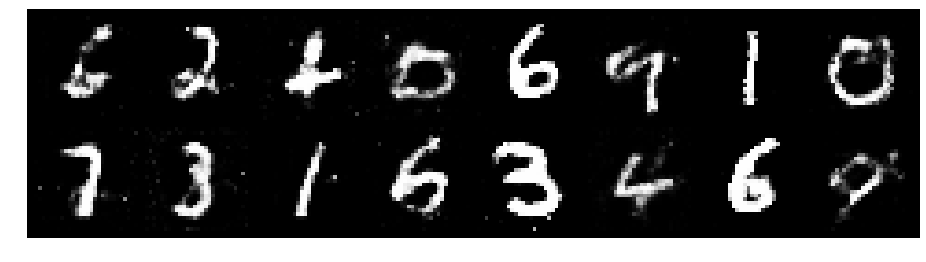

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2089, Generator Loss: 1.0340
D(x): 0.5915, D(G(z)): 0.4310


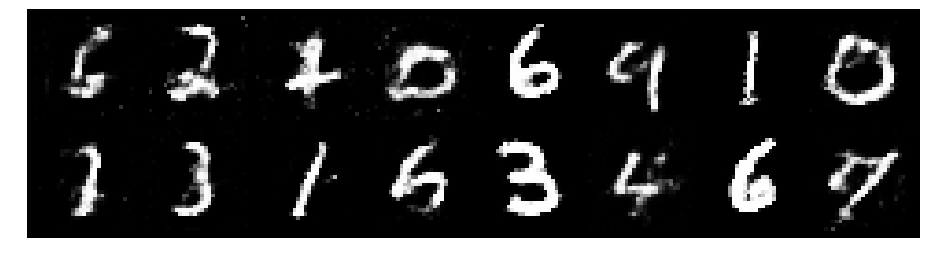

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2627, Generator Loss: 0.9560
D(x): 0.5533, D(G(z)): 0.4336


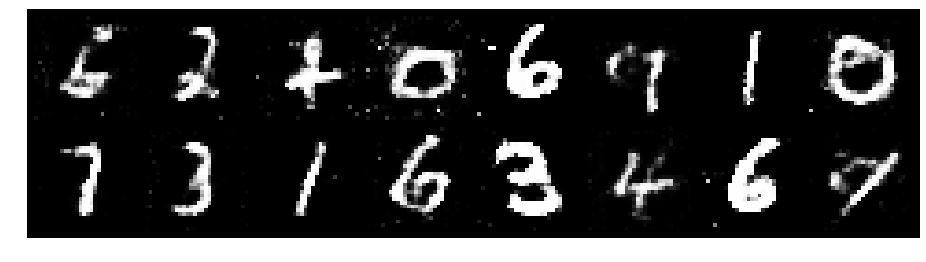

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.1625, Generator Loss: 1.1414
D(x): 0.5888, D(G(z)): 0.4179


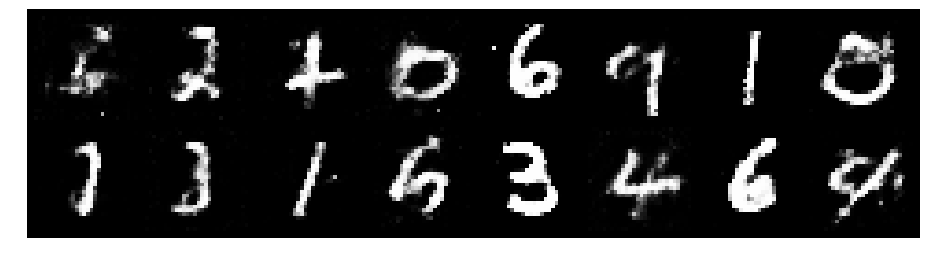

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.0623, Generator Loss: 1.0572
D(x): 0.6038, D(G(z)): 0.3611


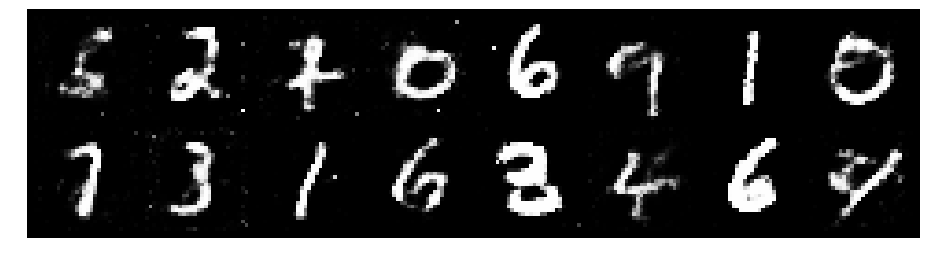

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2549, Generator Loss: 0.9246
D(x): 0.5734, D(G(z)): 0.4592


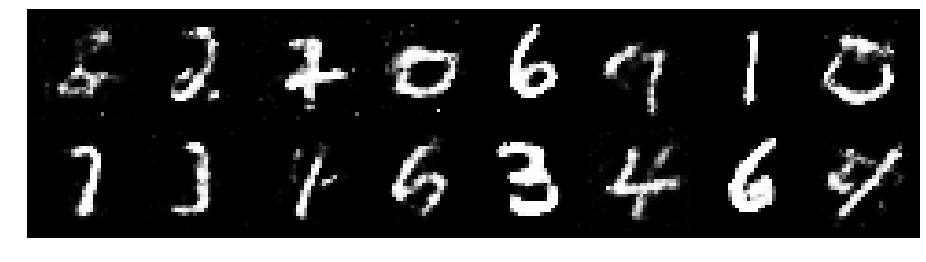

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2855, Generator Loss: 1.0733
D(x): 0.5815, D(G(z)): 0.4440


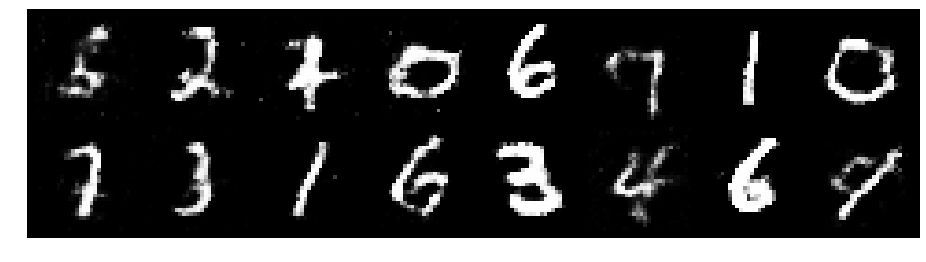

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2844, Generator Loss: 0.9712
D(x): 0.5575, D(G(z)): 0.4296


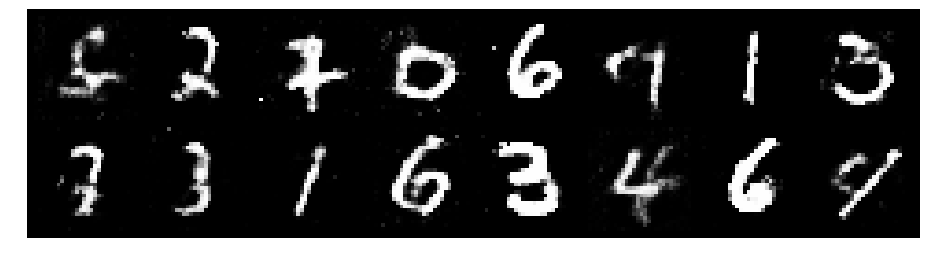

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.1725, Generator Loss: 0.9762
D(x): 0.5700, D(G(z)): 0.4260


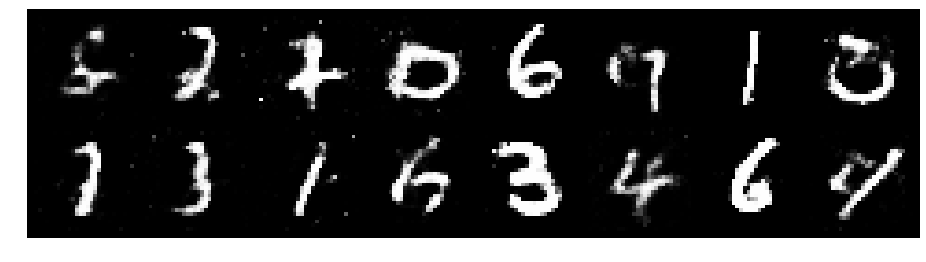

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2053, Generator Loss: 0.9215
D(x): 0.5485, D(G(z)): 0.4148


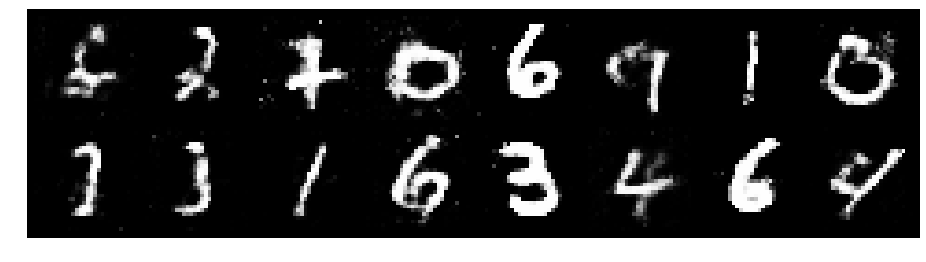

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2679, Generator Loss: 1.0049
D(x): 0.5317, D(G(z)): 0.4058


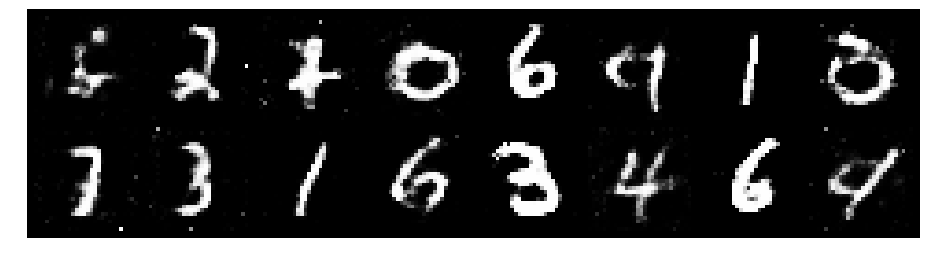

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2912, Generator Loss: 0.8297
D(x): 0.5515, D(G(z)): 0.4675


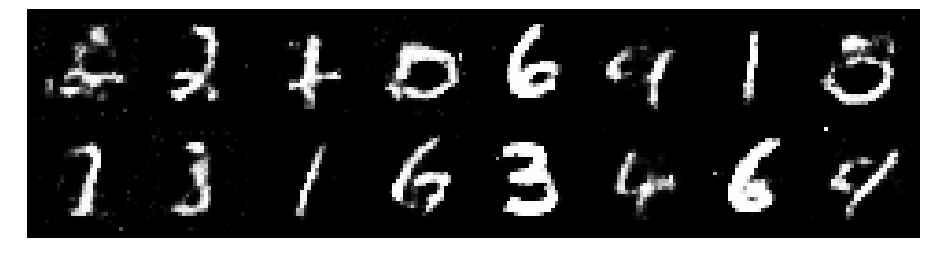

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2308, Generator Loss: 0.8223
D(x): 0.5711, D(G(z)): 0.4575


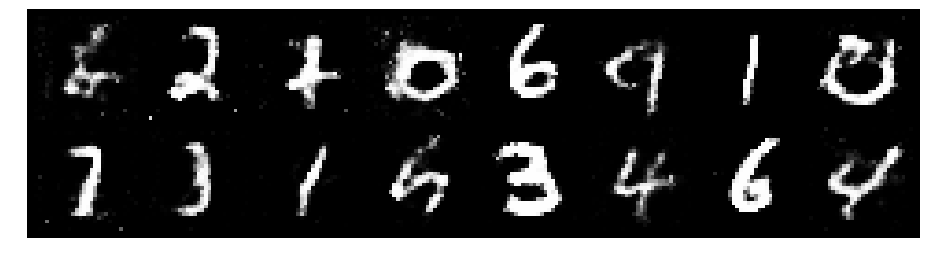

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8485
D(x): 0.5563, D(G(z)): 0.4734


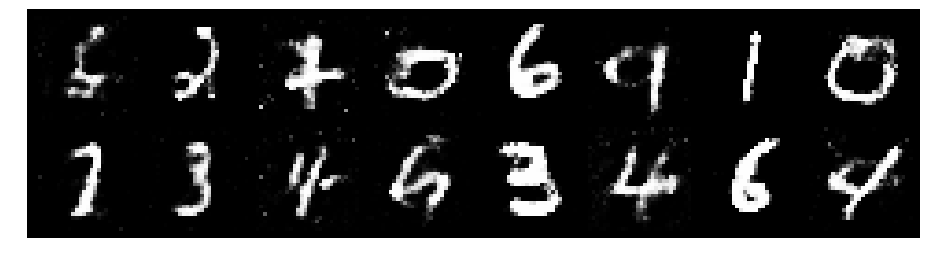

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2359, Generator Loss: 0.8140
D(x): 0.5647, D(G(z)): 0.4664


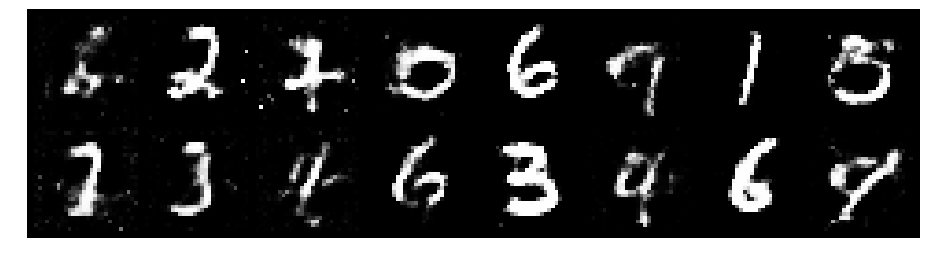

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.3473, Generator Loss: 0.9300
D(x): 0.5382, D(G(z)): 0.4638


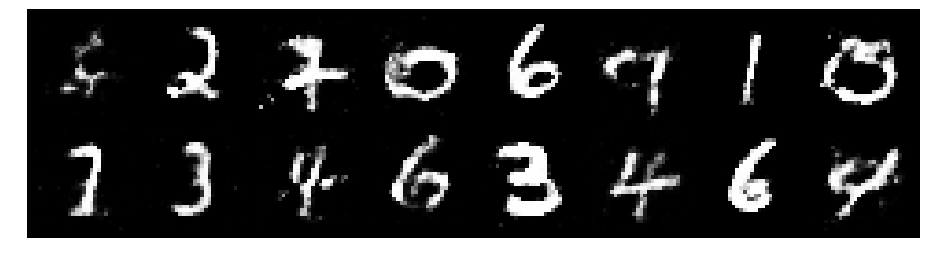

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3317, Generator Loss: 0.8572
D(x): 0.4935, D(G(z)): 0.4326


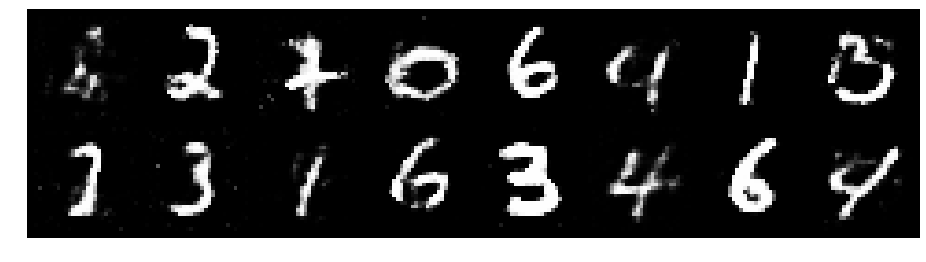

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3450, Generator Loss: 1.0231
D(x): 0.5109, D(G(z)): 0.4015


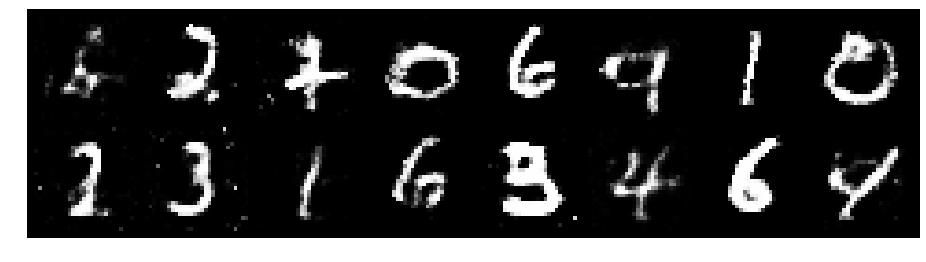

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3320, Generator Loss: 0.7928
D(x): 0.5524, D(G(z)): 0.4778


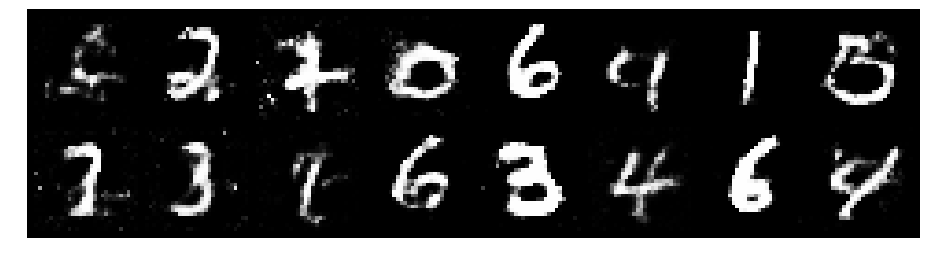

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3508, Generator Loss: 0.9211
D(x): 0.5435, D(G(z)): 0.4647


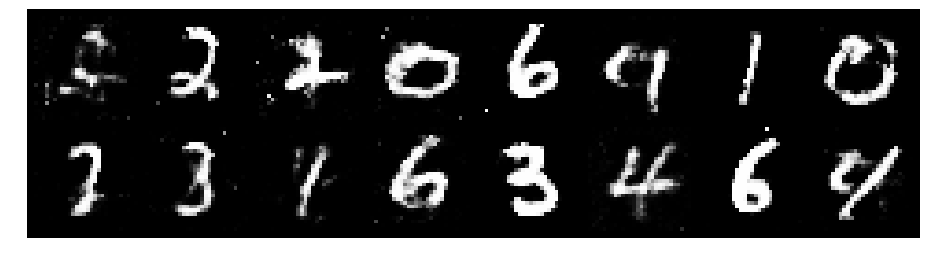

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3583, Generator Loss: 0.9433
D(x): 0.5297, D(G(z)): 0.4575


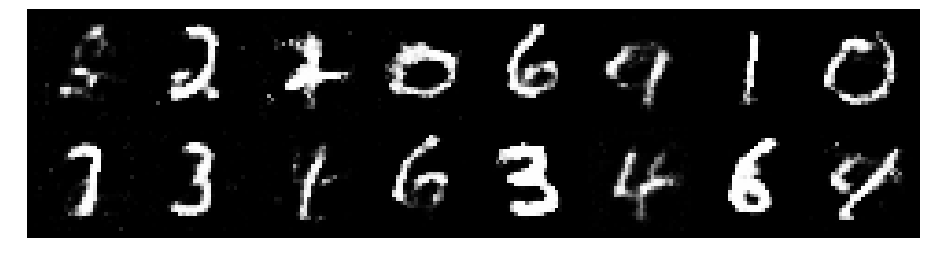

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2154, Generator Loss: 0.9154
D(x): 0.6083, D(G(z)): 0.4594


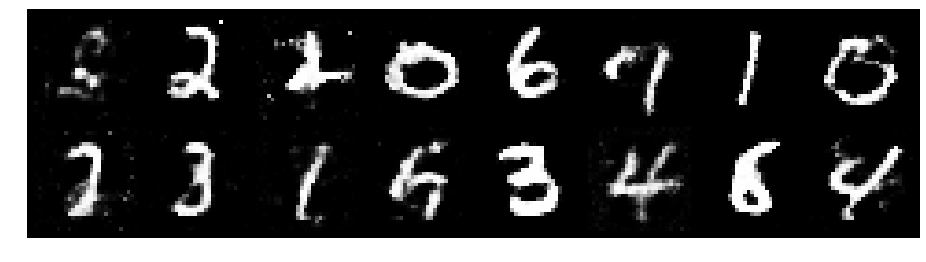

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3657, Generator Loss: 0.9287
D(x): 0.5254, D(G(z)): 0.4634


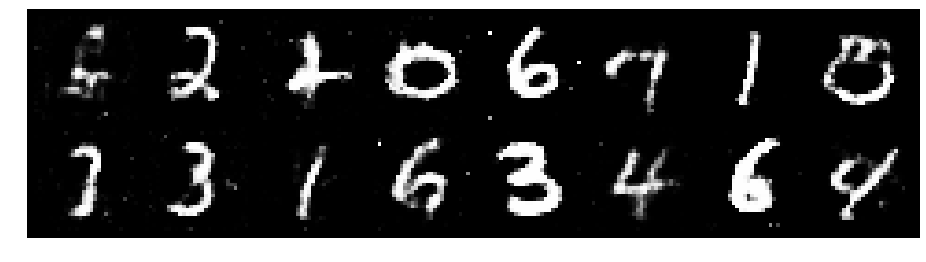

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.4468, Generator Loss: 0.9234
D(x): 0.5121, D(G(z)): 0.4717


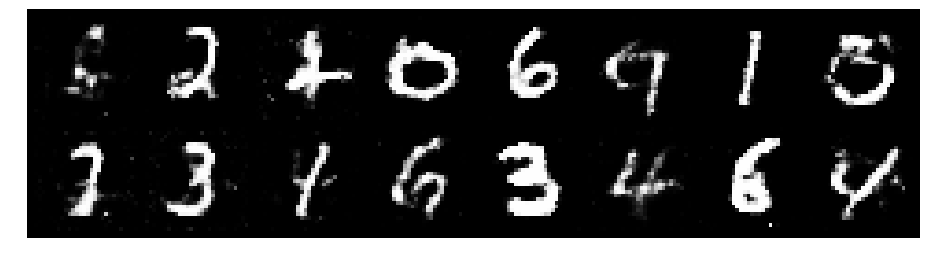

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.3880, Generator Loss: 0.8505
D(x): 0.5524, D(G(z)): 0.5056


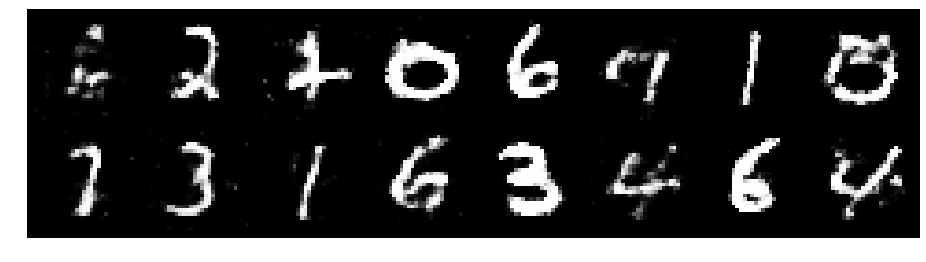

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.2860, Generator Loss: 0.8009
D(x): 0.5379, D(G(z)): 0.4481


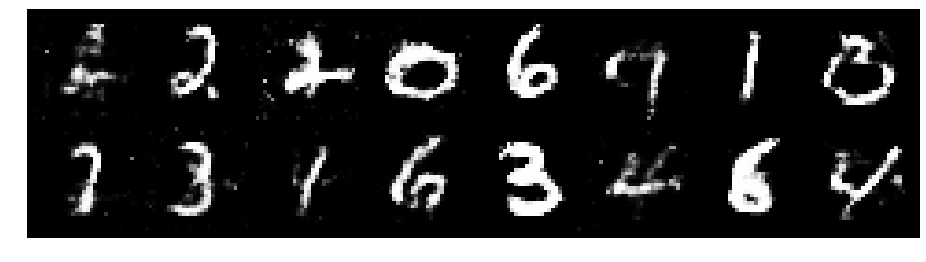

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2501, Generator Loss: 0.9420
D(x): 0.5539, D(G(z)): 0.4483


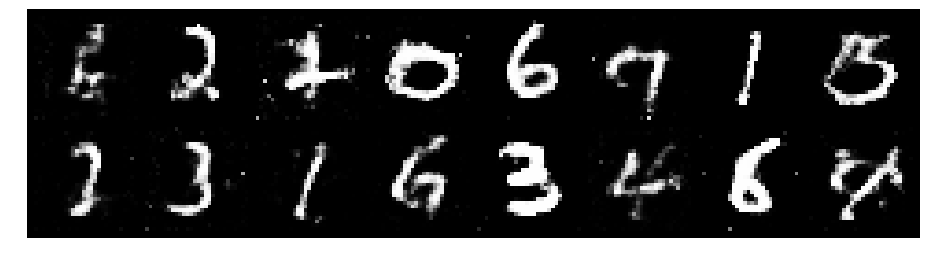

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.3833, Generator Loss: 0.8152
D(x): 0.5165, D(G(z)): 0.4803


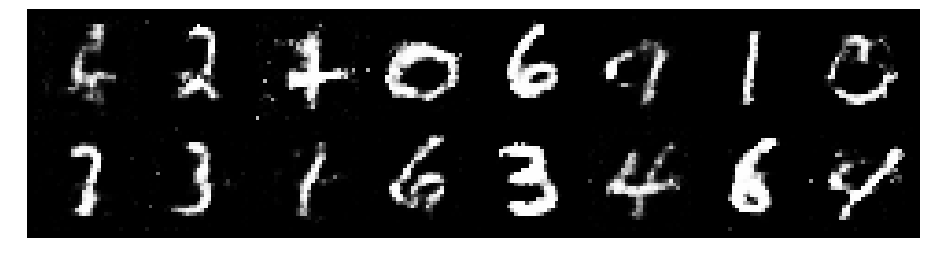

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3031, Generator Loss: 0.9341
D(x): 0.5047, D(G(z)): 0.4238


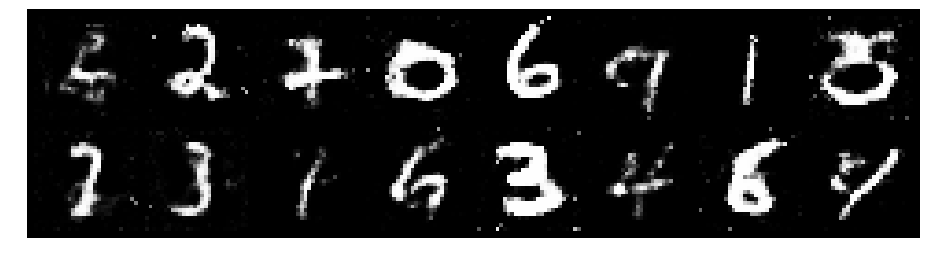

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9409
D(x): 0.5367, D(G(z)): 0.4048


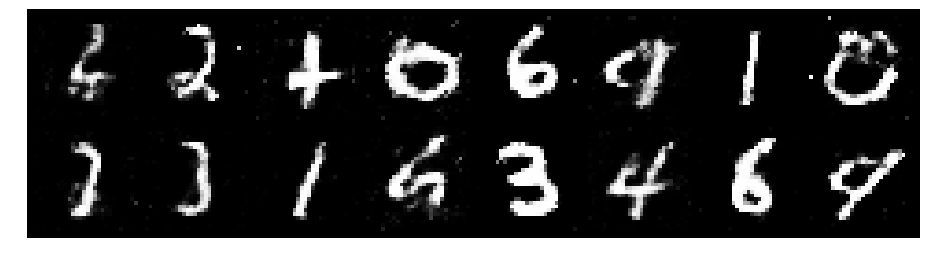

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.1729, Generator Loss: 0.9820
D(x): 0.5946, D(G(z)): 0.4442


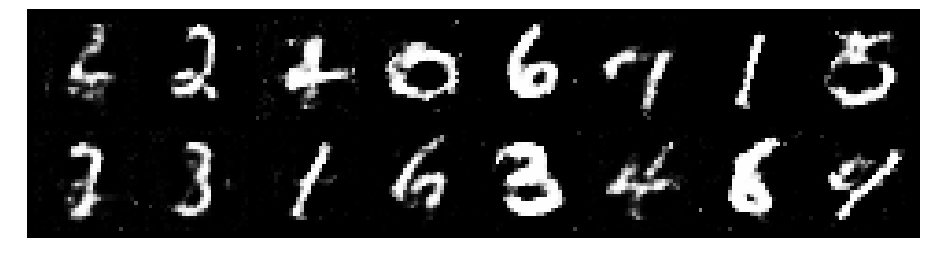

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2504, Generator Loss: 0.8333
D(x): 0.5272, D(G(z)): 0.4226


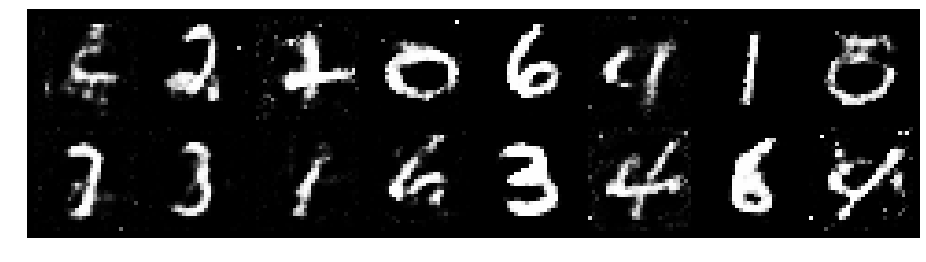

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8285
D(x): 0.5793, D(G(z)): 0.4740


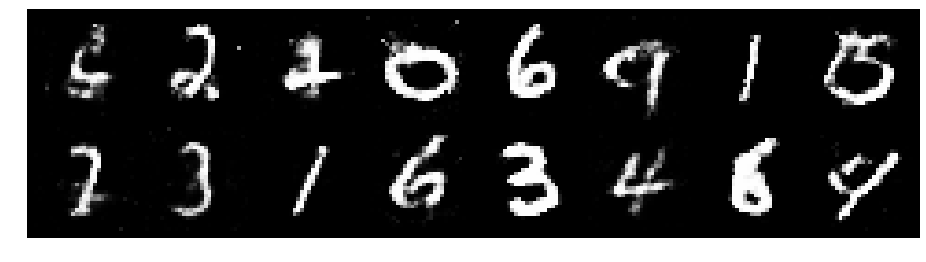

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8445
D(x): 0.5732, D(G(z)): 0.4549


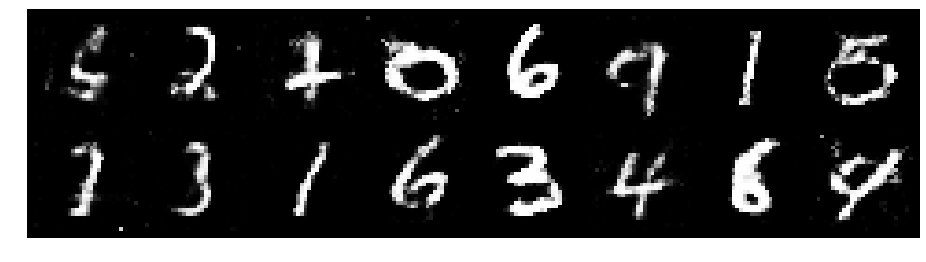

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.3437, Generator Loss: 0.9153
D(x): 0.5505, D(G(z)): 0.4620


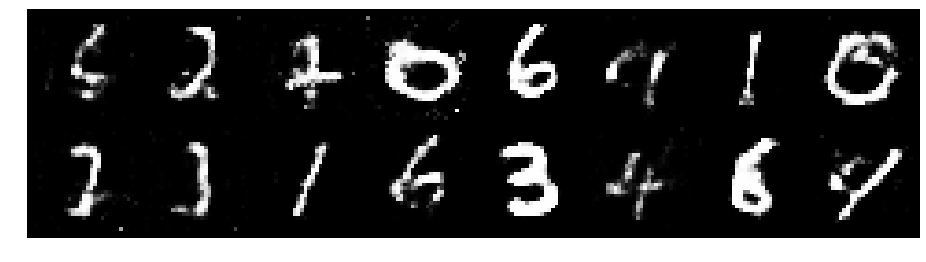

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.1858, Generator Loss: 1.0470
D(x): 0.5569, D(G(z)): 0.3937


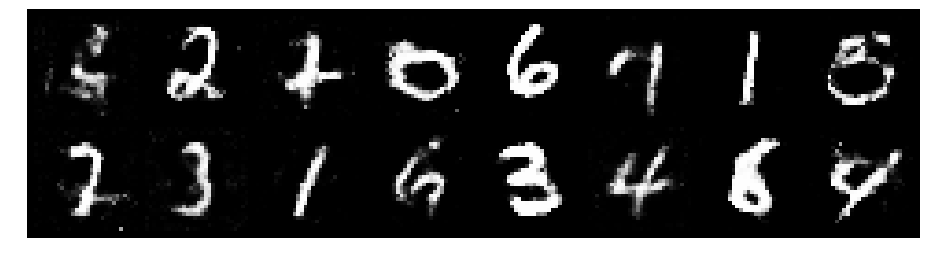

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.3367, Generator Loss: 0.8991
D(x): 0.4974, D(G(z)): 0.4307


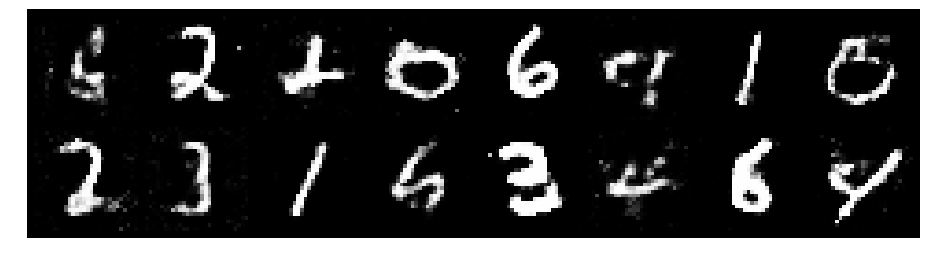

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 0.9992
D(x): 0.5378, D(G(z)): 0.4056


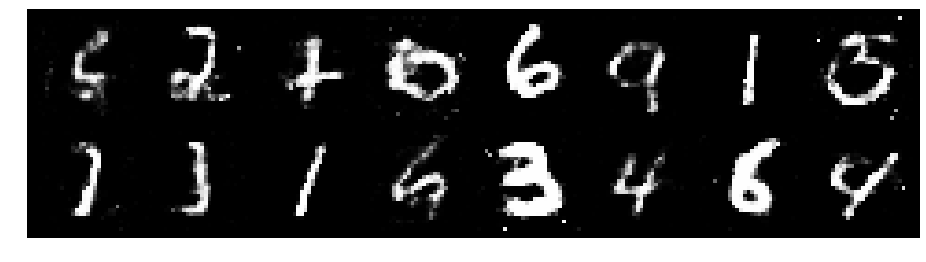

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.1919, Generator Loss: 0.9821
D(x): 0.6031, D(G(z)): 0.4363


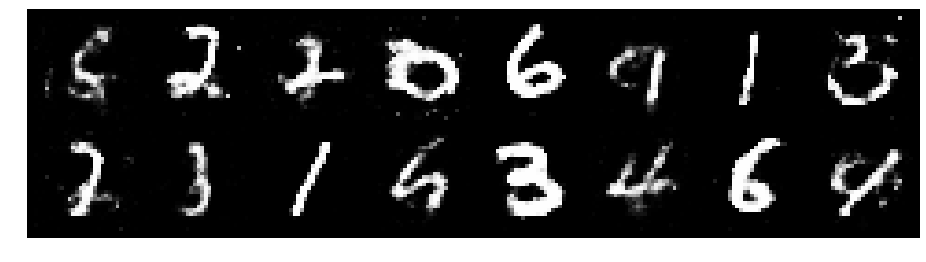

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.2877, Generator Loss: 0.7706
D(x): 0.5679, D(G(z)): 0.4614


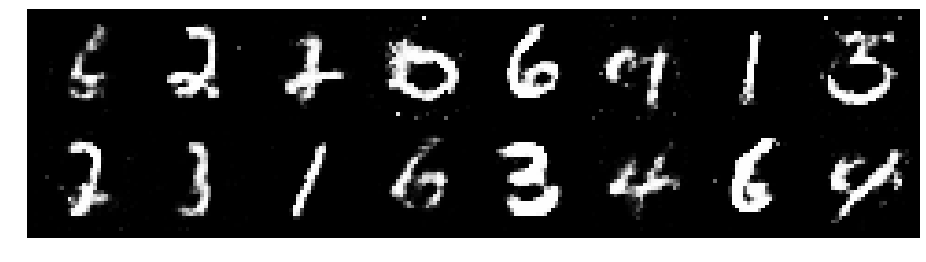

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.2817, Generator Loss: 0.9422
D(x): 0.5790, D(G(z)): 0.4546


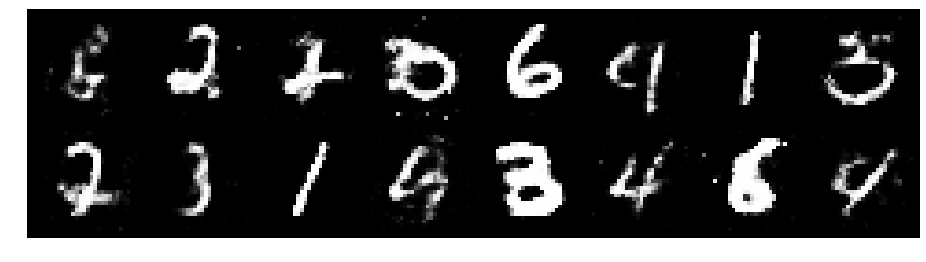

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2744, Generator Loss: 1.0000
D(x): 0.5655, D(G(z)): 0.4404


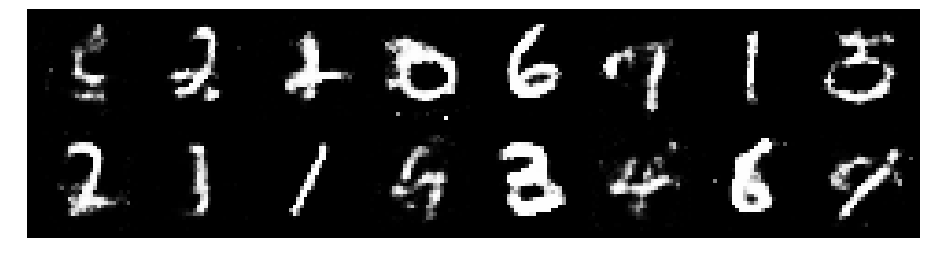

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.2075, Generator Loss: 0.8816
D(x): 0.6104, D(G(z)): 0.4703


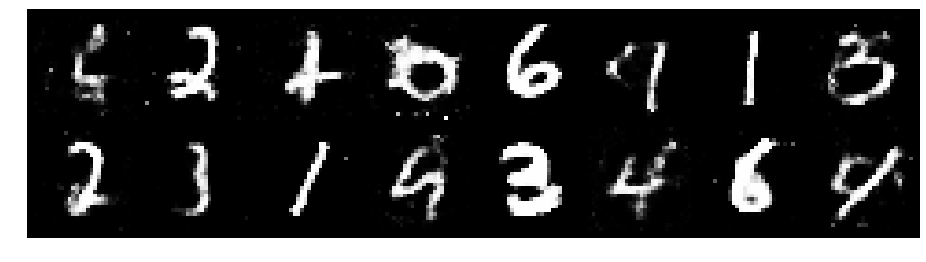

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.3164, Generator Loss: 1.0903
D(x): 0.5221, D(G(z)): 0.4354


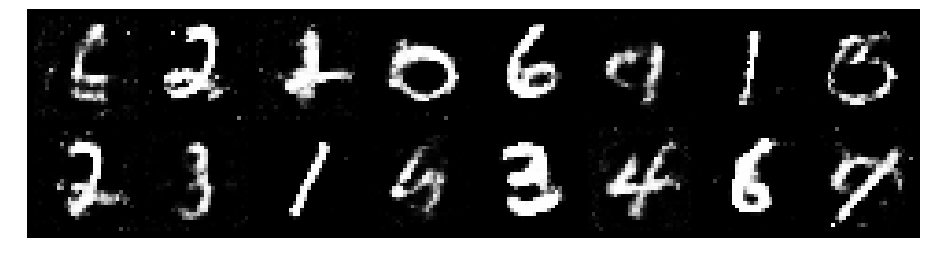

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.3966, Generator Loss: 0.8073
D(x): 0.5075, D(G(z)): 0.4605


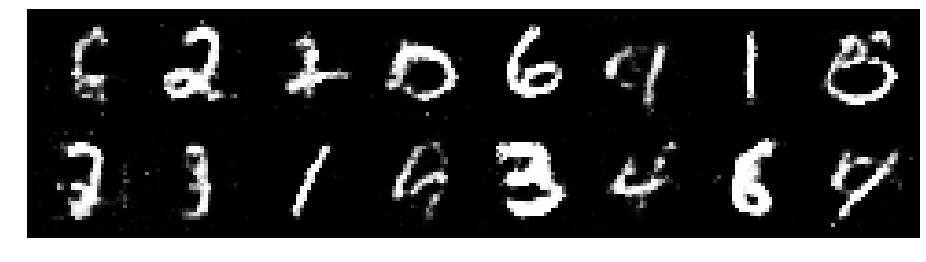

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.4126, Generator Loss: 0.9274
D(x): 0.4887, D(G(z)): 0.4499


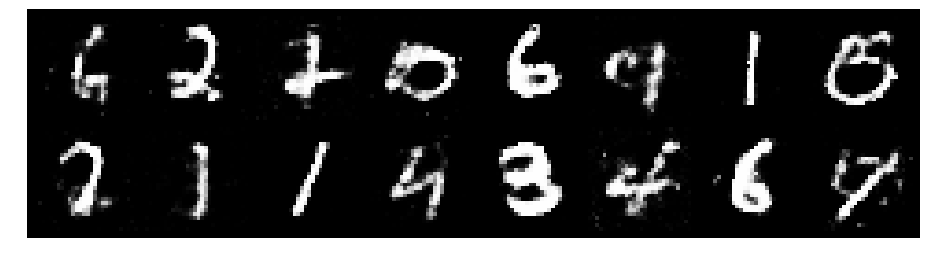

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2329, Generator Loss: 0.8135
D(x): 0.5910, D(G(z)): 0.4682


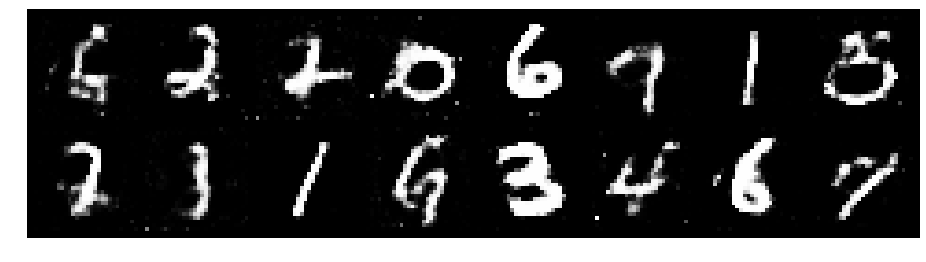

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.3128, Generator Loss: 0.8444
D(x): 0.5123, D(G(z)): 0.4346


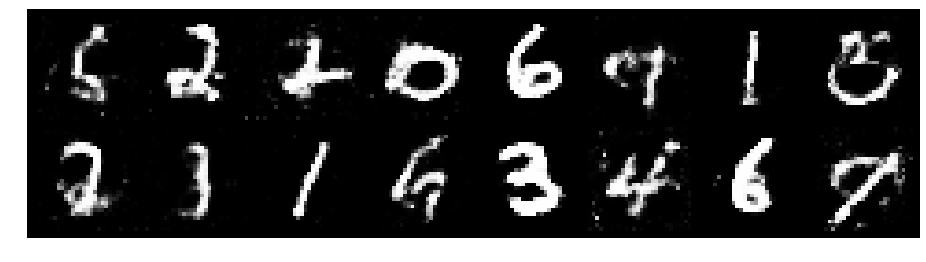

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.3003, Generator Loss: 0.8876
D(x): 0.5382, D(G(z)): 0.4453


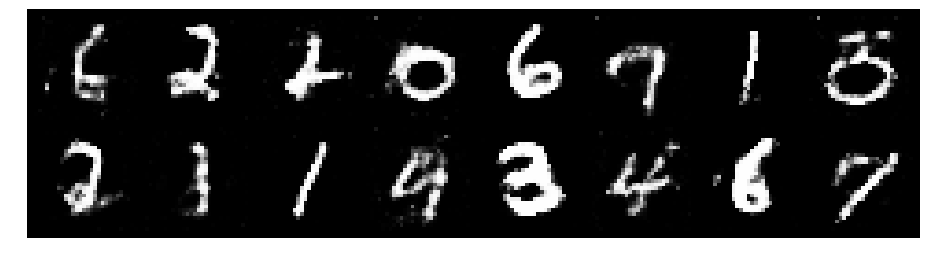

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.4104, Generator Loss: 0.8474
D(x): 0.5726, D(G(z)): 0.5265


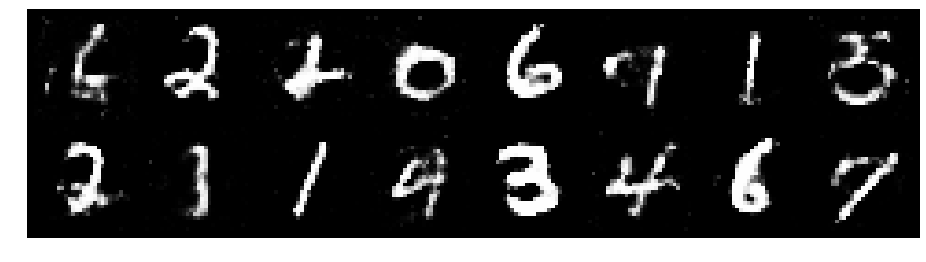

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3171, Generator Loss: 0.9751
D(x): 0.5482, D(G(z)): 0.4683


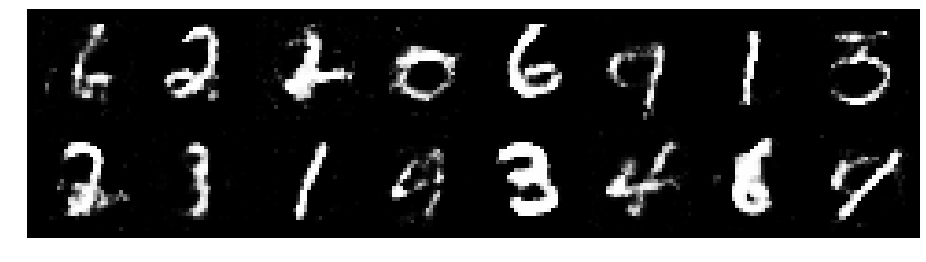

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2992, Generator Loss: 0.8238
D(x): 0.5511, D(G(z)): 0.4733


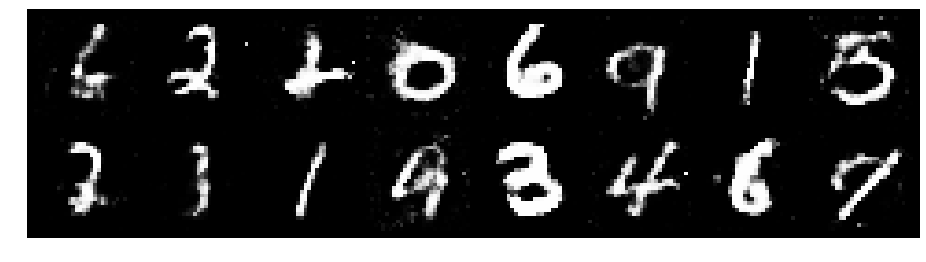

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2297, Generator Loss: 0.8900
D(x): 0.5433, D(G(z)): 0.4235


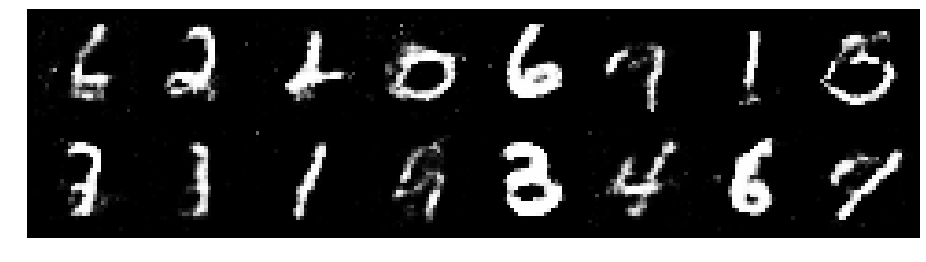

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2397, Generator Loss: 0.9467
D(x): 0.5776, D(G(z)): 0.4562


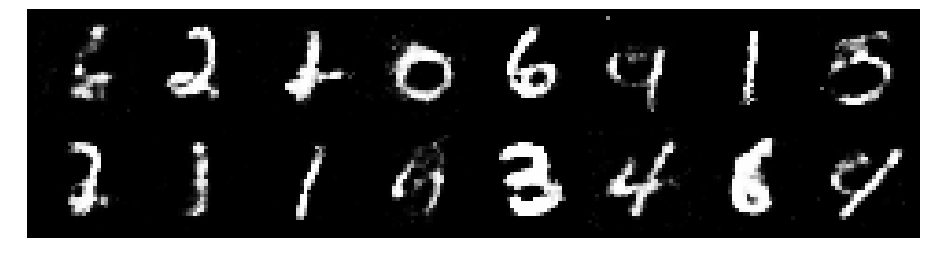

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2161, Generator Loss: 0.9861
D(x): 0.5848, D(G(z)): 0.4309


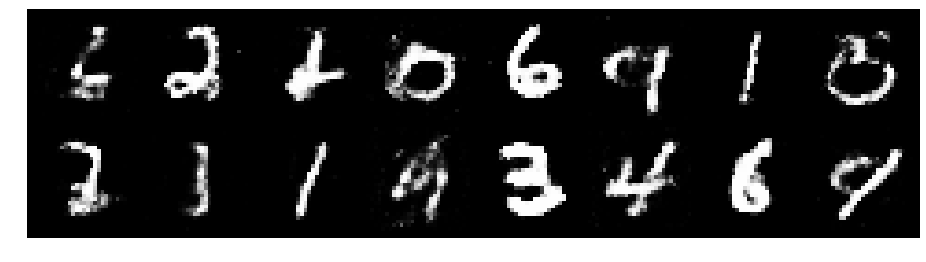

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2507, Generator Loss: 0.9011
D(x): 0.5532, D(G(z)): 0.4369


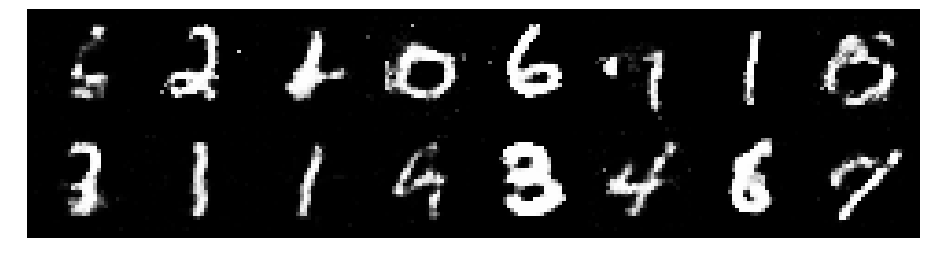

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.3774, Generator Loss: 0.9277
D(x): 0.5008, D(G(z)): 0.4167


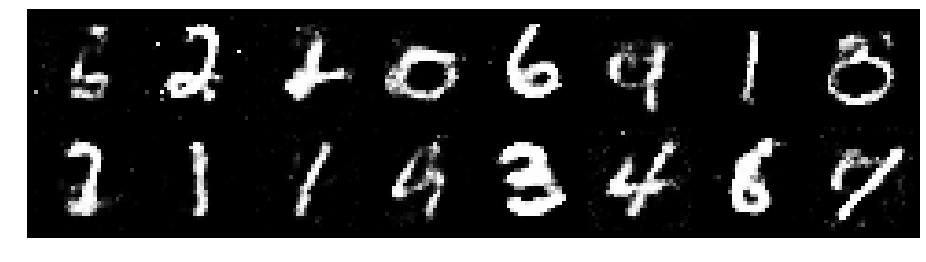

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.3277, Generator Loss: 0.9000
D(x): 0.5344, D(G(z)): 0.4583


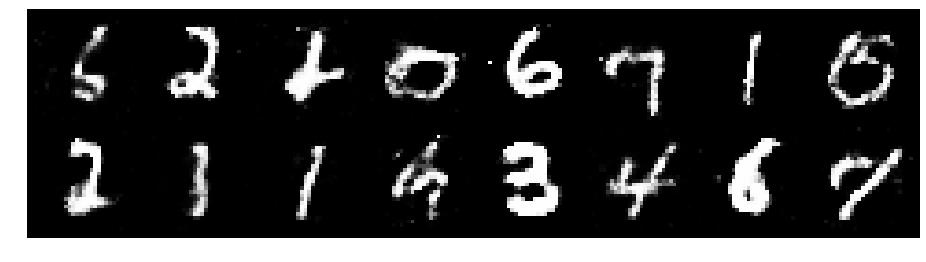

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.3525, Generator Loss: 0.9045
D(x): 0.5386, D(G(z)): 0.4695


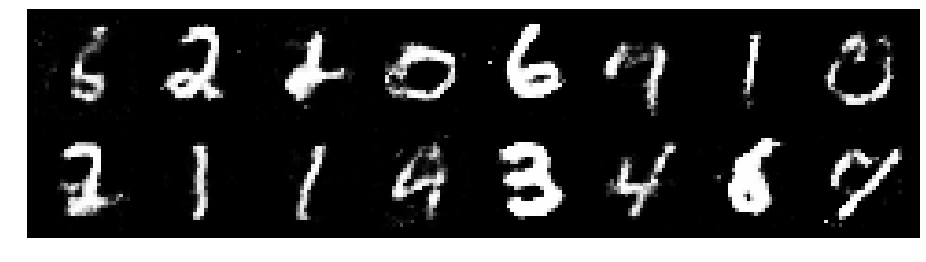

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.4365, Generator Loss: 1.0758
D(x): 0.5164, D(G(z)): 0.4580


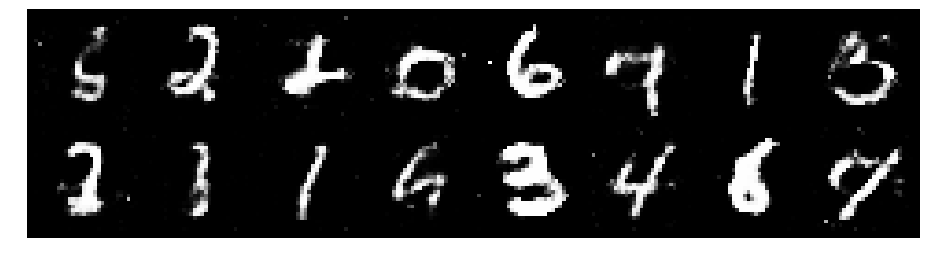

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.1915, Generator Loss: 1.1038
D(x): 0.5770, D(G(z)): 0.3940


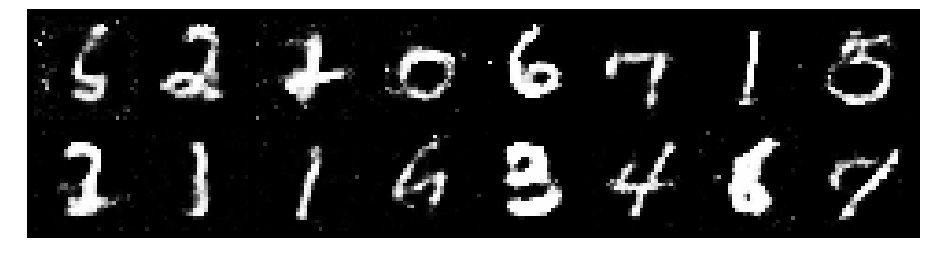

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2418, Generator Loss: 0.7483
D(x): 0.5950, D(G(z)): 0.4681


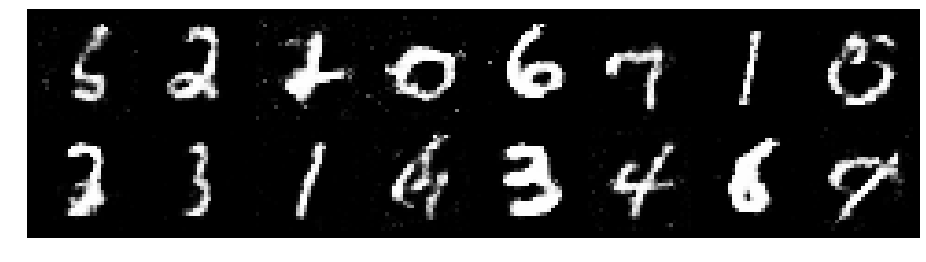

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2955, Generator Loss: 1.0079
D(x): 0.5612, D(G(z)): 0.4536


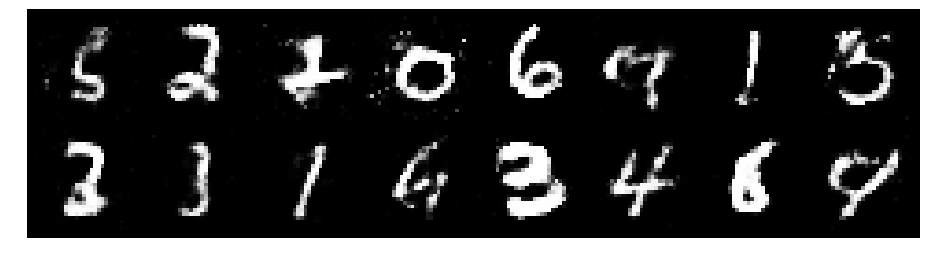

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3427, Generator Loss: 0.8457
D(x): 0.5292, D(G(z)): 0.4641


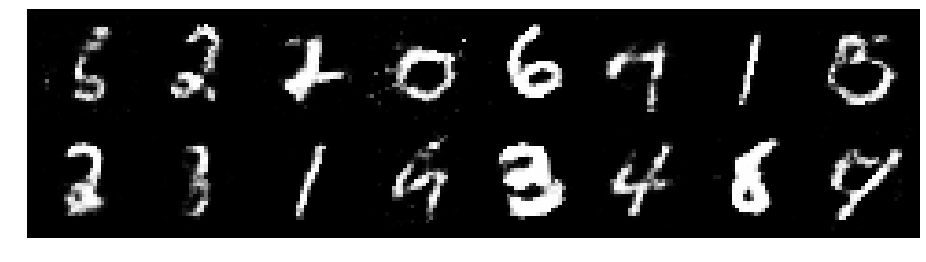

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3654, Generator Loss: 0.7813
D(x): 0.5441, D(G(z)): 0.4917


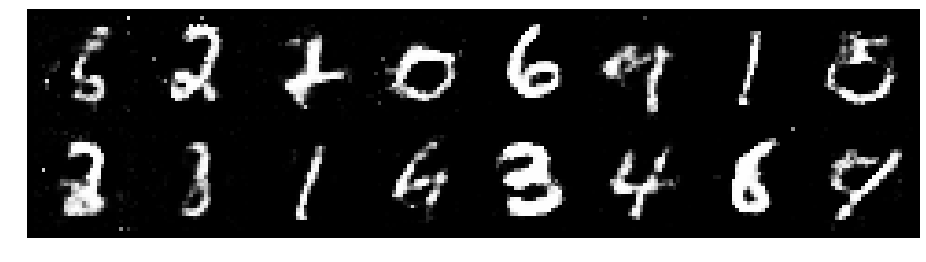

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9402
D(x): 0.5303, D(G(z)): 0.4328


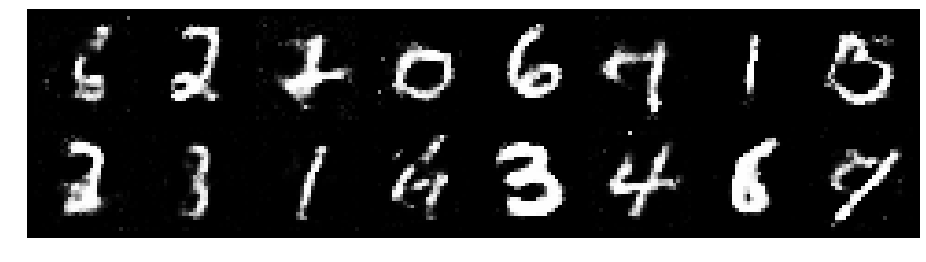

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.1760, Generator Loss: 0.9930
D(x): 0.5940, D(G(z)): 0.4323


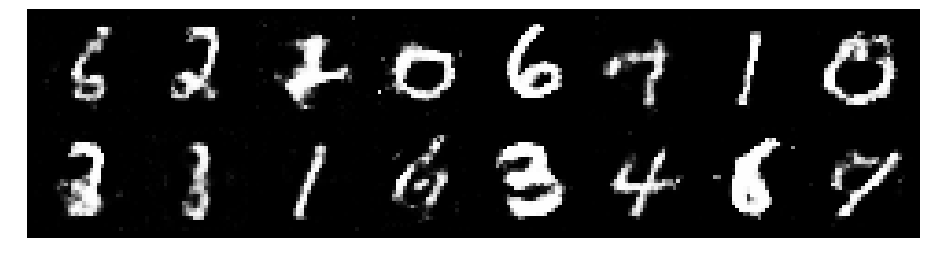

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3363, Generator Loss: 0.9921
D(x): 0.5804, D(G(z)): 0.4615


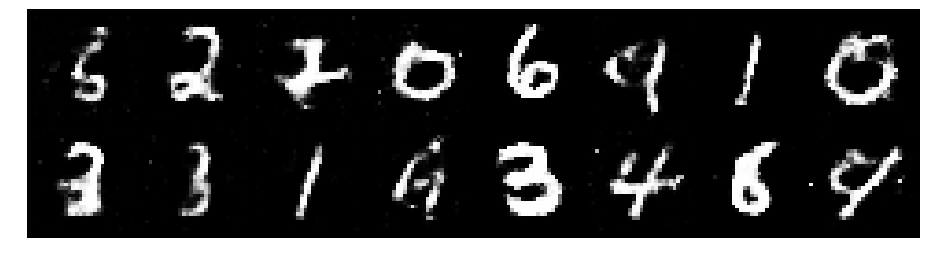

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2941, Generator Loss: 0.8347
D(x): 0.5557, D(G(z)): 0.4707


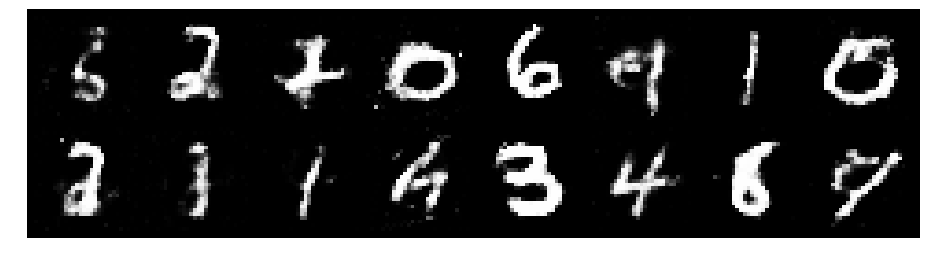

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.3293, Generator Loss: 0.7970
D(x): 0.5319, D(G(z)): 0.4419


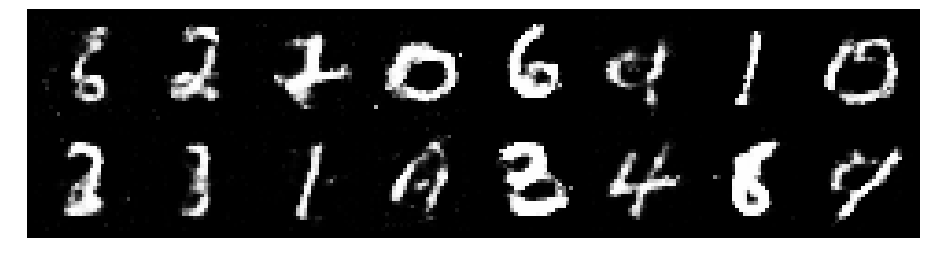

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.3104, Generator Loss: 0.8396
D(x): 0.5688, D(G(z)): 0.4908


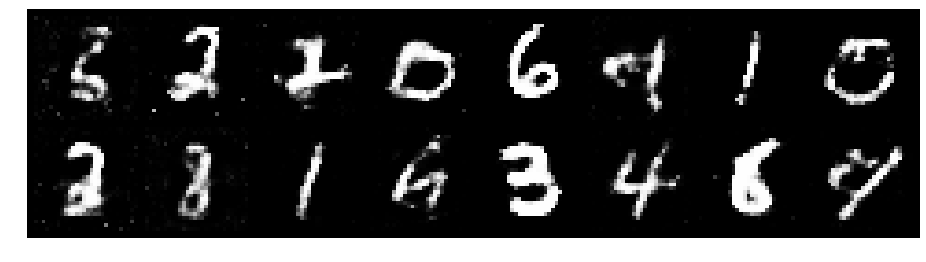

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2038, Generator Loss: 1.0100
D(x): 0.5424, D(G(z)): 0.3957


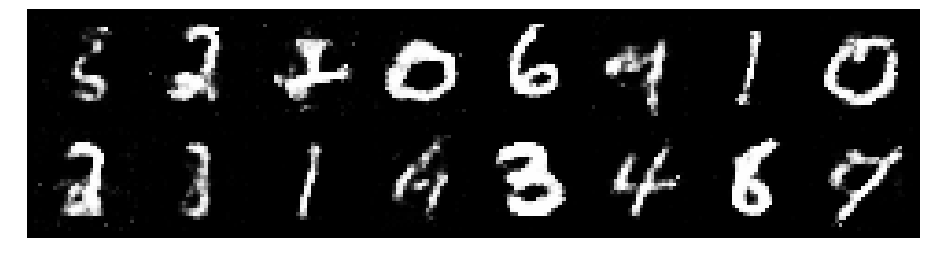

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.4382, Generator Loss: 0.9163
D(x): 0.5363, D(G(z)): 0.4890


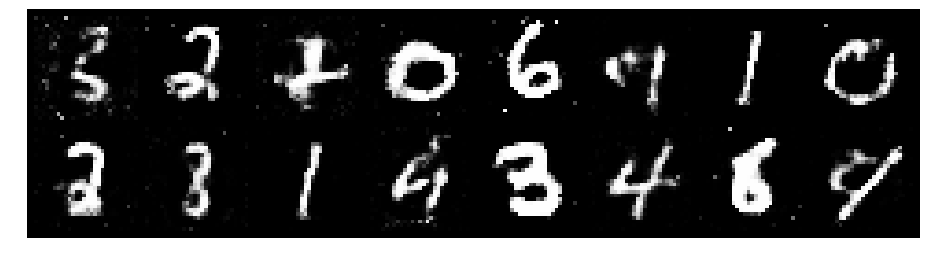

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.3628, Generator Loss: 0.9751
D(x): 0.5040, D(G(z)): 0.4534


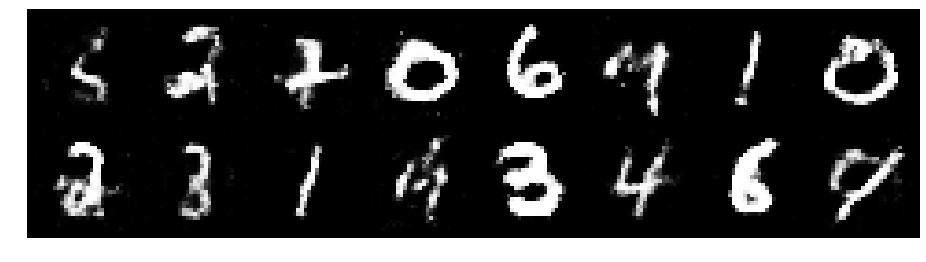

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2569, Generator Loss: 0.8962
D(x): 0.5842, D(G(z)): 0.4657


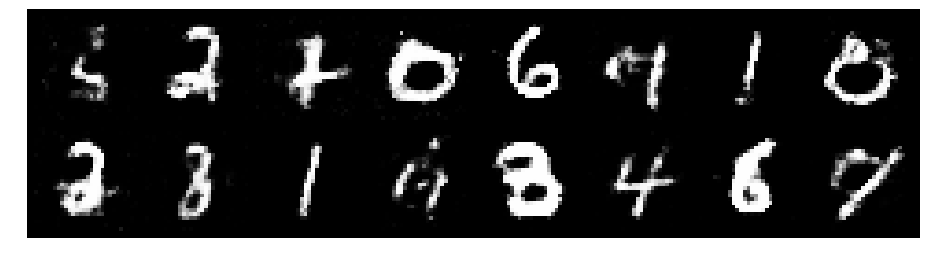

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2644, Generator Loss: 0.8222
D(x): 0.5449, D(G(z)): 0.4446


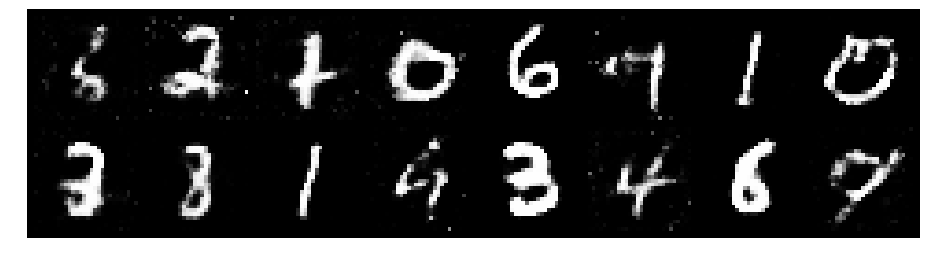

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2242, Generator Loss: 0.8798
D(x): 0.5554, D(G(z)): 0.4202


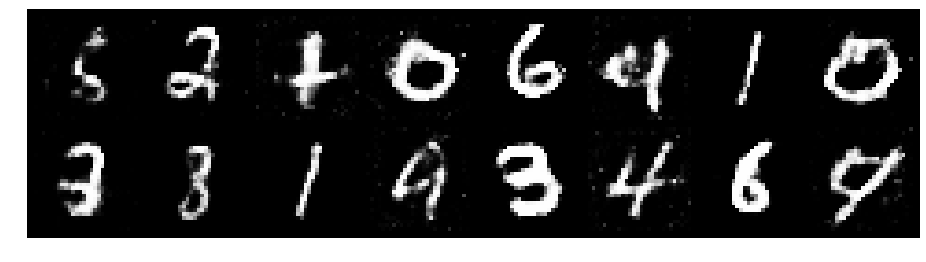

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.2801, Generator Loss: 0.8477
D(x): 0.5865, D(G(z)): 0.4838


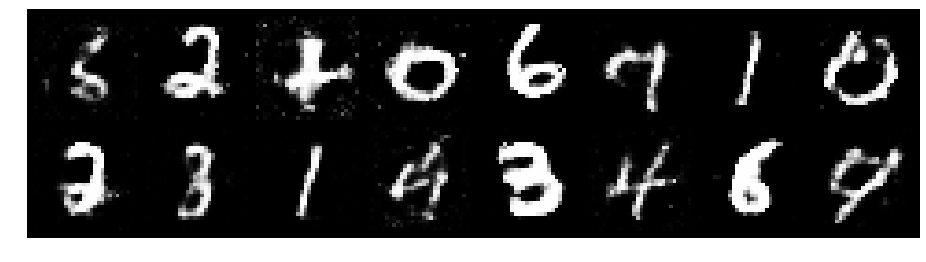

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8675
D(x): 0.5679, D(G(z)): 0.4392


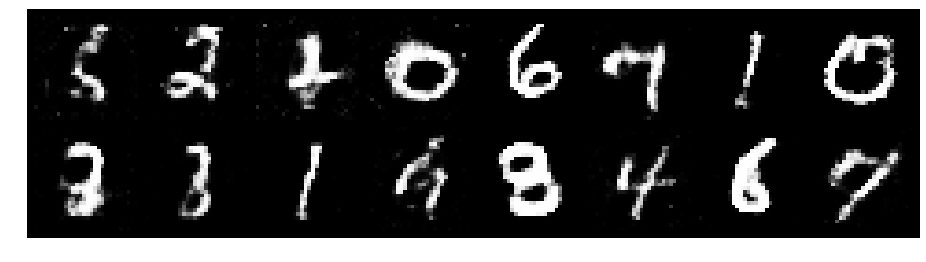

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.3137, Generator Loss: 0.8416
D(x): 0.5404, D(G(z)): 0.4311


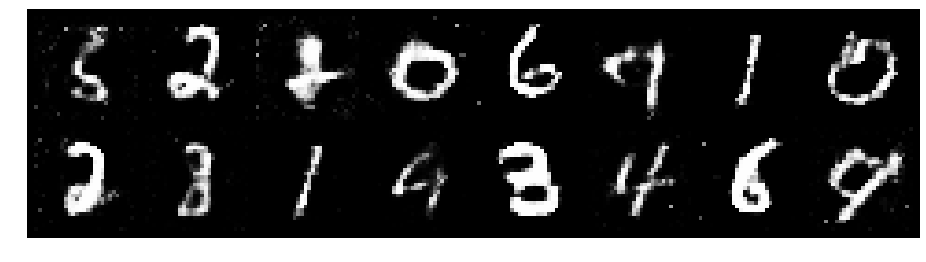

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3685, Generator Loss: 0.8758
D(x): 0.5133, D(G(z)): 0.4274


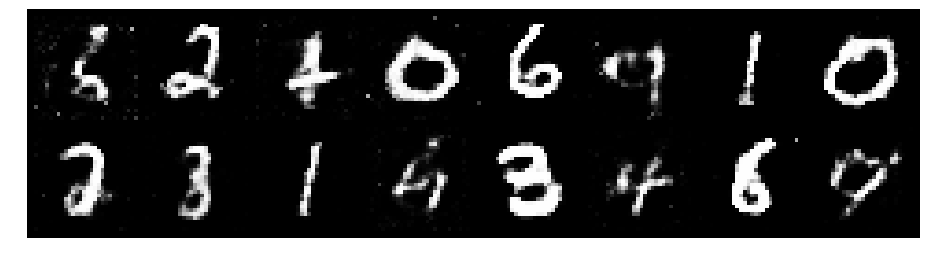

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3059, Generator Loss: 0.8145
D(x): 0.5201, D(G(z)): 0.4325


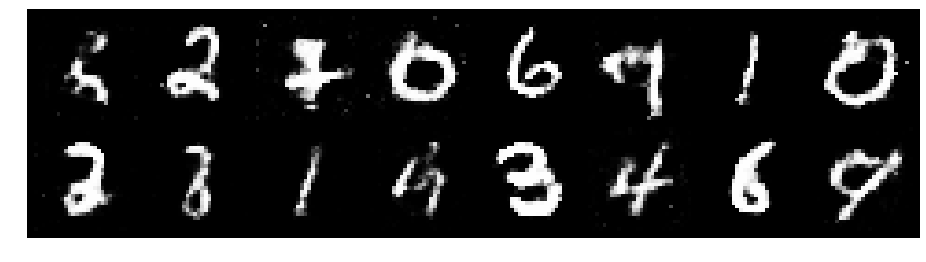

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3873, Generator Loss: 0.8900
D(x): 0.5268, D(G(z)): 0.4606


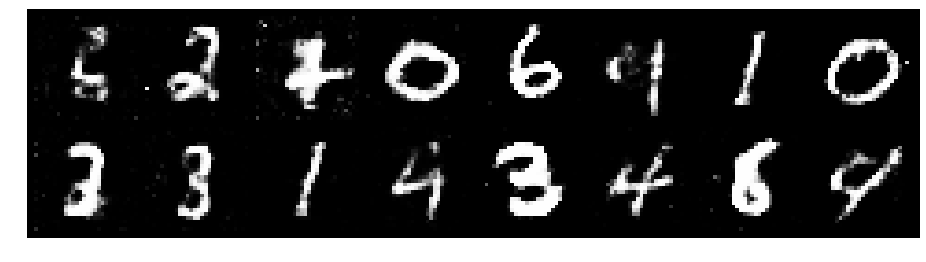

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3066, Generator Loss: 0.6971
D(x): 0.5923, D(G(z)): 0.5053


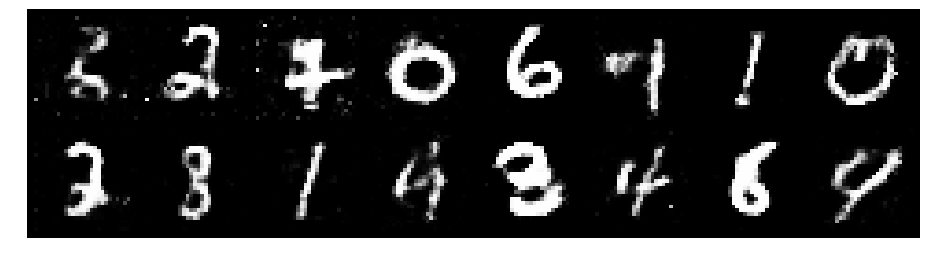

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2997, Generator Loss: 0.9211
D(x): 0.5483, D(G(z)): 0.4632


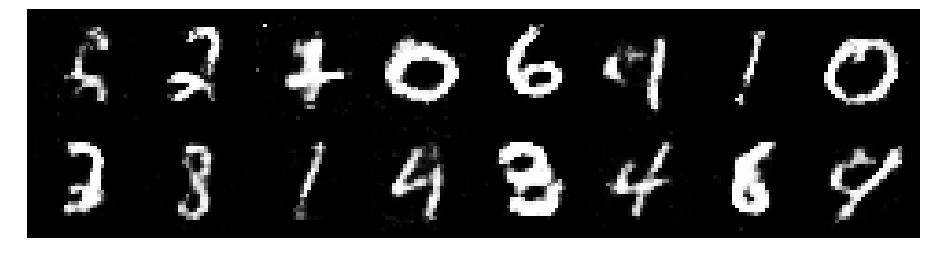

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2090, Generator Loss: 1.0057
D(x): 0.5740, D(G(z)): 0.4215


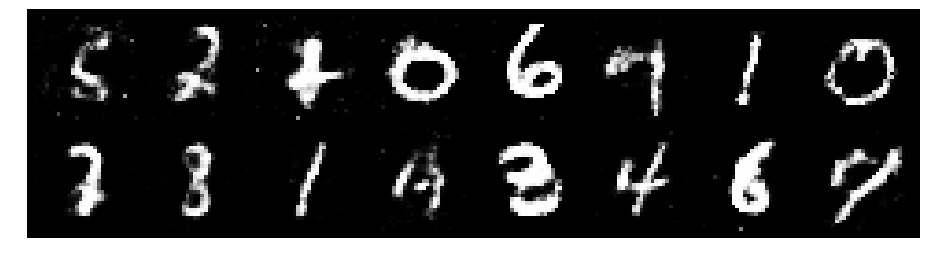

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2399, Generator Loss: 0.9212
D(x): 0.5784, D(G(z)): 0.4405


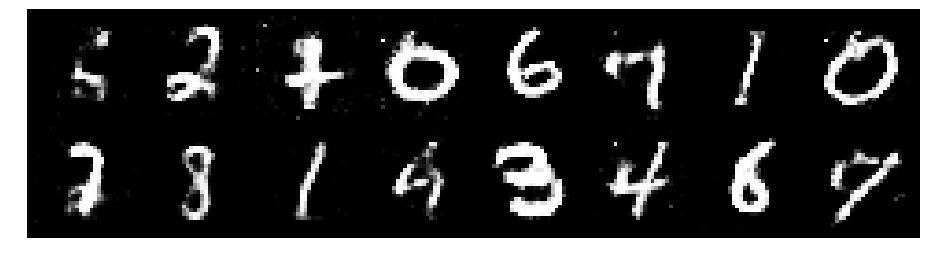

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3056, Generator Loss: 0.8482
D(x): 0.5282, D(G(z)): 0.4363


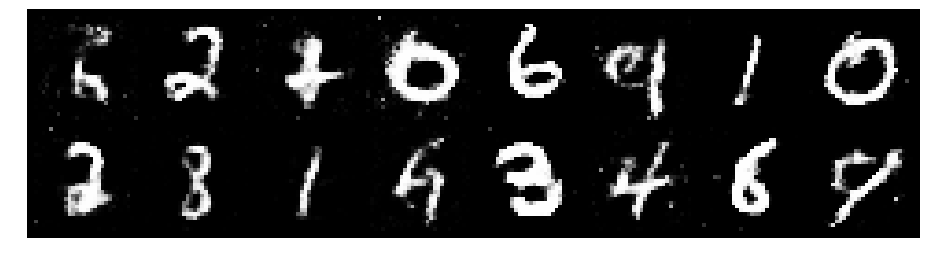

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2057, Generator Loss: 0.9396
D(x): 0.5752, D(G(z)): 0.4300


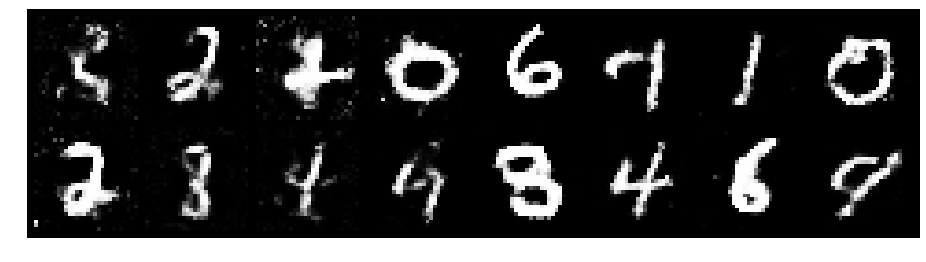

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2474, Generator Loss: 0.8961
D(x): 0.5743, D(G(z)): 0.4514


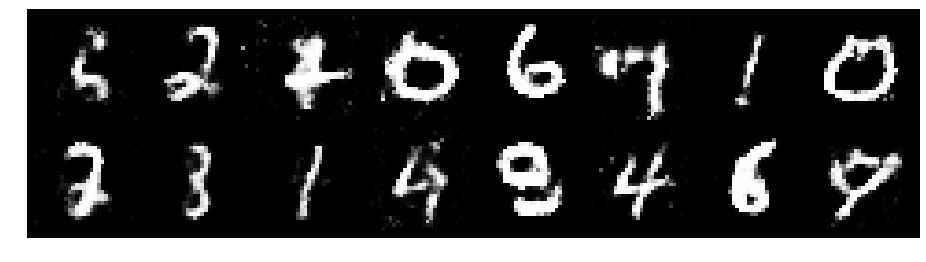

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.4018, Generator Loss: 0.8012
D(x): 0.5016, D(G(z)): 0.4664


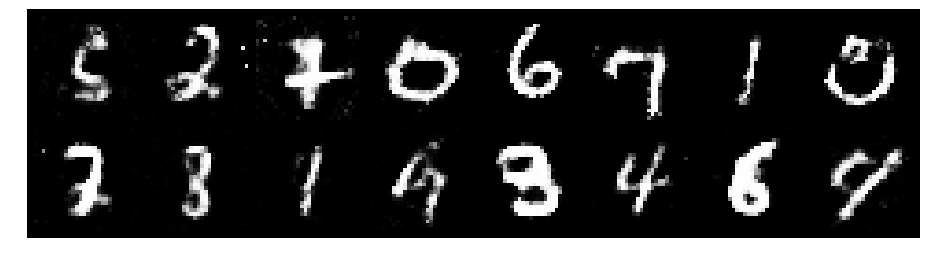

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.2744, Generator Loss: 0.8262
D(x): 0.5903, D(G(z)): 0.4814


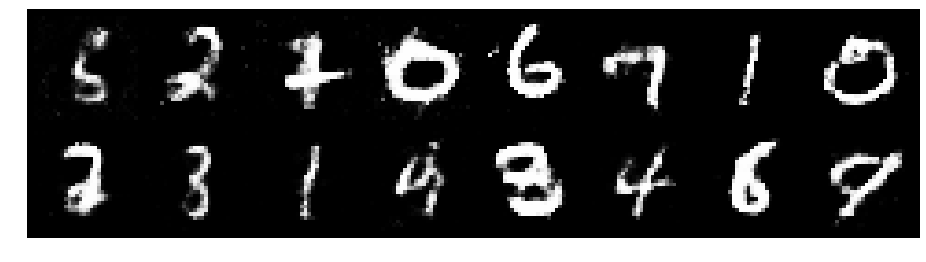

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.2678, Generator Loss: 1.0687
D(x): 0.5333, D(G(z)): 0.4228


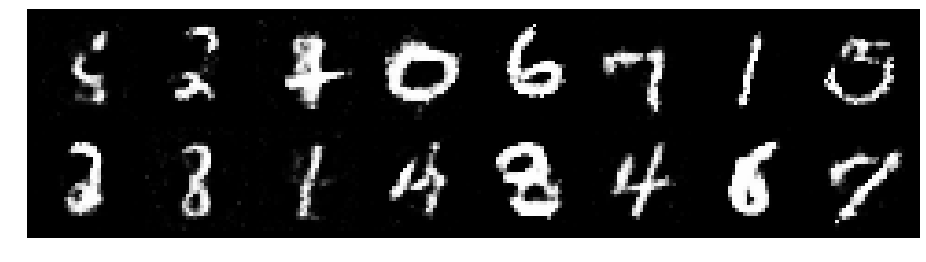

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2326, Generator Loss: 0.8984
D(x): 0.5877, D(G(z)): 0.4659


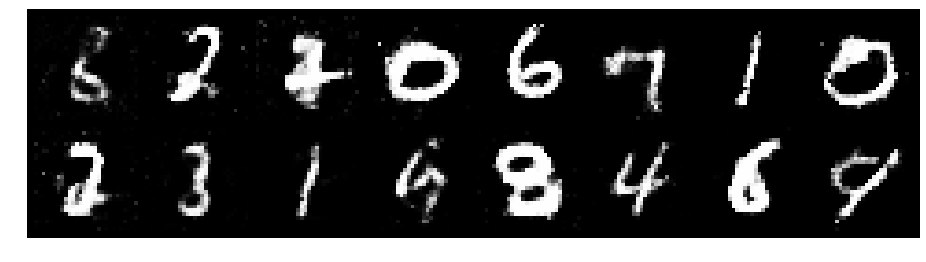

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2404, Generator Loss: 0.8963
D(x): 0.5313, D(G(z)): 0.4250


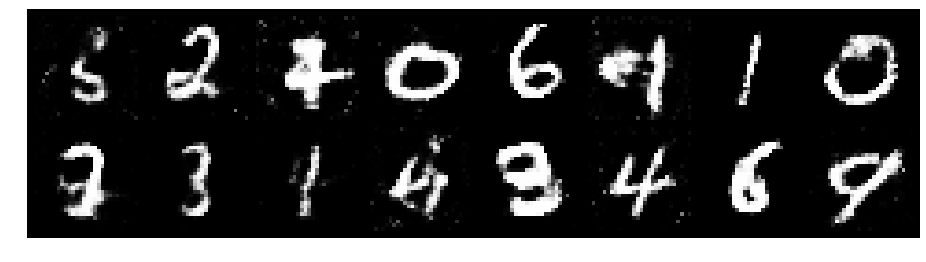

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3968, Generator Loss: 0.7812
D(x): 0.5396, D(G(z)): 0.4925


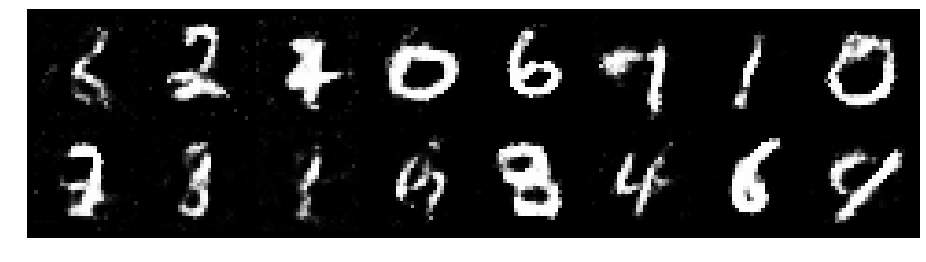

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.3640, Generator Loss: 0.7978
D(x): 0.5388, D(G(z)): 0.4703


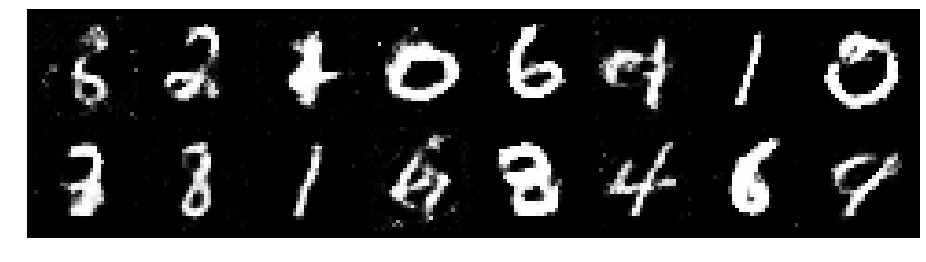

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.2622, Generator Loss: 0.8189
D(x): 0.5863, D(G(z)): 0.4628


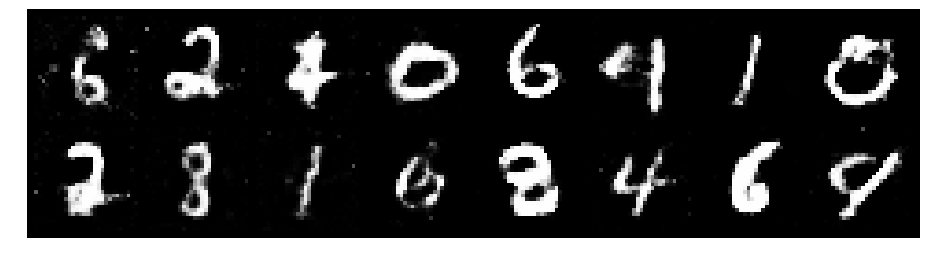

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8841
D(x): 0.5558, D(G(z)): 0.4551


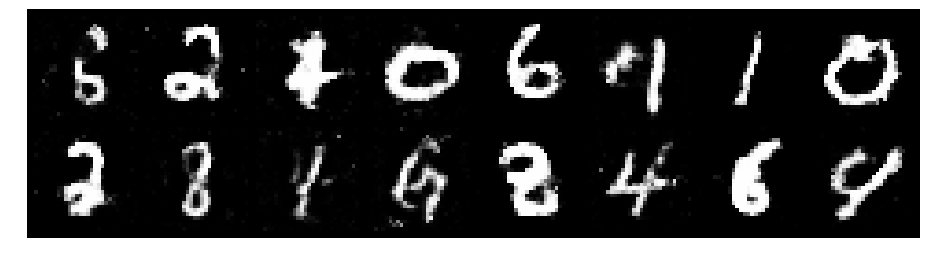

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.3327, Generator Loss: 0.8022
D(x): 0.5370, D(G(z)): 0.4568


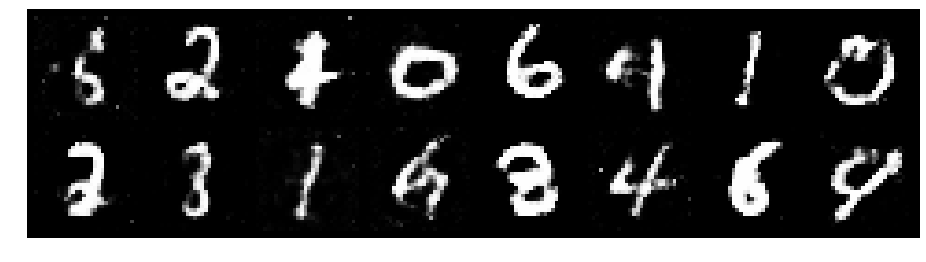

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8912
D(x): 0.5100, D(G(z)): 0.4004


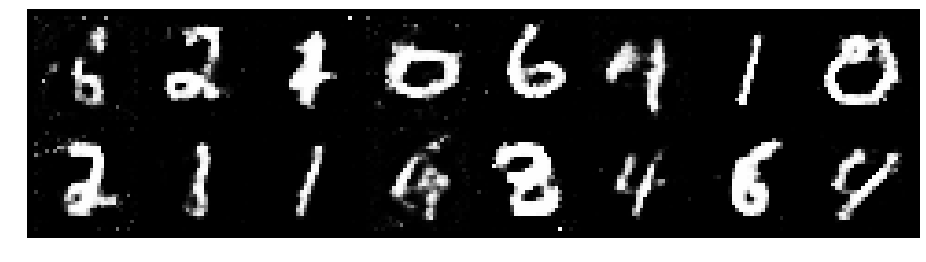

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.2669, Generator Loss: 0.9004
D(x): 0.5604, D(G(z)): 0.4396


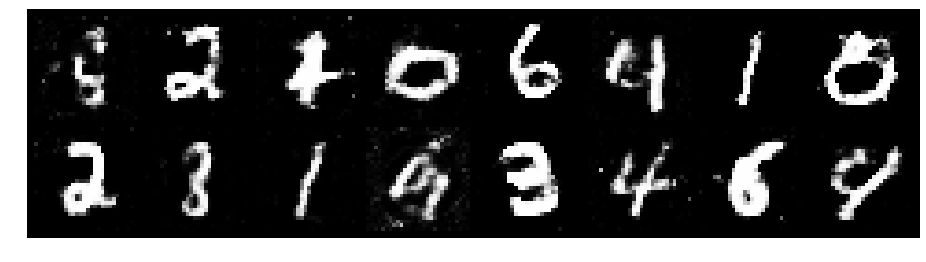

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2558, Generator Loss: 0.9948
D(x): 0.5816, D(G(z)): 0.4524


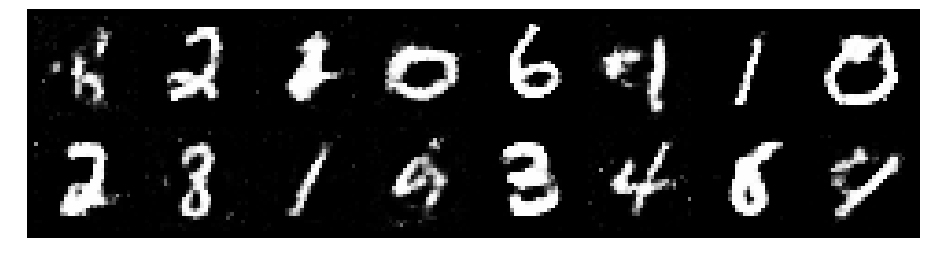

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9153
D(x): 0.5703, D(G(z)): 0.4338


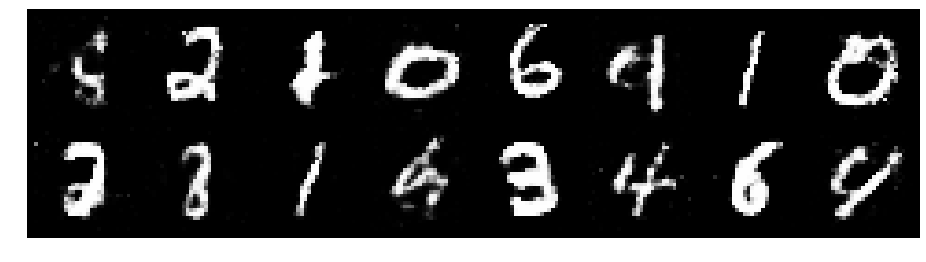

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.1759, Generator Loss: 1.0063
D(x): 0.6082, D(G(z)): 0.4416


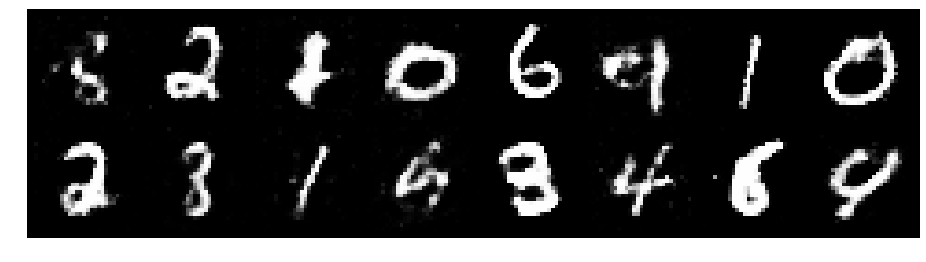

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.1997, Generator Loss: 1.1267
D(x): 0.5674, D(G(z)): 0.4119


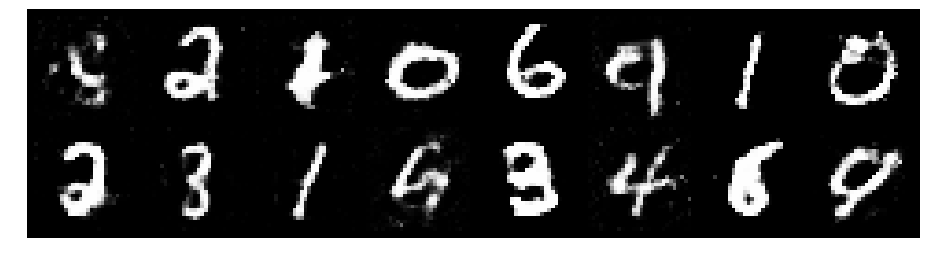

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.3234, Generator Loss: 0.9896
D(x): 0.5538, D(G(z)): 0.4245


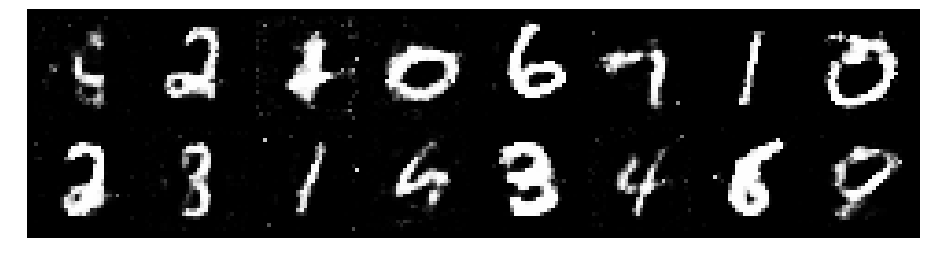

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.1382, Generator Loss: 1.1066
D(x): 0.5926, D(G(z)): 0.4011


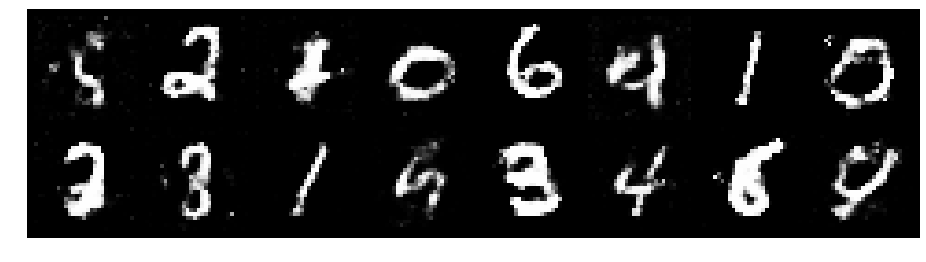

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.1730, Generator Loss: 0.9467
D(x): 0.5695, D(G(z)): 0.4063


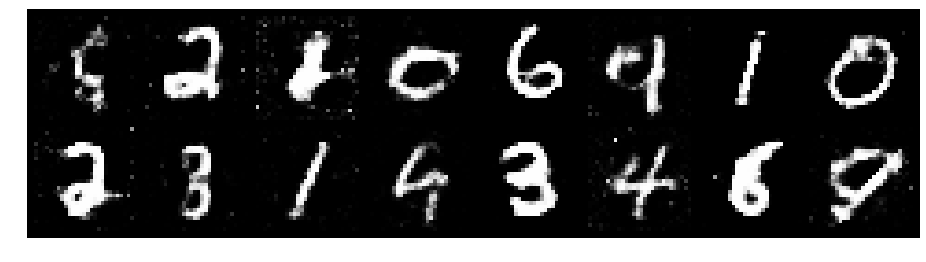

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2849, Generator Loss: 0.9018
D(x): 0.5424, D(G(z)): 0.4441


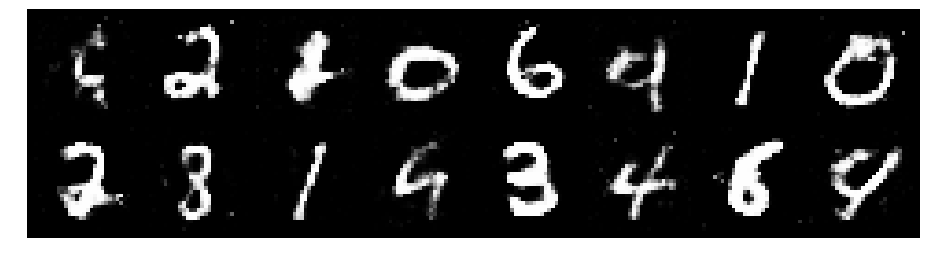

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8564
D(x): 0.5695, D(G(z)): 0.4466


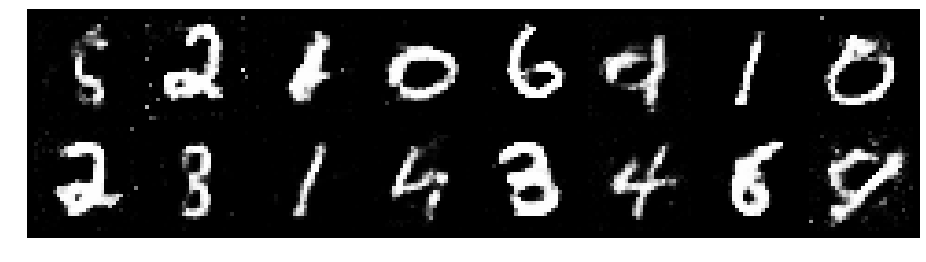

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3892, Generator Loss: 0.8522
D(x): 0.5163, D(G(z)): 0.4683


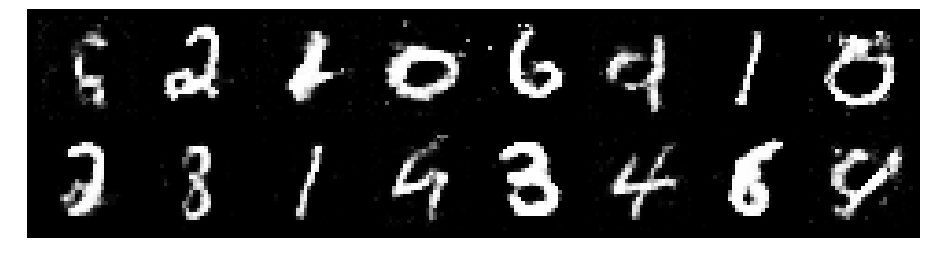

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3447, Generator Loss: 0.7573
D(x): 0.5566, D(G(z)): 0.4763


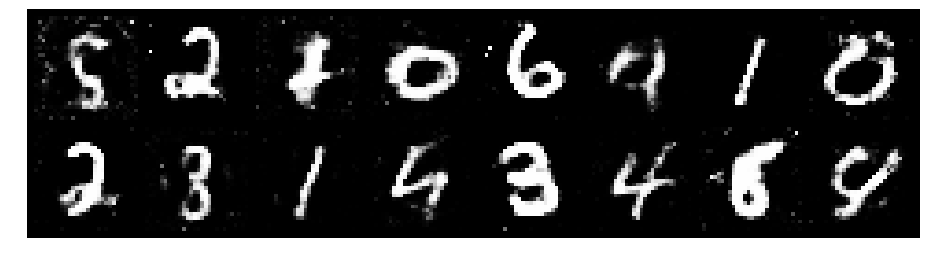

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.3712, Generator Loss: 0.7832
D(x): 0.5364, D(G(z)): 0.4904


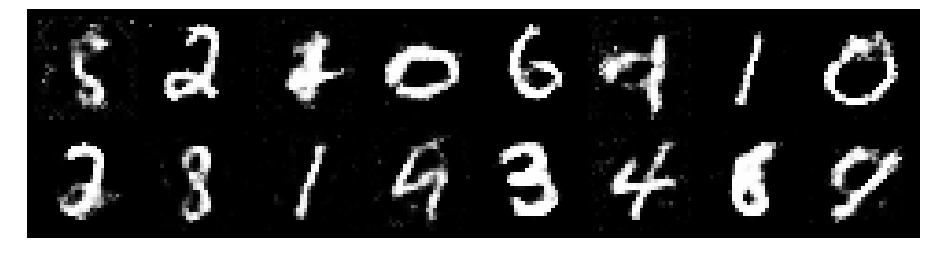

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2484, Generator Loss: 0.8401
D(x): 0.5809, D(G(z)): 0.4635


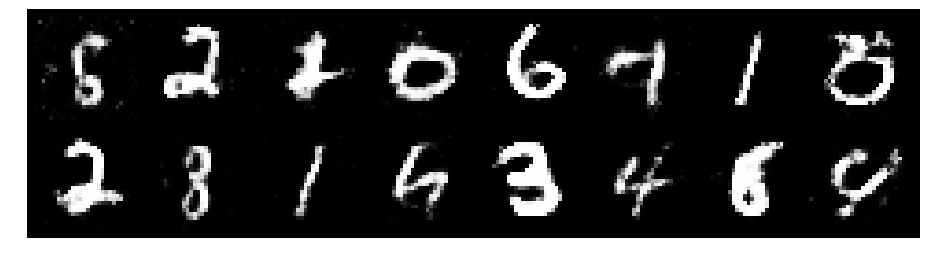

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2767, Generator Loss: 0.8918
D(x): 0.5215, D(G(z)): 0.4145


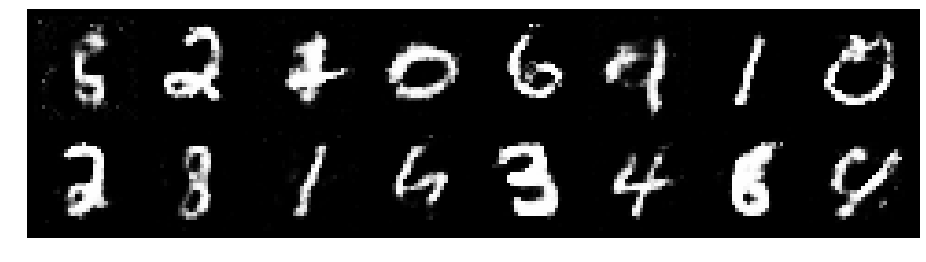

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2680, Generator Loss: 0.8087
D(x): 0.5600, D(G(z)): 0.4699


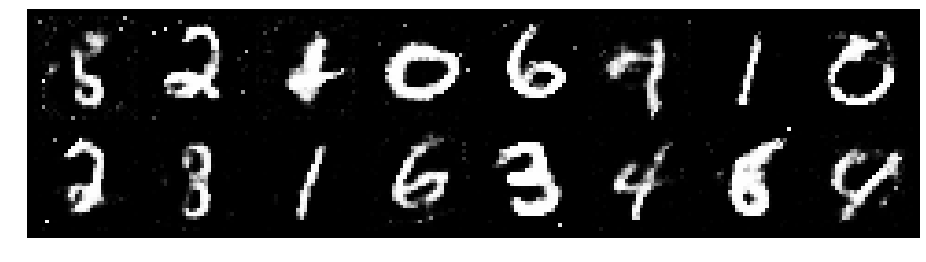

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.1959, Generator Loss: 0.9549
D(x): 0.5489, D(G(z)): 0.3937


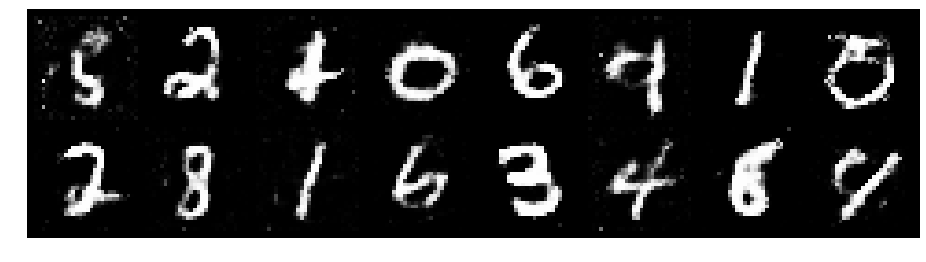

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9688
D(x): 0.5709, D(G(z)): 0.4443


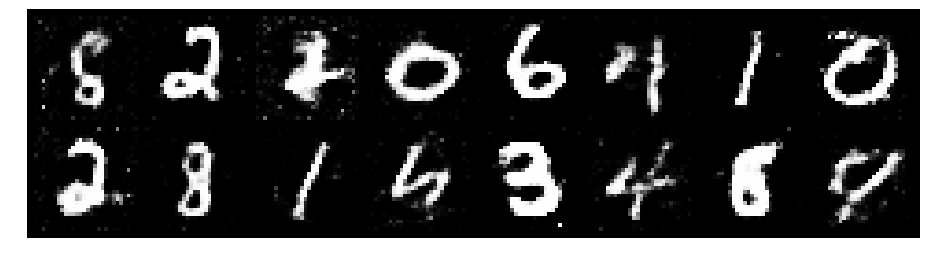

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.2650, Generator Loss: 0.8476
D(x): 0.5661, D(G(z)): 0.4440


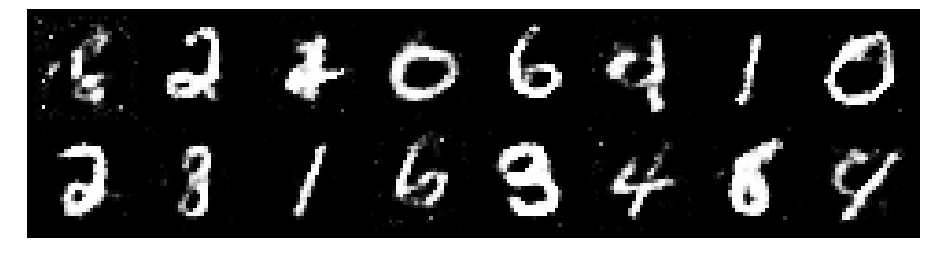

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.1778, Generator Loss: 1.0327
D(x): 0.5856, D(G(z)): 0.4194


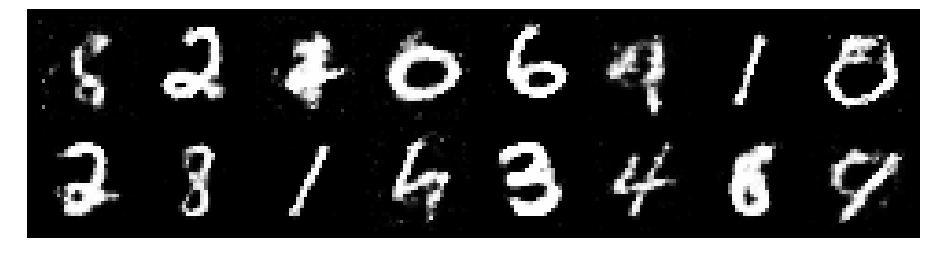

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.2297, Generator Loss: 0.9552
D(x): 0.5670, D(G(z)): 0.4416


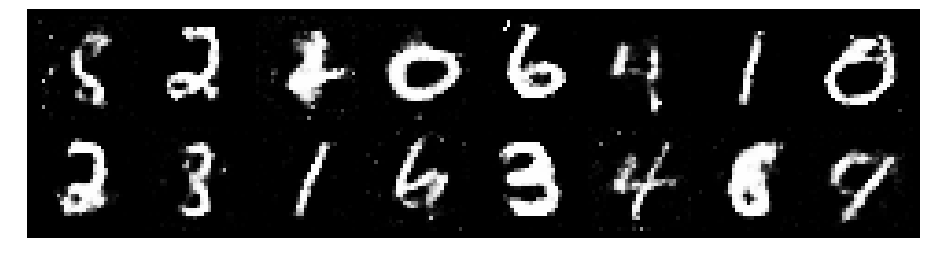

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2720, Generator Loss: 0.8101
D(x): 0.5627, D(G(z)): 0.4586


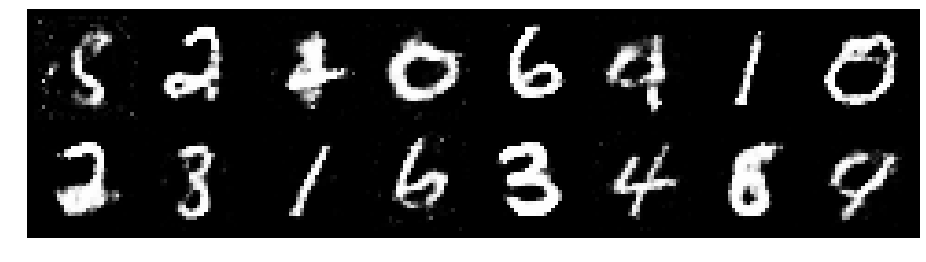

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3362, Generator Loss: 0.8708
D(x): 0.5222, D(G(z)): 0.4538


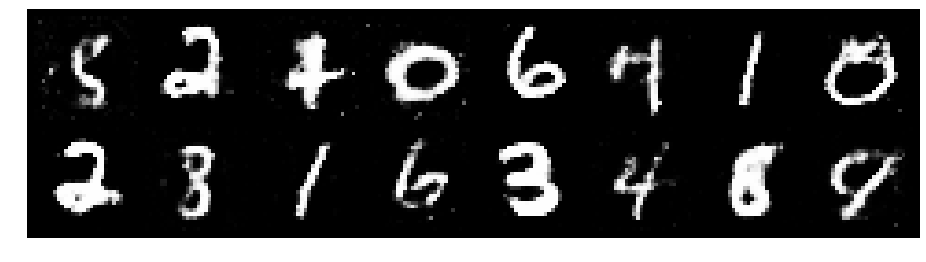

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2359, Generator Loss: 0.9356
D(x): 0.5520, D(G(z)): 0.4163


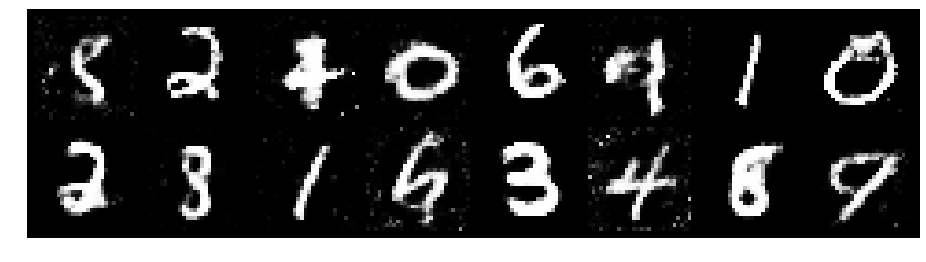

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3659, Generator Loss: 0.8949
D(x): 0.5196, D(G(z)): 0.4661


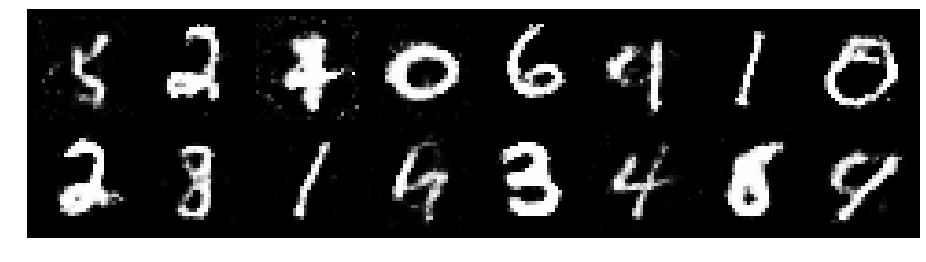

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.1691, Generator Loss: 0.9019
D(x): 0.5795, D(G(z)): 0.4223


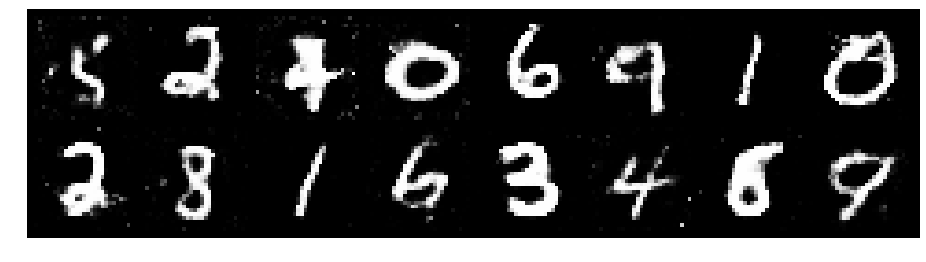

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2309, Generator Loss: 0.9401
D(x): 0.5585, D(G(z)): 0.4404


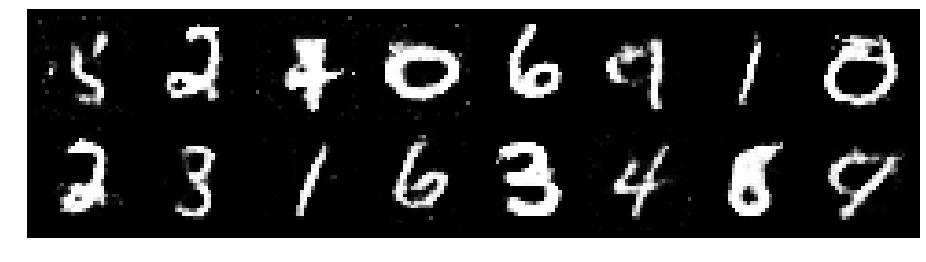

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.2019, Generator Loss: 0.8215
D(x): 0.5728, D(G(z)): 0.4240


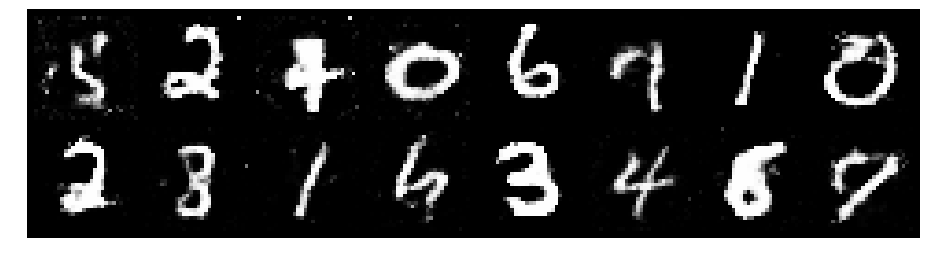

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3199, Generator Loss: 0.7842
D(x): 0.5399, D(G(z)): 0.4734


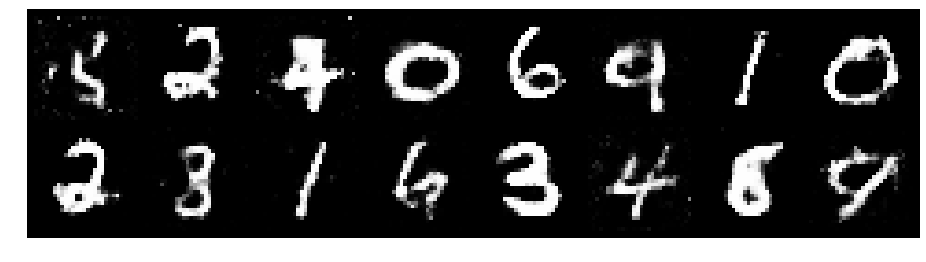

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3201, Generator Loss: 0.9325
D(x): 0.5554, D(G(z)): 0.4761


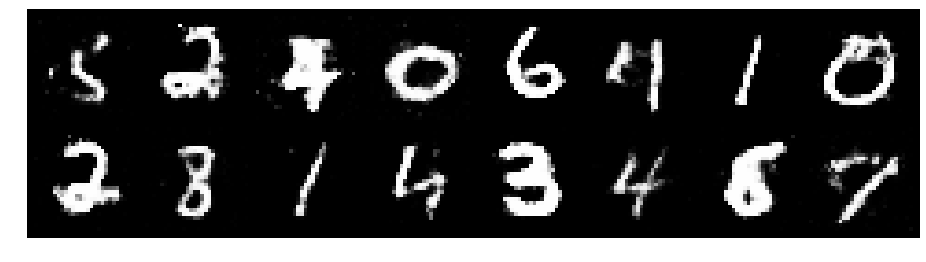

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8690
D(x): 0.5333, D(G(z)): 0.4328


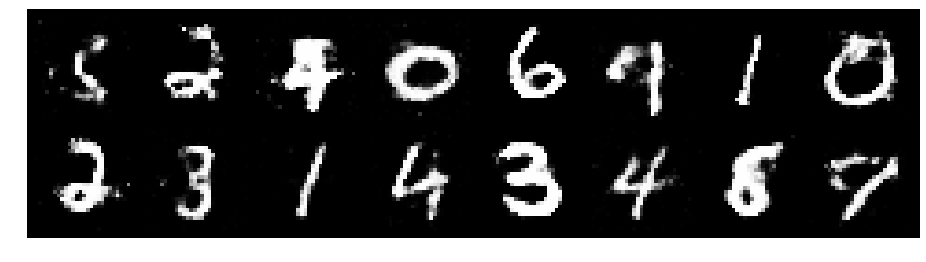

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2963, Generator Loss: 0.8015
D(x): 0.5396, D(G(z)): 0.4603


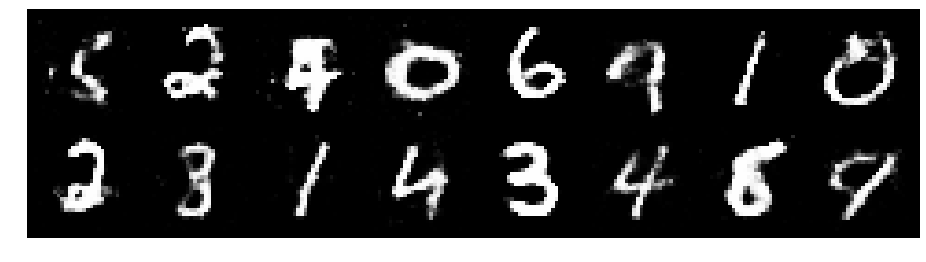

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3121, Generator Loss: 0.8738
D(x): 0.5682, D(G(z)): 0.4769


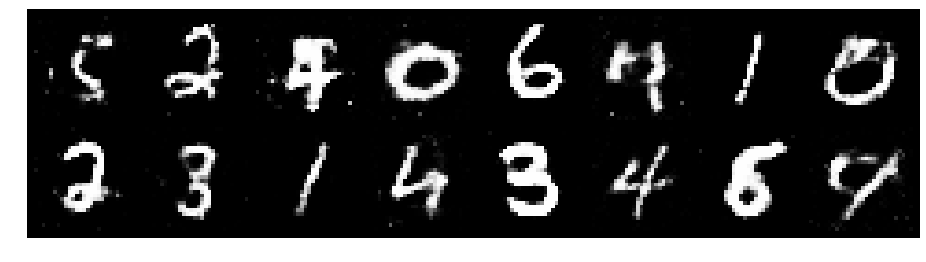

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3046, Generator Loss: 0.8570
D(x): 0.5210, D(G(z)): 0.4437


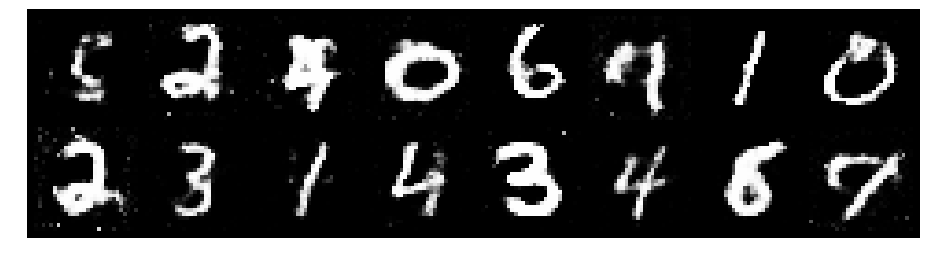

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2014, Generator Loss: 0.8301
D(x): 0.6168, D(G(z)): 0.4638


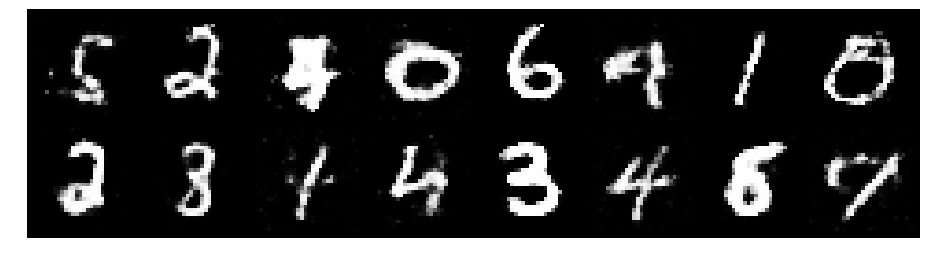

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.1851, Generator Loss: 0.8778
D(x): 0.5645, D(G(z)): 0.4117


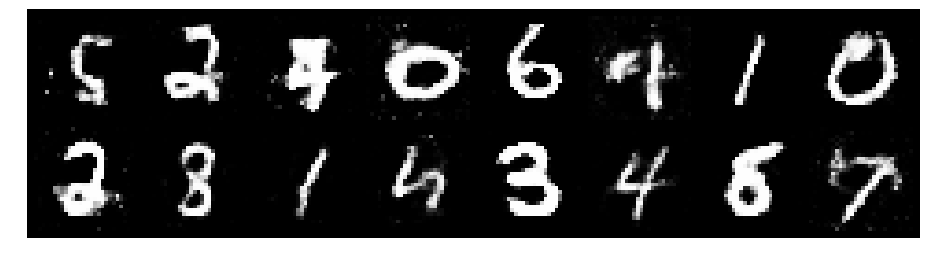

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2038, Generator Loss: 0.9389
D(x): 0.5709, D(G(z)): 0.4273


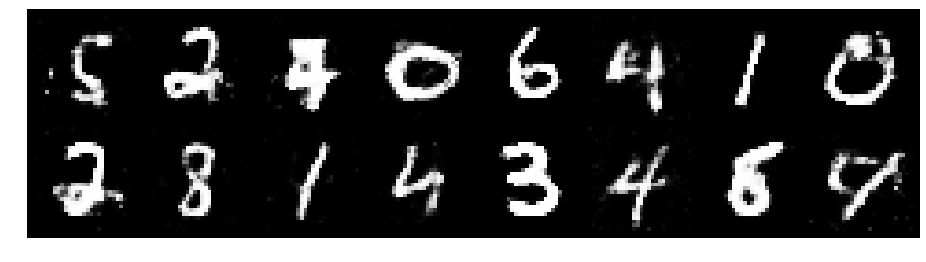

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.1955, Generator Loss: 0.8795
D(x): 0.5822, D(G(z)): 0.4236


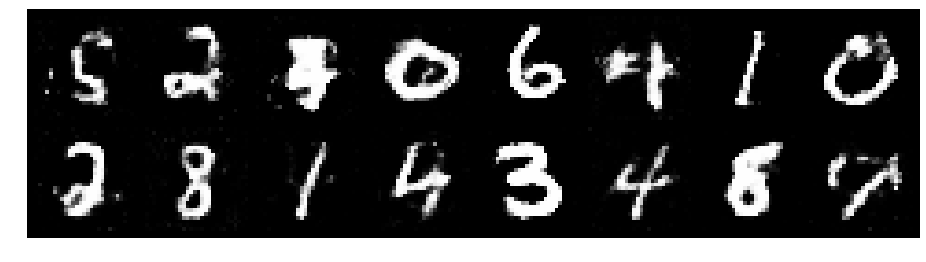

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 0.9507
D(x): 0.5794, D(G(z)): 0.4549


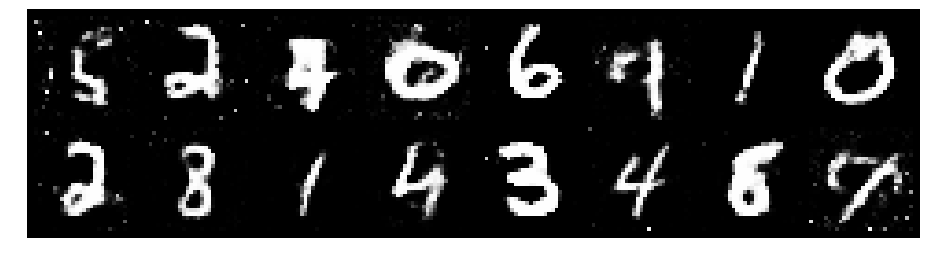

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8089
D(x): 0.5688, D(G(z)): 0.4850


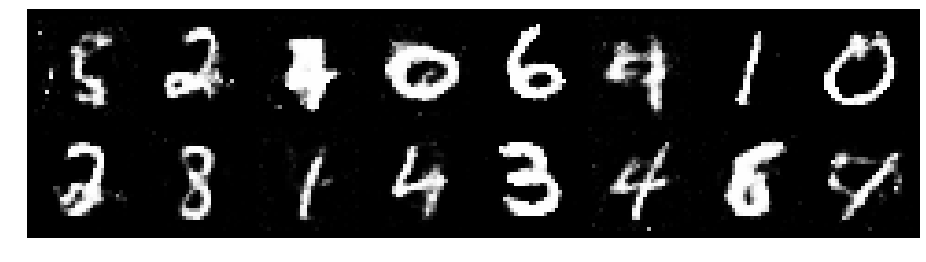

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2511, Generator Loss: 0.8696
D(x): 0.5475, D(G(z)): 0.4475


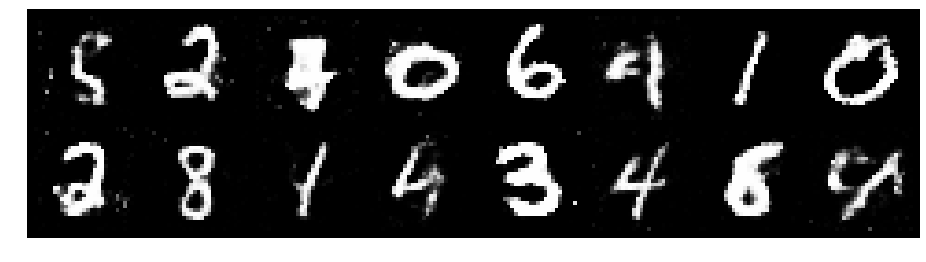

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2184, Generator Loss: 1.0129
D(x): 0.5858, D(G(z)): 0.4489


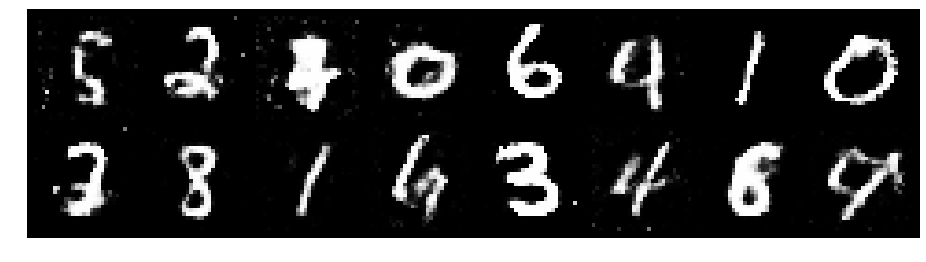

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.1849, Generator Loss: 0.9156
D(x): 0.5968, D(G(z)): 0.4404


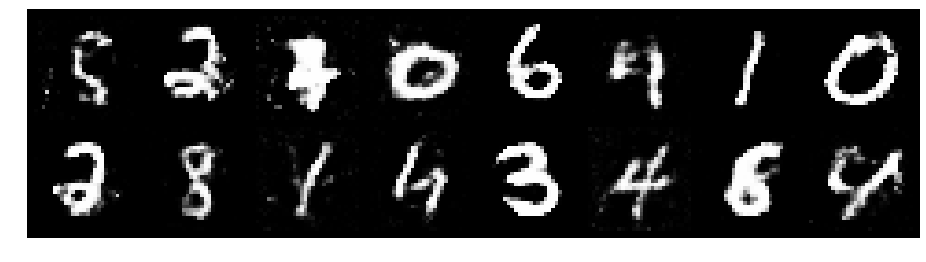

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.3879, Generator Loss: 0.8065
D(x): 0.5112, D(G(z)): 0.4731


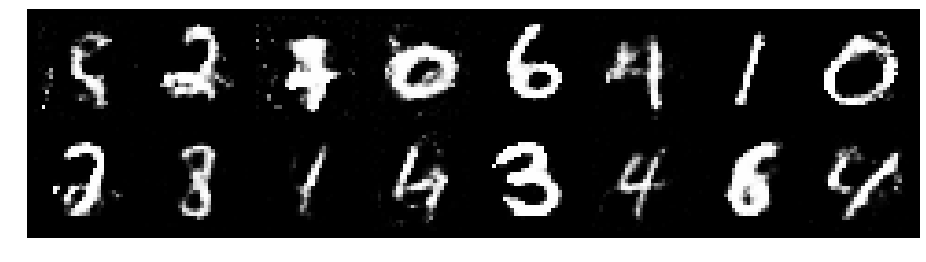

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.2959, Generator Loss: 0.7754
D(x): 0.5393, D(G(z)): 0.4641


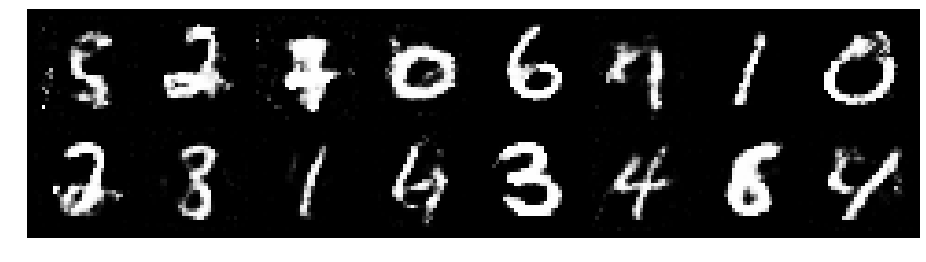

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2827, Generator Loss: 0.9479
D(x): 0.5599, D(G(z)): 0.4438


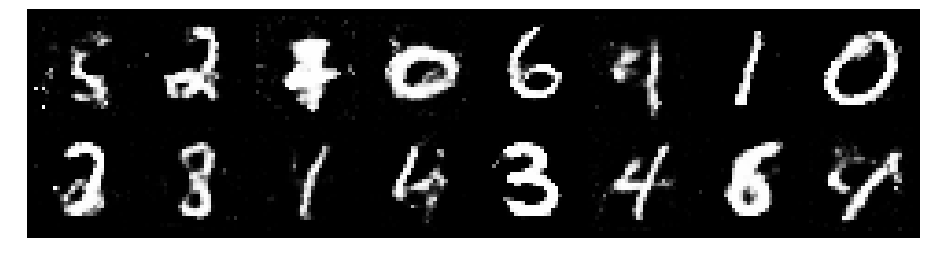

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8693
D(x): 0.5501, D(G(z)): 0.4703


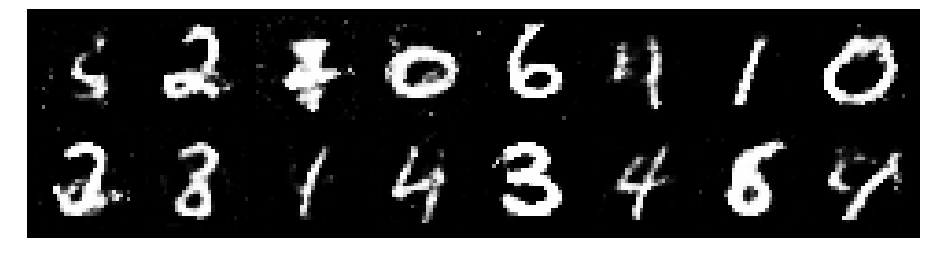

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8707
D(x): 0.5319, D(G(z)): 0.4525


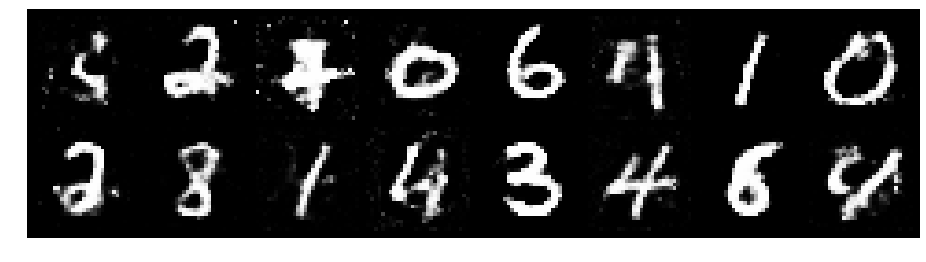

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2538, Generator Loss: 0.8756
D(x): 0.5546, D(G(z)): 0.4498


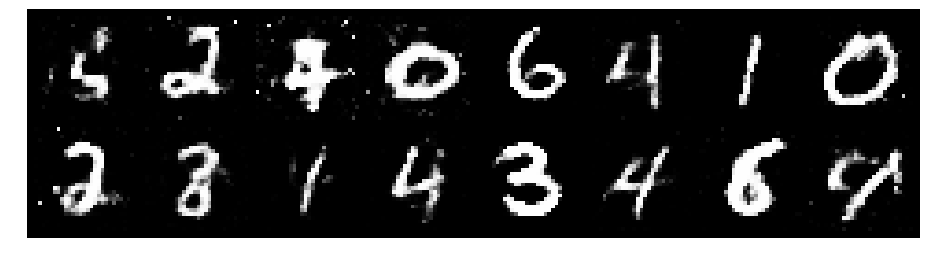

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8159
D(x): 0.5355, D(G(z)): 0.4554


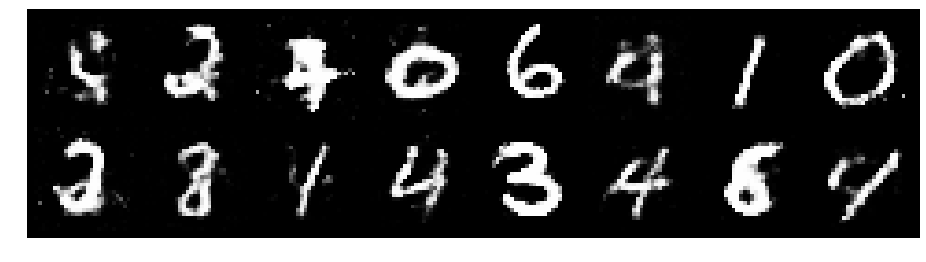

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9042
D(x): 0.5350, D(G(z)): 0.4444


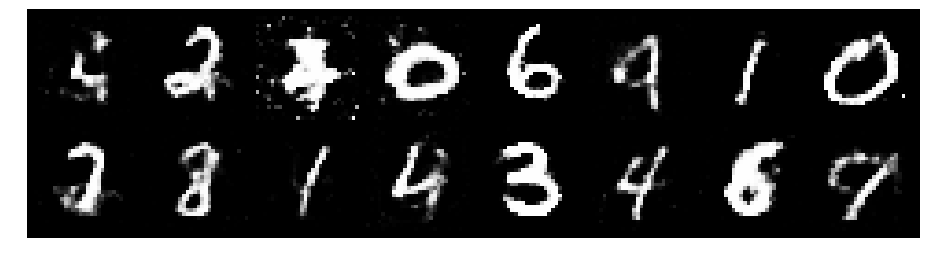

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2285, Generator Loss: 0.8881
D(x): 0.5577, D(G(z)): 0.4436


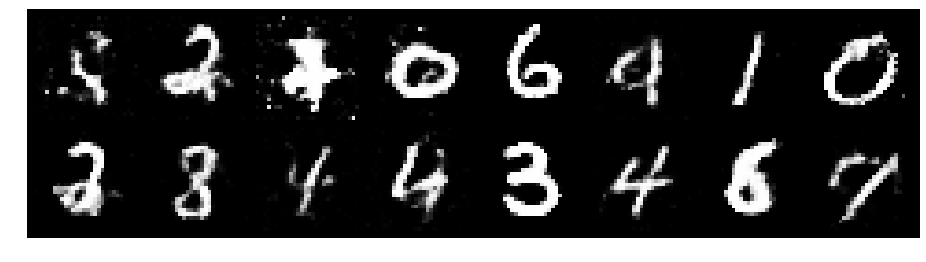

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2392, Generator Loss: 0.9114
D(x): 0.5509, D(G(z)): 0.4347


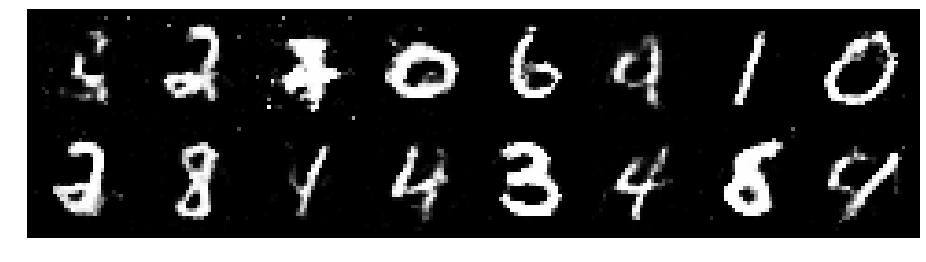

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2383, Generator Loss: 0.9426
D(x): 0.5400, D(G(z)): 0.4140


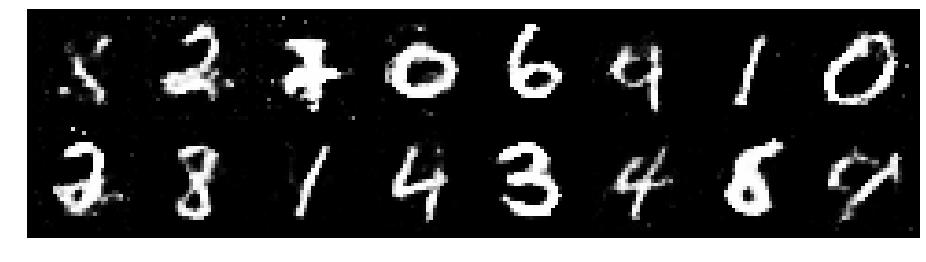

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2849, Generator Loss: 0.8877
D(x): 0.5364, D(G(z)): 0.4379


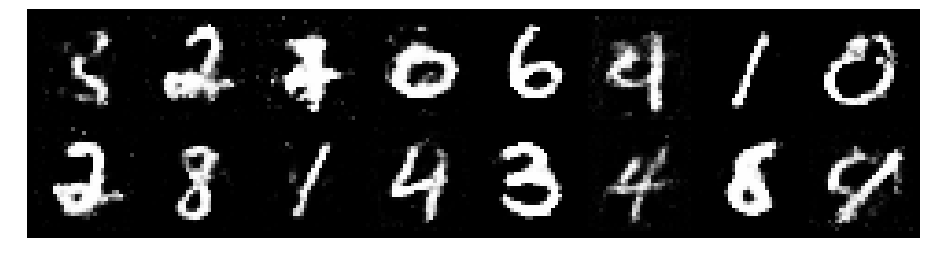

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2313, Generator Loss: 0.8997
D(x): 0.5381, D(G(z)): 0.4089


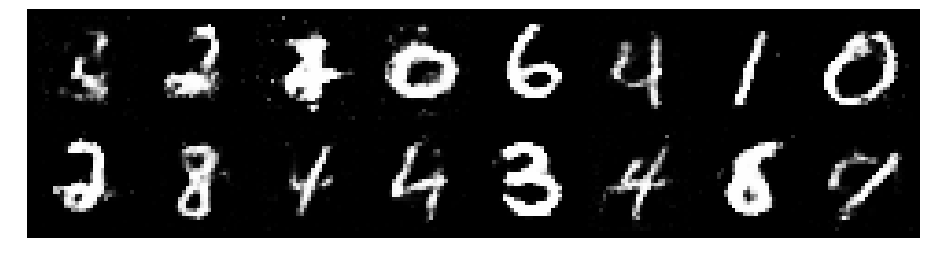

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3004, Generator Loss: 0.7940
D(x): 0.5766, D(G(z)): 0.4971


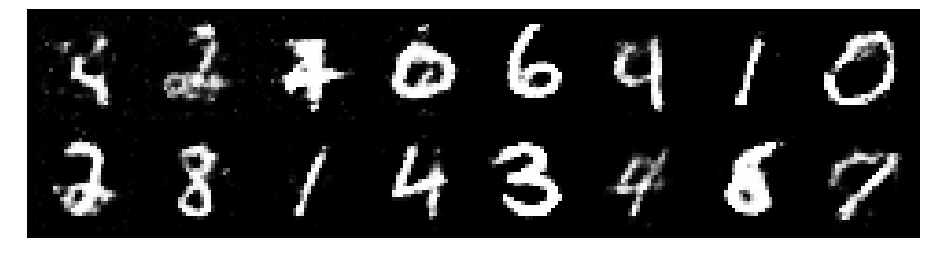

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3059, Generator Loss: 0.7870
D(x): 0.5573, D(G(z)): 0.4713


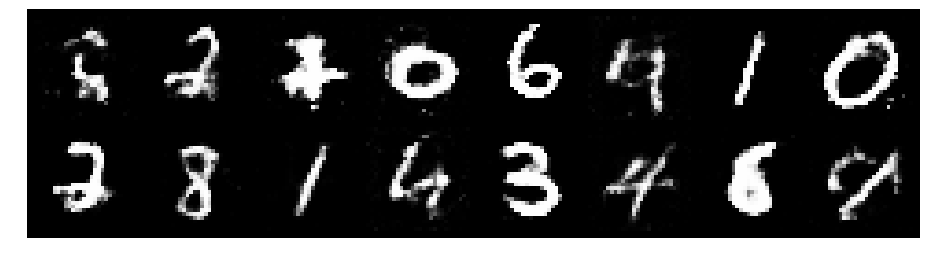

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.2842, Generator Loss: 0.7677
D(x): 0.5306, D(G(z)): 0.4566


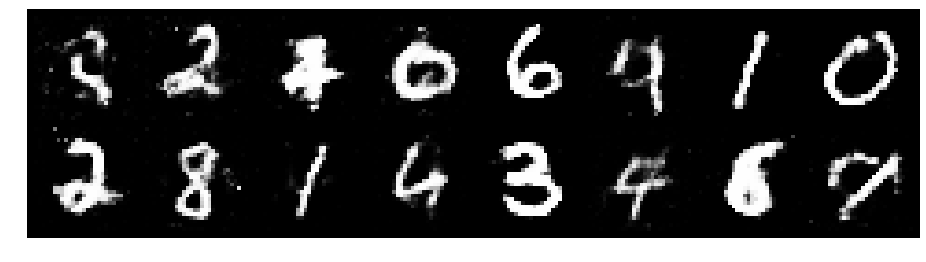

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2328, Generator Loss: 0.8625
D(x): 0.5677, D(G(z)): 0.4525


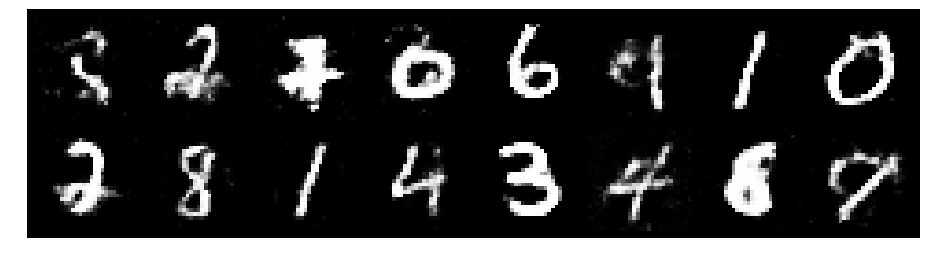

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.4186, Generator Loss: 0.7301
D(x): 0.5322, D(G(z)): 0.4980


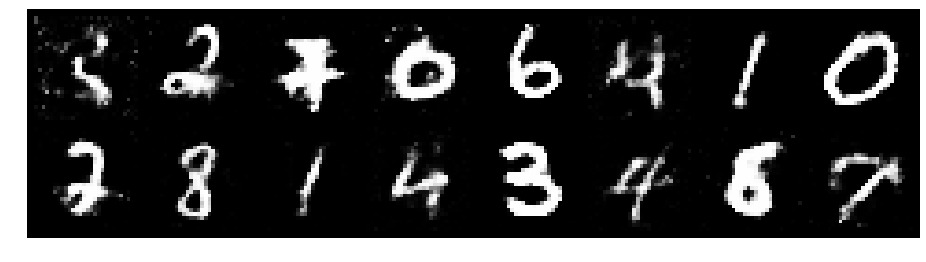

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8633
D(x): 0.5332, D(G(z)): 0.4532


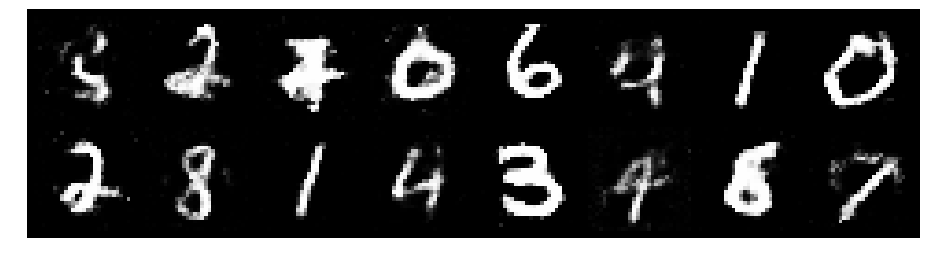

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.3322, Generator Loss: 0.8633
D(x): 0.4911, D(G(z)): 0.4078


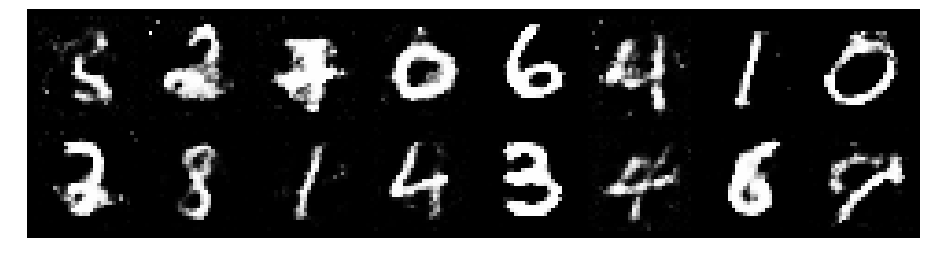

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.2126, Generator Loss: 0.8420
D(x): 0.5760, D(G(z)): 0.4381


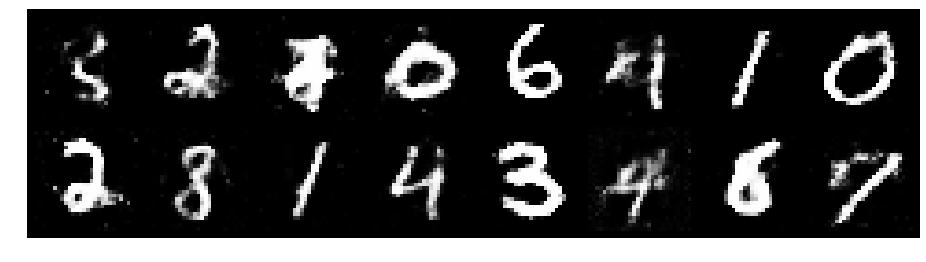

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.2112, Generator Loss: 0.9739
D(x): 0.5939, D(G(z)): 0.4161


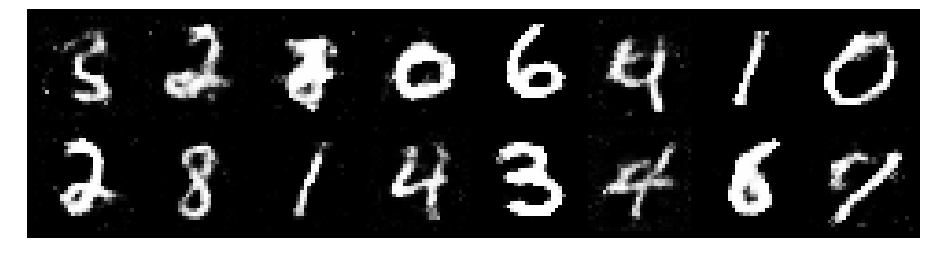

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2946, Generator Loss: 0.8585
D(x): 0.5426, D(G(z)): 0.4451


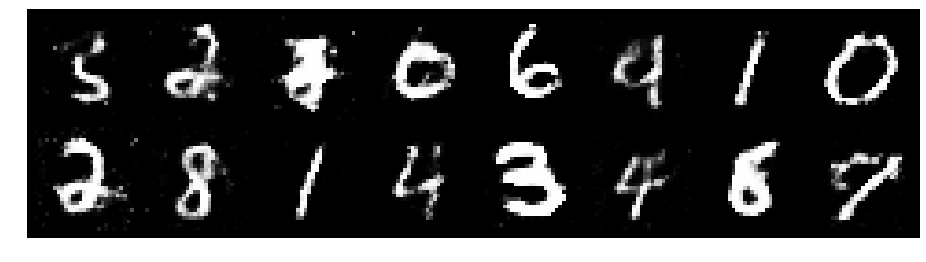

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.4765, Generator Loss: 0.8894
D(x): 0.4957, D(G(z)): 0.4824


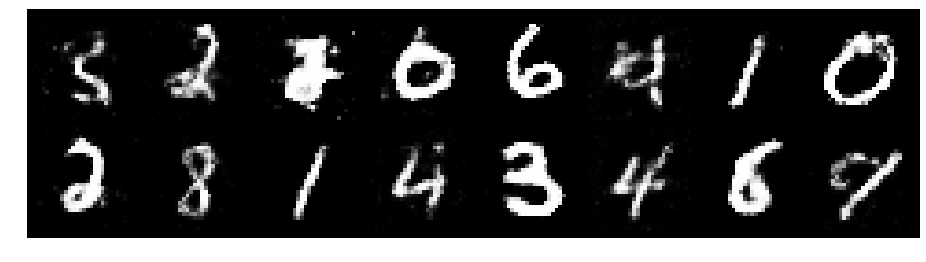

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3387, Generator Loss: 0.8183
D(x): 0.5385, D(G(z)): 0.4727


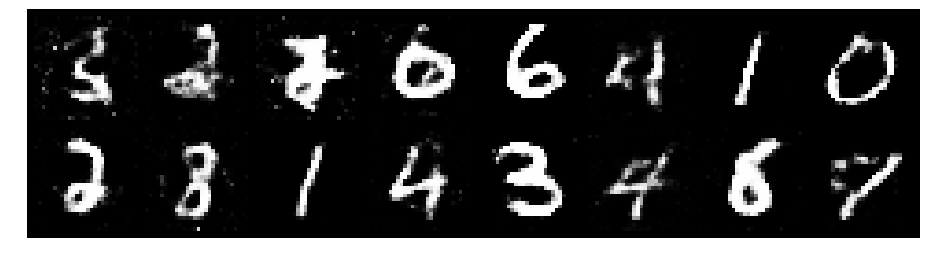

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2663, Generator Loss: 0.8454
D(x): 0.5343, D(G(z)): 0.4466


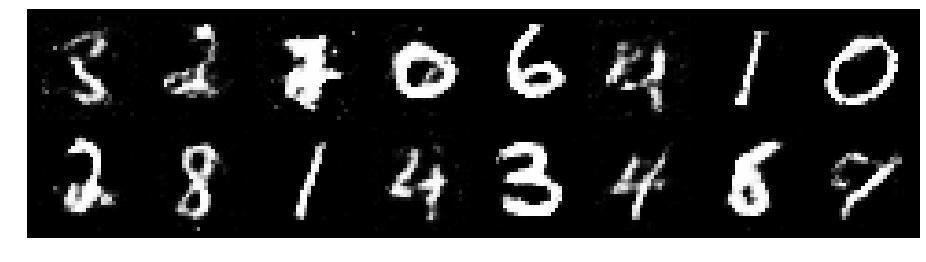

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.2795, Generator Loss: 0.8905
D(x): 0.5351, D(G(z)): 0.4296


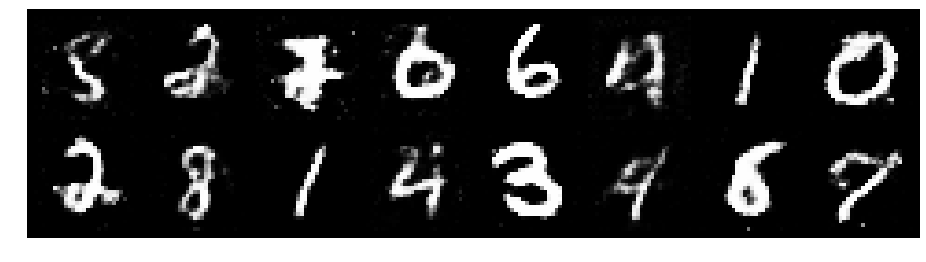

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.3308, Generator Loss: 0.9087
D(x): 0.5371, D(G(z)): 0.4372


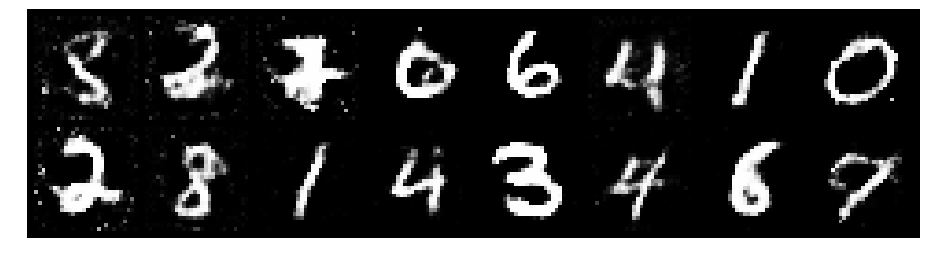

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2942, Generator Loss: 0.8622
D(x): 0.5731, D(G(z)): 0.4611


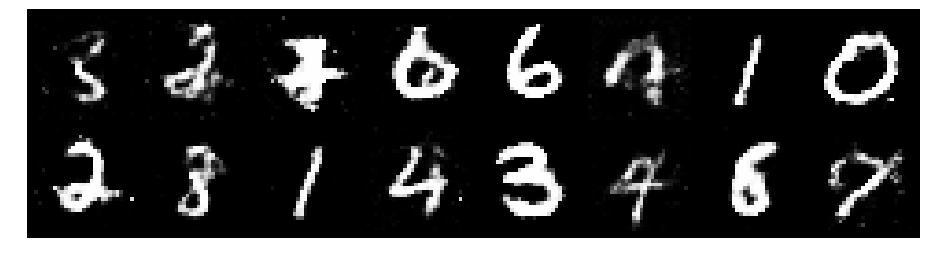

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.3124, Generator Loss: 0.8737
D(x): 0.5416, D(G(z)): 0.4622


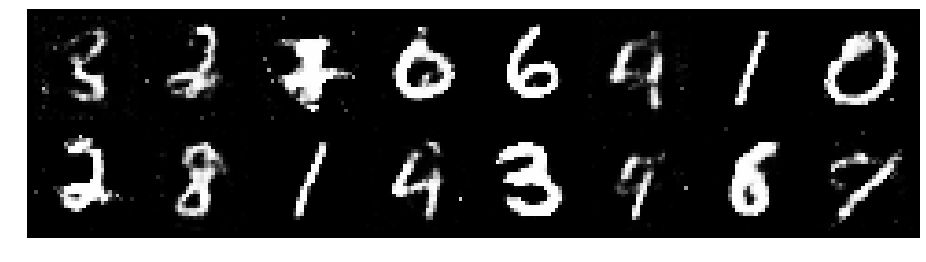

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3067, Generator Loss: 0.7593
D(x): 0.5612, D(G(z)): 0.4741


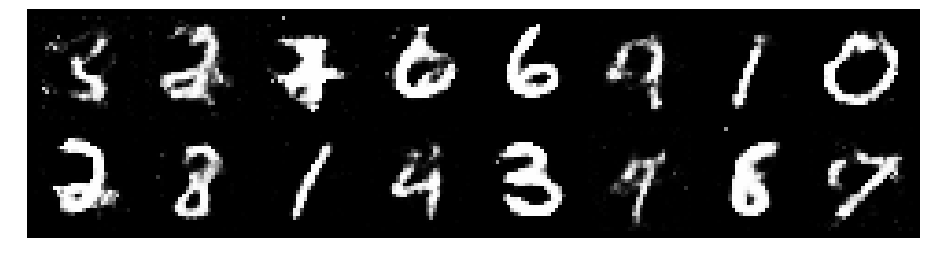

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3105, Generator Loss: 0.8666
D(x): 0.5041, D(G(z)): 0.4278


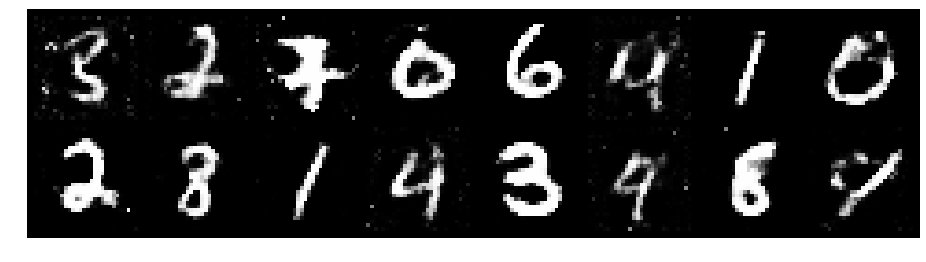

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2497, Generator Loss: 0.8719
D(x): 0.5475, D(G(z)): 0.4373


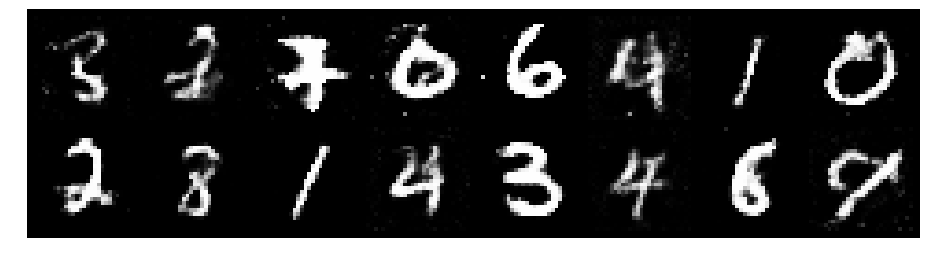

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.2931, Generator Loss: 0.8802
D(x): 0.5251, D(G(z)): 0.4137


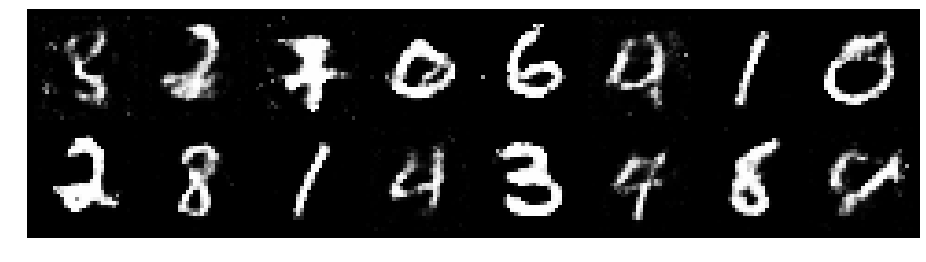

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3782, Generator Loss: 0.8326
D(x): 0.5245, D(G(z)): 0.4906


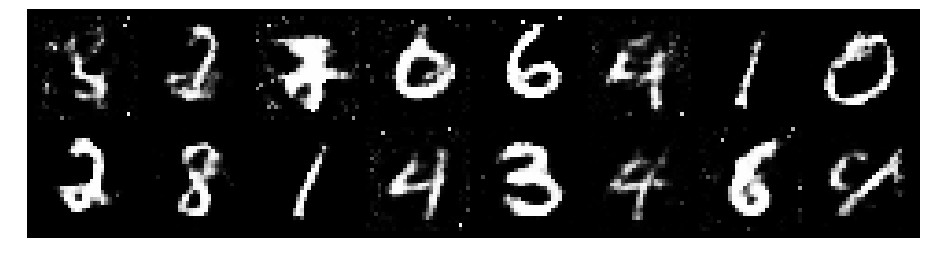

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.2436, Generator Loss: 0.9365
D(x): 0.5500, D(G(z)): 0.4264


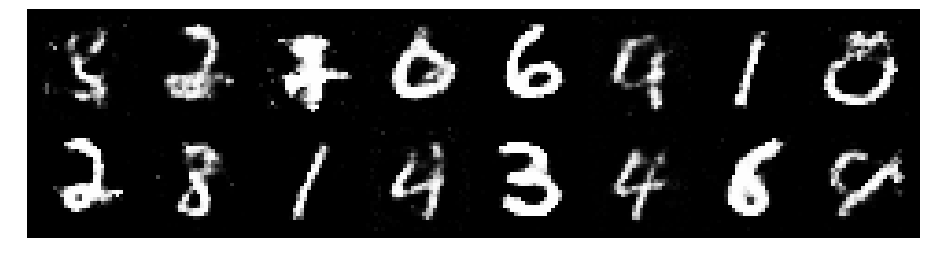

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.1913, Generator Loss: 1.0187
D(x): 0.5746, D(G(z)): 0.4189


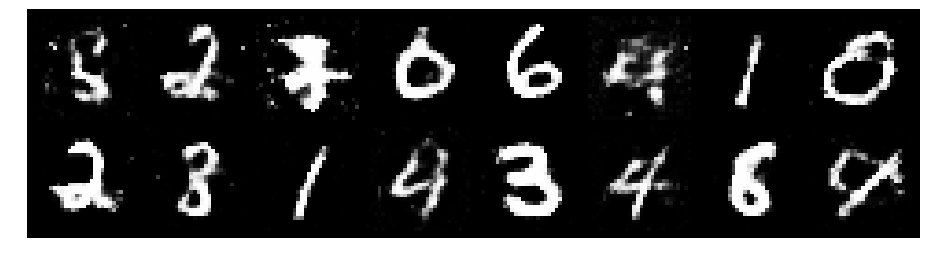

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2051, Generator Loss: 0.8694
D(x): 0.5893, D(G(z)): 0.4538


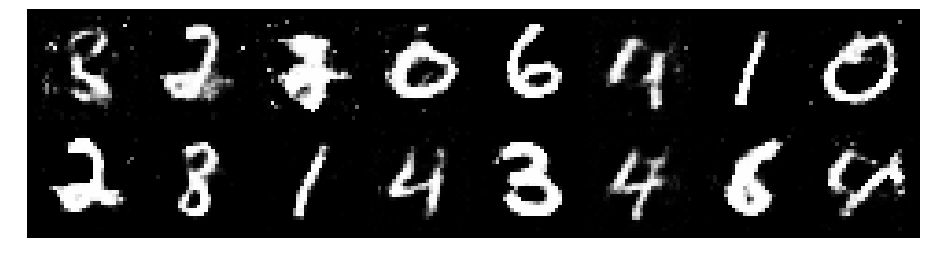

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8309
D(x): 0.5359, D(G(z)): 0.4622


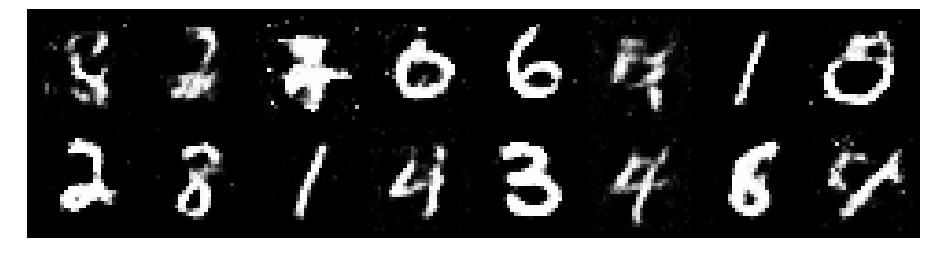

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.1461, Generator Loss: 0.8677
D(x): 0.5768, D(G(z)): 0.4075


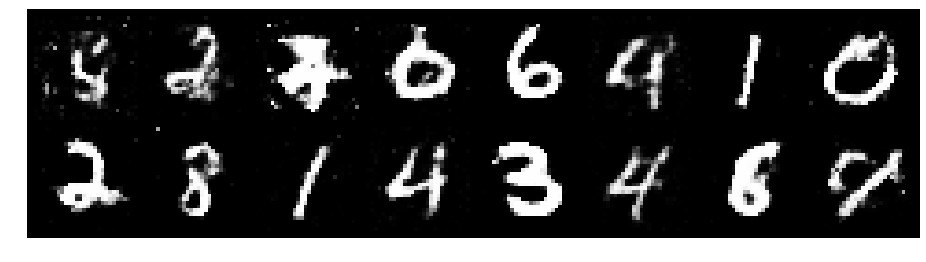

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.2875, Generator Loss: 0.9414
D(x): 0.5498, D(G(z)): 0.4559


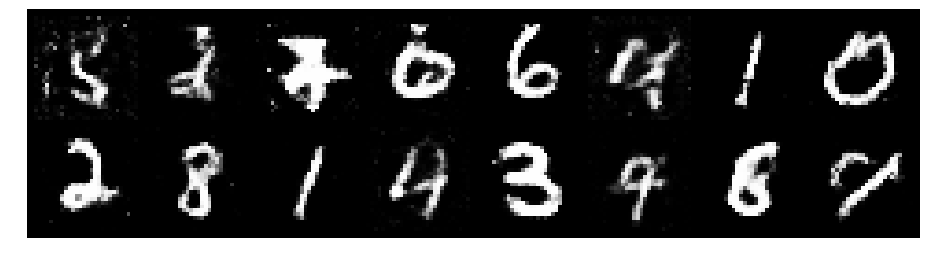

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2809, Generator Loss: 0.9467
D(x): 0.5521, D(G(z)): 0.4534


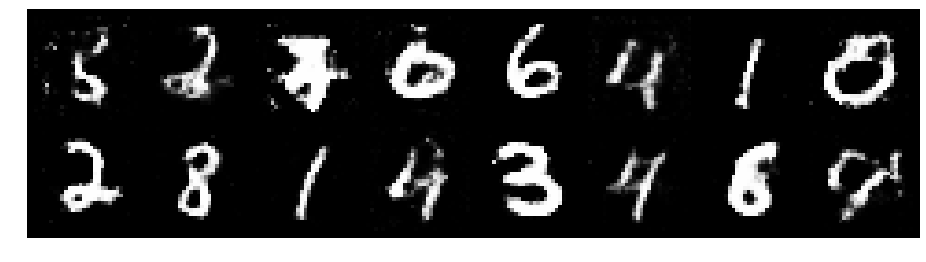

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.2763, Generator Loss: 0.8079
D(x): 0.5413, D(G(z)): 0.4378


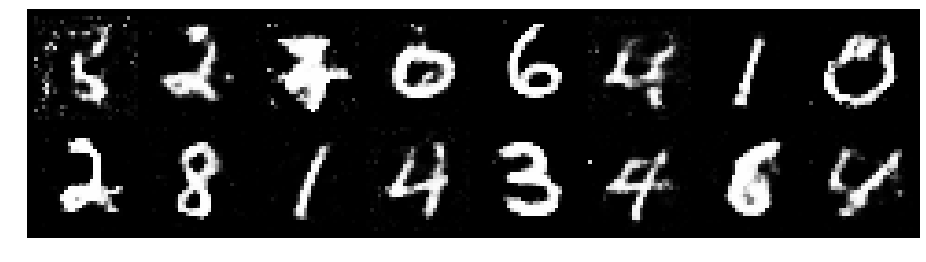

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.2409, Generator Loss: 0.8853
D(x): 0.5493, D(G(z)): 0.4327


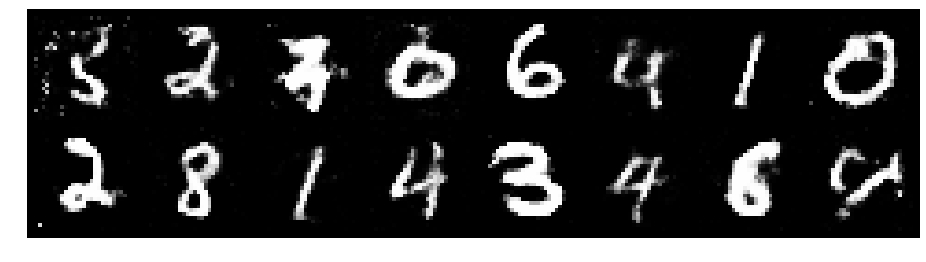

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1970, Generator Loss: 0.8661
D(x): 0.5701, D(G(z)): 0.4245


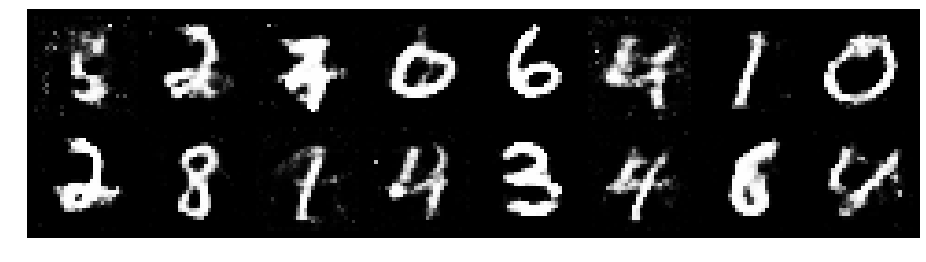

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.3384, Generator Loss: 0.8304
D(x): 0.5338, D(G(z)): 0.4609


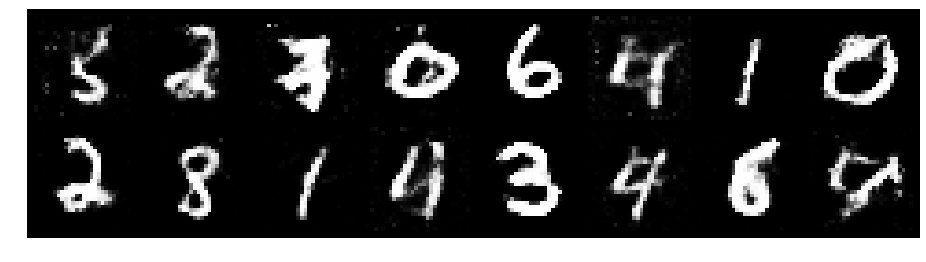

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.3262, Generator Loss: 0.8938
D(x): 0.5739, D(G(z)): 0.4846


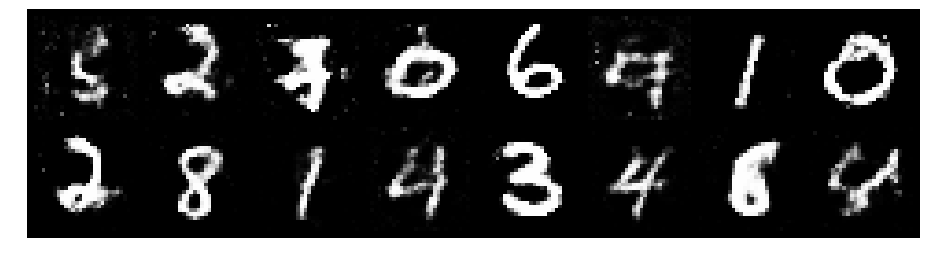

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8765
D(x): 0.5405, D(G(z)): 0.4727


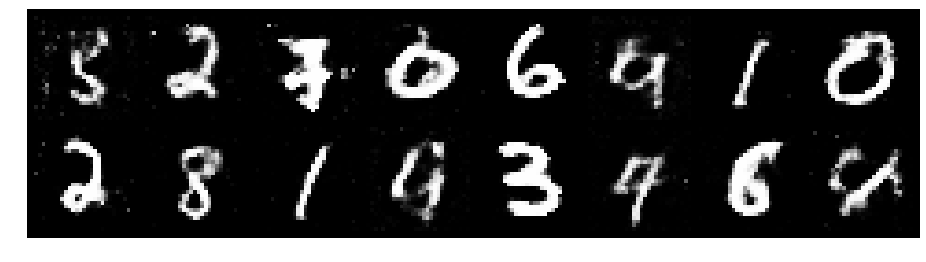

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.3077, Generator Loss: 0.8525
D(x): 0.5522, D(G(z)): 0.4651


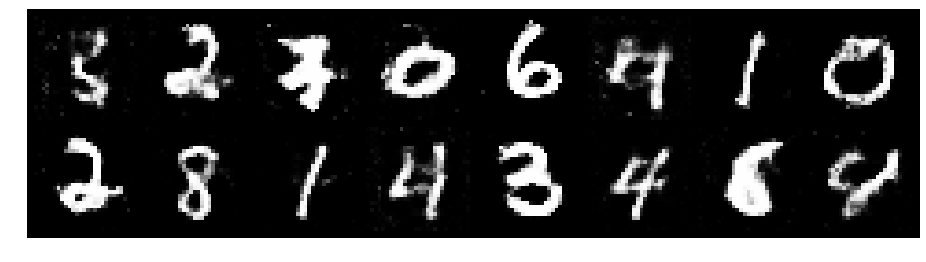

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8981
D(x): 0.5651, D(G(z)): 0.4650


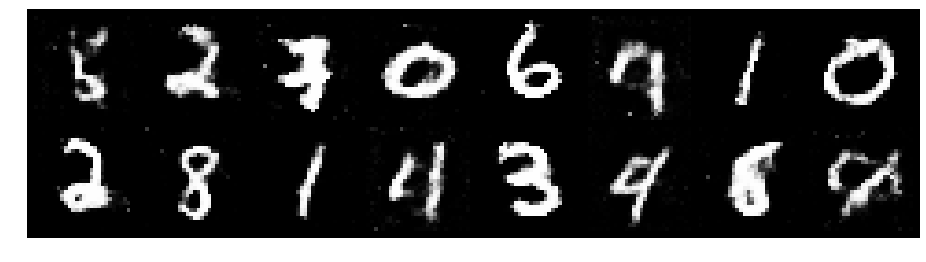

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.3433, Generator Loss: 0.9193
D(x): 0.5401, D(G(z)): 0.4503


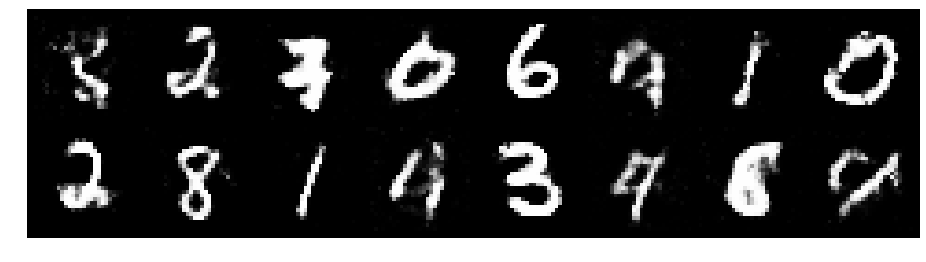

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2782, Generator Loss: 1.0362
D(x): 0.5278, D(G(z)): 0.4146


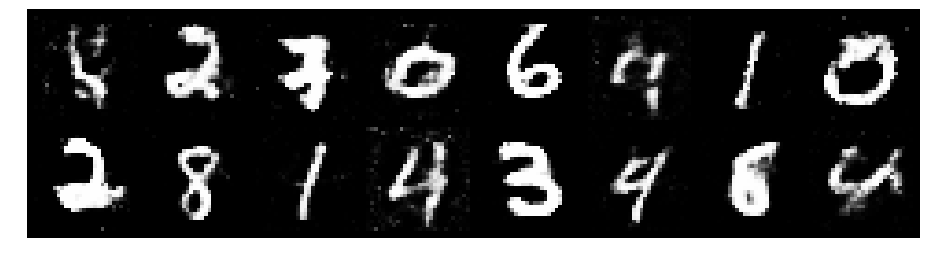

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.1957, Generator Loss: 0.8108
D(x): 0.5951, D(G(z)): 0.4413


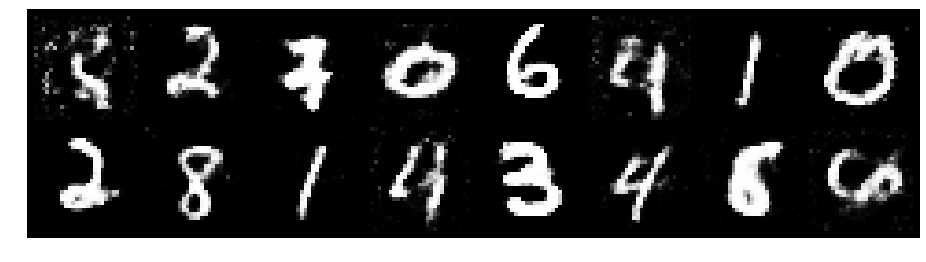

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2987, Generator Loss: 0.9400
D(x): 0.5472, D(G(z)): 0.4496


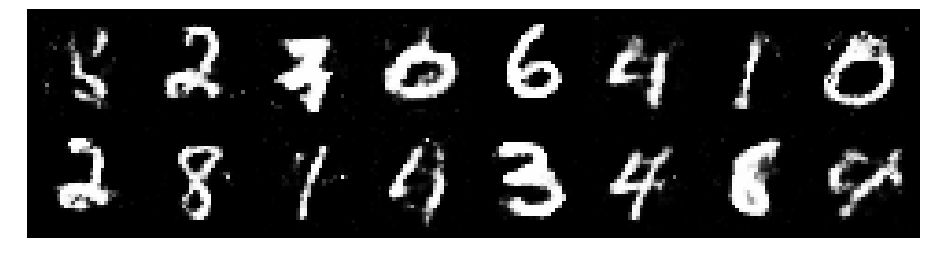

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9102
D(x): 0.5348, D(G(z)): 0.4163


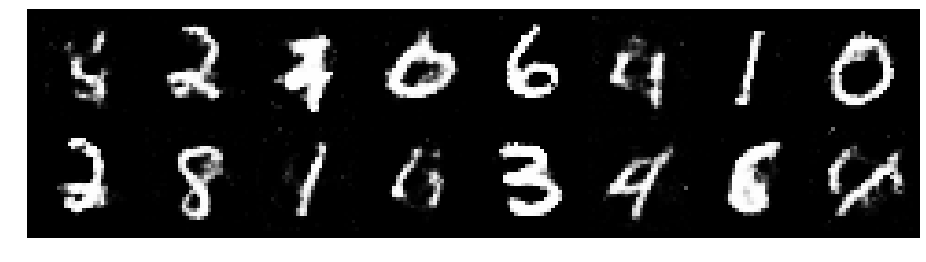

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3906, Generator Loss: 0.9909
D(x): 0.5134, D(G(z)): 0.4399


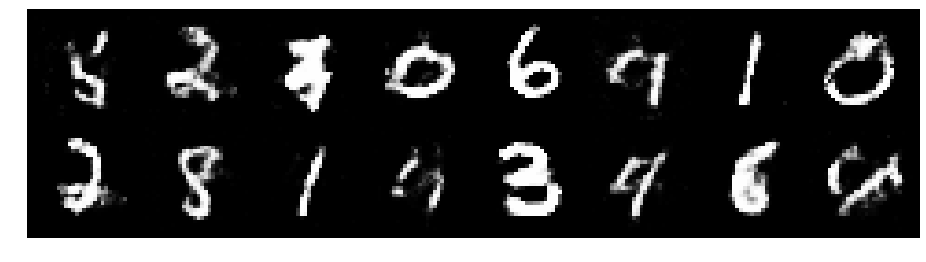

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3146, Generator Loss: 0.8299
D(x): 0.5440, D(G(z)): 0.4659


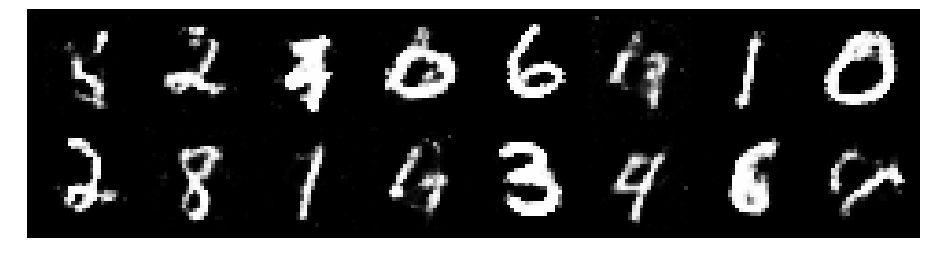

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.2933, Generator Loss: 0.8879
D(x): 0.5571, D(G(z)): 0.4492


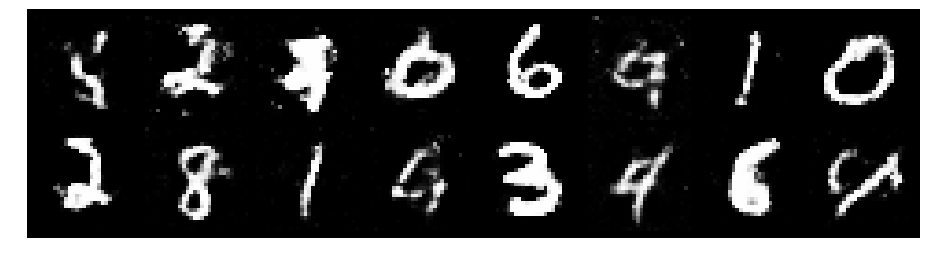

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2290, Generator Loss: 0.8949
D(x): 0.5403, D(G(z)): 0.4236


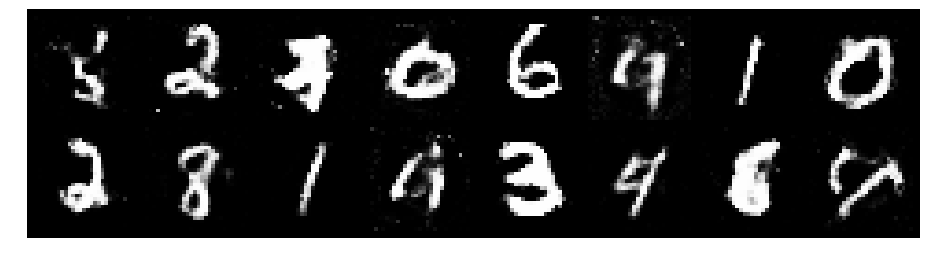

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.3836, Generator Loss: 1.0111
D(x): 0.5333, D(G(z)): 0.4773


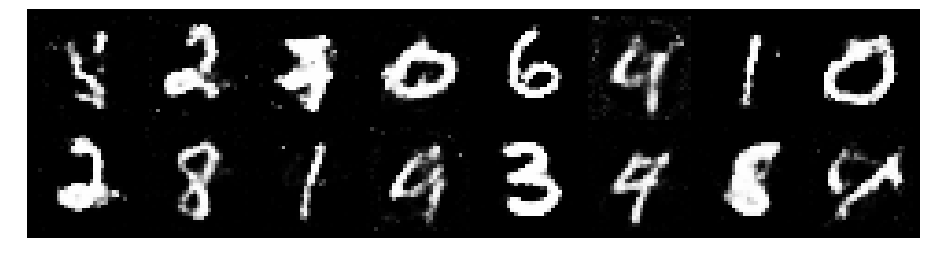

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.4137, Generator Loss: 0.8926
D(x): 0.5494, D(G(z)): 0.5008


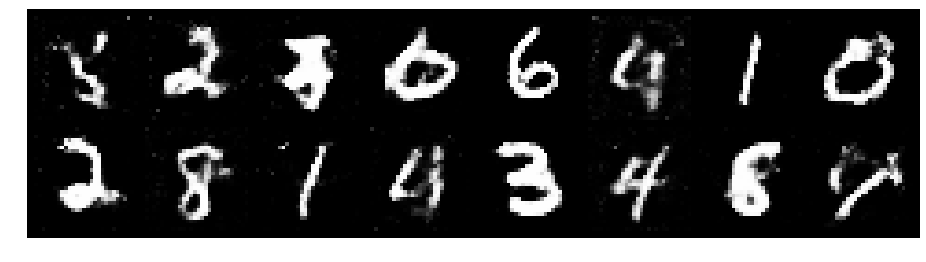

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.3187, Generator Loss: 0.8300
D(x): 0.5897, D(G(z)): 0.4936


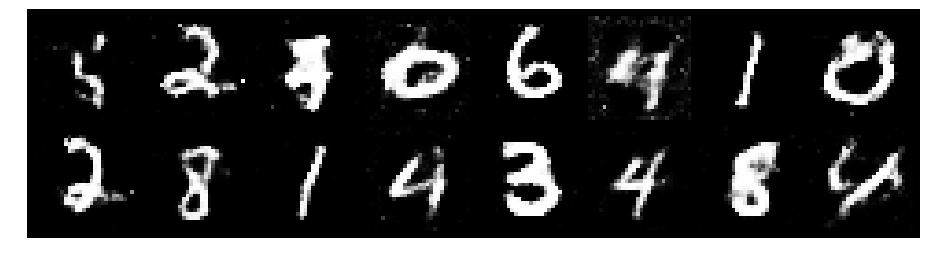

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2986, Generator Loss: 0.9529
D(x): 0.5208, D(G(z)): 0.4269


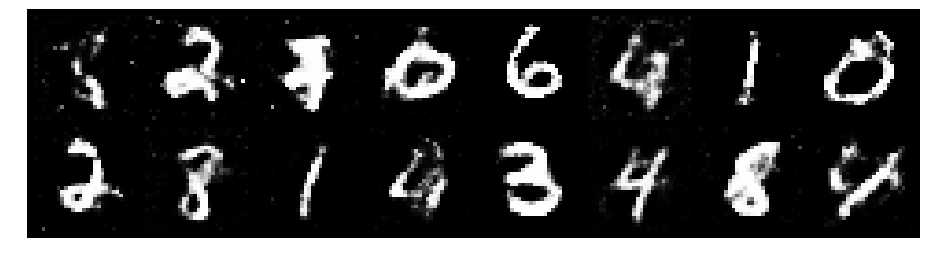

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2670, Generator Loss: 0.8207
D(x): 0.5312, D(G(z)): 0.4364


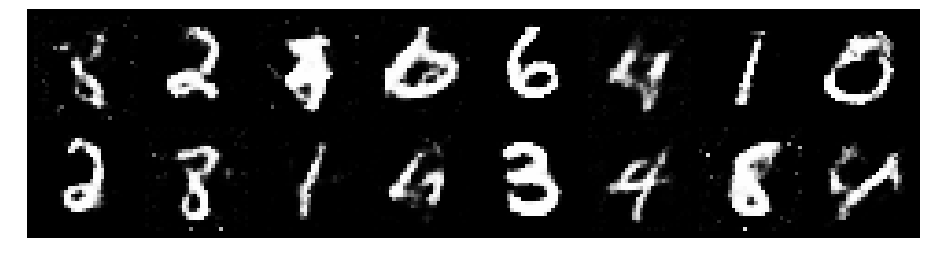

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2342, Generator Loss: 0.8245
D(x): 0.5569, D(G(z)): 0.4513


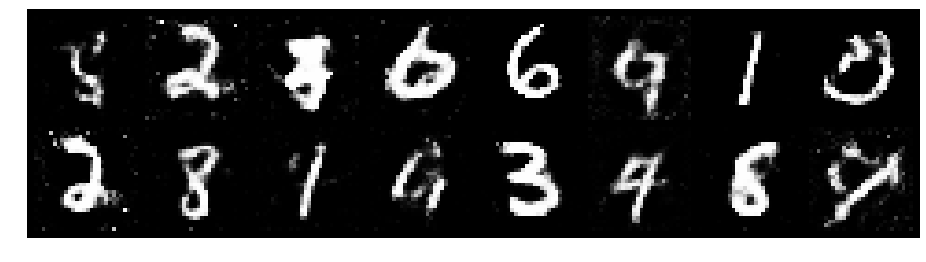

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.2683, Generator Loss: 0.8861
D(x): 0.5584, D(G(z)): 0.4549


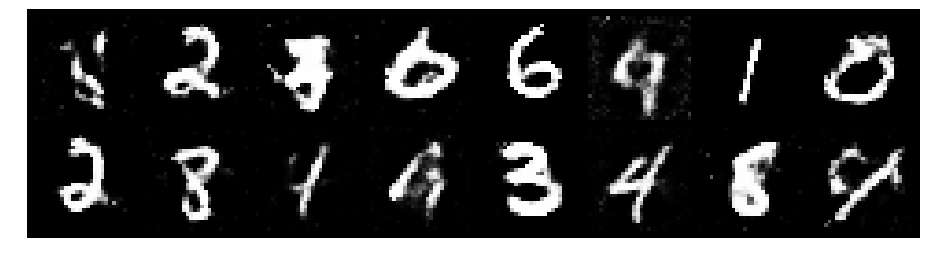

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2139, Generator Loss: 0.9236
D(x): 0.5757, D(G(z)): 0.4281


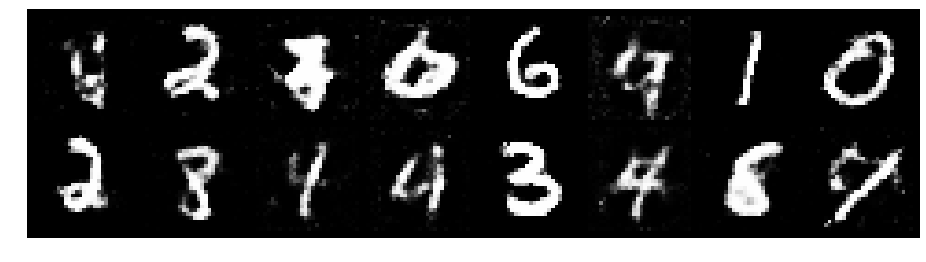

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.1990, Generator Loss: 1.0104
D(x): 0.5612, D(G(z)): 0.4104


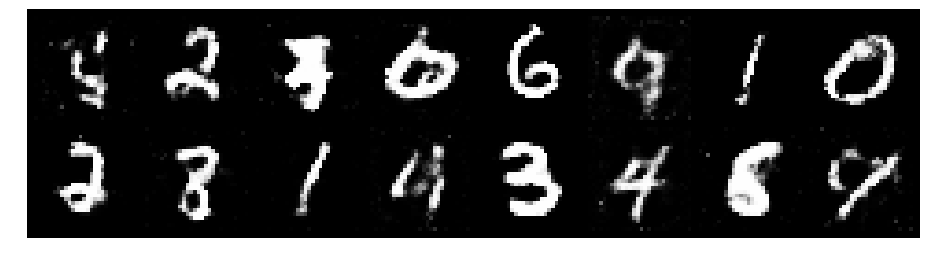

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2659, Generator Loss: 0.8300
D(x): 0.5483, D(G(z)): 0.4439


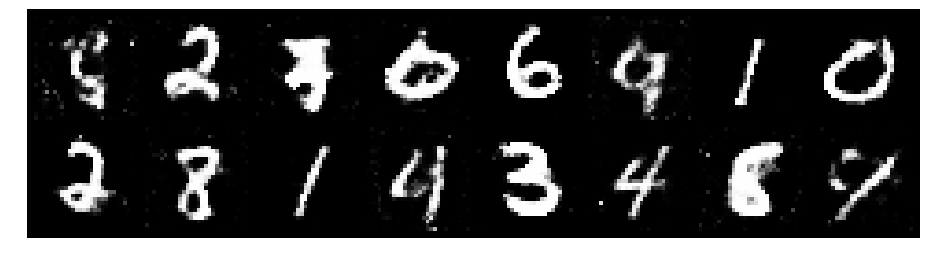

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2597, Generator Loss: 0.7373
D(x): 0.5696, D(G(z)): 0.4680


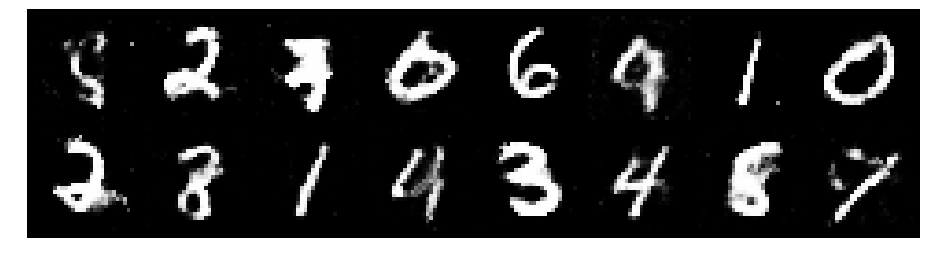

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.2433, Generator Loss: 0.8512
D(x): 0.5386, D(G(z)): 0.4346


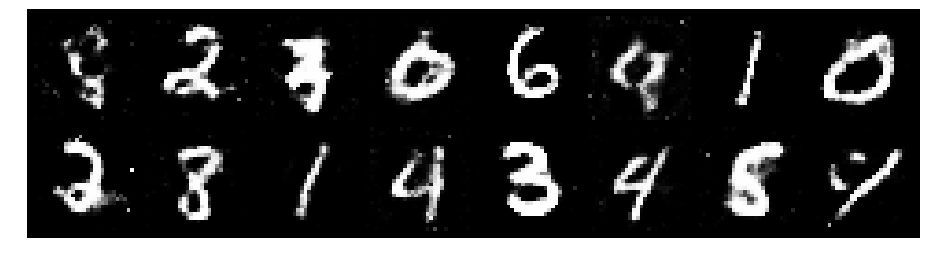

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8026
D(x): 0.5280, D(G(z)): 0.4542


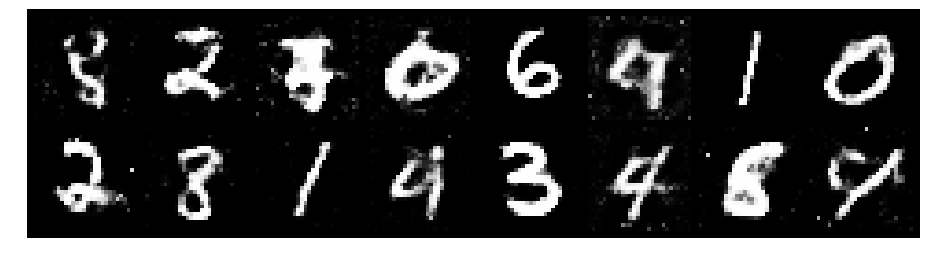

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.3161, Generator Loss: 0.8180
D(x): 0.5244, D(G(z)): 0.4526


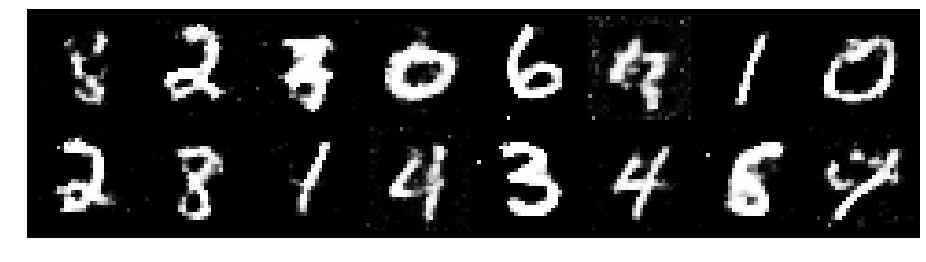

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3565, Generator Loss: 0.8835
D(x): 0.5276, D(G(z)): 0.4713


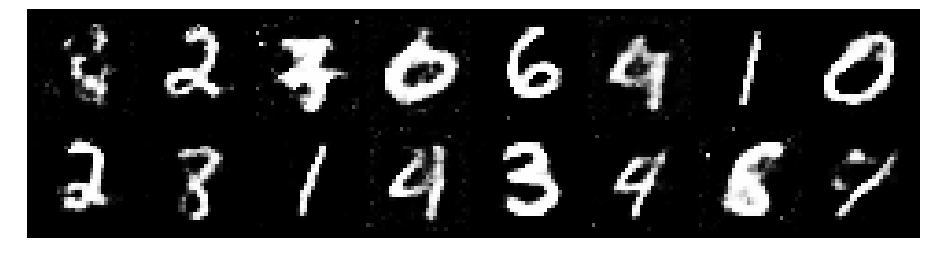

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2604, Generator Loss: 0.8648
D(x): 0.5750, D(G(z)): 0.4406


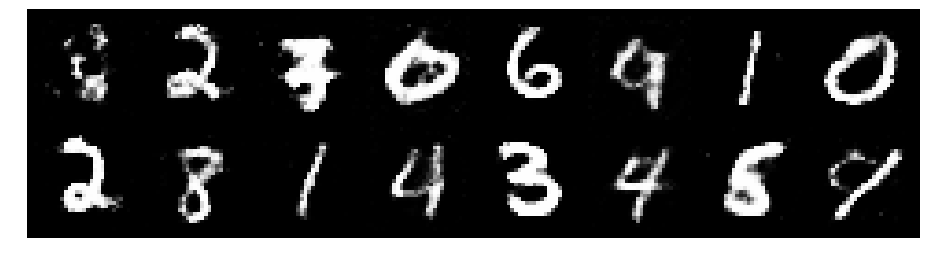

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2824, Generator Loss: 0.8606
D(x): 0.5434, D(G(z)): 0.4431


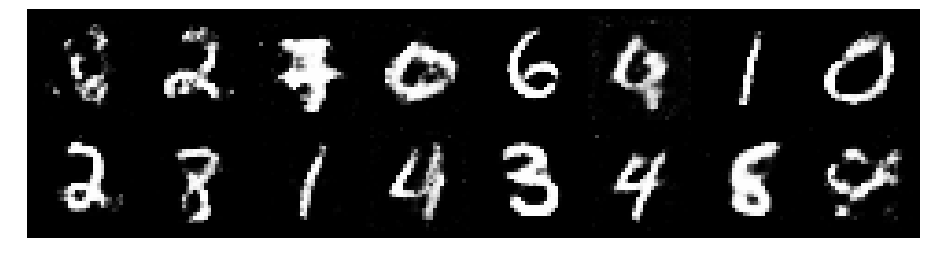

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.3069, Generator Loss: 0.8222
D(x): 0.5205, D(G(z)): 0.4530


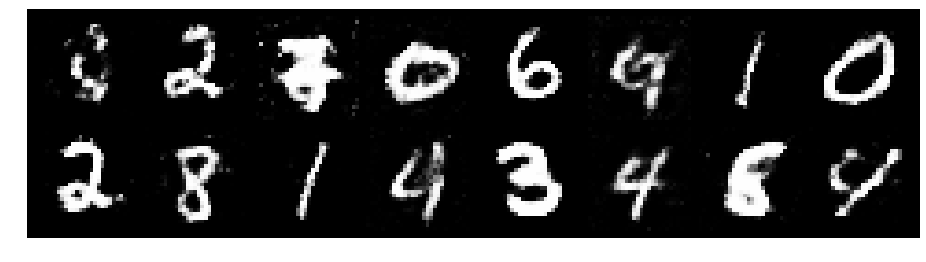

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.2228, Generator Loss: 0.8670
D(x): 0.5921, D(G(z)): 0.4551


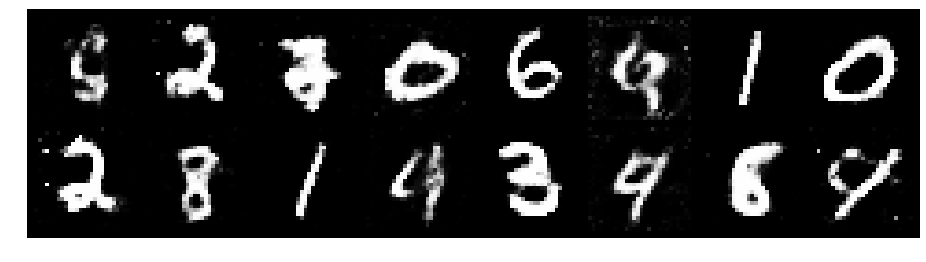

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3375, Generator Loss: 0.9207
D(x): 0.5098, D(G(z)): 0.4386


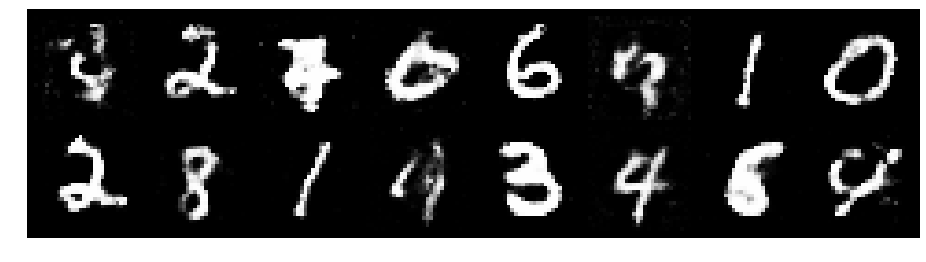

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2403, Generator Loss: 0.8755
D(x): 0.5483, D(G(z)): 0.4266


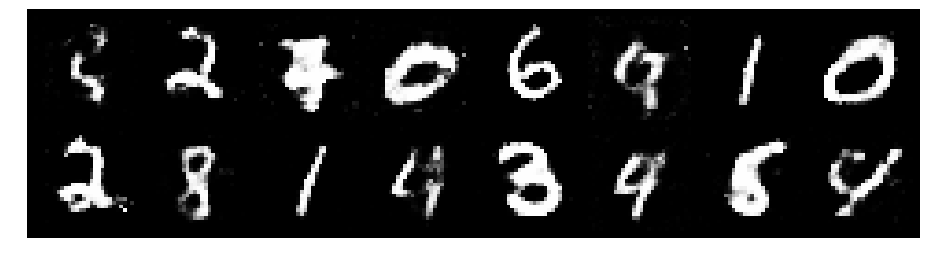

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3435, Generator Loss: 0.8769
D(x): 0.5118, D(G(z)): 0.4553


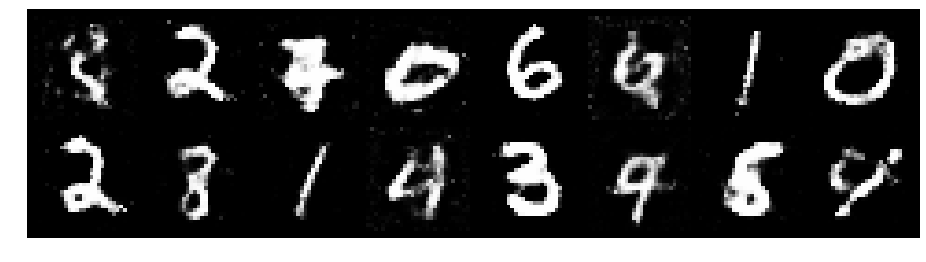

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2385, Generator Loss: 0.9365
D(x): 0.5448, D(G(z)): 0.4233


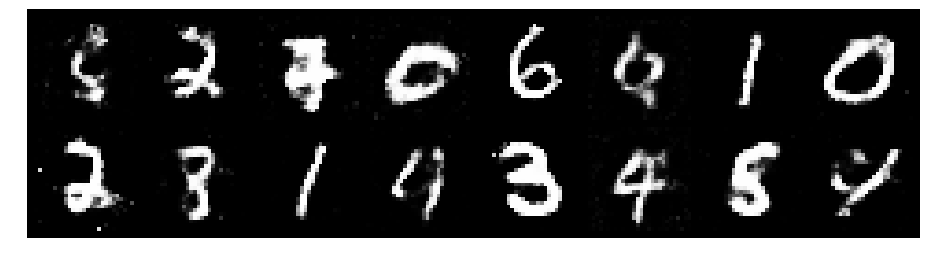

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.1554, Generator Loss: 0.9273
D(x): 0.5803, D(G(z)): 0.4092


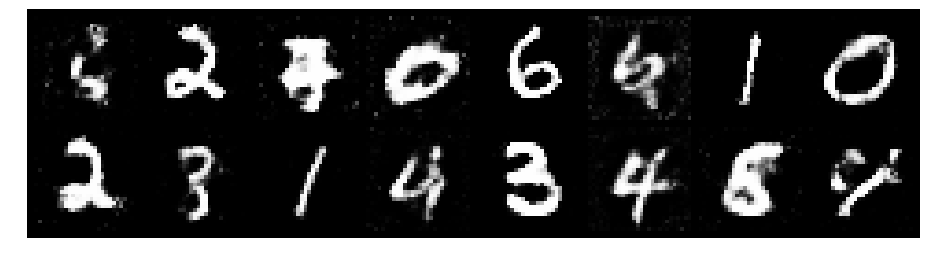

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9960
D(x): 0.5479, D(G(z)): 0.4116


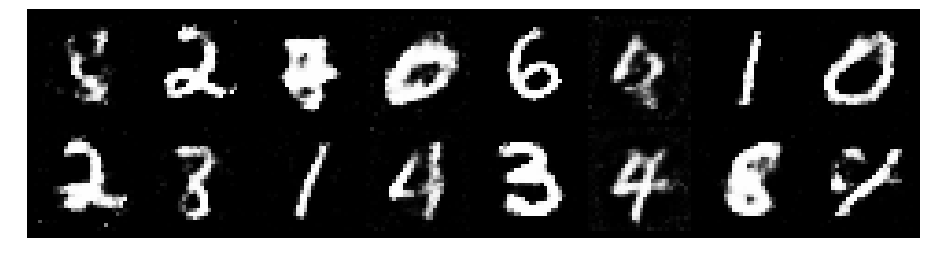

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3012, Generator Loss: 0.8787
D(x): 0.5677, D(G(z)): 0.4653


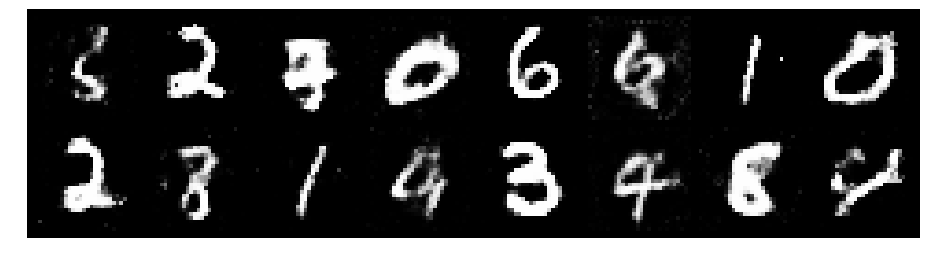

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3002, Generator Loss: 1.0369
D(x): 0.5616, D(G(z)): 0.4690


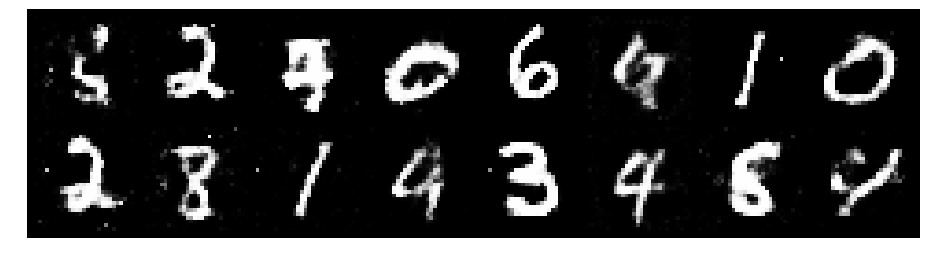

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2339, Generator Loss: 0.8293
D(x): 0.5628, D(G(z)): 0.4221


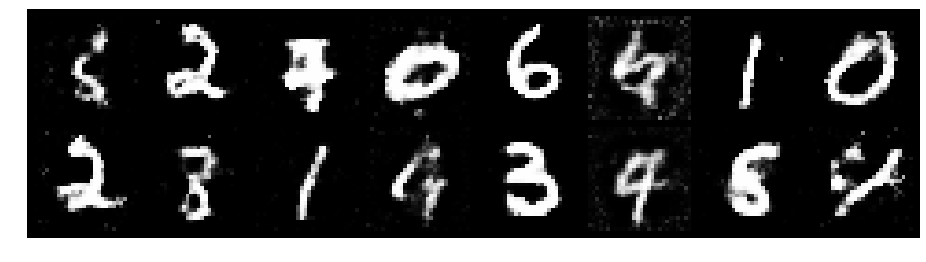

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.2666, Generator Loss: 0.8875
D(x): 0.5851, D(G(z)): 0.4564


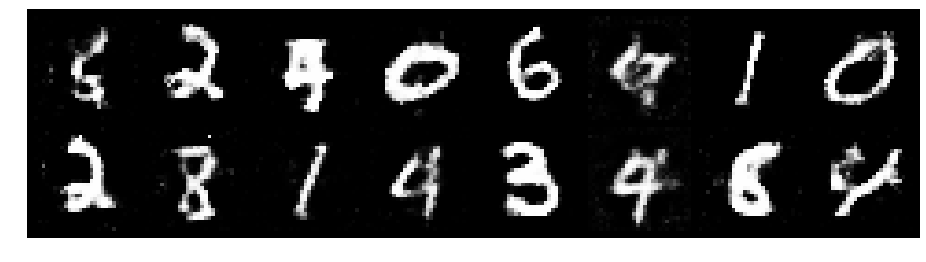

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.3448, Generator Loss: 0.8849
D(x): 0.5499, D(G(z)): 0.4511


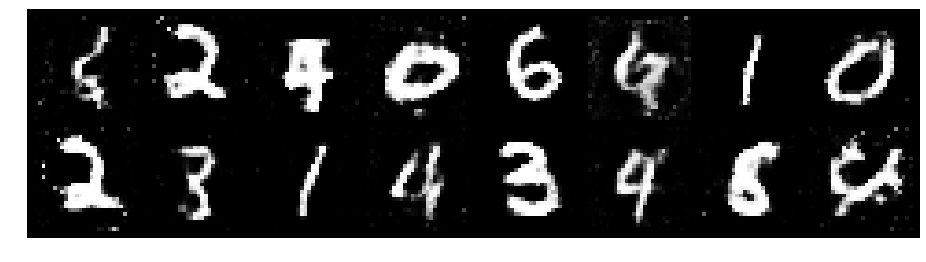

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.2111, Generator Loss: 1.0003
D(x): 0.5607, D(G(z)): 0.4108


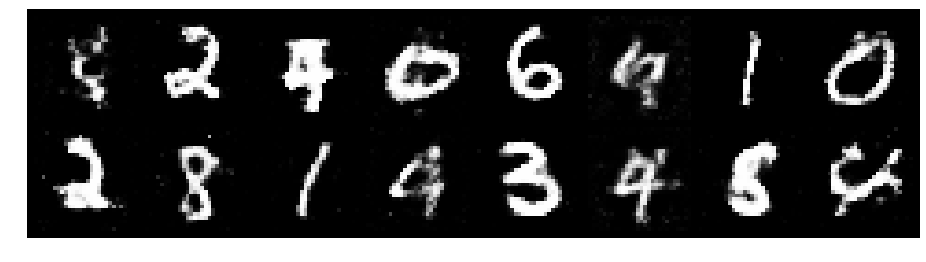

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2477, Generator Loss: 0.9625
D(x): 0.5564, D(G(z)): 0.4355


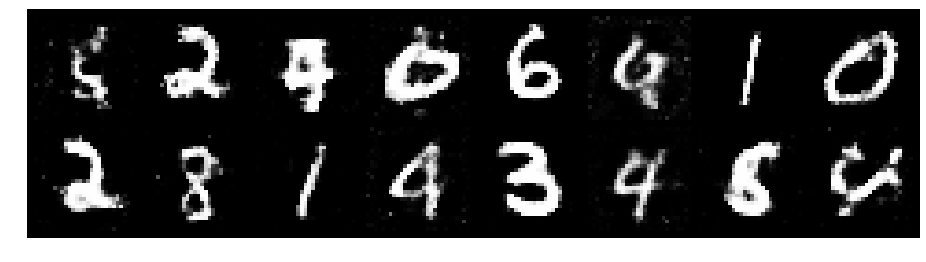

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2544, Generator Loss: 0.8262
D(x): 0.5484, D(G(z)): 0.4491


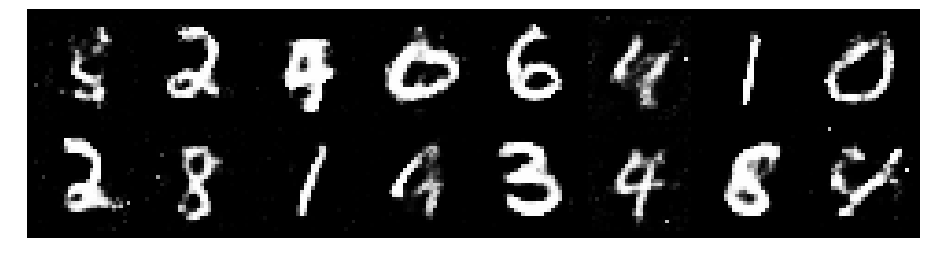

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3496, Generator Loss: 0.8055
D(x): 0.5425, D(G(z)): 0.4736


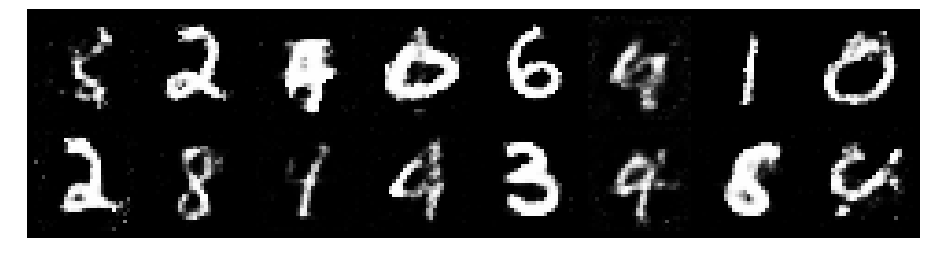

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.1975, Generator Loss: 0.8615
D(x): 0.5645, D(G(z)): 0.4275


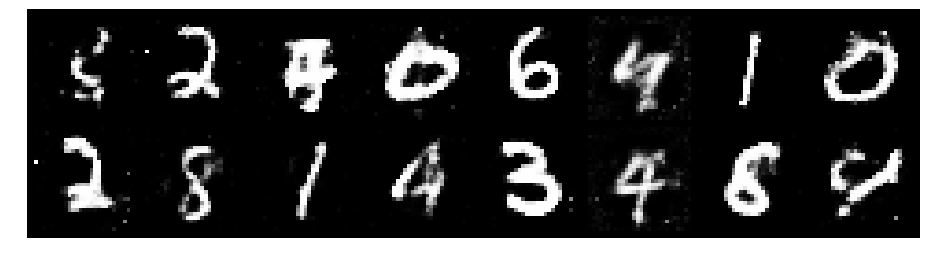

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2900, Generator Loss: 0.8020
D(x): 0.5755, D(G(z)): 0.4745


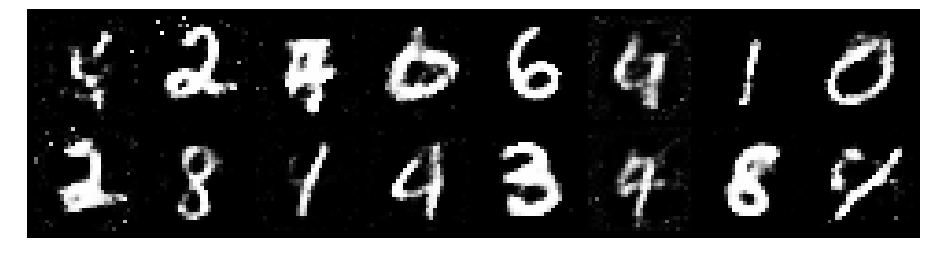

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.3519, Generator Loss: 0.8313
D(x): 0.5934, D(G(z)): 0.4898


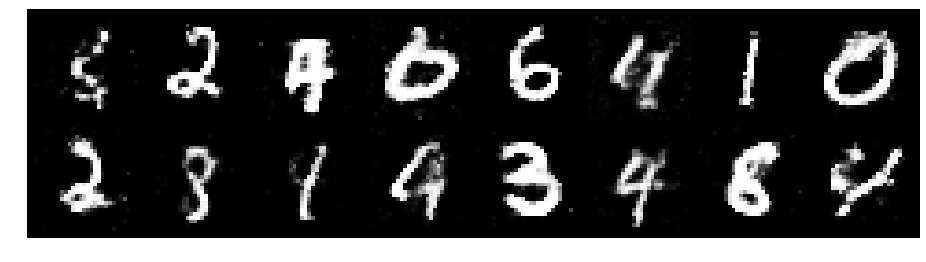

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8992
D(x): 0.5245, D(G(z)): 0.4413


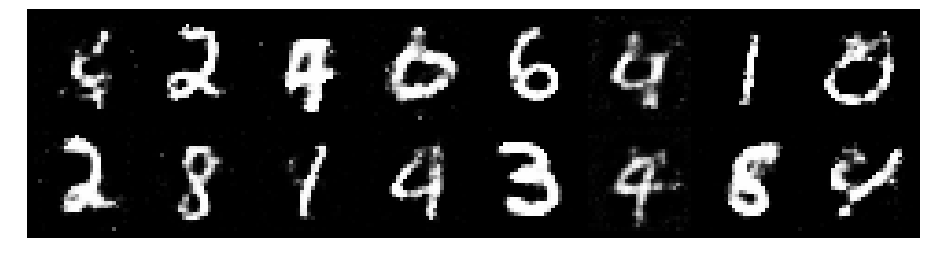

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.2410, Generator Loss: 0.8346
D(x): 0.5764, D(G(z)): 0.4661


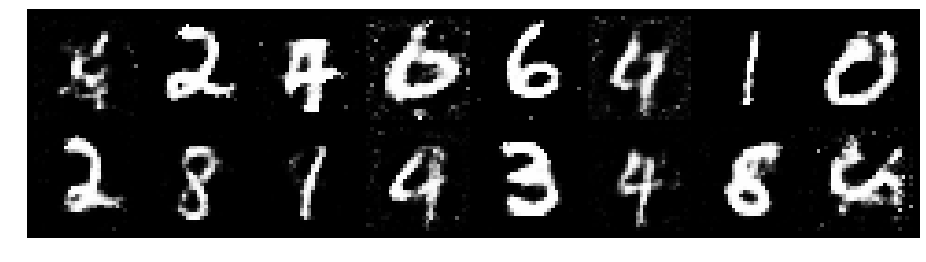

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.2762, Generator Loss: 0.8779
D(x): 0.5646, D(G(z)): 0.4551


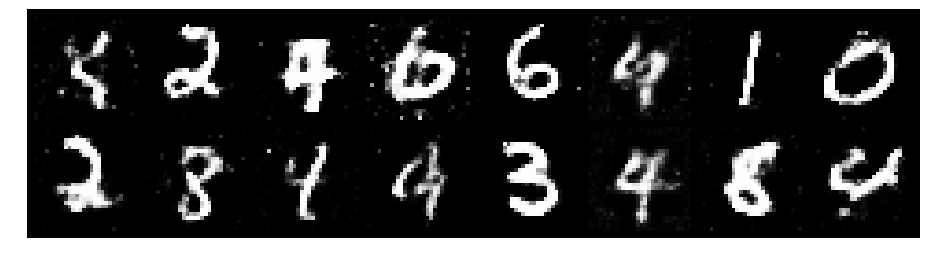

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3526, Generator Loss: 0.7929
D(x): 0.5312, D(G(z)): 0.4729


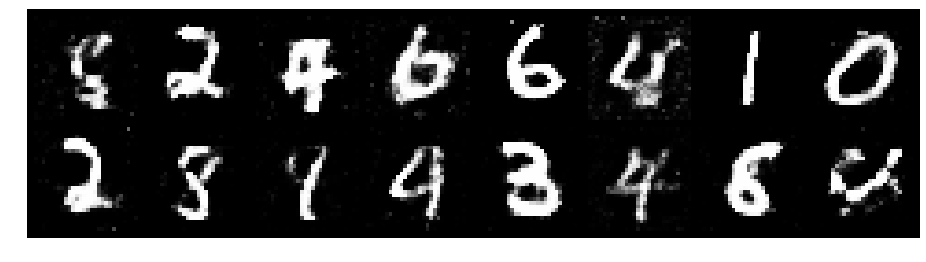

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3050, Generator Loss: 0.8131
D(x): 0.5380, D(G(z)): 0.4533


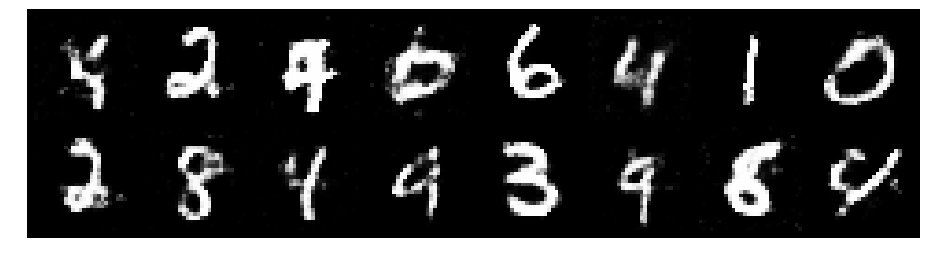

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.3711, Generator Loss: 0.9034
D(x): 0.5209, D(G(z)): 0.4652


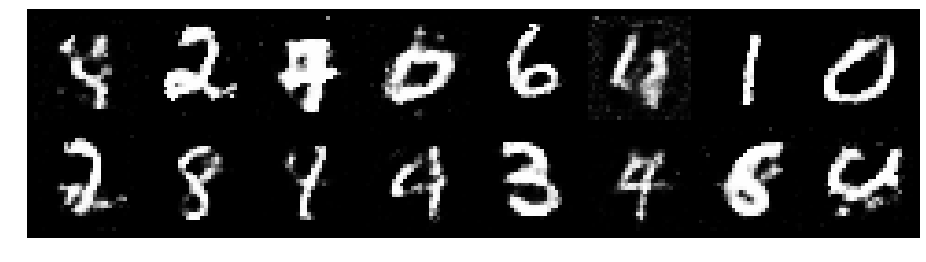

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.4091, Generator Loss: 0.8245
D(x): 0.5474, D(G(z)): 0.4918


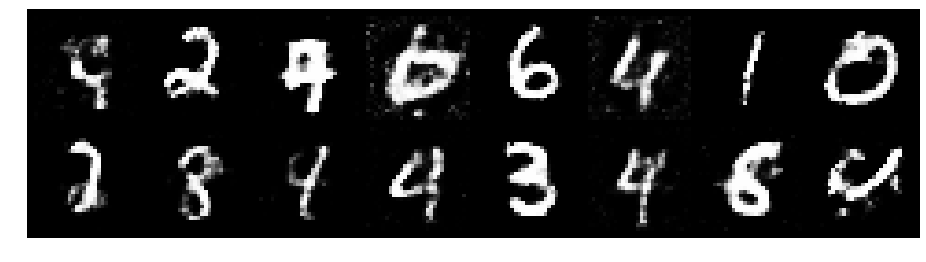

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2893, Generator Loss: 0.8335
D(x): 0.5683, D(G(z)): 0.4725


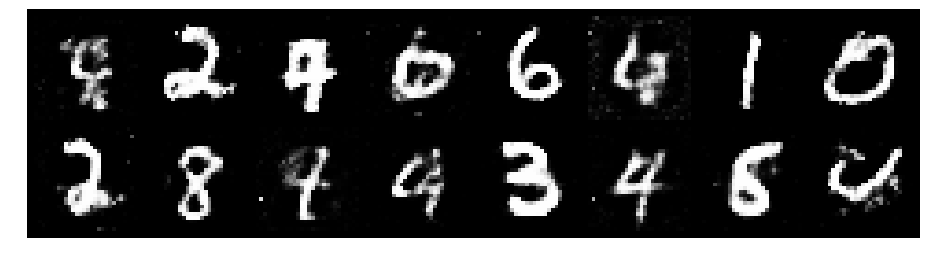

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.3328, Generator Loss: 0.8683
D(x): 0.5170, D(G(z)): 0.4504


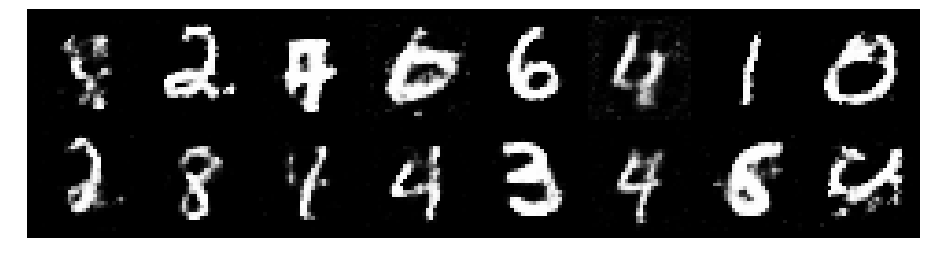

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2692, Generator Loss: 0.7516
D(x): 0.5593, D(G(z)): 0.4628


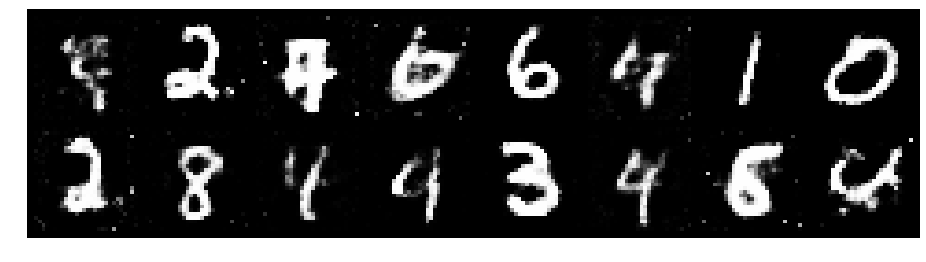

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.2662, Generator Loss: 0.9281
D(x): 0.5546, D(G(z)): 0.4403


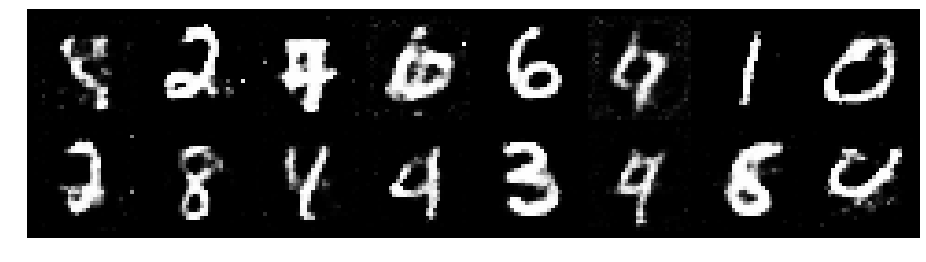

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.3277, Generator Loss: 0.8456
D(x): 0.5525, D(G(z)): 0.4626


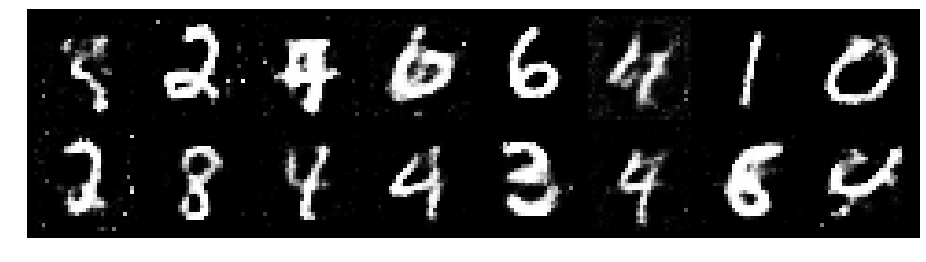

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2735, Generator Loss: 0.7913
D(x): 0.5680, D(G(z)): 0.4677


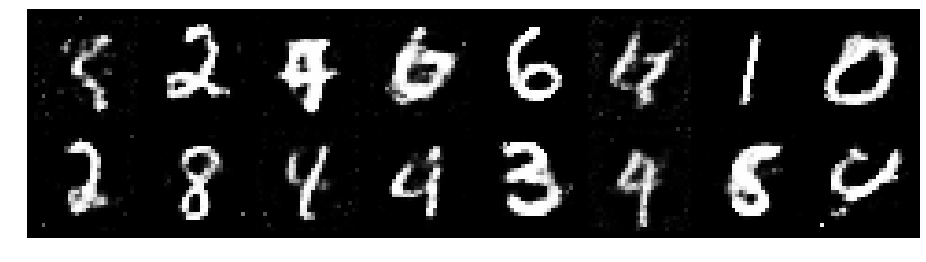

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.1789, Generator Loss: 0.8393
D(x): 0.5819, D(G(z)): 0.4311


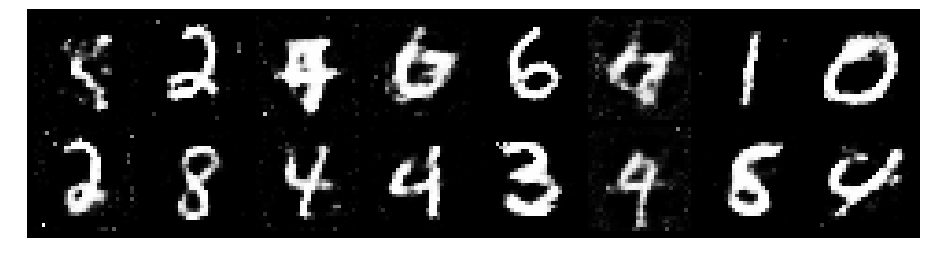

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.3255, Generator Loss: 0.7590
D(x): 0.6006, D(G(z)): 0.5180


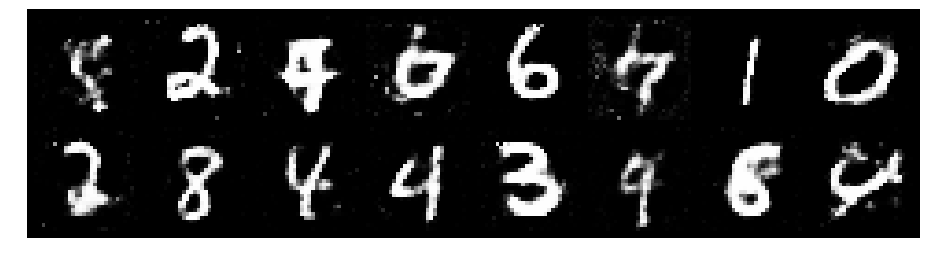

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2232, Generator Loss: 0.9136
D(x): 0.5511, D(G(z)): 0.4198


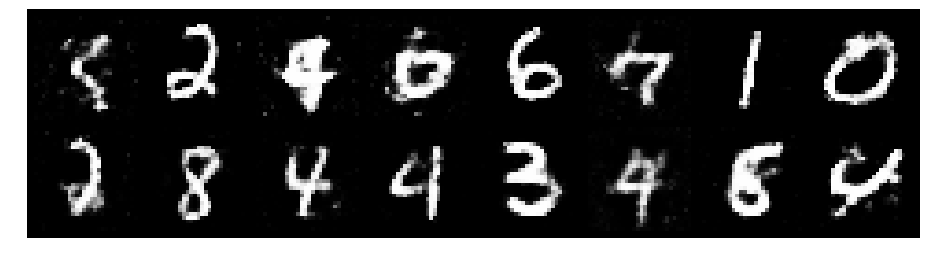

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.3355, Generator Loss: 0.9555
D(x): 0.5301, D(G(z)): 0.4536


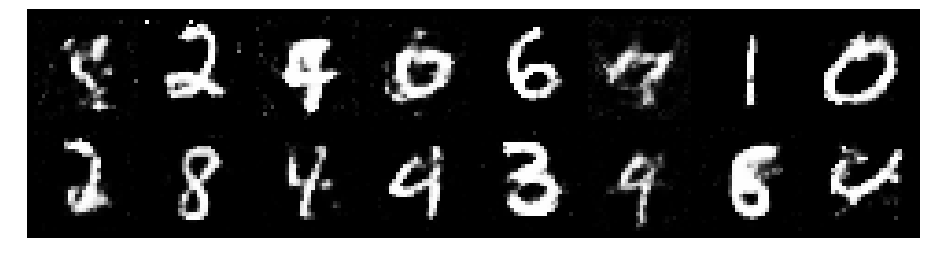

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.3167, Generator Loss: 0.8014
D(x): 0.5986, D(G(z)): 0.5096


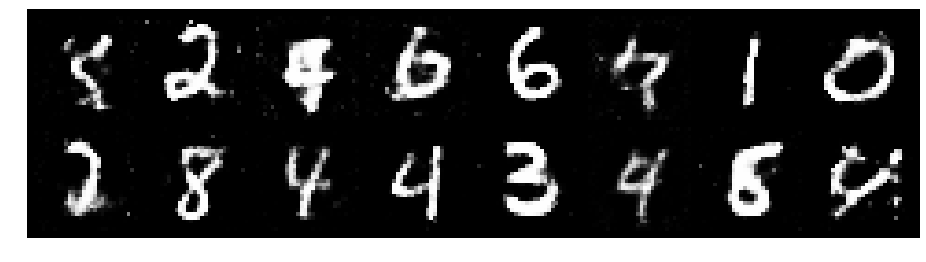

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8745
D(x): 0.5397, D(G(z)): 0.4176


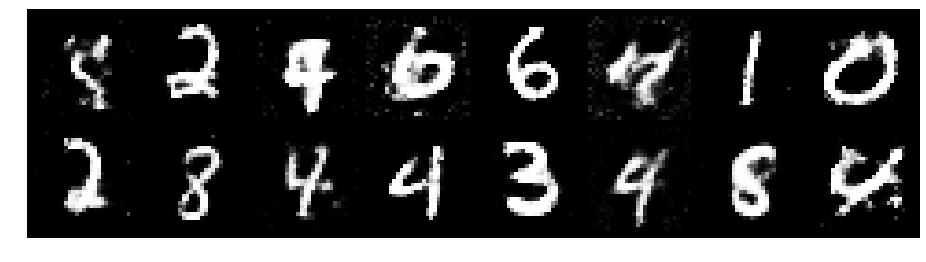

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9573
D(x): 0.5911, D(G(z)): 0.4438


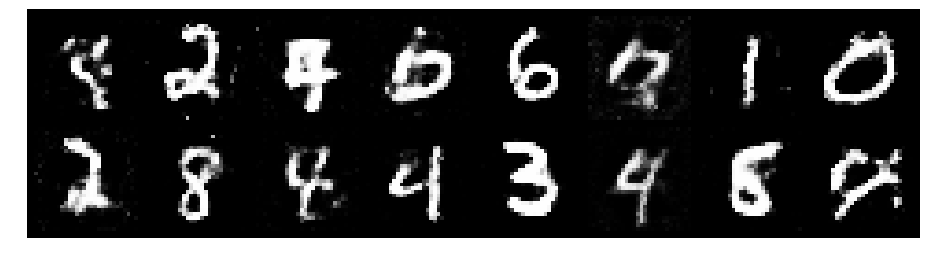

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2143, Generator Loss: 1.0109
D(x): 0.5682, D(G(z)): 0.4205


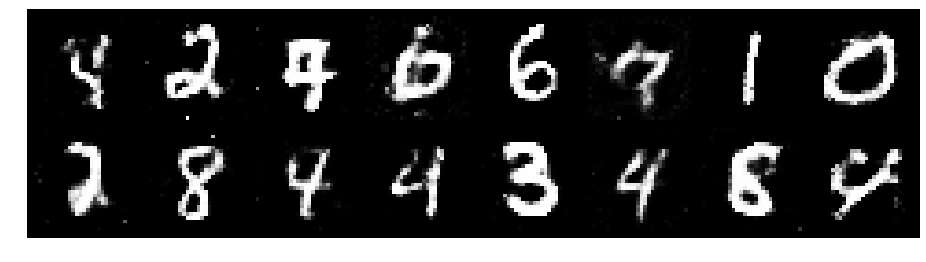

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2436, Generator Loss: 0.8406
D(x): 0.5567, D(G(z)): 0.4436


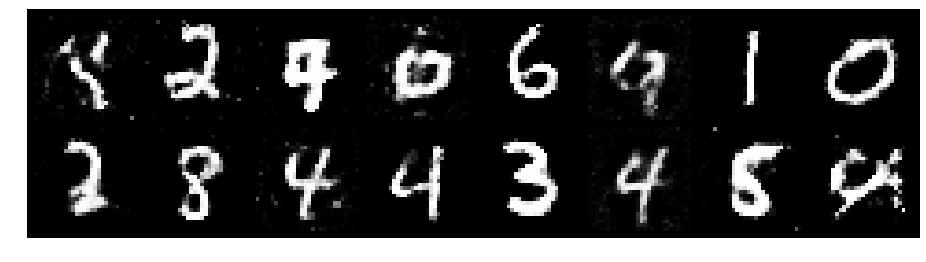

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2921, Generator Loss: 1.0108
D(x): 0.5161, D(G(z)): 0.4061


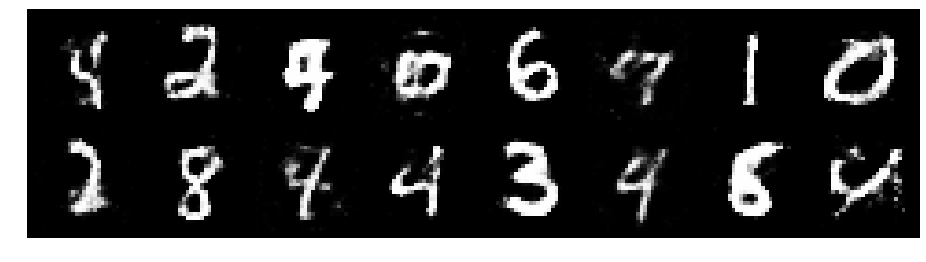

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3458, Generator Loss: 0.8150
D(x): 0.5581, D(G(z)): 0.4776


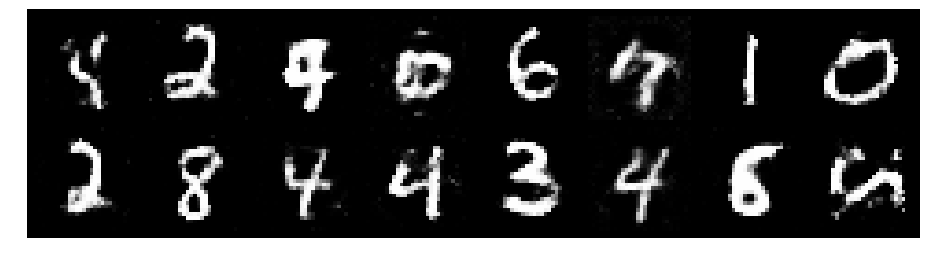

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3201, Generator Loss: 0.8677
D(x): 0.5341, D(G(z)): 0.4617


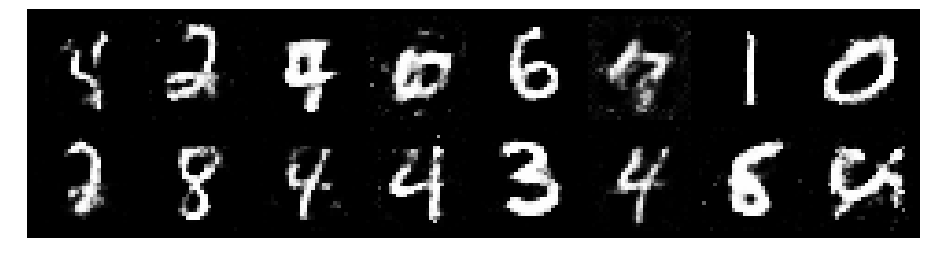

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2851, Generator Loss: 0.9004
D(x): 0.5560, D(G(z)): 0.4529


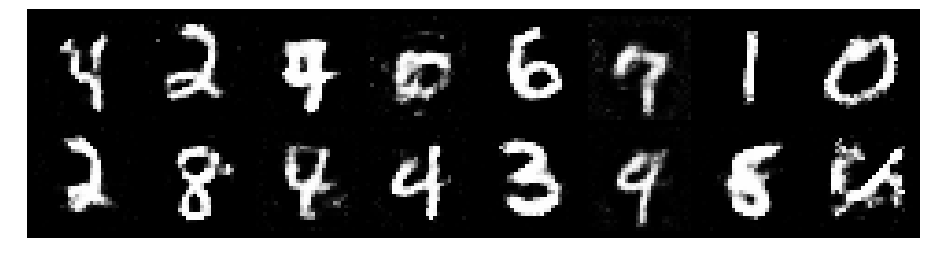

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2313, Generator Loss: 0.9426
D(x): 0.5789, D(G(z)): 0.4362


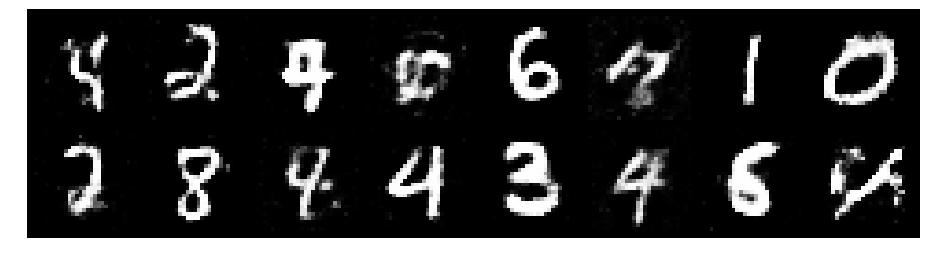

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3979, Generator Loss: 0.8514
D(x): 0.5448, D(G(z)): 0.4790


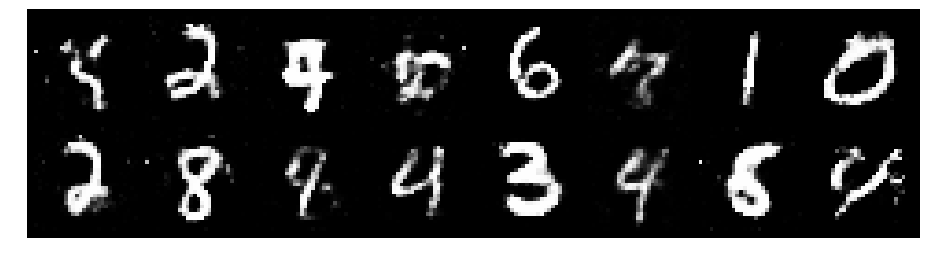

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.3381, Generator Loss: 0.8118
D(x): 0.5494, D(G(z)): 0.4896


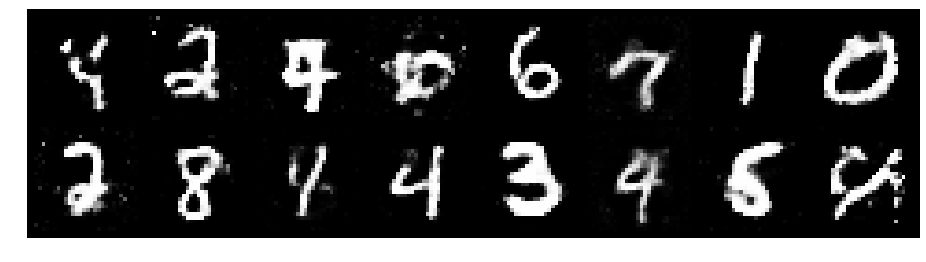

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.3945, Generator Loss: 0.8828
D(x): 0.5449, D(G(z)): 0.4805


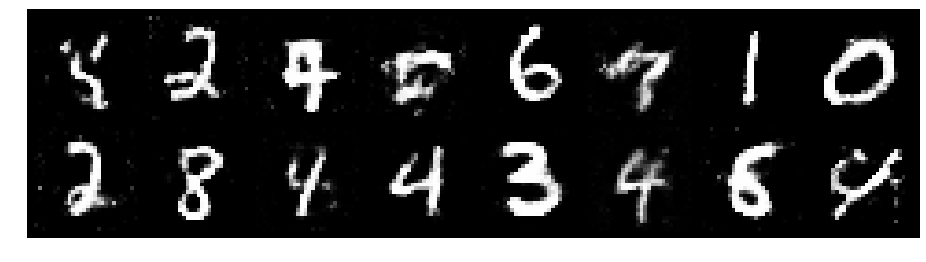

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2780, Generator Loss: 0.8726
D(x): 0.5520, D(G(z)): 0.4560


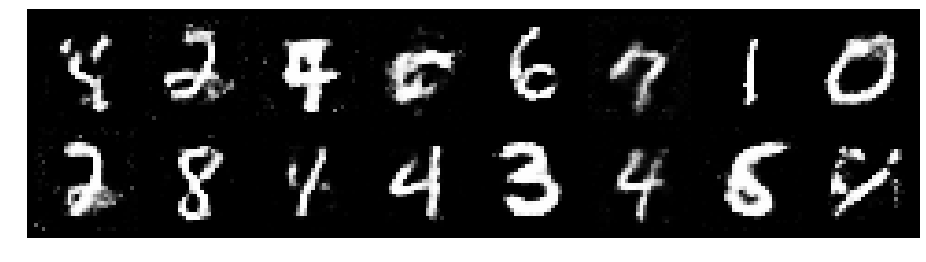

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.3018, Generator Loss: 0.8218
D(x): 0.5307, D(G(z)): 0.4574


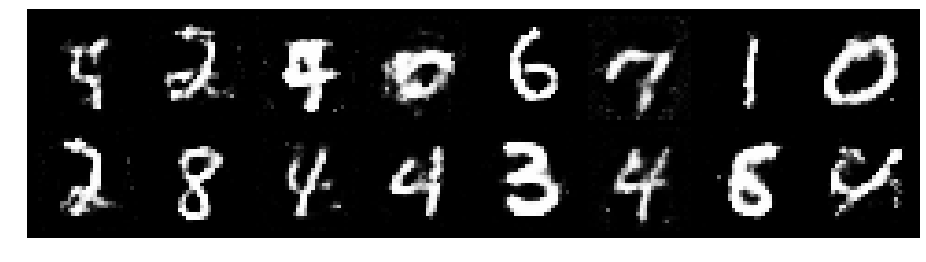

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.3010, Generator Loss: 0.7544
D(x): 0.5416, D(G(z)): 0.4674


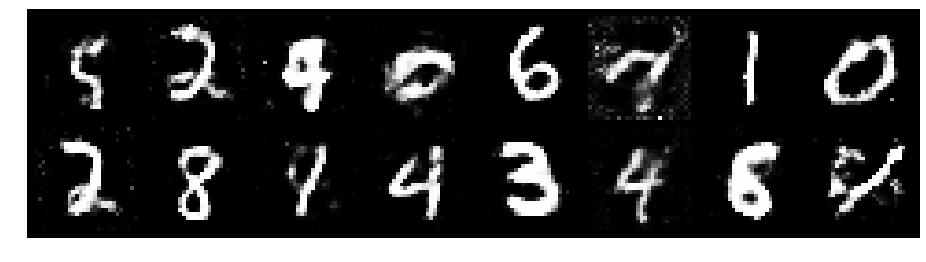

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.4098, Generator Loss: 0.9606
D(x): 0.5695, D(G(z)): 0.5117


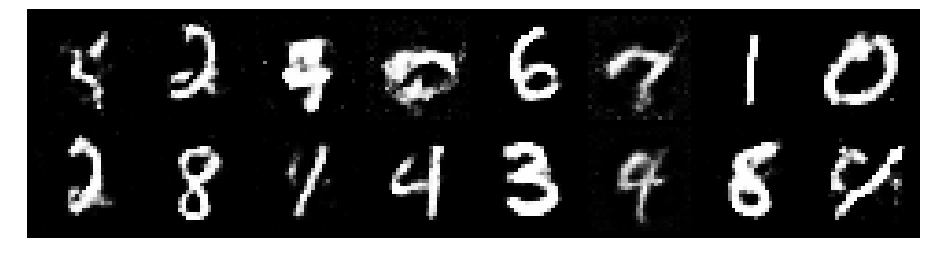

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.3019, Generator Loss: 0.8302
D(x): 0.5525, D(G(z)): 0.4614


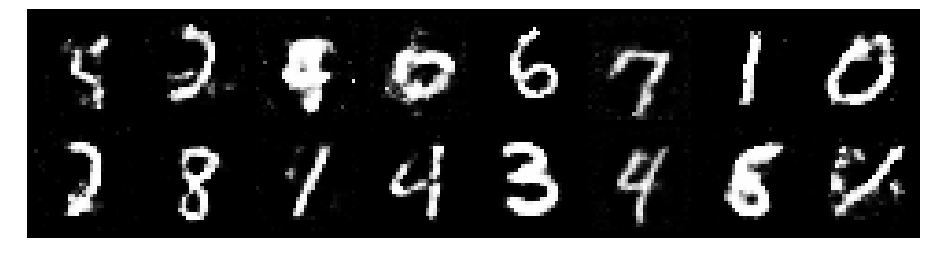

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.3104, Generator Loss: 0.8292
D(x): 0.5411, D(G(z)): 0.4629


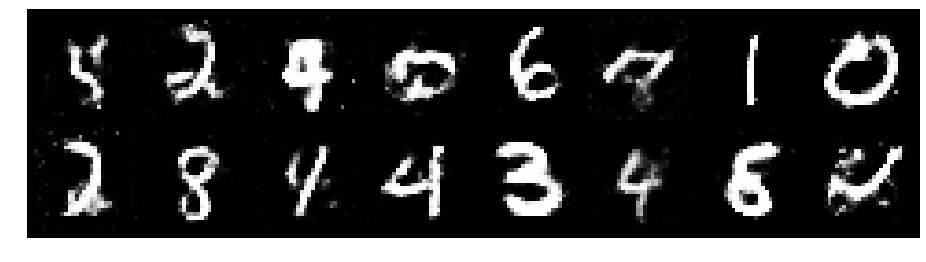

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.3548, Generator Loss: 0.7439
D(x): 0.5434, D(G(z)): 0.4928


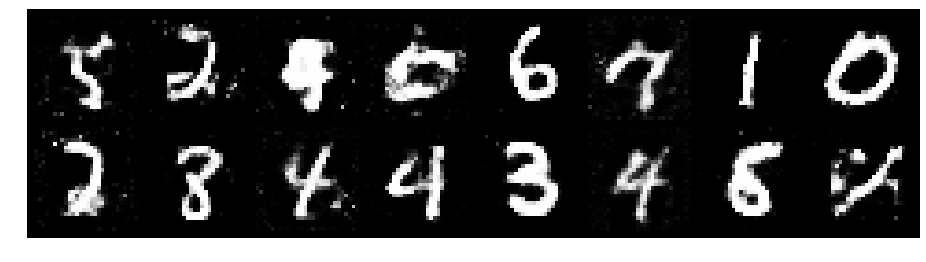

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.3517, Generator Loss: 0.7089
D(x): 0.5472, D(G(z)): 0.4948


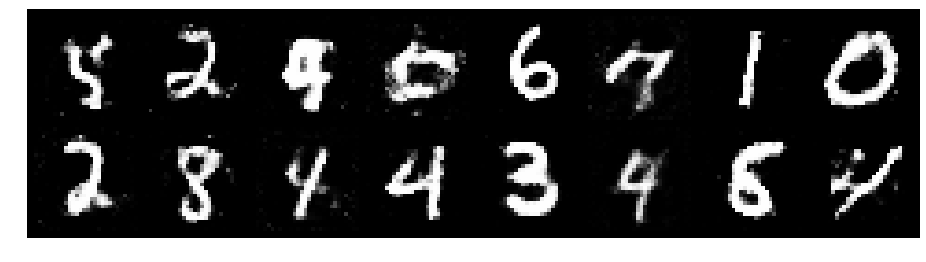

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2089, Generator Loss: 0.9263
D(x): 0.5839, D(G(z)): 0.4434


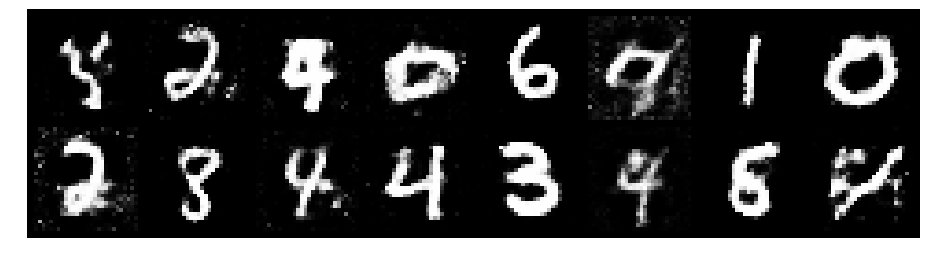

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.3351, Generator Loss: 0.9530
D(x): 0.5292, D(G(z)): 0.4311


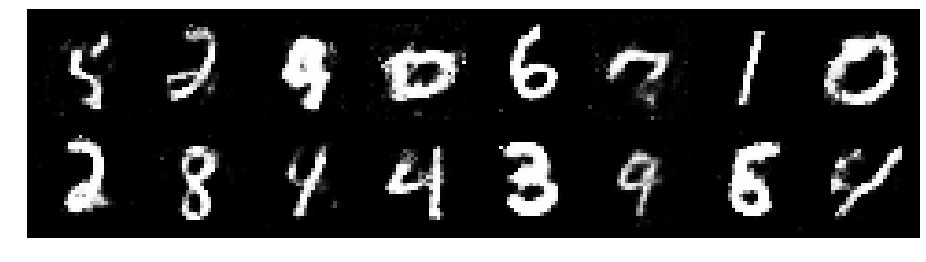

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9151
D(x): 0.5307, D(G(z)): 0.4361


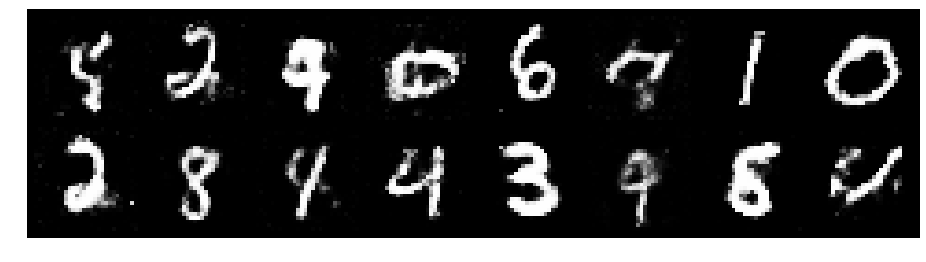

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.3454, Generator Loss: 0.9363
D(x): 0.5234, D(G(z)): 0.4378


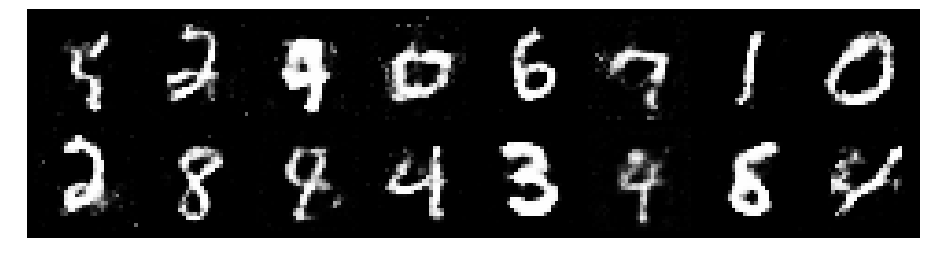

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.3377, Generator Loss: 0.8417
D(x): 0.5322, D(G(z)): 0.4628


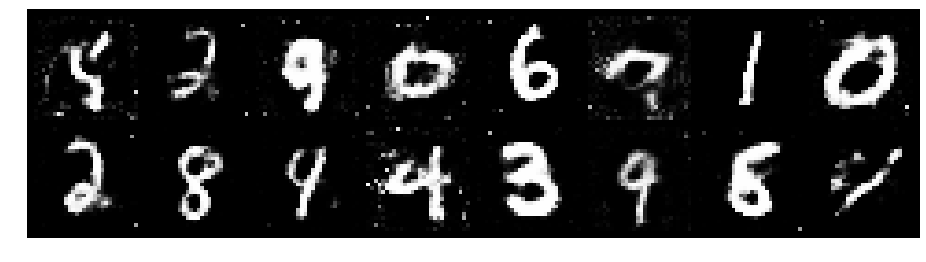

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.3257, Generator Loss: 0.9303
D(x): 0.5316, D(G(z)): 0.4423


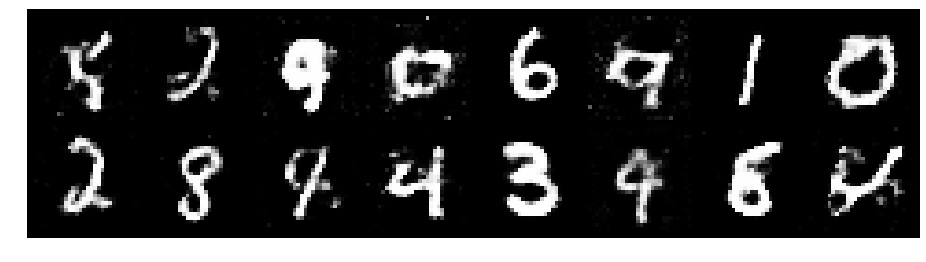

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2098, Generator Loss: 0.8594
D(x): 0.5924, D(G(z)): 0.4318


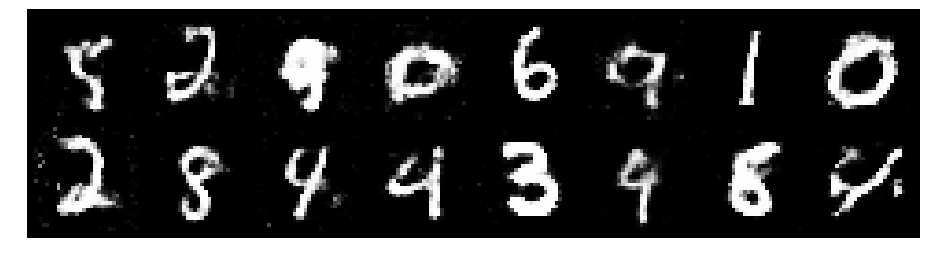

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8742
D(x): 0.5848, D(G(z)): 0.4568


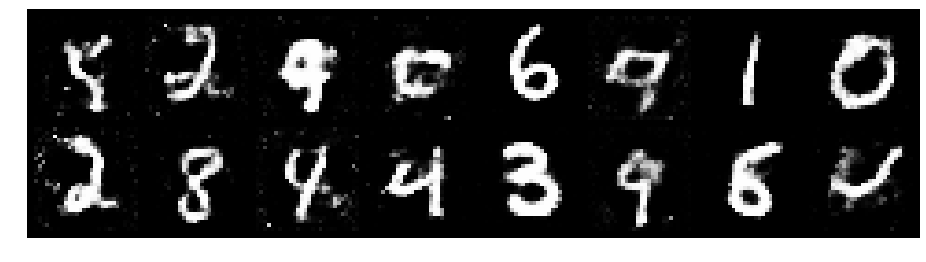

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.3409, Generator Loss: 0.7641
D(x): 0.5193, D(G(z)): 0.4673


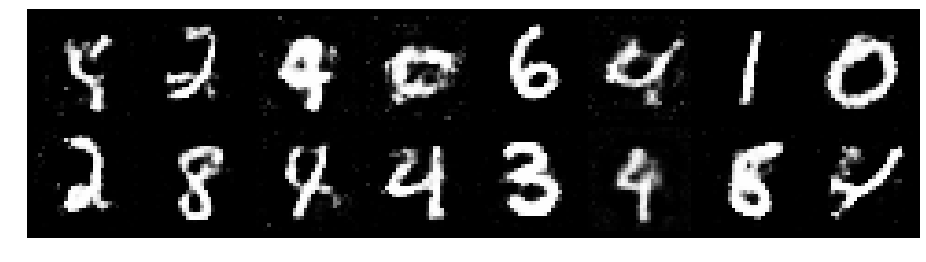

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3885, Generator Loss: 0.7782
D(x): 0.5502, D(G(z)): 0.5003


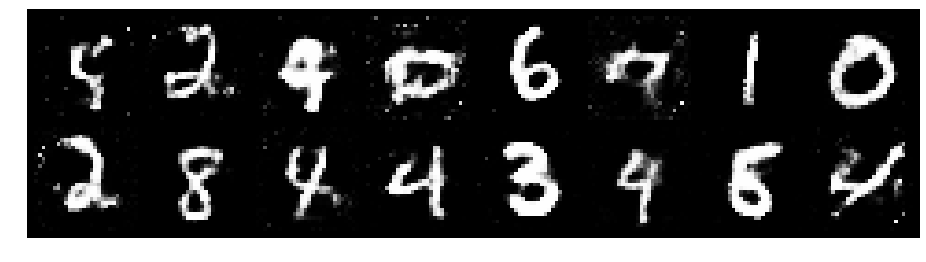

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.2275, Generator Loss: 0.8805
D(x): 0.5495, D(G(z)): 0.4300


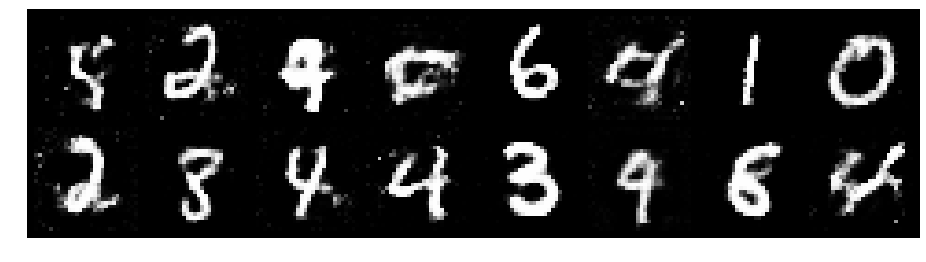

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.3064, Generator Loss: 0.7521
D(x): 0.5393, D(G(z)): 0.4661


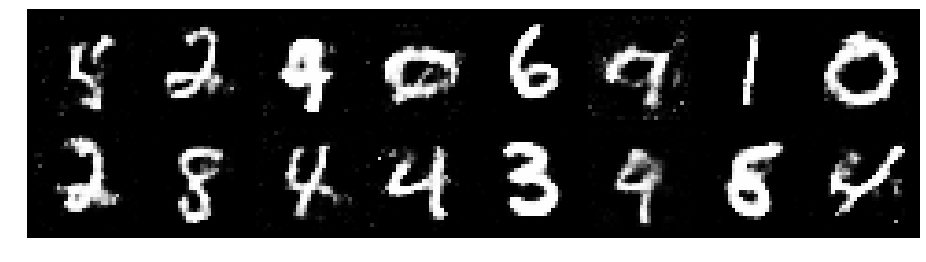

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.3620, Generator Loss: 0.8902
D(x): 0.5082, D(G(z)): 0.4423


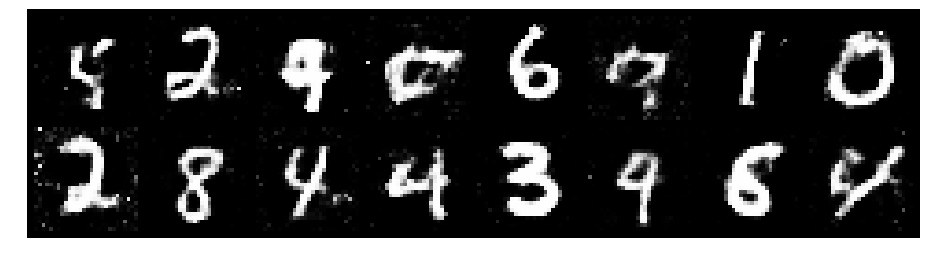

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2978, Generator Loss: 0.8826
D(x): 0.5530, D(G(z)): 0.4611


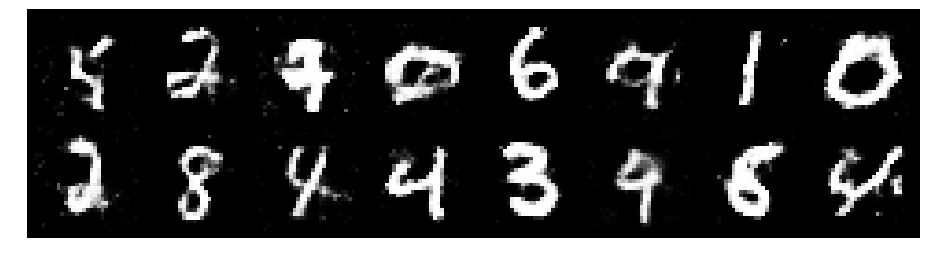

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2409, Generator Loss: 0.8215
D(x): 0.5695, D(G(z)): 0.4531


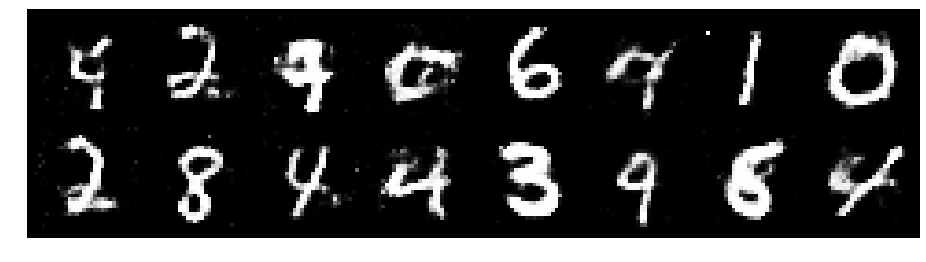

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8501
D(x): 0.5931, D(G(z)): 0.4857


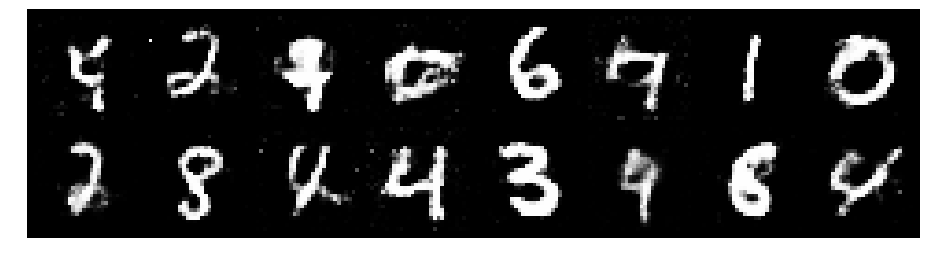

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2559, Generator Loss: 0.9681
D(x): 0.5779, D(G(z)): 0.4485


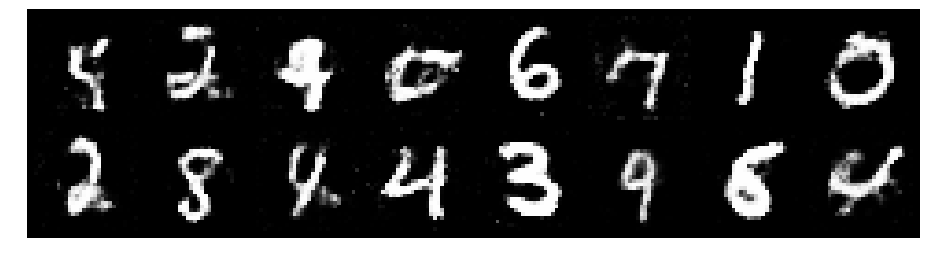

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.3487, Generator Loss: 0.8281
D(x): 0.5234, D(G(z)): 0.4406


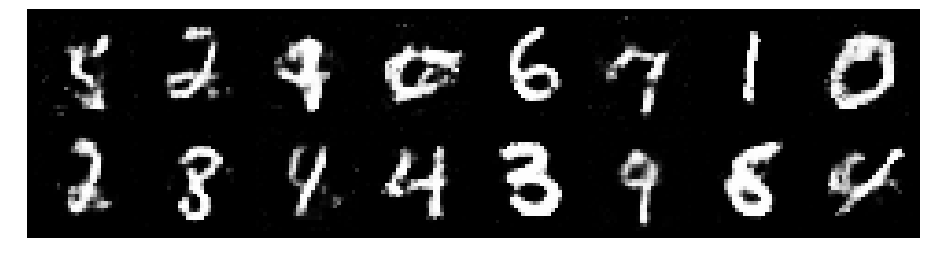

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.2537, Generator Loss: 0.9103
D(x): 0.5593, D(G(z)): 0.4352


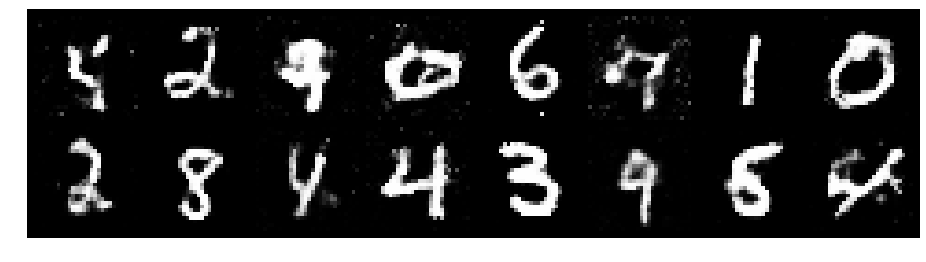

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2331, Generator Loss: 0.8307
D(x): 0.5923, D(G(z)): 0.4549


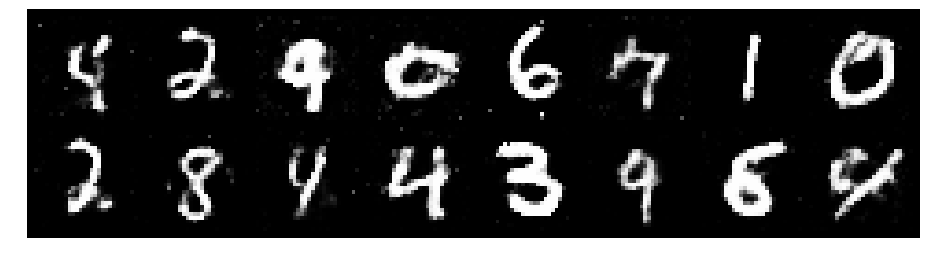

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.3385, Generator Loss: 0.8604
D(x): 0.5440, D(G(z)): 0.4723


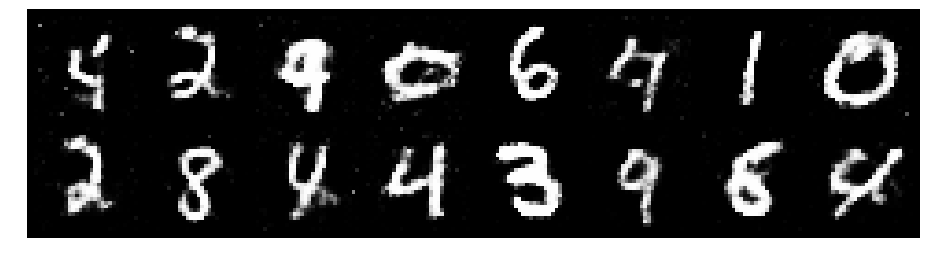

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.2701, Generator Loss: 0.9532
D(x): 0.5250, D(G(z)): 0.4258


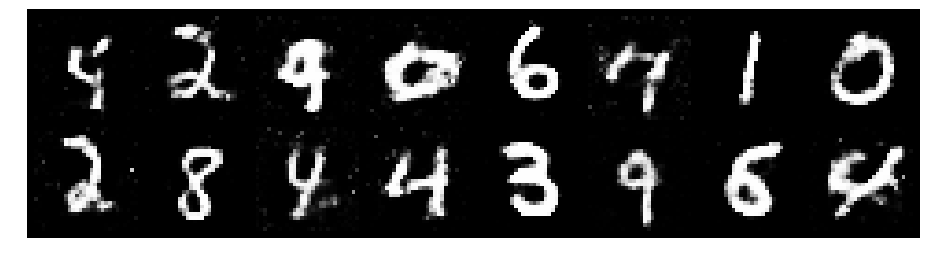

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.3378, Generator Loss: 0.8717
D(x): 0.5289, D(G(z)): 0.4461


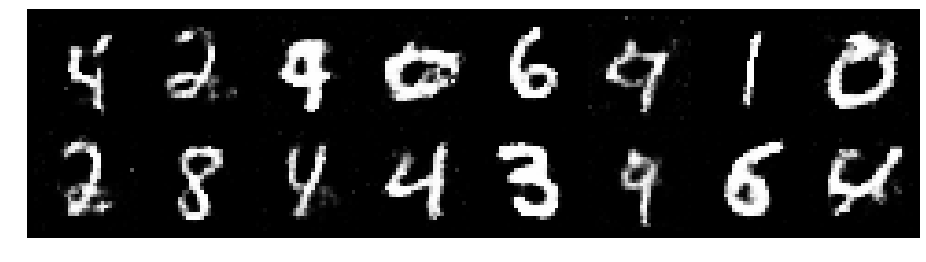

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3433, Generator Loss: 1.0057
D(x): 0.5171, D(G(z)): 0.4224


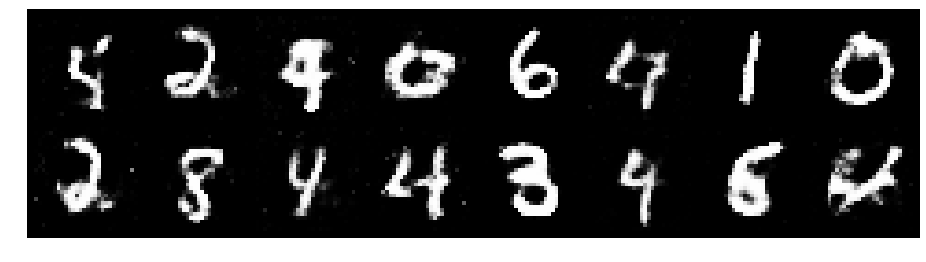

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3266, Generator Loss: 0.8195
D(x): 0.5924, D(G(z)): 0.4989


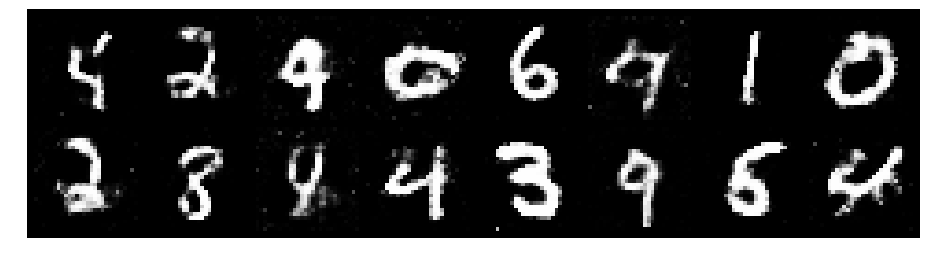

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2560, Generator Loss: 0.8693
D(x): 0.5503, D(G(z)): 0.4470


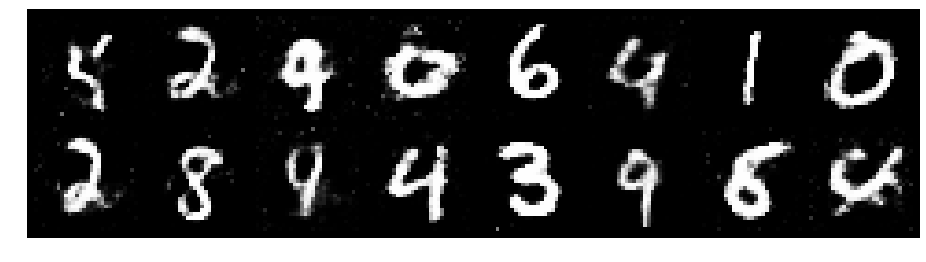

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.1781, Generator Loss: 0.9712
D(x): 0.5838, D(G(z)): 0.4306


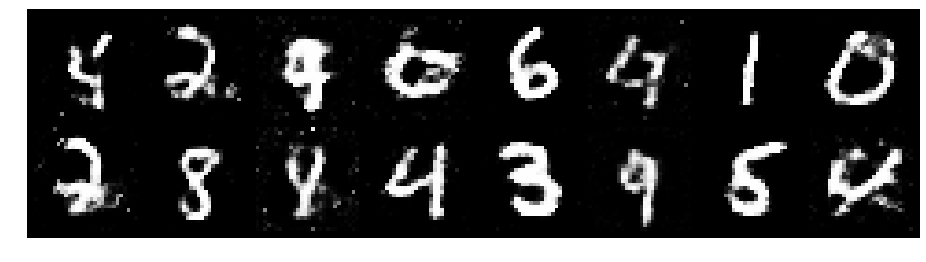

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2711, Generator Loss: 0.8329
D(x): 0.5437, D(G(z)): 0.4339


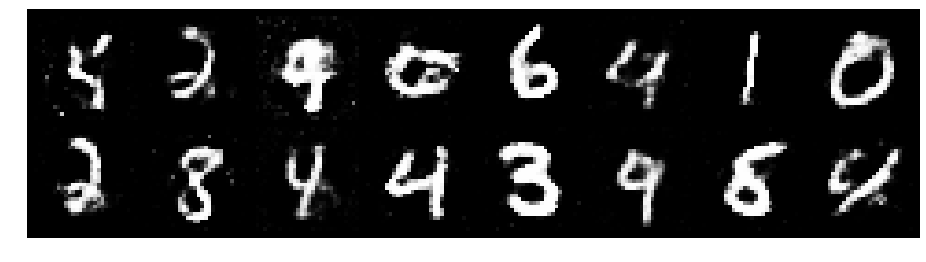

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8459
D(x): 0.5506, D(G(z)): 0.4616


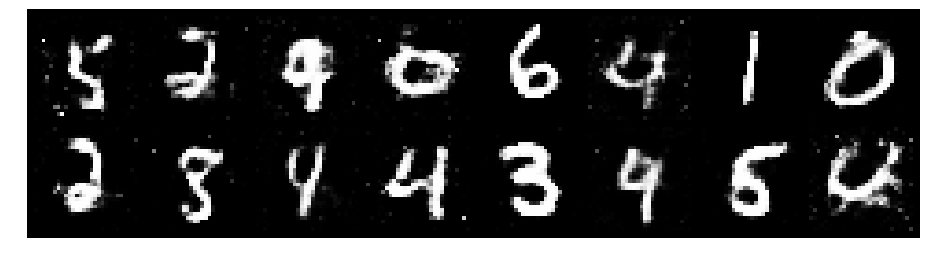

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2512, Generator Loss: 0.9098
D(x): 0.5499, D(G(z)): 0.4327


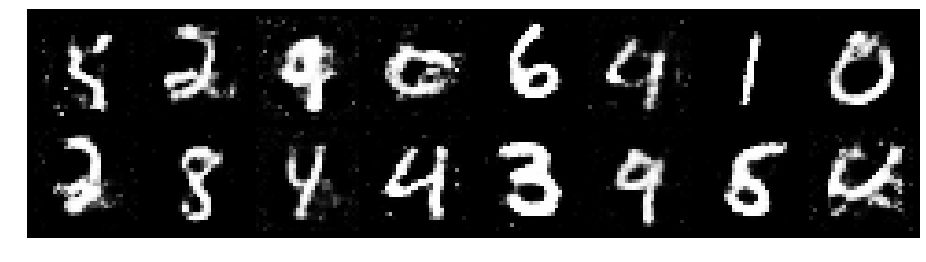

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9414
D(x): 0.5223, D(G(z)): 0.4000


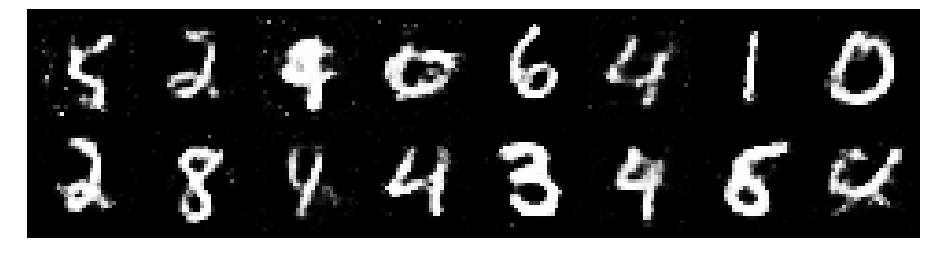

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.3356, Generator Loss: 0.8592
D(x): 0.5322, D(G(z)): 0.4565


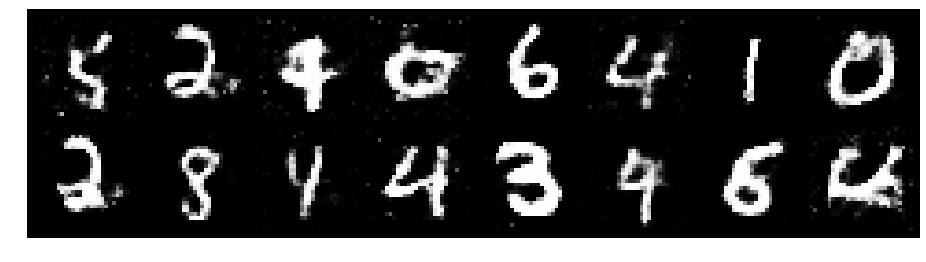

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3988, Generator Loss: 0.8129
D(x): 0.5175, D(G(z)): 0.4772


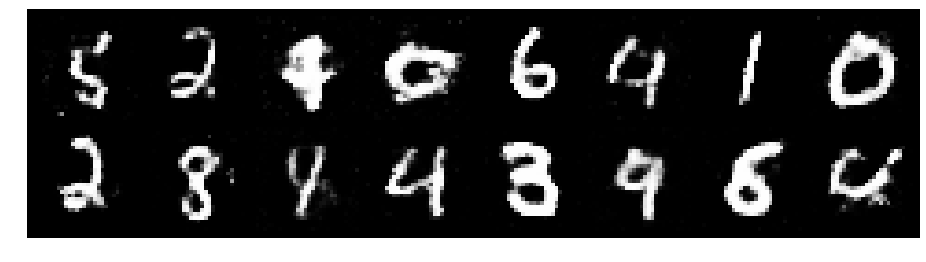

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.3343, Generator Loss: 0.9116
D(x): 0.5197, D(G(z)): 0.4418


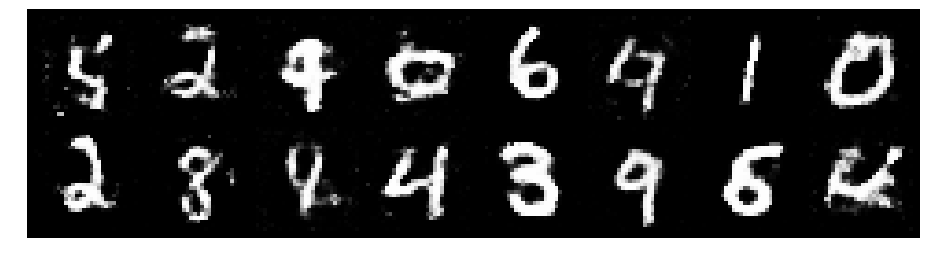

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.3404, Generator Loss: 0.7355
D(x): 0.5488, D(G(z)): 0.4777


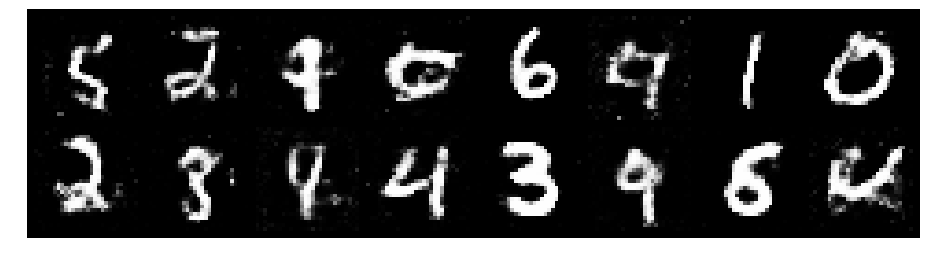

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8081
D(x): 0.5714, D(G(z)): 0.4612


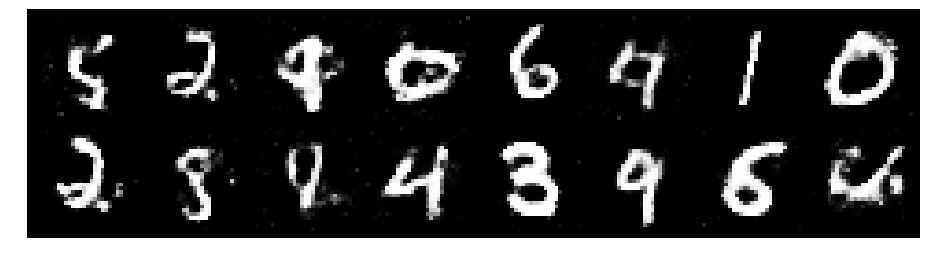

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.3971, Generator Loss: 0.8621
D(x): 0.5228, D(G(z)): 0.4716


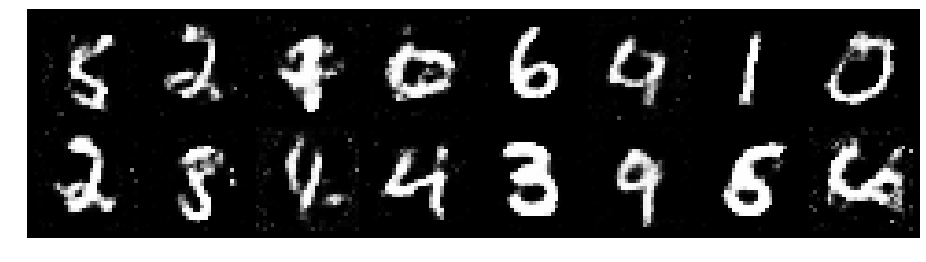

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8803
D(x): 0.5521, D(G(z)): 0.4253


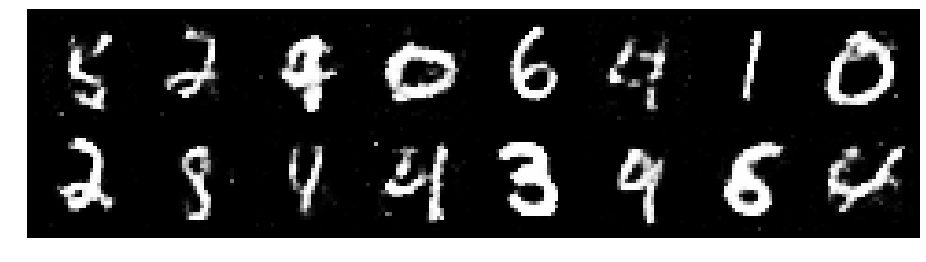

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.4349, Generator Loss: 0.9295
D(x): 0.5158, D(G(z)): 0.4710


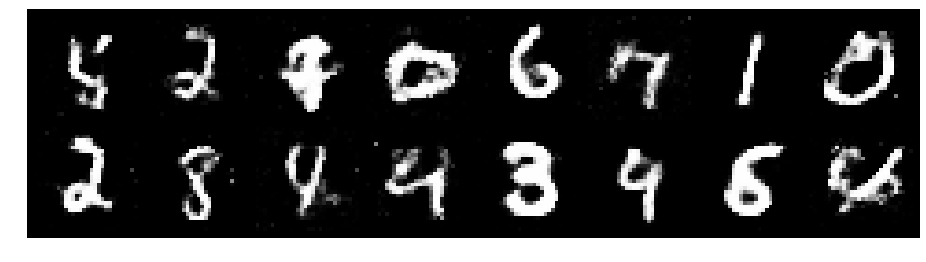

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8684
D(x): 0.5770, D(G(z)): 0.4732


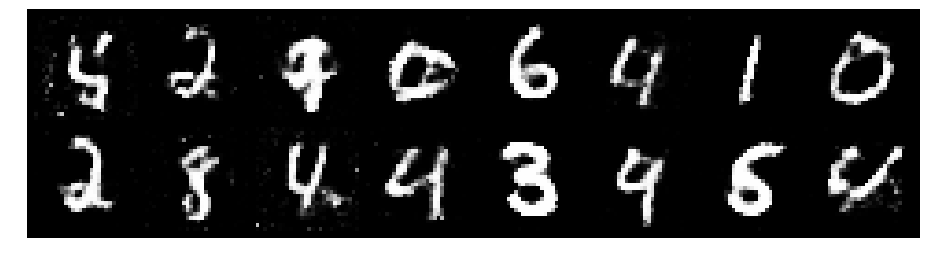

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2720, Generator Loss: 0.7945
D(x): 0.5557, D(G(z)): 0.4577


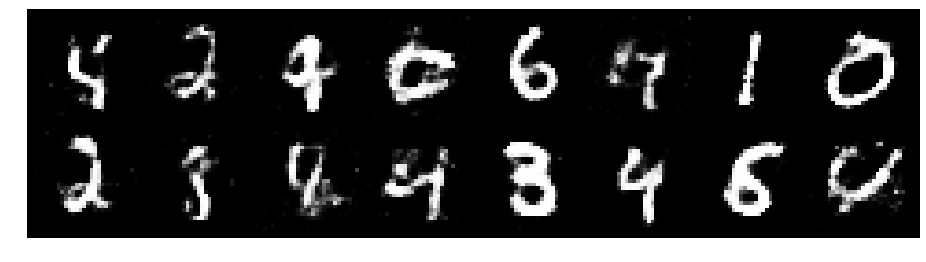

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.2124, Generator Loss: 0.8207
D(x): 0.5800, D(G(z)): 0.4528


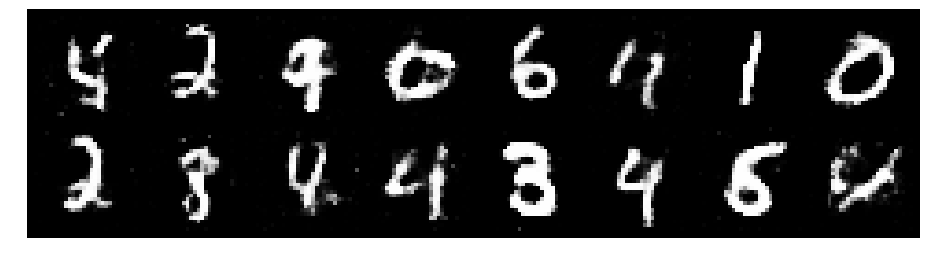

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.3613, Generator Loss: 0.7954
D(x): 0.5217, D(G(z)): 0.4519


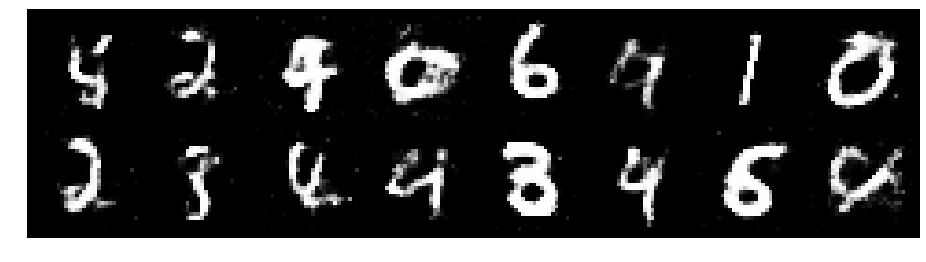

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8619
D(x): 0.5382, D(G(z)): 0.4373


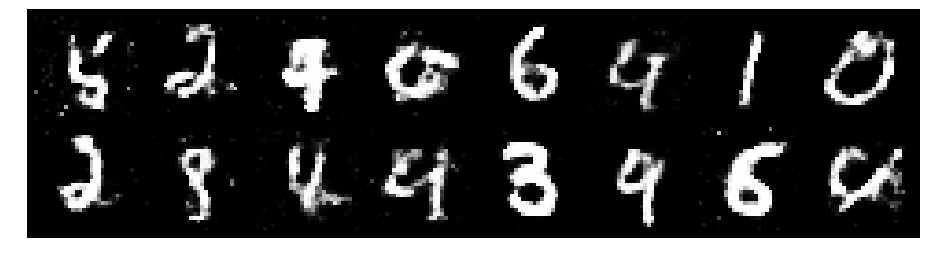

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2064, Generator Loss: 0.9403
D(x): 0.5721, D(G(z)): 0.4382


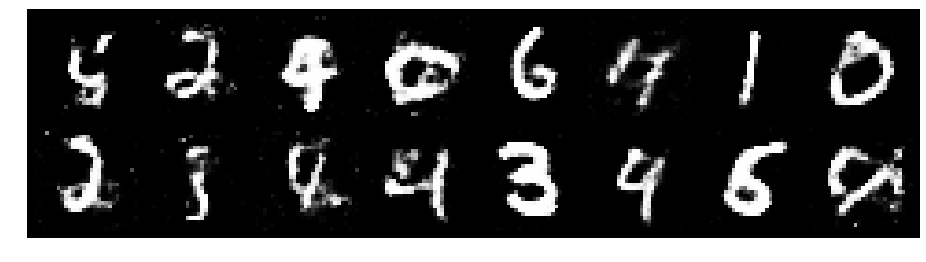

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.2137, Generator Loss: 0.8319
D(x): 0.5771, D(G(z)): 0.4424


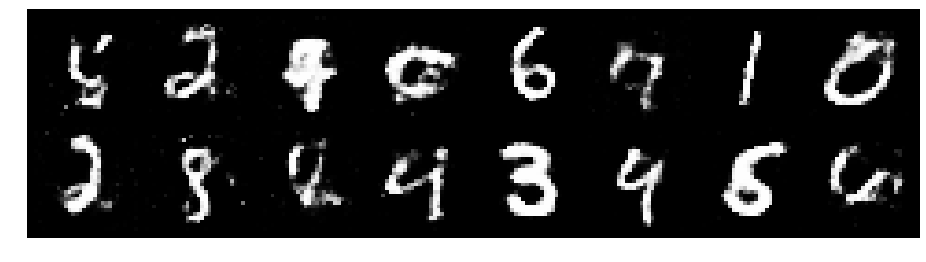

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.2205, Generator Loss: 1.0076
D(x): 0.5454, D(G(z)): 0.4012


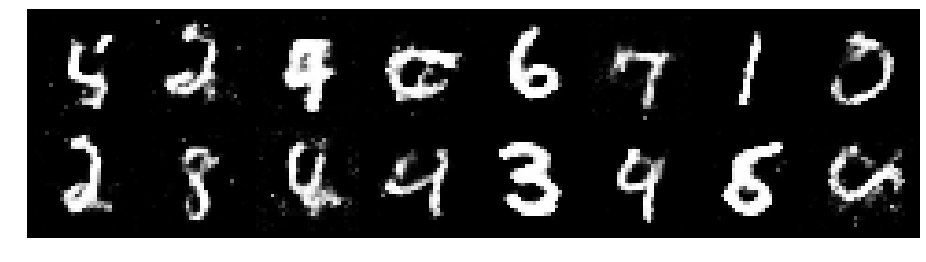

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.3749, Generator Loss: 0.9422
D(x): 0.5038, D(G(z)): 0.4438


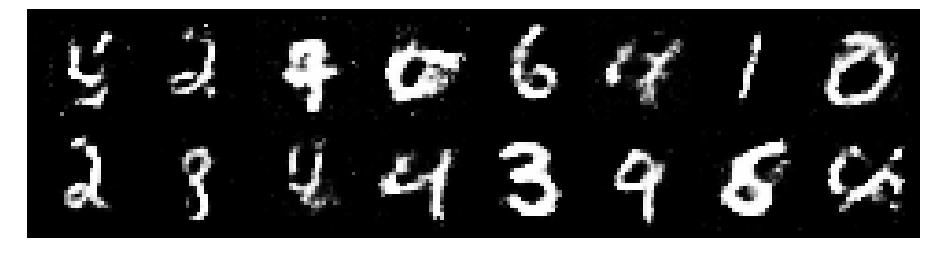

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2892, Generator Loss: 0.9220
D(x): 0.5537, D(G(z)): 0.4591


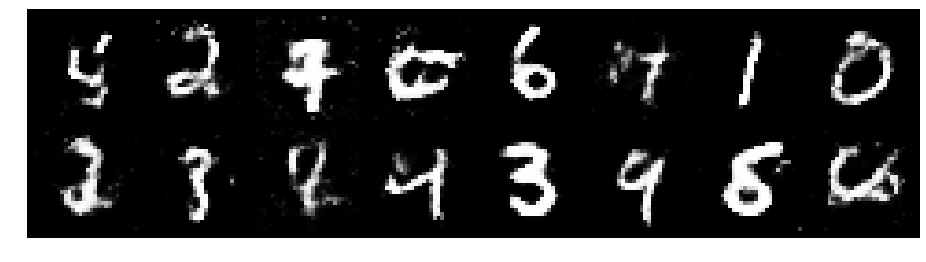

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.3265, Generator Loss: 0.8182
D(x): 0.5525, D(G(z)): 0.4794


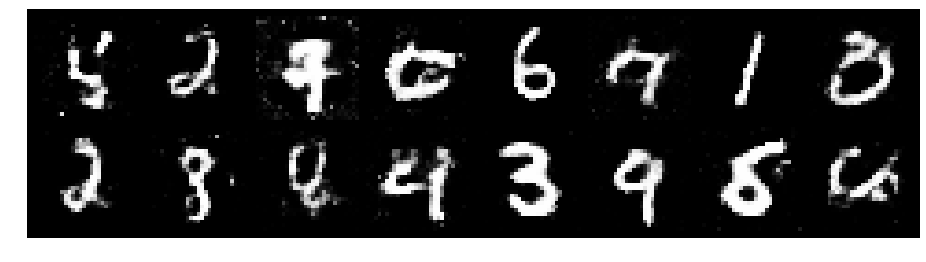

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2827, Generator Loss: 0.8199
D(x): 0.5544, D(G(z)): 0.4645


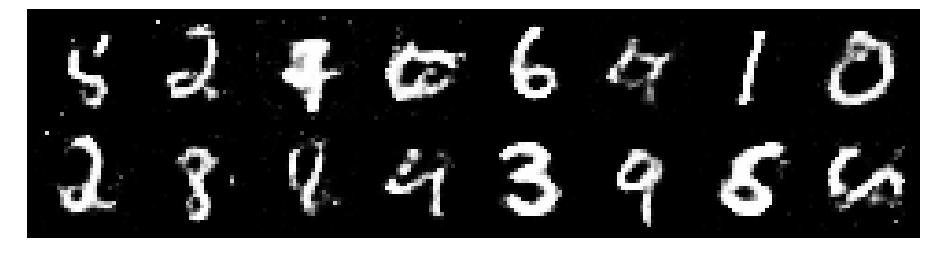

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.3150, Generator Loss: 0.9028
D(x): 0.5031, D(G(z)): 0.4243


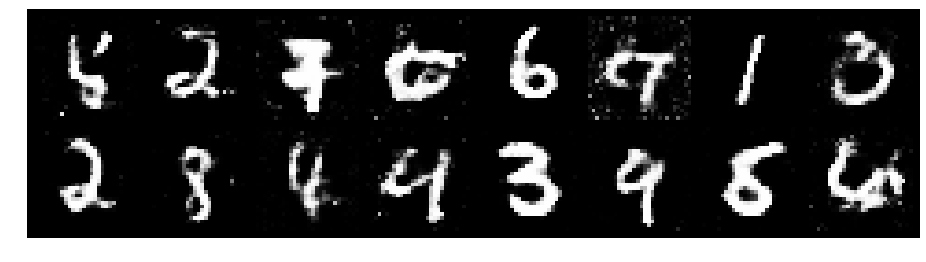

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2748, Generator Loss: 0.9302
D(x): 0.5372, D(G(z)): 0.4357


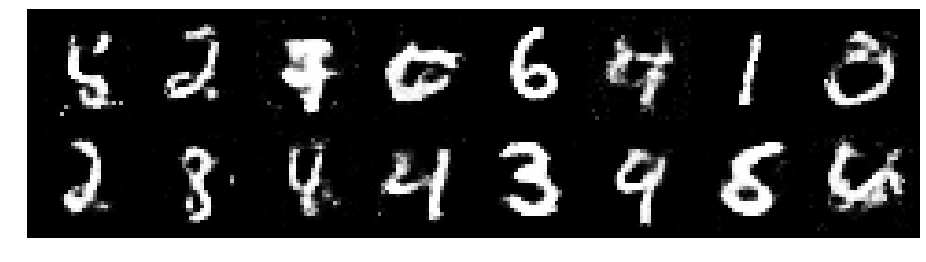

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2927, Generator Loss: 0.9017
D(x): 0.5685, D(G(z)): 0.4631


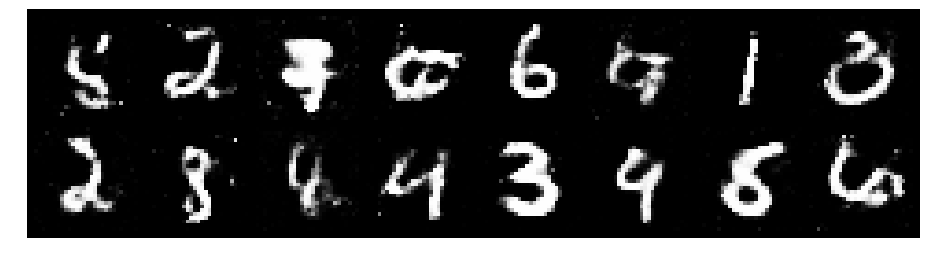

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2808, Generator Loss: 0.9342
D(x): 0.5441, D(G(z)): 0.4415


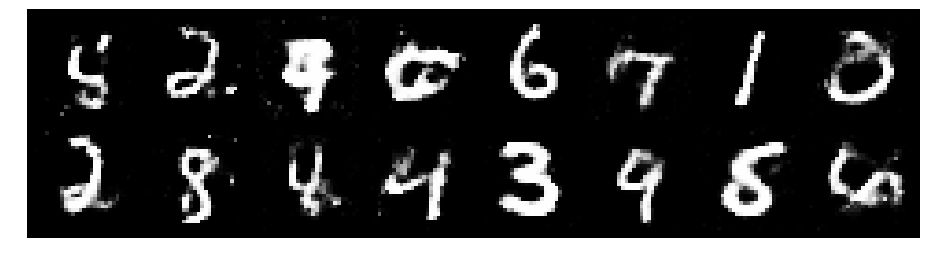

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2507, Generator Loss: 0.8128
D(x): 0.5543, D(G(z)): 0.4523


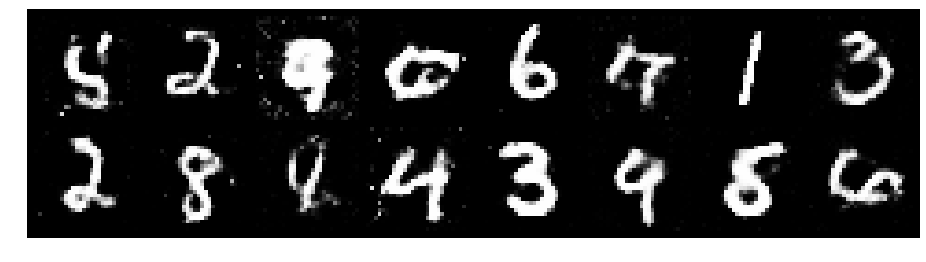

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8365
D(x): 0.5505, D(G(z)): 0.4481


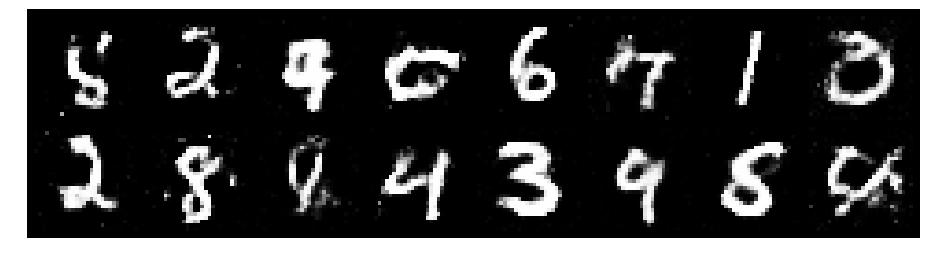

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2904, Generator Loss: 0.9471
D(x): 0.5521, D(G(z)): 0.4487


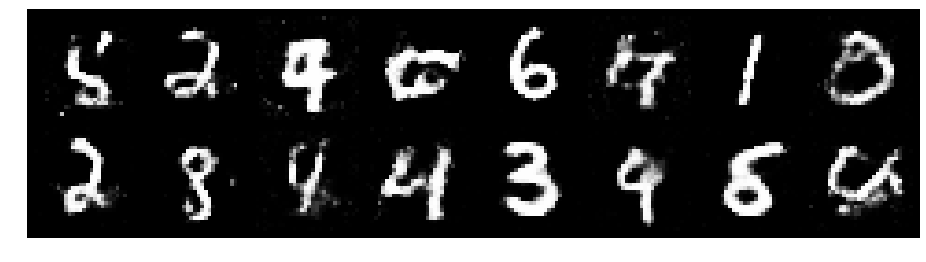

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3134, Generator Loss: 0.7608
D(x): 0.5363, D(G(z)): 0.4625


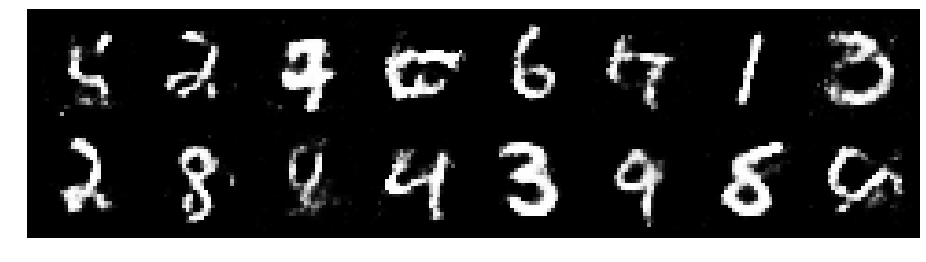

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.3485, Generator Loss: 0.8544
D(x): 0.5034, D(G(z)): 0.4491


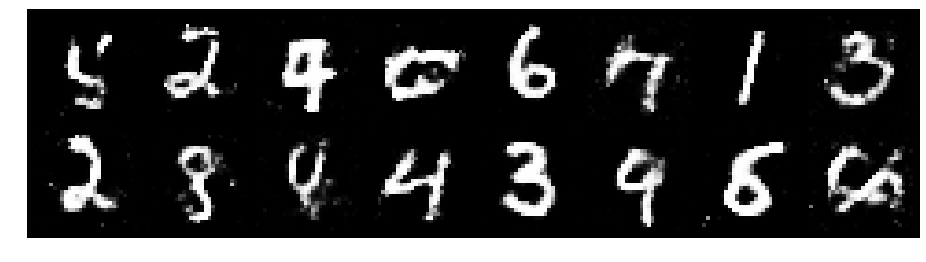

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.3632, Generator Loss: 0.7782
D(x): 0.5442, D(G(z)): 0.4909


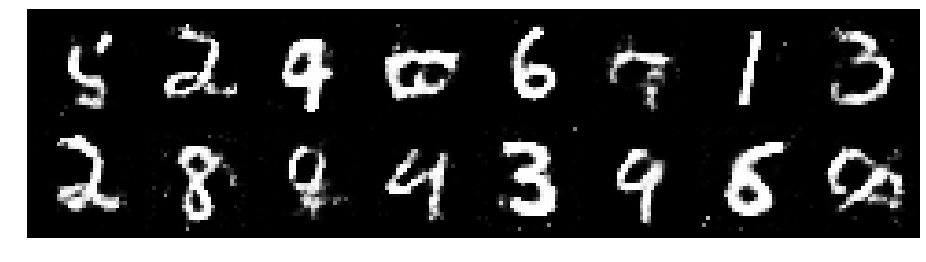

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2506, Generator Loss: 0.8507
D(x): 0.5424, D(G(z)): 0.4255


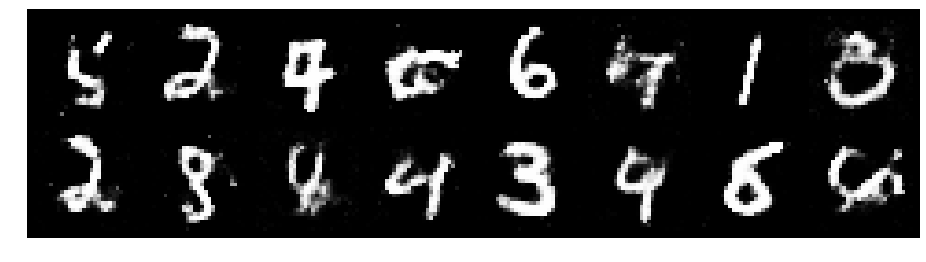

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2721, Generator Loss: 0.9508
D(x): 0.5517, D(G(z)): 0.4493


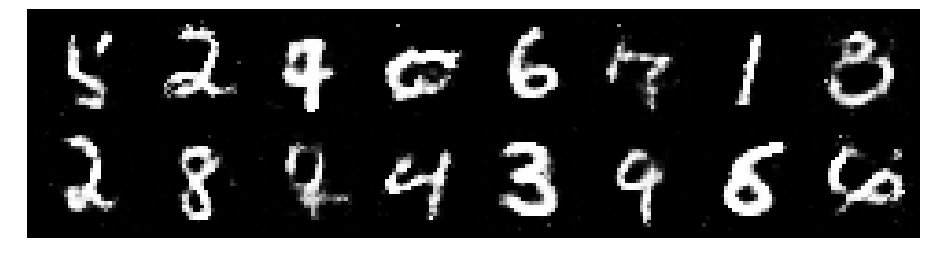

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.3141, Generator Loss: 1.0979
D(x): 0.5262, D(G(z)): 0.4219


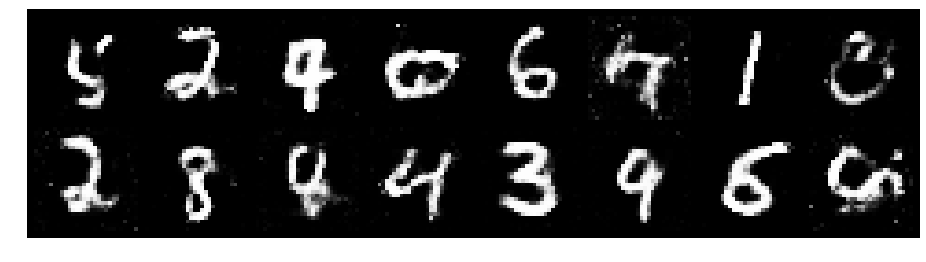

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3152, Generator Loss: 0.8453
D(x): 0.5462, D(G(z)): 0.4615


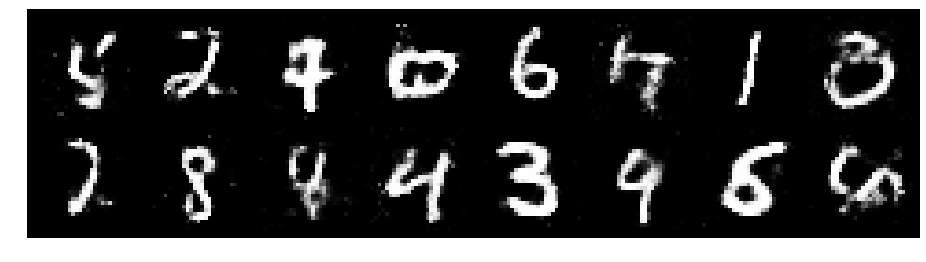

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.4691, Generator Loss: 0.9538
D(x): 0.4822, D(G(z)): 0.4611


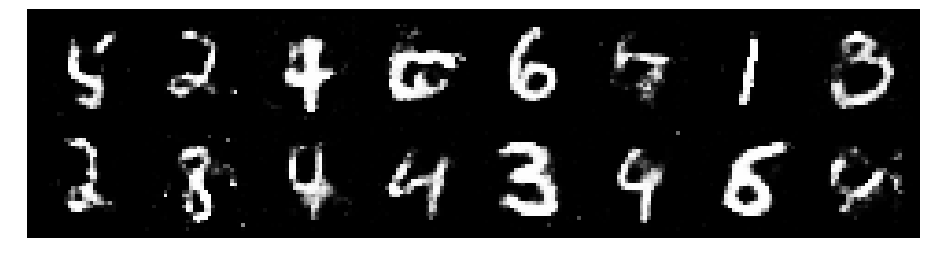

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2669, Generator Loss: 0.8077
D(x): 0.5312, D(G(z)): 0.4450


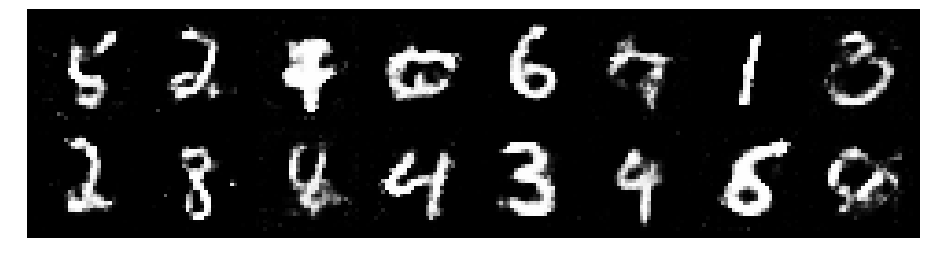

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3359, Generator Loss: 0.8141
D(x): 0.5248, D(G(z)): 0.4512


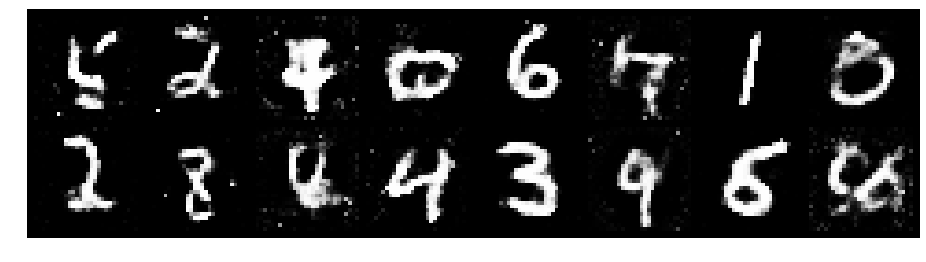

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3739, Generator Loss: 0.7502
D(x): 0.5082, D(G(z)): 0.4659


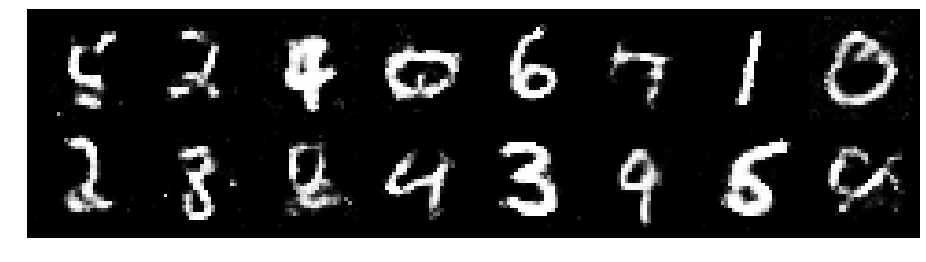

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.2766, Generator Loss: 0.7979
D(x): 0.5733, D(G(z)): 0.4746


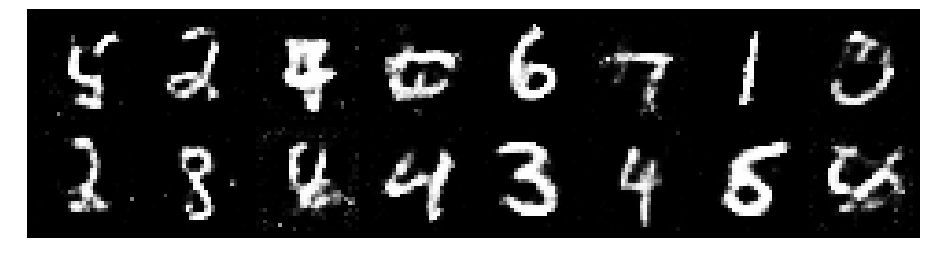

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2838, Generator Loss: 0.9364
D(x): 0.5196, D(G(z)): 0.4195


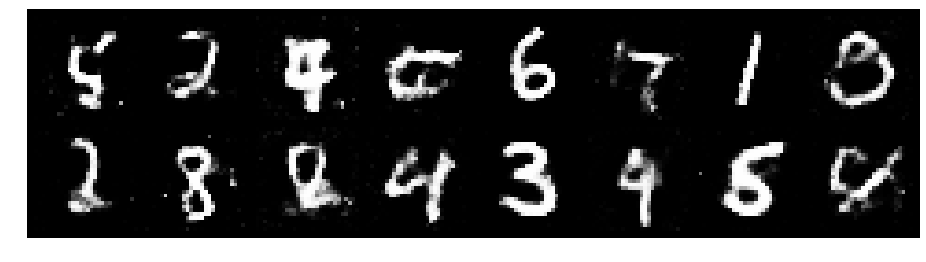

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.3985, Generator Loss: 0.8036
D(x): 0.5062, D(G(z)): 0.4665


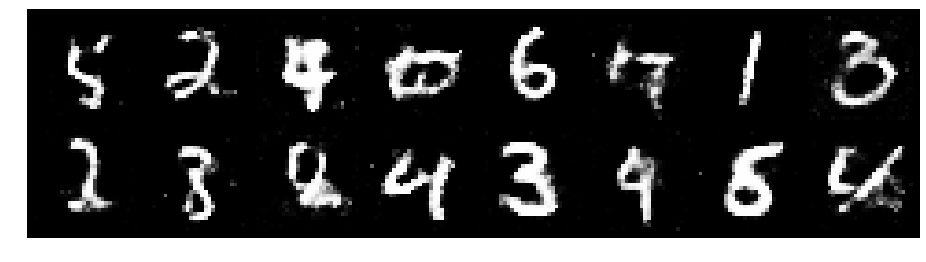

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.2800, Generator Loss: 0.8842
D(x): 0.5655, D(G(z)): 0.4625


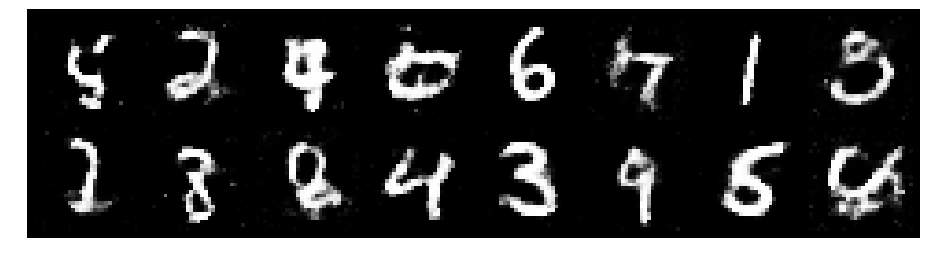

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2728, Generator Loss: 0.8946
D(x): 0.5356, D(G(z)): 0.4312


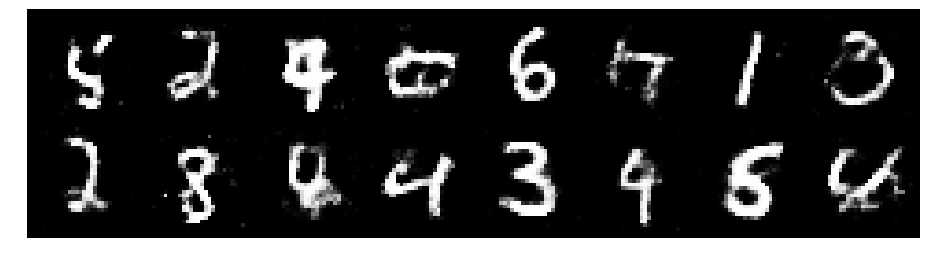

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2539, Generator Loss: 0.9301
D(x): 0.5462, D(G(z)): 0.4252


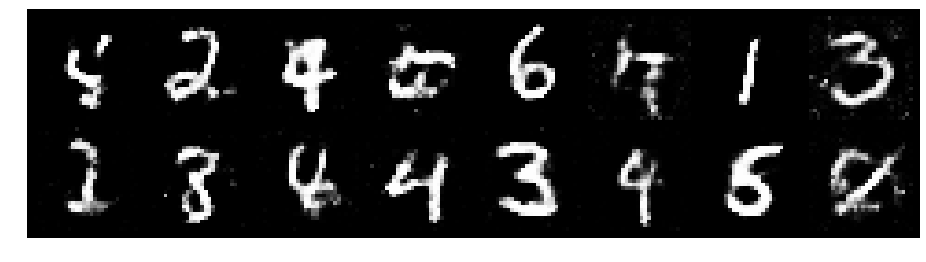

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2010, Generator Loss: 0.8152
D(x): 0.5773, D(G(z)): 0.4519


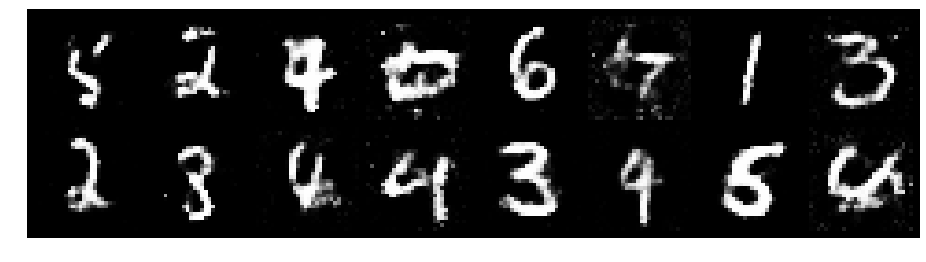

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2415, Generator Loss: 0.9041
D(x): 0.5524, D(G(z)): 0.4401


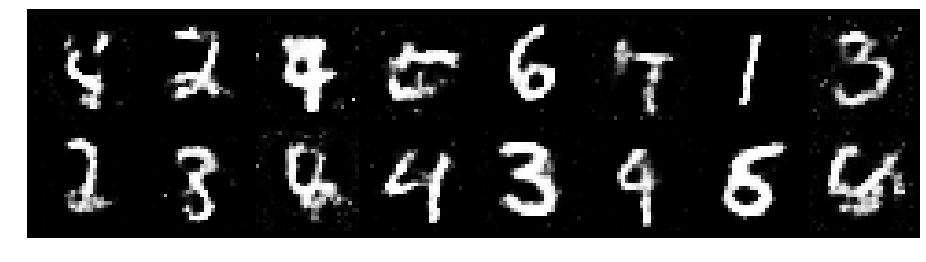

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2146, Generator Loss: 1.0156
D(x): 0.5534, D(G(z)): 0.4139


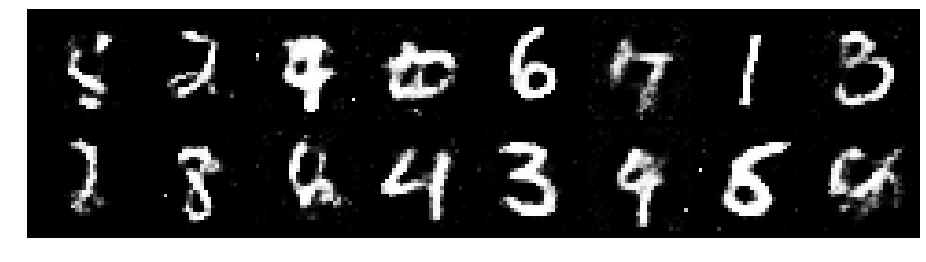

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.2186, Generator Loss: 0.8921
D(x): 0.5730, D(G(z)): 0.4453


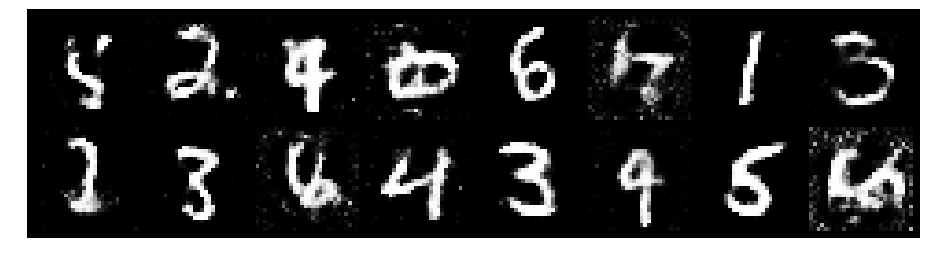

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3003, Generator Loss: 0.7370
D(x): 0.5581, D(G(z)): 0.4584


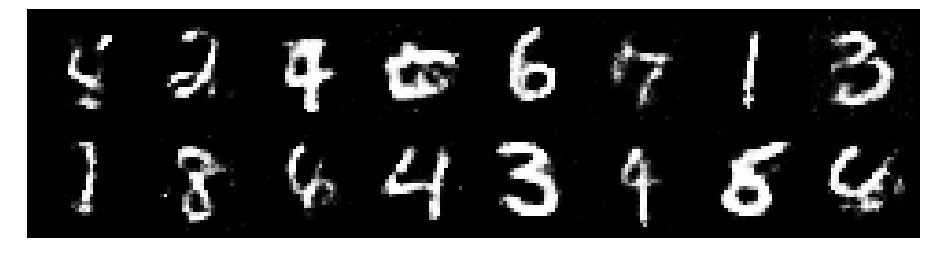

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2472, Generator Loss: 0.7910
D(x): 0.5811, D(G(z)): 0.4564


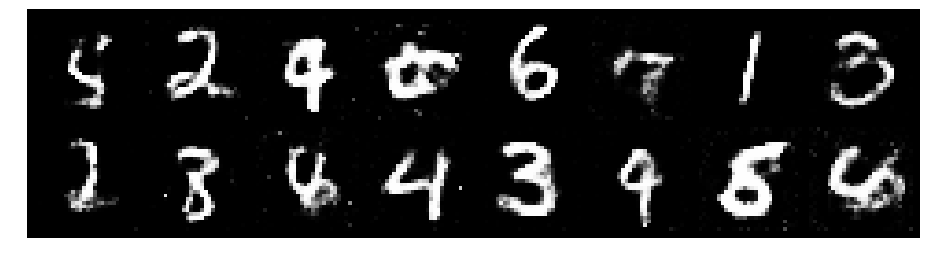

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2195, Generator Loss: 0.8928
D(x): 0.5514, D(G(z)): 0.4239


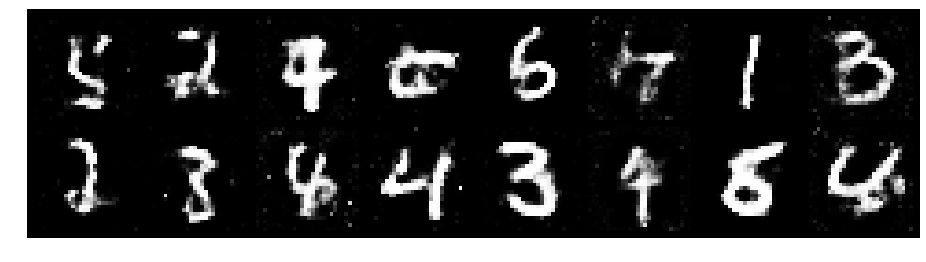

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.2587, Generator Loss: 1.0278
D(x): 0.5361, D(G(z)): 0.4253


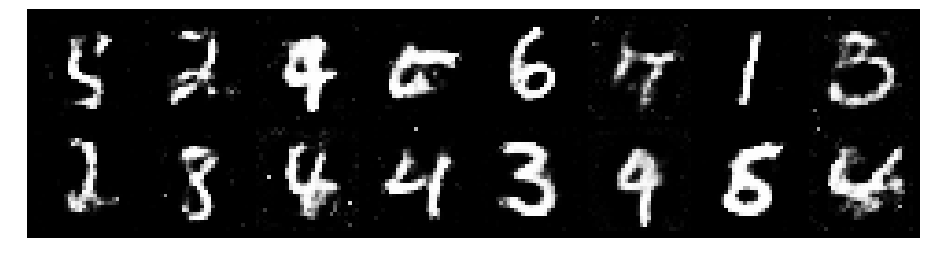

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.2350, Generator Loss: 0.9738
D(x): 0.5531, D(G(z)): 0.4134


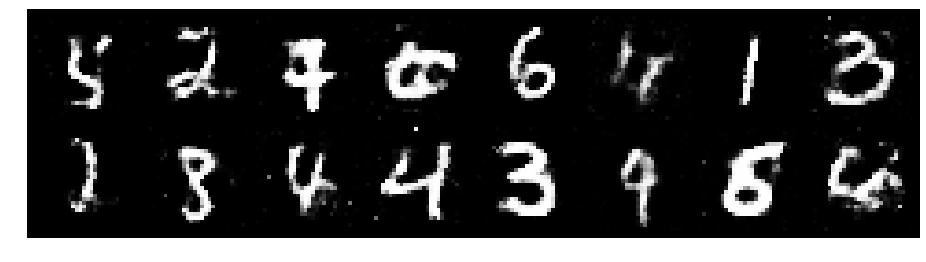

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.2415, Generator Loss: 0.9183
D(x): 0.5281, D(G(z)): 0.4017


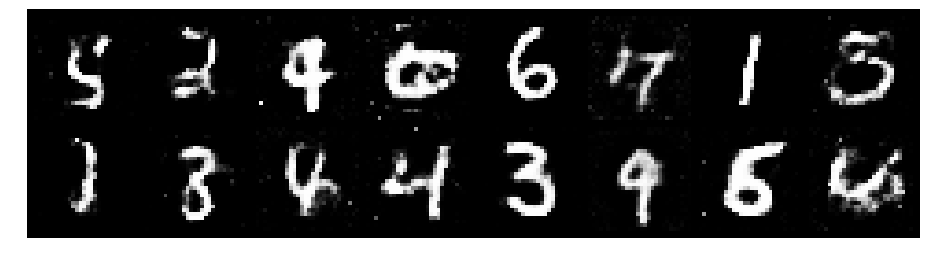

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.1614, Generator Loss: 0.9425
D(x): 0.5773, D(G(z)): 0.3923


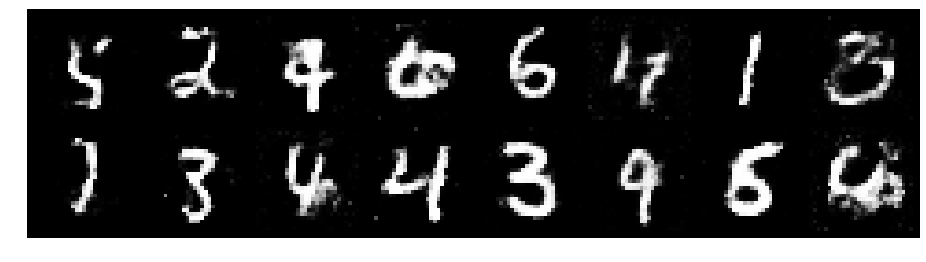

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3939, Generator Loss: 0.8190
D(x): 0.5226, D(G(z)): 0.4918


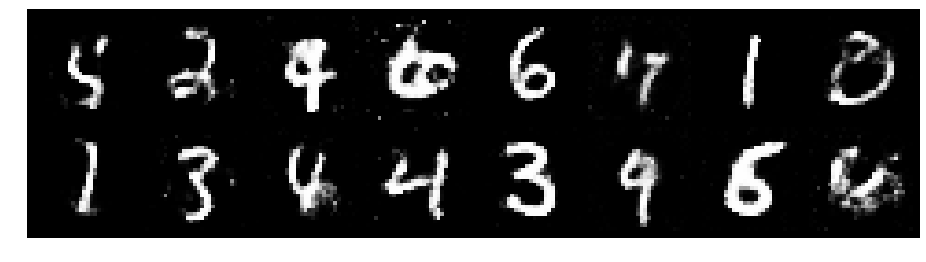

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2633, Generator Loss: 0.7563
D(x): 0.5436, D(G(z)): 0.4554


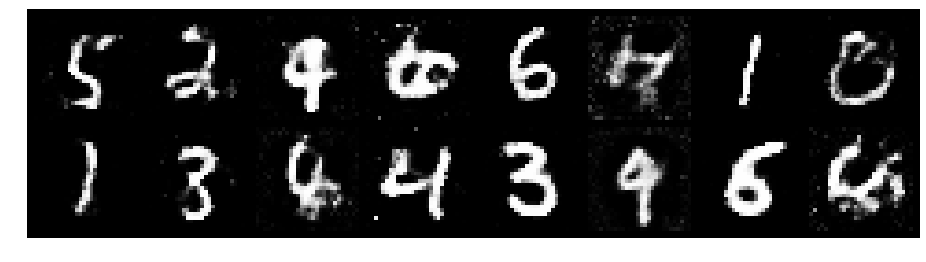

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.3425, Generator Loss: 0.8329
D(x): 0.5306, D(G(z)): 0.4665


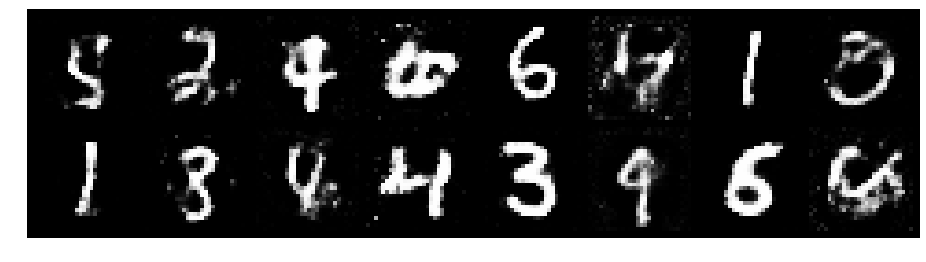

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2502, Generator Loss: 0.8300
D(x): 0.5803, D(G(z)): 0.4678


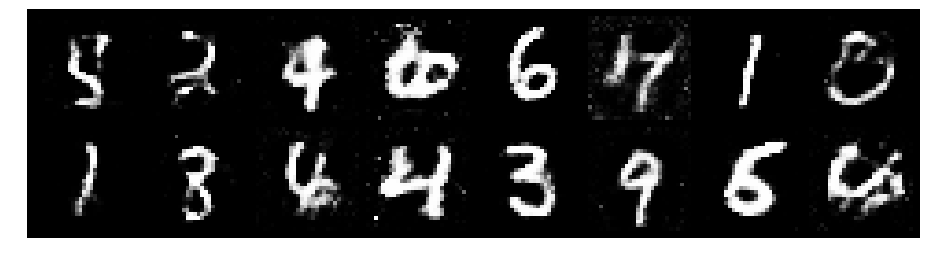

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2775, Generator Loss: 0.8439
D(x): 0.5784, D(G(z)): 0.4765


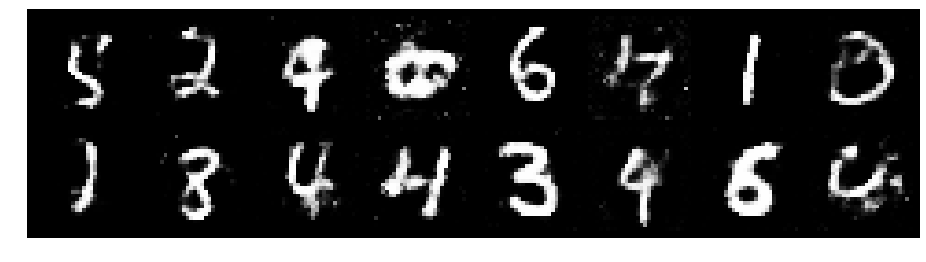

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.3132, Generator Loss: 0.9049
D(x): 0.5599, D(G(z)): 0.4817


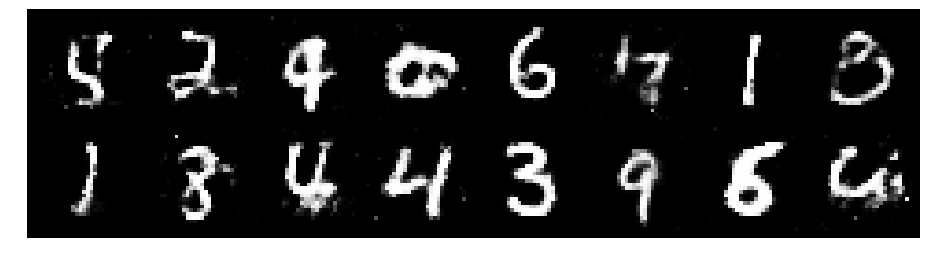

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3073, Generator Loss: 0.9556
D(x): 0.5039, D(G(z)): 0.4090


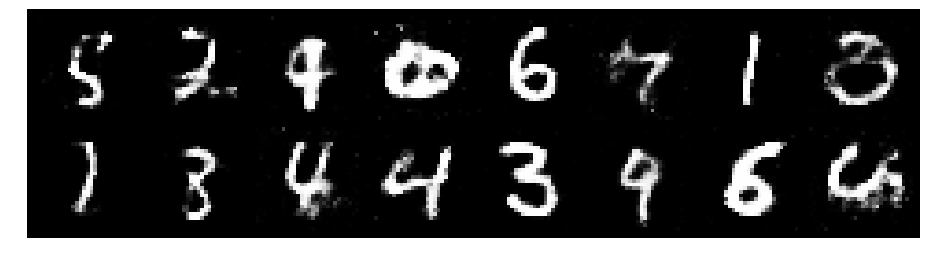

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.4117, Generator Loss: 0.9264
D(x): 0.5361, D(G(z)): 0.4933


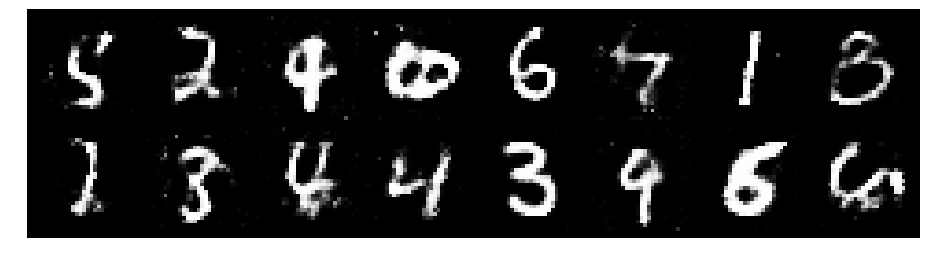

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2542, Generator Loss: 0.9466
D(x): 0.5429, D(G(z)): 0.4249


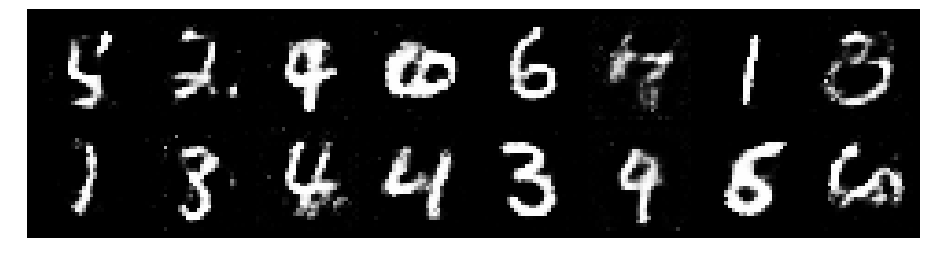

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.3314, Generator Loss: 0.8920
D(x): 0.5395, D(G(z)): 0.4628


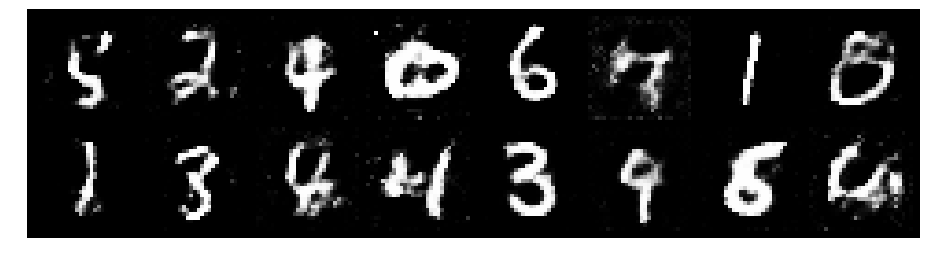

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2546, Generator Loss: 0.7715
D(x): 0.5833, D(G(z)): 0.4629


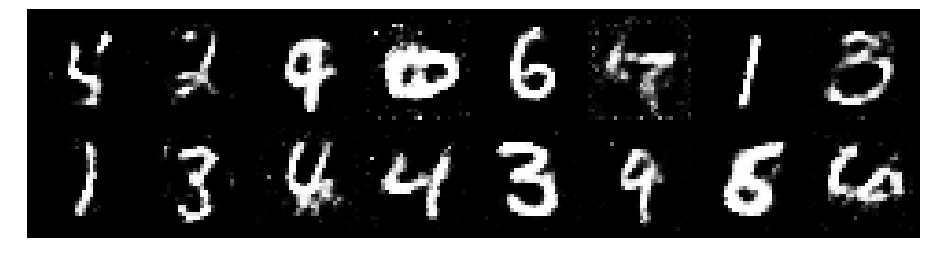

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.3425, Generator Loss: 0.8056
D(x): 0.5568, D(G(z)): 0.4852


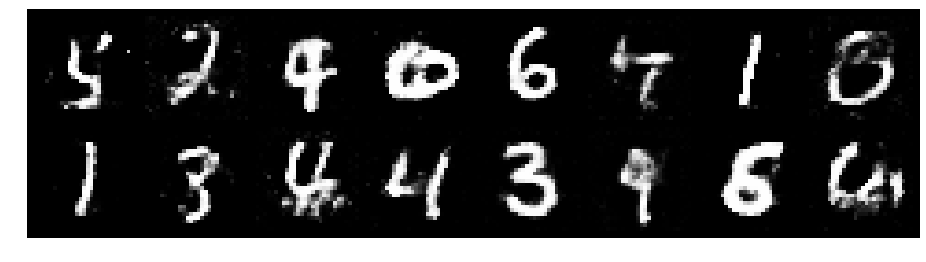

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.1118, Generator Loss: 0.9306
D(x): 0.6036, D(G(z)): 0.4225


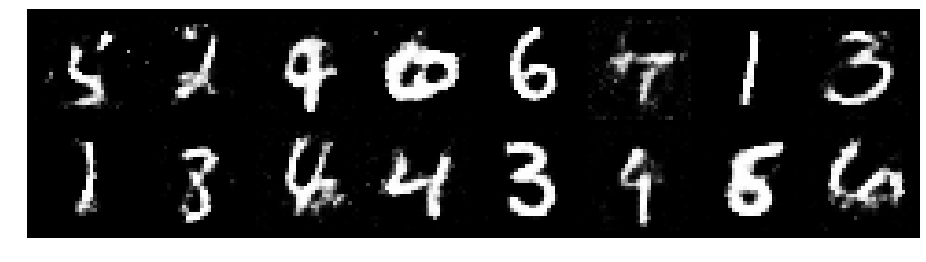

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2926, Generator Loss: 0.8951
D(x): 0.5579, D(G(z)): 0.4448


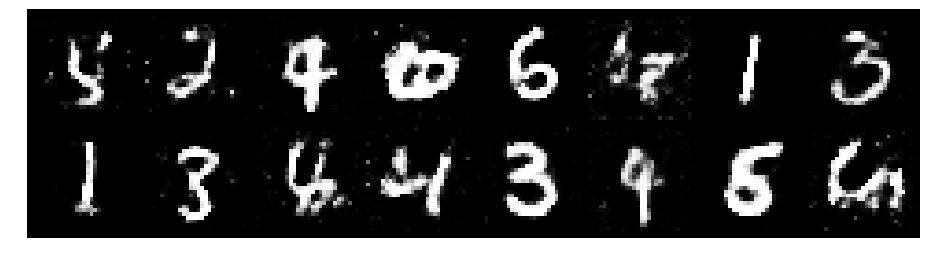

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9118
D(x): 0.5606, D(G(z)): 0.4506


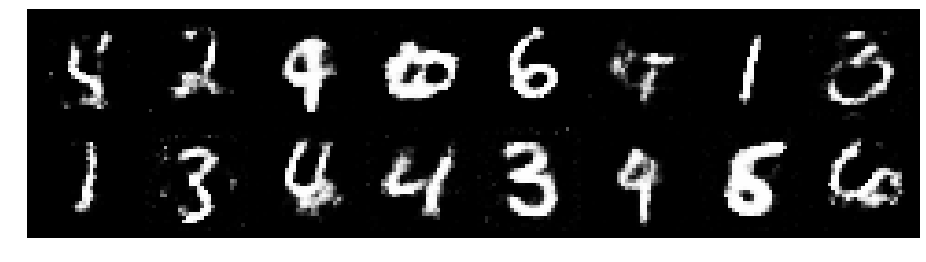

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.3111, Generator Loss: 0.8755
D(x): 0.5403, D(G(z)): 0.4510


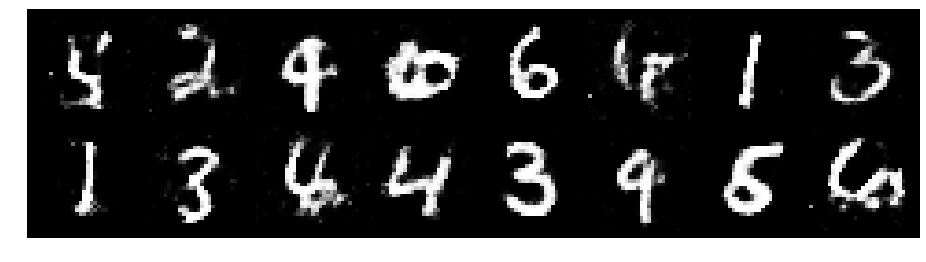

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.3560, Generator Loss: 0.9283
D(x): 0.5384, D(G(z)): 0.4654


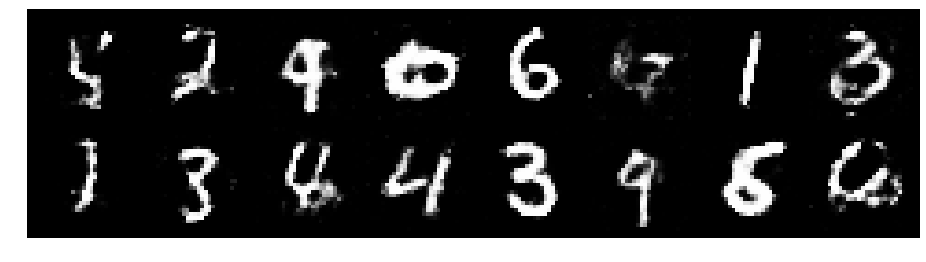

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.1440, Generator Loss: 0.9927
D(x): 0.5523, D(G(z)): 0.3832


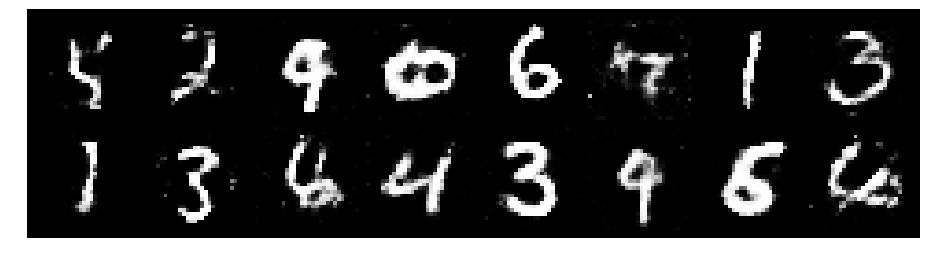

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2756, Generator Loss: 0.9599
D(x): 0.5428, D(G(z)): 0.4407


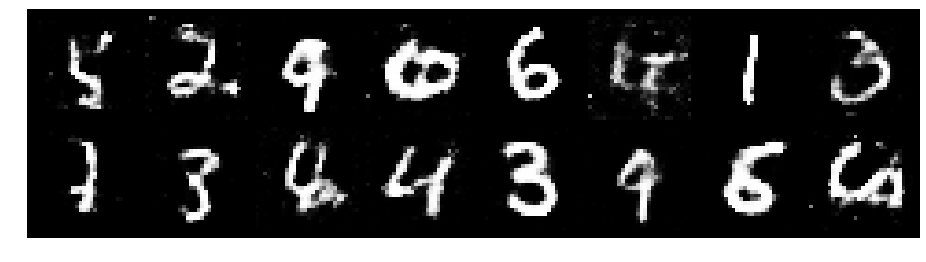

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3119, Generator Loss: 0.8770
D(x): 0.5579, D(G(z)): 0.4665


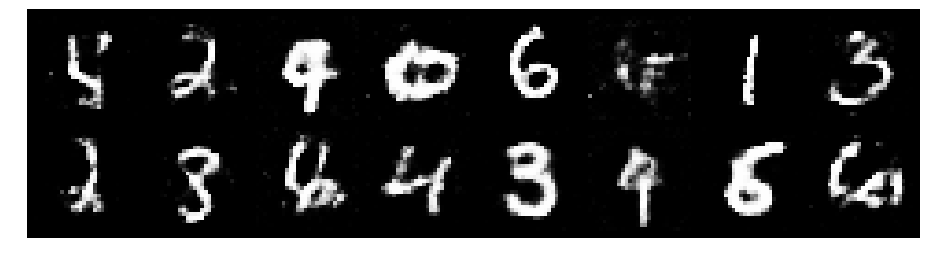

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2610, Generator Loss: 0.8331
D(x): 0.5538, D(G(z)): 0.4502


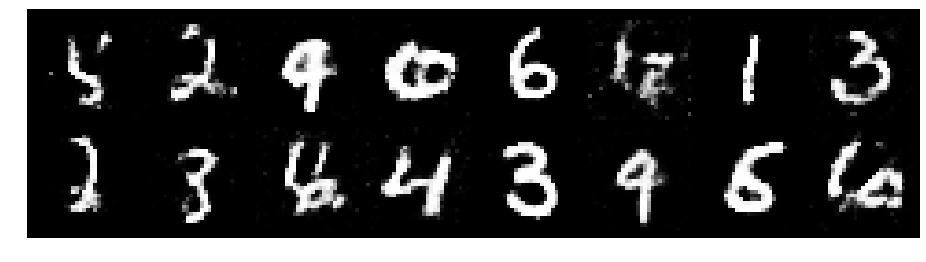

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2311, Generator Loss: 0.8797
D(x): 0.5404, D(G(z)): 0.4258


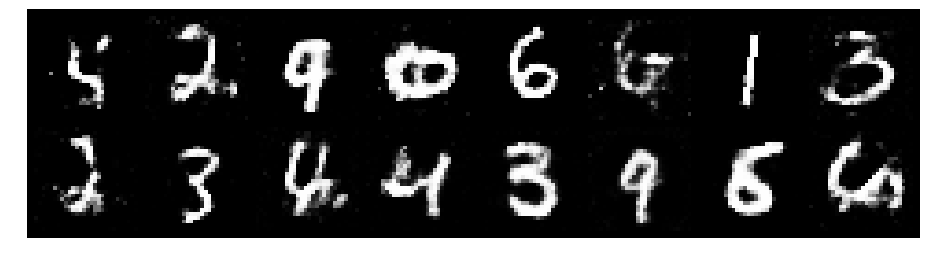

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2657, Generator Loss: 0.9129
D(x): 0.5404, D(G(z)): 0.4207


In [16]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch))
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N))
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )
